In [1]:
import torch
from torch.utils.data import DataLoader
from datetime import datetime
from actor import PtrNet1
from critic import PtrNet2
from config import Config
from data import Generator
from env_v3 import Env_tsp
import torch.nn as nn
from time import time

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim

class AE(nn.Module):
    def __init__(self, **kwargs):
        super().__init__()
        self.encoder_hidden_layer = nn.Linear(
            in_features=kwargs["input_shape"], out_features=32
        )
        self.encoder_output_layer = nn.Linear(
            in_features=32, out_features=32
        )
        self.decoder_hidden_layer = nn.Linear(
            in_features=32, out_features=32
        )
        self.decoder_output_layer = nn.Linear(
            in_features=32, out_features=kwargs["input_shape"]
        )
        
    def encode(self, x):
        activation = self.encoder_hidden_layer(x)
        activation = torch.relu(activation)
        code = self.encoder_output_layer(activation)
        code = torch.relu(code)
        return code
    
    def decode(self, code):
        activation = self.decoder_hidden_layer(code)
        activation = torch.relu(activation)
        activation = self.decoder_output_layer(activation)
        reconstructed = torch.relu(activation)
        return reconstructed

    def forward(self, features):
        tmp = self.encode(features)
        reconstructed = self.decode(tmp)
        return reconstructed

In [3]:
!jupyter kernelspec list



Available kernels:
  ir                 /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/ir
  octave             /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/octave
  python3            /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/python3
  graphframe_yarn    /usr/local/share/jupyter/kernels/graphframe_yarn
  pyspark_local      /usr/local/share/jupyter/kernels/pyspark_local
  pyspark_yarn       /usr/local/share/jupyter/kernels/pyspark_yarn


In [5]:
cfg = Config()
env = Env_tsp(cfg)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model = AE(input_shape=2).to(device)

model.load_state_dict(torch.load("model/vanilla_50n.pt"))
model.eval()

batch = env.get_batch_nodes(10)
print(batch.shape)



cpu
torch.Size([10, 50, 2])


In [6]:
def generate_encoding(batch):
    res = []
    for graph in batch:
        emb = model.encode(graph)
        res.append(emb)
        
    res_tens = torch.stack(res)
    return res_tens

def generate_embeddings(batch):
    
    res = []
    
    for graph in batch:
        g = dgl.graph((l1,l2), num_nodes=10)
        g.ndata['h'] = graph
        tmp_edges = []
        for i in range(n_nodes*(n_nodes-1)):
                n1 = l1[i]
                n2 = l2[i]
                x1 = torch.FloatTensor( [graph[n1][0]])
                x2 = torch.FloatTensor([graph[n2][0]])
                y1 = torch.FloatTensor([graph[n1][1]])
                y2 = torch.FloatTensor([graph[n2][1]])
                dist = torch.sqrt( torch.pow(x2-x1,2) + torch.pow(y2 - y1, 2) )
                tmp_edges.append(dist)
            
        edges_tens = torch.FloatTensor(tmp_edges)
        g.edata['a'] = edges_tens
        z = gae(g)
        res.append(z)
        
    res_tens = torch.stack(res)
    return res_tens
        



In [ ]:
## torch.backends.cudnn.benchmark = True

def train_model(cfg, env, log_path = None):
    try:    
        date = datetime.now().strftime('%m%d_%H_%M')

        torch.no_grad()
        act_model = PtrNet1(cfg)



        if cfg.optim == 'Adam':
            act_optim = torch.optim.Adam(act_model.parameters(), lr = 0.002)
        if cfg.is_lr_decay:
            act_lr_scheduler = torch.optim.lr_scheduler.StepLR(act_optim, 
                            step_size=cfg.lr_decay_step, gamma=cfg.lr_decay)
        device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        act_model = act_model.to(device)

        if cfg.mode == 'train':
            cri_model = PtrNet2(cfg)
            if cfg.optim == 'Adam':
                cri_optim = torch.optim.Adam(cri_model.parameters(), lr = 0.002)
            if cfg.is_lr_decay:
                cri_lr_scheduler = torch.optim.lr_scheduler.StepLR(cri_optim, 
                            step_size = cfg.lr_decay_step, gamma = cfg.lr_decay)
            cri_model = cri_model.to(device)
            ave_cri_loss = 0.

        mse_loss = nn.MSELoss()
        dataset = Generator(cfg, env)
        dataloader = DataLoader(dataset, batch_size = cfg.batch, shuffle = True)

        ave_act_loss, ave_L = 0., 0.
        min_L, cnt = 1e7, 0
        t1 = time()
        # for i, inputs in tqdm(enumerate(dataloader)):
        #for i, inputs in enumerate(dataloader):
        for i, inputs in enumerate(dataloader):
            inputs = inputs.to(device)
            #now instead of the inputs (a batch of node coordinates), give extract the embedding from the nodes
            embed = generate_encoding(inputs)  
            pred_tour, ll = act_model(embed, device)
            real_l = env.stack_l_fast(inputs, pred_tour)

            if cfg.mode == 'train':
                embed = generate_encoding(inputs)  
                pred_l = cri_model(embed, device)
                cri_loss = mse_loss(pred_l, real_l.detach())
                cri_optim.zero_grad()
                cri_loss.backward(retain_graph=True)
                nn.utils.clip_grad_norm_(cri_model.parameters(), max_norm = 1., norm_type = 2)
                cri_optim.step()
                if cfg.is_lr_decay:
                    cri_lr_scheduler.step()

            adv = real_l.detach() - pred_l.detach()
            act_loss = (adv * ll).mean()
            act_optim.zero_grad()
            act_loss.backward( )
            nn.utils.clip_grad_norm_(act_model.parameters(), max_norm = 1., norm_type = 2)
            act_optim.step()
            if cfg.is_lr_decay:
                act_lr_scheduler.step()

            ave_act_loss += act_loss.item()
            if cfg.mode == 'train':
                ave_cri_loss += cri_loss.item()
            ave_L += real_l.mean().item()

            if i % 5 == 0:
                env.show(inputs[0], pred_tour[0])
                #print(pred_tour[''])

            if i % cfg.log_step == 0:
                t2 = time()
                if cfg.mode == 'train':	
                    print('step:%d/%d, actic loss:%1.3f, critic loss:%1.3f, L:%1.3f, %dmin%dsec'%(i, cfg.steps, ave_act_loss/(i+1), ave_cri_loss/(i+1), ave_L/(i+1), (t2-t1)//60, (t2-t1)%60))
                    if cfg.islogger:
                        if log_path is None:
                            log_path = cfg.log_dir + '%s_%s_train.csv'%(date, cfg.task)#cfg.log_dir = ./Csv/
                            with open(log_path, 'w') as f:
                                f.write('step,actic loss,critic loss,average distance,time\n')
                        else:
                            with open(log_path, 'a') as f:
                                f.write('%d,%1.4f,%1.4f,%1.4f,%dmin%dsec\n'%(i, ave_act_loss/(i+1), ave_cri_loss/(i+1), ave_L/(i+1), (t2-t1)//60, (t2-t1)%60))


                if(ave_L/(i+1) < min_L):
                    min_L = ave_L/(i+1)
                if(ave_L/(i+1) < 3.6):
                    torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'

                # else:
                # 	cnt += 1
                # 	print(f'cnt: {cnt}/20')
                # 	if(cnt >= 20):
                # 		print('early stop, average cost cant decrease anymore')
                # 		if log_path is not None:
                # 			with open(log_path, 'a') as f:
                # 				f.write('\nearly stop')
                		break
                t1 = time()
        if cfg.issaver:		
            torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'
            print('save model...')
    except KeyboardInterrupt:
        torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'
        

distance:21.632
tensor([ 1,  2, 13,  9, 24, 47, 33, 20, 41, 39, 42,  4, 40, 43, 12,  7, 18,  6,
        17,  3, 21, 36, 49, 11, 25, 27, 14, 30, 31, 10, 46, 44, 28,  8, 22, 26,
        23, 16, 38, 35, 34,  5,  0, 15, 19, 48, 29, 32, 45, 37])


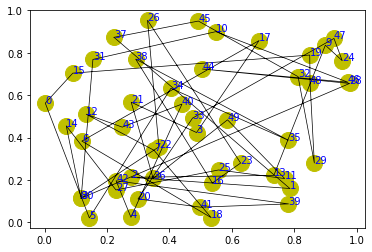

step:0/5000, actic loss:-3872.831, critic loss:684.157, L:26.080, 0min2sec
step:1/5000, actic loss:-3788.016, critic loss:668.952, L:25.934, 0min1sec
step:2/5000, actic loss:-3725.834, critic loss:654.457, L:25.913, 0min1sec
step:3/5000, actic loss:-3580.732, critic loss:620.836, L:25.865, 0min1sec
step:4/5000, actic loss:-3366.146, critic loss:560.274, L:25.773, 0min2sec
distance:26.346
tensor([26, 12, 10, 20, 43,  3, 24, 11, 35, 14, 34, 39, 31,  5, 46, 47,  9, 16,
        48, 18,  4,  7,  0, 32, 41, 45, 23, 28, 29, 25, 27, 37, 38, 42, 49, 22,
        40,  1, 17, 19, 21,  6,  2, 13, 15, 36, 44, 30, 33,  8])


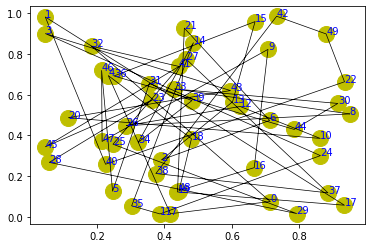

step:5/5000, actic loss:-3062.142, critic loss:487.094, L:25.673, 0min2sec
step:6/5000, actic loss:-2670.891, critic loss:418.761, L:25.643, 0min1sec
step:7/5000, actic loss:-2160.988, critic loss:379.109, L:25.551, 0min1sec
step:8/5000, actic loss:-1633.326, critic loss:375.984, L:25.413, 0min1sec
step:9/5000, actic loss:-1151.962, critic loss:393.791, L:25.278, 0min1sec
distance:27.055
tensor([19, 10, 13, 34,  0, 48, 39,  6, 35,  8, 37, 49,  7, 41, 22, 38, 14,  2,
        47, 25, 20, 15, 46, 44,  9, 40,  5, 23,  1, 21, 30, 43,  4, 29,  3, 16,
        18, 11, 17, 24, 32, 31, 45, 28, 26, 42, 36, 33, 12, 27])


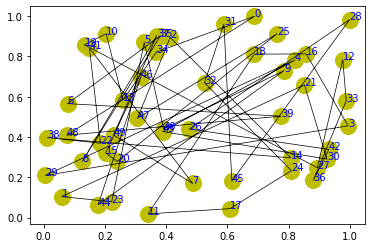

step:10/5000, actic loss:-741.954, critic loss:417.498, L:25.113, 0min1sec
step:11/5000, actic loss:-407.761, critic loss:436.658, L:24.914, 0min1sec
step:12/5000, actic loss:-151.920, critic loss:443.679, L:24.747, 0min1sec
step:13/5000, actic loss:32.715, critic loss:439.955, L:24.574, 0min1sec
step:14/5000, actic loss:155.207, critic loss:427.242, L:24.395, 0min1sec
distance:20.815
tensor([33, 23,  2, 12, 39, 28, 24,  1, 16, 19, 22,  3, 30,  9,  0, 35, 15, 21,
        13, 29, 42, 32,  6, 44,  4, 11, 45, 20, 27, 40, 34,  8, 43, 17, 36,  5,
        38, 37, 26, 10, 41, 46, 18, 31, 49, 48, 25, 14,  7, 47])


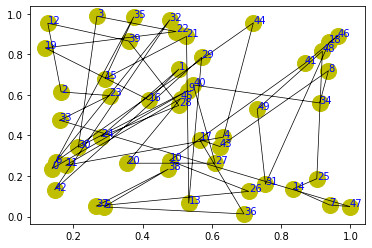

step:15/5000, actic loss:228.668, critic loss:409.131, L:24.183, 0min1sec
step:16/5000, actic loss:259.876, critic loss:388.044, L:23.967, 0min1sec
step:17/5000, actic loss:259.375, critic loss:366.997, L:23.732, 0min1sec
step:18/5000, actic loss:233.244, critic loss:348.141, L:23.501, 0min1sec
step:19/5000, actic loss:197.418, critic loss:332.144, L:23.282, 0min1sec
distance:18.696
tensor([15, 36, 48, 41, 11,  6, 35, 44, 32,  1, 46, 43, 18, 13,  0,  9, 40, 16,
        26, 34, 31, 25, 22,  8, 45, 37,  7, 20, 38, 12,  2, 23, 28, 39, 33, 21,
        30, 24, 49, 17, 19,  4, 42, 47, 29, 14, 10,  3,  5, 27])


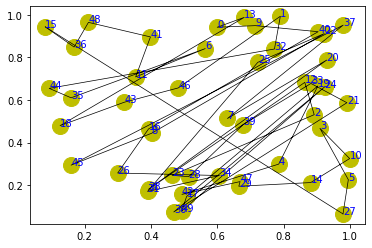

step:20/5000, actic loss:163.378, critic loss:317.993, L:23.058, 0min1sec
step:21/5000, actic loss:131.641, critic loss:305.399, L:22.874, 0min1sec
step:22/5000, actic loss:108.084, critic loss:293.378, L:22.694, 0min1sec
step:23/5000, actic loss:89.706, critic loss:282.082, L:22.566, 0min1sec
step:24/5000, actic loss:78.045, critic loss:271.239, L:22.471, 0min1sec
distance:20.409
tensor([49, 14,  2, 44,  0, 40,  4, 19,  7, 35, 27, 18, 30, 12, 24, 37, 33, 42,
        22, 39, 28, 47, 11, 26,  5, 32,  9,  8, 38, 46, 31, 45, 34, 17, 15, 20,
        23, 21,  1, 25, 10, 41,  6, 29, 16, 43, 48, 36,  3, 13])


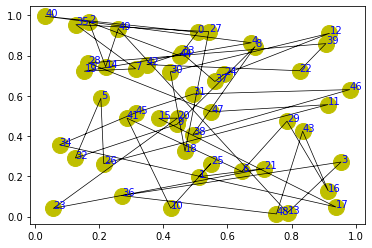

step:25/5000, actic loss:70.883, critic loss:261.037, L:22.440, 0min1sec
step:26/5000, actic loss:69.912, critic loss:251.523, L:22.441, 0min1sec
step:27/5000, actic loss:71.537, critic loss:242.800, L:22.472, 0min1sec
step:28/5000, actic loss:73.503, critic loss:234.791, L:22.524, 0min1sec
step:29/5000, actic loss:73.234, critic loss:227.192, L:22.612, 0min1sec
distance:26.249
tensor([ 9, 47, 11,  5, 49, 22, 30,  3, 36,  7, 45, 28,  0, 34, 32, 13, 20, 16,
        26, 41,  1, 38, 43, 15, 42, 14, 24, 39, 25, 17,  2, 40, 18, 19, 27, 23,
        21, 44, 33, 31,  4, 35, 37,  8, 48,  6, 29, 12, 46, 10])


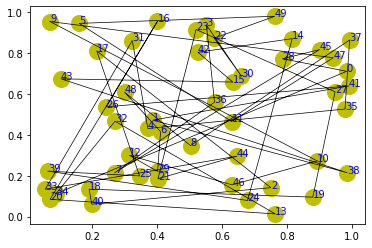

step:30/5000, actic loss:72.167, critic loss:220.013, L:22.699, 0min1sec
step:31/5000, actic loss:70.230, critic loss:213.257, L:22.774, 0min2sec
step:32/5000, actic loss:67.394, critic loss:206.937, L:22.821, 0min1sec
step:33/5000, actic loss:64.949, critic loss:200.959, L:22.829, 0min1sec
step:34/5000, actic loss:62.179, critic loss:195.321, L:22.841, 0min1sec
distance:24.661
tensor([16, 10, 12, 30, 34, 48, 18,  8, 40, 42, 14, 22, 38, 24, 36, 28, 26, 46,
        20, 44,  6, 32,  4,  2,  0,  1,  3, 13, 49, 43, 15, 37, 21, 23, 19, 39,
        47, 25, 45, 27, 31, 35, 11, 17, 33,  5,  9,  7, 29, 41])


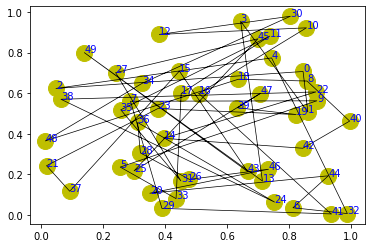

step:35/5000, actic loss:60.391, critic loss:189.995, L:22.857, 0min1sec
step:36/5000, actic loss:59.092, critic loss:184.968, L:22.864, 0min1sec
step:37/5000, actic loss:56.771, critic loss:180.200, L:22.866, 0min1sec
step:38/5000, actic loss:55.682, critic loss:175.658, L:22.852, 0min1sec
step:39/5000, actic loss:54.741, critic loss:171.353, L:22.820, 0min2sec
distance:21.167
tensor([14, 22, 24, 46, 30, 20, 44, 12, 38, 26, 32, 36, 42,  6, 34, 28, 40, 18,
         4, 48, 16, 10,  8,  2,  0,  1,  3,  5, 37, 49, 25,  9,  7, 27, 43, 31,
        23, 15, 39, 35, 21, 17, 45, 41, 33, 13, 11, 19, 29, 47])


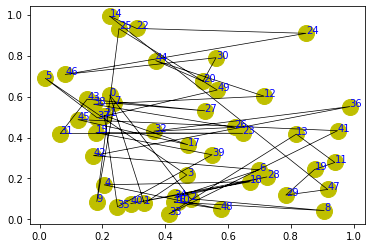

step:40/5000, actic loss:52.034, critic loss:167.293, L:22.794, 0min2sec
step:41/5000, actic loss:48.517, critic loss:163.430, L:22.771, 0min2sec
step:42/5000, actic loss:45.297, critic loss:159.764, L:22.756, 0min2sec
step:43/5000, actic loss:43.635, critic loss:156.231, L:22.737, 0min2sec
step:44/5000, actic loss:43.733, critic loss:152.852, L:22.714, 0min2sec
distance:20.848
tensor([35, 11, 49, 13, 25, 47,  5, 21, 33, 43,  9, 31, 27, 41, 15, 19, 23, 39,
         3, 29, 17, 45, 37,  7,  1,  0,  2, 20,  4,  6,  8, 36, 38, 18, 34, 12,
        40, 32, 44, 42, 28, 48, 10, 46, 30, 22, 16, 14, 24, 26])


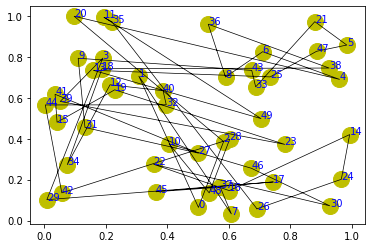

step:45/5000, actic loss:45.186, critic loss:149.675, L:22.682, 0min2sec
step:46/5000, actic loss:46.799, critic loss:146.653, L:22.646, 0min2sec
step:47/5000, actic loss:47.786, critic loss:143.728, L:22.606, 0min1sec
step:48/5000, actic loss:47.035, critic loss:140.870, L:22.575, 0min2sec
step:49/5000, actic loss:45.110, critic loss:138.137, L:22.538, 0min1sec
distance:26.324
tensor([43, 29, 41, 31, 39, 47, 49, 15, 27,  9, 45, 33, 21, 37, 11, 19, 35, 23,
        13, 25, 17,  7,  0,  1,  2,  3,  5,  4,  6, 14, 24, 30, 32,  8, 46, 44,
        16, 10, 34, 18, 38, 28, 40, 20, 26, 22, 42, 36, 48, 12])


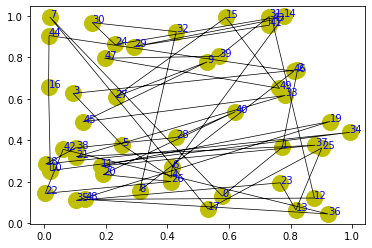

step:50/5000, actic loss:42.385, critic loss:135.580, L:22.507, 0min1sec
step:51/5000, actic loss:40.111, critic loss:133.103, L:22.467, 0min1sec
step:52/5000, actic loss:38.421, critic loss:130.671, L:22.424, 0min1sec
step:53/5000, actic loss:37.589, critic loss:128.297, L:22.382, 0min1sec
step:54/5000, actic loss:38.166, critic loss:126.058, L:22.339, 0min1sec
distance:20.662
tensor([28, 26, 14, 38, 36, 22,  4, 16, 48, 30, 24, 32, 18, 44, 10, 34,  6,  8,
        46, 40, 42, 20, 12,  0,  2,  1, 19, 41, 35, 13, 43, 37, 45, 15, 47, 31,
        27,  5, 39, 21,  3,  7, 33, 17, 49, 25,  9, 11, 29, 23])


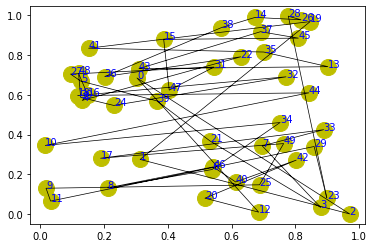

step:55/5000, actic loss:39.452, critic loss:123.950, L:22.295, 0min1sec
step:56/5000, actic loss:40.908, critic loss:121.972, L:22.245, 0min1sec
step:57/5000, actic loss:41.940, critic loss:120.043, L:22.193, 0min1sec
step:58/5000, actic loss:42.272, critic loss:118.118, L:22.140, 0min1sec
step:59/5000, actic loss:41.800, critic loss:116.223, L:22.087, 0min1sec
distance:20.255
tensor([23, 35, 29, 37,  7, 19,  5, 11, 15, 47, 39, 27, 33, 43, 31,  0, 41,  9,
        49, 17, 25, 21, 13,  1, 45,  3,  2,  4, 36, 18, 44, 32, 38, 42, 46, 28,
        16, 34, 48,  6, 14, 20, 26,  8, 10, 22, 24, 30, 12, 40])


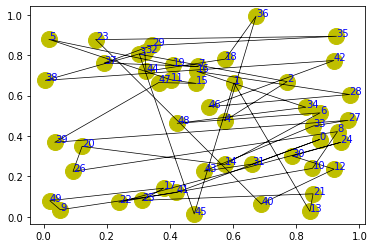

step:60/5000, actic loss:40.175, critic loss:114.413, L:22.041, 0min2sec
step:61/5000, actic loss:38.338, critic loss:112.719, L:21.992, 0min2sec
step:62/5000, actic loss:36.282, critic loss:111.124, L:21.947, 0min2sec
step:63/5000, actic loss:34.516, critic loss:109.531, L:21.900, 0min2sec
step:64/5000, actic loss:33.155, critic loss:107.951, L:21.854, 0min2sec
distance:17.767
tensor([ 0,  2, 36, 42, 48, 40,  6, 12, 30, 20,  4, 28, 26, 22,  8, 32, 14, 16,
        10, 34, 44, 38, 46, 18, 24, 15, 43, 23, 21, 29,  1, 41, 31, 33,  7, 25,
        49, 45, 11, 19, 27, 37, 17,  3, 47,  9, 35,  5, 13, 39])


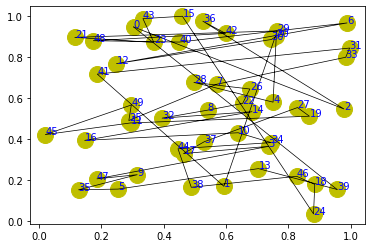

step:65/5000, actic loss:32.419, critic loss:106.360, L:21.808, 0min2sec
step:66/5000, actic loss:32.256, critic loss:104.821, L:21.767, 0min2sec
step:67/5000, actic loss:32.438, critic loss:103.373, L:21.727, 0min1sec
step:68/5000, actic loss:32.697, critic loss:101.989, L:21.689, 0min1sec
step:69/5000, actic loss:32.871, critic loss:100.633, L:21.651, 0min1sec
distance:17.073
tensor([10,  0, 40, 34, 44, 12, 22, 28, 36, 16,  8, 46,  6,  2, 48, 42, 24, 30,
        26, 32,  4, 38, 18, 14, 20,  1, 27, 45, 31, 19, 17, 35, 37, 25, 43,  5,
         3, 15, 11,  9, 23, 21, 49, 47, 33, 13, 41, 29, 39,  7])


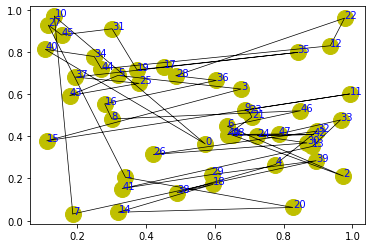

step:70/5000, actic loss:32.902, critic loss:99.285, L:21.611, 0min2sec
step:71/5000, actic loss:32.374, critic loss:97.953, L:21.575, 0min1sec
step:72/5000, actic loss:31.751, critic loss:96.651, L:21.537, 0min2sec
step:73/5000, actic loss:31.093, critic loss:95.386, L:21.501, 0min2sec
step:74/5000, actic loss:30.593, critic loss:94.167, L:21.468, 0min1sec
distance:20.197
tensor([ 0,  8, 32, 30, 36, 44, 46, 12, 22, 18, 26,  4, 40,  2, 28, 10, 34, 42,
        16, 24,  6, 38, 48, 20, 14,  1, 23, 33, 41, 45,  9,  5, 35, 17,  3, 31,
        37, 21, 13, 15, 43, 29, 27, 19, 39,  7, 25, 49, 11, 47])


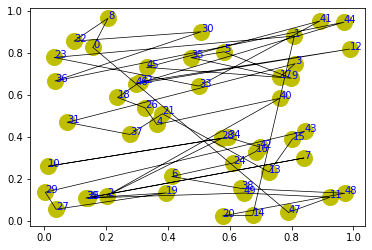

step:75/5000, actic loss:30.597, critic loss:92.978, L:21.437, 0min2sec
step:76/5000, actic loss:30.701, critic loss:91.830, L:21.408, 0min1sec
step:77/5000, actic loss:30.686, critic loss:90.707, L:21.382, 0min1sec
step:78/5000, actic loss:30.306, critic loss:89.594, L:21.358, 0min1sec
step:79/5000, actic loss:29.200, critic loss:88.551, L:21.342, 0min1sec
distance:18.980
tensor([ 0,  2, 10, 48, 12,  8, 24,  6,  4, 42, 22, 28, 30, 16, 46, 44, 40, 14,
        38, 32, 20, 18, 26, 34, 36,  1,  3, 11, 49, 19, 31,  5, 47, 33, 21,  9,
        13, 23, 37, 15, 25, 27, 35,  7, 39, 43, 45, 29, 17, 41])


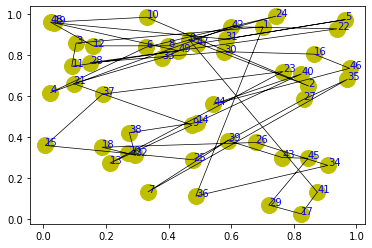

step:80/5000, actic loss:28.004, critic loss:87.540, L:21.324, 0min2sec
step:81/5000, actic loss:27.146, critic loss:86.531, L:21.298, 0min1sec
step:82/5000, actic loss:26.821, critic loss:85.522, L:21.265, 0min1sec
step:83/5000, actic loss:26.564, critic loss:84.538, L:21.233, 0min1sec
step:84/5000, actic loss:26.199, critic loss:83.583, L:21.198, 0min1sec
distance:18.978
tensor([ 0,  8, 32, 38,  6, 12, 22, 34, 46, 24, 10, 16, 28, 30, 14, 26, 42,  2,
        48, 18, 36, 44, 40,  4, 20,  1, 23, 49,  7, 17, 37, 25,  9, 27,  3, 39,
        31, 15, 47, 35, 11, 43,  5, 45, 41, 33, 21, 13, 29, 19])


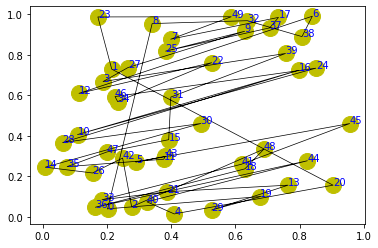

step:85/5000, actic loss:25.848, critic loss:82.650, L:21.165, 0min2sec
step:86/5000, actic loss:25.807, critic loss:81.740, L:21.129, 0min1sec
step:87/5000, actic loss:25.733, critic loss:80.855, L:21.094, 0min1sec
step:88/5000, actic loss:25.390, critic loss:79.978, L:21.065, 0min2sec
step:89/5000, actic loss:25.066, critic loss:79.127, L:21.037, 0min1sec
distance:20.517
tensor([ 0, 44, 32, 14, 48, 12,  6, 10, 38, 16,  2, 34, 40, 18, 46, 26,  4, 28,
        42, 30, 22, 20, 24,  8, 36, 35, 49, 19, 23, 15, 29, 21, 37, 11,  7, 25,
        27, 47, 45, 39,  3,  1, 41, 31, 33, 17,  9, 43, 13,  5])


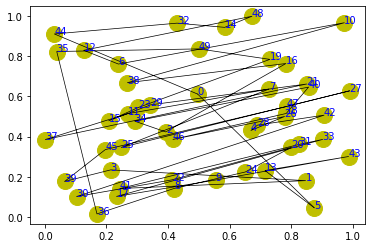

step:90/5000, actic loss:24.880, critic loss:78.289, L:21.011, 0min1sec
step:91/5000, actic loss:24.827, critic loss:77.470, L:20.981, 0min1sec
step:92/5000, actic loss:24.624, critic loss:76.671, L:20.951, 0min1sec
step:93/5000, actic loss:23.997, critic loss:75.903, L:20.925, 0min1sec
step:94/5000, actic loss:23.289, critic loss:75.153, L:20.900, 0min1sec
distance:19.669
tensor([ 0, 10, 30, 36, 12,  6, 18,  8, 16, 32, 38, 40,  4, 44, 46, 48, 42, 14,
         2, 24, 20, 28, 26, 22, 34,  1,  5, 19, 43, 11,  7, 47,  9, 21, 41,  3,
        29, 39, 45, 35, 37, 17, 23, 49, 15, 13, 25, 27, 31, 33])


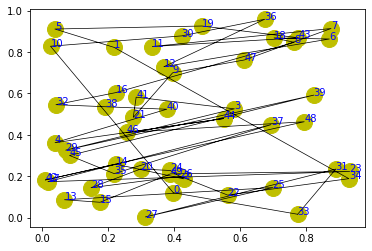

step:95/5000, actic loss:22.713, critic loss:74.407, L:20.874, 0min1sec
step:96/5000, actic loss:22.347, critic loss:73.681, L:20.850, 0min1sec
step:97/5000, actic loss:22.101, critic loss:72.965, L:20.833, 0min1sec
step:98/5000, actic loss:22.382, critic loss:72.286, L:20.813, 0min1sec
step:99/5000, actic loss:23.030, critic loss:71.675, L:20.793, 0min1sec
distance:18.160
tensor([ 0, 48,  4, 42, 24, 36,  2, 22, 46,  6, 12, 44, 14, 38, 20, 28, 10, 18,
        40, 32, 26,  8, 16, 30, 34, 11, 41, 35, 39, 17, 47, 49, 43, 31, 15, 45,
         5, 19, 21,  1, 29,  9, 23,  7,  3, 33, 27, 13, 37, 25])


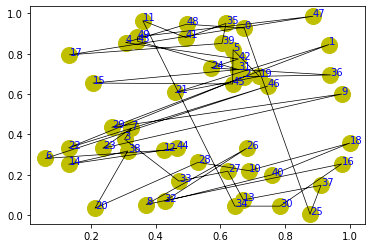

step:100/5000, actic loss:23.785, critic loss:71.076, L:20.776, 0min2sec
step:101/5000, actic loss:24.475, critic loss:70.470, L:20.759, 0min1sec
step:102/5000, actic loss:24.908, critic loss:69.858, L:20.739, 0min1sec
step:103/5000, actic loss:25.038, critic loss:69.232, L:20.717, 0min1sec
step:104/5000, actic loss:24.742, critic loss:68.612, L:20.695, 0min1sec
distance:15.706
tensor([ 0, 46, 42,  4, 28, 34, 16, 40, 32,  2, 12, 10, 14, 26, 30, 24, 18,  8,
         6, 20, 22, 36, 48, 44, 38, 41, 23, 47, 17, 45, 21, 15,  3, 13,  9, 35,
        27, 29, 11, 33, 19,  1,  5,  7, 37, 25, 31, 43, 39, 49])


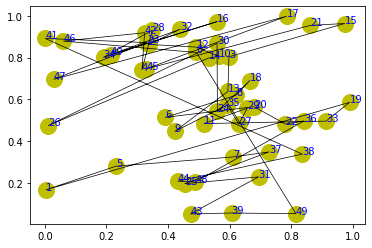

step:105/5000, actic loss:24.087, critic loss:68.006, L:20.675, 0min2sec
step:106/5000, actic loss:23.373, critic loss:67.423, L:20.655, 0min1sec
step:107/5000, actic loss:22.661, critic loss:66.844, L:20.636, 0min1sec
step:108/5000, actic loss:22.108, critic loss:66.263, L:20.620, 0min1sec
step:109/5000, actic loss:21.922, critic loss:65.685, L:20.607, 0min1sec
distance:18.595
tensor([ 2, 42,  0, 36, 40, 34,  4, 20,  6, 12, 44, 28, 48, 32, 22, 26, 38, 14,
        24, 30, 18, 10, 16, 46,  8, 13, 29,  1,  5, 33, 17, 41, 21,  9, 15, 19,
        49, 45, 47, 39,  3, 27,  7, 43, 35, 37, 11, 31, 25, 23])


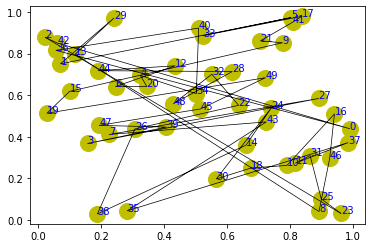

step:110/5000, actic loss:21.976, critic loss:65.131, L:20.593, 0min1sec
step:111/5000, actic loss:22.186, critic loss:64.592, L:20.576, 0min1sec
step:112/5000, actic loss:22.201, critic loss:64.049, L:20.559, 0min1sec
step:113/5000, actic loss:21.801, critic loss:63.516, L:20.544, 0min1sec
step:114/5000, actic loss:21.312, critic loss:63.005, L:20.529, 0min1sec
distance:18.420
tensor([ 0,  6, 48, 34, 38, 44, 16, 22,  4, 12, 30, 10, 14, 26, 36, 20,  2, 24,
        40, 46, 42, 32,  8, 28, 18, 43, 19, 47,  7, 49, 29,  9, 11, 45,  3, 15,
        37, 13, 39,  5, 35, 33, 31, 17, 21,  1, 23, 25, 27, 41])


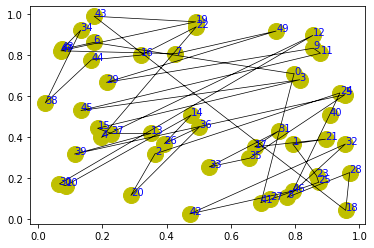

step:115/5000, actic loss:20.951, critic loss:62.497, L:20.513, 0min1sec
step:116/5000, actic loss:20.892, critic loss:61.992, L:20.495, 0min1sec
step:117/5000, actic loss:20.873, critic loss:61.501, L:20.477, 0min1sec
step:118/5000, actic loss:20.713, critic loss:61.013, L:20.460, 0min1sec
step:119/5000, actic loss:20.243, critic loss:60.539, L:20.446, 0min1sec
distance:17.857
tensor([ 0, 34,  8, 38, 16,  2, 46, 28,  6, 12, 24, 40, 22, 26,  4, 18, 36, 42,
        32, 44, 20, 14, 10, 48, 30, 15, 23, 17, 37,  1, 39, 41,  7, 13,  9, 33,
        45,  3, 25,  5, 35, 27, 43, 47, 21, 29, 31, 19, 11, 49])


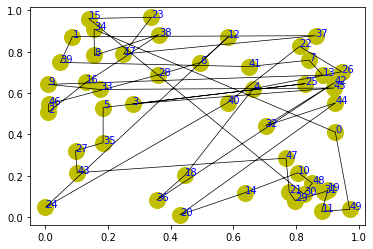

step:120/5000, actic loss:19.734, critic loss:60.070, L:20.429, 0min1sec
step:121/5000, actic loss:19.317, critic loss:59.612, L:20.413, 0min1sec
step:122/5000, actic loss:19.037, critic loss:59.154, L:20.400, 0min2sec
step:123/5000, actic loss:19.202, critic loss:58.712, L:20.386, 0min1sec
step:124/5000, actic loss:19.565, critic loss:58.281, L:20.373, 0min1sec
distance:18.647
tensor([ 0, 14, 46,  8, 44, 40, 16, 34, 36,  4,  6, 28, 10, 20, 22, 32, 26, 30,
        38, 24, 42,  2, 12, 48, 18, 47,  5, 11, 39, 13, 25, 21, 35, 19,  1, 41,
        49, 15, 23, 43,  9, 17,  3, 31, 29, 33,  7, 27, 37, 45])


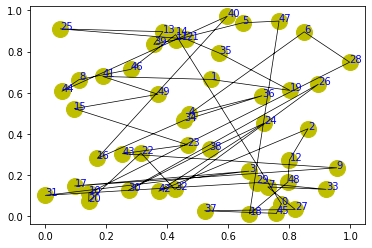

step:125/5000, actic loss:19.887, critic loss:57.856, L:20.360, 0min1sec
step:126/5000, actic loss:20.084, critic loss:57.438, L:20.345, 0min1sec
step:127/5000, actic loss:19.905, critic loss:57.018, L:20.332, 0min1sec
step:128/5000, actic loss:19.641, critic loss:56.596, L:20.319, 0min1sec
step:129/5000, actic loss:19.549, critic loss:56.182, L:20.304, 0min1sec
distance:17.603
tensor([ 0,  6, 14,  2, 20, 40, 18, 34, 30, 22, 10, 46, 36, 26, 44, 38, 42,  4,
        48, 28, 16, 32,  8, 12, 24, 17, 31,  5, 41, 25, 11,  9, 45, 37, 13, 49,
        29, 39, 19, 21, 23, 47, 35, 43,  3, 27, 33, 15,  7,  1])


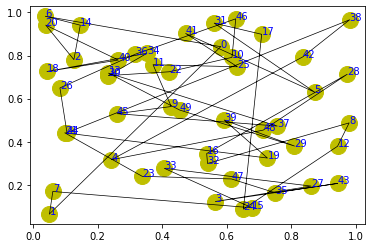

step:130/5000, actic loss:19.336, critic loss:55.777, L:20.289, 0min2sec
step:131/5000, actic loss:19.174, critic loss:55.381, L:20.274, 0min1sec
step:132/5000, actic loss:18.934, critic loss:54.990, L:20.261, 0min1sec
step:133/5000, actic loss:18.995, critic loss:54.612, L:20.244, 0min1sec
step:134/5000, actic loss:18.902, critic loss:54.234, L:20.230, 0min1sec
distance:18.986
tensor([ 0, 48, 42,  6, 46, 28, 30, 32, 26,  8, 36, 22, 38, 24, 34, 14, 16, 44,
        20, 10,  4, 40,  2, 12, 18,  1, 13,  5, 25, 17,  7, 41, 39, 49, 43,  3,
        45, 27, 15, 35, 19, 47, 21, 11, 37,  9, 31, 23, 33, 29])


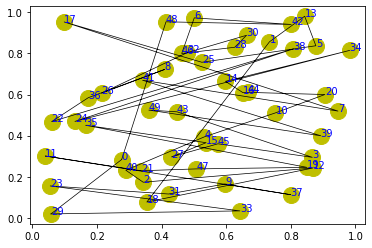

step:135/5000, actic loss:18.695, critic loss:53.861, L:20.216, 0min1sec
step:136/5000, actic loss:18.457, critic loss:53.488, L:20.202, 0min1sec
step:137/5000, actic loss:18.377, critic loss:53.127, L:20.187, 0min1sec
step:138/5000, actic loss:18.243, critic loss:52.766, L:20.173, 0min1sec
step:139/5000, actic loss:18.070, critic loss:52.408, L:20.159, 0min1sec
distance:18.630
tensor([ 0,  2, 46, 42,  6, 10,  4, 38, 36, 32, 20, 12, 16, 24, 40, 14, 44, 26,
        30, 48, 28, 22, 34,  8, 18, 17, 23, 43, 13,  3, 29, 11, 15,  7, 25, 49,
        41, 31, 19,  5, 35, 47,  1, 33, 27, 45, 39, 37, 21,  9])


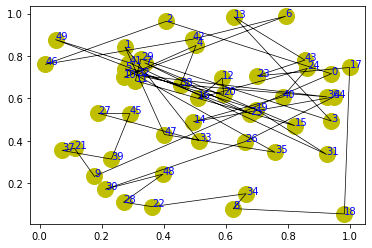

step:140/5000, actic loss:17.985, critic loss:52.059, L:20.144, 0min1sec
step:141/5000, actic loss:17.744, critic loss:51.718, L:20.131, 0min1sec
step:142/5000, actic loss:17.508, critic loss:51.383, L:20.119, 0min1sec
step:143/5000, actic loss:17.595, critic loss:51.052, L:20.104, 0min1sec
step:144/5000, actic loss:17.578, critic loss:50.733, L:20.093, 0min1sec
distance:15.350
tensor([ 0, 32, 44, 18, 24, 34, 20, 14, 26, 46, 30, 10, 22, 38,  4, 42,  8,  2,
         6, 28, 36, 40, 48, 16, 12, 25, 27, 47, 17,  9, 29,  3, 33,  1, 15, 43,
         5, 41, 21, 31,  7, 39, 13, 49, 19, 45, 11, 35, 37, 23])


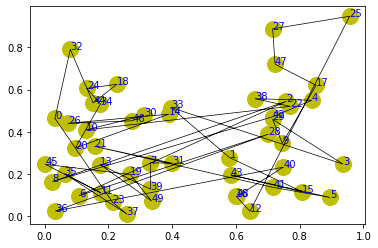

step:145/5000, actic loss:17.587, critic loss:50.414, L:20.078, 0min1sec
step:146/5000, actic loss:17.447, critic loss:50.099, L:20.063, 0min1sec
step:147/5000, actic loss:17.213, critic loss:49.785, L:20.049, 0min1sec
step:148/5000, actic loss:17.099, critic loss:49.468, L:20.033, 0min2sec
step:149/5000, actic loss:16.942, critic loss:49.160, L:20.018, 0min2sec
distance:14.957
tensor([ 0, 12, 30, 10, 36, 16, 42, 40, 48,  2, 20, 22, 18, 38,  6, 34, 14, 46,
         4,  8, 24, 28, 32, 26, 44, 37, 45, 15,  9, 17, 47, 23,  1,  7, 33, 35,
         3, 13, 41, 31, 29, 27, 25, 49,  5, 19, 39, 21, 43, 11])


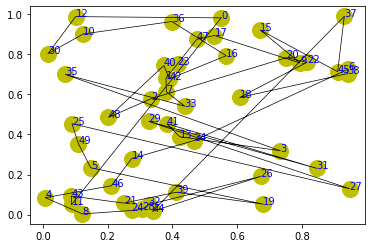

step:150/5000, actic loss:16.820, critic loss:48.862, L:20.004, 0min2sec
step:151/5000, actic loss:16.744, critic loss:48.569, L:19.993, 0min1sec
step:152/5000, actic loss:16.732, critic loss:48.277, L:19.980, 0min1sec
step:153/5000, actic loss:16.634, critic loss:47.983, L:19.969, 0min1sec
step:154/5000, actic loss:16.456, critic loss:47.698, L:19.957, 0min1sec
distance:17.920
tensor([ 0, 48, 32, 36, 26, 10, 22, 40, 28,  2, 34, 42, 14,  8, 44, 18, 20, 38,
         6, 16, 12, 24, 30,  4, 46, 39, 17, 21, 27, 49,  3, 45, 37, 31, 35, 29,
        11, 19, 25,  5, 47, 15, 23,  9, 41, 43,  7, 33, 13,  1])


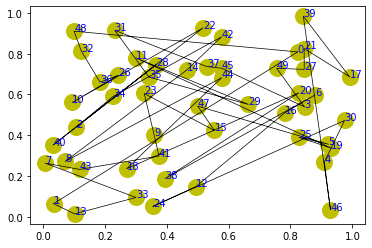

step:155/5000, actic loss:16.216, critic loss:47.416, L:19.945, 0min2sec
step:156/5000, actic loss:15.988, critic loss:47.142, L:19.935, 0min1sec
step:157/5000, actic loss:15.910, critic loss:46.869, L:19.924, 0min2sec
step:158/5000, actic loss:15.916, critic loss:46.599, L:19.911, 0min2sec
step:159/5000, actic loss:15.859, critic loss:46.331, L:19.899, 0min2sec
distance:17.375
tensor([ 0, 34, 28,  6,  4, 30,  8, 48, 42, 12,  2, 38, 20, 14, 32, 44, 36, 26,
        46, 22, 16, 10, 18, 40, 24, 11, 27, 25, 23, 41, 35, 31, 45, 21, 33, 47,
         1,  7,  5, 39, 29, 13,  3, 19, 17, 37, 43, 49,  9, 15])


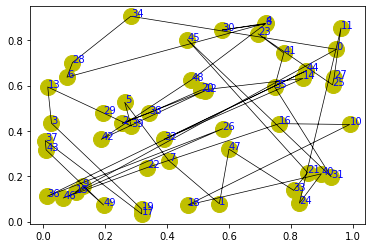

step:160/5000, actic loss:15.625, critic loss:46.067, L:19.889, 0min2sec
step:161/5000, actic loss:15.401, critic loss:45.804, L:19.878, 0min1sec
step:162/5000, actic loss:15.256, critic loss:45.545, L:19.866, 0min1sec
step:163/5000, actic loss:15.205, critic loss:45.288, L:19.855, 0min1sec
step:164/5000, actic loss:15.122, critic loss:45.034, L:19.847, 0min1sec
distance:18.756
tensor([ 0, 18, 14, 30, 26, 20, 48, 38, 24,  6,  2,  8, 32, 12, 40, 28, 46, 44,
        10, 36, 34, 16, 22, 42,  4, 25, 45, 17, 27, 41, 47, 43,  5, 11, 13, 31,
        39, 33,  1, 37, 19, 21,  7, 35, 49, 15, 29,  9, 23,  3])


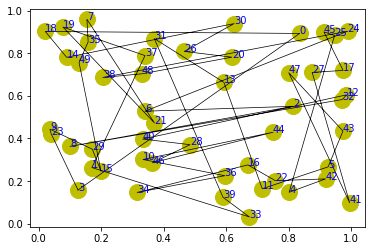

step:165/5000, actic loss:14.973, critic loss:44.779, L:19.840, 0min2sec
step:166/5000, actic loss:14.868, critic loss:44.529, L:19.832, 0min1sec
step:167/5000, actic loss:14.846, critic loss:44.281, L:19.825, 0min1sec
step:168/5000, actic loss:14.872, critic loss:44.040, L:19.817, 0min2sec
step:169/5000, actic loss:14.833, critic loss:43.799, L:19.810, 0min2sec
distance:16.166
tensor([ 0,  2, 12, 30, 48, 24, 40, 26,  4, 34, 20, 46, 10, 42,  8, 28, 44,  6,
        36, 32, 14, 22, 16, 38, 18,  1,  3, 35, 21, 11, 23,  7, 15,  5, 43, 45,
        25, 27, 31, 47, 13, 33, 37, 19,  9, 49, 41, 17, 29, 39])


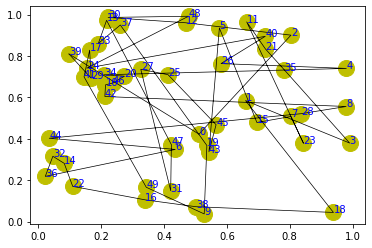

step:170/5000, actic loss:14.686, critic loss:43.561, L:19.802, 0min2sec
step:171/5000, actic loss:14.516, critic loss:43.328, L:19.795, 0min1sec
step:172/5000, actic loss:14.343, critic loss:43.096, L:19.788, 0min1sec
step:173/5000, actic loss:14.305, critic loss:42.866, L:19.781, 0min1sec
step:174/5000, actic loss:14.313, critic loss:42.638, L:19.773, 0min1sec
distance:17.327
tensor([ 0,  4, 36, 40, 22, 32, 44, 46, 42, 38,  6, 24, 12, 14, 16, 20, 10, 18,
         2, 28, 26, 48, 34,  8, 30, 45,  9, 39,  1, 35, 11, 21, 25, 27, 13, 29,
        37,  3, 19, 49, 15, 17, 33, 47,  5,  7, 43, 41, 31, 23])


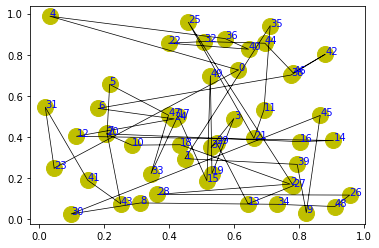

step:175/5000, actic loss:14.258, critic loss:42.414, L:19.765, 0min2sec
step:176/5000, actic loss:14.096, critic loss:42.194, L:19.758, 0min1sec
step:177/5000, actic loss:13.891, critic loss:41.979, L:19.751, 0min1sec
step:178/5000, actic loss:13.711, critic loss:41.760, L:19.745, 0min2sec
step:179/5000, actic loss:13.699, critic loss:41.545, L:19.737, 0min2sec
distance:19.351
tensor([16, 24, 14, 44,  0,  4, 38, 26, 22, 10, 30, 40, 48,  6, 46, 28,  2,  8,
        18, 20, 12, 32, 42, 34, 36,  1, 17, 31, 11, 27, 23, 35, 49, 29, 33,  5,
        43, 39, 41, 37,  3, 47,  7, 25, 19, 45, 15, 21,  9, 13])


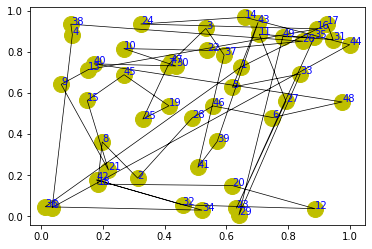

step:180/5000, actic loss:13.683, critic loss:41.334, L:19.730, 0min2sec
step:181/5000, actic loss:13.666, critic loss:41.125, L:19.722, 0min1sec
step:182/5000, actic loss:13.494, critic loss:40.923, L:19.715, 0min1sec
step:183/5000, actic loss:13.340, critic loss:40.719, L:19.706, 0min1sec
step:184/5000, actic loss:13.191, critic loss:40.512, L:19.698, 0min1sec
distance:18.737
tensor([ 0, 20,  6,  2, 44,  8, 36, 22, 30, 10, 16,  4, 48, 24, 12, 46, 28, 32,
        18, 34, 14, 40, 26, 38, 42, 45, 43,  3, 13, 21,  9, 41, 39, 23, 25, 37,
        33, 29, 15, 19, 47, 17, 31, 49,  7, 11, 35,  1, 27,  5])


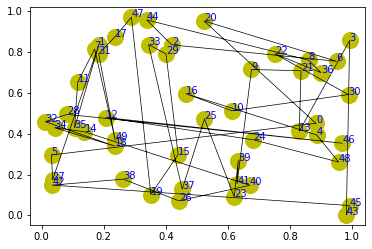

step:185/5000, actic loss:13.147, critic loss:40.309, L:19.692, 0min2sec
step:186/5000, actic loss:13.173, critic loss:40.110, L:19.685, 0min1sec
step:187/5000, actic loss:13.080, critic loss:39.914, L:19.680, 0min1sec
step:188/5000, actic loss:13.081, critic loss:39.722, L:19.673, 0min2sec
step:189/5000, actic loss:13.090, critic loss:39.528, L:19.665, 0min2sec
distance:20.784
tensor([20, 26, 32,  0, 38, 44,  4,  6, 42, 24, 14, 22, 40, 30,  2, 46, 28, 12,
         8, 36, 18, 10, 34, 16, 48, 43, 33,  1,  3,  5, 19,  7, 35, 39, 15, 29,
        47, 11, 27, 25, 49, 17, 23, 21, 13, 45, 41, 37,  9, 31])


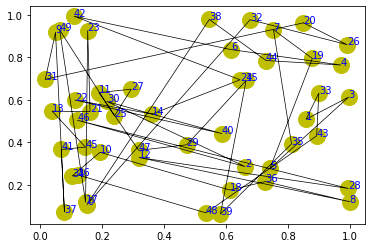

step:190/5000, actic loss:12.943, critic loss:39.336, L:19.657, 0min2sec
step:191/5000, actic loss:12.825, critic loss:39.146, L:19.648, 0min1sec
step:192/5000, actic loss:12.750, critic loss:38.960, L:19.639, 0min1sec
step:193/5000, actic loss:12.790, critic loss:38.777, L:19.631, 0min2sec
step:194/5000, actic loss:12.862, critic loss:38.599, L:19.624, 0min2sec
distance:16.896
tensor([ 0, 34, 18, 16, 32,  6, 46,  4, 22, 30, 26, 24, 42, 28, 20, 36, 44,  2,
        10, 40, 48,  8, 38, 12, 14, 39, 15, 45, 33, 49,  3, 31, 11, 23, 41, 25,
        43,  5, 29, 17, 35,  7, 13, 47,  9, 19,  1, 27, 37, 21])


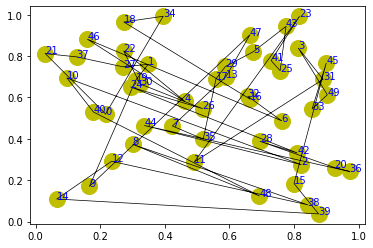

step:195/5000, actic loss:12.922, critic loss:38.422, L:19.615, 0min2sec
step:196/5000, actic loss:12.788, critic loss:38.243, L:19.608, 0min2sec
step:197/5000, actic loss:12.616, critic loss:38.067, L:19.601, 0min2sec
step:198/5000, actic loss:12.538, critic loss:37.892, L:19.593, 0min2sec
step:199/5000, actic loss:12.566, critic loss:37.721, L:19.586, 0min2sec
distance:14.983
tensor([ 0, 12, 30, 32, 46, 24, 36, 18, 38,  2, 22, 26,  6, 40, 20,  8,  4, 14,
        10, 42, 16, 48, 34, 44, 28, 45, 27, 43, 15, 31,  3, 23, 39,  5, 21, 17,
        33,  7, 35, 49, 11,  1, 47, 19,  9, 29, 25, 41, 13, 37])


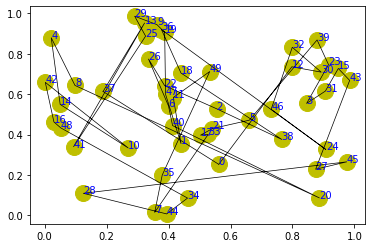

step:200/5000, actic loss:12.621, critic loss:37.556, L:19.578, 0min2sec
step:201/5000, actic loss:12.631, critic loss:37.388, L:19.571, 0min1sec
step:202/5000, actic loss:12.475, critic loss:37.225, L:19.566, 0min1sec
step:203/5000, actic loss:12.328, critic loss:37.061, L:19.560, 0min1sec
step:204/5000, actic loss:12.266, critic loss:36.895, L:19.553, 0min1sec
distance:19.419
tensor([ 0, 42, 26, 46, 44, 40, 36, 18, 14, 12, 22, 20,  4,  2,  6, 32, 48, 30,
         8, 38, 34, 24, 10, 28, 16, 25, 11, 49, 35,  3, 23, 31, 13,  7, 41, 37,
         9, 39, 43, 27, 15,  1, 21, 33, 47, 19,  5, 17, 45, 29])


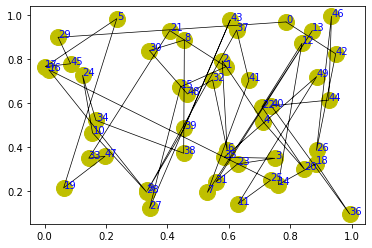

step:205/5000, actic loss:12.246, critic loss:36.733, L:19.547, 0min1sec
step:206/5000, actic loss:12.303, critic loss:36.576, L:19.541, 0min1sec
step:207/5000, actic loss:12.263, critic loss:36.414, L:19.536, 0min1sec
step:208/5000, actic loss:12.157, critic loss:36.253, L:19.530, 0min1sec
step:209/5000, actic loss:12.012, critic loss:36.098, L:19.526, 0min1sec
distance:19.323
tensor([ 0, 42, 32, 38, 48, 24, 10, 22, 46, 18, 36, 16,  2, 40, 20, 28, 30, 14,
        26, 34,  8,  4, 44, 12,  6, 23, 33, 13, 49, 15, 17, 29, 19,  7, 31, 43,
         9,  3,  5, 27, 35, 25, 39, 47, 41, 21, 45, 37, 11,  1])


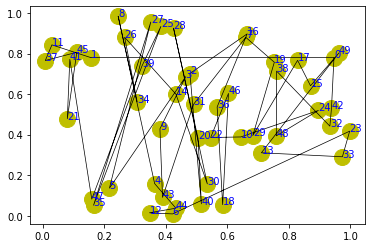

step:210/5000, actic loss:11.961, critic loss:35.940, L:19.519, 0min2sec
step:211/5000, actic loss:11.865, critic loss:35.784, L:19.513, 0min2sec
step:212/5000, actic loss:11.840, critic loss:35.630, L:19.505, 0min2sec
step:213/5000, actic loss:11.833, critic loss:35.476, L:19.497, 0min1sec
step:214/5000, actic loss:11.706, critic loss:35.327, L:19.489, 0min1sec
distance:16.027
tensor([ 0, 26,  2, 34, 44, 28, 32, 18, 42, 14,  8, 12, 24, 48,  6, 38, 20, 22,
        40, 16, 46, 36,  4, 30, 10, 47, 25, 19, 35,  7, 21,  5, 13, 37, 31, 43,
        17, 11, 29, 39, 23, 41, 27,  1,  3,  9, 49, 15, 33, 45])


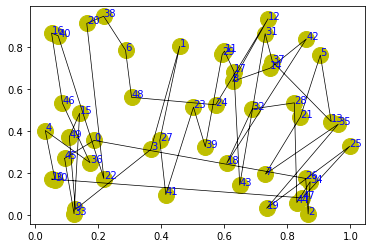

step:215/5000, actic loss:11.608, critic loss:35.177, L:19.481, 0min1sec
step:216/5000, actic loss:11.531, critic loss:35.029, L:19.473, 0min1sec
step:217/5000, actic loss:11.617, critic loss:34.884, L:19.464, 0min1sec
step:218/5000, actic loss:11.715, critic loss:34.745, L:19.456, 0min1sec
step:219/5000, actic loss:11.765, critic loss:34.602, L:19.448, 0min1sec
distance:18.526
tensor([ 0, 12, 38,  2, 18,  6,  4, 14, 24, 48, 20, 10, 36, 46, 34, 16, 30, 22,
        32, 42, 40,  8, 44, 26, 28,  7, 35,  3, 15, 49, 45,  5, 37, 27, 13, 39,
        23, 25, 19, 47, 33, 21,  9, 29, 17, 31,  1, 11, 41, 43])


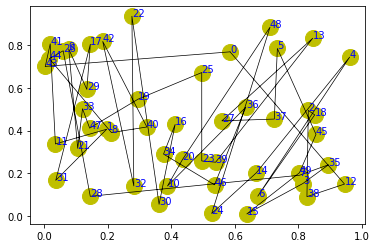

step:220/5000, actic loss:11.693, critic loss:34.459, L:19.441, 0min1sec
step:221/5000, actic loss:11.613, critic loss:34.316, L:19.434, 0min1sec
step:222/5000, actic loss:11.548, critic loss:34.175, L:19.428, 0min1sec
step:223/5000, actic loss:11.653, critic loss:34.038, L:19.420, 0min1sec
step:224/5000, actic loss:11.781, critic loss:33.909, L:19.412, 0min1sec
distance:18.558
tensor([ 0, 40, 42, 12, 44, 38, 30,  8, 32, 14,  2, 16, 26, 48,  6, 24, 18, 46,
        22,  4, 10, 36, 34, 20, 28, 29, 25,  5, 39, 21, 23, 33, 43, 31,  1,  3,
        17, 41, 15, 37, 49, 19, 35, 11, 45,  7, 47,  9, 13, 27])


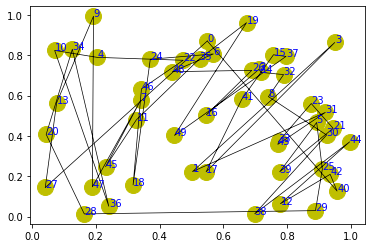

step:225/5000, actic loss:11.895, critic loss:33.782, L:19.404, 0min2sec
step:226/5000, actic loss:11.925, critic loss:33.648, L:19.395, 0min1sec
step:227/5000, actic loss:11.813, critic loss:33.510, L:19.386, 0min1sec
step:228/5000, actic loss:11.624, critic loss:33.382, L:19.378, 0min1sec
step:229/5000, actic loss:11.572, critic loss:33.248, L:19.365, 0min1sec
distance:13.645
tensor([ 0, 44, 10, 14, 46, 48, 16,  4, 38, 18, 20, 36, 30,  6, 40, 22, 24, 42,
        26, 28, 12, 34,  8, 32,  2, 41,  3, 11, 21, 47, 23,  7, 43, 13, 15, 39,
         1, 35, 29,  5, 19, 31, 37, 33, 17, 45, 49, 27,  9, 25])


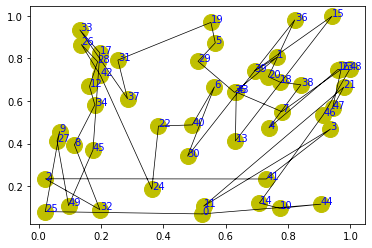

step:230/5000, actic loss:11.423, critic loss:33.116, L:19.355, 0min1sec
step:231/5000, actic loss:11.281, critic loss:32.986, L:19.344, 0min1sec
step:232/5000, actic loss:11.247, critic loss:32.854, L:19.332, 0min1sec
step:233/5000, actic loss:11.199, critic loss:32.726, L:19.320, 0min1sec
step:234/5000, actic loss:11.090, critic loss:32.598, L:19.310, 0min1sec
distance:18.680
tensor([ 0,  4, 40, 18, 46, 26, 28, 30, 36, 14, 44, 38, 32, 22, 34, 12, 48, 42,
         6, 10, 16,  2,  8, 20, 24, 11, 31, 21, 45, 41, 27, 23, 39, 19, 13, 43,
        15,  1,  9, 49, 33, 37, 35,  7, 25,  5, 47, 29,  3, 17])


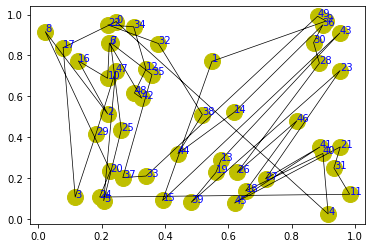

step:235/5000, actic loss:11.053, critic loss:32.472, L:19.296, 0min2sec
step:236/5000, actic loss:10.950, critic loss:32.348, L:19.284, 0min1sec
step:237/5000, actic loss:10.850, critic loss:32.225, L:19.272, 0min1sec
step:238/5000, actic loss:10.807, critic loss:32.099, L:19.260, 0min1sec
step:239/5000, actic loss:10.782, critic loss:31.978, L:19.248, 0min1sec
distance:13.614
tensor([ 0, 38, 36, 22, 46,  4, 16, 30,  2, 12, 10, 26, 20,  6, 28, 34, 40, 44,
        18, 24,  8, 48, 42, 14, 32, 43, 31, 13, 49, 39,  7, 35, 19,  3, 25, 33,
         9, 15,  1, 45, 29, 27, 47, 37, 23, 17, 11, 41, 21,  5])


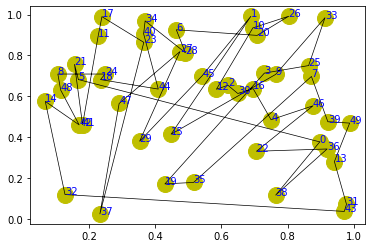

step:240/5000, actic loss:10.721, critic loss:31.856, L:19.236, 0min2sec
step:241/5000, actic loss:10.653, critic loss:31.735, L:19.224, 0min1sec
step:242/5000, actic loss:10.645, critic loss:31.614, L:19.212, 0min1sec
step:243/5000, actic loss:10.589, critic loss:31.496, L:19.202, 0min1sec
step:244/5000, actic loss:10.544, critic loss:31.377, L:19.191, 0min1sec
distance:17.740
tensor([ 0, 16, 36, 38, 46,  2, 22, 44, 42, 32, 18,  6, 14,  8, 34, 20, 40, 28,
        26, 10, 48, 12, 30, 24,  4,  5, 11, 41, 27, 33, 47, 25, 21, 31,  3, 35,
        43,  7, 37, 13, 23, 39, 29, 17,  1, 15, 45, 19, 49,  9])


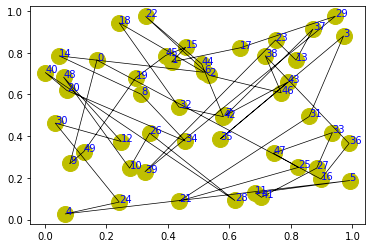

step:245/5000, actic loss:10.355, critic loss:31.263, L:19.183, 0min2sec
step:246/5000, actic loss:10.138, critic loss:31.152, L:19.175, 0min1sec
step:247/5000, actic loss:9.923, critic loss:31.042, L:19.168, 0min1sec
step:248/5000, actic loss:9.893, critic loss:30.927, L:19.161, 0min1sec
step:249/5000, actic loss:9.918, critic loss:30.817, L:19.153, 0min1sec
distance:17.976
tensor([ 0, 16, 12,  8, 46, 32, 14, 10,  6, 24, 28, 36, 34, 38, 22, 26, 40, 42,
        20, 30, 44, 18,  2, 48,  4, 23, 25, 41,  9,  5, 39, 17,  7, 15, 31, 21,
        27, 19, 49, 35, 37, 43,  3, 33, 45, 29, 47,  1, 11, 13])


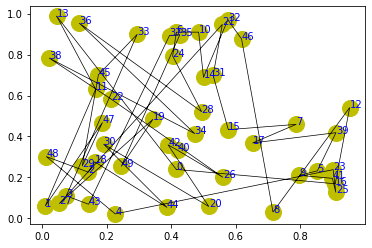

step:250/5000, actic loss:9.953, critic loss:30.705, L:19.144, 0min1sec
step:251/5000, actic loss:9.961, critic loss:30.595, L:19.134, 0min1sec
step:252/5000, actic loss:9.847, critic loss:30.487, L:19.124, 0min1sec
step:253/5000, actic loss:9.714, critic loss:30.379, L:19.112, 0min1sec
step:254/5000, actic loss:9.610, critic loss:30.270, L:19.101, 0min1sec
distance:17.412
tensor([ 0, 18, 28, 32, 40,  2, 38,  4, 22, 12, 14, 10, 42,  6, 44,  8, 46, 20,
        34, 48, 30, 26, 36, 24, 16, 31, 25, 45, 43, 29, 11, 23, 35, 15, 33,  7,
         9, 17,  3, 39, 41, 19, 37,  5, 49, 13, 47, 21, 27,  1])


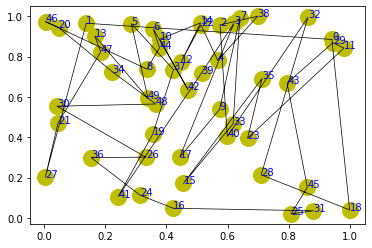

step:255/5000, actic loss:9.565, critic loss:30.161, L:19.089, 0min1sec
step:256/5000, actic loss:9.579, critic loss:30.054, L:19.080, 0min1sec
step:257/5000, actic loss:9.647, critic loss:29.949, L:19.070, 0min1sec
step:258/5000, actic loss:9.717, critic loss:29.846, L:19.060, 0min1sec
step:259/5000, actic loss:9.703, critic loss:29.741, L:19.050, 0min1sec
distance:18.018
tensor([ 0, 16, 42,  6, 24,  4, 18, 44, 34, 22, 38, 12, 14,  2, 20, 48, 46, 26,
        36, 30, 28, 32, 40,  8, 10, 27, 43, 31, 13, 29, 35, 37, 49,  7, 11,  1,
        41, 21, 47, 15,  5, 39, 33, 25, 17,  3,  9, 23, 45, 19])


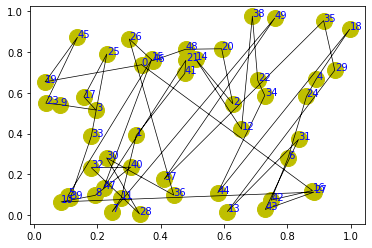

step:260/5000, actic loss:9.645, critic loss:29.635, L:19.039, 0min1sec
step:261/5000, actic loss:9.526, critic loss:29.534, L:19.028, 0min1sec
step:262/5000, actic loss:9.452, critic loss:29.430, L:19.016, 0min1sec
step:263/5000, actic loss:9.422, critic loss:29.326, L:19.005, 0min1sec
step:264/5000, actic loss:9.395, critic loss:29.222, L:18.993, 0min1sec
distance:14.875
tensor([ 0, 24, 16, 20,  8, 38,  2, 34,  4,  6, 12, 32, 42, 44, 46, 26, 40, 18,
        28, 30, 36, 14, 10, 48, 22, 19, 45, 11, 23,  5, 13, 39,  9,  1, 15, 31,
        41, 21, 49, 17, 27, 29, 33, 47,  7, 37, 43, 25,  3, 35])


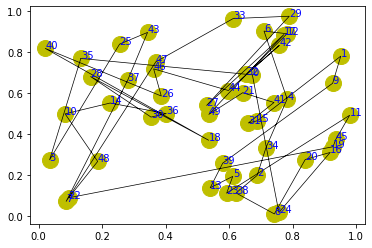

step:265/5000, actic loss:9.305, critic loss:29.121, L:18.983, 0min1sec
step:266/5000, actic loss:9.265, critic loss:29.021, L:18.971, 0min1sec
step:267/5000, actic loss:9.244, critic loss:28.923, L:18.959, 0min1sec
step:268/5000, actic loss:9.131, critic loss:28.827, L:18.949, 0min1sec
step:269/5000, actic loss:9.058, critic loss:28.730, L:18.937, 0min1sec
distance:17.047
tensor([ 0, 18, 12, 42, 38, 28,  4,  8, 16, 20, 14, 30,  6, 24, 10, 34, 36, 46,
        40, 22, 32, 26, 48,  2, 44, 21, 35, 41, 47, 19, 43,  5, 13, 25, 17, 27,
        15,  1,  7, 23, 33, 45, 49, 31,  9, 37,  3, 39, 11, 29])


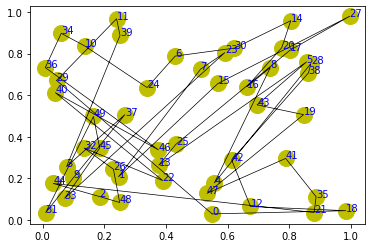

step:270/5000, actic loss:9.029, critic loss:28.633, L:18.927, 0min2sec
step:271/5000, actic loss:9.037, critic loss:28.537, L:18.915, 0min1sec
step:272/5000, actic loss:8.970, critic loss:28.440, L:18.904, 0min1sec
step:273/5000, actic loss:8.927, critic loss:28.345, L:18.893, 0min1sec
step:274/5000, actic loss:8.929, critic loss:28.250, L:18.883, 0min1sec
distance:17.197
tensor([ 0, 38,  2, 12, 24, 28, 26, 36, 30, 20, 22,  6, 14, 34, 42, 10, 16, 44,
        46, 48,  8, 40, 18, 32,  4, 43, 19,  3, 15, 45, 23, 21, 41,  1, 37, 27,
        33,  9, 47,  5, 31, 11, 17,  7, 39, 49, 25, 29, 35, 13])


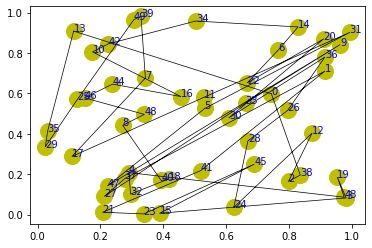

step:275/5000, actic loss:8.994, critic loss:28.157, L:18.871, 0min1sec
step:276/5000, actic loss:8.972, critic loss:28.064, L:18.860, 0min1sec
step:277/5000, actic loss:8.880, critic loss:27.971, L:18.848, 0min1sec
step:278/5000, actic loss:8.755, critic loss:27.884, L:18.836, 0min1sec
step:279/5000, actic loss:8.658, critic loss:27.793, L:18.824, 0min1sec
distance:14.267
tensor([ 0,  8,  2, 38, 32,  4,  6, 46, 48, 22, 16, 12, 28, 42, 18, 10, 44, 30,
        40, 20, 34, 36, 26, 24, 14, 35, 21, 13, 29, 37, 47, 31, 17,  1, 23,  3,
        39,  9, 49,  5, 33, 19, 15, 45, 27, 41,  7, 25, 11, 43])


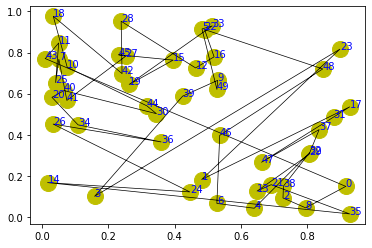

step:280/5000, actic loss:8.660, critic loss:27.702, L:18.812, 0min2sec
step:281/5000, actic loss:8.674, critic loss:27.612, L:18.799, 0min1sec
step:282/5000, actic loss:8.655, critic loss:27.523, L:18.787, 0min1sec
step:283/5000, actic loss:8.480, critic loss:27.439, L:18.777, 0min1sec
step:284/5000, actic loss:8.221, critic loss:27.365, L:18.768, 0min1sec
distance:15.821
tensor([ 0, 38, 44, 16, 42, 36,  4, 28,  6, 34, 32, 22, 20, 12, 40, 48,  2, 46,
        10, 14,  8, 26, 18, 30, 24, 43, 39,  9, 37,  7, 25, 33,  5, 27, 47, 19,
        49, 11, 21, 31, 45, 41,  1, 35, 15, 17, 23, 29, 13,  3])


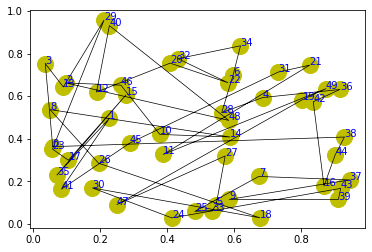

step:285/5000, actic loss:8.024, critic loss:27.282, L:18.758, 0min1sec
step:286/5000, actic loss:7.882, critic loss:27.197, L:18.749, 0min1sec
step:287/5000, actic loss:7.893, critic loss:27.113, L:18.739, 0min1sec
step:288/5000, actic loss:7.978, critic loss:27.029, L:18.729, 0min1sec
step:289/5000, actic loss:8.112, critic loss:26.949, L:18.717, 0min1sec
distance:14.936
tensor([ 0,  8, 10, 20, 36, 32, 30, 18, 12, 22, 34, 46,  4,  2, 48, 26, 44, 42,
        24, 16,  6, 40, 14, 28, 38, 41, 27, 37, 31, 19, 49,  5, 29, 11, 47,  1,
         9, 39, 13,  3, 17, 35, 15, 21,  7, 23, 33, 45, 25, 43])


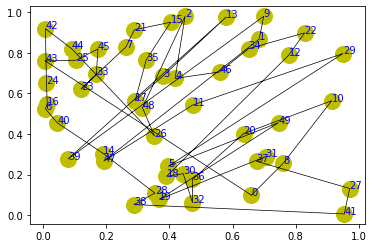

step:290/5000, actic loss:8.173, critic loss:26.868, L:18.706, 0min1sec
step:291/5000, actic loss:8.164, critic loss:26.781, L:18.694, 0min1sec
step:292/5000, actic loss:8.007, critic loss:26.700, L:18.683, 0min1sec
step:293/5000, actic loss:7.824, critic loss:26.625, L:18.672, 0min1sec
step:294/5000, actic loss:7.626, critic loss:26.548, L:18.660, 0min2sec
distance:16.901
tensor([ 0, 32, 48, 12, 38,  4, 36, 10, 30, 42, 40, 46, 44,  2, 28, 26,  6, 20,
        14, 22, 16, 18,  8, 24, 34, 15, 45, 39,  1, 21, 35, 41, 19, 13,  7, 29,
        11, 43, 47, 25, 33, 23, 31,  9, 37, 17, 49,  3, 27,  5])


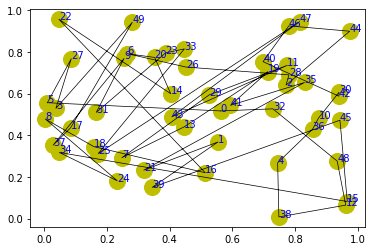

step:295/5000, actic loss:7.387, critic loss:26.476, L:18.650, 0min2sec
step:296/5000, actic loss:7.292, critic loss:26.394, L:18.639, 0min1sec
step:297/5000, actic loss:7.307, critic loss:26.314, L:18.628, 0min1sec
step:298/5000, actic loss:7.377, critic loss:26.237, L:18.618, 0min1sec
step:299/5000, actic loss:7.448, critic loss:26.161, L:18.608, 0min1sec
distance:12.903
tensor([36, 22, 40, 16, 32, 12, 24,  4, 20,  8, 30, 26, 38, 48, 46,  0, 34,  6,
        42, 10, 28, 18, 14, 44,  2, 49, 13,  1, 33, 47, 11,  3, 15,  9, 25, 19,
        17, 29, 41, 35, 31, 45, 43, 37, 21, 27,  7,  5, 39, 23])


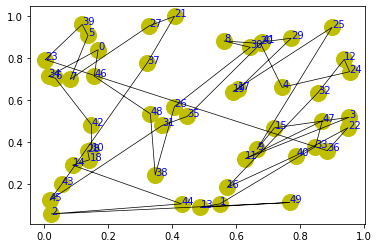

step:300/5000, actic loss:7.453, critic loss:26.083, L:18.598, 0min2sec
step:301/5000, actic loss:7.365, critic loss:26.004, L:18.589, 0min1sec
step:302/5000, actic loss:7.236, critic loss:25.929, L:18.581, 0min1sec
step:303/5000, actic loss:7.087, critic loss:25.857, L:18.574, 0min1sec
step:304/5000, actic loss:6.997, critic loss:25.782, L:18.568, 0min1sec
distance:14.808
tensor([ 0,  6, 32, 12, 38, 34, 46,  4, 10,  2, 22, 36, 30, 26, 18, 20,  8, 48,
        16, 28, 42, 40, 24, 14, 44, 33, 41, 37, 29, 35, 39, 13, 17, 11,  1, 15,
        45, 27, 21,  9, 31, 49, 47,  3, 43, 19, 23,  7, 25,  5])


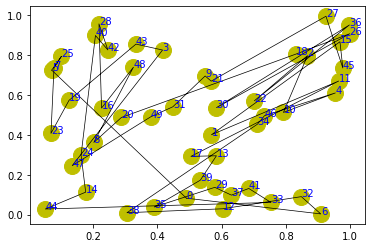

step:305/5000, actic loss:6.976, critic loss:25.709, L:18.562, 0min2sec
step:306/5000, actic loss:6.993, critic loss:25.636, L:18.556, 0min1sec
step:307/5000, actic loss:6.919, critic loss:25.561, L:18.553, 0min1sec
step:308/5000, actic loss:6.887, critic loss:25.488, L:18.551, 0min1sec
step:309/5000, actic loss:6.980, critic loss:25.418, L:18.547, 0min1sec
distance:15.926
tensor([ 0,  8, 20, 32, 30, 24, 40, 14, 18, 16, 46, 26, 44, 22, 12, 48, 36, 10,
         2, 42,  6,  4, 28, 38, 34,  3, 29, 45,  7, 21, 39, 35, 25, 31, 43, 37,
        17,  5, 13, 33, 19, 11,  1, 41, 47,  9, 27, 15, 23, 49])


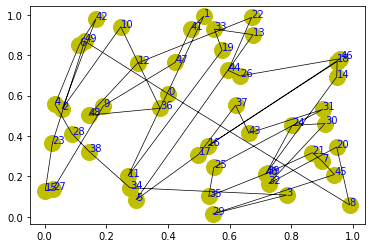

step:310/5000, actic loss:7.178, critic loss:25.356, L:18.542, 0min1sec
step:311/5000, actic loss:7.361, critic loss:25.298, L:18.536, 0min1sec
step:312/5000, actic loss:7.493, critic loss:25.233, L:18.529, 0min1sec
step:313/5000, actic loss:7.569, critic loss:25.166, L:18.521, 0min1sec
step:314/5000, actic loss:7.544, critic loss:25.094, L:18.513, 0min1sec
distance:15.254
tensor([ 0, 24,  2, 36,  4, 18, 40, 46, 20, 26, 34,  8, 28, 42, 44, 38, 48, 16,
        32, 22, 30, 12,  6, 10, 14, 23, 21,  3, 41, 17, 27, 35, 45,  7, 49, 25,
         5, 43, 11, 29, 13, 15, 37, 47,  1,  9, 33, 19, 39, 31])


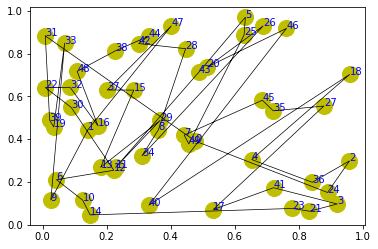

step:315/5000, actic loss:7.390, critic loss:25.031, L:18.505, 0min2sec
step:316/5000, actic loss:7.202, critic loss:24.975, L:18.496, 0min2sec
step:317/5000, actic loss:6.975, critic loss:24.923, L:18.488, 0min1sec
step:318/5000, actic loss:6.761, critic loss:24.868, L:18.479, 0min1sec
step:319/5000, actic loss:6.592, critic loss:24.808, L:18.470, 0min1sec
distance:18.463
tensor([ 0, 20, 30, 44,  4, 36, 32, 16, 18,  8, 40, 34, 12,  2, 10, 48, 42,  6,
        24, 26, 38, 46, 14, 28, 22, 47, 45, 13, 29, 17,  7, 31,  3, 23, 41,  1,
         9, 33, 37, 15, 43, 27, 25, 49,  5, 35, 21, 19, 11, 39])


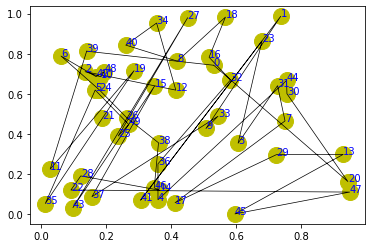

step:320/5000, actic loss:6.468, critic loss:24.743, L:18.462, 0min1sec
step:321/5000, actic loss:6.435, critic loss:24.672, L:18.453, 0min1sec
step:322/5000, actic loss:6.506, critic loss:24.606, L:18.446, 0min1sec
step:323/5000, actic loss:6.679, critic loss:24.550, L:18.438, 0min1sec
step:324/5000, actic loss:6.924, critic loss:24.506, L:18.429, 0min1sec
distance:17.121
tensor([44, 22, 42, 14, 40, 30, 48, 26, 16,  0, 12, 28, 32, 20,  6, 18, 34,  2,
         8, 24, 46, 10,  4, 38, 36,  3, 17, 27, 11,  1, 21, 35, 13, 37, 41, 45,
        43, 15,  5, 23, 29, 33, 47,  7, 49, 25, 39, 19, 31,  9])


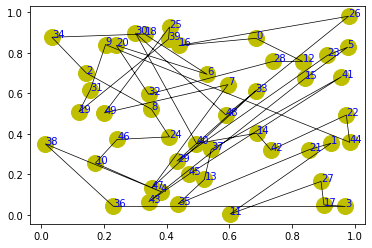

step:325/5000, actic loss:7.158, critic loss:24.460, L:18.421, 0min1sec
step:326/5000, actic loss:7.304, critic loss:24.398, L:18.415, 0min1sec
step:327/5000, actic loss:7.312, critic loss:24.332, L:18.410, 0min1sec
step:328/5000, actic loss:7.222, critic loss:24.267, L:18.404, 0min1sec
step:329/5000, actic loss:7.124, critic loss:24.202, L:18.397, 0min2sec
distance:14.777
tensor([ 0, 42,  4, 12, 48, 30, 24, 28, 44, 18, 16, 26, 32,  2, 40, 36, 10, 46,
        20,  6, 38,  8, 14, 34, 22,  3, 37, 19, 43, 31, 21, 45, 39, 33,  7, 49,
        17, 29, 25, 13, 15, 23, 41,  5,  9,  1, 47, 27, 11, 35])


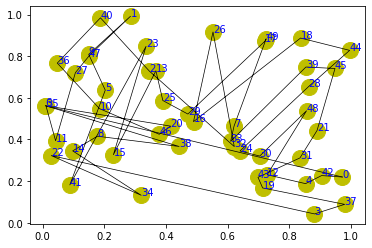

step:330/5000, actic loss:7.042, critic loss:24.137, L:18.390, 0min2sec
step:331/5000, actic loss:6.960, critic loss:24.073, L:18.383, 0min1sec
step:332/5000, actic loss:6.950, critic loss:24.008, L:18.376, 0min1sec
step:333/5000, actic loss:6.934, critic loss:23.945, L:18.370, 0min1sec
step:334/5000, actic loss:6.931, critic loss:23.882, L:18.363, 0min1sec
distance:15.420
tensor([24, 10,  4, 30, 38, 20, 16, 12, 48, 28,  2,  6, 32, 44, 22, 42, 40, 46,
         0, 34,  8, 36, 14, 26, 18, 23, 27, 37, 19, 21, 11, 39, 45, 43, 33,  1,
         7, 29, 47, 35, 25, 31, 15, 49, 41, 17,  3, 13,  9,  5])


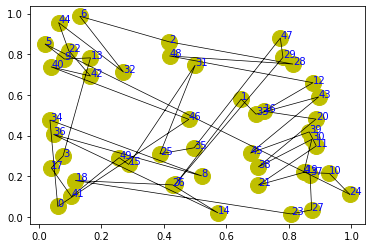

step:335/5000, actic loss:6.894, critic loss:23.819, L:18.356, 0min1sec
step:336/5000, actic loss:6.839, critic loss:23.755, L:18.348, 0min1sec
step:337/5000, actic loss:6.826, critic loss:23.692, L:18.340, 0min1sec
step:338/5000, actic loss:6.827, critic loss:23.630, L:18.332, 0min1sec
step:339/5000, actic loss:6.789, critic loss:23.567, L:18.323, 0min1sec
distance:15.047
tensor([38, 18, 48, 36, 14, 44, 20, 28,  4,  8, 32, 40, 34,  0, 22, 16, 10, 42,
        26, 30, 46,  6, 24,  2, 12,  3, 47, 27,  9, 25, 11, 41, 19, 37, 15,  7,
        45, 21, 31, 23,  1, 43, 49, 33, 39, 35, 13,  5, 17, 29])


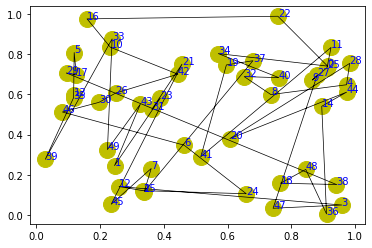

step:340/5000, actic loss:6.744, critic loss:23.504, L:18.314, 0min1sec
step:341/5000, actic loss:6.726, critic loss:23.442, L:18.305, 0min1sec
step:342/5000, actic loss:6.675, critic loss:23.380, L:18.298, 0min1sec
step:343/5000, actic loss:6.656, critic loss:23.318, L:18.290, 0min1sec
step:344/5000, actic loss:6.661, critic loss:23.256, L:18.280, 0min1sec
distance:15.198
tensor([14,  2,  6, 18, 32,  8,  4, 48, 24, 34, 20, 46, 38,  0, 22, 12, 28, 30,
        16, 36, 42, 40, 26, 44, 10, 33, 29, 47, 43, 17, 15, 27, 49, 11, 31, 21,
        39,  7, 25, 23, 41,  3, 37,  9, 19, 45,  5, 35, 13,  1])


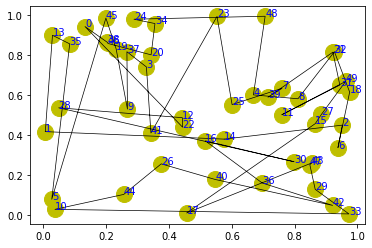

step:345/5000, actic loss:6.617, critic loss:23.195, L:18.272, 0min1sec
step:346/5000, actic loss:6.556, critic loss:23.134, L:18.264, 0min1sec
step:347/5000, actic loss:6.499, critic loss:23.075, L:18.256, 0min1sec
step:348/5000, actic loss:6.509, critic loss:23.016, L:18.249, 0min1sec
step:349/5000, actic loss:6.524, critic loss:22.956, L:18.241, 0min1sec
distance:15.241
tensor([42, 46,  4, 22, 20, 26,  0, 36, 32, 40,  6, 28, 12, 34, 38,  2,  8, 14,
        18, 30, 10, 24, 16, 48, 44,  7, 27, 43,  1, 11, 25, 15, 19,  5, 31, 41,
        35, 17, 37,  9,  3, 33, 45, 21, 23, 49, 13, 47, 39, 29])


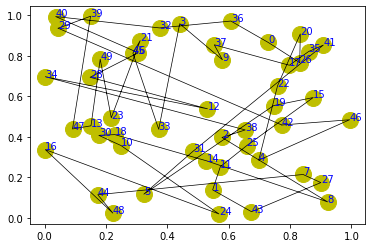

step:350/5000, actic loss:6.539, critic loss:22.898, L:18.234, 0min1sec
step:351/5000, actic loss:6.542, critic loss:22.841, L:18.225, 0min1sec
step:352/5000, actic loss:6.493, critic loss:22.782, L:18.216, 0min1sec
step:353/5000, actic loss:6.418, critic loss:22.726, L:18.207, 0min1sec
step:354/5000, actic loss:6.338, critic loss:22.668, L:18.198, 0min1sec
distance:14.886
tensor([16, 38, 42, 24, 14, 20,  2, 34, 12, 30, 18, 26, 32,  6,  4,  0,  8, 36,
        40, 44, 28, 48, 46, 10, 22, 41, 15, 33, 49, 23, 29, 47, 21, 11, 13,  9,
        19, 25, 39, 45, 17,  1,  5, 31, 27,  7, 35,  3, 43, 37])


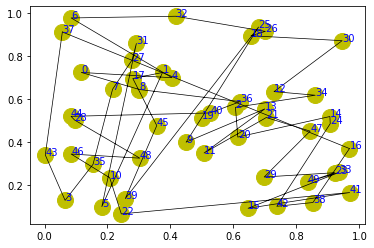

step:355/5000, actic loss:6.305, critic loss:22.610, L:18.189, 0min2sec
step:356/5000, actic loss:6.299, critic loss:22.553, L:18.180, 0min2sec
step:357/5000, actic loss:6.329, critic loss:22.497, L:18.172, 0min2sec
step:358/5000, actic loss:6.357, critic loss:22.441, L:18.163, 0min1sec
step:359/5000, actic loss:6.334, critic loss:22.385, L:18.155, 0min1sec
distance:16.094
tensor([42, 36, 46,  4,  0, 44, 28, 12, 14, 26, 24, 34, 18, 38, 40,  8, 48, 22,
         6, 32, 20, 30, 16, 10,  2, 41, 37,  9, 29, 47, 45, 17,  5,  7,  1, 49,
        15,  3, 31, 27, 19, 11, 21, 43, 39, 25, 35, 23, 33, 13])


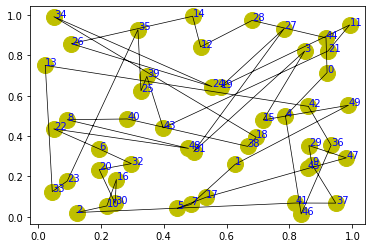

step:360/5000, actic loss:6.310, critic loss:22.329, L:18.147, 0min1sec
step:361/5000, actic loss:6.307, critic loss:22.273, L:18.139, 0min1sec
step:362/5000, actic loss:6.306, critic loss:22.218, L:18.130, 0min1sec
step:363/5000, actic loss:6.255, critic loss:22.164, L:18.123, 0min1sec
step:364/5000, actic loss:6.201, critic loss:22.108, L:18.115, 0min1sec
distance:14.450
tensor([20, 22, 32, 44, 36, 42, 10, 18, 46, 12,  4, 38, 24, 16,  2,  0, 34, 14,
        28, 30,  8, 26, 48, 40,  6, 17, 23,  3, 15,  9, 21,  7,  5, 25, 37, 35,
        19, 39, 27, 33, 13, 47, 45, 11, 31, 41,  1, 49, 29, 43])


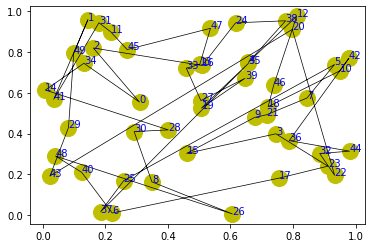

step:365/5000, actic loss:6.191, critic loss:22.053, L:18.107, 0min1sec
step:366/5000, actic loss:6.173, critic loss:21.998, L:18.099, 0min1sec
step:367/5000, actic loss:6.122, critic loss:21.943, L:18.091, 0min1sec
step:368/5000, actic loss:6.076, critic loss:21.890, L:18.083, 0min1sec
step:369/5000, actic loss:6.055, critic loss:21.835, L:18.075, 0min1sec
distance:16.599
tensor([14, 24, 48,  6, 38, 20, 46, 40, 34,  8, 26, 36,  2,  0, 22, 44, 12, 28,
        32, 10, 18, 42, 30,  4, 16, 25, 39, 31, 45, 27, 29,  3, 23, 49,  5, 15,
        11,  1, 47, 37,  9, 33, 41, 19, 21, 43, 17, 35,  7, 13])


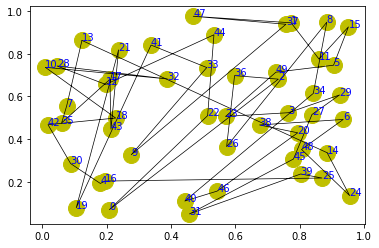

step:370/5000, actic loss:6.072, critic loss:21.783, L:18.068, 0min2sec
step:371/5000, actic loss:6.107, critic loss:21.731, L:18.061, 0min1sec
step:372/5000, actic loss:6.134, critic loss:21.679, L:18.054, 0min1sec
step:373/5000, actic loss:6.108, critic loss:21.627, L:18.047, 0min1sec
step:374/5000, actic loss:6.096, critic loss:21.575, L:18.040, 0min1sec
distance:18.181
tensor([ 6, 36, 26, 42, 24,  2,  8, 22, 30, 46, 34, 48, 32,  4, 14, 18, 10,  0,
        12, 44, 20, 38, 16, 40, 28,  7, 47, 35, 21,  9, 27, 31, 43, 25, 13, 45,
        41, 29,  1, 37, 19,  5, 15, 39, 23, 49, 17, 11, 33,  3])


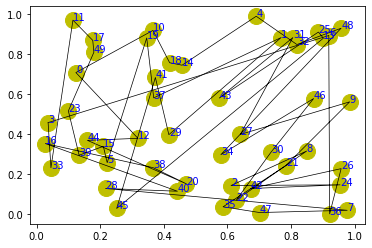

step:375/5000, actic loss:6.076, critic loss:21.523, L:18.032, 0min1sec
step:376/5000, actic loss:6.010, critic loss:21.473, L:18.024, 0min1sec
step:377/5000, actic loss:5.927, critic loss:21.424, L:18.017, 0min1sec
step:378/5000, actic loss:5.896, critic loss:21.373, L:18.010, 0min1sec
step:379/5000, actic loss:5.920, critic loss:21.323, L:18.002, 0min1sec
distance:15.200
tensor([20, 48, 38, 26, 40,  4, 46, 42, 36, 34, 18, 12, 28, 22, 14,  0, 24,  6,
        30, 32, 16, 10, 44,  2,  8, 39,  7, 11, 25, 21, 23,  1, 43, 31,  5,  3,
        49, 45, 35, 41, 17, 37, 27, 15, 19,  9, 47, 13, 29, 33])


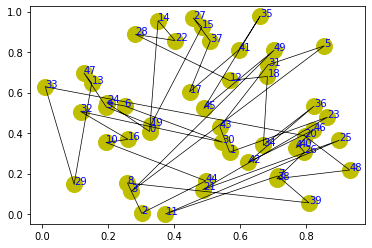

step:380/5000, actic loss:5.967, critic loss:21.276, L:17.994, 0min1sec
step:381/5000, actic loss:5.999, critic loss:21.228, L:17.985, 0min1sec
step:382/5000, actic loss:6.007, critic loss:21.178, L:17.977, 0min1sec
step:383/5000, actic loss:5.957, critic loss:21.129, L:17.969, 0min1sec
step:384/5000, actic loss:5.896, critic loss:21.081, L:17.961, 0min1sec
distance:15.041
tensor([12,  6, 36,  8, 44, 28, 32, 16, 48, 24,  2,  0, 38, 14, 46,  4, 20, 22,
        10, 40, 18, 26, 42, 34, 30, 33, 15, 47, 31, 29,  7, 27, 39, 41, 37, 23,
        45,  9, 49,  5, 19,  3, 17, 35, 43, 11, 21, 13,  1, 25])


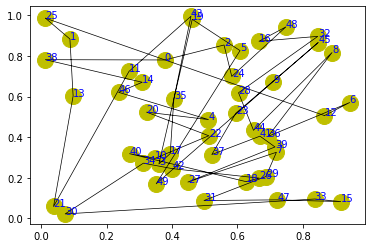

step:385/5000, actic loss:5.804, critic loss:21.035, L:17.955, 0min1sec
step:386/5000, actic loss:5.747, critic loss:20.986, L:17.947, 0min1sec
step:387/5000, actic loss:5.733, critic loss:20.938, L:17.940, 0min1sec
step:388/5000, actic loss:5.741, critic loss:20.890, L:17.933, 0min2sec
step:389/5000, actic loss:5.749, critic loss:20.842, L:17.926, 0min1sec
distance:16.156
tensor([42, 34, 22, 48, 32, 24, 12, 18,  6, 36, 30,  8, 40,  0, 20, 16, 28, 26,
        14, 38, 10,  2, 46, 44,  4, 23, 35, 17, 41, 45, 15,  7, 11, 13, 47, 33,
        39, 37, 31, 21,  3, 29,  1,  5,  9, 27, 49, 43, 25, 19])


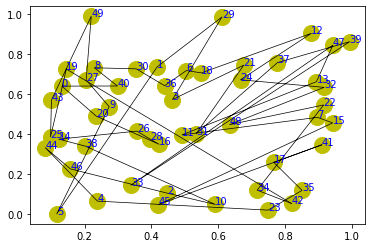

step:390/5000, actic loss:5.740, critic loss:20.792, L:17.918, 0min1sec
step:391/5000, actic loss:5.691, critic loss:20.745, L:17.910, 0min1sec
step:392/5000, actic loss:5.624, critic loss:20.699, L:17.902, 0min1sec
step:393/5000, actic loss:5.556, critic loss:20.654, L:17.894, 0min1sec
step:394/5000, actic loss:5.517, critic loss:20.607, L:17.887, 0min1sec
distance:13.526
tensor([40, 46, 38, 34, 42, 24,  0, 48, 44, 32,  8, 12, 36, 14, 28, 20,  4, 26,
        16, 18,  6, 10, 30, 22,  2, 35, 29, 15,  3, 27, 23, 19, 17, 33, 21, 45,
        25, 31, 11, 41, 39,  7, 49,  5, 13, 43,  9, 47,  1, 37])


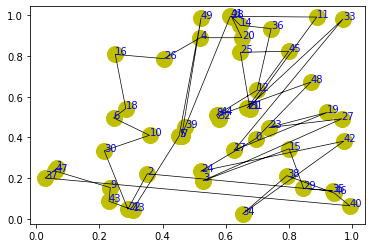

step:395/5000, actic loss:5.526, critic loss:20.561, L:17.879, 0min1sec
step:396/5000, actic loss:5.555, critic loss:20.515, L:17.871, 0min1sec
step:397/5000, actic loss:5.583, critic loss:20.468, L:17.864, 0min1sec
step:398/5000, actic loss:5.580, critic loss:20.422, L:17.856, 0min1sec
step:399/5000, actic loss:5.522, critic loss:20.377, L:17.848, 0min1sec
distance:16.568
tensor([46, 18, 12, 10, 40, 48, 24, 32,  0,  6, 14, 20, 34, 26,  4, 22, 44, 38,
         2,  8, 16, 28, 42, 36, 30, 31, 13,  9, 45, 29,  1, 17, 15, 39, 33, 35,
        41, 25, 43, 47, 19, 27,  7,  5, 11,  3, 37, 23, 21, 49])


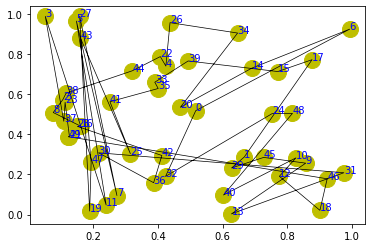

step:400/5000, actic loss:5.458, critic loss:20.332, L:17.840, 0min1sec
step:401/5000, actic loss:5.391, critic loss:20.288, L:17.833, 0min1sec
step:402/5000, actic loss:5.353, critic loss:20.242, L:17.825, 0min1sec
step:403/5000, actic loss:5.355, critic loss:20.198, L:17.818, 0min1sec
step:404/5000, actic loss:5.397, critic loss:20.154, L:17.810, 0min1sec
distance:16.460
tensor([26,  2, 22, 24, 32, 20, 34, 14, 38, 30, 44, 16, 40, 12, 10, 18, 42,  4,
        28, 46,  8,  6,  0, 48, 36, 23, 11, 47,  3, 43, 33,  9, 15,  7, 19, 31,
         5, 39, 29, 45, 13, 49, 41, 35, 17,  1, 25, 21, 37, 27])


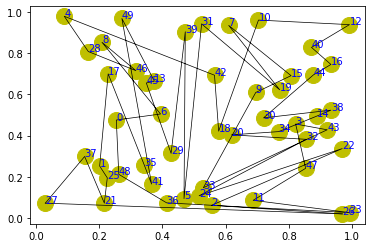

step:405/5000, actic loss:5.432, critic loss:20.112, L:17.803, 0min1sec
step:406/5000, actic loss:5.453, critic loss:20.068, L:17.795, 0min1sec
step:407/5000, actic loss:5.419, critic loss:20.022, L:17.787, 0min1sec
step:408/5000, actic loss:5.358, critic loss:19.979, L:17.779, 0min1sec
step:409/5000, actic loss:5.281, critic loss:19.937, L:17.772, 0min1sec
distance:14.618
tensor([38, 16, 22,  0, 42,  8, 12,  4, 44, 30, 20,  2, 10,  6, 36, 32, 24, 48,
        28, 14, 34, 40, 26, 46, 18, 35, 21, 23,  7, 47, 39, 19, 33, 41, 29,  9,
        45, 17, 31, 13, 15,  3,  5,  1, 37, 49, 43, 11, 27, 25])


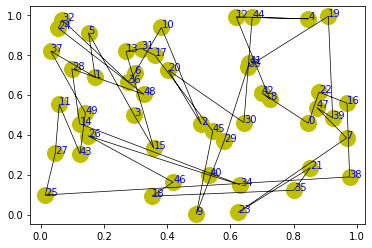

step:410/5000, actic loss:5.191, critic loss:19.897, L:17.767, 0min1sec
step:411/5000, actic loss:5.156, critic loss:19.855, L:17.762, 0min1sec
step:412/5000, actic loss:5.218, critic loss:19.815, L:17.756, 0min1sec
step:413/5000, actic loss:5.350, critic loss:19.785, L:17.748, 0min1sec
step:414/5000, actic loss:5.479, critic loss:19.757, L:17.741, 0min1sec
distance:15.600
tensor([ 0, 28, 22, 30, 44, 16, 36,  6, 26, 38, 18, 32, 48, 24,  8, 34,  2, 14,
         4, 40, 12, 10, 20, 42, 46,  9, 37, 43, 47, 33, 29, 13, 19,  5, 15, 35,
         1, 49, 27, 39, 25, 11, 41, 31, 17,  3,  7, 23, 45, 21])


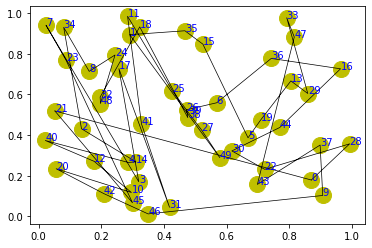

step:415/5000, actic loss:5.613, critic loss:19.726, L:17.734, 0min1sec
step:416/5000, actic loss:5.705, critic loss:19.688, L:17.727, 0min1sec
step:417/5000, actic loss:5.734, critic loss:19.647, L:17.720, 0min1sec
step:418/5000, actic loss:5.706, critic loss:19.605, L:17.713, 0min1sec
step:419/5000, actic loss:5.640, critic loss:19.564, L:17.705, 0min1sec
distance:13.100
tensor([44,  0, 12, 36, 24, 42, 10, 46,  2, 22, 28,  8, 20, 30, 26, 16,  4, 14,
        18,  6, 32, 40, 34, 48, 38,  1, 21, 19, 31, 35, 25, 49, 47,  9, 43, 29,
        33,  3, 37, 27,  7, 41, 39, 13, 45, 23, 17,  5, 11, 15])


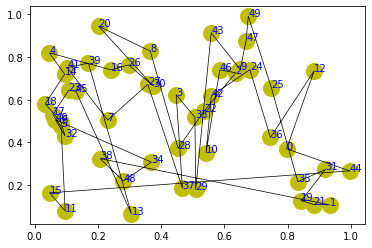

step:420/5000, actic loss:5.553, critic loss:19.525, L:17.698, 0min1sec
step:421/5000, actic loss:5.467, critic loss:19.487, L:17.691, 0min1sec
step:422/5000, actic loss:5.407, critic loss:19.447, L:17.685, 0min1sec
step:423/5000, actic loss:5.398, critic loss:19.406, L:17.679, 0min1sec
step:424/5000, actic loss:5.426, critic loss:19.365, L:17.672, 0min1sec
distance:14.426
tensor([32,  6, 44, 20, 24, 36, 10, 14, 16, 18,  2, 28, 22, 26, 40, 46, 34,  0,
         8, 12, 30, 38, 48, 42,  4, 43, 33,  7, 41,  9, 31, 29,  1, 11, 39, 17,
        25, 19, 47, 15, 45, 21, 27,  5, 49,  3, 37, 13, 35, 23])


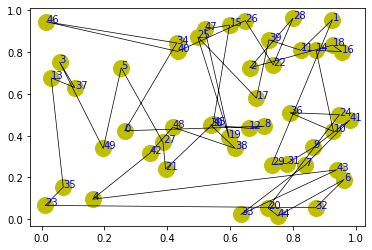

step:425/5000, actic loss:5.454, critic loss:19.325, L:17.666, 0min1sec
step:426/5000, actic loss:5.483, critic loss:19.285, L:17.658, 0min1sec
step:427/5000, actic loss:5.470, critic loss:19.244, L:17.650, 0min1sec
step:428/5000, actic loss:5.401, critic loss:19.204, L:17.643, 0min1sec
step:429/5000, actic loss:5.300, critic loss:19.168, L:17.635, 0min1sec
distance:16.687
tensor([ 6, 18, 40, 10, 22, 32, 12, 48, 14,  0, 46, 24, 36, 16, 38, 44,  8, 34,
        28, 26, 30,  4, 20, 42,  2, 33, 41, 23, 25, 39,  1,  7, 49, 21, 35, 45,
        27, 47, 43, 13, 11, 31,  5,  3, 17, 37, 29, 19,  9, 15])


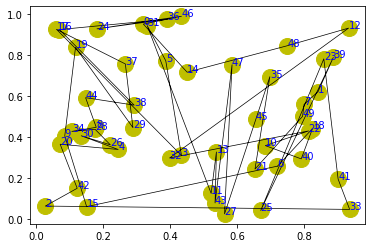

step:430/5000, actic loss:5.141, critic loss:19.137, L:17.629, 0min1sec
step:431/5000, actic loss:5.029, critic loss:19.101, L:17.622, 0min1sec
step:432/5000, actic loss:4.971, critic loss:19.062, L:17.614, 0min1sec
step:433/5000, actic loss:4.940, critic loss:19.022, L:17.608, 0min1sec
step:434/5000, actic loss:5.007, critic loss:18.987, L:17.601, 0min1sec
distance:13.302
tensor([40, 32, 28, 36, 10,  0, 22, 26, 16, 38, 12,  6, 34, 24,  4, 14,  2, 48,
        18,  8, 20, 46, 30, 42, 44, 49, 25, 23, 45,  5, 15, 47, 19, 11, 27,  1,
        13, 31, 41, 39, 43,  3, 33, 21, 37,  7,  9, 29, 17, 35])


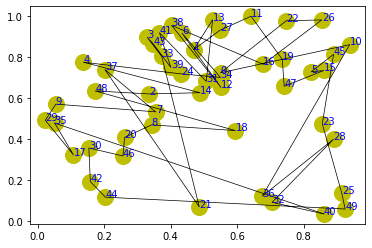

step:435/5000, actic loss:5.092, critic loss:18.955, L:17.594, 0min1sec
step:436/5000, actic loss:5.173, critic loss:18.923, L:17.588, 0min1sec
step:437/5000, actic loss:5.232, critic loss:18.888, L:17.583, 0min1sec
step:438/5000, actic loss:5.266, critic loss:18.852, L:17.579, 0min1sec
step:439/5000, actic loss:5.273, critic loss:18.814, L:17.573, 0min1sec
distance:15.022
tensor([36, 38,  0, 42, 10, 26, 14, 22, 32, 48, 28,  2,  6, 24, 12, 46,  8, 34,
         4, 30, 18, 44, 16, 20, 40, 31, 45, 27, 39, 13,  1, 47,  9, 49, 41, 19,
        23, 33, 29, 21, 43,  7, 15, 11, 37,  3, 25, 35,  5, 17])


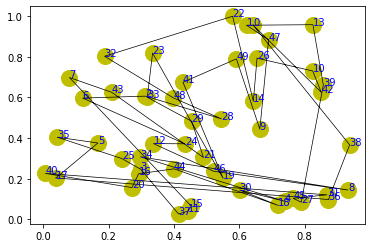

step:440/5000, actic loss:5.224, critic loss:18.777, L:17.567, 0min1sec
step:441/5000, actic loss:5.143, critic loss:18.742, L:17.562, 0min1sec
step:442/5000, actic loss:5.070, critic loss:18.706, L:17.556, 0min1sec
step:443/5000, actic loss:5.035, critic loss:18.669, L:17.548, 0min1sec
step:444/5000, actic loss:5.026, critic loss:18.631, L:17.542, 0min1sec
distance:13.917
tensor([ 4, 44, 24, 36,  8, 18, 16, 12, 22,  0, 32, 46, 26,  2, 40, 14, 34, 28,
        10,  6, 30, 20, 48, 42, 38, 39, 43, 25, 17,  5, 29, 31, 47,  3,  1, 23,
         9, 33, 37, 27, 41, 13, 19, 11, 35, 45, 15,  7, 49, 21])


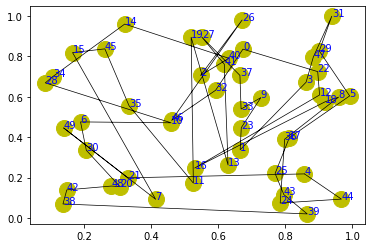

step:445/5000, actic loss:5.032, critic loss:18.593, L:17.534, 0min2sec
step:446/5000, actic loss:5.015, critic loss:18.555, L:17.528, 0min1sec
step:447/5000, actic loss:5.016, critic loss:18.518, L:17.521, 0min1sec
step:448/5000, actic loss:5.012, critic loss:18.481, L:17.514, 0min1sec
step:449/5000, actic loss:4.980, critic loss:18.444, L:17.506, 0min1sec
distance:13.103
tensor([26,  6, 16,  4, 20,  0, 12, 10, 36, 14, 24,  8, 48, 18, 22, 40, 46, 30,
        32, 42, 38, 44, 28, 34,  2, 35,  7, 11,  3, 41,  9, 31, 39, 13, 49, 25,
        29, 45, 17, 21, 27, 33, 19, 47, 15,  1,  5, 23, 43, 37])


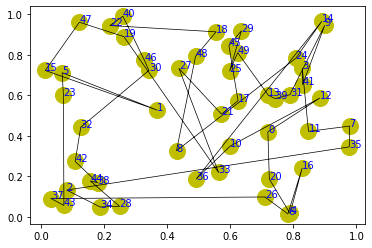

step:450/5000, actic loss:4.950, critic loss:18.406, L:17.499, 0min1sec
step:451/5000, actic loss:4.920, critic loss:18.370, L:17.492, 0min1sec
step:452/5000, actic loss:4.946, critic loss:18.333, L:17.484, 0min1sec
step:453/5000, actic loss:4.963, critic loss:18.298, L:17.477, 0min1sec
step:454/5000, actic loss:4.954, critic loss:18.261, L:17.470, 0min1sec
distance:17.717
tensor([46,  6, 16, 48,  8, 20, 34, 14, 36, 40, 22, 26, 28, 38, 32, 10,  4,  2,
         0, 30, 12, 18, 44, 42, 24, 21, 29, 33, 41, 43, 27, 31,  5, 13, 47, 23,
         1, 35,  7, 19, 15, 45, 17, 11, 49, 25,  3, 39, 37,  9])


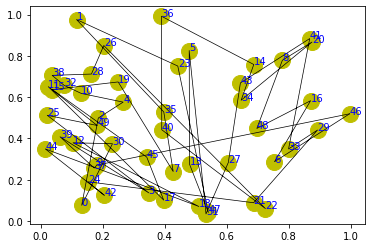

step:455/5000, actic loss:4.914, critic loss:18.225, L:17.463, 0min2sec
step:456/5000, actic loss:4.865, critic loss:18.190, L:17.456, 0min1sec
step:457/5000, actic loss:4.838, critic loss:18.154, L:17.449, 0min1sec
step:458/5000, actic loss:4.845, critic loss:18.118, L:17.443, 0min1sec
step:459/5000, actic loss:4.860, critic loss:18.084, L:17.436, 0min1sec
distance:13.003
tensor([ 0, 18, 26, 32, 30, 28, 42,  4, 46,  2,  8, 20, 44, 24,  6, 36, 22, 48,
        16, 10, 38, 40, 14, 34, 12, 23, 31, 45, 33, 43, 41, 13, 49,  5, 11, 47,
        35, 21, 29, 17, 27, 37,  9,  3, 39, 19,  7, 15,  1, 25])


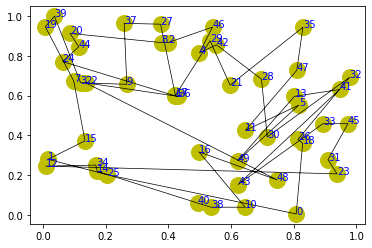

step:460/5000, actic loss:4.852, critic loss:18.048, L:17.429, 0min1sec
step:461/5000, actic loss:4.806, critic loss:18.013, L:17.423, 0min1sec
step:462/5000, actic loss:4.749, critic loss:17.979, L:17.417, 0min1sec
step:463/5000, actic loss:4.698, critic loss:17.945, L:17.411, 0min1sec
step:464/5000, actic loss:4.683, critic loss:17.910, L:17.405, 0min1sec
distance:16.869
tensor([44,  2,  8, 16,  6, 46, 30, 22, 28, 14, 32, 38,  4,  0, 24, 18, 26, 10,
        34, 36, 40, 12, 20, 42, 48, 29,  1, 33, 41, 23,  9, 27, 47, 31, 39, 11,
         7, 49, 43, 21,  5, 37, 19, 25, 17, 35,  3, 15, 13, 45])


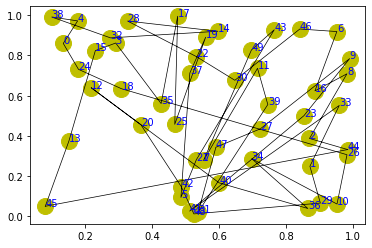

step:465/5000, actic loss:4.715, critic loss:17.877, L:17.400, 0min1sec
step:466/5000, actic loss:4.772, critic loss:17.845, L:17.394, 0min1sec
step:467/5000, actic loss:4.830, critic loss:17.814, L:17.388, 0min1sec
step:468/5000, actic loss:4.863, critic loss:17.781, L:17.383, 0min1sec
step:469/5000, actic loss:4.878, critic loss:17.748, L:17.377, 0min1sec
distance:14.249
tensor([20,  6, 48, 32, 26,  8,  0, 28, 30, 36,  4, 18,  2, 10, 38, 44, 42, 46,
        22, 12, 24, 40, 34, 14, 16, 39, 15, 43, 41, 11, 21, 45, 47, 29, 37, 33,
        25,  1, 49, 17, 31, 13,  5, 35, 19,  9, 23,  3, 27,  7])


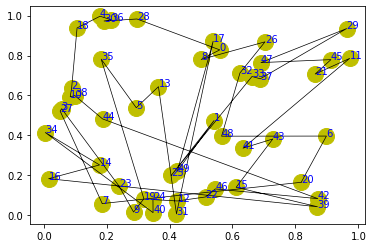

step:470/5000, actic loss:4.853, critic loss:17.713, L:17.370, 0min2sec
step:471/5000, actic loss:4.808, critic loss:17.680, L:17.364, 0min1sec
step:472/5000, actic loss:4.769, critic loss:17.646, L:17.357, 0min1sec
step:473/5000, actic loss:4.732, critic loss:17.613, L:17.351, 0min1sec
step:474/5000, actic loss:4.716, critic loss:17.580, L:17.345, 0min1sec
distance:14.458
tensor([46, 48,  2,  6, 38, 16, 44, 14,  8, 36, 30, 26, 18, 12, 20, 24,  4,  0,
        22, 32, 40, 28, 34, 42, 10,  9,  1, 35, 19, 15, 41, 11, 33,  5, 31, 17,
        13,  3, 45,  7, 25, 39, 37, 23, 43, 47, 29, 27, 49, 21])


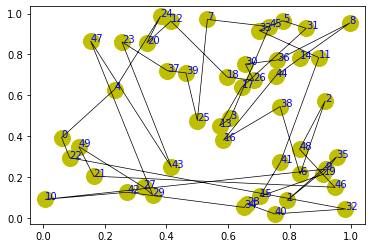

step:475/5000, actic loss:4.753, critic loss:17.549, L:17.338, 0min1sec
step:476/5000, actic loss:4.813, critic loss:17.519, L:17.332, 0min1sec
step:477/5000, actic loss:4.881, critic loss:17.491, L:17.326, 0min1sec
step:478/5000, actic loss:4.913, critic loss:17.460, L:17.321, 0min1sec
step:479/5000, actic loss:4.927, critic loss:17.428, L:17.315, 0min1sec
distance:14.076
tensor([42, 44,  8,  2,  4,  0, 46, 32, 26,  6, 16, 22, 14, 18, 10, 24, 30, 20,
        40, 12, 28, 38, 48, 36, 34,  9,  7, 17, 11, 23, 31, 49, 15, 13, 45, 21,
        43, 19,  1, 27, 39, 47, 25, 35, 33, 41, 37, 29,  5,  3])


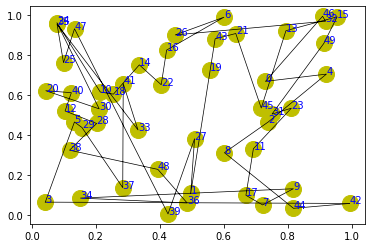

step:480/5000, actic loss:4.892, critic loss:17.396, L:17.309, 0min1sec
step:481/5000, actic loss:4.845, critic loss:17.364, L:17.303, 0min1sec
step:482/5000, actic loss:4.785, critic loss:17.334, L:17.298, 0min1sec
step:483/5000, actic loss:4.742, critic loss:17.303, L:17.292, 0min1sec
step:484/5000, actic loss:4.731, critic loss:17.272, L:17.286, 0min1sec
distance:15.370
tensor([ 8, 42, 18, 34, 14, 44, 38, 16,  4, 20, 32, 24, 12, 22, 48, 36, 30, 28,
         0, 10,  2,  6, 46, 40, 26, 45, 37, 31, 23, 25, 19,  5,  7, 29,  3,  1,
        33, 15,  9, 21, 13, 43, 49, 11, 27, 41, 47, 35, 39, 17])


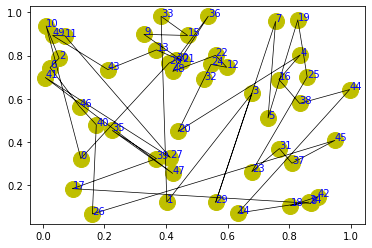

step:485/5000, actic loss:4.736, critic loss:17.240, L:17.280, 0min1sec
step:486/5000, actic loss:4.732, critic loss:17.209, L:17.274, 0min1sec
step:487/5000, actic loss:4.704, critic loss:17.177, L:17.269, 0min1sec
step:488/5000, actic loss:4.671, critic loss:17.146, L:17.263, 0min1sec
step:489/5000, actic loss:4.643, critic loss:17.115, L:17.257, 0min1sec
distance:12.681
tensor([12, 20, 36, 34, 46,  2, 40, 48,  8,  0, 32,  4, 24, 22,  6, 10, 30, 28,
        16, 42, 26, 18, 38, 44, 14, 35, 49,  7, 19, 31,  1, 47, 37, 39, 13,  3,
        33, 25,  9, 21, 43, 27, 15, 41, 29, 11, 17, 45,  5, 23])


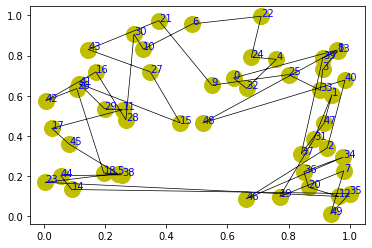

step:490/5000, actic loss:4.645, critic loss:17.083, L:17.252, 0min1sec
step:491/5000, actic loss:4.658, critic loss:17.054, L:17.246, 0min1sec
step:492/5000, actic loss:4.671, critic loss:17.024, L:17.240, 0min1sec
step:493/5000, actic loss:4.660, critic loss:16.993, L:17.234, 0min1sec
step:494/5000, actic loss:4.616, critic loss:16.962, L:17.228, 0min1sec
distance:11.969
tensor([16, 22, 46,  8, 32, 10,  6,  2, 28, 24, 12,  4, 40, 30, 42, 18, 20, 44,
        26, 36, 34, 14, 38, 48,  0, 33, 41,  1, 35, 25,  9, 47, 27, 11, 21, 43,
        13, 39, 17,  7, 49, 45,  5, 23, 19, 31, 15,  3, 37, 29])


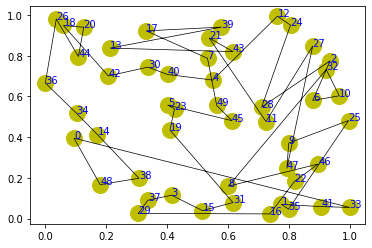

step:495/5000, actic loss:4.562, critic loss:16.932, L:17.222, 0min1sec
step:496/5000, actic loss:4.502, critic loss:16.902, L:17.215, 0min1sec
step:497/5000, actic loss:4.465, critic loss:16.872, L:17.209, 0min1sec
step:498/5000, actic loss:4.479, critic loss:16.843, L:17.202, 0min1sec
step:499/5000, actic loss:4.502, critic loss:16.813, L:17.196, 0min1sec
distance:14.412
tensor([ 2, 42, 36, 38, 40, 32, 46, 14, 26, 12,  6, 20, 30, 44,  8, 24,  0, 28,
        48,  4, 34, 10, 22, 16, 18, 43, 31, 37, 39, 11, 29, 17, 45, 23, 49, 47,
         5, 21, 41, 15, 13,  7, 33,  9, 25, 19,  3, 35, 27,  1])


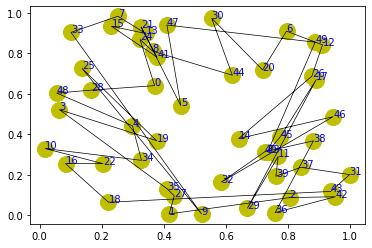

step:500/5000, actic loss:4.511, critic loss:16.783, L:17.189, 0min1sec
step:501/5000, actic loss:4.505, critic loss:16.753, L:17.183, 0min1sec
step:502/5000, actic loss:4.467, critic loss:16.724, L:17.176, 0min1sec
step:503/5000, actic loss:4.429, critic loss:16.694, L:17.169, 0min1sec
step:504/5000, actic loss:4.396, critic loss:16.665, L:17.161, 0min1sec
distance:12.449
tensor([40,  4, 36, 18, 20, 42, 12, 16, 44, 30, 14,  0, 32, 38, 34, 22, 24, 46,
        48, 26, 10, 28,  6,  8,  2, 31, 37,  5, 15,  3,  9, 11, 19, 43, 45, 41,
        47, 23, 17, 27, 35, 21,  7, 13, 49, 39,  1, 33, 29, 25])


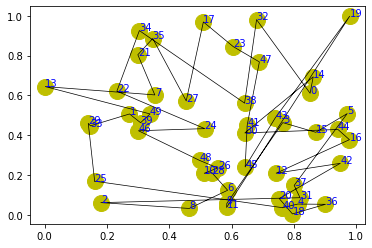

step:505/5000, actic loss:4.383, critic loss:16.635, L:17.154, 0min1sec
step:506/5000, actic loss:4.406, critic loss:16.607, L:17.147, 0min1sec
step:507/5000, actic loss:4.435, critic loss:16.578, L:17.140, 0min1sec
step:508/5000, actic loss:4.436, critic loss:16.549, L:17.134, 0min1sec
step:509/5000, actic loss:4.429, critic loss:16.520, L:17.127, 0min1sec
distance:13.594
tensor([34, 30, 36, 20, 16, 44, 14,  2, 32,  6, 48, 22, 10, 38, 18,  0, 40,  8,
        26, 28, 42, 46, 12, 24,  4, 43, 23, 13, 31, 35, 25, 49, 27,  3,  7, 45,
        11,  9, 19,  1, 33, 37, 17, 47, 29, 39, 21, 41, 15,  5])


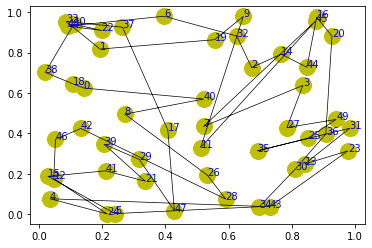

step:510/5000, actic loss:4.386, critic loss:16.491, L:17.120, 0min1sec
step:511/5000, actic loss:4.324, critic loss:16.462, L:17.114, 0min1sec
step:512/5000, actic loss:4.267, critic loss:16.434, L:17.107, 0min1sec
step:513/5000, actic loss:4.243, critic loss:16.405, L:17.100, 0min1sec
step:514/5000, actic loss:4.261, critic loss:16.377, L:17.094, 0min1sec
distance:13.520
tensor([30, 16, 10, 22,  4, 44, 28, 36, 20, 14, 46,  6,  0, 26, 40, 24, 38, 42,
         2, 12, 48, 32, 34, 18,  8, 27, 17, 23,  7, 39, 33,  5,  3, 47, 37,  1,
        35, 21, 41, 19, 29, 43, 15, 11,  9, 13, 45, 25, 31, 49])


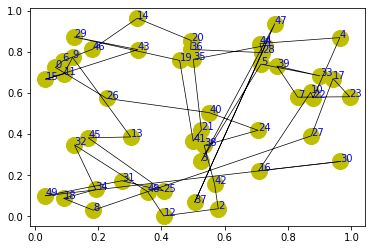

step:515/5000, actic loss:4.290, critic loss:16.349, L:17.087, 0min1sec
step:516/5000, actic loss:4.309, critic loss:16.321, L:17.080, 0min1sec
step:517/5000, actic loss:4.315, critic loss:16.293, L:17.074, 0min1sec
step:518/5000, actic loss:4.299, critic loss:16.264, L:17.066, 0min1sec
step:519/5000, actic loss:4.267, critic loss:16.236, L:17.059, 0min1sec
distance:12.437
tensor([44, 12,  0, 26, 42, 16, 38, 20, 18, 48, 40, 30,  4, 36, 34, 32,  2, 14,
         6, 10, 46, 28,  8, 24, 22, 27,  9, 43, 11, 21, 39, 13, 37, 41, 17, 49,
        35,  5,  7, 23, 31, 47, 33, 19, 45, 29, 15, 25,  3,  1])


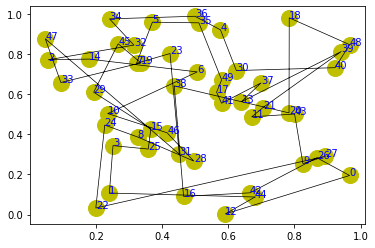

step:520/5000, actic loss:4.225, critic loss:16.209, L:17.053, 0min1sec
step:521/5000, actic loss:4.209, critic loss:16.181, L:17.046, 0min1sec
step:522/5000, actic loss:4.204, critic loss:16.153, L:17.040, 0min1sec
step:523/5000, actic loss:4.225, critic loss:16.126, L:17.034, 0min1sec
step:524/5000, actic loss:4.241, critic loss:16.099, L:17.028, 0min1sec
distance:13.891
tensor([28, 20, 32, 46, 22, 38,  0,  6, 36, 24, 18, 48, 30,  8,  4, 12, 10, 34,
         2, 40, 42, 14, 26, 16, 44, 41, 27, 31, 15,  1, 37, 17, 11, 13,  5,  3,
        19, 33, 43, 23,  7, 49, 29, 39, 21, 45, 47, 35, 25,  9])


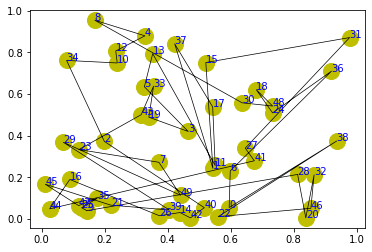

step:525/5000, actic loss:4.243, critic loss:16.072, L:17.022, 0min2sec
step:526/5000, actic loss:4.202, critic loss:16.044, L:17.016, 0min2sec
step:527/5000, actic loss:4.134, critic loss:16.019, L:17.010, 0min1sec
step:528/5000, actic loss:4.084, critic loss:15.993, L:17.004, 0min1sec
step:529/5000, actic loss:4.034, critic loss:15.967, L:16.998, 0min1sec
distance:16.514
tensor([26, 12, 40, 22, 16, 46,  0,  8, 34,  6, 42, 32, 14, 24,  2, 10, 30, 38,
        18, 44, 28, 48, 20,  4, 36, 21, 19, 15,  5, 43, 33, 45,  7, 27,  3,  1,
        25, 23, 41, 13, 17, 35, 29, 49, 11, 37,  9, 39, 47, 31])


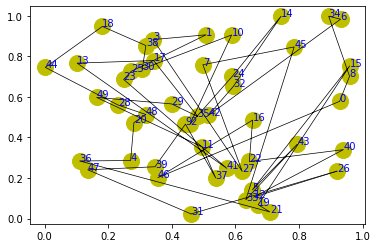

step:530/5000, actic loss:4.032, critic loss:15.939, L:16.992, 0min1sec
step:531/5000, actic loss:4.034, critic loss:15.912, L:16.987, 0min1sec
step:532/5000, actic loss:4.041, critic loss:15.886, L:16.982, 0min1sec
step:533/5000, actic loss:4.020, critic loss:15.859, L:16.977, 0min1sec
step:534/5000, actic loss:4.004, critic loss:15.832, L:16.971, 0min1sec
distance:15.634
tensor([ 4, 20, 22, 30, 12, 38, 42, 18, 10, 46,  6, 14, 44, 26, 48, 24, 32, 36,
        28, 16,  8,  0, 34,  2, 40, 47, 27, 45, 29,  3, 35, 39, 17,  7, 37,  1,
        31, 21, 23, 43,  9, 13, 15, 49, 11, 25,  5, 33, 41, 19])


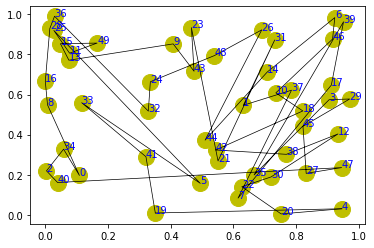

step:535/5000, actic loss:4.001, critic loss:15.806, L:16.966, 0min2sec
step:536/5000, actic loss:4.007, critic loss:15.780, L:16.961, 0min1sec
step:537/5000, actic loss:4.001, critic loss:15.754, L:16.955, 0min1sec
step:538/5000, actic loss:3.970, critic loss:15.728, L:16.949, 0min1sec
step:539/5000, actic loss:3.894, critic loss:15.705, L:16.944, 0min1sec
distance:12.926
tensor([ 8, 48,  0, 40, 32, 16, 46,  6, 38, 20, 14, 18,  4, 42, 28, 34, 36, 30,
        10, 12, 44, 24, 26, 22,  2, 25,  3, 35, 27, 31, 47, 17, 19, 43,  5, 39,
        29, 23,  7, 21, 11, 45,  9, 41,  1, 49, 15, 37, 33, 13])


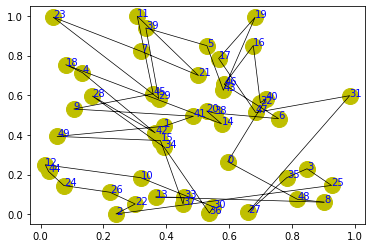

step:540/5000, actic loss:3.799, critic loss:15.682, L:16.939, 0min2sec
step:541/5000, actic loss:3.721, critic loss:15.658, L:16.935, 0min1sec
step:542/5000, actic loss:3.722, critic loss:15.632, L:16.930, 0min1sec
step:543/5000, actic loss:3.752, critic loss:15.606, L:16.924, 0min1sec
step:544/5000, actic loss:3.800, critic loss:15.582, L:16.918, 0min1sec
distance:15.584
tensor([32, 22, 20, 14, 48, 26, 24,  0,  8,  4, 18, 30, 12, 36, 46, 34, 42, 28,
         6, 44, 10, 16,  2, 38, 40,  9, 35, 47, 49, 27, 17, 45, 13,  7, 43,  1,
        15, 39, 31, 19, 33, 41, 25, 11,  5, 29, 23, 37, 21,  3])


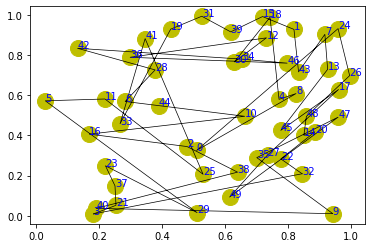

step:545/5000, actic loss:3.821, critic loss:15.557, L:16.912, 0min2sec
step:546/5000, actic loss:3.810, critic loss:15.531, L:16.905, 0min1sec
step:547/5000, actic loss:3.801, critic loss:15.505, L:16.899, 0min1sec
step:548/5000, actic loss:3.784, critic loss:15.479, L:16.892, 0min1sec
step:549/5000, actic loss:3.782, critic loss:15.454, L:16.886, 0min1sec
distance:15.301
tensor([ 8, 34, 28, 40, 30, 32, 10, 38, 48, 20,  6, 14, 22, 46, 36, 12, 16, 26,
         0, 42,  4,  2, 18, 44, 24, 19, 31, 37, 29, 41, 11, 45, 49, 43,  5, 17,
        27,  3, 33, 35,  1, 47, 15, 25, 21,  9, 23, 13,  7, 39])


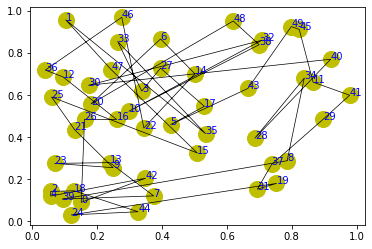

step:550/5000, actic loss:3.761, critic loss:15.428, L:16.880, 0min2sec
step:551/5000, actic loss:3.775, critic loss:15.403, L:16.874, 0min1sec
step:552/5000, actic loss:3.787, critic loss:15.379, L:16.868, 0min1sec
step:553/5000, actic loss:3.787, critic loss:15.353, L:16.861, 0min1sec
step:554/5000, actic loss:3.769, critic loss:15.328, L:16.854, 0min1sec
distance:11.797
tensor([46,  6, 16, 36, 22, 24, 28,  8, 30, 38, 34, 26, 10, 20, 44,  0, 42, 18,
         4, 48, 40, 32, 12,  2, 14,  9, 43,  7, 23, 31, 13, 49, 37, 17, 19, 29,
         3, 25, 33, 47, 11, 27, 39, 15, 21, 41, 35,  1,  5, 45])


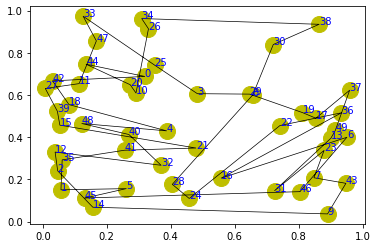

step:555/5000, actic loss:3.743, critic loss:15.304, L:16.847, 0min2sec
step:556/5000, actic loss:3.728, critic loss:15.278, L:16.840, 0min1sec
step:557/5000, actic loss:3.715, critic loss:15.253, L:16.834, 0min1sec
step:558/5000, actic loss:3.720, critic loss:15.229, L:16.828, 0min1sec
step:559/5000, actic loss:3.753, critic loss:15.205, L:16.821, 0min1sec
distance:11.839
tensor([18, 22, 34,  4, 38, 20, 46,  8,  2, 30,  0, 12, 40, 48, 16, 14, 26, 24,
        32, 44, 28, 36, 42,  6, 10, 19, 31,  1, 49, 41, 27, 43,  5, 47, 39, 15,
        17, 21, 35, 13,  7, 37, 23,  9, 45, 33, 11, 29,  3, 25])


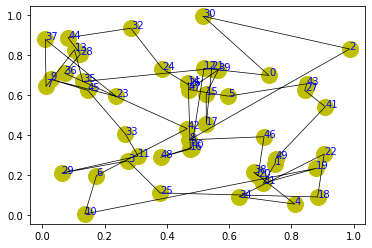

step:560/5000, actic loss:3.784, critic loss:15.181, L:16.815, 0min2sec
step:561/5000, actic loss:3.787, critic loss:15.156, L:16.809, 0min1sec
step:562/5000, actic loss:3.770, critic loss:15.131, L:16.802, 0min1sec
step:563/5000, actic loss:3.737, critic loss:15.107, L:16.796, 0min1sec
step:564/5000, actic loss:3.707, critic loss:15.083, L:16.790, 0min1sec
distance:12.734
tensor([32,  4, 16, 48, 42,  0, 18, 38, 24, 22, 36, 12, 40, 20, 46, 28, 14, 10,
        44,  8,  2, 30,  6, 34, 26, 11,  3, 17,  9,  7, 43, 41, 33, 13, 25, 21,
        23, 45, 37, 49, 39, 31,  1, 27, 15,  5, 19, 29, 47, 35])


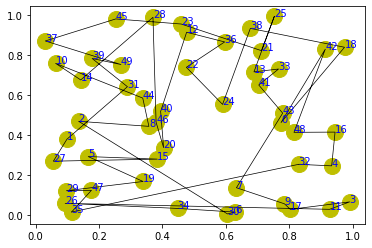

step:565/5000, actic loss:3.708, critic loss:15.059, L:16.783, 0min1sec
step:566/5000, actic loss:3.694, critic loss:15.035, L:16.777, 0min1sec
step:567/5000, actic loss:3.705, critic loss:15.011, L:16.771, 0min1sec
step:568/5000, actic loss:3.691, critic loss:14.987, L:16.765, 0min1sec
step:569/5000, actic loss:3.709, critic loss:14.963, L:16.759, 0min1sec
distance:13.088
tensor([40, 42,  6,  2, 48, 46, 34, 10, 12,  4, 28,  8, 16, 36,  0, 44, 32, 26,
        30, 14, 18, 22, 20, 24, 38,  3, 49, 19, 17,  5, 25,  7, 29, 27,  1, 13,
        43, 33, 15, 39, 35, 37, 11,  9, 23, 41, 47, 21, 45, 31])


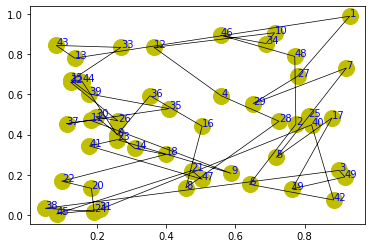

step:570/5000, actic loss:3.718, critic loss:14.939, L:16.754, 0min2sec
step:571/5000, actic loss:3.696, critic loss:14.915, L:16.748, 0min1sec
step:572/5000, actic loss:3.709, critic loss:14.891, L:16.742, 0min1sec
step:573/5000, actic loss:3.707, critic loss:14.868, L:16.736, 0min1sec
step:574/5000, actic loss:3.673, critic loss:14.845, L:16.730, 0min1sec
distance:14.119
tensor([48, 40, 32, 22, 30, 20, 44, 42,  8, 46, 24, 14, 10,  2, 38,  0, 36,  6,
        16, 26, 34, 18, 12, 28,  4, 43, 11, 27,  9, 15, 29, 17, 13, 47, 25, 39,
        33, 49, 41, 23,  5, 37, 31,  7,  1,  3, 19, 35, 21, 45])


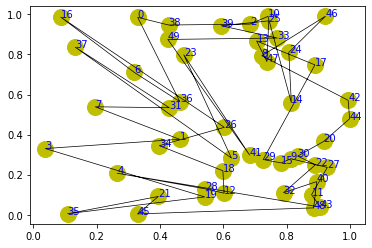

step:575/5000, actic loss:3.637, critic loss:14.822, L:16.723, 0min1sec
step:576/5000, actic loss:3.588, critic loss:14.799, L:16.718, 0min1sec
step:577/5000, actic loss:3.555, critic loss:14.777, L:16.712, 0min1sec
step:578/5000, actic loss:3.552, critic loss:14.754, L:16.707, 0min1sec
step:579/5000, actic loss:3.561, critic loss:14.731, L:16.701, 0min1sec
distance:13.987
tensor([33, 47,  3, 15, 23, 37, 35,  9, 19, 29, 45, 11, 43, 31,  7, 49, 21,  1,
        17, 39, 25,  0, 27, 13, 41,  5, 36, 22, 48, 18,  8, 32, 30, 40, 34, 26,
         6, 12, 44,  2, 28, 38,  4, 20, 14, 10, 46, 42, 16, 24])


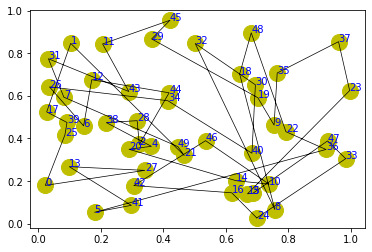

step:580/5000, actic loss:3.561, critic loss:14.708, L:16.696, 0min1sec
step:581/5000, actic loss:3.532, critic loss:14.686, L:16.692, 0min1sec
step:582/5000, actic loss:3.500, critic loss:14.664, L:16.687, 0min1sec
step:583/5000, actic loss:3.473, critic loss:14.641, L:16.683, 0min1sec
step:584/5000, actic loss:3.464, critic loss:14.619, L:16.680, 0min1sec
distance:13.835
tensor([27, 21,  9,  3, 17, 23, 31,  1, 43, 37, 39, 47, 49, 41, 33,  7, 29,  0,
        19, 15,  5, 13, 35, 45, 11, 25, 22, 20,  6, 46, 16,  4, 34,  8, 24, 30,
        18, 42, 28, 26,  2, 36, 14, 44, 38, 48, 32, 12, 10, 40])


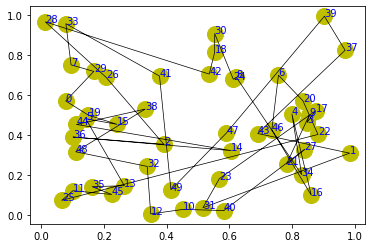

step:585/5000, actic loss:3.492, critic loss:14.601, L:16.676, 0min2sec
step:586/5000, actic loss:3.461, critic loss:14.583, L:16.676, 0min2sec
step:587/5000, actic loss:3.456, critic loss:14.567, L:16.676, 0min1sec
step:588/5000, actic loss:3.496, critic loss:14.551, L:16.676, 0min1sec
step:589/5000, actic loss:3.546, critic loss:14.537, L:16.676, 0min1sec
distance:18.730
tensor([34, 27, 46, 36, 21, 40, 25, 42, 10, 14,  6,  2, 48,  4, 16, 44, 19,  8,
        12, 29, 32, 38,  0, 18,  9, 23, 17, 43,  1, 24, 31, 45, 30,  5, 13, 11,
        33, 47, 37, 22, 28, 41, 20, 39, 15, 26, 35,  7, 49,  3])


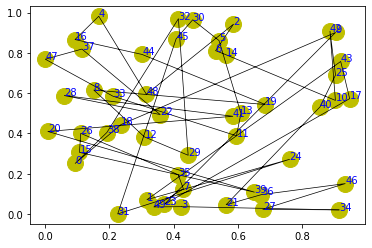

step:590/5000, actic loss:3.574, critic loss:14.520, L:16.678, 0min2sec
step:591/5000, actic loss:3.622, critic loss:14.506, L:16.679, 0min1sec
step:592/5000, actic loss:3.634, critic loss:14.489, L:16.680, 0min1sec
step:593/5000, actic loss:3.620, critic loss:14.471, L:16.681, 0min1sec
step:594/5000, actic loss:3.599, critic loss:14.454, L:16.682, 0min1sec
distance:16.596
tensor([27, 45,  6, 35, 41, 43,  4, 21,  0, 31, 17, 10,  8, 12, 33, 29,  2, 39,
        37, 14, 19, 49, 25, 24, 48, 18, 47,  9, 11, 23, 13, 30, 22, 15, 26,  5,
        32, 38,  7,  1, 20, 16, 42, 28, 46, 34, 36,  3, 44, 40])


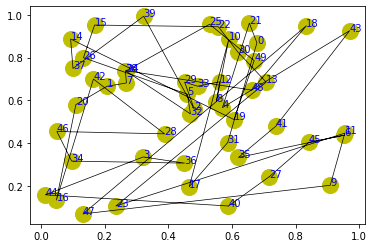

step:595/5000, actic loss:3.573, critic loss:14.436, L:16.683, 0min1sec
step:596/5000, actic loss:3.538, critic loss:14.419, L:16.686, 0min1sec
step:597/5000, actic loss:3.532, critic loss:14.400, L:16.687, 0min1sec
step:598/5000, actic loss:3.566, critic loss:14.383, L:16.689, 0min1sec
step:599/5000, actic loss:3.609, critic loss:14.368, L:16.692, 0min1sec
distance:16.459
tensor([27, 23, 45,  5, 13, 35, 25, 33,  0, 21,  2, 17, 19, 41,  7, 11, 15, 43,
        29, 31, 37,  9, 49, 47, 39, 24, 40,  3, 20, 34, 10,  4, 48, 26, 42, 30,
        46, 36, 16, 44, 28, 38,  8, 18,  1, 32, 12,  6, 22, 14])


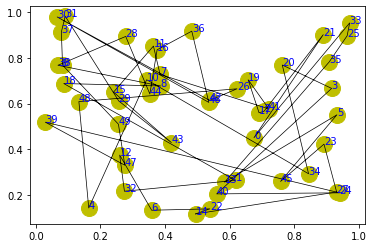

step:600/5000, actic loss:3.667, critic loss:14.354, L:16.694, 0min1sec
step:601/5000, actic loss:3.701, critic loss:14.338, L:16.696, 0min1sec
step:602/5000, actic loss:3.731, critic loss:14.321, L:16.698, 0min1sec
step:603/5000, actic loss:3.720, critic loss:14.302, L:16.700, 0min1sec
step:604/5000, actic loss:3.701, critic loss:14.283, L:16.702, 0min1sec
distance:19.627
tensor([24, 20, 41, 18, 31, 45, 10, 34, 28, 37, 47,  8,  0,  6, 43, 26, 22, 12,
         2,  4, 32, 39, 14, 36, 29, 16, 33, 49, 21,  3, 25, 44, 42, 40,  1,  9,
         5,  7, 27, 30, 15, 38, 17, 23, 35, 11, 19, 48, 46, 13])


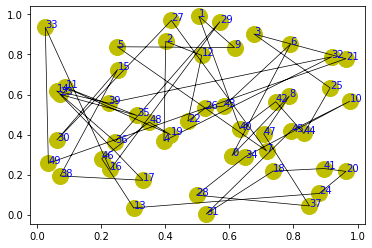

step:605/5000, actic loss:3.687, critic loss:14.265, L:16.703, 0min2sec
step:606/5000, actic loss:3.691, critic loss:14.247, L:16.705, 0min1sec
step:607/5000, actic loss:3.696, critic loss:14.229, L:16.706, 0min1sec
step:608/5000, actic loss:3.704, critic loss:14.212, L:16.706, 0min1sec
step:609/5000, actic loss:3.670, critic loss:14.193, L:16.707, 0min1sec
distance:14.502
tensor([10, 40, 46, 26, 36, 32, 42, 14, 38, 30,  8, 18, 34, 48, 12,  4, 28, 20,
        16,  6, 22,  0, 24,  2, 44, 45, 21, 33, 15, 43,  3, 29, 41, 39, 31, 47,
        19, 11, 25, 37, 27, 13, 35, 49,  9,  7,  1,  5, 23, 17])


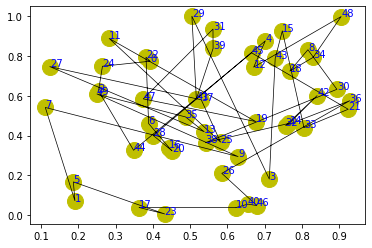

step:610/5000, actic loss:3.634, critic loss:14.176, L:16.708, 0min1sec
step:611/5000, actic loss:3.600, critic loss:14.158, L:16.709, 0min1sec
step:612/5000, actic loss:3.574, critic loss:14.140, L:16.710, 0min1sec
step:613/5000, actic loss:3.575, critic loss:14.122, L:16.711, 0min1sec
step:614/5000, actic loss:3.581, critic loss:14.104, L:16.713, 0min1sec
distance:15.165
tensor([13, 32, 15, 20, 34,  0, 28,  9, 26,  5, 19, 42, 17, 11, 48, 36, 30, 21,
        24, 38, 40, 44,  7, 46,  2,  3, 27, 10, 41, 23, 35, 16, 22, 49, 25,  4,
        12,  8, 14, 43, 18,  6,  1, 29, 45, 33, 47, 37, 31, 39])


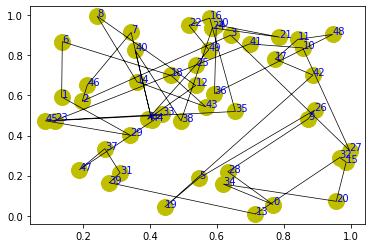

step:615/5000, actic loss:3.591, critic loss:14.087, L:16.714, 0min1sec
step:616/5000, actic loss:3.581, critic loss:14.068, L:16.716, 0min1sec
step:617/5000, actic loss:3.567, critic loss:14.050, L:16.717, 0min1sec
step:618/5000, actic loss:3.554, critic loss:14.032, L:16.719, 0min1sec
step:619/5000, actic loss:3.576, critic loss:14.014, L:16.721, 0min1sec
distance:20.366
tensor([17,  0, 34, 39, 48, 31, 43, 19,  2, 35, 33, 29, 23,  7,  8, 10,  4, 22,
        13,  5, 15, 41,  1, 40,  3, 36, 45, 20, 25, 28, 26, 46, 37, 38, 30, 27,
        47,  9, 21, 14, 16, 11,  6, 32, 18, 49, 12, 24, 42, 44])


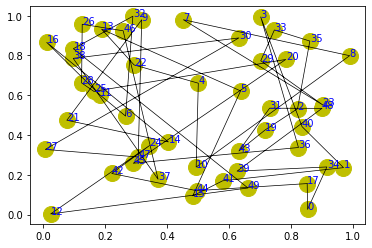

step:620/5000, actic loss:3.602, critic loss:13.996, L:16.723, 0min2sec
step:621/5000, actic loss:3.631, critic loss:13.979, L:16.724, 0min1sec
step:622/5000, actic loss:3.660, critic loss:13.962, L:16.725, 0min1sec
step:623/5000, actic loss:3.676, critic loss:13.944, L:16.725, 0min1sec
step:624/5000, actic loss:3.664, critic loss:13.926, L:16.724, 0min1sec
distance:15.229
tensor([10, 35,  0, 46, 41, 26, 20, 44,  7, 28, 48, 37, 19, 12, 14,  3,  9, 22,
        33, 16, 17, 34, 49,  6, 27, 45, 30,  4, 42, 15, 11, 39, 24, 21, 47, 43,
         2, 18, 31, 32, 29,  8, 40,  1,  5, 25, 23, 36, 38, 13])


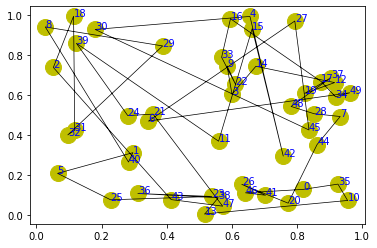

step:625/5000, actic loss:3.661, critic loss:13.907, L:16.723, 0min1sec
step:626/5000, actic loss:3.638, critic loss:13.889, L:16.720, 0min1sec
step:627/5000, actic loss:3.641, critic loss:13.869, L:16.717, 0min1sec
step:628/5000, actic loss:3.624, critic loss:13.850, L:16.713, 0min1sec
step:629/5000, actic loss:3.612, critic loss:13.831, L:16.708, 0min1sec
distance:14.024
tensor([24, 22, 45, 20, 17, 26,  1, 27, 13, 34,  7, 30, 10,  0, 47, 19, 44, 40,
        15, 41,  8, 49, 32, 48, 12, 42, 23, 11, 16, 28,  9, 25, 18, 21, 31, 35,
        29, 14,  2,  3,  5, 39, 37, 33, 36,  4, 43, 46, 38,  6])


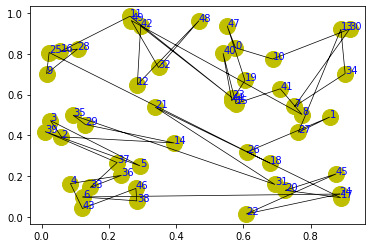

step:630/5000, actic loss:3.604, critic loss:13.812, L:16.703, 0min1sec
step:631/5000, actic loss:3.625, critic loss:13.793, L:16.698, 0min1sec
step:632/5000, actic loss:3.655, critic loss:13.776, L:16.692, 0min1sec
step:633/5000, actic loss:3.679, critic loss:13.758, L:16.686, 0min1sec
step:634/5000, actic loss:3.690, critic loss:13.738, L:16.680, 0min1sec
distance:13.415
tensor([44, 43, 46,  2, 23, 29, 49, 16, 21, 39, 25, 48, 15,  0, 34, 42, 20, 45,
        13,  9, 19, 35, 17, 47, 27, 40, 14, 22, 32, 18, 24,  1, 28,  5, 10,  3,
        31, 12, 41, 26, 33, 11,  8,  6, 36,  4, 37,  7, 38, 30])


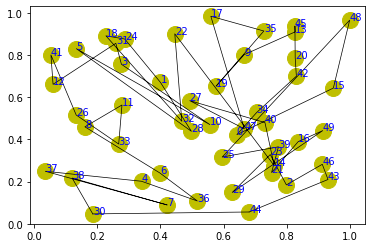

step:635/5000, actic loss:3.678, critic loss:13.719, L:16.674, 0min2sec
step:636/5000, actic loss:3.657, critic loss:13.701, L:16.667, 0min2sec
step:637/5000, actic loss:3.630, critic loss:13.682, L:16.661, 0min1sec
step:638/5000, actic loss:3.606, critic loss:13.663, L:16.655, 0min1sec
step:639/5000, actic loss:3.618, critic loss:13.644, L:16.648, 0min1sec
distance:11.940
tensor([12, 45, 36, 43, 25, 19,  5, 39,  3, 13, 23,  9, 17, 31, 34,  2,  7, 22,
        24, 48, 21, 37, 20, 40, 42, 49,  6,  8,  0, 41, 16, 32, 35, 26, 29, 44,
        27, 14, 28, 46, 30, 38, 15, 11, 10, 33, 18,  1,  4, 47])


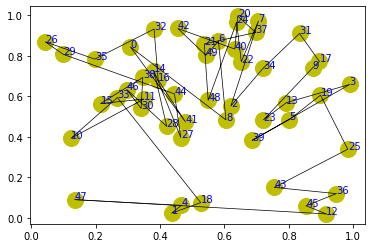

step:640/5000, actic loss:3.632, critic loss:13.625, L:16.642, 0min1sec
step:641/5000, actic loss:3.635, critic loss:13.606, L:16.635, 0min1sec
step:642/5000, actic loss:3.617, critic loss:13.587, L:16.630, 0min1sec
step:643/5000, actic loss:3.578, critic loss:13.570, L:16.624, 0min1sec
step:644/5000, actic loss:3.563, critic loss:13.551, L:16.618, 0min1sec
distance:12.398
tensor([33, 20, 35, 30,  3, 14, 15, 42, 28, 38, 49, 41,  1, 44, 25, 11, 19, 21,
        46,  5, 31, 24,  0, 18, 36, 34, 22,  4,  6, 26, 45, 10, 47, 43, 48, 23,
        37, 16, 27, 17, 12,  8,  7,  2,  9, 32, 40, 29, 13, 39])


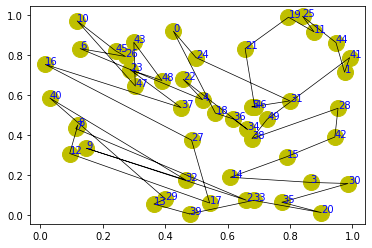

step:645/5000, actic loss:3.569, critic loss:13.533, L:16.612, 0min1sec
step:646/5000, actic loss:3.573, critic loss:13.514, L:16.607, 0min1sec
step:647/5000, actic loss:3.580, critic loss:13.495, L:16.601, 0min1sec
step:648/5000, actic loss:3.579, critic loss:13.477, L:16.594, 0min1sec
step:649/5000, actic loss:3.552, critic loss:13.459, L:16.588, 0min1sec
distance:11.885
tensor([44,  5, 11, 31, 17, 41, 43,  1, 28,  9, 10, 22, 21, 37,  3, 23, 42, 38,
        32, 34, 15, 35, 16, 40,  6, 13, 49, 20, 19, 36, 33,  7, 29, 18, 39, 27,
        48,  0, 25,  4,  2, 14,  8, 45, 47, 30, 12, 26, 24, 46])


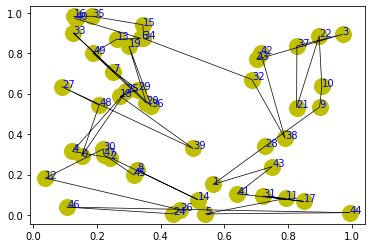

step:650/5000, actic loss:3.515, critic loss:13.442, L:16.582, 0min2sec
step:651/5000, actic loss:3.454, critic loss:13.425, L:16.576, 0min1sec
step:652/5000, actic loss:3.416, critic loss:13.408, L:16.570, 0min1sec
step:653/5000, actic loss:3.414, critic loss:13.389, L:16.564, 0min1sec
step:654/5000, actic loss:3.424, critic loss:13.371, L:16.557, 0min1sec
distance:10.988
tensor([39, 25, 38, 35, 45, 17, 27, 40,  7, 21,  9, 20, 14,  0, 36, 13,  4, 23,
         2,  3,  1, 24, 29, 10, 15, 22, 41, 26, 33, 16, 47, 31, 12, 43, 19, 28,
        34, 49, 32, 46, 30, 11,  6,  5, 44, 18, 48,  8, 37, 42])


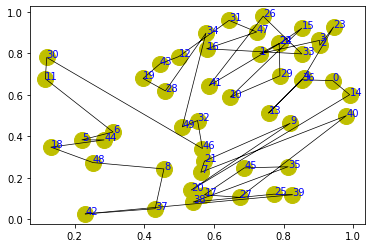

step:655/5000, actic loss:3.436, critic loss:13.353, L:16.550, 0min1sec
step:656/5000, actic loss:3.441, critic loss:13.334, L:16.543, 0min1sec
step:657/5000, actic loss:3.429, critic loss:13.316, L:16.536, 0min1sec
step:658/5000, actic loss:3.399, critic loss:13.298, L:16.529, 0min1sec
step:659/5000, actic loss:3.373, critic loss:13.280, L:16.522, 0min1sec
distance:10.423
tensor([14, 25, 49, 39,  4, 19, 44, 35, 45, 21, 47, 15, 36, 42, 41, 18,  1, 34,
         8, 31, 28, 13, 16, 43, 46, 29, 48, 11, 17, 24,  2, 38, 37, 40,  0,  7,
        26, 22, 12,  9,  6, 10, 30,  3, 23, 27, 32,  5, 33, 20])


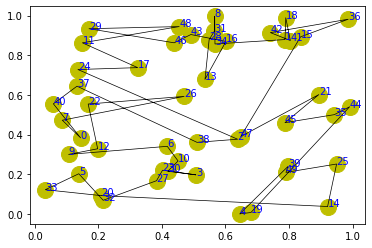

step:660/5000, actic loss:3.354, critic loss:13.261, L:16.515, 0min1sec
step:661/5000, actic loss:3.300, critic loss:13.247, L:16.511, 0min1sec
step:662/5000, actic loss:3.250, critic loss:13.232, L:16.507, 0min1sec
step:663/5000, actic loss:3.254, critic loss:13.215, L:16.503, 0min1sec
step:664/5000, actic loss:3.317, critic loss:13.203, L:16.498, 0min1sec
distance:9.969
tensor([29, 41, 48, 44, 42, 49, 20, 13, 43, 45, 25, 35, 46, 21, 30, 23, 32,  3,
         5, 11, 38, 39, 27, 17, 31, 28, 18, 15,  8, 16, 37,  2, 26, 36,  7,  0,
         9, 12,  1, 40, 14, 47,  6, 19, 34,  4, 22, 10, 33, 24])


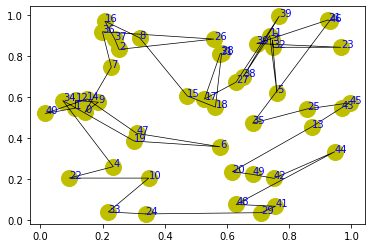

step:665/5000, actic loss:3.415, critic loss:13.195, L:16.492, 0min1sec
step:666/5000, actic loss:3.534, critic loss:13.191, L:16.486, 0min1sec
step:667/5000, actic loss:3.647, critic loss:13.185, L:16.480, 0min1sec
step:668/5000, actic loss:3.735, critic loss:13.174, L:16.473, 0min1sec
step:669/5000, actic loss:3.784, critic loss:13.160, L:16.466, 0min1sec
distance:12.958
tensor([17, 21, 15, 30,  0, 48, 44, 19, 13,  4,  9, 24, 33, 35, 11,  7, 20, 31,
        49,  8, 16, 14, 45,  1, 43, 25, 46, 28, 47, 22, 39, 41, 29, 34, 38, 32,
        10, 12, 37, 27,  3, 23, 42, 26, 18,  2,  6, 40, 36,  5])


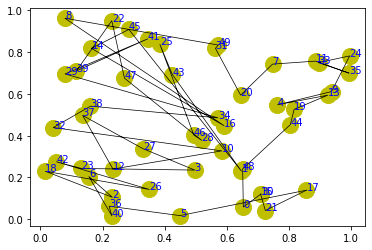

step:670/5000, actic loss:3.799, critic loss:13.143, L:16.460, 0min1sec
step:671/5000, actic loss:3.758, critic loss:13.126, L:16.453, 0min1sec
step:672/5000, actic loss:3.663, critic loss:13.114, L:16.447, 0min1sec
step:673/5000, actic loss:3.571, critic loss:13.102, L:16.441, 0min1sec
step:674/5000, actic loss:3.474, critic loss:13.091, L:16.434, 0min1sec
distance:11.829
tensor([41, 39, 12,  0, 34, 43, 14, 32, 49, 26,  7, 37, 46, 17, 33,  5,  1, 11,
        13, 35, 44, 28,  9, 21, 42, 16, 20, 10, 22, 40, 36,  2,  8,  4, 48, 27,
        38, 45,  3, 47, 29, 18, 15, 19,  6, 24, 25, 31, 23, 30])


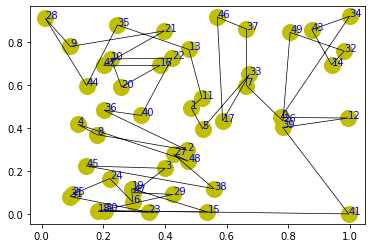

step:675/5000, actic loss:3.385, critic loss:13.079, L:16.428, 0min2sec
step:676/5000, actic loss:3.342, critic loss:13.063, L:16.422, 0min1sec
step:677/5000, actic loss:3.317, critic loss:13.046, L:16.415, 0min1sec
step:678/5000, actic loss:3.320, critic loss:13.030, L:16.410, 0min1sec
step:679/5000, actic loss:3.307, critic loss:13.014, L:16.405, 0min1sec
distance:11.748
tensor([42, 11, 12, 17,  7,  0, 39,  5, 44, 27, 15, 21, 33, 41, 37, 49, 45, 18,
        24, 28, 48, 23, 25, 26, 47, 16, 34, 36, 31, 46, 19, 22, 38, 40, 43,  2,
        13,  9,  3,  6,  8, 20, 35, 32, 10,  4, 29,  1, 30, 14])


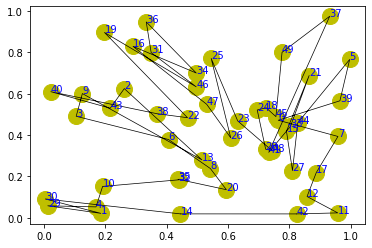

step:680/5000, actic loss:3.318, critic loss:12.998, L:16.401, 0min1sec
step:681/5000, actic loss:3.340, critic loss:12.982, L:16.397, 0min1sec
step:682/5000, actic loss:3.347, critic loss:12.967, L:16.394, 0min1sec
step:683/5000, actic loss:3.317, critic loss:12.951, L:16.391, 0min1sec
step:684/5000, actic loss:3.278, critic loss:12.935, L:16.388, 0min1sec
distance:15.747
tensor([ 0, 26, 47, 29, 28,  8,  9, 46, 30, 25, 23, 45,  3,  6, 22, 19, 12, 40,
        18, 15, 20, 16, 14,  1, 48, 11, 10, 43, 33, 42, 32, 49, 39,  7, 24, 21,
        27,  2,  5, 35,  4, 41, 34, 13, 38, 44, 31, 37, 17, 36])


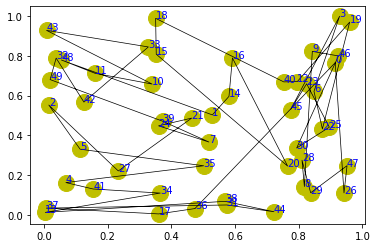

step:685/5000, actic loss:3.318, critic loss:12.920, L:16.384, 0min1sec
step:686/5000, actic loss:3.386, critic loss:12.906, L:16.379, 0min1sec
step:687/5000, actic loss:3.400, critic loss:12.890, L:16.375, 0min1sec
step:688/5000, actic loss:3.344, critic loss:12.876, L:16.371, 0min1sec
step:689/5000, actic loss:3.271, critic loss:12.862, L:16.367, 0min1sec
distance:11.641
tensor([33,  6,  2,  5,  8, 30, 44,  9, 20, 15, 36, 10, 17,  7, 40, 39, 43, 23,
        47, 28,  3, 19, 29, 27, 16, 12, 22, 45, 34, 32, 46, 38, 11, 49, 48,  0,
        21, 24, 35,  1, 18, 37, 13, 25, 41, 31, 42,  4, 14, 26])


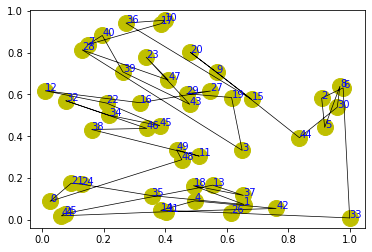

step:690/5000, actic loss:3.203, critic loss:12.848, L:16.363, 0min1sec
step:691/5000, actic loss:3.226, critic loss:12.832, L:16.358, 0min1sec
step:692/5000, actic loss:3.289, critic loss:12.819, L:16.353, 0min1sec
step:693/5000, actic loss:3.363, critic loss:12.806, L:16.347, 0min1sec
step:694/5000, actic loss:3.402, critic loss:12.791, L:16.341, 0min1sec
distance:9.064
tensor([28, 41, 22, 32, 35, 14, 21, 43, 10, 18, 40, 37, 12, 26,  0, 27,  2, 25,
        45, 38, 31, 30, 36, 11,  7, 42,  5,  9, 20, 44, 33,  6,  1, 15, 17, 46,
        48, 23,  8, 39, 24,  3, 19, 16, 49, 34, 29, 13, 47,  4])


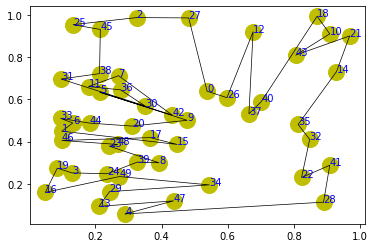

step:695/5000, actic loss:3.403, critic loss:12.775, L:16.334, 0min1sec
step:696/5000, actic loss:3.349, critic loss:12.761, L:16.327, 0min1sec
step:697/5000, actic loss:3.254, critic loss:12.751, L:16.320, 0min1sec
step:698/5000, actic loss:3.166, critic loss:12.742, L:16.313, 0min1sec
step:699/5000, actic loss:3.099, critic loss:12.730, L:16.307, 0min1sec
distance:11.155
tensor([35, 24, 48, 46, 29, 49,  1,  4, 25, 37, 17, 16, 44, 28, 33, 26, 13, 41,
        14, 30, 11, 34, 43, 38, 23,  7, 27, 39, 20, 40, 36, 22, 31,  9, 45, 32,
        21,  0, 18, 10,  6, 42,  2, 47,  5,  3,  8, 15, 19, 12])


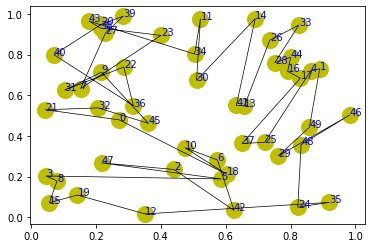

step:700/5000, actic loss:3.094, critic loss:12.714, L:16.300, 0min1sec
step:701/5000, actic loss:3.109, critic loss:12.699, L:16.293, 0min1sec
step:702/5000, actic loss:3.131, critic loss:12.683, L:16.286, 0min1sec
step:703/5000, actic loss:3.131, critic loss:12.667, L:16.279, 0min1sec
step:704/5000, actic loss:3.101, critic loss:12.652, L:16.271, 0min1sec
distance:9.432
tensor([37, 39, 20, 35, 24, 36,  9, 48, 30, 33, 34, 42, 27, 10, 43,  8, 14, 18,
        29,  4,  6, 38, 23, 13, 25, 40, 11, 44, 31,  5, 19, 12, 41,  0,  2,  1,
        26, 45, 22, 16, 47,  7,  3, 15, 46, 21, 28, 17, 32, 49])


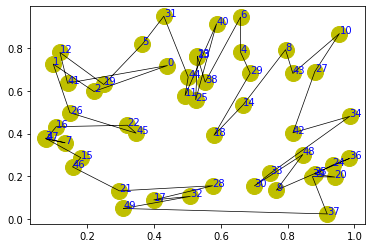

step:705/5000, actic loss:3.061, critic loss:12.636, L:16.264, 0min2sec
step:706/5000, actic loss:3.022, critic loss:12.621, L:16.257, 0min1sec
step:707/5000, actic loss:2.964, critic loss:12.608, L:16.250, 0min1sec
step:708/5000, actic loss:2.889, critic loss:12.596, L:16.246, 0min1sec
step:709/5000, actic loss:2.799, critic loss:12.586, L:16.243, 0min1sec
distance:12.973
tensor([44, 21,  2, 33,  8, 16, 30, 27,  7, 17, 39, 11, 47,  0, 42, 38,  1, 15,
        22, 48, 18, 45, 36, 24, 46, 12, 28, 43, 13, 10, 35, 40,  3, 14,  9, 34,
         4, 41, 19, 37,  6, 31, 23, 25, 29, 32,  5, 26, 20, 49])


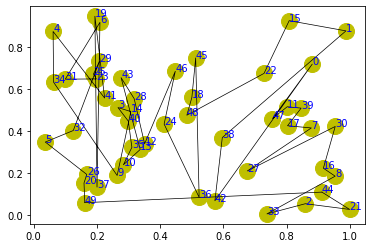

step:710/5000, actic loss:2.784, critic loss:12.573, L:16.240, 0min1sec
step:711/5000, actic loss:2.814, critic loss:12.559, L:16.238, 0min1sec
step:712/5000, actic loss:2.900, critic loss:12.552, L:16.235, 0min1sec
step:713/5000, actic loss:3.005, critic loss:12.549, L:16.232, 0min1sec
step:714/5000, actic loss:3.122, critic loss:12.550, L:16.228, 0min1sec
distance:15.414
tensor([26, 35,  2,  0, 30, 48, 43, 29, 38, 11, 40, 32, 42, 19, 31,  5,  6, 21,
        37,  8, 46, 45, 47, 22, 49, 44, 36, 18, 13, 10, 27, 39, 17, 33, 23,  9,
        25, 24, 15,  1, 20,  3, 28, 14, 12,  4, 16,  7, 41, 34])


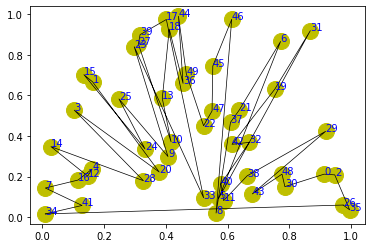

step:715/5000, actic loss:3.238, critic loss:12.553, L:16.224, 0min2sec
step:716/5000, actic loss:3.332, critic loss:12.552, L:16.219, 0min1sec
step:717/5000, actic loss:3.391, critic loss:12.543, L:16.215, 0min1sec
step:718/5000, actic loss:3.397, critic loss:12.528, L:16.210, 0min1sec
step:719/5000, actic loss:3.347, critic loss:12.516, L:16.205, 0min2sec
distance:11.501
tensor([36, 27, 49, 30, 37,  2,  7,  4, 46,  0, 41, 19, 18, 48, 23, 33, 29, 26,
        38, 47, 34,  5,  6, 44, 40, 11, 14, 45,  8, 32, 43, 22, 25, 42, 39, 13,
        16, 35, 31,  1, 12, 21,  9, 20, 10,  3, 28, 24, 17, 15])


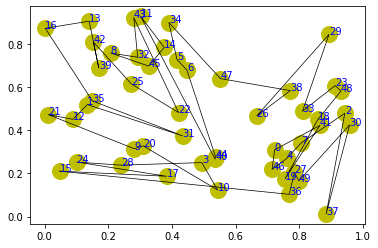

step:720/5000, actic loss:3.267, critic loss:12.511, L:16.200, 0min2sec
step:721/5000, actic loss:3.164, critic loss:12.509, L:16.196, 0min2sec
step:722/5000, actic loss:3.064, critic loss:12.506, L:16.192, 0min1sec
step:723/5000, actic loss:2.993, critic loss:12.495, L:16.189, 0min1sec
step:724/5000, actic loss:2.987, critic loss:12.482, L:16.186, 0min1sec
distance:12.205
tensor([37, 20, 26,  1,  5, 14, 24, 18, 28,  8,  3, 11, 10, 19, 43,  9, 27, 12,
        39, 13, 35, 41,  2, 46, 15, 40, 21, 44, 48, 36, 31, 42, 30, 45, 32, 22,
        33,  0,  6, 25, 34, 16, 38, 47, 49,  7, 17,  4, 29, 23])


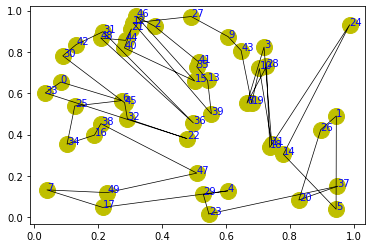

step:725/5000, actic loss:3.060, critic loss:12.474, L:16.182, 0min1sec
step:726/5000, actic loss:3.170, critic loss:12.473, L:16.178, 0min1sec
step:727/5000, actic loss:3.297, critic loss:12.477, L:16.173, 0min1sec
step:728/5000, actic loss:3.396, critic loss:12.473, L:16.168, 0min1sec
step:729/5000, actic loss:3.448, critic loss:12.463, L:16.164, 0min1sec
distance:12.183
tensor([42,  9, 46, 21, 31,  8, 37,  7,  5,  2, 14, 36, 19, 39, 28, 23, 35, 27,
        32, 33, 12, 29, 22, 45,  3, 16, 26, 44, 15,  1, 17, 18, 30, 40,  4, 11,
        25, 20, 48, 49, 47, 24, 10, 38,  6, 41, 34, 13,  0, 43])


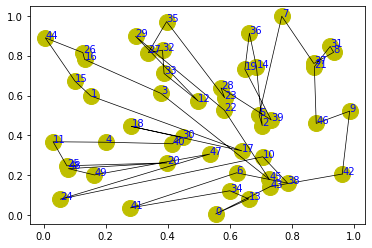

step:730/5000, actic loss:3.449, critic loss:12.449, L:16.159, 0min1sec
step:731/5000, actic loss:3.378, critic loss:12.440, L:16.155, 0min1sec
step:732/5000, actic loss:3.275, critic loss:12.433, L:16.150, 0min1sec
step:733/5000, actic loss:3.181, critic loss:12.425, L:16.145, 0min1sec
step:734/5000, actic loss:3.124, critic loss:12.412, L:16.140, 0min1sec
distance:13.631
tensor([18, 33, 49,  2, 22,  6, 45, 14, 23, 16, 29, 11, 30, 40, 20,  9,  0, 10,
        36, 31, 19, 27, 39, 38,  8, 24, 21, 37, 42,  4, 12,  1, 41, 26, 34, 43,
        32, 28, 15, 35, 13, 48, 47, 44, 17,  3,  5, 46, 25,  7])


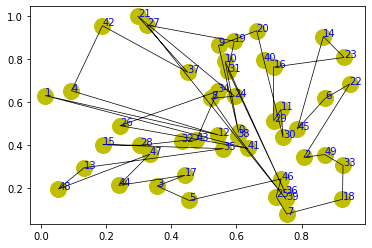

step:735/5000, actic loss:3.107, critic loss:12.398, L:16.136, 0min1sec
step:736/5000, actic loss:3.178, critic loss:12.386, L:16.131, 0min1sec
step:737/5000, actic loss:3.309, critic loss:12.381, L:16.126, 0min1sec
step:738/5000, actic loss:3.441, critic loss:12.377, L:16.121, 0min1sec
step:739/5000, actic loss:3.558, critic loss:12.370, L:16.117, 0min1sec
distance:10.383
tensor([ 0, 46,  2, 34, 41, 49, 11, 13, 42, 47, 23, 27, 44, 19, 21, 15,  4, 14,
        17, 29, 39, 25, 32, 38, 26, 16,  7,  8,  3, 33, 48, 10, 35,  9, 30, 12,
        45, 28, 20, 31,  5, 40, 22, 18, 37, 36,  6, 24, 43,  1])


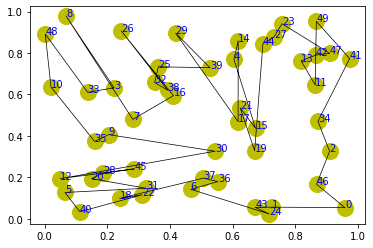

step:740/5000, actic loss:3.637, critic loss:12.360, L:16.113, 0min1sec
step:741/5000, actic loss:3.662, critic loss:12.346, L:16.109, 0min1sec
step:742/5000, actic loss:3.652, critic loss:12.333, L:16.104, 0min1sec
step:743/5000, actic loss:3.628, critic loss:12.319, L:16.099, 0min1sec
step:744/5000, actic loss:3.592, critic loss:12.306, L:16.094, 0min1sec
distance:11.154
tensor([30, 19,  9, 11, 39, 37, 45,  2, 24,  0, 32, 44, 38, 46, 13, 26, 43, 47,
        21,  6, 17, 25, 18, 36,  7, 20, 23, 29, 35, 42,  3, 22, 48, 41, 40,  8,
        14, 28, 12, 27, 49, 34, 10,  4,  5, 31, 15, 16,  1, 33])


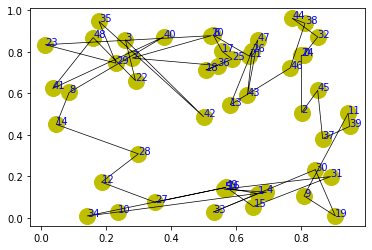

step:745/5000, actic loss:3.575, critic loss:12.292, L:16.089, 0min1sec
step:746/5000, actic loss:3.588, critic loss:12.278, L:16.083, 0min1sec
step:747/5000, actic loss:3.606, critic loss:12.263, L:16.078, 0min1sec
step:748/5000, actic loss:3.615, critic loss:12.249, L:16.073, 0min1sec
step:749/5000, actic loss:3.608, critic loss:12.234, L:16.067, 0min1sec
distance:14.193
tensor([23, 27, 42, 38, 45, 34, 24, 33, 31, 11, 40,  3,  0, 49, 22, 29, 32, 44,
        14, 15,  8, 37, 43, 19, 16,  9,  6, 47, 30, 48,  7, 21, 13, 20, 17, 10,
        39, 41, 26, 35,  1,  5, 36,  2, 25, 12,  4, 28, 18, 46])


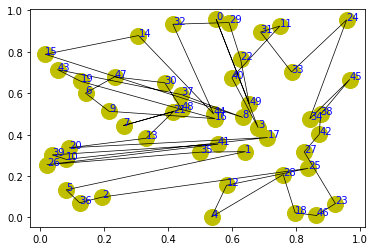

step:750/5000, actic loss:3.594, critic loss:12.221, L:16.062, 0min1sec
step:751/5000, actic loss:3.575, critic loss:12.206, L:16.057, 0min1sec
step:752/5000, actic loss:3.577, critic loss:12.192, L:16.052, 0min1sec
step:753/5000, actic loss:3.593, critic loss:12.179, L:16.047, 0min1sec
step:754/5000, actic loss:3.609, critic loss:12.165, L:16.041, 0min1sec
distance:11.330
tensor([13, 47, 37,  0, 32, 22, 43, 35, 27,  7, 40, 48, 31, 16,  6, 21, 10, 49,
         5,  9, 29, 15, 46, 26, 41, 17, 42,  4,  1, 12, 39, 30, 28, 11, 20, 45,
         8, 25, 23,  2, 38, 14, 18, 44, 34, 24, 36,  3, 19, 33])


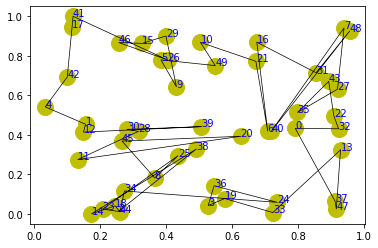

step:755/5000, actic loss:3.615, critic loss:12.151, L:16.035, 0min1sec
step:756/5000, actic loss:3.593, critic loss:12.137, L:16.030, 0min1sec
step:757/5000, actic loss:3.564, critic loss:12.124, L:16.024, 0min1sec
step:758/5000, actic loss:3.536, critic loss:12.110, L:16.018, 0min1sec
step:759/5000, actic loss:3.520, critic loss:12.097, L:16.012, 0min1sec
distance:10.778
tensor([ 4, 44, 28,  1, 26, 34, 21, 20, 17, 49, 37, 29, 22, 32,  9, 13, 38, 40,
        14, 11, 31, 24, 46, 41, 33, 48, 10, 25, 45,  0, 30, 15, 16,  5, 12, 42,
         6, 36,  2, 19, 35, 47, 18, 23, 39,  3, 43, 27,  7,  8])


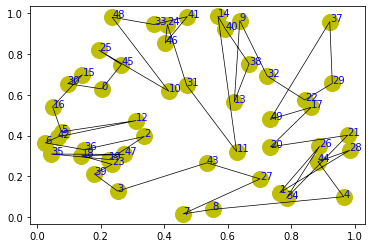

step:760/5000, actic loss:3.525, critic loss:12.083, L:16.006, 0min1sec
step:761/5000, actic loss:3.539, critic loss:12.070, L:16.000, 0min1sec
step:762/5000, actic loss:3.553, critic loss:12.056, L:15.994, 0min2sec
step:763/5000, actic loss:3.560, critic loss:12.043, L:15.988, 0min1sec
step:764/5000, actic loss:3.551, critic loss:12.029, L:15.982, 0min1sec
distance:12.700
tensor([49, 13, 42,  2,  1,  4, 29, 37, 24, 11, 33, 39, 14, 15, 25, 44, 38, 40,
        43, 36, 20, 46,  7,  6, 10, 41, 22,  9, 48, 19, 31, 26, 21, 16, 47, 45,
        18,  0, 30, 27, 17,  8, 35, 28,  3, 32, 23, 34, 12,  5])


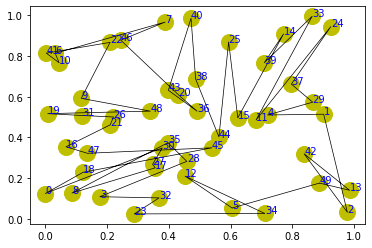

step:765/5000, actic loss:3.540, critic loss:12.015, L:15.975, 0min1sec
step:766/5000, actic loss:3.531, critic loss:12.001, L:15.969, 0min1sec
step:767/5000, actic loss:3.536, critic loss:11.987, L:15.962, 0min1sec
step:768/5000, actic loss:3.555, critic loss:11.973, L:15.955, 0min1sec
step:769/5000, actic loss:3.564, critic loss:11.959, L:15.948, 0min1sec
distance:10.599
tensor([18, 11, 46, 49, 16,  3, 42, 37, 12,  9, 39, 19, 45, 35, 33, 10, 23, 44,
        27, 22,  6, 38,  7, 41, 40,  2, 21, 25, 30, 47, 48, 29, 14,  4, 13,  0,
        31, 32,  5, 24, 26, 28, 43, 20, 36, 17,  1, 15,  8, 34])


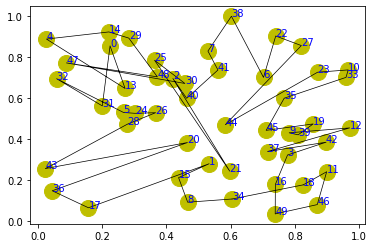

step:770/5000, actic loss:3.549, critic loss:11.945, L:15.941, 0min1sec
step:771/5000, actic loss:3.510, critic loss:11.931, L:15.935, 0min1sec
step:772/5000, actic loss:3.458, critic loss:11.917, L:15.929, 0min1sec
step:773/5000, actic loss:3.398, critic loss:11.905, L:15.923, 0min1sec
step:774/5000, actic loss:3.367, critic loss:11.891, L:15.918, 0min1sec
distance:13.073
tensor([47, 37, 26, 44,  1, 23, 19,  0, 40, 24,  7,  5,  4, 22, 12,  6, 27, 43,
        29, 48, 16, 45, 42, 20, 25, 11, 17, 39, 41, 34, 14,  8, 36, 32, 49, 38,
         9, 15, 33, 30, 21, 28, 31, 46, 35,  3,  2, 10, 18, 13])


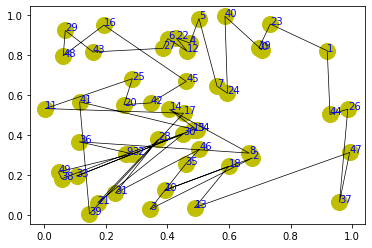

step:775/5000, actic loss:3.388, critic loss:11.878, L:15.912, 0min2sec
step:776/5000, actic loss:3.427, critic loss:11.865, L:15.906, 0min1sec
step:777/5000, actic loss:3.486, critic loss:11.854, L:15.900, 0min1sec
step:778/5000, actic loss:3.546, critic loss:11.842, L:15.894, 0min1sec
step:779/5000, actic loss:3.596, critic loss:11.830, L:15.888, 0min1sec
distance:9.705
tensor([41, 13,  8, 21, 19, 33, 31, 16, 43, 23, 39, 11, 47, 28, 38, 30, 18, 46,
         3, 15, 25,  6, 44, 20,  2, 22, 17,  4, 10,  0, 35, 48, 49, 27, 26, 14,
        36, 12, 40, 37, 24, 34, 42, 29,  7,  9, 32,  5,  1, 45])


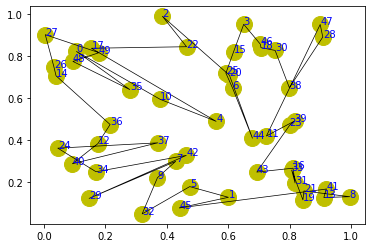

step:780/5000, actic loss:3.626, critic loss:11.817, L:15.881, 0min1sec
step:781/5000, actic loss:3.610, critic loss:11.804, L:15.875, 0min1sec
step:782/5000, actic loss:3.571, critic loss:11.791, L:15.869, 0min1sec
step:783/5000, actic loss:3.536, critic loss:11.779, L:15.862, 0min1sec
step:784/5000, actic loss:3.501, critic loss:11.766, L:15.856, 0min1sec
distance:10.355
tensor([ 0, 28, 31, 19, 34, 42,  9, 13, 49, 23, 27, 45, 32, 21, 14,  5, 44, 38,
        35, 26, 36, 22,  7, 15, 16,  3, 37,  2, 46, 10,  6, 20,  4, 30, 43, 24,
        29, 18, 40, 39,  1, 12, 11,  8, 33, 25, 41, 47, 17, 48])


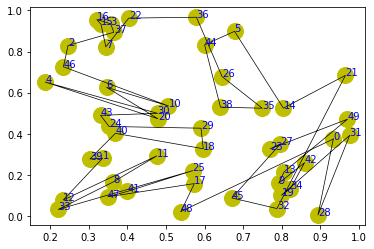

step:785/5000, actic loss:3.490, critic loss:11.753, L:15.850, 0min1sec
step:786/5000, actic loss:3.494, critic loss:11.739, L:15.844, 0min1sec
step:787/5000, actic loss:3.515, critic loss:11.726, L:15.837, 0min1sec
step:788/5000, actic loss:3.537, critic loss:11.714, L:15.831, 0min1sec
step:789/5000, actic loss:3.547, critic loss:11.701, L:15.824, 0min1sec
distance:10.232
tensor([13, 46, 10,  5, 28, 40, 24, 37, 21, 26, 14,  0, 32, 11,  1, 23, 45,  3,
        42, 29, 47, 30, 12, 19, 43, 16, 33,  9, 38, 15, 49,  8, 44, 25,  7,  6,
        35, 18, 20, 41, 48, 36, 31, 34, 27, 17, 39,  2,  4, 22])


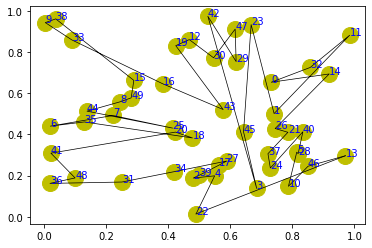

step:790/5000, actic loss:3.543, critic loss:11.687, L:15.818, 0min1sec
step:791/5000, actic loss:3.514, critic loss:11.674, L:15.812, 0min1sec
step:792/5000, actic loss:3.484, critic loss:11.662, L:15.805, 0min2sec
step:793/5000, actic loss:3.447, critic loss:11.650, L:15.799, 0min1sec
step:794/5000, actic loss:3.425, critic loss:11.637, L:15.792, 0min1sec
distance:9.659
tensor([12, 45, 23, 26,  1,  7, 34, 41, 36, 33, 47,  8, 32, 17, 18, 14, 49, 24,
         0, 38, 43, 10, 37,  3, 48, 19, 28, 44,  5, 29, 39,  6,  9, 25, 35, 20,
        15, 13, 11,  4,  2, 30, 42, 40, 22, 27, 46, 16, 31, 21])


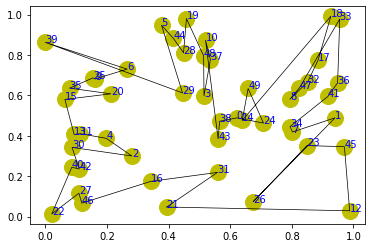

step:795/5000, actic loss:3.417, critic loss:11.624, L:15.786, 0min1sec
step:796/5000, actic loss:3.434, critic loss:11.611, L:15.779, 0min1sec
step:797/5000, actic loss:3.455, critic loss:11.599, L:15.772, 0min1sec
step:798/5000, actic loss:3.479, critic loss:11.587, L:15.765, 0min1sec
step:799/5000, actic loss:3.487, critic loss:11.574, L:15.759, 0min1sec
distance:8.398
tensor([ 0, 41, 32,  9, 37, 14, 39, 11, 25, 23, 35, 24, 21, 22, 15,  6, 12, 31,
        28, 48, 29, 13,  8, 40,  1, 26, 49,  7, 17, 47,  2, 20, 30,  3, 19, 38,
         4, 34, 27, 42, 16, 43, 46, 44,  5, 18, 10, 33, 36, 45])


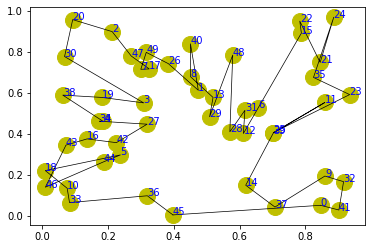

step:800/5000, actic loss:3.487, critic loss:11.561, L:15.752, 0min1sec
step:801/5000, actic loss:3.457, critic loss:11.549, L:15.746, 0min1sec
step:802/5000, actic loss:3.424, critic loss:11.537, L:15.740, 0min1sec
step:803/5000, actic loss:3.384, critic loss:11.525, L:15.734, 0min1sec
step:804/5000, actic loss:3.347, critic loss:11.513, L:15.727, 0min1sec
distance:12.107
tensor([ 7, 28, 45, 16,  4, 22,  3, 13, 18, 46, 15, 31, 47, 43, 39, 44, 25, 12,
        35, 48, 11, 36, 30,  1, 10,  0, 20, 42,  8, 27,  6, 32, 40, 17, 24, 19,
        34,  5, 26, 49, 33, 37, 29, 41,  2, 14, 23, 21, 38,  9])


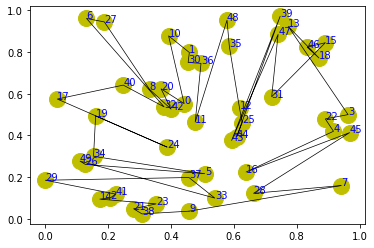

step:805/5000, actic loss:3.321, critic loss:11.501, L:15.721, 0min1sec
step:806/5000, actic loss:3.307, critic loss:11.488, L:15.716, 0min1sec
step:807/5000, actic loss:3.329, critic loss:11.476, L:15.710, 0min1sec
step:808/5000, actic loss:3.375, critic loss:11.465, L:15.703, 0min1sec
step:809/5000, actic loss:3.426, critic loss:11.454, L:15.698, 0min1sec
distance:9.894
tensor([ 6, 21, 12,  5, 14, 48, 30, 35, 43, 27,  3,  9, 15, 18,  2, 29,  0,  8,
        23, 24, 38, 10, 25, 28, 34, 45, 19, 36, 49, 11,  7, 47, 40, 22,  4,  1,
        46, 32, 17, 44, 26, 13, 20, 39, 42, 31, 41, 16, 33, 37])


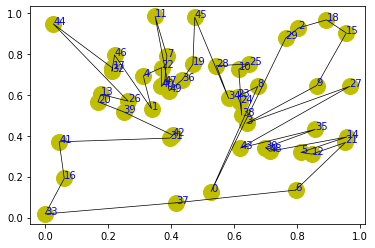

step:810/5000, actic loss:3.477, critic loss:11.443, L:15.692, 0min1sec
step:811/5000, actic loss:3.496, critic loss:11.431, L:15.686, 0min1sec
step:812/5000, actic loss:3.478, critic loss:11.419, L:15.681, 0min1sec
step:813/5000, actic loss:3.445, critic loss:11.407, L:15.676, 0min1sec
step:814/5000, actic loss:3.417, critic loss:11.396, L:15.671, 0min1sec
distance:12.164
tensor([ 9, 34, 13, 12,  7, 32, 15, 11,  5, 19, 28, 37, 46,  3,  0, 10, 35, 44,
        23, 27, 36,  4, 43, 14, 30, 48,  1, 21, 18, 29, 42, 31, 25, 22, 20,  2,
        49, 33, 17, 41, 47, 16,  8, 40,  6, 39, 45, 26, 24, 38])


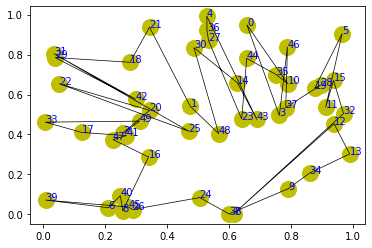

step:815/5000, actic loss:3.424, critic loss:11.384, L:15.666, 0min1sec
step:816/5000, actic loss:3.449, critic loss:11.372, L:15.660, 0min1sec
step:817/5000, actic loss:3.477, critic loss:11.360, L:15.653, 0min1sec
step:818/5000, actic loss:3.490, critic loss:11.348, L:15.647, 0min1sec
step:819/5000, actic loss:3.492, critic loss:11.335, L:15.640, 0min1sec
distance:9.719
tensor([24, 14, 32, 41, 46,  7, 16, 11, 20, 30,  8, 31,  0,  4, 45, 37, 35, 27,
        42,  5, 38, 44, 39,  1,  3, 19,  9,  6, 22, 40, 23, 17, 26, 21, 13, 36,
        12, 29, 25, 49, 47, 48, 34, 43, 10, 18,  2, 28, 15, 33])


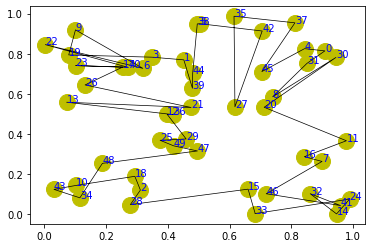

step:820/5000, actic loss:3.456, critic loss:11.323, L:15.634, 0min1sec
step:821/5000, actic loss:3.398, critic loss:11.313, L:15.628, 0min1sec
step:822/5000, actic loss:3.348, critic loss:11.302, L:15.621, 0min1sec
step:823/5000, actic loss:3.302, critic loss:11.291, L:15.615, 0min1sec
step:824/5000, actic loss:3.256, critic loss:11.280, L:15.609, 0min1sec
distance:9.496
tensor([11, 24, 46,  7, 31, 41,  4, 47, 28, 34, 33, 29, 40,  0, 38, 14, 39,  9,
        35,  2, 48, 49, 32, 23, 27, 22, 13, 25, 44, 20, 19, 30, 15, 10,  6, 18,
        36, 37, 43, 21,  5,  1, 26,  3,  8, 42, 17, 12, 16, 45])


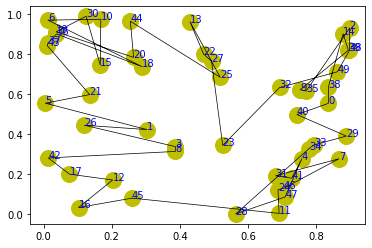

step:825/5000, actic loss:3.219, critic loss:11.268, L:15.602, 0min1sec
step:826/5000, actic loss:3.208, critic loss:11.255, L:15.596, 0min1sec
step:827/5000, actic loss:3.229, critic loss:11.244, L:15.590, 0min1sec
step:828/5000, actic loss:3.273, critic loss:11.233, L:15.584, 0min1sec
step:829/5000, actic loss:3.324, critic loss:11.224, L:15.577, 0min1sec
distance:10.316
tensor([14, 32, 37, 17,  9,  3, 18, 40, 19, 27, 35, 10, 28, 24, 36, 20, 23,  4,
        42, 48, 39, 31, 13,  0,  8, 25, 33, 22, 47, 11, 44,  1, 43,  2, 12,  5,
        34, 38,  7, 26, 15, 49, 30,  6, 16, 46, 41, 29, 21, 45])


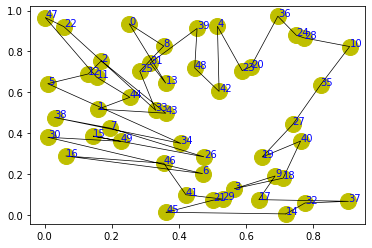

step:830/5000, actic loss:3.371, critic loss:11.214, L:15.571, 0min1sec
step:831/5000, actic loss:3.408, critic loss:11.203, L:15.565, 0min1sec
step:832/5000, actic loss:3.417, critic loss:11.191, L:15.559, 0min1sec
step:833/5000, actic loss:3.403, critic loss:11.179, L:15.554, 0min1sec
step:834/5000, actic loss:3.380, critic loss:11.167, L:15.548, 0min1sec
distance:12.601
tensor([19, 23, 24, 40, 10, 33,  4, 45,  9, 34, 36,  6, 39, 30, 14, 47, 35, 22,
         8,  1, 15, 44, 37,  0, 26, 42, 27, 16, 29, 46, 12,  7, 38,  5, 28, 43,
         2, 18, 11,  3, 20, 41, 32, 49, 25, 31, 17, 21, 13, 48])


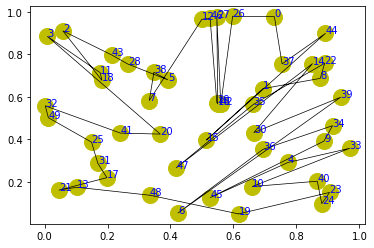

step:835/5000, actic loss:3.354, critic loss:11.155, L:15.542, 0min1sec
step:836/5000, actic loss:3.339, critic loss:11.143, L:15.537, 0min1sec
step:837/5000, actic loss:3.334, critic loss:11.131, L:15.531, 0min1sec
step:838/5000, actic loss:3.336, critic loss:11.119, L:15.525, 0min1sec
step:839/5000, actic loss:3.346, critic loss:11.108, L:15.519, 0min1sec
distance:10.401
tensor([39, 23, 48,  3, 41,  1, 21, 30, 19, 40, 22, 33,  0, 36, 29, 27, 47, 45,
        31, 37,  8, 35, 49, 10, 34, 42, 16, 14, 12, 44, 38, 25, 13,  5, 20, 18,
         6, 17,  7,  2,  9, 24, 26,  4, 43, 15, 46, 11, 28, 32])


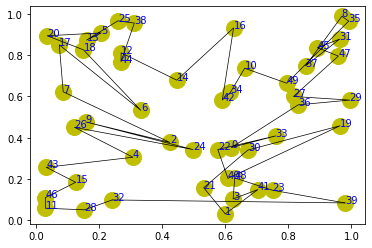

step:840/5000, actic loss:3.348, critic loss:11.096, L:15.513, 0min1sec
step:841/5000, actic loss:3.336, critic loss:11.084, L:15.506, 0min1sec
step:842/5000, actic loss:3.331, critic loss:11.072, L:15.500, 0min1sec
step:843/5000, actic loss:3.320, critic loss:11.060, L:15.494, 0min1sec
step:844/5000, actic loss:3.321, critic loss:11.047, L:15.487, 0min1sec
distance:9.861
tensor([46, 37, 17, 40, 38,  8, 43,  0, 10,  2, 23, 20, 22, 24, 25, 13, 19, 35,
        30,  7, 36, 41, 33,  1,  6, 11, 42,  4, 14, 39, 45, 27, 16, 26, 31, 29,
        34, 48, 32, 44, 49, 15,  5, 12, 28, 47,  9, 21,  3, 18])


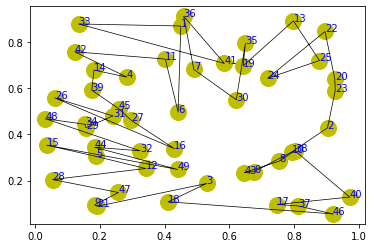

step:845/5000, actic loss:3.321, critic loss:11.035, L:15.480, 0min1sec
step:846/5000, actic loss:3.308, critic loss:11.023, L:15.474, 0min1sec
step:847/5000, actic loss:3.294, critic loss:11.011, L:15.468, 0min1sec
step:848/5000, actic loss:3.285, critic loss:10.999, L:15.462, 0min1sec
step:849/5000, actic loss:3.284, critic loss:10.987, L:15.456, 0min1sec
distance:9.933
tensor([38, 32, 36, 12, 46, 21, 44,  5, 28, 35,  2, 33, 17, 14, 43,  0, 47, 10,
        16, 37, 42, 20, 27, 19, 30, 23, 49, 45, 34, 13, 26, 25,  3, 15, 22, 18,
         8, 11, 40, 41,  1,  4, 48,  6, 29,  7,  9, 24, 39, 31])


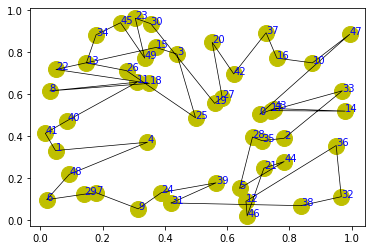

step:850/5000, actic loss:3.291, critic loss:10.976, L:15.450, 0min1sec
step:851/5000, actic loss:3.296, critic loss:10.964, L:15.444, 0min1sec
step:852/5000, actic loss:3.295, critic loss:10.953, L:15.438, 0min1sec
step:853/5000, actic loss:3.285, critic loss:10.941, L:15.432, 0min1sec
step:854/5000, actic loss:3.268, critic loss:10.929, L:15.426, 0min1sec
distance:9.457
tensor([26, 43,  5, 33, 47, 16,  9, 20, 19, 42, 13, 18, 10, 21, 46, 11, 48,  1,
        41, 22, 28, 24, 15, 17, 34,  0, 49, 14, 38,  4, 37, 35,  2, 29, 25,  7,
        36,  3, 44, 27, 31,  8,  6, 32, 30, 39, 23, 40, 12, 45])


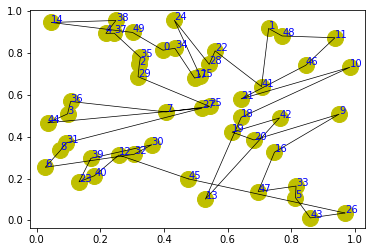

step:855/5000, actic loss:3.255, critic loss:10.918, L:15.419, 0min1sec
step:856/5000, actic loss:3.245, critic loss:10.906, L:15.413, 0min1sec
step:857/5000, actic loss:3.246, critic loss:10.895, L:15.407, 0min1sec
step:858/5000, actic loss:3.245, critic loss:10.883, L:15.402, 0min1sec
step:859/5000, actic loss:3.243, critic loss:10.872, L:15.396, 0min1sec
distance:10.092
tensor([23, 42, 29, 33, 30, 46, 19, 21,  2, 20, 32, 26, 12,  1, 39,  8,  3, 36,
        34, 10, 45, 35, 18, 25, 31,  0, 43, 16, 11, 22, 13, 44,  5, 27, 28,  9,
        49, 17, 37, 15, 14,  7,  6, 40, 47, 41, 24, 38, 48,  4])


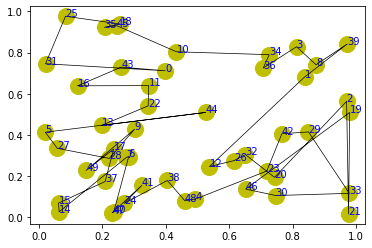

step:860/5000, actic loss:3.234, critic loss:10.860, L:15.390, 0min1sec
step:861/5000, actic loss:3.225, critic loss:10.849, L:15.385, 0min1sec
step:862/5000, actic loss:3.221, critic loss:10.837, L:15.379, 0min1sec
step:863/5000, actic loss:3.215, critic loss:10.826, L:15.373, 0min1sec
step:864/5000, actic loss:3.214, critic loss:10.815, L:15.367, 0min1sec
distance:9.259
tensor([ 7, 18, 30, 24, 42, 22, 49, 32, 43, 46, 38, 28, 31, 19, 34, 10, 27, 44,
         9, 14,  5, 39, 16,  4, 33,  2, 25,  6, 48, 26, 17, 41, 23, 45, 20, 21,
        37, 36, 47,  0, 13,  3, 35, 40, 12,  1,  8, 29, 11, 15])


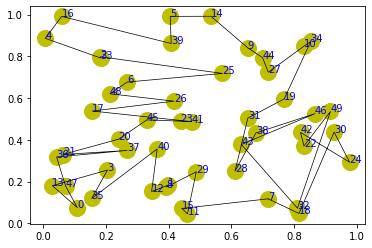

step:865/5000, actic loss:3.207, critic loss:10.804, L:15.361, 0min1sec
step:866/5000, actic loss:3.206, critic loss:10.792, L:15.355, 0min1sec
step:867/5000, actic loss:3.198, critic loss:10.781, L:15.349, 0min1sec
step:868/5000, actic loss:3.197, critic loss:10.770, L:15.343, 0min1sec
step:869/5000, actic loss:3.192, critic loss:10.759, L:15.336, 0min1sec
distance:9.344
tensor([32, 29, 37, 15, 30, 13, 34,  1, 28, 33, 36, 12, 22, 49,  8, 31, 23, 10,
         0, 48, 35, 11,  9, 19,  7, 41, 20, 45,  2,  3,  4, 42, 39, 25, 17, 21,
        16, 46, 40, 14, 38,  6, 18, 43, 26, 47, 44, 24, 27,  5])


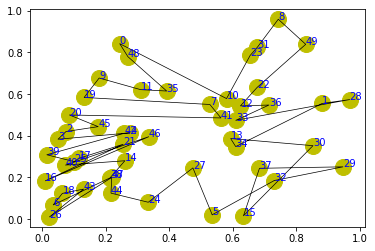

step:870/5000, actic loss:3.172, critic loss:10.748, L:15.330, 0min1sec
step:871/5000, actic loss:3.153, critic loss:10.737, L:15.323, 0min1sec
step:872/5000, actic loss:3.142, critic loss:10.726, L:15.317, 0min1sec
step:873/5000, actic loss:3.132, critic loss:10.715, L:15.310, 0min1sec
step:874/5000, actic loss:3.130, critic loss:10.703, L:15.304, 0min1sec
distance:11.058
tensor([ 6,  4, 12, 21, 26, 32, 31, 45, 36,  8, 17, 35, 41, 14, 11,  9, 43, 24,
        34, 48,  1, 13, 22,  7, 30, 47, 20, 19, 23,  5, 33, 44,  0,  2, 39, 27,
         3, 15, 37, 29, 40, 18, 42, 10, 38, 28, 46, 49, 16, 25])


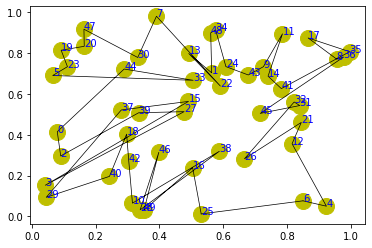

step:875/5000, actic loss:3.132, critic loss:10.692, L:15.298, 0min1sec
step:876/5000, actic loss:3.136, critic loss:10.682, L:15.292, 0min1sec
step:877/5000, actic loss:3.140, critic loss:10.670, L:15.285, 0min1sec
step:878/5000, actic loss:3.135, critic loss:10.659, L:15.279, 0min1sec
step:879/5000, actic loss:3.117, critic loss:10.648, L:15.272, 0min1sec
distance:9.680
tensor([46, 49, 39,  3, 41, 42, 45, 43, 47, 15, 25, 44, 11, 26, 35, 19,  5,  4,
        33, 28, 21, 10,  2, 38, 24,  1, 36, 18, 14, 17, 20, 23, 12, 27,  8, 22,
        31,  9,  0, 16, 34,  6, 30, 13, 37, 29, 32,  7, 48, 40])


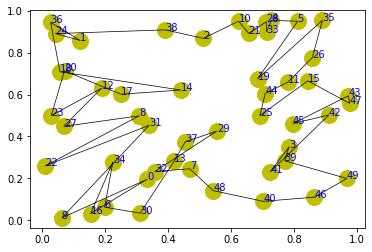

step:880/5000, actic loss:3.095, critic loss:10.638, L:15.265, 0min1sec
step:881/5000, actic loss:3.068, critic loss:10.627, L:15.259, 0min1sec
step:882/5000, actic loss:3.045, critic loss:10.617, L:15.252, 0min1sec
step:883/5000, actic loss:3.034, critic loss:10.606, L:15.246, 0min1sec
step:884/5000, actic loss:3.033, critic loss:10.595, L:15.239, 0min1sec
distance:10.038
tensor([37, 45,  2, 32, 34,  5, 27, 43, 31, 19, 36, 46, 28,  6, 35, 30, 29,  9,
        41, 42, 22, 18,  8, 13, 23, 16, 39, 10, 12, 24, 47,  7, 48,  0, 17, 21,
         3, 40, 20, 49, 33, 38, 25,  1,  4, 15, 14, 11, 26, 44])


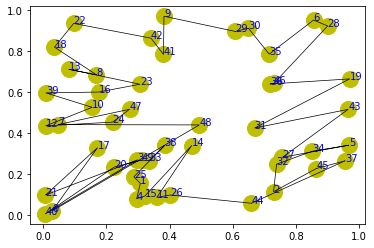

step:885/5000, actic loss:3.046, critic loss:10.584, L:15.232, 0min1sec
step:886/5000, actic loss:3.065, critic loss:10.573, L:15.225, 0min1sec
step:887/5000, actic loss:3.078, critic loss:10.563, L:15.218, 0min1sec
step:888/5000, actic loss:3.082, critic loss:10.552, L:15.211, 0min1sec
step:889/5000, actic loss:3.070, critic loss:10.541, L:15.204, 0min1sec
distance:7.908
tensor([18,  3,  1, 29,  9, 42, 13, 48,  2, 16, 21, 46, 33, 20, 25, 11, 12, 40,
        31, 49, 30, 47, 27, 17, 45, 26, 14,  0, 38,  4, 35, 32, 19, 36, 43,  8,
        23, 39,  6, 34, 28, 44,  5,  7, 41, 22, 10, 15, 37, 24])


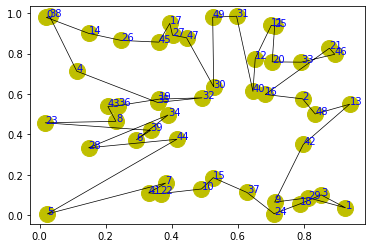

step:890/5000, actic loss:3.054, critic loss:10.530, L:15.197, 0min1sec
step:891/5000, actic loss:3.044, critic loss:10.519, L:15.190, 0min1sec
step:892/5000, actic loss:3.039, critic loss:10.507, L:15.183, 0min1sec
step:893/5000, actic loss:3.043, critic loss:10.496, L:15.175, 0min1sec
step:894/5000, actic loss:3.050, critic loss:10.485, L:15.168, 0min1sec
distance:9.686
tensor([14, 26,  8,  2, 40, 23, 10, 34, 30, 42, 39, 18, 22,  6, 12, 16, 27, 32,
         5, 13, 35, 36,  4, 15,  1, 33, 11, 29, 25, 48, 49, 17, 28, 45, 41, 31,
        37,  0, 19, 46,  3,  7, 44, 43, 47, 20,  9, 21, 38, 24])


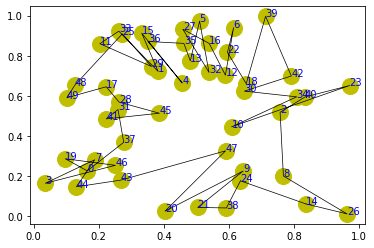

step:895/5000, actic loss:3.053, critic loss:10.474, L:15.161, 0min1sec
step:896/5000, actic loss:3.054, critic loss:10.463, L:15.154, 0min1sec
step:897/5000, actic loss:3.043, critic loss:10.452, L:15.146, 0min1sec
step:898/5000, actic loss:3.030, critic loss:10.441, L:15.139, 0min1sec
step:899/5000, actic loss:3.011, critic loss:10.431, L:15.132, 0min1sec
distance:7.750
tensor([46, 31,  8, 45, 34, 20, 43, 15, 13, 33, 48, 18, 37,  5, 41,  1, 40, 19,
         6, 11,  7, 12, 44, 32, 22, 10, 17, 23, 14, 30, 25, 26, 47, 38, 39, 35,
         3,  2, 16, 27,  9, 21, 28,  0, 24, 29,  4, 42, 49, 36])


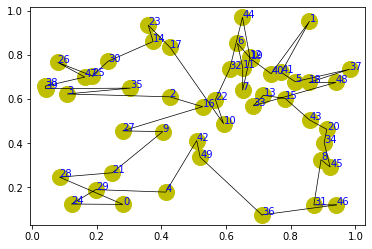

step:900/5000, actic loss:2.995, critic loss:10.420, L:15.125, 0min1sec
step:901/5000, actic loss:2.991, critic loss:10.409, L:15.118, 0min1sec
step:902/5000, actic loss:2.988, critic loss:10.398, L:15.110, 0min1sec
step:903/5000, actic loss:2.987, critic loss:10.387, L:15.103, 0min1sec
step:904/5000, actic loss:2.982, critic loss:10.376, L:15.096, 0min1sec
distance:8.590
tensor([11, 39, 38, 15, 29, 40, 36, 22,  0, 27, 43,  7,  5, 37, 34, 49,  4, 28,
        14, 32, 42, 19, 25, 46, 41,  2, 21, 31, 30, 45, 33, 13,  3, 16, 35,  9,
        10, 20,  1, 12, 26, 44, 17, 24, 23, 18, 47,  8,  6, 48])


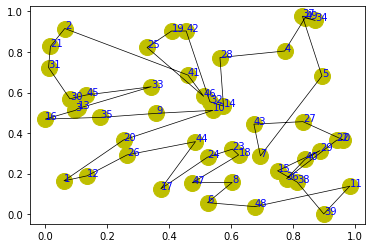

step:905/5000, actic loss:2.977, critic loss:10.366, L:15.089, 0min1sec
step:906/5000, actic loss:2.974, critic loss:10.355, L:15.082, 0min1sec
step:907/5000, actic loss:2.976, critic loss:10.344, L:15.074, 0min1sec
step:908/5000, actic loss:2.980, critic loss:10.333, L:15.067, 0min1sec
step:909/5000, actic loss:2.981, critic loss:10.322, L:15.060, 0min1sec
distance:7.729
tensor([10,  0, 40, 18,  2,  5, 17, 44, 36, 24, 46,  9, 16, 41, 32, 38,  1, 14,
        30, 15, 43,  3, 45, 21, 20, 13, 31, 28, 37, 19, 34,  7, 35, 12, 23, 42,
         4, 48, 11, 39, 49, 47, 26, 25,  6, 22, 29, 33, 27,  8])


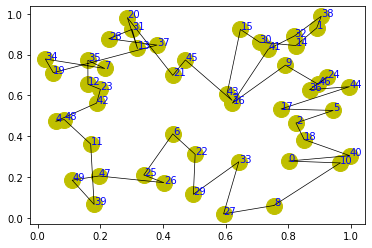

step:910/5000, actic loss:2.969, critic loss:10.312, L:15.052, 0min1sec
step:911/5000, actic loss:2.958, critic loss:10.301, L:15.045, 0min1sec
step:912/5000, actic loss:2.941, critic loss:10.290, L:15.038, 0min1sec
step:913/5000, actic loss:2.935, critic loss:10.280, L:15.031, 0min1sec
step:914/5000, actic loss:2.940, critic loss:10.269, L:15.024, 0min1sec
distance:7.933
tensor([40, 24,  9,  0, 37, 30,  6,  3, 19, 27, 48, 36, 45, 42,  5, 16, 25, 14,
        13, 23, 12, 41, 10,  7, 38, 20, 21,  1, 11, 17, 43,  4, 31, 32, 18, 33,
        28, 47, 34, 22,  8, 35, 26, 46, 29,  2, 44, 15, 39, 49])


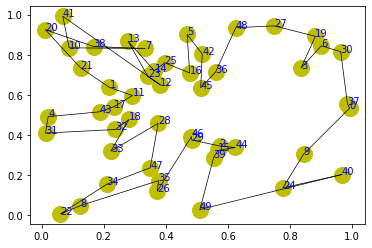

step:915/5000, actic loss:2.953, critic loss:10.259, L:15.016, 0min1sec
step:916/5000, actic loss:2.966, critic loss:10.249, L:15.009, 0min1sec
step:917/5000, actic loss:2.973, critic loss:10.238, L:15.001, 0min1sec
step:918/5000, actic loss:2.973, critic loss:10.228, L:14.994, 0min1sec
step:919/5000, actic loss:2.963, critic loss:10.217, L:14.987, 0min1sec
distance:7.943
tensor([42, 33, 41, 21, 36, 34, 14, 31, 47,  0,  2, 12, 13, 40, 35, 44, 26,  5,
        38, 49,  4, 22, 25, 46, 16, 45, 29, 27, 28, 37, 39, 32,  6, 11,  1, 15,
        19, 10,  7,  8, 43, 18, 23,  3, 24, 17, 48,  9, 30, 20])


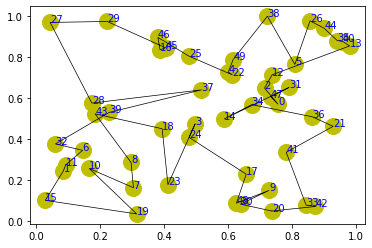

step:920/5000, actic loss:2.948, critic loss:10.207, L:14.979, 0min1sec
step:921/5000, actic loss:2.931, critic loss:10.196, L:14.972, 0min1sec
step:922/5000, actic loss:2.915, critic loss:10.186, L:14.965, 0min1sec
step:923/5000, actic loss:2.902, critic loss:10.176, L:14.957, 0min1sec
step:924/5000, actic loss:2.893, critic loss:10.165, L:14.951, 0min1sec
distance:8.189
tensor([18, 27, 45,  2, 36, 38, 40, 30, 43, 31, 23,  5, 37, 33, 24, 22, 28, 16,
         6, 35, 41, 14,  3,  9, 47, 21,  1, 13, 17, 46, 42, 48,  0, 11, 19, 32,
        15,  4, 26, 44,  7,  8, 39, 49, 34, 20, 12, 10, 29, 25])


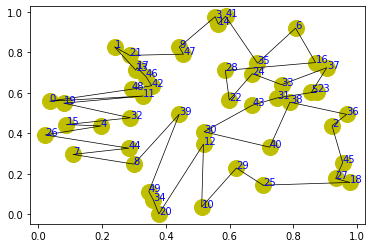

step:925/5000, actic loss:2.900, critic loss:10.155, L:14.944, 0min1sec
step:926/5000, actic loss:2.917, critic loss:10.146, L:14.937, 0min1sec
step:927/5000, actic loss:2.936, critic loss:10.137, L:14.930, 0min1sec
step:928/5000, actic loss:2.951, critic loss:10.128, L:14.923, 0min1sec
step:929/5000, actic loss:2.962, critic loss:10.118, L:14.916, 0min1sec
distance:7.696
tensor([ 8, 12, 10, 24, 31, 22,  2,  3, 33, 25, 48, 39, 38, 41, 45, 32,  6, 49,
        26, 42,  0, 29, 18, 23,  1, 35, 28, 21, 19, 20, 27,  4, 37, 46, 36, 47,
        43,  9, 17, 15, 30, 13, 34, 14, 40,  5, 44, 16,  7, 11])


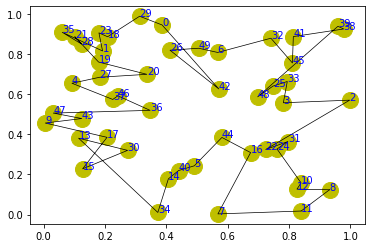

step:930/5000, actic loss:2.964, critic loss:10.108, L:14.909, 0min2sec
step:931/5000, actic loss:2.953, critic loss:10.098, L:14.902, 0min1sec
step:932/5000, actic loss:2.932, critic loss:10.089, L:14.895, 0min1sec
step:933/5000, actic loss:2.909, critic loss:10.080, L:14.889, 0min1sec
step:934/5000, actic loss:2.885, critic loss:10.071, L:14.883, 0min2sec
distance:11.419
tensor([14, 36, 31, 22, 29, 16, 11, 43,  0, 47,  7, 42,  2,  6, 24,  9, 49,  1,
        37, 19, 13,  3, 18,  4, 38, 26, 23, 34, 48, 27, 25, 33, 21, 30, 10,  8,
        12, 39, 32, 15, 17,  5, 45, 35, 20, 46, 44, 28, 41, 40])


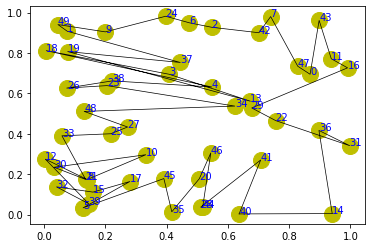

step:935/5000, actic loss:2.866, critic loss:10.061, L:14.876, 0min2sec
step:936/5000, actic loss:2.855, critic loss:10.052, L:14.870, 0min1sec
step:937/5000, actic loss:2.857, critic loss:10.042, L:14.864, 0min1sec
step:938/5000, actic loss:2.868, critic loss:10.032, L:14.857, 0min1sec
step:939/5000, actic loss:2.884, critic loss:10.023, L:14.851, 0min1sec
distance:9.491
tensor([ 3, 20, 22, 24, 40, 31, 14,  1,  9, 34, 12, 36, 43, 47, 15,  2,  4, 39,
        33, 16,  0,  7, 26, 42, 48, 41, 38, 23, 49, 10, 13, 11, 32, 19, 21, 17,
        46, 37, 28, 35,  8,  6, 44, 30,  5, 45, 25, 27, 29, 18])


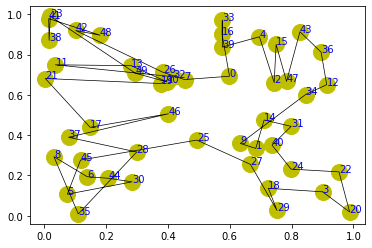

step:940/5000, actic loss:2.902, critic loss:10.015, L:14.844, 0min1sec
step:941/5000, actic loss:2.916, critic loss:10.005, L:14.837, 0min1sec
step:942/5000, actic loss:2.921, critic loss:9.995, L:14.831, 0min1sec
step:943/5000, actic loss:2.914, critic loss:9.985, L:14.824, 0min1sec
step:944/5000, actic loss:2.901, critic loss:9.976, L:14.817, 0min1sec
distance:9.247
tensor([47, 45, 18, 12, 39, 32,  4,  1, 46,  5, 38, 33, 48, 41, 23, 31, 22, 29,
        19, 20,  7, 36, 15, 13,  2, 49, 17, 37, 24, 25, 35,  3, 27, 10, 44, 43,
        30, 14,  6,  8, 26, 16, 34, 40, 42, 28, 21,  0,  9, 11])


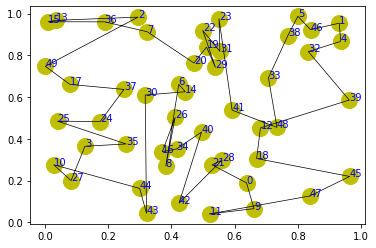

step:945/5000, actic loss:2.887, critic loss:9.966, L:14.811, 0min1sec
step:946/5000, actic loss:2.870, critic loss:9.956, L:14.804, 0min1sec
step:947/5000, actic loss:2.859, critic loss:9.946, L:14.798, 0min1sec
step:948/5000, actic loss:2.860, critic loss:9.936, L:14.791, 0min1sec
step:949/5000, actic loss:2.864, critic loss:9.927, L:14.785, 0min1sec
distance:10.062
tensor([ 4, 12,  1, 20, 30,  9, 39, 43, 40, 23, 14, 17, 11,  7, 25, 42, 46, 48,
        10, 32,  2, 28, 49, 31, 18,  8, 22, 13, 29, 44, 37, 38, 41, 19,  5, 21,
         6,  0, 27, 24,  3, 15, 16, 34, 35, 36, 47, 26, 33, 45])


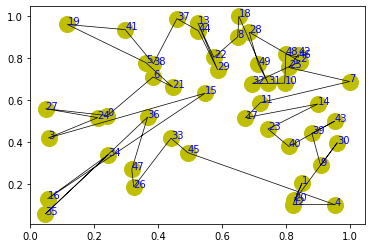

step:950/5000, actic loss:2.870, critic loss:9.917, L:14.778, 0min1sec
step:951/5000, actic loss:2.871, critic loss:9.907, L:14.772, 0min1sec
step:952/5000, actic loss:2.860, critic loss:9.898, L:14.766, 0min1sec
step:953/5000, actic loss:2.849, critic loss:9.888, L:14.759, 0min1sec
step:954/5000, actic loss:2.841, critic loss:9.878, L:14.753, 0min1sec
distance:8.202
tensor([33, 37, 15,  3, 28, 42, 41,  0,  4, 17,  2, 18, 30, 24, 26, 39, 38, 35,
        40, 32, 10,  8, 48, 34, 43, 29, 12, 45, 19, 11, 16, 46, 36,  1, 13, 14,
        49, 23,  5, 47, 31,  9, 44, 21, 20, 22,  7, 25, 27,  6])


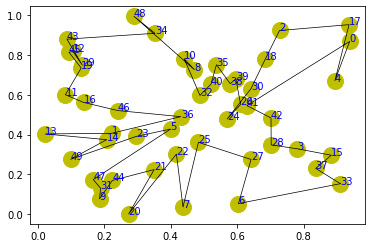

step:955/5000, actic loss:2.838, critic loss:9.868, L:14.746, 0min1sec
step:956/5000, actic loss:2.839, critic loss:9.858, L:14.740, 0min1sec
step:957/5000, actic loss:2.841, critic loss:9.849, L:14.733, 0min1sec
step:958/5000, actic loss:2.839, critic loss:9.839, L:14.727, 0min1sec
step:959/5000, actic loss:2.829, critic loss:9.830, L:14.720, 0min1sec
distance:9.120
tensor([20,  0, 29, 27, 33, 24,  3, 46, 49, 45, 36, 17,  1, 48,  9, 15, 39,  2,
        22, 30,  5, 26, 37, 18, 44, 21, 28, 42, 35, 13, 31, 32,  8, 19,  6, 12,
        43, 16, 41,  4, 38, 14, 40, 47, 11,  7, 34, 25, 10, 23])


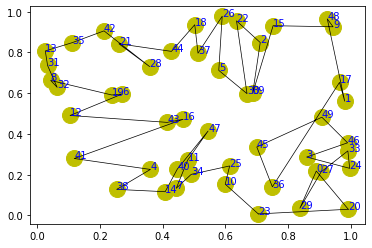

step:960/5000, actic loss:2.815, critic loss:9.821, L:14.714, 0min1sec
step:961/5000, actic loss:2.803, critic loss:9.811, L:14.707, 0min1sec
step:962/5000, actic loss:2.795, critic loss:9.801, L:14.700, 0min1sec
step:963/5000, actic loss:2.799, critic loss:9.792, L:14.694, 0min1sec
step:964/5000, actic loss:2.806, critic loss:9.782, L:14.687, 0min1sec
distance:7.966
tensor([29,  4, 38, 10, 32, 13, 42, 40, 11,  2, 26, 24,  1,  0, 33,  6, 22, 21,
        25, 31, 23, 16, 18, 34,  7, 48, 17, 46, 35, 30, 27,  3, 47, 39, 37,  5,
        41, 36, 14, 44, 49,  8,  9, 19, 45, 28, 15, 43, 12, 20])


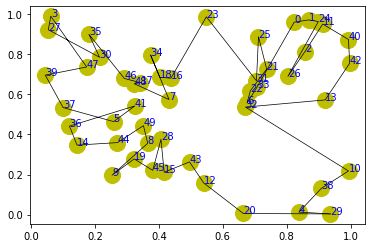

step:965/5000, actic loss:2.809, critic loss:9.773, L:14.680, 0min1sec
step:966/5000, actic loss:2.806, critic loss:9.763, L:14.673, 0min1sec
step:967/5000, actic loss:2.794, critic loss:9.754, L:14.667, 0min1sec
step:968/5000, actic loss:2.777, critic loss:9.744, L:14.660, 0min1sec
step:969/5000, actic loss:2.761, critic loss:9.735, L:14.654, 0min1sec
distance:8.422
tensor([ 0, 25, 45, 35, 12, 46, 18, 28, 11, 39, 26,  4, 40, 44, 48, 16, 14, 22,
        33,  2, 34, 15,  3, 37,  8, 13,  1, 41, 30, 19, 38,  7, 20, 23, 27, 47,
        32, 43, 21, 36, 42, 31, 29,  6, 10,  9,  5, 17, 24, 49])


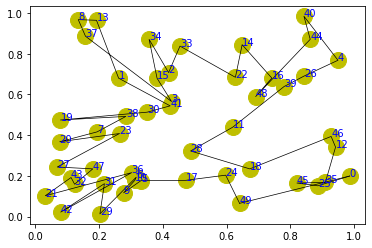

step:970/5000, actic loss:2.757, critic loss:9.725, L:14.647, 0min1sec
step:971/5000, actic loss:2.761, critic loss:9.716, L:14.640, 0min1sec
step:972/5000, actic loss:2.769, critic loss:9.707, L:14.633, 0min1sec
step:973/5000, actic loss:2.777, critic loss:9.697, L:14.626, 0min1sec
step:974/5000, actic loss:2.781, critic loss:9.688, L:14.619, 0min1sec
distance:8.137
tensor([17, 10,  8, 46, 26, 29, 36,  3, 23, 16, 33, 30,  4, 13, 41, 31, 37, 19,
        24,  0, 42, 25, 35, 40, 47,  2, 45, 39,  7,  6, 22, 48,  1, 14, 44, 18,
         5, 32,  9, 43, 49, 15, 11, 38, 27, 28, 12, 21, 34, 20])


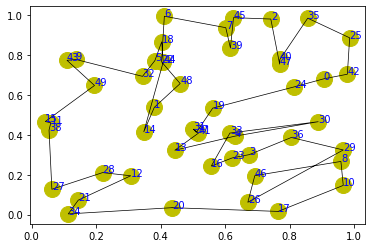

step:975/5000, actic loss:2.777, critic loss:9.678, L:14.612, 0min1sec
step:976/5000, actic loss:2.771, critic loss:9.669, L:14.605, 0min1sec
step:977/5000, actic loss:2.761, critic loss:9.660, L:14.599, 0min1sec
step:978/5000, actic loss:2.751, critic loss:9.650, L:14.592, 0min1sec
step:979/5000, actic loss:2.746, critic loss:9.641, L:14.586, 0min1sec
distance:7.786
tensor([22, 10,  4, 30, 17, 24, 43, 27, 34, 12, 18,  3, 14, 33, 29, 13, 45, 41,
        38, 47, 25,  7, 28, 19, 21, 32, 11,  0,  5, 42, 37, 40, 20,  1, 26, 16,
        48, 36, 44, 49, 46,  8, 31,  9, 15,  6, 23, 35, 39,  2])


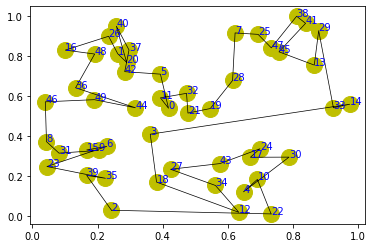

step:980/5000, actic loss:2.750, critic loss:9.632, L:14.579, 0min1sec
step:981/5000, actic loss:2.750, critic loss:9.623, L:14.573, 0min1sec
step:982/5000, actic loss:2.746, critic loss:9.613, L:14.566, 0min1sec
step:983/5000, actic loss:2.743, critic loss:9.604, L:14.560, 0min1sec
step:984/5000, actic loss:2.738, critic loss:9.595, L:14.553, 0min1sec
distance:6.884
tensor([40, 34, 45, 12, 13, 36,  1, 37, 33, 29, 30, 44, 18, 49,  5, 25, 42, 14,
        43, 38,  4, 39, 22,  8, 26,  2,  7, 31,  0, 17, 15, 24,  9, 46, 21, 35,
         3, 16, 20,  6, 19, 23, 32, 48, 11, 10, 28, 47, 41, 27])


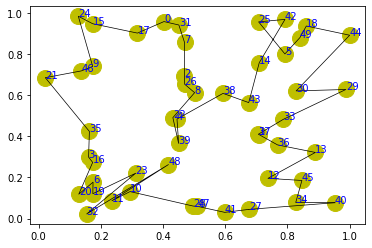

step:985/5000, actic loss:2.737, critic loss:9.586, L:14.547, 0min1sec
step:986/5000, actic loss:2.732, critic loss:9.576, L:14.540, 0min1sec
step:987/5000, actic loss:2.729, critic loss:9.567, L:14.533, 0min1sec
step:988/5000, actic loss:2.721, critic loss:9.558, L:14.527, 0min1sec
step:989/5000, actic loss:2.710, critic loss:9.549, L:14.520, 0min1sec
distance:8.713
tensor([36,  5,  6,  4, 34, 15, 14, 18,  0, 17, 40, 24, 42, 44, 47, 26, 13, 41,
        29,  1, 25, 35, 21, 31, 11, 38, 12, 32, 43, 27, 46, 37, 45, 10, 48,  3,
         9, 30, 22, 28, 19, 20,  8,  2, 16, 33, 39, 49, 23,  7])


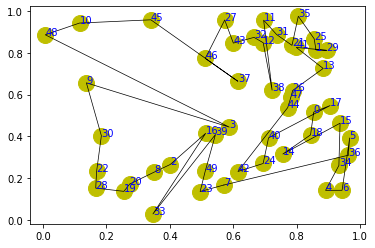

step:990/5000, actic loss:2.699, critic loss:9.540, L:14.514, 0min1sec
step:991/5000, actic loss:2.695, critic loss:9.531, L:14.508, 0min1sec
step:992/5000, actic loss:2.697, critic loss:9.523, L:14.502, 0min1sec
step:993/5000, actic loss:2.711, critic loss:9.515, L:14.495, 0min2sec
step:994/5000, actic loss:2.727, critic loss:9.506, L:14.489, 0min1sec
distance:7.192
tensor([37, 27,  5,  6, 23, 31, 22, 33,  7, 15,  3, 43,  0, 47, 46, 26, 29, 11,
        25,  2, 40,  9, 45, 34, 16,  8, 17, 35, 14, 24, 32, 39, 10, 30, 21, 42,
        36, 20, 48, 41, 12,  4,  1, 49, 38, 28, 13, 44, 19, 18])


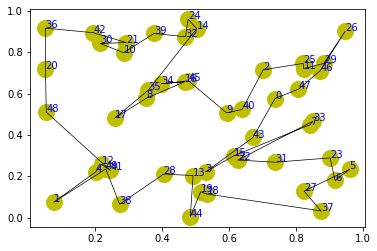

step:995/5000, actic loss:2.740, critic loss:9.498, L:14.483, 0min1sec
step:996/5000, actic loss:2.740, critic loss:9.489, L:14.477, 0min1sec
step:997/5000, actic loss:2.731, critic loss:9.480, L:14.471, 0min1sec
step:998/5000, actic loss:2.714, critic loss:9.472, L:14.465, 0min1sec
step:999/5000, actic loss:2.700, critic loss:9.463, L:14.460, 0min1sec
distance:8.736
tensor([28,  9, 25,  6, 41, 26,  8,  3, 44,  4, 16,  2, 40, 45, 13, 35,  0, 43,
        47, 46, 12, 37, 21, 31, 39, 30, 18, 49, 17, 10, 27, 20, 34, 48,  7, 19,
        42, 15, 38, 14, 24, 36, 33, 22,  5, 23, 32, 11,  1, 29])


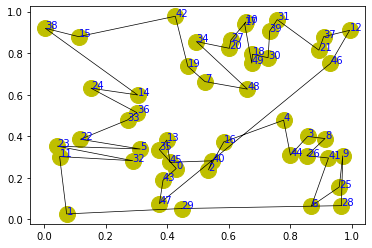

step:1000/5000, actic loss:2.691, critic loss:9.454, L:14.454, 0min1sec
step:1001/5000, actic loss:2.689, critic loss:9.446, L:14.448, 0min1sec
step:1002/5000, actic loss:2.681, critic loss:9.437, L:14.443, 0min1sec
step:1003/5000, actic loss:2.679, critic loss:9.429, L:14.437, 0min1sec
step:1004/5000, actic loss:2.676, critic loss:9.421, L:14.432, 0min1sec
distance:8.510
tensor([ 6, 23, 46, 20, 38,  5, 41, 26, 48, 15, 40,  9, 24, 16, 25,  3, 11, 12,
        17, 42, 45, 30, 35, 34, 43, 19, 28, 18, 36,  4, 33, 47, 49, 21, 14,  1,
        10, 39, 31, 44,  2, 29,  8,  0, 32, 37, 22, 13, 27,  7])


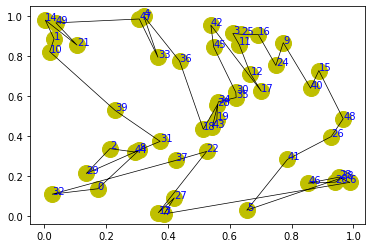

step:1005/5000, actic loss:2.681, critic loss:9.412, L:14.426, 0min1sec
step:1006/5000, actic loss:2.679, critic loss:9.404, L:14.421, 0min1sec
step:1007/5000, actic loss:2.675, critic loss:9.395, L:14.415, 0min1sec
step:1008/5000, actic loss:2.668, critic loss:9.386, L:14.408, 0min1sec
step:1009/5000, actic loss:2.660, critic loss:9.377, L:14.402, 0min1sec
distance:7.037
tensor([38, 14,  0, 10, 19, 23, 13, 39, 33, 46, 44, 29, 24,  7, 48, 20,  9, 18,
        15,  4, 26, 40, 27, 37, 28, 25, 31, 36, 35, 43, 17,  2,  1, 45, 12,  8,
         6, 42, 47, 34,  5, 11, 41, 16,  3, 22, 32, 30, 49, 21])


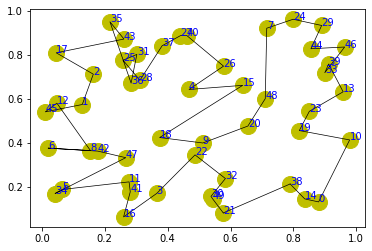

step:1010/5000, actic loss:2.646, critic loss:9.369, L:14.396, 0min1sec
step:1011/5000, actic loss:2.635, critic loss:9.360, L:14.389, 0min1sec
step:1012/5000, actic loss:2.625, critic loss:9.351, L:14.383, 0min1sec
step:1013/5000, actic loss:2.625, critic loss:9.342, L:14.377, 0min1sec
step:1014/5000, actic loss:2.629, critic loss:9.334, L:14.371, 0min1sec
distance:8.440
tensor([ 5, 16, 49, 45, 47, 23, 43, 34, 46, 17,  6, 21, 32, 36, 38,  0, 28, 44,
        15, 19,  8, 12, 22, 30, 37, 11, 25, 33, 14, 13, 20, 31, 48, 27,  4, 35,
        29, 10,  2, 24,  7,  1, 18, 40, 42,  9, 41, 26, 39,  3])


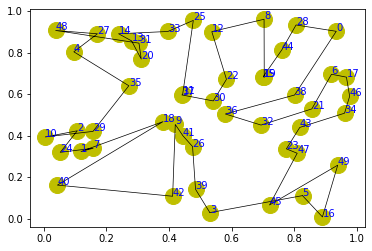

step:1015/5000, actic loss:2.629, critic loss:9.325, L:14.365, 0min2sec
step:1016/5000, actic loss:2.624, critic loss:9.316, L:14.359, 0min1sec
step:1017/5000, actic loss:2.616, critic loss:9.308, L:14.353, 0min1sec
step:1018/5000, actic loss:2.612, critic loss:9.299, L:14.347, 0min1sec
step:1019/5000, actic loss:2.613, critic loss:9.291, L:14.341, 0min1sec
distance:7.803
tensor([27, 38, 19, 39, 22, 31,  0,  7,  2, 26, 40, 32, 17, 24, 23, 45, 42, 21,
         4, 47, 18, 49, 33,  5, 48, 37, 35,  1,  3, 46, 10, 29,  8, 15, 28, 13,
        11, 43, 44, 12, 36, 25,  9, 14, 20,  6, 41, 34, 30, 16])


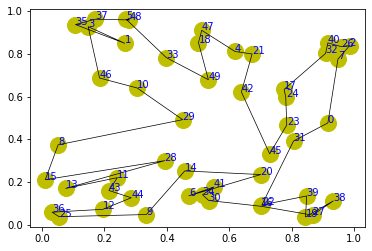

step:1020/5000, actic loss:2.616, critic loss:9.282, L:14.335, 0min1sec
step:1021/5000, actic loss:2.615, critic loss:9.274, L:14.330, 0min1sec
step:1022/5000, actic loss:2.612, critic loss:9.265, L:14.324, 0min1sec
step:1023/5000, actic loss:2.610, critic loss:9.256, L:14.318, 0min1sec
step:1024/5000, actic loss:2.602, critic loss:9.248, L:14.313, 0min1sec
distance:10.210
tensor([ 1, 27, 26, 34,  4, 43,  2,  7, 44, 11, 31, 35, 10, 17, 45, 40, 25, 32,
         3, 20, 38, 14, 48, 22, 28,  6, 15, 18, 46, 47, 41, 49,  0,  5, 42, 12,
        23, 37, 21, 13, 16, 30, 29, 36, 39, 19,  9,  8, 33, 24])


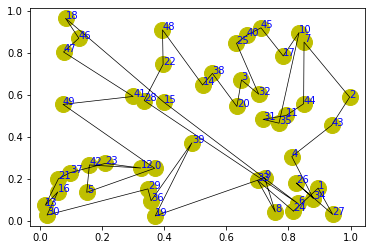

step:1025/5000, actic loss:2.594, critic loss:9.240, L:14.307, 0min1sec
step:1026/5000, actic loss:2.587, critic loss:9.232, L:14.302, 0min1sec
step:1027/5000, actic loss:2.584, critic loss:9.223, L:14.297, 0min1sec
step:1028/5000, actic loss:2.589, critic loss:9.215, L:14.291, 0min1sec
step:1029/5000, actic loss:2.597, critic loss:9.208, L:14.286, 0min1sec
distance:8.010
tensor([21, 27, 13, 35, 20, 25, 39, 43, 38, 23, 31, 29,  3,  1, 46, 47, 30, 37,
        32, 11, 40, 48, 14, 34, 10, 49,  9, 15, 28, 24, 22, 36,  0, 42, 26,  4,
         6, 45, 33, 16, 44, 18,  2, 19,  7,  8, 41, 17, 12,  5])


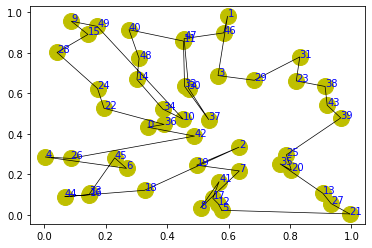

step:1030/5000, actic loss:2.609, critic loss:9.201, L:14.280, 0min2sec
step:1031/5000, actic loss:2.620, critic loss:9.194, L:14.274, 0min2sec
step:1032/5000, actic loss:2.628, critic loss:9.186, L:14.268, 0min1sec
step:1033/5000, actic loss:2.631, critic loss:9.178, L:14.262, 0min1sec
step:1034/5000, actic loss:2.626, critic loss:9.170, L:14.256, 0min1sec
distance:8.962
tensor([48, 35,  8, 24, 30,  4, 21, 29, 27, 39, 20, 40, 47,  0, 49, 42, 17, 41,
        46, 37, 22, 19, 11,  1, 45,  7, 34, 23, 38, 43, 44, 28,  3, 15, 14,  2,
         5, 10,  9, 26, 36, 18, 12, 25, 13, 31, 32, 16, 33,  6])


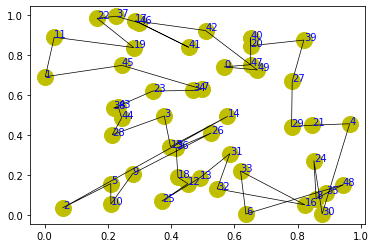

step:1035/5000, actic loss:2.612, critic loss:9.162, L:14.251, 0min1sec
step:1036/5000, actic loss:2.585, critic loss:9.156, L:14.246, 0min1sec
step:1037/5000, actic loss:2.557, critic loss:9.150, L:14.241, 0min1sec
step:1038/5000, actic loss:2.527, critic loss:9.145, L:14.237, 0min1sec
step:1039/5000, actic loss:2.507, critic loss:9.138, L:14.232, 0min1sec
distance:8.050
tensor([27, 46, 15, 37, 11, 34,  2, 33,  7, 28, 19, 23, 26,  5, 42, 20, 38, 44,
        29, 18,  6, 49, 31, 32, 14, 36,  8,  9,  3, 41,  0, 48, 16, 22, 40,  1,
        10, 30, 13, 47, 35, 12, 39, 25, 24, 45, 17, 21, 43,  4])


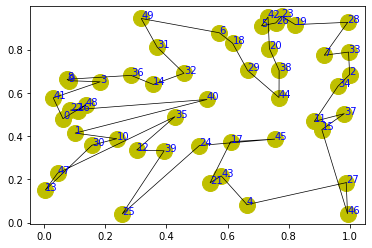

step:1040/5000, actic loss:2.502, critic loss:9.130, L:14.227, 0min2sec
step:1041/5000, actic loss:2.517, critic loss:9.123, L:14.221, 0min1sec
step:1042/5000, actic loss:2.537, critic loss:9.117, L:14.216, 0min1sec
step:1043/5000, actic loss:2.560, critic loss:9.112, L:14.210, 0min2sec
step:1044/5000, actic loss:2.580, critic loss:9.106, L:14.205, 0min1sec
distance:7.351
tensor([31,  9, 35, 12, 19, 16, 20, 27, 34,  8, 41,  2, 23, 13, 15, 21, 17, 25,
        43,  4, 47,  5, 18,  6, 48, 49,  1, 14, 45, 22, 37,  7, 10, 46, 28, 26,
        42, 33, 40, 32, 11, 29, 39, 24,  0, 44, 38,  3, 30, 36])


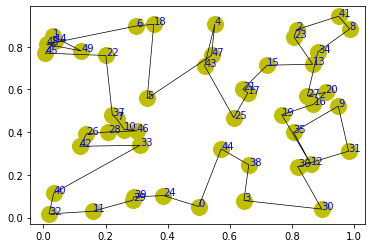

step:1045/5000, actic loss:2.598, critic loss:9.099, L:14.199, 0min2sec
step:1046/5000, actic loss:2.607, critic loss:9.092, L:14.194, 0min1sec
step:1047/5000, actic loss:2.603, critic loss:9.084, L:14.190, 0min1sec
step:1048/5000, actic loss:2.595, critic loss:9.076, L:14.185, 0min1sec
step:1049/5000, actic loss:2.584, critic loss:9.069, L:14.180, 0min1sec
distance:9.041
tensor([47, 37, 29, 30,  0, 28, 33, 19, 43, 41, 39, 38, 31, 17,  1,  9, 46, 18,
        32,  7,  8, 35, 44, 34, 10, 14, 36, 42, 13, 45,  6,  2, 27,  3, 21, 15,
        11, 16, 23, 48, 25,  5, 49, 24, 12,  4, 20, 26, 40, 22])


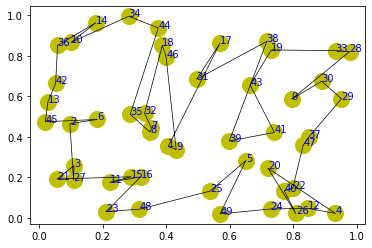

step:1050/5000, actic loss:2.580, critic loss:9.061, L:14.175, 0min2sec
step:1051/5000, actic loss:2.577, critic loss:9.053, L:14.171, 0min1sec
step:1052/5000, actic loss:2.586, critic loss:9.046, L:14.165, 0min1sec
step:1053/5000, actic loss:2.597, critic loss:9.039, L:14.160, 0min1sec
step:1054/5000, actic loss:2.604, critic loss:9.031, L:14.154, 0min1sec
distance:7.185
tensor([34, 30, 40,  5, 45, 24,  4, 36, 29,  0, 19, 25, 16, 48,  2, 26, 17, 49,
        18, 13, 41, 11, 38, 33, 21, 28, 43, 39,  6, 20, 27, 12,  9,  7, 46, 32,
         1, 47, 22, 44, 10, 42, 15, 37, 31,  3, 14, 35,  8, 23])


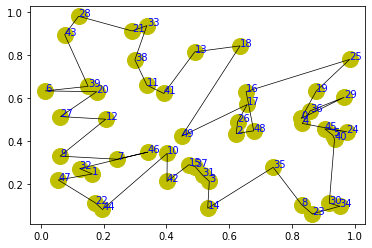

step:1055/5000, actic loss:2.607, critic loss:9.023, L:14.149, 0min1sec
step:1056/5000, actic loss:2.604, critic loss:9.015, L:14.143, 0min1sec
step:1057/5000, actic loss:2.597, critic loss:9.007, L:14.137, 0min1sec
step:1058/5000, actic loss:2.589, critic loss:8.999, L:14.132, 0min2sec
step:1059/5000, actic loss:2.579, critic loss:8.991, L:14.126, 0min2sec
distance:7.329
tensor([38, 29,  5, 17, 10, 12, 25, 21,  6, 13, 37, 31, 36, 27,  4, 16,  9, 14,
         8, 26, 49, 40, 44, 39,  7,  0, 24, 11, 42, 34, 23, 19, 46,  2, 22, 33,
        35, 43, 41, 47, 15,  3, 28, 32,  1, 20, 48, 18, 45, 30])


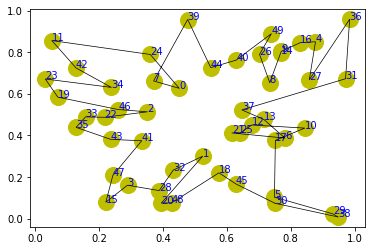

step:1060/5000, actic loss:2.573, critic loss:8.983, L:14.121, 0min2sec
step:1061/5000, actic loss:2.574, critic loss:8.975, L:14.115, 0min1sec
step:1062/5000, actic loss:2.574, critic loss:8.967, L:14.110, 0min1sec
step:1063/5000, actic loss:2.576, critic loss:8.959, L:14.104, 0min1sec
step:1064/5000, actic loss:2.579, critic loss:8.951, L:14.098, 0min1sec
distance:7.867
tensor([11,  2, 37,  4, 21, 14, 34, 40,  1, 48, 43, 36, 12, 19, 35, 49, 15, 10,
         6, 42, 13, 17,  0, 38, 26, 32, 28,  3, 27, 22, 23, 30, 18,  8,  7, 44,
        33, 29, 46, 47, 31, 41,  5, 25, 20, 45,  9, 24, 16, 39])


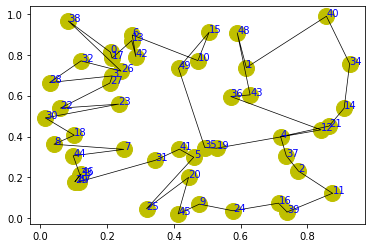

step:1065/5000, actic loss:2.574, critic loss:8.943, L:14.093, 0min1sec
step:1066/5000, actic loss:2.571, critic loss:8.935, L:14.087, 0min1sec
step:1067/5000, actic loss:2.565, critic loss:8.927, L:14.082, 0min1sec
step:1068/5000, actic loss:2.564, critic loss:8.919, L:14.076, 0min1sec
step:1069/5000, actic loss:2.557, critic loss:8.911, L:14.070, 0min1sec
distance:7.618
tensor([ 7, 33, 35, 44,  3, 11, 47, 37, 10, 24, 17, 31, 29, 14, 23, 13,  5,  9,
        12,  4, 49, 30, 40, 34, 48, 28, 41, 22, 25, 19, 21, 18, 26, 43, 32,  1,
        46,  8, 42, 20, 15, 36,  6,  0,  2, 39, 27, 45, 38, 16])


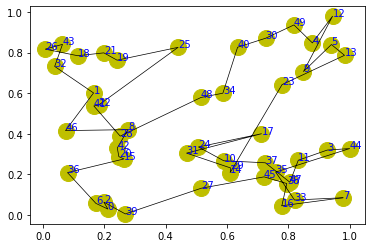

step:1070/5000, actic loss:2.553, critic loss:8.904, L:14.065, 0min1sec
step:1071/5000, actic loss:2.555, critic loss:8.896, L:14.059, 0min1sec
step:1072/5000, actic loss:2.557, critic loss:8.888, L:14.053, 0min1sec
step:1073/5000, actic loss:2.557, critic loss:8.880, L:14.048, 0min1sec
step:1074/5000, actic loss:2.554, critic loss:8.872, L:14.042, 0min1sec
distance:7.910
tensor([47,  0, 40, 16, 34,  5,  1,  6, 45, 35, 26, 41, 32, 15, 12, 14, 36,  8,
        33, 44, 30,  4, 11, 49, 22, 25, 17, 31, 38, 10, 19, 37, 48,  7, 23, 18,
        29, 46,  2, 27,  9, 20, 21, 43, 28, 13, 24,  3, 39, 42])


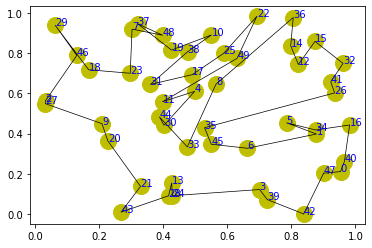

step:1075/5000, actic loss:2.544, critic loss:8.864, L:14.037, 0min1sec
step:1076/5000, actic loss:2.536, critic loss:8.857, L:14.031, 0min1sec
step:1077/5000, actic loss:2.527, critic loss:8.849, L:14.025, 0min1sec
step:1078/5000, actic loss:2.522, critic loss:8.841, L:14.019, 0min1sec
step:1079/5000, actic loss:2.523, critic loss:8.833, L:14.014, 0min1sec
distance:8.015
tensor([16, 34, 23, 44, 43, 20, 24, 35, 27, 21, 31, 30, 38, 17, 39, 36, 13, 37,
        18,  6, 15, 32, 14,  5, 49, 11, 22,  0, 42, 41, 47, 48, 26,  3,  8,  9,
         4, 46,  7, 29, 33, 25, 19, 12, 40,  2,  1, 28, 45, 10])


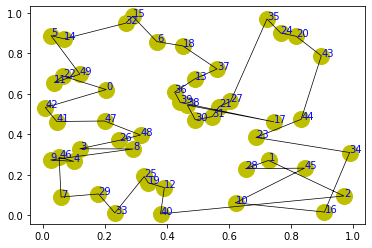

step:1080/5000, actic loss:2.525, critic loss:8.826, L:14.008, 0min1sec
step:1081/5000, actic loss:2.529, critic loss:8.818, L:14.002, 0min1sec
step:1082/5000, actic loss:2.528, critic loss:8.810, L:13.996, 0min1sec
step:1083/5000, actic loss:2.522, critic loss:8.802, L:13.990, 0min1sec
step:1084/5000, actic loss:2.509, critic loss:8.795, L:13.985, 0min1sec
distance:7.655
tensor([47, 38, 11, 43, 24, 36, 19, 12,  1,  5, 17,  8,  6, 20, 49, 46, 35,  0,
        10, 21, 14, 42, 26, 39, 18, 34, 27, 44, 32, 29, 30, 16,  4, 41,  9, 28,
        31, 23, 25, 40, 15, 22, 45, 13,  2,  7, 37,  3, 33, 48])


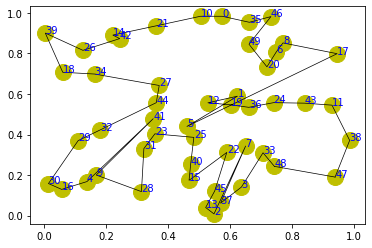

step:1085/5000, actic loss:2.496, critic loss:8.788, L:13.979, 0min2sec
step:1086/5000, actic loss:2.479, critic loss:8.780, L:13.974, 0min2sec
step:1087/5000, actic loss:2.465, critic loss:8.773, L:13.969, 0min1sec
step:1088/5000, actic loss:2.454, critic loss:8.766, L:13.964, 0min1sec
step:1089/5000, actic loss:2.453, critic loss:8.758, L:13.959, 0min1sec
distance:7.796
tensor([48, 20, 24, 11, 35, 49, 18, 36, 38, 29, 28, 32, 40, 39,  2,  6,  7,  3,
        43, 12, 37, 34, 26, 30, 47, 13,  9, 45, 25, 17, 21, 31, 16, 15,  5, 22,
         0, 27, 42, 33,  1, 23,  4, 19, 14, 10,  8, 41, 44, 46])


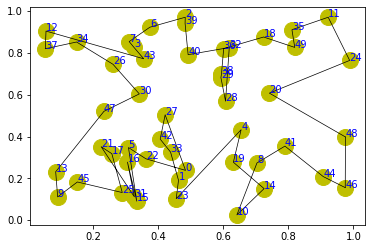

step:1090/5000, actic loss:2.455, critic loss:8.751, L:13.954, 0min1sec
step:1091/5000, actic loss:2.462, critic loss:8.744, L:13.950, 0min1sec
step:1092/5000, actic loss:2.471, critic loss:8.737, L:13.945, 0min1sec
step:1093/5000, actic loss:2.477, critic loss:8.730, L:13.940, 0min1sec
step:1094/5000, actic loss:2.481, critic loss:8.723, L:13.935, 0min1sec
distance:7.758
tensor([42, 12, 28, 49, 17, 47, 27,  3, 14, 19, 30, 21,  6, 38, 22, 46, 26, 18,
        33, 45, 41, 23, 11, 36,  7,  5, 24, 35, 20, 37, 25, 44, 16, 43,  2,  4,
        31, 15,  1, 39, 13, 10, 48,  0,  8, 32, 34, 40, 29,  9])


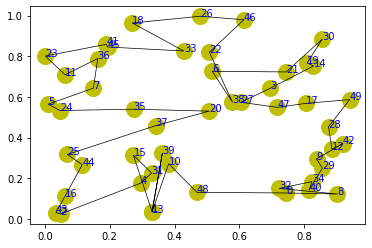

step:1095/5000, actic loss:2.481, critic loss:8.715, L:13.930, 0min1sec
step:1096/5000, actic loss:2.476, critic loss:8.708, L:13.925, 0min1sec
step:1097/5000, actic loss:2.465, critic loss:8.700, L:13.919, 0min1sec
step:1098/5000, actic loss:2.452, critic loss:8.693, L:13.914, 0min1sec
step:1099/5000, actic loss:2.431, critic loss:8.687, L:13.909, 0min1sec
distance:8.572
tensor([27, 13, 42, 11, 48, 22, 40, 33, 34, 14, 44, 30,  6,  0, 21, 10, 25, 36,
        29, 38, 12, 26,  7,  3, 20, 37, 49, 45,  8, 46, 41, 35, 31, 32, 24, 16,
         2, 43, 15, 47,  5,  4, 28, 18, 17,  9, 39,  1, 19, 23])


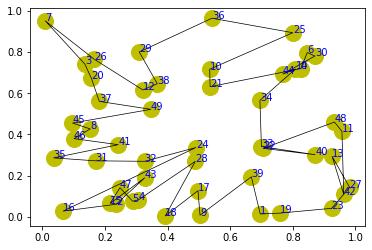

step:1100/5000, actic loss:2.403, critic loss:8.682, L:13.905, 0min2sec
step:1101/5000, actic loss:2.367, critic loss:8.678, L:13.901, 0min2sec
step:1102/5000, actic loss:2.331, critic loss:8.674, L:13.897, 0min1sec
step:1103/5000, actic loss:2.295, critic loss:8.669, L:13.894, 0min1sec
step:1104/5000, actic loss:2.272, critic loss:8.663, L:13.891, 0min1sec
distance:10.173
tensor([11, 39, 26, 24,  5, 36, 18, 46,  1, 42, 12, 31, 29, 34, 16, 19, 20,  9,
        38, 17, 28, 23, 32, 44,  2,  6,  7,  8, 25,  4, 14, 37, 10, 49, 48, 30,
        40,  0, 27, 13, 43, 47, 45,  3, 35, 21, 41, 33, 15, 22])


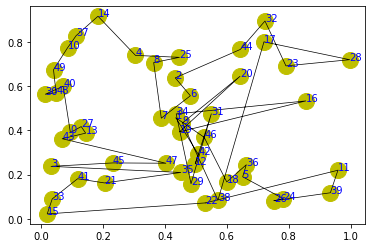

step:1105/5000, actic loss:2.274, critic loss:8.657, L:13.888, 0min1sec
step:1106/5000, actic loss:2.296, critic loss:8.651, L:13.884, 0min1sec
step:1107/5000, actic loss:2.337, critic loss:8.649, L:13.880, 0min1sec
step:1108/5000, actic loss:2.380, critic loss:8.648, L:13.876, 0min1sec
step:1109/5000, actic loss:2.418, critic loss:8.646, L:13.871, 0min1sec
distance:8.082
tensor([12,  1, 48, 31, 22, 15,  6, 38, 20,  3, 30, 43, 34, 40, 47, 35, 33, 24,
        37,  7, 11, 16, 27, 46, 23, 32,  4,  8, 41, 14, 44, 10, 36,  9,  5, 26,
        13, 45,  0, 18, 21, 19, 28, 39, 25,  2, 29, 42, 17, 49])


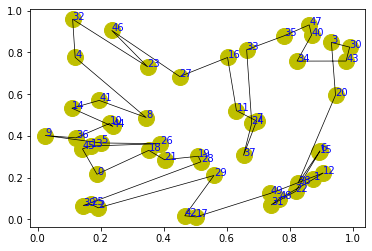

step:1110/5000, actic loss:2.452, critic loss:8.645, L:13.867, 0min1sec
step:1111/5000, actic loss:2.482, critic loss:8.642, L:13.862, 0min1sec
step:1112/5000, actic loss:2.507, critic loss:8.638, L:13.858, 0min1sec
step:1113/5000, actic loss:2.525, critic loss:8.632, L:13.853, 0min1sec
step:1114/5000, actic loss:2.532, critic loss:8.625, L:13.848, 0min1sec
distance:7.650
tensor([ 8, 36, 40, 14,  0, 12, 45,  9, 21, 37, 23,  6, 11,  7, 47, 33, 28, 17,
        15, 18, 27, 30, 39,  3,  2, 38, 35, 34,  5, 20, 43, 44,  4, 13, 10, 24,
        25, 16, 32,  1, 49, 46, 42, 29, 26, 48, 31, 19, 22, 41])


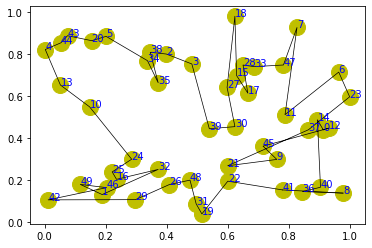

step:1115/5000, actic loss:2.526, critic loss:8.618, L:13.843, 0min1sec
step:1116/5000, actic loss:2.513, critic loss:8.611, L:13.838, 0min1sec
step:1117/5000, actic loss:2.496, critic loss:8.604, L:13.834, 0min1sec
step:1118/5000, actic loss:2.479, critic loss:8.598, L:13.829, 0min1sec
step:1119/5000, actic loss:2.464, critic loss:8.591, L:13.824, 0min1sec
distance:7.493
tensor([41, 16, 39,  7,  6, 48, 11, 43,  5, 47, 37, 10, 18, 13, 30,  2, 32, 29,
        14, 20, 40, 42, 22, 17, 15, 19, 25, 33, 45, 38,  3, 27, 21, 28, 24, 26,
        23, 35,  4, 31,  8, 49,  9, 44, 46, 12,  1,  0, 34, 36])


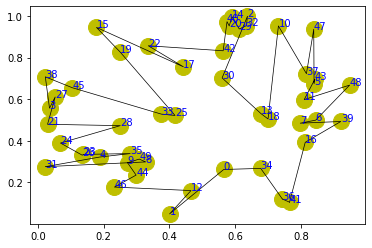

step:1120/5000, actic loss:2.452, critic loss:8.585, L:13.819, 0min1sec
step:1121/5000, actic loss:2.445, critic loss:8.577, L:13.814, 0min1sec
step:1122/5000, actic loss:2.444, critic loss:8.570, L:13.809, 0min1sec
step:1123/5000, actic loss:2.447, critic loss:8.563, L:13.805, 0min1sec
step:1124/5000, actic loss:2.450, critic loss:8.556, L:13.800, 0min1sec
distance:8.864
tensor([37, 41,  0, 24,  9, 14, 30, 22, 38, 31, 12, 39, 10, 17, 23,  2, 21, 27,
        36,  5,  1, 44, 45, 11, 34, 18, 32, 26,  8, 35, 47, 46, 33, 29, 40, 49,
        28, 25, 43,  4, 20, 13,  6, 19,  3,  7, 48, 15, 42, 16])


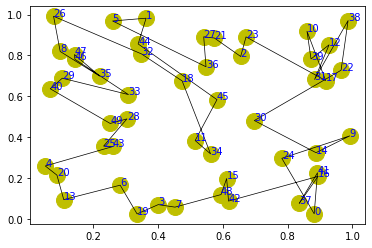

step:1125/5000, actic loss:2.455, critic loss:8.549, L:13.795, 0min1sec
step:1126/5000, actic loss:2.456, critic loss:8.542, L:13.790, 0min1sec
step:1127/5000, actic loss:2.454, critic loss:8.535, L:13.785, 0min1sec
step:1128/5000, actic loss:2.446, critic loss:8.528, L:13.780, 0min1sec
step:1129/5000, actic loss:2.434, critic loss:8.521, L:13.775, 0min2sec
distance:7.228
tensor([15, 28, 49, 24, 35, 26, 47,  7, 10,  1, 16, 34, 42, 20,  8, 29, 25, 38,
        31, 40, 33, 18, 39, 37, 21, 32, 46, 45,  6, 19, 48,  5, 27,  0, 41, 43,
        12, 14,  3,  9, 30, 13, 36, 17, 11,  2, 23,  4, 44, 22])


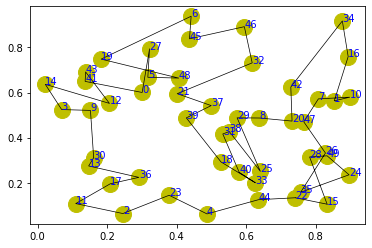

step:1130/5000, actic loss:2.421, critic loss:8.515, L:13.770, 0min1sec
step:1131/5000, actic loss:2.406, critic loss:8.508, L:13.765, 0min1sec
step:1132/5000, actic loss:2.399, critic loss:8.501, L:13.760, 0min1sec
step:1133/5000, actic loss:2.396, critic loss:8.494, L:13.755, 0min1sec
step:1134/5000, actic loss:2.397, critic loss:8.487, L:13.750, 0min1sec
distance:9.183
tensor([22, 13, 34, 33, 37, 40, 26, 32, 27,  5, 19, 41, 11, 18, 39,  4, 38, 25,
        43, 14, 35,  7,  3, 31,  1, 23, 21, 24, 49, 44, 47, 20,  8, 36, 30, 12,
        28, 16,  6,  0, 10, 48, 29,  9, 42, 17, 15,  2, 45, 46])


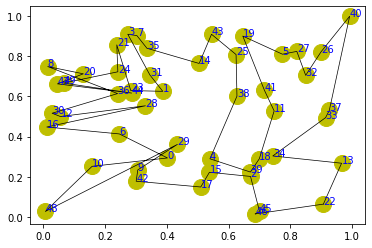

step:1135/5000, actic loss:2.399, critic loss:8.480, L:13.745, 0min1sec
step:1136/5000, actic loss:2.401, critic loss:8.473, L:13.740, 0min1sec
step:1137/5000, actic loss:2.397, critic loss:8.466, L:13.735, 0min1sec
step:1138/5000, actic loss:2.391, critic loss:8.459, L:13.730, 0min1sec
step:1139/5000, actic loss:2.389, critic loss:8.452, L:13.725, 0min1sec
distance:7.420
tensor([ 7, 17, 20, 14, 35, 41, 21, 45, 18, 44, 24, 15,  0, 42,  9, 48, 37, 30,
        40, 27, 39, 38, 12, 26, 32, 34, 16, 49, 33,  4, 13, 25, 28,  3,  6, 22,
        19, 43, 47, 36, 46, 31,  2, 23, 11, 29,  1,  5, 10,  8])


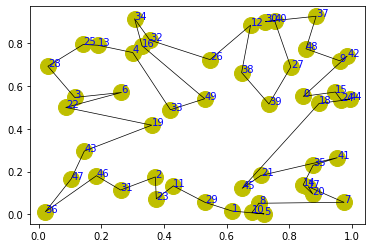

step:1140/5000, actic loss:2.388, critic loss:8.445, L:13.721, 0min1sec
step:1141/5000, actic loss:2.387, critic loss:8.438, L:13.716, 0min1sec
step:1142/5000, actic loss:2.381, critic loss:8.431, L:13.711, 0min1sec
step:1143/5000, actic loss:2.374, critic loss:8.424, L:13.705, 0min1sec
step:1144/5000, actic loss:2.368, critic loss:8.417, L:13.700, 0min1sec
distance:8.174
tensor([37,  4, 29, 10, 23,  1, 11, 40, 43, 38,  6, 24, 27, 34, 49, 35,  9, 33,
        31, 21, 32,  3, 47, 46,  0, 20, 44,  2, 19, 12, 13, 28, 42, 39, 26, 22,
        15, 25, 36, 14, 17, 48,  7, 16,  5, 41, 18, 45,  8, 30])


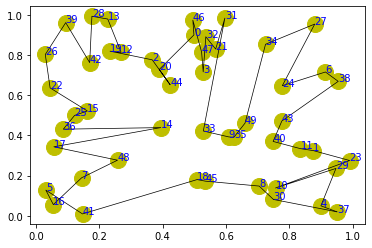

step:1145/5000, actic loss:2.363, critic loss:8.410, L:13.695, 0min1sec
step:1146/5000, actic loss:2.363, critic loss:8.403, L:13.690, 0min1sec
step:1147/5000, actic loss:2.365, critic loss:8.396, L:13.685, 0min1sec
step:1148/5000, actic loss:2.366, critic loss:8.389, L:13.680, 0min1sec
step:1149/5000, actic loss:2.368, critic loss:8.382, L:13.675, 0min1sec
distance:9.665
tensor([12, 36, 16, 46, 27, 37, 48, 30, 38, 18, 21, 10, 39, 44, 45, 23, 32, 47,
        34, 13, 31, 26,  3,  2, 43, 11, 33, 49, 15,  1,  8, 22,  9, 40, 20, 42,
         4, 28, 17, 25,  0, 29, 41,  6,  7, 14, 19, 24, 35,  5])


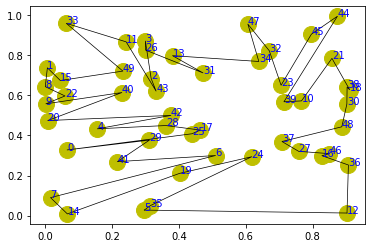

step:1150/5000, actic loss:2.366, critic loss:8.375, L:13.670, 0min2sec
step:1151/5000, actic loss:2.359, critic loss:8.369, L:13.665, 0min1sec
step:1152/5000, actic loss:2.349, critic loss:8.362, L:13.660, 0min1sec
step:1153/5000, actic loss:2.340, critic loss:8.355, L:13.655, 0min1sec
step:1154/5000, actic loss:2.330, critic loss:8.349, L:13.650, 0min1sec
distance:8.148
tensor([37, 47, 28, 12, 13, 41, 24, 43, 27, 30, 39, 22, 23, 45, 10,  9, 40,  1,
        26, 34, 29, 20, 36, 14, 49, 11, 15, 17, 25, 18, 48, 19, 44,  5, 42,  0,
         6, 16, 35,  7, 32,  2, 46, 33,  8,  3, 31, 21, 38,  4])


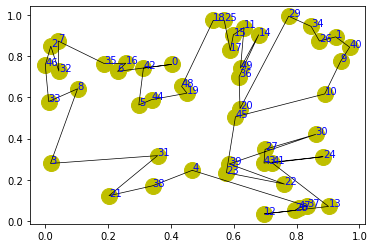

step:1155/5000, actic loss:2.323, critic loss:8.342, L:13.645, 0min1sec
step:1156/5000, actic loss:2.319, critic loss:8.335, L:13.640, 0min1sec
step:1157/5000, actic loss:2.324, critic loss:8.328, L:13.634, 0min1sec
step:1158/5000, actic loss:2.333, critic loss:8.322, L:13.629, 0min1sec
step:1159/5000, actic loss:2.341, critic loss:8.316, L:13.624, 0min1sec
distance:7.105
tensor([17, 48, 25, 23, 40,  0,  9, 28, 33, 46, 12, 38, 37, 19, 20, 22, 34, 43,
        18,  8, 39, 13, 42,  7,  5, 10, 44, 24, 26, 11, 41, 36, 29, 32, 35, 31,
        16, 49, 27, 15,  2, 30, 47, 21,  6, 45,  1,  3, 14,  4])


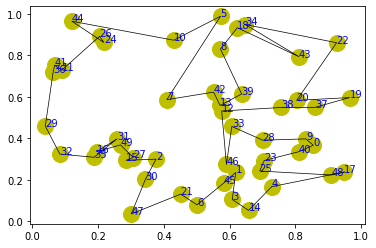

step:1160/5000, actic loss:2.351, critic loss:8.310, L:13.619, 0min1sec
step:1161/5000, actic loss:2.356, critic loss:8.304, L:13.614, 0min1sec
step:1162/5000, actic loss:2.353, critic loss:8.297, L:13.609, 0min1sec
step:1163/5000, actic loss:2.345, critic loss:8.290, L:13.605, 0min2sec
step:1164/5000, actic loss:2.338, critic loss:8.284, L:13.600, 0min1sec
distance:7.230
tensor([49, 25,  4, 19,  7, 43, 13, 12, 23,  9, 48, 20, 41,  5, 15, 31, 29, 42,
        26, 24,  0, 45,  1, 40, 34, 35, 27, 16,  6, 32, 37, 38, 11, 28, 33,  3,
        17, 14, 21, 39, 30,  2,  8, 22, 18, 44, 47, 10, 46, 36])


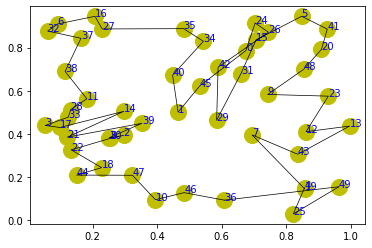

step:1165/5000, actic loss:2.335, critic loss:8.277, L:13.595, 0min2sec
step:1166/5000, actic loss:2.338, critic loss:8.271, L:13.591, 0min1sec
step:1167/5000, actic loss:2.344, critic loss:8.264, L:13.586, 0min1sec
step:1168/5000, actic loss:2.348, critic loss:8.258, L:13.581, 0min1sec
step:1169/5000, actic loss:2.352, critic loss:8.252, L:13.576, 0min1sec
distance:8.315
tensor([13, 17, 31,  2, 39, 10,  6, 33, 48, 35, 34, 47, 27, 18,  1, 25, 38, 19,
        44, 40, 29, 28, 21, 15, 20, 26, 14, 49, 46,  4, 37, 24, 12,  8, 30, 36,
         9, 42, 23,  5,  0, 16, 11, 41, 43, 22,  7, 45,  3, 32])


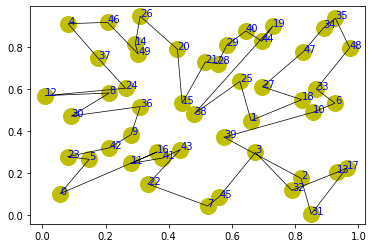

step:1170/5000, actic loss:2.350, critic loss:8.245, L:13.571, 0min1sec
step:1171/5000, actic loss:2.345, critic loss:8.238, L:13.566, 0min1sec
step:1172/5000, actic loss:2.336, critic loss:8.232, L:13.561, 0min1sec
step:1173/5000, actic loss:2.329, critic loss:8.226, L:13.556, 0min1sec
step:1174/5000, actic loss:2.324, critic loss:8.219, L:13.551, 0min1sec
distance:7.199
tensor([31, 19, 21, 49, 46, 14, 13,  4, 24, 16,  3,  6, 34, 22, 18,  7, 15, 38,
        41, 17,  2, 27, 45, 10, 25,  5, 26, 11, 12,  9, 37, 42, 33, 30, 43, 48,
        40, 39, 20,  1,  8, 36, 44, 29,  0, 47, 28, 35, 23, 32])


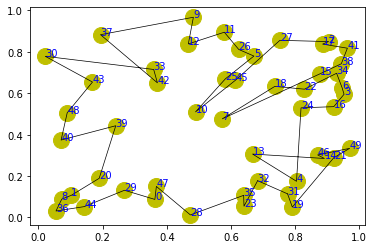

step:1175/5000, actic loss:2.319, critic loss:8.212, L:13.546, 0min2sec
step:1176/5000, actic loss:2.319, critic loss:8.206, L:13.541, 0min1sec
step:1177/5000, actic loss:2.320, critic loss:8.199, L:13.536, 0min1sec
step:1178/5000, actic loss:2.320, critic loss:8.193, L:13.532, 0min2sec
step:1179/5000, actic loss:2.318, critic loss:8.186, L:13.527, 0min2sec
distance:7.344
tensor([33, 12, 47, 26, 45, 30, 29, 46,  4, 15,  8, 10, 49, 23, 18, 34, 44, 16,
        35, 31, 22,  9, 19, 24,  0, 20, 27, 28,  6, 11,  1,  5, 37, 13, 39, 43,
        25, 48, 41,  2,  3, 32, 36, 14, 21,  7, 38, 40, 17, 42])


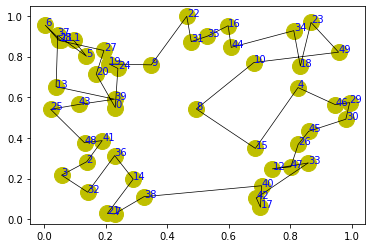

step:1180/5000, actic loss:2.315, critic loss:8.180, L:13.522, 0min2sec
step:1181/5000, actic loss:2.311, critic loss:8.173, L:13.518, 0min1sec
step:1182/5000, actic loss:2.305, critic loss:8.167, L:13.513, 0min1sec
step:1183/5000, actic loss:2.301, critic loss:8.160, L:13.509, 0min1sec
step:1184/5000, actic loss:2.303, critic loss:8.154, L:13.504, 0min1sec
distance:7.240
tensor([35, 43, 30,  4,  6,  0, 39, 41, 20, 44, 47, 26, 12, 24, 27, 37, 48, 13,
        29, 21, 42,  7, 14, 40, 46, 17, 18, 22, 36,  1, 10, 11, 19,  9, 49, 38,
        16, 32, 25, 28,  5, 45,  2, 34, 33, 23,  3, 31,  8, 15])


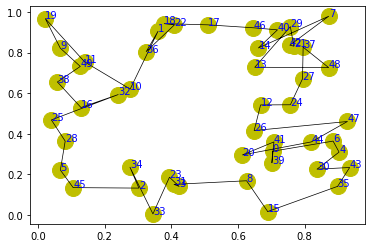

step:1185/5000, actic loss:2.307, critic loss:8.147, L:13.499, 0min2sec
step:1186/5000, actic loss:2.311, critic loss:8.141, L:13.495, 0min1sec
step:1187/5000, actic loss:2.313, critic loss:8.135, L:13.490, 0min1sec
step:1188/5000, actic loss:2.314, critic loss:8.128, L:13.485, 0min1sec
step:1189/5000, actic loss:2.310, critic loss:8.122, L:13.480, 0min1sec
distance:7.475
tensor([48, 21, 23, 45, 19, 39, 17, 37, 32, 25, 11, 28, 42, 43,  1, 22, 38, 49,
        31, 14, 29, 47,  2,  0, 36, 30, 44, 20,  6, 35,  3, 24, 12, 18, 34,  7,
         9,  4, 10, 16, 26,  5, 33, 41, 40, 15,  8, 13, 46, 27])


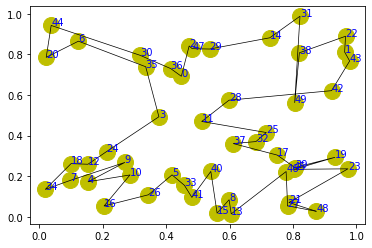

step:1190/5000, actic loss:2.303, critic loss:8.115, L:13.475, 0min1sec
step:1191/5000, actic loss:2.295, critic loss:8.109, L:13.471, 0min1sec
step:1192/5000, actic loss:2.287, critic loss:8.103, L:13.466, 0min2sec
step:1193/5000, actic loss:2.281, critic loss:8.097, L:13.461, 0min1sec
step:1194/5000, actic loss:2.280, critic loss:8.090, L:13.457, 0min1sec
distance:8.059
tensor([ 5, 16,  1, 42, 25, 14, 47, 34, 17, 28, 48, 37,  8,  9, 30,  2, 11, 22,
        46,  3, 31, 49, 12,  4, 21, 45, 38, 13,  7, 15, 40, 33, 19, 18, 20, 36,
        41, 44, 27, 23, 29, 43, 32, 35, 10, 24,  0, 39, 26,  6])


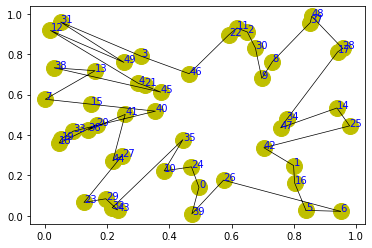

step:1195/5000, actic loss:2.281, critic loss:8.084, L:13.452, 0min1sec
step:1196/5000, actic loss:2.282, critic loss:8.078, L:13.447, 0min1sec
step:1197/5000, actic loss:2.282, critic loss:8.071, L:13.443, 0min1sec
step:1198/5000, actic loss:2.279, critic loss:8.065, L:13.438, 0min1sec
step:1199/5000, actic loss:2.273, critic loss:8.059, L:13.433, 0min1sec
distance:7.077
tensor([28, 36, 40, 34, 48, 15,  4, 30, 11, 18, 39,  6, 17, 31, 12, 13, 37, 19,
         1, 22, 32, 47, 43, 24, 44, 14, 27,  3, 33, 46, 49, 45, 26,  7, 23,  8,
        35, 16, 38, 25, 29, 20,  0, 42, 41, 21,  2,  5, 10,  9])


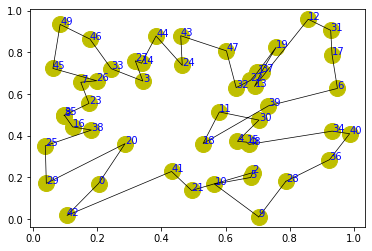

step:1200/5000, actic loss:2.266, critic loss:8.052, L:13.428, 0min1sec
step:1201/5000, actic loss:2.260, critic loss:8.046, L:13.423, 0min1sec
step:1202/5000, actic loss:2.255, critic loss:8.040, L:13.419, 0min1sec
step:1203/5000, actic loss:2.252, critic loss:8.033, L:13.414, 0min1sec
step:1204/5000, actic loss:2.253, critic loss:8.027, L:13.409, 0min1sec
distance:7.712
tensor([42, 20, 19, 12, 47, 28, 46, 27, 18, 38, 39, 41, 10,  8, 15, 36, 37,  3,
        43, 49, 21,  2,  4, 32, 48,  6, 26, 14, 31, 34,  1,  7, 30, 40, 25,  5,
        35, 13,  0, 29, 11, 44, 33, 24, 16,  9, 22, 17, 45, 23])


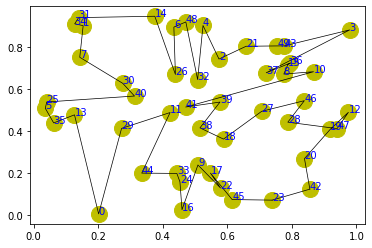

step:1205/5000, actic loss:2.255, critic loss:8.021, L:13.404, 0min2sec
step:1206/5000, actic loss:2.257, critic loss:8.015, L:13.400, 0min1sec
step:1207/5000, actic loss:2.256, critic loss:8.008, L:13.395, 0min2sec
step:1208/5000, actic loss:2.253, critic loss:8.002, L:13.391, 0min2sec
step:1209/5000, actic loss:2.248, critic loss:7.996, L:13.386, 0min2sec
distance:6.929
tensor([27, 20, 34, 24, 43, 33,  9, 32,  3,  8, 22, 40, 16, 42,  4, 25,  2, 14,
        47, 41, 28, 39,  1, 35,  7, 12,  5, 19, 18, 31,  6, 15, 49, 38, 17, 36,
        46, 23, 37, 13, 30,  0, 44, 10, 29, 21, 26, 45, 11, 48])


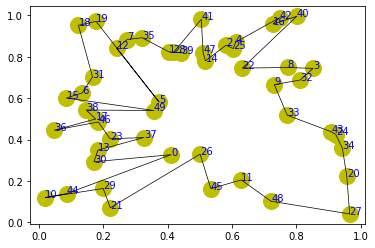

step:1210/5000, actic loss:2.244, critic loss:7.990, L:13.382, 0min2sec
step:1211/5000, actic loss:2.243, critic loss:7.983, L:13.377, 0min1sec
step:1212/5000, actic loss:2.242, critic loss:7.977, L:13.373, 0min1sec
step:1213/5000, actic loss:2.241, critic loss:7.971, L:13.368, 0min1sec
step:1214/5000, actic loss:2.238, critic loss:7.965, L:13.363, 0min1sec
distance:8.453
tensor([ 3, 39, 36, 14, 41,  9,  7, 23, 19, 35, 43,  5, 47, 37, 15,  0, 34, 33,
        10, 22, 21,  2, 25, 44, 28, 32, 31, 29, 27, 13, 38, 11,  1, 49, 42, 26,
        16, 20, 24, 45, 30,  4, 40, 46, 17,  8,  6, 12, 18, 48])


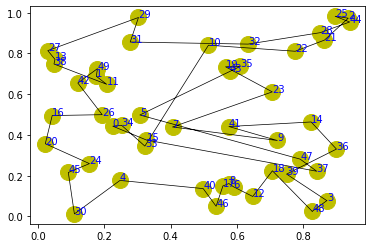

step:1215/5000, actic loss:2.234, critic loss:7.959, L:13.359, 0min2sec
step:1216/5000, actic loss:2.231, critic loss:7.953, L:13.354, 0min1sec
step:1217/5000, actic loss:2.230, critic loss:7.946, L:13.350, 0min1sec
step:1218/5000, actic loss:2.228, critic loss:7.940, L:13.345, 0min1sec
step:1219/5000, actic loss:2.225, critic loss:7.935, L:13.341, 0min1sec
distance:7.211
tensor([49, 44, 25,  0, 43, 46, 27,  6, 14, 21, 15,  9, 23, 17, 33, 48, 29, 38,
        30, 45, 36, 28,  4, 10, 42,  7,  3, 34,  2, 11, 35, 19, 16, 26, 41, 22,
         5, 31, 24, 39, 13,  1, 20, 37, 12, 32, 40, 47,  8, 18])


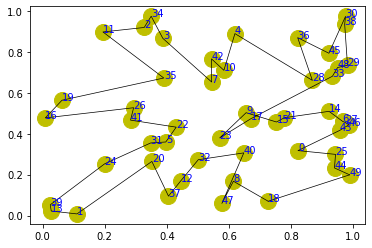

step:1220/5000, actic loss:2.222, critic loss:7.929, L:13.336, 0min1sec
step:1221/5000, actic loss:2.218, critic loss:7.923, L:13.332, 0min1sec
step:1222/5000, actic loss:2.216, critic loss:7.917, L:13.327, 0min1sec
step:1223/5000, actic loss:2.213, critic loss:7.910, L:13.323, 0min1sec
step:1224/5000, actic loss:2.212, critic loss:7.904, L:13.318, 0min1sec
distance:7.936
tensor([23,  6, 19,  3, 46, 29,  5, 20, 10,  0, 37, 21, 45, 30,  9, 47, 14, 48,
        13, 38, 39, 43, 41, 28,  2, 18, 17, 36, 44, 49,  1, 35, 22, 25, 34, 40,
         7, 42, 15, 11, 32, 16, 31,  4, 27, 26, 33,  8, 12, 24])


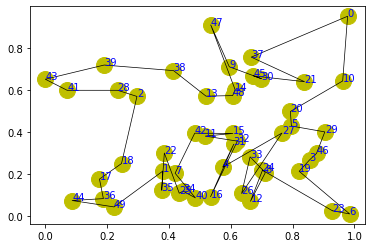

step:1225/5000, actic loss:2.211, critic loss:7.898, L:13.314, 0min2sec
step:1226/5000, actic loss:2.208, critic loss:7.892, L:13.309, 0min1sec
step:1227/5000, actic loss:2.203, critic loss:7.886, L:13.304, 0min1sec
step:1228/5000, actic loss:2.199, critic loss:7.880, L:13.300, 0min1sec
step:1229/5000, actic loss:2.196, critic loss:7.874, L:13.296, 0min1sec
distance:6.970
tensor([14, 46, 27, 34, 15, 28,  8, 23,  2,  4,  1,  9, 29, 33, 25, 18, 38,  5,
        45, 40, 36, 10, 30,  7, 19, 44, 16, 11, 12, 22, 17,  3, 13, 47, 24,  6,
        26, 39,  0, 42, 32, 31, 41, 37, 20, 21, 48, 43, 35, 49])


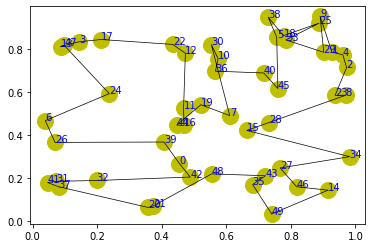

step:1230/5000, actic loss:2.195, critic loss:7.868, L:13.291, 0min2sec
step:1231/5000, actic loss:2.196, critic loss:7.862, L:13.287, 0min1sec
step:1232/5000, actic loss:2.198, critic loss:7.856, L:13.283, 0min1sec
step:1233/5000, actic loss:2.200, critic loss:7.850, L:13.278, 0min1sec
step:1234/5000, actic loss:2.200, critic loss:7.844, L:13.274, 0min1sec
distance:7.647
tensor([13,  2, 16,  5, 41, 24, 48, 30, 17, 47,  9, 38,  3, 37,  4, 29,  1, 43,
        32, 36, 11, 31, 34, 21, 18, 19, 39, 20, 44, 28,  0,  6, 45, 27, 12, 42,
        33, 26, 40, 15, 14,  7, 22, 49, 35, 46, 23,  8, 10, 25])


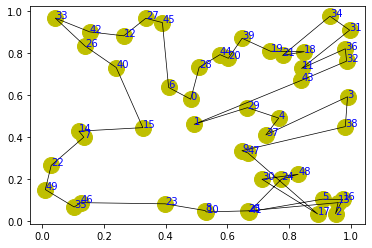

step:1235/5000, actic loss:2.198, critic loss:7.838, L:13.269, 0min2sec
step:1236/5000, actic loss:2.193, critic loss:7.832, L:13.265, 0min1sec
step:1237/5000, actic loss:2.189, critic loss:7.826, L:13.260, 0min1sec
step:1238/5000, actic loss:2.186, critic loss:7.820, L:13.256, 0min1sec
step:1239/5000, actic loss:2.183, critic loss:7.814, L:13.251, 0min1sec
distance:7.401
tensor([40, 36, 12, 42, 29, 13,  1, 49,  5, 25, 47, 11, 22,  0, 27, 34, 35,  4,
        16, 30, 46, 32, 43, 24, 31, 14,  2, 44, 18, 21,  3, 39,  6, 41, 45, 19,
        23,  7, 26, 17, 33, 10,  8, 38, 28, 20, 48,  9, 15, 37])


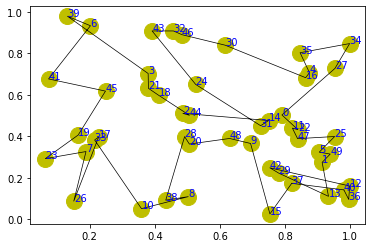

step:1240/5000, actic loss:2.183, critic loss:7.808, L:13.247, 0min2sec
step:1241/5000, actic loss:2.184, critic loss:7.802, L:13.243, 0min1sec
step:1242/5000, actic loss:2.184, critic loss:7.797, L:13.238, 0min1sec
step:1243/5000, actic loss:2.183, critic loss:7.791, L:13.234, 0min1sec
step:1244/5000, actic loss:2.180, critic loss:7.785, L:13.230, 0min1sec
distance:7.579
tensor([35, 30, 17,  4, 48, 18, 44, 13, 22,  3,  1, 40, 38, 41, 37, 24, 46, 34,
        47, 15, 21, 39, 31, 28, 12, 42, 14, 49,  0, 16, 26, 29,  6, 23, 43, 19,
        45,  9, 10, 32,  8, 25, 33, 11,  2,  7, 27, 36, 20,  5])


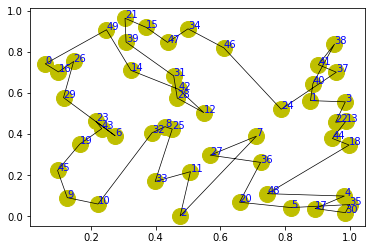

step:1245/5000, actic loss:2.177, critic loss:7.779, L:13.226, 0min2sec
step:1246/5000, actic loss:2.176, critic loss:7.773, L:13.221, 0min1sec
step:1247/5000, actic loss:2.175, critic loss:7.767, L:13.217, 0min1sec
step:1248/5000, actic loss:2.173, critic loss:7.761, L:13.212, 0min1sec
step:1249/5000, actic loss:2.167, critic loss:7.755, L:13.208, 0min1sec
distance:7.681
tensor([31, 41,  1, 46, 21, 22, 14,  0,  5, 39,  9, 44, 33, 48, 49, 27, 12, 24,
        29, 47, 38, 17, 43, 15, 40, 20, 16, 34, 25, 18, 26,  8, 37, 36, 30, 10,
        35, 32, 28, 45,  3, 13, 42,  4, 11,  6,  2, 23,  7, 19])


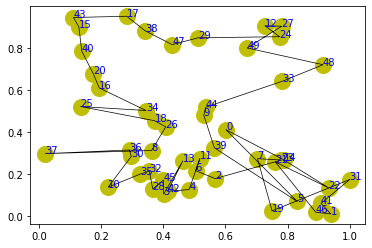

step:1250/5000, actic loss:2.160, critic loss:7.750, L:13.204, 0min2sec
step:1251/5000, actic loss:2.156, critic loss:7.744, L:13.200, 0min1sec
step:1252/5000, actic loss:2.155, critic loss:7.738, L:13.196, 0min1sec
step:1253/5000, actic loss:2.157, critic loss:7.733, L:13.192, 0min1sec
step:1254/5000, actic loss:2.161, critic loss:7.727, L:13.187, 0min1sec
distance:7.246
tensor([37, 17, 35,  1, 40, 38, 18,  4, 33, 30, 32, 47, 43, 44, 49,  6, 28, 11,
        24, 12, 48, 29,  9, 16, 10,  3, 34,  2, 19, 22,  0,  5, 39, 21,  8, 46,
        14,  7, 31, 27, 15, 23, 20, 36, 25, 45, 26, 13, 42, 41])


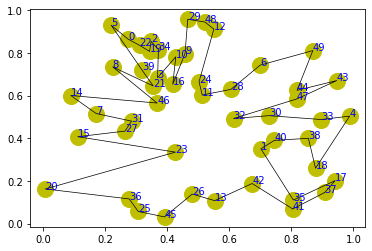

step:1255/5000, actic loss:2.165, critic loss:7.722, L:13.183, 0min1sec
step:1256/5000, actic loss:2.166, critic loss:7.716, L:13.179, 0min1sec
step:1257/5000, actic loss:2.164, critic loss:7.710, L:13.174, 0min1sec
step:1258/5000, actic loss:2.158, critic loss:7.704, L:13.170, 0min1sec
step:1259/5000, actic loss:2.147, critic loss:7.699, L:13.165, 0min1sec
distance:6.637
tensor([11,  9,  3, 49, 22, 31, 33, 34, 15, 25, 39, 17, 45, 40, 16, 12, 43, 20,
        30,  6, 48,  2,  5, 28, 21, 41, 46, 18,  4,  7, 47, 29,  1,  0, 10, 38,
        26, 42, 37, 19, 32, 23, 35, 24, 13,  8, 14, 27, 44, 36])


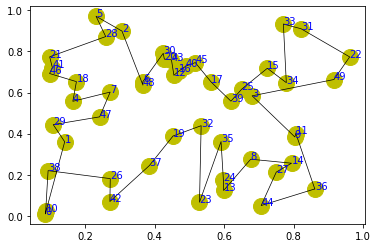

step:1260/5000, actic loss:2.135, critic loss:7.693, L:13.161, 0min1sec
step:1261/5000, actic loss:2.122, critic loss:7.688, L:13.156, 0min1sec
step:1262/5000, actic loss:2.110, critic loss:7.683, L:13.152, 0min1sec
step:1263/5000, actic loss:2.101, critic loss:7.677, L:13.148, 0min1sec
step:1264/5000, actic loss:2.096, critic loss:7.672, L:13.144, 0min1sec
distance:8.651
tensor([25, 16,  7, 17, 19,  1,  2, 43, 46, 38, 41, 40, 37, 15, 31, 24, 44, 22,
        23, 48, 18, 21, 42,  9, 14, 35,  8, 32, 20, 26, 34, 27,  4, 30,  0, 33,
        45, 49, 29,  5,  6,  3, 28, 47, 10, 39, 11, 12, 36, 13])


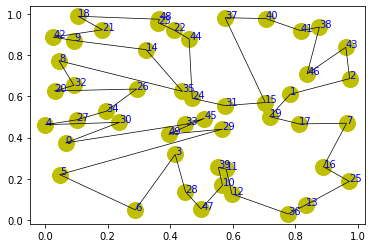

step:1265/5000, actic loss:2.096, critic loss:7.666, L:13.140, 0min1sec
step:1266/5000, actic loss:2.103, critic loss:7.660, L:13.136, 0min1sec
step:1267/5000, actic loss:2.110, critic loss:7.655, L:13.132, 0min1sec
step:1268/5000, actic loss:2.115, critic loss:7.650, L:13.128, 0min1sec
step:1269/5000, actic loss:2.119, critic loss:7.644, L:13.124, 0min1sec
distance:7.492
tensor([ 7, 10, 24, 13, 45, 11, 29, 28, 32,  6, 21, 23,  1, 19, 41, 31, 22, 12,
        37,  0, 43, 14, 26, 33, 40,  8, 15,  9, 48, 18, 47,  5, 46,  4, 39, 17,
        16,  3, 34, 30,  2, 36, 42, 49, 38, 27, 44, 35, 20, 25])


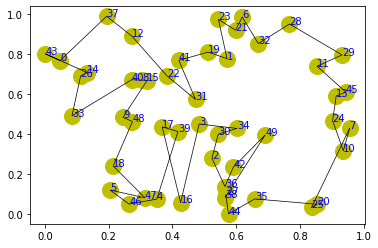

step:1270/5000, actic loss:2.118, critic loss:7.638, L:13.120, 0min1sec
step:1271/5000, actic loss:2.111, critic loss:7.633, L:13.116, 0min1sec
step:1272/5000, actic loss:2.103, critic loss:7.627, L:13.112, 0min1sec
step:1273/5000, actic loss:2.097, critic loss:7.622, L:13.107, 0min1sec
step:1274/5000, actic loss:2.093, critic loss:7.616, L:13.103, 0min1sec
distance:8.513
tensor([40, 33,  4, 11, 23, 41,  9, 24,  5, 18,  2, 43,  3, 35, 22, 29, 25, 31,
        16, 17, 49, 45, 36, 26, 10, 21,  7, 39, 20,  1, 15, 34, 19,  0, 32, 47,
        14,  8,  6, 28, 42, 37, 12, 30, 27, 44, 13, 46, 48, 38])


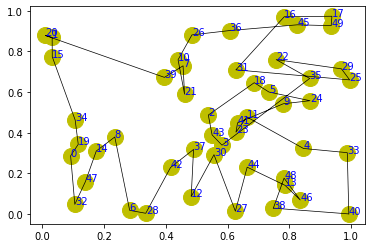

step:1275/5000, actic loss:2.091, critic loss:7.610, L:13.099, 0min1sec
step:1276/5000, actic loss:2.091, critic loss:7.605, L:13.095, 0min1sec
step:1277/5000, actic loss:2.093, critic loss:7.599, L:13.091, 0min1sec
step:1278/5000, actic loss:2.093, critic loss:7.593, L:13.086, 0min1sec
step:1279/5000, actic loss:2.089, critic loss:7.588, L:13.082, 0min1sec
distance:8.230
tensor([48, 11, 34, 35, 22, 45, 13,  9, 33, 44, 31, 32, 26,  0,  1, 38, 18, 27,
        23, 47, 46, 42, 17, 19, 21, 10,  5, 24, 28, 14, 39, 49,  3, 37, 16,  6,
        40, 25, 15,  4, 36, 41, 30,  2, 20,  8,  7, 43, 12, 29])


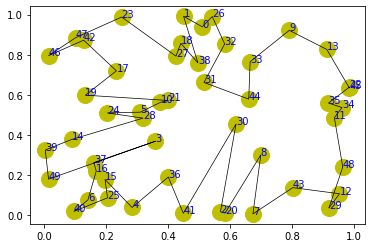

step:1280/5000, actic loss:2.085, critic loss:7.582, L:13.078, 0min1sec
step:1281/5000, actic loss:2.079, critic loss:7.576, L:13.073, 0min1sec
step:1282/5000, actic loss:2.073, critic loss:7.571, L:13.069, 0min1sec
step:1283/5000, actic loss:2.069, critic loss:7.565, L:13.065, 0min1sec
step:1284/5000, actic loss:2.069, critic loss:7.560, L:13.061, 0min1sec
distance:8.273
tensor([40, 47, 25, 11,  2, 28,  5, 14,  7, 34, 44, 17, 45, 35, 24, 37, 43,  0,
        21, 41, 10,  8, 27,  3, 12, 38, 31, 33, 30, 26, 48, 16, 15, 32,  1,  9,
        39, 18, 13, 49, 46,  4,  6, 22, 23, 36, 29, 20, 42, 19])


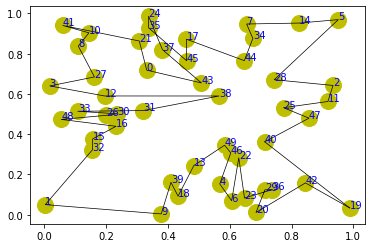

step:1285/5000, actic loss:2.073, critic loss:7.555, L:13.057, 0min1sec
step:1286/5000, actic loss:2.079, critic loss:7.549, L:13.053, 0min1sec
step:1287/5000, actic loss:2.085, critic loss:7.544, L:13.049, 0min1sec
step:1288/5000, actic loss:2.087, critic loss:7.539, L:13.045, 0min1sec
step:1289/5000, actic loss:2.085, critic loss:7.533, L:13.041, 0min1sec
distance:6.869
tensor([18, 15, 10, 46, 45, 42, 44, 21, 12,  7, 23,  0, 14, 30, 20, 16, 28, 35,
        11, 47, 29,  6, 17,  4, 34, 43,  2, 48, 32, 37, 33,  8,  9, 40, 25,  3,
         5,  1, 36, 13, 39, 27, 22, 49, 19, 26, 41, 38, 31, 24])


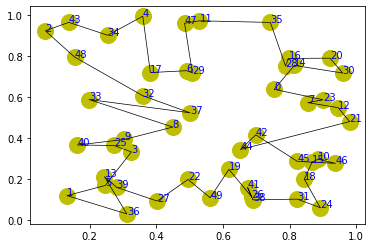

step:1290/5000, actic loss:2.082, critic loss:7.528, L:13.037, 0min1sec
step:1291/5000, actic loss:2.078, critic loss:7.522, L:13.032, 0min1sec
step:1292/5000, actic loss:2.077, critic loss:7.517, L:13.028, 0min1sec
step:1293/5000, actic loss:2.077, critic loss:7.511, L:13.024, 0min1sec
step:1294/5000, actic loss:2.076, critic loss:7.506, L:13.020, 0min1sec
distance:7.420
tensor([ 9, 24, 26,  7, 32, 45, 33, 19,  4,  6, 13, 25, 44, 18, 41, 47, 43, 36,
        31,  1, 15, 49, 14,  3, 39, 46, 17,  2, 42, 28, 10, 27, 29,  0, 48, 20,
        21, 12,  8, 16, 11, 34, 35, 40, 38, 22,  5, 30, 23, 37])


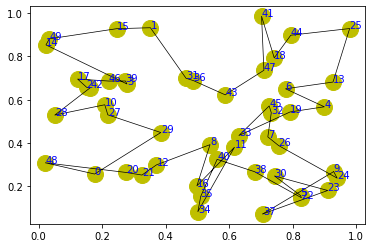

step:1295/5000, actic loss:2.071, critic loss:7.500, L:13.015, 0min2sec
step:1296/5000, actic loss:2.067, critic loss:7.494, L:13.011, 0min1sec
step:1297/5000, actic loss:2.062, critic loss:7.489, L:13.007, 0min1sec
step:1298/5000, actic loss:2.059, critic loss:7.483, L:13.002, 0min1sec
step:1299/5000, actic loss:2.061, critic loss:7.478, L:12.998, 0min1sec
distance:6.378
tensor([36, 34, 41, 39, 26, 38, 21, 20, 44, 22, 11, 42,  2, 47,  4, 48, 30,  5,
        18, 24, 40, 43, 23,  8, 15, 46, 33,  6, 16,  9, 35, 49, 17, 13, 25, 28,
        37, 31, 32, 29,  3, 12, 27,  7, 19,  0, 14,  1, 10, 45])


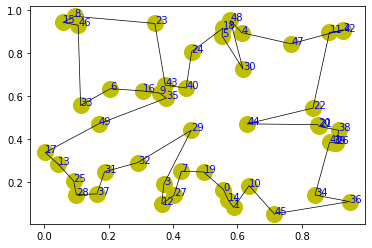

step:1300/5000, actic loss:2.065, critic loss:7.472, L:12.993, 0min1sec
step:1301/5000, actic loss:2.068, critic loss:7.467, L:12.989, 0min1sec
step:1302/5000, actic loss:2.069, critic loss:7.462, L:12.985, 0min1sec
step:1303/5000, actic loss:2.066, critic loss:7.456, L:12.980, 0min1sec
step:1304/5000, actic loss:2.062, critic loss:7.451, L:12.976, 0min1sec
distance:7.401
tensor([22,  7, 12, 33, 15, 26, 21, 13, 32, 35,  8, 29, 17, 31,  4, 44, 39,  6,
         5, 25, 23, 16,  1, 42, 28, 46,  2, 14, 38, 37, 49, 45, 43,  3, 48, 27,
        40, 18, 36, 10, 47, 34, 11,  9, 24, 30, 41, 19,  0, 20])


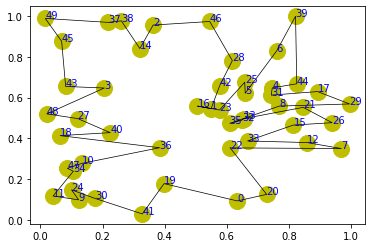

step:1305/5000, actic loss:2.059, critic loss:7.445, L:12.972, 0min1sec
step:1306/5000, actic loss:2.058, critic loss:7.440, L:12.967, 0min1sec
step:1307/5000, actic loss:2.057, critic loss:7.434, L:12.963, 0min1sec
step:1308/5000, actic loss:2.054, critic loss:7.429, L:12.959, 0min1sec
step:1309/5000, actic loss:2.052, critic loss:7.423, L:12.954, 0min1sec
distance:7.088
tensor([10, 30, 48, 11, 39, 22,  4, 49, 18, 13, 23, 17, 36,  3,  6, 42, 35, 29,
         7, 34, 14, 24, 47, 19, 16,  9, 40,  8, 44, 27, 43, 38, 26,  2, 28, 25,
         1, 37, 46, 45, 41,  5, 12, 32, 15, 33, 31, 21,  0, 20])


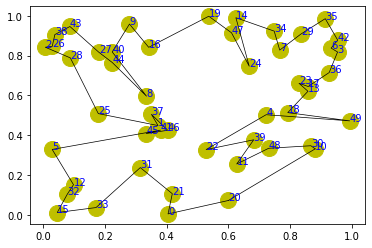

step:1310/5000, actic loss:2.049, critic loss:7.418, L:12.950, 0min2sec
step:1311/5000, actic loss:2.047, critic loss:7.413, L:12.946, 0min1sec
step:1312/5000, actic loss:2.046, critic loss:7.407, L:12.941, 0min1sec
step:1313/5000, actic loss:2.045, critic loss:7.402, L:12.937, 0min1sec
step:1314/5000, actic loss:2.044, critic loss:7.396, L:12.933, 0min1sec
distance:7.081
tensor([47, 46, 33, 23, 25, 35, 49, 45, 37, 41, 12, 18, 15, 40, 28, 30, 26, 42,
        34, 16, 14,  9,  7,  4,  3, 17, 36, 13, 48,  5, 39, 21,  2, 11, 10, 31,
         0, 22, 27, 32, 43, 38, 20,  6,  8, 44,  1, 19, 29, 24])


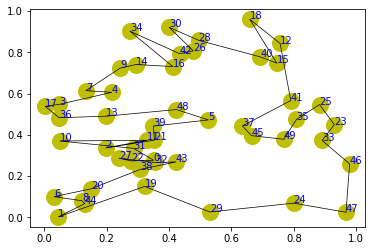

step:1315/5000, actic loss:2.041, critic loss:7.391, L:12.929, 0min1sec
step:1316/5000, actic loss:2.035, critic loss:7.386, L:12.924, 0min1sec
step:1317/5000, actic loss:2.031, critic loss:7.381, L:12.920, 0min1sec
step:1318/5000, actic loss:2.028, critic loss:7.375, L:12.916, 0min1sec
step:1319/5000, actic loss:2.028, critic loss:7.370, L:12.912, 0min1sec
distance:7.547
tensor([16, 19, 27, 21, 12,  7, 33, 44, 20, 30,  3, 29,  4, 35, 34, 38,  0, 15,
        32,  9, 40, 31, 43, 13, 45, 36, 17,  6, 10, 18, 42, 37, 46, 24, 28, 39,
        14, 48, 49,  5,  2,  1,  8, 11, 23, 41, 25, 26, 47, 22])


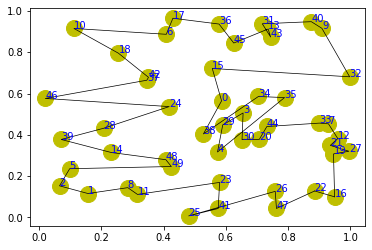

step:1320/5000, actic loss:2.031, critic loss:7.365, L:12.908, 0min1sec
step:1321/5000, actic loss:2.035, critic loss:7.360, L:12.904, 0min1sec
step:1322/5000, actic loss:2.038, critic loss:7.355, L:12.900, 0min1sec
step:1323/5000, actic loss:2.038, critic loss:7.350, L:12.896, 0min2sec
step:1324/5000, actic loss:2.033, critic loss:7.344, L:12.892, 0min1sec
distance:7.738
tensor([35, 45,  9,  5, 40, 47, 31, 10,  6,  3,  1, 38, 21, 44, 26, 19, 43, 13,
        46, 15,  7, 42,  2, 23, 14, 32,  4, 25, 37,  0, 48, 34, 20, 12, 41, 36,
        18, 24, 28, 39, 30, 11,  8, 16, 29, 33, 27, 49, 17, 22])


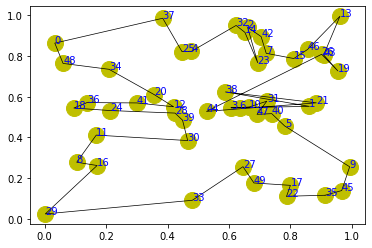

step:1325/5000, actic loss:2.028, critic loss:7.339, L:12.888, 0min1sec
step:1326/5000, actic loss:2.021, critic loss:7.334, L:12.884, 0min1sec
step:1327/5000, actic loss:2.015, critic loss:7.329, L:12.880, 0min1sec
step:1328/5000, actic loss:2.008, critic loss:7.324, L:12.876, 0min1sec
step:1329/5000, actic loss:2.005, critic loss:7.319, L:12.873, 0min1sec
distance:8.315
tensor([45, 24, 47, 16, 31,  8, 23, 32, 21,  5, 30,  1, 19, 48, 25,  6, 29, 10,
        44, 42, 17, 34, 22, 33, 40,  0, 37, 20, 15, 28, 39, 43, 12, 35, 41,  9,
        36, 49,  3, 38, 13, 46, 18, 27, 14,  4,  7, 11, 26,  2])


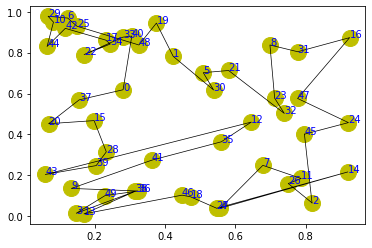

step:1330/5000, actic loss:2.006, critic loss:7.314, L:12.869, 0min1sec
step:1331/5000, actic loss:2.013, critic loss:7.309, L:12.865, 0min1sec
step:1332/5000, actic loss:2.020, critic loss:7.304, L:12.862, 0min1sec
step:1333/5000, actic loss:2.030, critic loss:7.300, L:12.858, 0min1sec
step:1334/5000, actic loss:2.037, critic loss:7.295, L:12.854, 0min1sec
distance:7.495
tensor([ 0, 43, 47, 34, 27, 45, 25, 20, 35, 33,  5,  9, 18, 29, 30, 26, 36,  3,
        10, 24, 23, 19, 40, 21,  7,  1, 16, 49, 32, 39, 15,  2, 42, 22, 41,  8,
        37, 13,  4, 11, 28, 38, 46, 17, 44, 31, 48,  6, 12, 14])


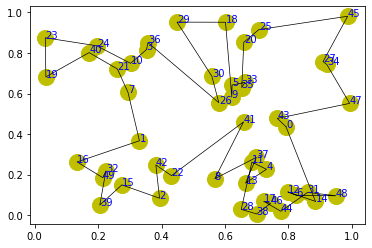

step:1335/5000, actic loss:2.040, critic loss:7.290, L:12.850, 0min1sec
step:1336/5000, actic loss:2.040, critic loss:7.285, L:12.847, 0min1sec
step:1337/5000, actic loss:2.034, critic loss:7.280, L:12.843, 0min1sec
step:1338/5000, actic loss:2.026, critic loss:7.275, L:12.839, 0min1sec
step:1339/5000, actic loss:2.016, critic loss:7.270, L:12.835, 0min1sec
distance:7.443
tensor([48,  3, 21, 31,  1, 38, 32,  0,  9, 10, 25, 15, 37, 22, 41, 36, 43, 40,
         7, 11, 33, 42, 13, 17, 35, 23,  4, 45, 20, 47, 49,  8, 12,  6, 28, 46,
        26, 19, 34, 18, 44, 29, 39, 24, 27,  5,  2, 14, 16, 30])


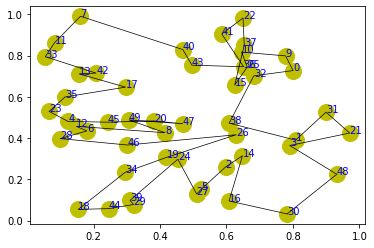

step:1340/5000, actic loss:2.010, critic loss:7.265, L:12.831, 0min1sec
step:1341/5000, actic loss:2.003, critic loss:7.260, L:12.827, 0min1sec
step:1342/5000, actic loss:2.000, critic loss:7.255, L:12.823, 0min1sec
step:1343/5000, actic loss:2.000, critic loss:7.249, L:12.819, 0min1sec
step:1344/5000, actic loss:2.002, critic loss:7.244, L:12.815, 0min1sec
distance:7.550
tensor([41,  0, 24, 15, 12, 31, 40, 16,  6, 21,  1, 46, 23, 32,  7, 33, 10, 43,
        20, 42, 11, 25,  4, 22, 37, 47, 44, 39, 36, 48,  3, 45, 13,  9,  5, 18,
        26, 28, 14, 38, 34, 17,  2, 30, 35, 19,  8, 29, 49, 27])


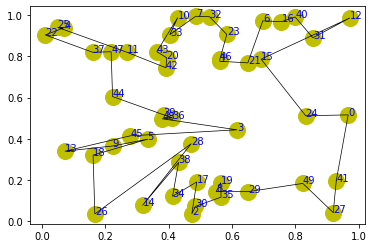

step:1345/5000, actic loss:2.004, critic loss:7.239, L:12.811, 0min1sec
step:1346/5000, actic loss:2.006, critic loss:7.234, L:12.807, 0min1sec
step:1347/5000, actic loss:2.005, critic loss:7.229, L:12.804, 0min1sec
step:1348/5000, actic loss:1.998, critic loss:7.224, L:12.800, 0min1sec
step:1349/5000, actic loss:1.990, critic loss:7.219, L:12.796, 0min1sec
distance:7.534
tensor([31, 36, 25, 42, 14, 43, 40, 37, 33,  2, 35, 13, 12, 17, 23,  6,  5, 38,
         7,  3, 26, 48, 27, 29, 41, 24,  8, 49, 39,  4, 20, 19, 22, 34, 46, 28,
        47, 21,  0, 30,  9, 18,  1, 32, 15, 11, 16, 45, 10, 44])


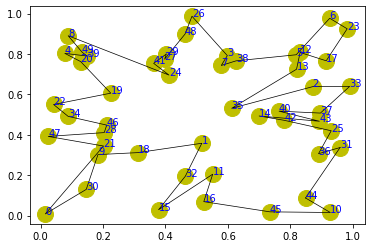

step:1350/5000, actic loss:1.983, critic loss:7.214, L:12.792, 0min1sec
step:1351/5000, actic loss:1.978, critic loss:7.209, L:12.788, 0min1sec
step:1352/5000, actic loss:1.976, critic loss:7.204, L:12.784, 0min1sec
step:1353/5000, actic loss:1.977, critic loss:7.199, L:12.781, 0min1sec
step:1354/5000, actic loss:1.980, critic loss:7.194, L:12.777, 0min1sec
distance:9.343
tensor([47,  0,  7,  2, 25,  8, 24,  4, 26, 38, 18,  9, 19, 21, 28, 11, 49, 14,
        31, 27, 12, 45,  1, 36, 30, 37,  3, 20, 48, 35, 43, 46, 16, 39, 23,  6,
        41, 34, 32, 13, 22, 44, 17,  5, 29, 15, 42, 10, 40, 33])


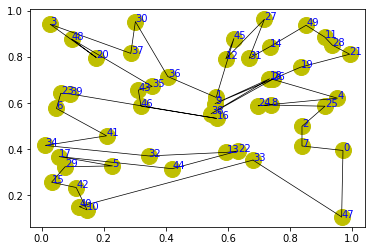

step:1355/5000, actic loss:1.982, critic loss:7.189, L:12.773, 0min1sec
step:1356/5000, actic loss:1.981, critic loss:7.184, L:12.769, 0min1sec
step:1357/5000, actic loss:1.978, critic loss:7.179, L:12.765, 0min1sec
step:1358/5000, actic loss:1.972, critic loss:7.174, L:12.761, 0min1sec
step:1359/5000, actic loss:1.965, critic loss:7.169, L:12.757, 0min1sec
distance:7.327
tensor([22, 17, 40, 49, 46, 26, 39, 13, 25, 47, 14, 41, 16, 43, 33, 19,  1, 35,
        21, 15,  8, 18, 37, 45, 12,  0, 36, 42, 44, 11, 32, 29, 27, 30,  6,  7,
        31, 28,  9,  3, 48,  4, 24, 23, 10,  2, 38,  5, 20, 34])


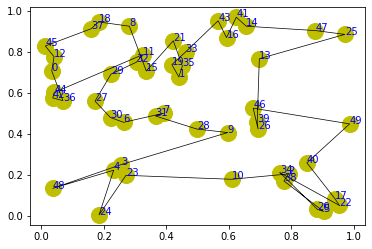

step:1360/5000, actic loss:1.961, critic loss:7.164, L:12.753, 0min1sec
step:1361/5000, actic loss:1.960, critic loss:7.159, L:12.749, 0min1sec
step:1362/5000, actic loss:1.961, critic loss:7.154, L:12.746, 0min1sec
step:1363/5000, actic loss:1.961, critic loss:7.149, L:12.742, 0min1sec
step:1364/5000, actic loss:1.961, critic loss:7.144, L:12.738, 0min1sec
distance:7.423
tensor([ 6, 36, 27, 46, 13,  0,  3, 24, 10, 28, 37, 35,  2, 30, 16, 38, 17, 25,
         8, 31, 33,  1, 18, 32, 40, 23, 12, 11, 26, 48, 14, 49, 42,  4, 45, 39,
         5, 44, 22, 41,  7, 19, 34, 47, 20, 29,  9, 43, 21, 15])


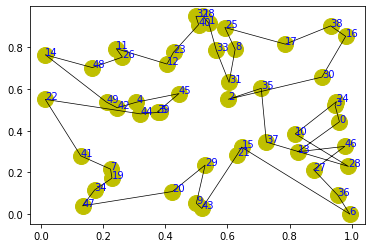

step:1365/5000, actic loss:1.957, critic loss:7.139, L:12.734, 0min1sec
step:1366/5000, actic loss:1.953, critic loss:7.134, L:12.730, 0min1sec
step:1367/5000, actic loss:1.949, critic loss:7.129, L:12.726, 0min1sec
step:1368/5000, actic loss:1.947, critic loss:7.124, L:12.722, 0min1sec
step:1369/5000, actic loss:1.947, critic loss:7.119, L:12.718, 0min1sec
distance:6.981
tensor([43,  3, 16, 20, 49, 33, 46, 28,  7, 31, 24, 22, 35, 27, 39,  2, 12, 10,
        30,  8, 23, 19, 37, 13, 15, 26, 25, 40, 21, 17, 34, 32, 48, 44, 38, 36,
        14,  1, 42,  5, 41,  9, 18, 29,  0, 45, 11, 47,  4,  6])


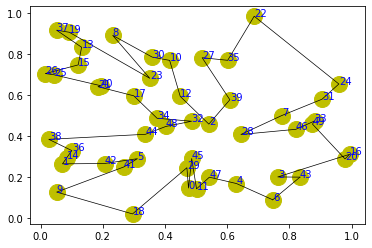

step:1370/5000, actic loss:1.949, critic loss:7.114, L:12.714, 0min1sec
step:1371/5000, actic loss:1.950, critic loss:7.109, L:12.710, 0min1sec
step:1372/5000, actic loss:1.950, critic loss:7.104, L:12.706, 0min1sec
step:1373/5000, actic loss:1.946, critic loss:7.099, L:12.702, 0min1sec
step:1374/5000, actic loss:1.939, critic loss:7.094, L:12.699, 0min1sec
distance:7.389
tensor([11, 18, 46, 23,  3,  1, 38, 47,  7, 42,  4, 17, 37, 20, 13, 21, 14,  9,
        28, 33, 49,  8,  2, 43,  6, 34, 31, 16, 27, 12,  0, 48, 32, 36, 30,  5,
        10, 39, 41, 45, 26, 40, 15, 24, 29, 19, 22, 35, 25, 44])


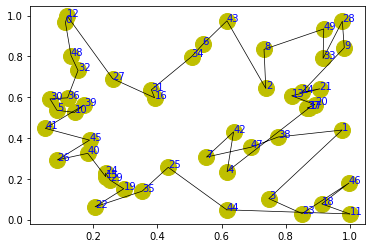

step:1375/5000, actic loss:1.933, critic loss:7.090, L:12.695, 0min1sec
step:1376/5000, actic loss:1.927, critic loss:7.085, L:12.691, 0min1sec
step:1377/5000, actic loss:1.922, critic loss:7.080, L:12.687, 0min1sec
step:1378/5000, actic loss:1.920, critic loss:7.076, L:12.684, 0min1sec
step:1379/5000, actic loss:1.921, critic loss:7.071, L:12.680, 0min1sec
distance:10.519
tensor([14, 42, 16, 22, 45, 35,  2,  1,  3, 17,  7, 21, 23,  0, 48, 11, 40, 13,
        38, 31, 43, 24, 33, 20, 27, 15, 39, 47, 26,  4, 29,  9, 37, 28, 30, 44,
        18,  5, 12, 10, 25, 36, 41, 32, 49,  8, 34, 46, 19,  6])


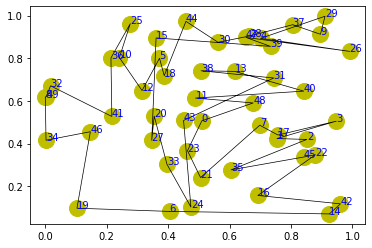

step:1380/5000, actic loss:1.922, critic loss:7.066, L:12.677, 0min1sec
step:1381/5000, actic loss:1.923, critic loss:7.061, L:12.673, 0min1sec
step:1382/5000, actic loss:1.922, critic loss:7.056, L:12.670, 0min1sec
step:1383/5000, actic loss:1.918, critic loss:7.052, L:12.666, 0min1sec
step:1384/5000, actic loss:1.911, critic loss:7.047, L:12.663, 0min1sec
distance:8.494
tensor([16, 23, 34, 13, 21, 12,  6, 35,  3,  8, 19, 11,  0, 15,  2, 43,  4, 48,
        32,  7, 49, 22, 18, 27, 10, 42,  1, 14, 17, 36, 28, 30, 46, 41,  9, 39,
        37,  5, 38, 31, 40, 33, 29, 44, 20, 26, 25, 45, 47, 24])


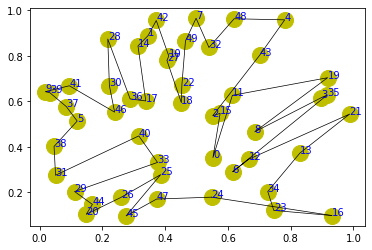

step:1385/5000, actic loss:1.904, critic loss:7.042, L:12.659, 0min1sec
step:1386/5000, actic loss:1.895, critic loss:7.038, L:12.656, 0min1sec
step:1387/5000, actic loss:1.888, critic loss:7.033, L:12.653, 0min1sec
step:1388/5000, actic loss:1.886, critic loss:7.029, L:12.649, 0min1sec
step:1389/5000, actic loss:1.886, critic loss:7.024, L:12.646, 0min1sec
distance:7.947
tensor([ 7, 46, 23, 18, 29,  2, 36, 17, 39, 33, 40,  4, 13, 14, 21,  3, 48, 49,
        16, 11, 47, 10, 24, 34, 37, 20,  1, 35, 43, 30, 41, 12, 45, 26,  6, 19,
         8, 32, 28, 15,  0, 25, 31, 38,  9, 22, 27, 42,  5, 44])


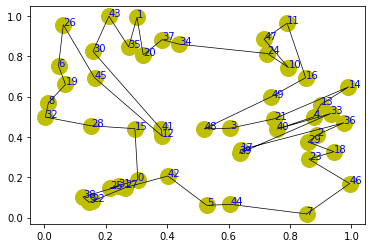

step:1390/5000, actic loss:1.887, critic loss:7.020, L:12.643, 0min1sec
step:1391/5000, actic loss:1.888, critic loss:7.015, L:12.639, 0min1sec
step:1392/5000, actic loss:1.887, critic loss:7.010, L:12.636, 0min1sec
step:1393/5000, actic loss:1.885, critic loss:7.005, L:12.633, 0min1sec
step:1394/5000, actic loss:1.882, critic loss:7.001, L:12.629, 0min1sec
distance:8.238
tensor([19, 39, 16, 23, 37, 42, 15,  3, 30, 18, 13, 45, 35, 46, 47, 17,  6, 48,
        20, 36, 41, 14, 33, 11, 12, 29, 40, 31,  7,  0,  1, 32, 26, 49,  4,  8,
        25, 24, 27, 34,  2,  9,  5, 38, 22, 10, 21, 28, 44, 43])


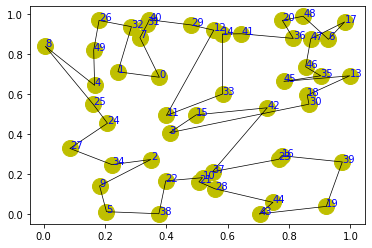

step:1395/5000, actic loss:1.878, critic loss:6.996, L:12.625, 0min1sec
step:1396/5000, actic loss:1.876, critic loss:6.991, L:12.622, 0min1sec
step:1397/5000, actic loss:1.876, critic loss:6.986, L:12.618, 0min1sec
step:1398/5000, actic loss:1.876, critic loss:6.982, L:12.615, 0min1sec
step:1399/5000, actic loss:1.875, critic loss:6.977, L:12.611, 0min1sec
distance:8.110
tensor([37, 28, 17, 45, 41, 30,  6, 27,  8, 39, 11,  9,  4,  2, 38, 40, 13, 25,
        49,  3, 24, 47, 22,  0, 15, 33,  1, 35, 32, 44, 34,  5, 21, 16, 14, 19,
        20, 48, 18, 29, 31, 12,  7, 36, 26, 43, 10, 46, 23, 42])


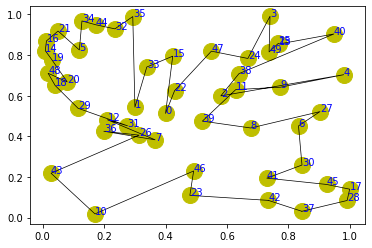

step:1400/5000, actic loss:1.875, critic loss:6.972, L:12.608, 0min2sec
step:1401/5000, actic loss:1.872, critic loss:6.968, L:12.604, 0min1sec
step:1402/5000, actic loss:1.867, critic loss:6.963, L:12.601, 0min1sec
step:1403/5000, actic loss:1.863, critic loss:6.958, L:12.597, 0min1sec
step:1404/5000, actic loss:1.861, critic loss:6.954, L:12.593, 0min1sec
distance:7.503
tensor([13,  0,  3, 28, 36, 41, 12, 38,  9, 30,  1, 39, 19, 14, 35, 40, 42, 21,
        18,  2, 48, 43, 26, 32,  4, 27, 37, 23, 49, 25,  5, 45, 33, 24, 10, 44,
         8, 29, 16,  7, 20,  6, 47, 11, 31, 15, 34, 22, 17, 46])


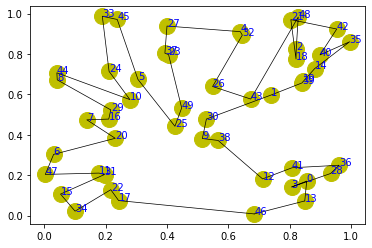

step:1405/5000, actic loss:1.862, critic loss:6.949, L:12.590, 0min1sec
step:1406/5000, actic loss:1.865, critic loss:6.944, L:12.586, 0min1sec
step:1407/5000, actic loss:1.866, critic loss:6.940, L:12.582, 0min1sec
step:1408/5000, actic loss:1.867, critic loss:6.935, L:12.578, 0min1sec
step:1409/5000, actic loss:1.863, critic loss:6.930, L:12.575, 0min1sec
distance:7.929
tensor([27, 23, 22, 35, 28,  8, 18, 49,  4,  9, 29, 24, 48, 36, 46, 30, 41, 47,
        11,  7, 40, 44, 45, 42,  2, 17, 37,  0, 12, 25, 38, 26, 19, 21, 43, 15,
        14, 31,  6, 13, 32,  3, 20,  1, 16,  5, 39, 34, 33, 10])


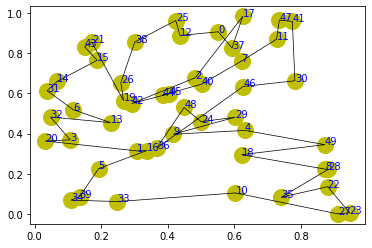

step:1410/5000, actic loss:1.855, critic loss:6.926, L:12.571, 0min1sec
step:1411/5000, actic loss:1.844, critic loss:6.922, L:12.568, 0min1sec
step:1412/5000, actic loss:1.836, critic loss:6.917, L:12.565, 0min1sec
step:1413/5000, actic loss:1.831, critic loss:6.913, L:12.561, 0min1sec
step:1414/5000, actic loss:1.833, critic loss:6.908, L:12.558, 0min1sec
distance:7.231
tensor([22, 31, 20, 25, 27, 24, 44,  7, 16,  2, 38, 33, 40, 49, 18, 19, 21, 35,
        13,  1, 37, 28, 10, 36,  5, 29, 48,  3, 41, 34, 42, 43, 39, 47, 32, 15,
        45, 46, 12, 23, 14,  9,  8,  4, 30, 17, 26,  0,  6, 11])


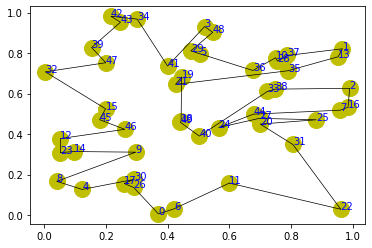

step:1415/5000, actic loss:1.838, critic loss:6.904, L:12.554, 0min2sec
step:1416/5000, actic loss:1.844, critic loss:6.900, L:12.551, 0min1sec
step:1417/5000, actic loss:1.849, critic loss:6.895, L:12.547, 0min1sec
step:1418/5000, actic loss:1.851, critic loss:6.891, L:12.544, 0min1sec
step:1419/5000, actic loss:1.850, critic loss:6.886, L:12.540, 0min1sec
distance:8.244
tensor([46,  7, 20,  6, 36, 35, 44, 31, 13,  4, 10, 22, 34, 16,  9,  0,  1, 49,
        17,  8, 45, 32, 42, 25,  3, 11,  5, 12, 39, 14, 47, 29, 40, 26, 41, 27,
        15,  2, 38, 19, 37, 24, 23, 48, 28, 30, 21, 18, 43, 33])


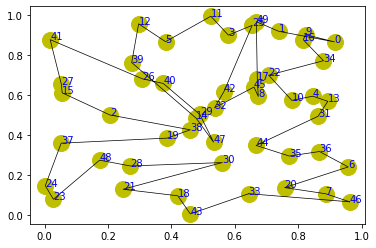

step:1420/5000, actic loss:1.845, critic loss:6.882, L:12.537, 0min1sec
step:1421/5000, actic loss:1.841, critic loss:6.877, L:12.534, 0min1sec
step:1422/5000, actic loss:1.838, critic loss:6.873, L:12.530, 0min1sec
step:1423/5000, actic loss:1.839, critic loss:6.868, L:12.527, 0min1sec
step:1424/5000, actic loss:1.840, critic loss:6.863, L:12.523, 0min1sec
distance:6.705
tensor([ 0, 20, 11,  9, 40,  3, 25, 37, 43, 24, 21, 35, 44,  8,  7, 48, 32, 15,
        27, 12, 39,  1, 14, 42,  4, 23, 41,  2, 28, 47, 34, 18, 22, 36,  6, 31,
        33, 17, 19, 29,  5, 49, 13, 10, 45, 16, 26, 30, 46, 38])


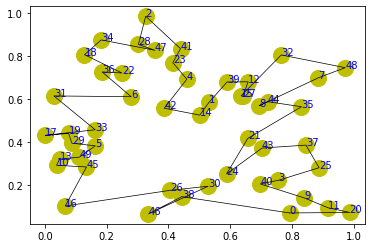

step:1425/5000, actic loss:1.841, critic loss:6.859, L:12.520, 0min2sec
step:1426/5000, actic loss:1.841, critic loss:6.854, L:12.516, 0min1sec
step:1427/5000, actic loss:1.838, critic loss:6.850, L:12.513, 0min1sec
step:1428/5000, actic loss:1.832, critic loss:6.845, L:12.509, 0min1sec
step:1429/5000, actic loss:1.826, critic loss:6.841, L:12.506, 0min1sec
distance:7.271
tensor([10, 17, 33, 39,  1, 20, 14, 11, 21, 38, 12, 36, 41, 42, 30, 27,  7,  8,
        45, 23, 32, 47, 49, 16, 29,  5, 22, 24, 44, 35,  6, 46, 18, 43, 15,  2,
        26,  4, 13, 48, 37, 34, 31, 25, 40,  0,  9, 19, 28,  3])


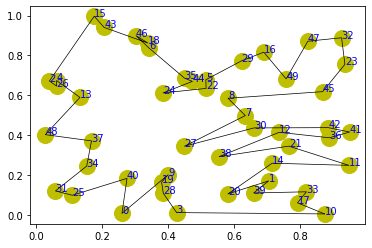

step:1430/5000, actic loss:1.820, critic loss:6.837, L:12.503, 0min1sec
step:1431/5000, actic loss:1.816, critic loss:6.832, L:12.500, 0min1sec
step:1432/5000, actic loss:1.818, critic loss:6.828, L:12.496, 0min1sec
step:1433/5000, actic loss:1.820, critic loss:6.824, L:12.493, 0min1sec
step:1434/5000, actic loss:1.821, critic loss:6.819, L:12.490, 0min1sec
distance:7.307
tensor([14, 19, 24, 42, 47, 22, 39, 35, 28, 41, 23, 17, 37,  1, 11,  7, 15, 43,
        49, 26, 13, 25, 18, 48, 33,  9, 16, 30, 31, 45, 29,  0, 46, 34, 20, 40,
        12, 32, 38,  3, 21, 36,  5, 10,  4,  8, 27,  6,  2, 44])


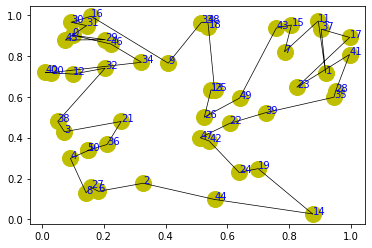

step:1435/5000, actic loss:1.822, critic loss:6.815, L:12.487, 0min2sec
step:1436/5000, actic loss:1.819, critic loss:6.810, L:12.484, 0min1sec
step:1437/5000, actic loss:1.815, critic loss:6.806, L:12.481, 0min1sec
step:1438/5000, actic loss:1.815, critic loss:6.802, L:12.477, 0min1sec
step:1439/5000, actic loss:1.816, critic loss:6.797, L:12.474, 0min1sec
distance:7.046
tensor([17, 21, 33, 15, 43,  9, 26, 34,  2, 11, 32, 42, 39, 25, 24, 31, 12, 48,
        35, 22,  7, 44,  1, 20,  3, 47,  0, 10,  5, 45, 38, 13, 18, 40, 16, 27,
        49, 23, 41, 29, 46, 19, 14, 37,  8, 30, 28,  6, 36,  4])


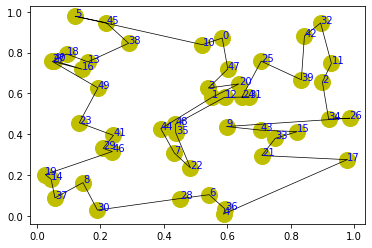

step:1440/5000, actic loss:1.815, critic loss:6.793, L:12.471, 0min2sec
step:1441/5000, actic loss:1.812, critic loss:6.788, L:12.467, 0min1sec
step:1442/5000, actic loss:1.809, critic loss:6.784, L:12.464, 0min1sec
step:1443/5000, actic loss:1.807, critic loss:6.779, L:12.461, 0min1sec
step:1444/5000, actic loss:1.806, critic loss:6.775, L:12.457, 0min1sec
distance:7.151
tensor([43, 36, 21, 47,  5, 19, 14, 45, 38, 46,  0, 23, 17, 25, 15, 30, 11, 37,
        41, 20, 39, 32, 10,  8,  6,  9, 49, 12, 28, 35, 24, 31, 44, 22,  2, 48,
        34,  4, 33,  7, 13, 26, 27, 18, 42, 40, 29, 16,  3,  1])


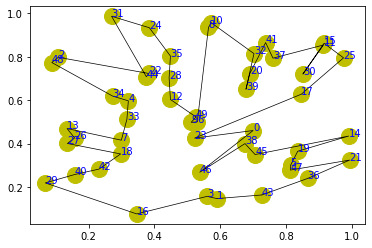

step:1445/5000, actic loss:1.805, critic loss:6.770, L:12.454, 0min2sec
step:1446/5000, actic loss:1.803, critic loss:6.766, L:12.450, 0min2sec
step:1447/5000, actic loss:1.800, critic loss:6.761, L:12.447, 0min2sec
step:1448/5000, actic loss:1.798, critic loss:6.757, L:12.443, 0min1sec
step:1449/5000, actic loss:1.798, critic loss:6.752, L:12.440, 0min1sec
distance:6.655
tensor([ 6,  5, 35,  0, 38, 36, 44, 39, 24, 27, 30, 14, 31, 13,  9, 15, 19, 25,
        43, 16, 20,  2, 22, 45, 47, 37, 12, 48,  7,  4, 32, 11, 28, 21, 41, 34,
         1, 17, 49, 23, 46,  3, 40,  8, 18, 10, 26, 33, 42, 29])


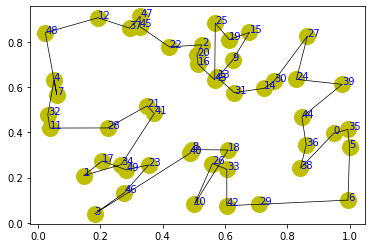

step:1450/5000, actic loss:1.799, critic loss:6.748, L:12.437, 0min1sec
step:1451/5000, actic loss:1.799, critic loss:6.743, L:12.433, 0min1sec
step:1452/5000, actic loss:1.798, critic loss:6.739, L:12.430, 0min1sec
step:1453/5000, actic loss:1.795, critic loss:6.735, L:12.427, 0min1sec
step:1454/5000, actic loss:1.790, critic loss:6.731, L:12.423, 0min1sec
distance:7.623
tensor([10, 29, 26,  2, 38, 27, 36, 46, 14, 20, 35, 21, 22, 31, 17,  3, 43, 33,
        12, 44, 25, 45,  4, 47, 37, 24, 30,  1, 18, 13, 41,  8,  9, 34, 42, 16,
        23, 39,  7, 40, 15, 32, 28, 19, 49,  0,  5, 48,  6, 11])


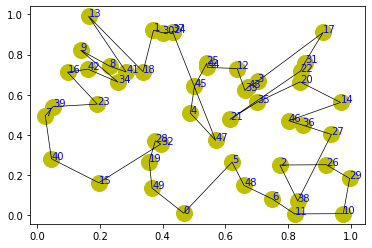

step:1455/5000, actic loss:1.785, critic loss:6.726, L:12.420, 0min1sec
step:1456/5000, actic loss:1.782, critic loss:6.722, L:12.417, 0min1sec
step:1457/5000, actic loss:1.781, critic loss:6.718, L:12.414, 0min1sec
step:1458/5000, actic loss:1.783, critic loss:6.713, L:12.410, 0min1sec
step:1459/5000, actic loss:1.787, critic loss:6.709, L:12.407, 0min1sec
distance:7.489
tensor([37,  0,  2, 30, 34, 39, 24, 13, 26, 42,  7, 21, 12,  9,  3, 11, 25, 17,
        14, 45, 38,  5, 23, 32, 40, 18, 35, 44,  1, 29,  6, 46, 19, 20, 16, 15,
        43, 31, 48, 22, 36, 33,  4, 28, 27, 49, 47, 10,  8, 41])


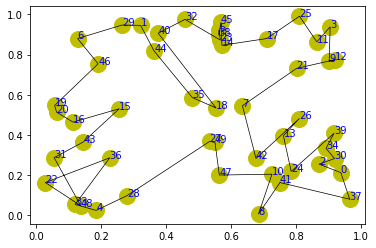

step:1460/5000, actic loss:1.792, critic loss:6.706, L:12.403, 0min2sec
step:1461/5000, actic loss:1.796, critic loss:6.702, L:12.400, 0min2sec
step:1462/5000, actic loss:1.799, critic loss:6.697, L:12.397, 0min1sec
step:1463/5000, actic loss:1.797, critic loss:6.693, L:12.393, 0min1sec
step:1464/5000, actic loss:1.792, critic loss:6.689, L:12.390, 0min1sec
distance:8.637
tensor([18,  3,  9, 33, 15, 43, 29, 32, 23, 48, 36, 20, 46, 47, 35, 31,  8,  7,
        11,  6, 25, 28, 44, 45, 39,  4, 27, 13, 10, 41,  1, 40, 24, 38,  0, 19,
        17,  2, 22,  5, 21, 14, 12, 16, 30, 42, 34, 37, 26, 49])


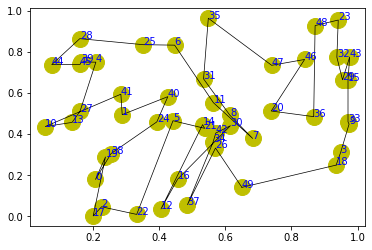

step:1465/5000, actic loss:1.784, critic loss:6.685, L:12.387, 0min1sec
step:1466/5000, actic loss:1.774, critic loss:6.682, L:12.384, 0min1sec
step:1467/5000, actic loss:1.764, critic loss:6.678, L:12.381, 0min1sec
step:1468/5000, actic loss:1.756, critic loss:6.674, L:12.378, 0min1sec
step:1469/5000, actic loss:1.752, critic loss:6.670, L:12.375, 0min1sec
distance:6.489
tensor([44,  0, 36, 48,  2, 23, 40, 29, 14, 42, 22, 18, 27,  6, 47, 25, 43, 35,
        21,  4,  1, 19, 39, 28,  7, 32, 17, 20, 46, 45, 49, 31, 37,  8, 15, 41,
        33, 11, 38, 13, 24,  3, 34, 16, 26, 10,  5, 30,  9, 12])


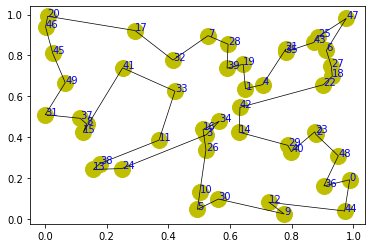

step:1470/5000, actic loss:1.754, critic loss:6.666, L:12.371, 0min1sec
step:1471/5000, actic loss:1.759, critic loss:6.662, L:12.368, 0min1sec
step:1472/5000, actic loss:1.764, critic loss:6.658, L:12.365, 0min1sec
step:1473/5000, actic loss:1.770, critic loss:6.654, L:12.361, 0min1sec
step:1474/5000, actic loss:1.772, critic loss:6.650, L:12.358, 0min1sec
distance:7.494
tensor([ 5, 35, 17, 19, 28, 43, 12, 45, 41, 24, 16,  1, 14, 18, 38, 48, 20, 32,
        47, 40, 27, 42, 23,  0,  3, 36, 37, 25,  6, 31, 39, 26, 44,  9, 29,  8,
         7,  2, 22, 34, 21, 33, 13, 15, 46, 30, 49,  4, 11, 10])


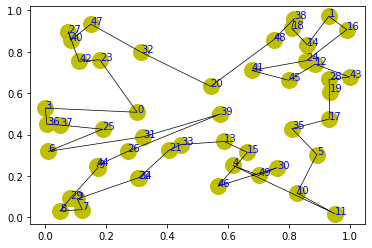

step:1475/5000, actic loss:1.770, critic loss:6.645, L:12.355, 0min2sec
step:1476/5000, actic loss:1.766, critic loss:6.641, L:12.352, 0min2sec
step:1477/5000, actic loss:1.762, critic loss:6.637, L:12.349, 0min1sec
step:1478/5000, actic loss:1.758, critic loss:6.633, L:12.345, 0min1sec
step:1479/5000, actic loss:1.755, critic loss:6.628, L:12.343, 0min1sec
distance:8.623
tensor([45,  9, 18, 27, 15,  1, 22, 49, 20, 17, 46,  0,  5, 19, 39, 14,  8, 11,
        47,  6, 32, 31, 42, 38, 28, 43, 13, 33, 35,  4, 16, 12, 25, 41, 29,  2,
        34, 36, 30, 23, 10, 48, 21, 26, 44,  3, 24,  7, 40, 37])


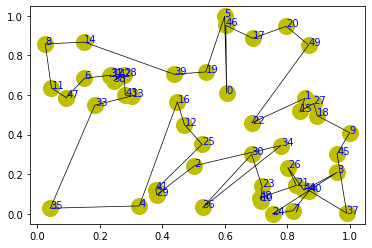

step:1480/5000, actic loss:1.756, critic loss:6.624, L:12.340, 0min1sec
step:1481/5000, actic loss:1.759, critic loss:6.620, L:12.337, 0min1sec
step:1482/5000, actic loss:1.762, critic loss:6.616, L:12.334, 0min1sec
step:1483/5000, actic loss:1.763, critic loss:6.612, L:12.331, 0min1sec
step:1484/5000, actic loss:1.761, critic loss:6.608, L:12.328, 0min1sec
distance:8.221
tensor([23,  4, 16, 35, 13, 24, 18, 26, 11, 42, 39, 49, 48,  3,  2, 46, 21, 41,
        25, 34, 28, 36, 27, 14, 33, 17, 37,  0, 20, 45, 22,  1, 10,  5, 29,  6,
        19, 40,  9, 30, 15, 38, 31,  7, 47, 43, 12, 44,  8, 32])


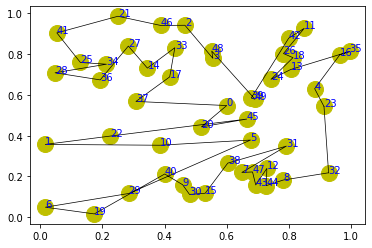

step:1485/5000, actic loss:1.759, critic loss:6.604, L:12.325, 0min1sec
step:1486/5000, actic loss:1.757, critic loss:6.599, L:12.323, 0min1sec
step:1487/5000, actic loss:1.758, critic loss:6.595, L:12.320, 0min1sec
step:1488/5000, actic loss:1.762, critic loss:6.591, L:12.317, 0min1sec
step:1489/5000, actic loss:1.765, critic loss:6.587, L:12.314, 0min1sec
distance:7.262
tensor([39, 16, 27, 38,  6, 31, 17, 21, 35,  4,  3, 11, 19,  2,  7, 36, 33, 20,
         0, 23, 34, 25, 28, 32,  8, 22, 41, 15, 45, 43, 30, 13, 14, 18,  5, 29,
        48, 10, 26, 46,  1, 24, 42, 40,  9, 47, 44, 12, 49, 37])


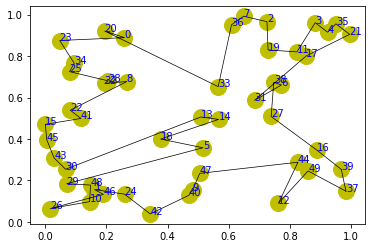

step:1490/5000, actic loss:1.766, critic loss:6.583, L:12.311, 0min1sec
step:1491/5000, actic loss:1.764, critic loss:6.579, L:12.308, 0min1sec
step:1492/5000, actic loss:1.761, critic loss:6.575, L:12.305, 0min1sec
step:1493/5000, actic loss:1.754, critic loss:6.571, L:12.302, 0min1sec
step:1494/5000, actic loss:1.744, critic loss:6.567, L:12.299, 0min1sec
distance:7.638
tensor([18, 20, 39, 47, 42, 12, 36, 29, 40, 17, 19, 28, 43, 23, 13, 30,  0, 11,
        49,  6, 27, 35,  7,  3,  9,  1, 21, 37, 32,  2, 25, 31, 38, 34,  8, 10,
        48, 15, 41, 16, 33, 24, 14, 46, 22, 44, 26,  5,  4, 45])


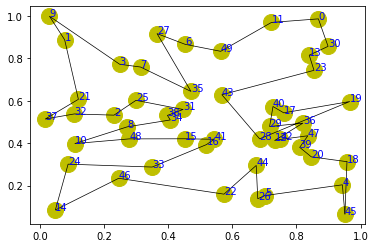

step:1495/5000, actic loss:1.734, critic loss:6.564, L:12.296, 0min1sec
step:1496/5000, actic loss:1.726, critic loss:6.560, L:12.293, 0min1sec
step:1497/5000, actic loss:1.722, critic loss:6.555, L:12.290, 0min1sec
step:1498/5000, actic loss:1.724, critic loss:6.551, L:12.286, 0min1sec
step:1499/5000, actic loss:1.726, critic loss:6.547, L:12.284, 0min1sec
distance:7.400
tensor([34, 39, 47, 11, 30,  2, 33, 45, 12, 10, 25, 13,  9, 32, 49, 42, 41, 19,
        22, 24,  8, 46, 20, 40, 17,  7,  1, 18, 29, 26,  0, 27, 23,  6, 14, 15,
        31, 28, 37, 43,  3, 36,  4, 35, 44, 16,  5, 21, 48, 38])


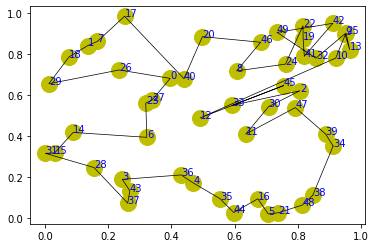

step:1500/5000, actic loss:1.730, critic loss:6.544, L:12.281, 0min1sec
step:1501/5000, actic loss:1.732, critic loss:6.540, L:12.278, 0min1sec
step:1502/5000, actic loss:1.733, critic loss:6.536, L:12.275, 0min1sec
step:1503/5000, actic loss:1.733, critic loss:6.532, L:12.271, 0min1sec
step:1504/5000, actic loss:1.728, critic loss:6.527, L:12.268, 0min1sec
distance:7.350
tensor([17, 15,  8, 33, 25,  5, 39, 21, 34, 32, 44, 42, 11, 19,  0, 41,  4, 10,
         2, 20, 24, 37,  7, 40, 43, 30, 28, 47, 45, 22,  3,  9, 23, 16, 49, 12,
        14, 26, 35,  6, 27, 38, 46, 13, 18, 36,  1, 31, 29, 48])


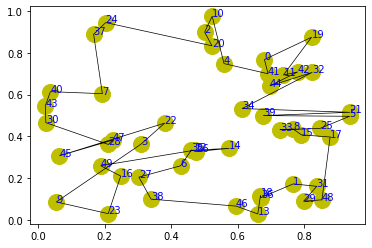

step:1505/5000, actic loss:1.721, critic loss:6.524, L:12.265, 0min1sec
step:1506/5000, actic loss:1.715, critic loss:6.520, L:12.262, 0min1sec
step:1507/5000, actic loss:1.708, critic loss:6.516, L:12.259, 0min1sec
step:1508/5000, actic loss:1.702, critic loss:6.512, L:12.256, 0min1sec
step:1509/5000, actic loss:1.697, critic loss:6.508, L:12.253, 0min1sec
distance:7.410
tensor([11,  3, 23, 44, 45,  1, 31,  5,  7, 12, 46, 21, 28,  4, 40, 30,  2, 19,
        17, 10, 26, 20,  6, 42, 35, 41, 27, 39, 33, 22, 13, 18, 29, 48, 38, 14,
         9, 43, 16, 15,  0, 37,  8, 49, 24, 32, 36, 25, 34, 47])


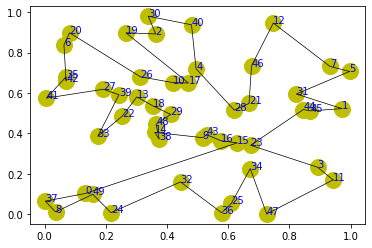

step:1510/5000, actic loss:1.697, critic loss:6.504, L:12.250, 0min1sec
step:1511/5000, actic loss:1.700, critic loss:6.500, L:12.247, 0min1sec
step:1512/5000, actic loss:1.701, critic loss:6.496, L:12.244, 0min1sec
step:1513/5000, actic loss:1.703, critic loss:6.492, L:12.242, 0min1sec
step:1514/5000, actic loss:1.702, critic loss:6.488, L:12.239, 0min1sec
distance:8.518
tensor([ 6, 13, 23, 35, 17, 11, 14, 30,  9, 12, 29, 46, 15, 47, 10, 36, 26, 43,
        34,  7,  8, 39, 42, 41, 40,  2, 20,  0, 49,  4,  3, 48, 33, 44, 16, 24,
        37, 18, 38,  1, 19, 28, 21, 45, 22, 32,  5, 25, 27, 31])


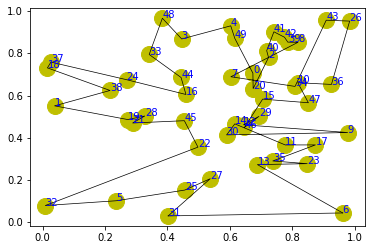

step:1515/5000, actic loss:1.698, critic loss:6.484, L:12.236, 0min1sec
step:1516/5000, actic loss:1.692, critic loss:6.480, L:12.233, 0min1sec
step:1517/5000, actic loss:1.688, critic loss:6.476, L:12.230, 0min1sec
step:1518/5000, actic loss:1.683, critic loss:6.472, L:12.227, 0min1sec
step:1519/5000, actic loss:1.681, critic loss:6.468, L:12.225, 0min1sec
distance:7.226
tensor([17, 42, 28, 24,  2, 27, 29, 16, 35, 33,  4,  5, 13, 45, 32, 18, 14,  8,
        26, 22,  0, 47, 39, 37, 11, 40, 44, 41, 36, 12, 21, 46, 15, 10, 25, 19,
        49, 20, 34,  9,  6, 31,  1,  3, 38, 23, 48, 43, 30,  7])


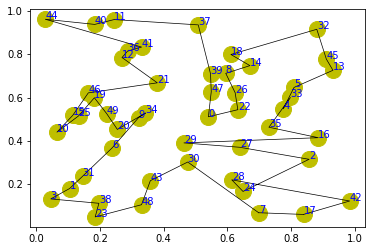

step:1520/5000, actic loss:1.683, critic loss:6.464, L:12.222, 0min1sec
step:1521/5000, actic loss:1.688, critic loss:6.461, L:12.219, 0min1sec
step:1522/5000, actic loss:1.695, critic loss:6.457, L:12.216, 0min1sec
step:1523/5000, actic loss:1.700, critic loss:6.453, L:12.213, 0min1sec
step:1524/5000, actic loss:1.705, critic loss:6.449, L:12.210, 0min1sec
distance:7.676
tensor([30,  6, 35, 31, 29,  2, 43, 37, 41, 33, 25, 44, 28,  1, 32, 38, 18, 47,
         9, 39, 26, 13, 45, 27, 19, 14, 12, 16, 17,  5,  3, 20, 22, 15, 40,  4,
        34, 36, 46, 11,  7, 21, 42, 49, 23, 24, 10,  8, 48,  0])


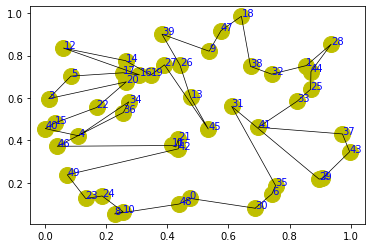

step:1525/5000, actic loss:1.704, critic loss:6.445, L:12.207, 0min1sec
step:1526/5000, actic loss:1.698, critic loss:6.442, L:12.204, 0min1sec
step:1527/5000, actic loss:1.689, critic loss:6.438, L:12.202, 0min1sec
step:1528/5000, actic loss:1.678, critic loss:6.435, L:12.199, 0min1sec
step:1529/5000, actic loss:1.667, critic loss:6.431, L:12.196, 0min1sec
distance:8.631
tensor([44, 47, 48,  3, 13, 10, 32, 46, 12, 14,  9, 22, 39, 41,  1, 29, 42, 16,
         8, 11, 17, 27, 20, 38, 36, 45, 26,  2, 30,  0, 37, 18, 49, 34, 21, 35,
        24, 19,  5, 28,  6, 31, 23,  7,  4, 25, 43, 40, 33, 15])


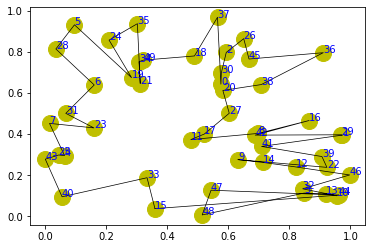

step:1530/5000, actic loss:1.655, critic loss:6.428, L:12.194, 0min1sec
step:1531/5000, actic loss:1.646, critic loss:6.424, L:12.191, 0min1sec
step:1532/5000, actic loss:1.639, critic loss:6.421, L:12.189, 0min1sec
step:1533/5000, actic loss:1.638, critic loss:6.417, L:12.186, 0min1sec
step:1534/5000, actic loss:1.645, critic loss:6.414, L:12.183, 0min1sec
distance:8.034
tensor([43, 15, 48, 17, 44, 22, 41, 32, 13, 20, 42, 19, 14, 37, 28, 23, 11,  2,
        36,  1,  7, 10, 12, 24, 30, 31,  0, 35, 49, 25, 38, 18, 16, 26,  8, 47,
         4,  6, 40, 21, 29, 33, 39,  3,  5, 45, 27,  9, 46, 34])


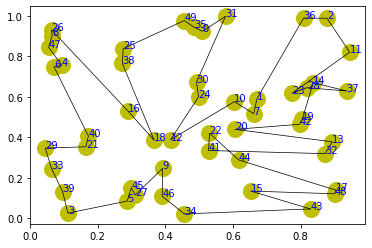

step:1535/5000, actic loss:1.655, critic loss:6.411, L:12.181, 0min1sec
step:1536/5000, actic loss:1.663, critic loss:6.407, L:12.178, 0min1sec
step:1537/5000, actic loss:1.669, critic loss:6.404, L:12.175, 0min1sec
step:1538/5000, actic loss:1.672, critic loss:6.400, L:12.172, 0min1sec
step:1539/5000, actic loss:1.671, critic loss:6.396, L:12.170, 0min1sec
distance:7.554
tensor([ 5, 44, 20, 35, 36, 28, 38, 48, 31,  9, 41,  7, 11, 29, 37, 34, 16,  8,
        15, 33, 39, 22, 26,  1, 21, 45,  4, 27, 43, 24, 12, 25, 17,  0, 23, 49,
         2, 40, 46, 32, 13,  3, 10, 30, 14, 19, 47, 42, 18,  6])


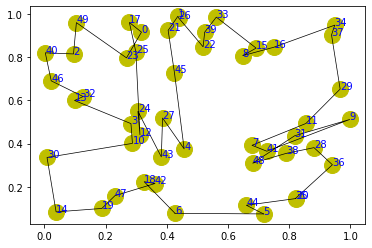

step:1540/5000, actic loss:1.665, critic loss:6.393, L:12.167, 0min1sec
step:1541/5000, actic loss:1.657, critic loss:6.389, L:12.164, 0min1sec
step:1542/5000, actic loss:1.649, critic loss:6.386, L:12.161, 0min1sec
step:1543/5000, actic loss:1.642, critic loss:6.382, L:12.159, 0min1sec
step:1544/5000, actic loss:1.639, critic loss:6.378, L:12.156, 0min1sec
distance:8.206
tensor([48, 11, 37, 30, 34, 13, 15, 33, 16,  4, 12,  1, 43, 38, 47, 46, 39,  3,
        19, 18, 29,  0, 35, 40, 44, 21,  5,  2, 32, 49, 23, 22,  6, 41, 45, 20,
        10, 26, 31, 24,  8,  9, 36, 28, 17, 27, 42,  7, 14, 25])


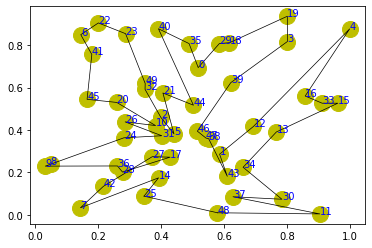

step:1545/5000, actic loss:1.639, critic loss:6.374, L:12.153, 0min2sec
step:1546/5000, actic loss:1.641, critic loss:6.370, L:12.150, 0min1sec
step:1547/5000, actic loss:1.643, critic loss:6.367, L:12.147, 0min2sec
step:1548/5000, actic loss:1.644, critic loss:6.363, L:12.144, 0min1sec
step:1549/5000, actic loss:1.642, critic loss:6.359, L:12.141, 0min1sec
distance:8.522
tensor([29, 41, 35, 15, 30,  9, 47, 33, 46, 28, 11, 18, 25, 27, 34, 49, 40, 36,
        22, 39, 26,  8, 12,  5, 32, 21, 10, 17,  7,  2, 20, 16, 45, 14, 13, 48,
        42, 23,  0,  4,  3, 37, 19,  1, 43, 44, 31,  6, 38, 24])


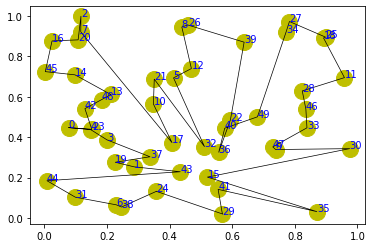

step:1550/5000, actic loss:1.639, critic loss:6.355, L:12.139, 0min1sec
step:1551/5000, actic loss:1.637, critic loss:6.351, L:12.136, 0min1sec
step:1552/5000, actic loss:1.636, critic loss:6.347, L:12.133, 0min1sec
step:1553/5000, actic loss:1.636, critic loss:6.343, L:12.130, 0min1sec
step:1554/5000, actic loss:1.635, critic loss:6.339, L:12.127, 0min1sec
distance:7.689
tensor([27,  2, 29, 38, 36, 16, 39, 28, 44, 26,  6, 37, 22,  0, 18, 11, 24, 23,
        34, 46, 19, 49, 48, 30, 10, 43, 20, 12, 40, 35, 33, 41,  7, 32, 14,  4,
        31, 42, 13,  5,  3, 47,  1, 15, 45, 25,  8, 21, 17,  9])


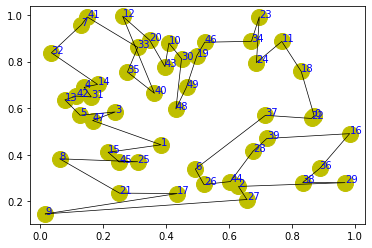

step:1555/5000, actic loss:1.632, critic loss:6.336, L:12.124, 0min1sec
step:1556/5000, actic loss:1.628, critic loss:6.332, L:12.121, 0min1sec
step:1557/5000, actic loss:1.626, critic loss:6.328, L:12.118, 0min1sec
step:1558/5000, actic loss:1.625, critic loss:6.324, L:12.115, 0min1sec
step:1559/5000, actic loss:1.625, critic loss:6.320, L:12.112, 0min1sec
distance:8.180
tensor([21, 15,  7, 33, 36, 32, 42, 19, 46, 43, 34, 16, 24, 23, 25,  5, 30, 39,
         4, 18, 12, 48, 28, 14, 26,  1, 31, 17, 45, 35, 38,  0, 20, 10,  8, 11,
        41,  3,  2, 44, 37, 13, 40,  6,  9, 22, 29, 47, 27, 49])


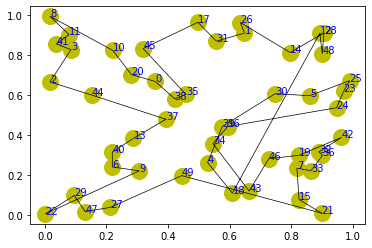

step:1560/5000, actic loss:1.624, critic loss:6.316, L:12.109, 0min2sec
step:1561/5000, actic loss:1.620, critic loss:6.313, L:12.106, 0min1sec
step:1562/5000, actic loss:1.618, critic loss:6.309, L:12.103, 0min1sec
step:1563/5000, actic loss:1.616, critic loss:6.305, L:12.099, 0min1sec
step:1564/5000, actic loss:1.616, critic loss:6.301, L:12.096, 0min1sec
distance:7.604
tensor([28, 45, 16, 33, 40, 32,  2,  9,  7, 36, 27,  4,  5, 12, 43, 18,  3, 44,
         0, 26, 20, 25,  1, 10, 19, 38, 39,  8, 46, 24, 31, 41, 11, 14, 48, 47,
        29, 22, 49, 13, 34, 35, 30, 21, 17, 23, 42,  6, 37, 15])


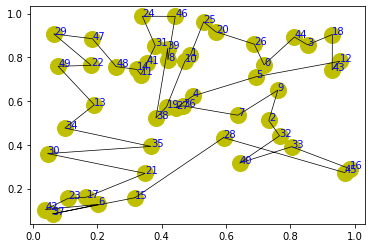

step:1565/5000, actic loss:1.616, critic loss:6.297, L:12.093, 0min1sec
step:1566/5000, actic loss:1.614, critic loss:6.293, L:12.090, 0min1sec
step:1567/5000, actic loss:1.614, critic loss:6.289, L:12.087, 0min1sec
step:1568/5000, actic loss:1.613, critic loss:6.286, L:12.084, 0min1sec
step:1569/5000, actic loss:1.611, critic loss:6.282, L:12.081, 0min1sec
distance:7.009
tensor([28, 40, 48, 45, 35,  7,  3, 16, 38, 11, 17, 30, 21, 23, 31, 27, 12, 41,
        42, 24,  2,  0, 20, 22, 14, 36, 25,  1,  5,  4, 44, 29, 19, 46, 10,  8,
        43, 47,  6, 49, 15, 26, 13, 37, 32, 18,  9, 34, 33, 39])


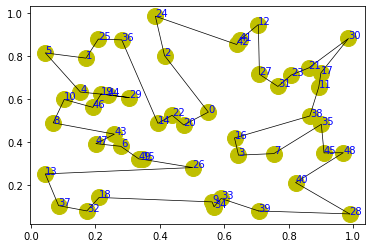

step:1570/5000, actic loss:1.611, critic loss:6.278, L:12.078, 0min1sec
step:1571/5000, actic loss:1.609, critic loss:6.274, L:12.075, 0min1sec
step:1572/5000, actic loss:1.608, critic loss:6.270, L:12.072, 0min1sec
step:1573/5000, actic loss:1.607, critic loss:6.267, L:12.069, 0min1sec
step:1574/5000, actic loss:1.606, critic loss:6.263, L:12.066, 0min1sec
distance:6.756
tensor([35, 39, 26, 29, 32,  2,  5, 18, 38,  6,  0, 12, 16, 15, 42, 19, 44, 45,
        14, 46, 31,  8, 13,  9,  4, 23, 36, 17, 28, 49, 27,  1, 25, 33,  7, 48,
         3, 41, 10, 47, 43, 22, 11, 37, 24, 21, 34, 20, 30, 40])


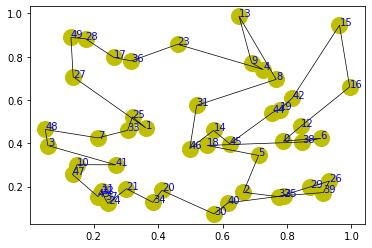

step:1575/5000, actic loss:1.605, critic loss:6.259, L:12.064, 0min1sec
step:1576/5000, actic loss:1.605, critic loss:6.256, L:12.061, 0min1sec
step:1577/5000, actic loss:1.603, critic loss:6.252, L:12.058, 0min1sec
step:1578/5000, actic loss:1.600, critic loss:6.248, L:12.055, 0min1sec
step:1579/5000, actic loss:1.597, critic loss:6.245, L:12.052, 0min1sec
distance:6.387
tensor([34, 33, 48, 31, 26, 21, 11, 43, 12, 46, 20, 28,  3, 41, 22, 18, 13, 29,
        30,  0, 37,  5, 44, 42, 35,  8, 24, 45,  4, 25,  9, 10, 17, 15, 16,  1,
         6, 40, 27, 23,  2, 47, 49, 14, 32, 38, 36, 39,  7, 19])


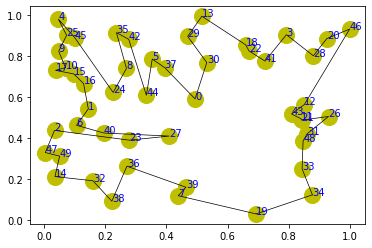

step:1580/5000, actic loss:1.595, critic loss:6.241, L:12.049, 0min1sec
step:1581/5000, actic loss:1.594, critic loss:6.237, L:12.046, 0min1sec
step:1582/5000, actic loss:1.595, critic loss:6.234, L:12.043, 0min1sec
step:1583/5000, actic loss:1.596, critic loss:6.230, L:12.041, 0min1sec
step:1584/5000, actic loss:1.596, critic loss:6.227, L:12.038, 0min1sec
distance:6.562
tensor([25, 17, 31,  8,  6,  0, 48, 34,  2, 33, 27, 47, 22, 38, 43, 26, 32, 23,
        36, 30,  5,  1, 12, 29, 40,  3, 49, 28, 10, 21, 37, 46, 19,  9, 11, 39,
        45, 35, 18, 41, 24, 16,  4, 20,  7, 42, 13, 15, 44, 14])


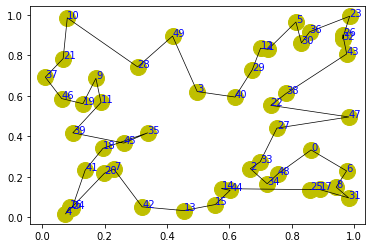

step:1585/5000, actic loss:1.595, critic loss:6.223, L:12.035, 0min1sec
step:1586/5000, actic loss:1.592, critic loss:6.219, L:12.032, 0min1sec
step:1587/5000, actic loss:1.588, critic loss:6.215, L:12.029, 0min1sec
step:1588/5000, actic loss:1.584, critic loss:6.212, L:12.026, 0min1sec
step:1589/5000, actic loss:1.579, critic loss:6.208, L:12.023, 0min1sec
distance:7.195
tensor([12, 24, 32, 26,  1, 43, 47, 29, 14, 31, 22, 21, 41, 48, 15, 10, 20, 37,
        33,  5, 38, 35, 18, 27, 42,  6,  0,  8,  3, 46, 25, 17, 28,  4,  2, 19,
         9, 30, 40, 16, 36, 44, 39,  7, 49, 34, 11, 23, 13, 45])


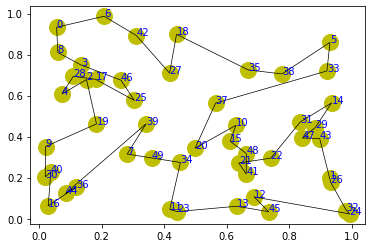

step:1590/5000, actic loss:1.576, critic loss:6.205, L:12.020, 0min2sec
step:1591/5000, actic loss:1.575, critic loss:6.201, L:12.017, 0min1sec
step:1592/5000, actic loss:1.576, critic loss:6.197, L:12.014, 0min1sec
step:1593/5000, actic loss:1.576, critic loss:6.193, L:12.011, 0min1sec
step:1594/5000, actic loss:1.575, critic loss:6.190, L:12.008, 0min1sec
distance:7.018
tensor([46, 39, 42,  4, 22, 44, 28, 19,  2, 47, 34, 25,  1, 24, 30, 38, 49,  8,
        35, 15, 12,  3, 13, 43, 11,  6,  5, 26,  0, 18, 33, 40, 29,  9, 16, 10,
        48, 14, 45, 37,  7, 21, 23, 41, 20, 31, 17, 27, 32, 36])


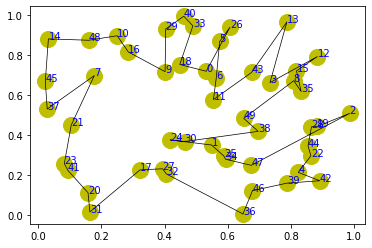

step:1595/5000, actic loss:1.571, critic loss:6.186, L:12.005, 0min1sec
step:1596/5000, actic loss:1.567, critic loss:6.182, L:12.002, 0min1sec
step:1597/5000, actic loss:1.562, critic loss:6.179, L:12.000, 0min1sec
step:1598/5000, actic loss:1.560, critic loss:6.175, L:11.997, 0min1sec
step:1599/5000, actic loss:1.558, critic loss:6.171, L:11.994, 0min1sec
distance:7.000
tensor([29, 33, 43, 15,  2, 10, 47, 24, 46, 22,  3, 13, 11, 49,  6, 23,  4, 18,
        25, 34, 36,  8, 12,  1, 40, 14, 44,  9, 45,  5, 42, 32, 30, 37, 20, 26,
        38, 48, 16,  0, 28, 21, 19, 27, 41, 31, 17, 35,  7, 39])


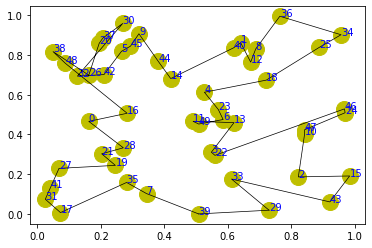

step:1600/5000, actic loss:1.560, critic loss:6.168, L:11.991, 0min1sec
step:1601/5000, actic loss:1.562, critic loss:6.165, L:11.989, 0min1sec
step:1602/5000, actic loss:1.565, critic loss:6.161, L:11.986, 0min1sec
step:1603/5000, actic loss:1.567, critic loss:6.158, L:11.983, 0min1sec
step:1604/5000, actic loss:1.568, critic loss:6.154, L:11.980, 0min1sec
distance:8.114
tensor([11, 41, 16,  4, 45, 30, 42, 40, 43, 27,  9,  3,  1,  6, 18, 19, 36,  7,
        12, 31, 26, 48, 14, 38, 35, 20,  0, 21, 23, 39, 49, 32, 24, 17, 28, 33,
        29,  8, 44, 46,  2, 47,  5, 10, 15, 22, 34, 37, 13, 25])


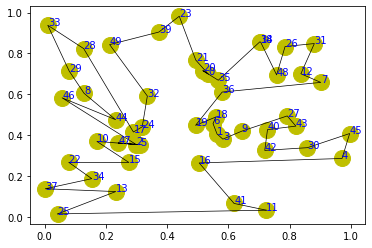

step:1605/5000, actic loss:1.567, critic loss:6.151, L:11.978, 0min2sec
step:1606/5000, actic loss:1.564, critic loss:6.147, L:11.975, 0min1sec
step:1607/5000, actic loss:1.557, critic loss:6.144, L:11.972, 0min1sec
step:1608/5000, actic loss:1.549, critic loss:6.141, L:11.970, 0min1sec
step:1609/5000, actic loss:1.540, critic loss:6.138, L:11.967, 0min1sec
distance:7.224
tensor([ 2, 32, 10, 29, 17, 12, 18, 36, 31, 26,  9, 27, 22,  8, 28, 19, 39,  4,
        20,  7, 25, 47, 43, 14, 44, 48, 37, 38, 11,  5, 30, 24,  3, 41, 23,  1,
         6, 40, 21, 46,  0, 42, 15, 45, 33, 16, 35, 49, 13, 34])


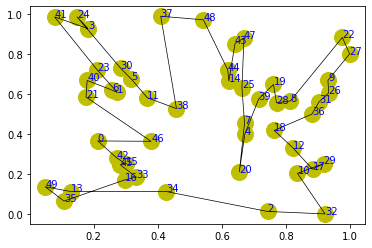

step:1610/5000, actic loss:1.533, critic loss:6.135, L:11.965, 0min1sec
step:1611/5000, actic loss:1.526, critic loss:6.132, L:11.962, 0min1sec
step:1612/5000, actic loss:1.522, critic loss:6.129, L:11.960, 0min1sec
step:1613/5000, actic loss:1.520, critic loss:6.125, L:11.958, 0min1sec
step:1614/5000, actic loss:1.524, critic loss:6.122, L:11.956, 0min1sec
distance:7.645
tensor([40, 21,  7, 22,  0, 12,  9, 16, 45,  4,  1, 38, 14, 34, 49, 47, 30,  3,
        36, 24, 18, 42, 23, 10, 44, 15, 37, 31, 19, 35, 39, 13, 28,  2,  8, 20,
        11, 29, 26, 43,  5, 25,  6, 33, 27, 41, 46, 48, 17, 32])


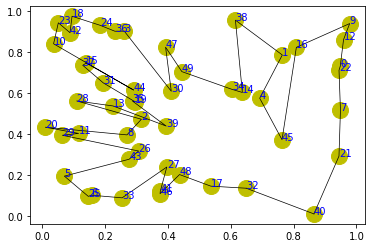

step:1615/5000, actic loss:1.530, critic loss:6.119, L:11.953, 0min1sec
step:1616/5000, actic loss:1.539, critic loss:6.117, L:11.951, 0min1sec
step:1617/5000, actic loss:1.550, critic loss:6.115, L:11.949, 0min1sec
step:1618/5000, actic loss:1.560, critic loss:6.113, L:11.946, 0min2sec
step:1619/5000, actic loss:1.568, critic loss:6.111, L:11.943, 0min1sec
distance:7.078
tensor([17, 35, 45, 30, 42, 47, 34, 10, 49, 21, 26, 44, 23, 19, 32, 16,  1, 33,
        40, 28,  2, 14, 12,  9, 36,  3, 29,  0, 38, 20,  8, 22, 39, 37, 18, 46,
        41,  7, 25, 15, 43, 24, 27,  5, 48, 31, 13,  6, 11,  4])


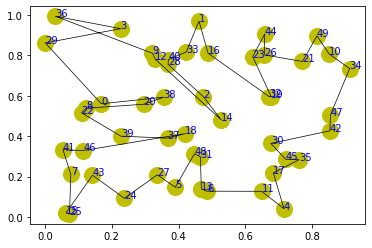

step:1620/5000, actic loss:1.574, critic loss:6.108, L:11.941, 0min1sec
step:1621/5000, actic loss:1.576, critic loss:6.105, L:11.939, 0min1sec
step:1622/5000, actic loss:1.576, critic loss:6.101, L:11.936, 0min1sec
step:1623/5000, actic loss:1.572, critic loss:6.098, L:11.933, 0min1sec
step:1624/5000, actic loss:1.568, critic loss:6.094, L:11.931, 0min1sec
distance:7.514
tensor([45,  0,  8, 26, 37, 30, 33, 34, 29, 14, 15, 13, 21, 39, 10, 47, 28,  9,
        24,  5,  7, 25,  4, 46, 18, 20, 27, 32, 11, 22, 40, 16, 42,  6, 36, 48,
         3, 49, 17, 41,  2, 38, 43, 44, 31, 19, 23,  1, 12, 35])


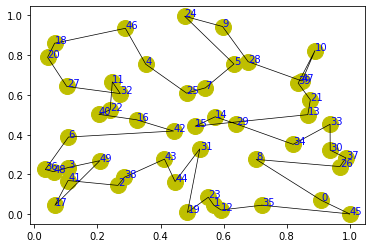

step:1625/5000, actic loss:1.562, critic loss:6.091, L:11.928, 0min1sec
step:1626/5000, actic loss:1.557, critic loss:6.088, L:11.925, 0min1sec
step:1627/5000, actic loss:1.553, critic loss:6.084, L:11.923, 0min1sec
step:1628/5000, actic loss:1.552, critic loss:6.081, L:11.920, 0min1sec
step:1629/5000, actic loss:1.553, critic loss:6.077, L:11.917, 0min1sec
distance:8.017
tensor([ 4, 28, 34, 46, 19, 17, 40, 42, 39, 29,  8, 27, 11, 22, 12, 16, 35, 20,
         7, 43, 18, 21, 13, 33, 47,  1, 41,  2, 24, 26, 15, 32, 45, 36, 23,  9,
         3, 49, 14, 37, 10, 25,  5,  0, 38, 44, 30,  6, 31, 48])


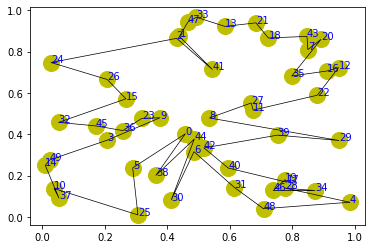

step:1630/5000, actic loss:1.552, critic loss:6.074, L:11.915, 0min2sec
step:1631/5000, actic loss:1.548, critic loss:6.070, L:11.912, 0min1sec
step:1632/5000, actic loss:1.542, critic loss:6.067, L:11.910, 0min1sec
step:1633/5000, actic loss:1.539, critic loss:6.064, L:11.907, 0min1sec
step:1634/5000, actic loss:1.542, critic loss:6.060, L:11.904, 0min1sec
distance:7.750
tensor([23, 36, 47, 38, 16, 48, 28, 44,  6, 17, 41, 29, 33, 45, 32,  4,  0, 15,
        35, 40, 22,  7,  5, 12, 39,  8, 27, 19, 21, 34,  3, 30,  9, 31,  1, 20,
         2, 26, 49, 24, 42, 46, 13, 25, 18, 14, 37, 43, 10, 11])


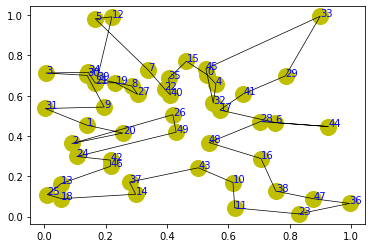

step:1635/5000, actic loss:1.546, critic loss:6.057, L:11.902, 0min1sec
step:1636/5000, actic loss:1.547, critic loss:6.054, L:11.899, 0min1sec
step:1637/5000, actic loss:1.546, critic loss:6.050, L:11.896, 0min1sec
step:1638/5000, actic loss:1.544, critic loss:6.047, L:11.894, 0min1sec
step:1639/5000, actic loss:1.543, critic loss:6.043, L:11.891, 0min1sec
distance:7.546
tensor([ 1, 16, 18, 34, 36, 26, 24, 30, 22, 29,  3, 12,  5, 11, 37, 25, 40,  6,
        10, 45, 41, 39, 44, 19, 47,  4, 33,  0, 14,  9, 17, 28, 23, 15,  8, 46,
         7, 38, 31, 35, 48, 13, 32, 20, 27, 21,  2, 42, 49, 43])


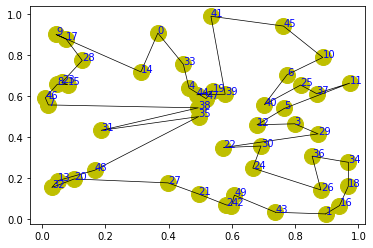

step:1640/5000, actic loss:1.542, critic loss:6.040, L:11.888, 0min1sec
step:1641/5000, actic loss:1.540, critic loss:6.036, L:11.885, 0min1sec
step:1642/5000, actic loss:1.540, critic loss:6.033, L:11.883, 0min1sec
step:1643/5000, actic loss:1.540, critic loss:6.029, L:11.880, 0min1sec
step:1644/5000, actic loss:1.537, critic loss:6.026, L:11.877, 0min1sec
distance:7.273
tensor([32, 23, 33, 46, 34,  0, 16, 25, 14,  7, 41,  4, 35, 18, 49,  3, 21, 24,
        38, 43, 15,  8, 39, 31, 17, 19, 11, 13, 28, 36,  1,  2, 26,  5, 12, 29,
        10, 48,  9, 30, 20, 44, 27, 22, 40, 47,  6, 42, 37, 45])


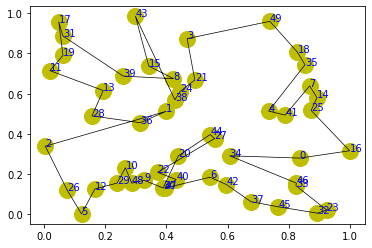

step:1645/5000, actic loss:1.536, critic loss:6.023, L:11.875, 0min1sec
step:1646/5000, actic loss:1.534, critic loss:6.019, L:11.872, 0min1sec
step:1647/5000, actic loss:1.533, critic loss:6.016, L:11.869, 0min1sec
step:1648/5000, actic loss:1.533, critic loss:6.012, L:11.867, 0min1sec
step:1649/5000, actic loss:1.534, critic loss:6.009, L:11.864, 0min1sec
distance:6.809
tensor([ 6, 12, 38, 37,  3, 43, 49,  5, 34, 32, 14,  8, 17, 48, 35, 40, 25, 39,
        41, 47,  0, 22, 21, 31,  4, 36, 26, 13, 19,  1, 18, 27, 30, 23, 46, 10,
         9, 20, 29, 42, 15, 11, 45, 28,  7, 44, 24,  2, 16, 33])


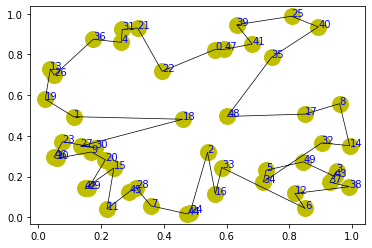

step:1650/5000, actic loss:1.532, critic loss:6.005, L:11.861, 0min1sec
step:1651/5000, actic loss:1.531, critic loss:6.002, L:11.858, 0min1sec
step:1652/5000, actic loss:1.528, critic loss:5.999, L:11.856, 0min1sec
step:1653/5000, actic loss:1.527, critic loss:5.995, L:11.853, 0min1sec
step:1654/5000, actic loss:1.527, critic loss:5.992, L:11.850, 0min1sec
distance:7.088
tensor([ 7,  3, 17, 14, 44, 36, 31,  0,  8, 13, 11, 32, 25,  5, 10, 19, 28, 33,
        35,  4,  2, 20,  9,  1, 46, 48, 22, 16, 41, 42, 38, 21, 24, 43, 23, 37,
        49, 30, 39, 47, 15, 18, 34, 26, 40, 29,  6, 12, 27, 45])


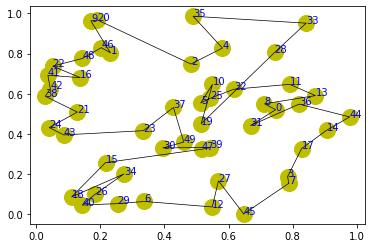

step:1655/5000, actic loss:1.528, critic loss:5.988, L:11.848, 0min2sec
step:1656/5000, actic loss:1.528, critic loss:5.985, L:11.845, 0min1sec
step:1657/5000, actic loss:1.525, critic loss:5.981, L:11.842, 0min1sec
step:1658/5000, actic loss:1.521, critic loss:5.978, L:11.839, 0min1sec
step:1659/5000, actic loss:1.518, critic loss:5.975, L:11.837, 0min1sec
distance:7.152
tensor([ 5, 26, 23, 12, 16, 36, 20,  4, 43, 11, 39, 27, 18, 14,  8, 46,  2, 31,
         9, 21, 38, 28, 44, 13,  1, 47,  3, 32, 22, 24,  7, 49, 25, 37, 17, 48,
         6, 40, 15, 10, 45, 19, 41, 34, 35, 42, 33, 30, 29,  0])


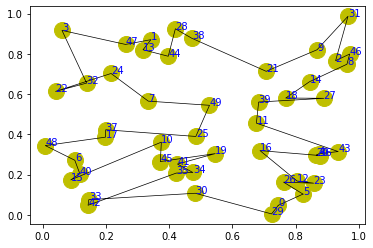

step:1660/5000, actic loss:1.515, critic loss:5.971, L:11.834, 0min1sec
step:1661/5000, actic loss:1.516, critic loss:5.968, L:11.831, 0min1sec
step:1662/5000, actic loss:1.518, critic loss:5.965, L:11.828, 0min1sec
step:1663/5000, actic loss:1.520, critic loss:5.961, L:11.826, 0min1sec
step:1664/5000, actic loss:1.520, critic loss:5.958, L:11.823, 0min1sec
distance:6.710
tensor([22, 32, 24, 45, 26, 48, 20, 17,  3, 18,  5, 43, 34, 19, 31, 42, 28, 14,
        30, 47, 16, 27,  8, 36, 46, 39, 23, 38, 33, 49, 13, 41,  4, 21, 29,  1,
        40,  0, 35,  2, 15,  9, 11, 12, 44, 10, 25,  7,  6, 37])


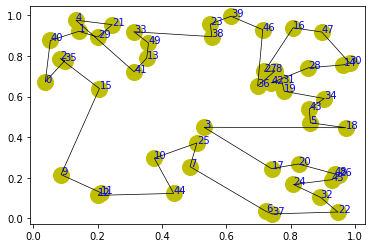

step:1665/5000, actic loss:1.519, critic loss:5.954, L:11.820, 0min1sec
step:1666/5000, actic loss:1.514, critic loss:5.951, L:11.818, 0min1sec
step:1667/5000, actic loss:1.507, critic loss:5.948, L:11.815, 0min1sec
step:1668/5000, actic loss:1.500, critic loss:5.945, L:11.812, 0min1sec
step:1669/5000, actic loss:1.494, critic loss:5.942, L:11.810, 0min1sec
distance:8.285
tensor([21, 20, 10, 24,  2, 13,  7, 31,  0, 11, 17, 37, 14, 41, 23, 45,  6, 28,
        29,  5,  9,  4, 44, 43, 48, 25, 18, 12, 27, 47, 39, 42, 40, 26,  8, 34,
        16, 22, 33, 46, 19, 36,  1, 49, 32, 15, 35, 30,  3, 38])


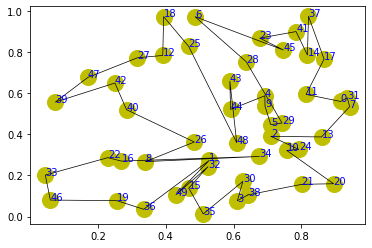

step:1670/5000, actic loss:1.488, critic loss:5.939, L:11.807, 0min1sec
step:1671/5000, actic loss:1.486, critic loss:5.935, L:11.804, 0min1sec
step:1672/5000, actic loss:1.486, critic loss:5.932, L:11.802, 0min1sec
step:1673/5000, actic loss:1.489, critic loss:5.929, L:11.799, 0min1sec
step:1674/5000, actic loss:1.494, critic loss:5.926, L:11.797, 0min1sec
distance:7.648
tensor([43, 31, 40, 49, 25,  3, 21, 15, 32, 29, 24, 33,  1, 26, 48,  0, 20, 18,
        28, 30, 22,  5, 39, 41, 37,  4,  2,  7, 42, 17, 16, 12,  9, 47, 19, 44,
        34, 10, 13, 35, 38, 14, 11, 45, 46, 23,  8,  6, 27, 36])


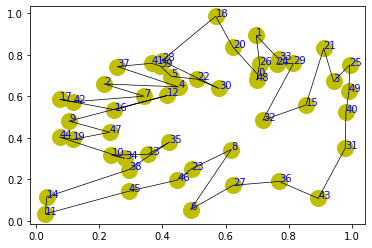

step:1675/5000, actic loss:1.498, critic loss:5.923, L:11.794, 0min2sec
step:1676/5000, actic loss:1.499, critic loss:5.920, L:11.791, 0min1sec
step:1677/5000, actic loss:1.498, critic loss:5.916, L:11.789, 0min1sec
step:1678/5000, actic loss:1.495, critic loss:5.913, L:11.786, 0min1sec
step:1679/5000, actic loss:1.489, critic loss:5.910, L:11.784, 0min1sec
distance:7.837
tensor([37, 49,  0,  2, 20, 40, 44, 31, 12, 19,  5, 43, 30,  4, 34, 17, 46, 23,
        22, 38, 41,  8, 21, 10, 11, 24, 33, 28, 39, 14, 13, 45, 25,  3, 47, 32,
        16,  7, 27, 29, 15, 36, 42, 26,  6, 48, 18,  1, 35,  9])


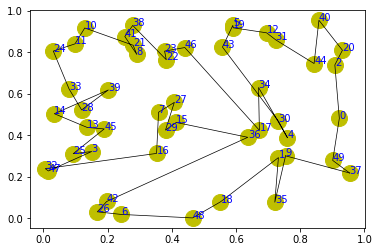

step:1680/5000, actic loss:1.482, critic loss:5.907, L:11.782, 0min1sec
step:1681/5000, actic loss:1.474, critic loss:5.904, L:11.779, 0min1sec
step:1682/5000, actic loss:1.469, critic loss:5.901, L:11.777, 0min1sec
step:1683/5000, actic loss:1.467, critic loss:5.897, L:11.774, 0min1sec
step:1684/5000, actic loss:1.470, critic loss:5.894, L:11.772, 0min1sec
distance:8.612
tensor([18, 27, 32,  0, 39, 36, 43, 46, 12, 48,  6, 30,  7, 49,  1, 25, 26,  9,
        33, 14, 44, 24, 34, 45,  2, 21,  4, 37,  8, 20, 22, 17, 42, 15, 38, 29,
         5, 41, 19, 23, 31, 47, 28,  3, 35, 13, 10, 16, 40, 11])


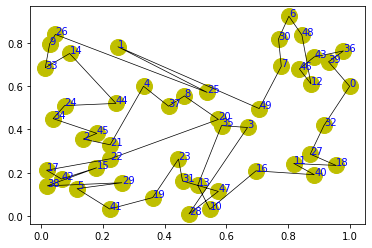

step:1685/5000, actic loss:1.474, critic loss:5.891, L:11.769, 0min1sec
step:1686/5000, actic loss:1.479, critic loss:5.888, L:11.767, 0min1sec
step:1687/5000, actic loss:1.483, critic loss:5.885, L:11.764, 0min1sec
step:1688/5000, actic loss:1.485, critic loss:5.882, L:11.762, 0min1sec
step:1689/5000, actic loss:1.482, critic loss:5.879, L:11.760, 0min1sec
distance:8.031
tensor([21, 16,  3, 33, 46,  8, 20, 48,  0,  5, 27, 37, 25, 15, 42, 10, 12, 35,
        38,  9, 41, 49, 39, 29, 47, 36, 17, 26, 31,  4, 22, 32, 23, 40, 13, 45,
        34, 28, 44,  6, 43, 30,  2, 11,  1, 14, 19, 24, 18,  7])


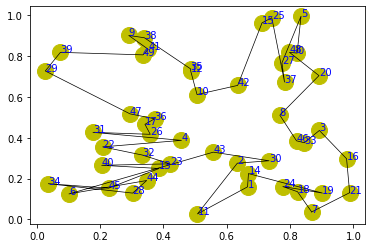

step:1690/5000, actic loss:1.475, critic loss:5.876, L:11.757, 0min1sec
step:1691/5000, actic loss:1.468, critic loss:5.873, L:11.755, 0min1sec
step:1692/5000, actic loss:1.463, critic loss:5.870, L:11.753, 0min1sec
step:1693/5000, actic loss:1.456, critic loss:5.867, L:11.751, 0min1sec
step:1694/5000, actic loss:1.451, critic loss:5.864, L:11.749, 0min1sec
distance:8.554
tensor([26, 43, 34, 17, 13, 24, 40, 39, 44,  8, 31,  9, 22, 11, 32, 45, 48, 27,
        29, 49,  4, 38, 19, 20, 15, 23,  2, 42,  6, 47,  5, 46, 12, 30, 35, 16,
        36, 41, 10,  7, 25, 14,  0,  3, 21,  1, 28, 37, 33, 18])


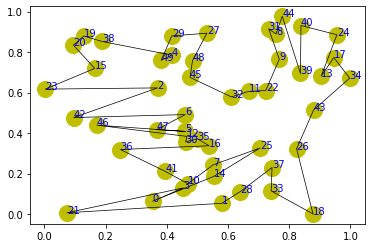

step:1695/5000, actic loss:1.452, critic loss:5.861, L:11.748, 0min1sec
step:1696/5000, actic loss:1.459, critic loss:5.858, L:11.746, 0min1sec
step:1697/5000, actic loss:1.469, critic loss:5.856, L:11.744, 0min1sec
step:1698/5000, actic loss:1.479, critic loss:5.853, L:11.741, 0min1sec
step:1699/5000, actic loss:1.488, critic loss:5.851, L:11.739, 0min1sec
distance:7.801
tensor([37,  8,  6, 14, 40,  9,  0, 30, 43, 11, 23, 18,  3, 42, 46, 36, 22, 33,
        49, 20, 45, 27, 25, 12, 28, 19, 39,  2, 29, 35, 26, 24, 13, 38, 16,  7,
        32, 34, 15,  4,  1,  5, 44, 41, 31, 48, 21, 47, 17, 10])


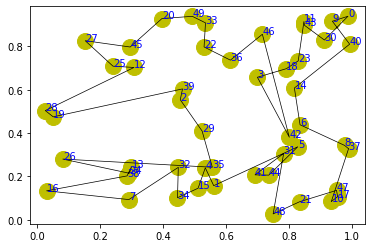

step:1700/5000, actic loss:1.494, critic loss:5.848, L:11.737, 0min2sec
step:1701/5000, actic loss:1.496, critic loss:5.845, L:11.735, 0min2sec
step:1702/5000, actic loss:1.492, critic loss:5.842, L:11.733, 0min1sec
step:1703/5000, actic loss:1.487, critic loss:5.838, L:11.731, 0min1sec
step:1704/5000, actic loss:1.482, critic loss:5.835, L:11.729, 0min1sec
distance:8.802
tensor([10, 29, 27, 35, 21, 11, 34, 16, 37, 18, 48, 31,  9, 13, 32, 22, 46, 38,
        12, 40,  8, 14, 25, 47, 20, 45, 24, 39,  0, 42, 33, 30,  4, 15, 23, 43,
        49,  2,  5, 28,  1, 17,  6,  3, 36,  7, 26, 44, 19, 41])


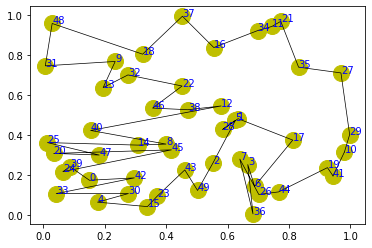

step:1705/5000, actic loss:1.477, critic loss:5.832, L:11.727, 0min1sec
step:1706/5000, actic loss:1.474, critic loss:5.829, L:11.724, 0min1sec
step:1707/5000, actic loss:1.473, critic loss:5.826, L:11.722, 0min1sec
step:1708/5000, actic loss:1.474, critic loss:5.823, L:11.720, 0min1sec
step:1709/5000, actic loss:1.474, critic loss:5.820, L:11.718, 0min1sec
distance:7.975
tensor([42, 14, 46,  2, 12, 27, 35, 19,  8, 39, 32, 45, 17,  9,  5, 23, 13, 24,
        15, 41, 11,  1, 18, 49, 21, 26, 37, 40, 25, 43,  3, 22, 29, 16, 20,  7,
        30, 36, 28, 38,  6,  0,  4, 44, 48, 31, 10, 34, 33, 47])


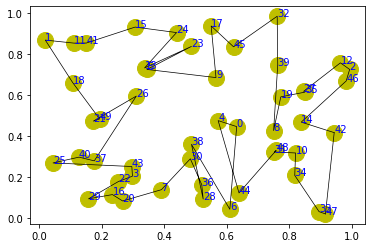

step:1710/5000, actic loss:1.474, critic loss:5.817, L:11.715, 0min1sec
step:1711/5000, actic loss:1.472, critic loss:5.813, L:11.713, 0min1sec
step:1712/5000, actic loss:1.469, critic loss:5.810, L:11.711, 0min1sec
step:1713/5000, actic loss:1.466, critic loss:5.807, L:11.708, 0min1sec
step:1714/5000, actic loss:1.465, critic loss:5.804, L:11.706, 0min1sec
distance:6.490
tensor([22, 31, 46, 33, 20, 40,  1, 48,  5, 14, 41, 49, 43,  7,  8, 23, 13, 15,
         3, 12, 37, 30, 25, 38, 10, 35,  6, 18, 29, 28, 34, 32, 16,  4,  9, 36,
        19, 24,  0, 44, 26, 21, 45, 39, 17, 27, 42, 11,  2, 47])


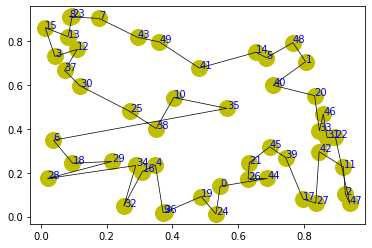

step:1715/5000, actic loss:1.466, critic loss:5.801, L:11.704, 0min1sec
step:1716/5000, actic loss:1.469, critic loss:5.798, L:11.701, 0min1sec
step:1717/5000, actic loss:1.470, critic loss:5.795, L:11.699, 0min1sec
step:1718/5000, actic loss:1.470, critic loss:5.791, L:11.696, 0min1sec
step:1719/5000, actic loss:1.467, critic loss:5.788, L:11.694, 0min1sec
distance:8.264
tensor([21,  3, 19,  6, 23, 42, 12, 18, 35, 25,  8, 24, 48, 47, 46, 38, 44,  9,
        20, 36, 49, 32, 16,  2,  7, 10, 17, 22, 13, 40, 39, 31,  4, 27, 34, 26,
         1, 15, 33,  0, 30, 41, 43, 14, 45, 37,  5, 28, 11, 29])


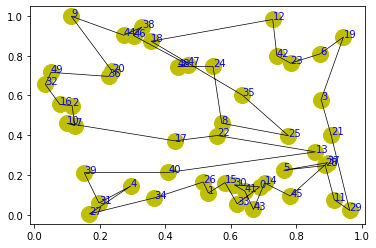

step:1720/5000, actic loss:1.462, critic loss:5.785, L:11.691, 0min1sec
step:1721/5000, actic loss:1.457, critic loss:5.782, L:11.689, 0min1sec
step:1722/5000, actic loss:1.453, critic loss:5.779, L:11.686, 0min1sec
step:1723/5000, actic loss:1.450, critic loss:5.776, L:11.684, 0min1sec
step:1724/5000, actic loss:1.449, critic loss:5.773, L:11.681, 0min1sec
distance:7.113
tensor([29, 23, 22,  8, 36, 41, 19, 16, 42, 37,  3, 38, 18,  0, 21,  9, 20, 14,
        24,  1,  4, 13, 10, 28,  6, 32, 11, 44,  2, 15, 31, 12, 33, 26, 34, 47,
        40, 35, 39, 43, 45,  7, 27,  5, 49, 48, 25, 17, 30, 46])


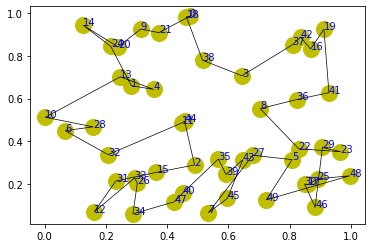

step:1725/5000, actic loss:1.450, critic loss:5.770, L:11.679, 0min1sec
step:1726/5000, actic loss:1.453, critic loss:5.767, L:11.677, 0min1sec
step:1727/5000, actic loss:1.457, critic loss:5.764, L:11.674, 0min1sec
step:1728/5000, actic loss:1.460, critic loss:5.761, L:11.672, 0min1sec
step:1729/5000, actic loss:1.463, critic loss:5.758, L:11.669, 0min1sec
distance:6.951
tensor([ 3, 19, 27,  1, 15, 30, 42,  5, 41, 35, 13,  6, 39, 22, 20, 14, 24, 17,
         4,  8, 23, 18, 47, 10, 44,  7, 26, 25, 40, 37,  0, 34, 48, 12, 29, 32,
        38, 21, 36, 49, 31,  9, 33, 28,  2, 16, 45, 43, 46, 11])


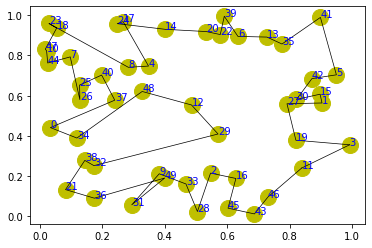

step:1730/5000, actic loss:1.464, critic loss:5.755, L:11.667, 0min1sec
step:1731/5000, actic loss:1.462, critic loss:5.752, L:11.665, 0min1sec
step:1732/5000, actic loss:1.458, critic loss:5.749, L:11.662, 0min1sec
step:1733/5000, actic loss:1.455, critic loss:5.746, L:11.660, 0min1sec
step:1734/5000, actic loss:1.452, critic loss:5.743, L:11.657, 0min1sec
distance:8.083
tensor([34, 17, 43, 25, 26, 21, 13,  5, 46, 24,  0, 11, 20, 41,  4, 16, 12, 38,
         7, 18, 35, 30,  3, 45, 42,  1, 32, 23, 10, 36, 15, 47, 29, 28, 33, 14,
        48, 31,  8, 19, 44,  6, 27,  9, 40, 39, 49,  2, 22, 37])


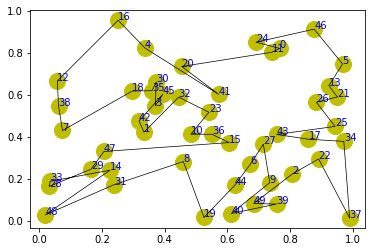

step:1735/5000, actic loss:1.451, critic loss:5.740, L:11.655, 0min1sec
step:1736/5000, actic loss:1.452, critic loss:5.736, L:11.652, 0min1sec
step:1737/5000, actic loss:1.455, critic loss:5.733, L:11.650, 0min1sec
step:1738/5000, actic loss:1.458, critic loss:5.730, L:11.647, 0min1sec
step:1739/5000, actic loss:1.460, critic loss:5.727, L:11.645, 0min1sec
distance:7.006
tensor([24, 18, 22,  7, 16, 30, 32, 21, 31,  5, 37,  8, 27, 44, 25, 12, 11, 33,
        49, 28,  3,  0, 45,  4, 47, 14,  1,  2, 19,  6, 10, 20, 40, 41, 15, 29,
        35, 38,  9, 26, 13, 23, 34, 17, 36, 48, 39, 46, 43, 42])


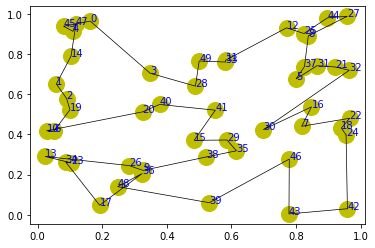

step:1740/5000, actic loss:1.459, critic loss:5.724, L:11.642, 0min1sec
step:1741/5000, actic loss:1.454, critic loss:5.721, L:11.640, 0min1sec
step:1742/5000, actic loss:1.447, critic loss:5.718, L:11.638, 0min1sec
step:1743/5000, actic loss:1.440, critic loss:5.716, L:11.635, 0min1sec
step:1744/5000, actic loss:1.433, critic loss:5.713, L:11.633, 0min1sec
distance:6.971
tensor([39,  3, 10, 15, 22, 24, 18, 37, 23, 44, 41, 49, 33, 12, 47, 45,  8, 30,
        14,  7,  9, 48, 17, 16, 11,  2, 42, 28,  5, 25, 21, 26, 29, 43, 36, 13,
        32,  1, 20,  4, 31, 40, 35,  0, 46,  6, 27, 38, 19, 34])


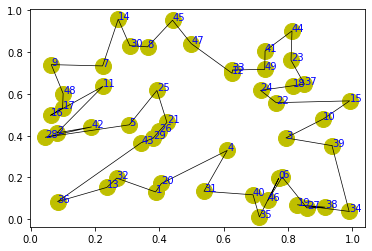

step:1745/5000, actic loss:1.428, critic loss:5.710, L:11.631, 0min1sec
step:1746/5000, actic loss:1.427, critic loss:5.707, L:11.628, 0min1sec
step:1747/5000, actic loss:1.428, critic loss:5.704, L:11.626, 0min1sec
step:1748/5000, actic loss:1.431, critic loss:5.701, L:11.623, 0min1sec
step:1749/5000, actic loss:1.433, critic loss:5.698, L:11.621, 0min1sec
distance:7.413
tensor([13,  6, 15, 36, 28, 38,  8,  3, 39, 11, 26, 44, 46, 45, 43,  1, 27,  4,
         5, 24, 33, 40, 32, 48, 34, 42, 23, 12, 16, 14,  9, 19, 29, 22, 49,  0,
        30, 41, 47, 17, 21, 35, 20, 25, 18,  7,  2, 10, 31, 37])


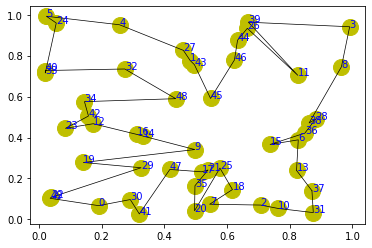

step:1750/5000, actic loss:1.434, critic loss:5.695, L:11.618, 0min1sec
step:1751/5000, actic loss:1.433, critic loss:5.692, L:11.616, 0min1sec
step:1752/5000, actic loss:1.431, critic loss:5.688, L:11.613, 0min1sec
step:1753/5000, actic loss:1.429, critic loss:5.685, L:11.611, 0min1sec
step:1754/5000, actic loss:1.428, critic loss:5.682, L:11.608, 0min1sec
distance:6.795
tensor([41,  7,  9, 32, 48, 10, 37, 33, 42,  6, 27,  3, 17, 13, 20, 38, 30,  8,
         5, 46, 34, 25, 22, 47, 31, 18, 49, 40, 21, 28, 24,  2, 15,  1, 19, 23,
        16, 12, 14, 29, 36, 35, 45, 43, 26,  0, 11,  4, 39, 44])


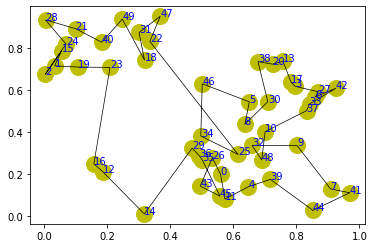

step:1755/5000, actic loss:1.428, critic loss:5.679, L:11.606, 0min2sec
step:1756/5000, actic loss:1.428, critic loss:5.676, L:11.603, 0min2sec
step:1757/5000, actic loss:1.426, critic loss:5.673, L:11.601, 0min1sec
step:1758/5000, actic loss:1.425, critic loss:5.670, L:11.599, 0min1sec
step:1759/5000, actic loss:1.424, critic loss:5.667, L:11.596, 0min1sec
distance:6.875
tensor([ 5, 32, 18,  6, 35, 49, 38, 34,  7,  9, 30, 39, 20, 48,  8, 44, 13, 23,
        27,  3, 14, 36, 37,  2, 29, 28, 43, 41, 47, 46, 31, 15, 12, 42, 17,  1,
         4, 19, 10,  0, 24, 26, 45, 11, 33, 22, 16, 21, 25, 40])


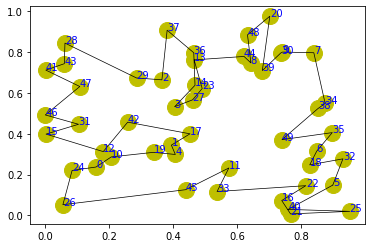

step:1760/5000, actic loss:1.423, critic loss:5.664, L:11.594, 0min1sec
step:1761/5000, actic loss:1.422, critic loss:5.661, L:11.591, 0min1sec
step:1762/5000, actic loss:1.421, critic loss:5.658, L:11.589, 0min1sec
step:1763/5000, actic loss:1.419, critic loss:5.655, L:11.587, 0min1sec
step:1764/5000, actic loss:1.419, critic loss:5.652, L:11.584, 0min1sec
distance:7.499
tensor([19, 24,  9, 49, 29, 46,  5, 47, 14, 43, 20, 34, 25, 32, 35,  1, 21, 28,
        48, 13, 44, 41,  2, 40,  8, 39, 10,  4, 16, 26, 30,  3, 38, 12,  6, 37,
        18, 31, 36, 22, 23, 17, 15, 45, 27, 42, 11,  0, 33,  7])


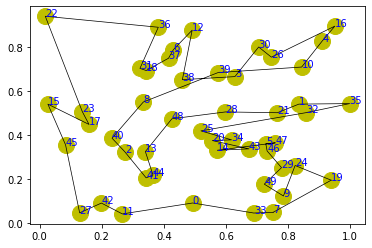

step:1765/5000, actic loss:1.419, critic loss:5.649, L:11.582, 0min1sec
step:1766/5000, actic loss:1.417, critic loss:5.646, L:11.580, 0min1sec
step:1767/5000, actic loss:1.417, critic loss:5.643, L:11.578, 0min1sec
step:1768/5000, actic loss:1.416, critic loss:5.640, L:11.576, 0min1sec
step:1769/5000, actic loss:1.414, critic loss:5.637, L:11.573, 0min1sec
distance:9.997
tensor([41, 26, 11, 48, 39, 36, 45, 17, 25, 18, 24, 10,  2, 49, 34,  6,  1, 35,
        21, 19, 40, 37, 22,  4, 32, 23, 44, 14, 16, 29,  3, 46, 27,  9, 30, 20,
        15, 33, 28, 12, 31, 13, 42,  7,  0,  5, 43,  8, 47, 38])


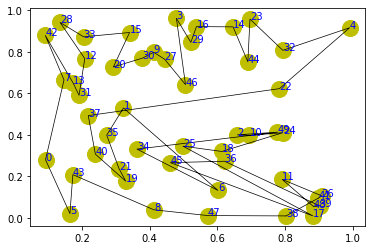

step:1770/5000, actic loss:1.412, critic loss:5.634, L:11.571, 0min2sec
step:1771/5000, actic loss:1.410, critic loss:5.631, L:11.569, 0min2sec
step:1772/5000, actic loss:1.407, critic loss:5.628, L:11.567, 0min1sec
step:1773/5000, actic loss:1.405, critic loss:5.625, L:11.565, 0min1sec
step:1774/5000, actic loss:1.404, critic loss:5.623, L:11.563, 0min1sec
distance:7.193
tensor([17, 49,  4, 25, 36, 16, 41,  2, 24, 34,  1,  5, 19, 18,  7, 10, 13, 12,
        45, 48, 22, 40, 46, 42, 15, 11, 32, 21, 44,  8, 35, 31, 38, 37, 29, 39,
        28,  0, 43, 33, 20, 26,  6, 14, 30, 27,  3, 23, 47,  9])


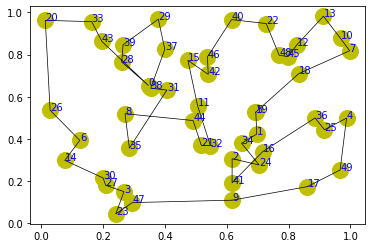

step:1775/5000, actic loss:1.405, critic loss:5.620, L:11.560, 0min1sec
step:1776/5000, actic loss:1.407, critic loss:5.617, L:11.558, 0min1sec
step:1777/5000, actic loss:1.410, critic loss:5.614, L:11.556, 0min1sec
step:1778/5000, actic loss:1.412, critic loss:5.611, L:11.554, 0min1sec
step:1779/5000, actic loss:1.414, critic loss:5.608, L:11.552, 0min1sec
distance:7.737
tensor([19, 13, 23,  3, 36, 35,  2, 17, 18, 25, 30, 20, 31, 32, 48, 10, 47, 14,
        34, 16,  8, 33, 15, 42, 49, 27, 45, 43, 22,  5, 12, 11, 26, 38,  9,  1,
        44, 29, 41, 39, 21,  4,  0, 40, 28, 46,  7, 24, 37,  6])


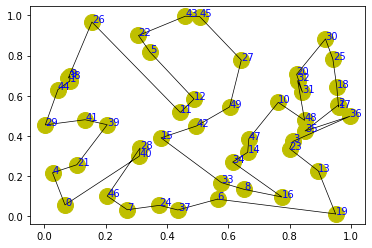

step:1780/5000, actic loss:1.413, critic loss:5.605, L:11.550, 0min1sec
step:1781/5000, actic loss:1.411, critic loss:5.603, L:11.547, 0min1sec
step:1782/5000, actic loss:1.408, critic loss:5.600, L:11.545, 0min1sec
step:1783/5000, actic loss:1.402, critic loss:5.597, L:11.543, 0min1sec
step:1784/5000, actic loss:1.395, critic loss:5.594, L:11.541, 0min1sec
distance:7.722
tensor([48, 45, 14, 26, 38, 44, 11, 34, 21, 49, 35,  3, 28,  0, 41, 33, 25,  4,
        13,  7, 36, 18, 47, 20, 19, 46, 15, 32, 43, 16,  1, 30, 39, 23, 24, 27,
        42, 29, 31,  9, 12, 40,  6, 22,  2, 17,  8, 37, 10,  5])


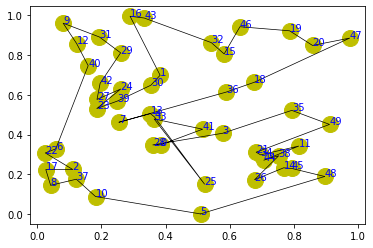

step:1785/5000, actic loss:1.388, critic loss:5.592, L:11.539, 0min2sec
step:1786/5000, actic loss:1.380, critic loss:5.590, L:11.537, 0min1sec
step:1787/5000, actic loss:1.371, critic loss:5.587, L:11.535, 0min1sec
step:1788/5000, actic loss:1.365, critic loss:5.585, L:11.533, 0min1sec
step:1789/5000, actic loss:1.361, critic loss:5.582, L:11.532, 0min1sec
distance:8.462
tensor([ 0, 37, 30, 14, 12, 22, 31, 29, 10, 45,  1,  2, 47, 26, 43, 32,  3, 33,
        28, 17, 13,  8, 48, 36,  6, 27, 18,  7, 34, 39, 41,  9,  5, 24, 20, 19,
         4, 16, 11, 38, 21, 46, 42, 49, 23, 25, 15, 35, 44, 40])


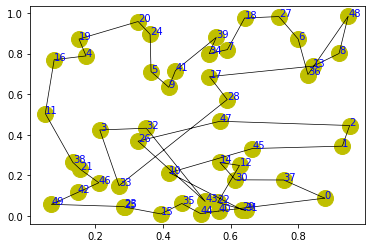

step:1790/5000, actic loss:1.365, critic loss:5.579, L:11.530, 0min1sec
step:1791/5000, actic loss:1.374, critic loss:5.578, L:11.528, 0min1sec
step:1792/5000, actic loss:1.387, critic loss:5.576, L:11.527, 0min1sec
step:1793/5000, actic loss:1.401, critic loss:5.575, L:11.525, 0min1sec
step:1794/5000, actic loss:1.416, critic loss:5.574, L:11.523, 0min1sec
distance:7.995
tensor([36, 23,  5, 42, 39, 19, 45, 24, 14, 30, 18, 17, 47, 44, 21, 20,  8, 12,
         1, 11, 13, 35, 28,  0, 27, 37, 31, 33, 26, 16, 46,  9, 40, 41,  4,  3,
         7, 15, 10, 34, 49, 29, 48, 22, 38,  2, 32, 25, 43,  6])


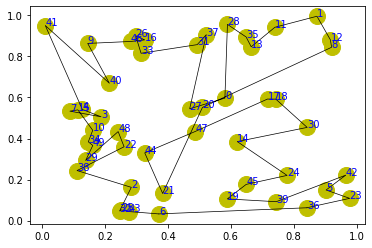

step:1795/5000, actic loss:1.429, critic loss:5.573, L:11.521, 0min1sec
step:1796/5000, actic loss:1.441, critic loss:5.571, L:11.519, 0min1sec
step:1797/5000, actic loss:1.447, critic loss:5.569, L:11.518, 0min1sec
step:1798/5000, actic loss:1.446, critic loss:5.566, L:11.516, 0min1sec
step:1799/5000, actic loss:1.440, critic loss:5.564, L:11.514, 0min1sec
distance:8.114
tensor([45, 35, 19, 40, 36,  1, 28, 29, 25, 24, 37, 46,  0, 48, 13, 39, 11, 41,
        26, 14, 38,  8, 43,  3, 23, 20, 17, 21, 42,  7, 31,  9,  4, 18,  2, 34,
        33, 49,  5, 16, 30, 44, 22, 47,  6, 32, 15, 12, 10, 27])


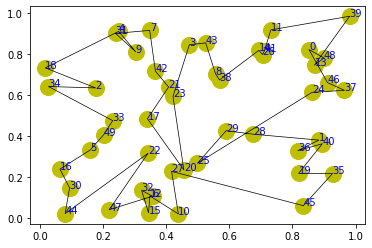

step:1800/5000, actic loss:1.433, critic loss:5.561, L:11.513, 0min1sec
step:1801/5000, actic loss:1.425, critic loss:5.559, L:11.511, 0min1sec
step:1802/5000, actic loss:1.417, critic loss:5.556, L:11.509, 0min1sec
step:1803/5000, actic loss:1.410, critic loss:5.554, L:11.508, 0min1sec
step:1804/5000, actic loss:1.405, critic loss:5.551, L:11.506, 0min1sec
distance:8.182
tensor([20, 14, 36,  2,  7,  3, 47,  1, 13, 39, 11, 30, 43, 27, 41,  4, 17, 35,
        22,  8, 24, 10, 28, 26, 37,  6, 23,  5, 44, 19, 12, 34, 48, 42,  9, 32,
        18, 38,  0, 45, 33, 16, 25, 29, 31, 15, 21, 40, 46, 49])


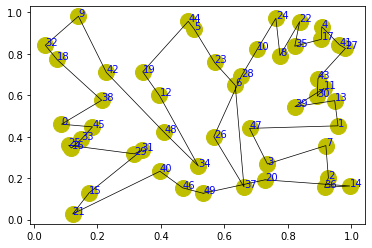

step:1805/5000, actic loss:1.404, critic loss:5.548, L:11.504, 0min1sec
step:1806/5000, actic loss:1.407, critic loss:5.546, L:11.502, 0min1sec
step:1807/5000, actic loss:1.413, critic loss:5.543, L:11.500, 0min1sec
step:1808/5000, actic loss:1.418, critic loss:5.541, L:11.498, 0min1sec
step:1809/5000, actic loss:1.425, critic loss:5.539, L:11.496, 0min1sec
distance:7.293
tensor([34,  0, 39, 40, 24, 36, 45,  3,  4, 27, 46, 38,  7, 47, 37,  6, 44, 30,
        33,  5, 17, 10, 19, 11, 29,  1, 15,  9, 21, 12, 31, 25, 16, 23, 42, 14,
        22, 32, 26, 13, 18, 43, 41, 35,  2, 48, 28, 49,  8, 20])


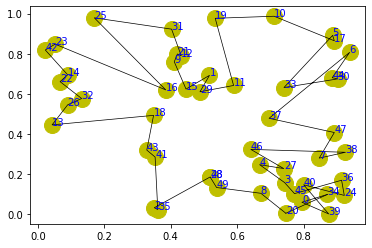

step:1810/5000, actic loss:1.431, critic loss:5.536, L:11.494, 0min1sec
step:1811/5000, actic loss:1.434, critic loss:5.534, L:11.492, 0min1sec
step:1812/5000, actic loss:1.433, critic loss:5.531, L:11.490, 0min1sec
step:1813/5000, actic loss:1.429, critic loss:5.528, L:11.488, 0min1sec
step:1814/5000, actic loss:1.424, critic loss:5.525, L:11.486, 0min1sec
distance:8.263
tensor([ 5, 48, 16,  9, 14, 35, 29, 17, 27, 30, 21, 28,  0,  8,  3, 31, 37, 36,
        34, 39, 25, 18, 15, 32, 13, 47, 12, 33, 10,  1, 42,  6, 19, 26, 24, 40,
         2, 23, 44,  4, 49, 41, 20, 46, 11, 38,  7, 22, 45, 43])


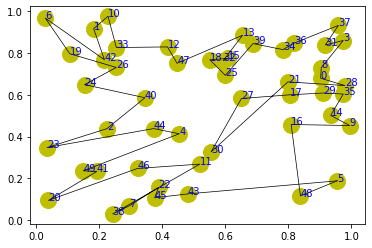

step:1815/5000, actic loss:1.421, critic loss:5.522, L:11.484, 0min1sec
step:1816/5000, actic loss:1.420, critic loss:5.520, L:11.482, 0min1sec
step:1817/5000, actic loss:1.422, critic loss:5.517, L:11.480, 0min1sec
step:1818/5000, actic loss:1.426, critic loss:5.514, L:11.478, 0min1sec
step:1819/5000, actic loss:1.427, critic loss:5.511, L:11.475, 0min1sec
distance:8.649
tensor([16,  2, 23, 43, 40, 28, 11, 18,  4, 38, 42, 37,  7, 17,  6,  0, 25, 39,
         5, 10, 34,  3, 36, 26, 30, 46, 19, 44, 33,  8, 49, 15, 35, 41, 22, 31,
        32, 13, 47, 48, 20, 24, 29, 14, 21, 27,  9,  1, 12, 45])


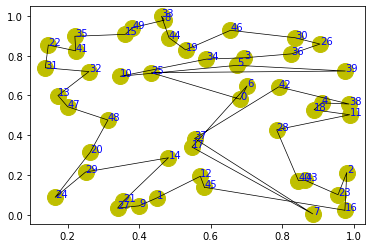

step:1820/5000, actic loss:1.426, critic loss:5.509, L:11.473, 0min1sec
step:1821/5000, actic loss:1.425, critic loss:5.506, L:11.471, 0min1sec
step:1822/5000, actic loss:1.422, critic loss:5.503, L:11.469, 0min1sec
step:1823/5000, actic loss:1.420, critic loss:5.500, L:11.467, 0min1sec
step:1824/5000, actic loss:1.419, critic loss:5.497, L:11.465, 0min1sec
distance:7.068
tensor([21, 18, 33,  1, 29, 32,  2, 16,  9, 35, 10, 49, 45, 11, 22, 31, 40, 25,
        26, 24,  8, 44,  4, 27, 34,  7, 38, 42, 14,  0, 28, 23, 39, 30, 37, 36,
        12,  6, 41, 48, 43, 17,  3, 15, 47, 19, 13, 20, 46,  5])


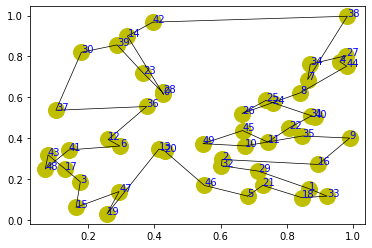

step:1825/5000, actic loss:1.420, critic loss:5.494, L:11.462, 0min1sec
step:1826/5000, actic loss:1.421, critic loss:5.492, L:11.460, 0min1sec
step:1827/5000, actic loss:1.421, critic loss:5.489, L:11.458, 0min1sec
step:1828/5000, actic loss:1.419, critic loss:5.486, L:11.456, 0min1sec
step:1829/5000, actic loss:1.416, critic loss:5.483, L:11.453, 0min1sec
distance:7.873
tensor([32,  6, 10, 48, 37,  2, 39, 23, 14,  8,  0, 43, 30, 44, 45, 19, 42, 16,
        21, 11, 28, 35,  1, 15,  4, 12, 36, 41, 13, 25,  5, 47, 31, 24, 46,  3,
        29, 40, 33, 49, 20,  9, 26, 27, 17, 18, 38, 22,  7, 34])


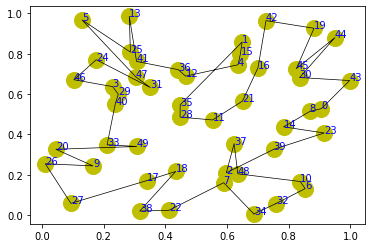

step:1830/5000, actic loss:1.415, critic loss:5.480, L:11.451, 0min1sec
step:1831/5000, actic loss:1.415, critic loss:5.478, L:11.449, 0min1sec
step:1832/5000, actic loss:1.415, critic loss:5.475, L:11.447, 0min1sec
step:1833/5000, actic loss:1.415, critic loss:5.472, L:11.445, 0min1sec
step:1834/5000, actic loss:1.412, critic loss:5.469, L:11.442, 0min1sec
distance:8.289
tensor([48, 17, 23, 46,  5, 22, 21, 40, 27, 34, 24, 49, 42, 14, 26,  2, 29,  0,
        37, 20, 47,  9, 16, 41, 25, 36, 31, 11, 39, 12, 45,  6, 43, 35, 13, 28,
        33, 18,  4,  1, 15,  7, 32,  8, 38, 30, 10, 44,  3, 19])


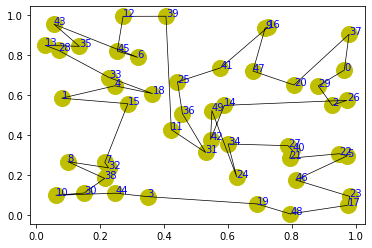

step:1835/5000, actic loss:1.410, critic loss:5.466, L:11.440, 0min1sec
step:1836/5000, actic loss:1.409, critic loss:5.464, L:11.438, 0min1sec
step:1837/5000, actic loss:1.409, critic loss:5.461, L:11.436, 0min1sec
step:1838/5000, actic loss:1.410, critic loss:5.458, L:11.434, 0min1sec
step:1839/5000, actic loss:1.409, critic loss:5.455, L:11.431, 0min1sec
distance:7.816
tensor([23,  7, 37, 36, 10, 34, 19,  2, 44, 22, 39, 46, 25,  5, 42, 45,  0, 31,
        16, 35, 28, 49, 30, 33,  4,  1, 24, 11, 40, 38, 15, 13, 41,  3, 29,  9,
        21, 48, 17,  6, 20,  8, 12, 32, 26, 47, 18, 14, 43, 27])


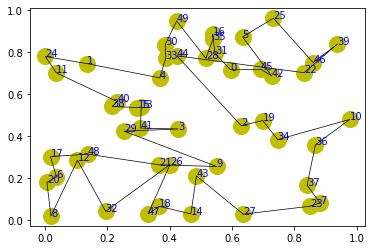

step:1840/5000, actic loss:1.407, critic loss:5.452, L:11.429, 0min1sec
step:1841/5000, actic loss:1.406, critic loss:5.449, L:11.427, 0min1sec
step:1842/5000, actic loss:1.404, critic loss:5.447, L:11.425, 0min1sec
step:1843/5000, actic loss:1.404, critic loss:5.444, L:11.422, 0min1sec
step:1844/5000, actic loss:1.404, critic loss:5.441, L:11.420, 0min1sec
distance:7.101
tensor([ 3, 39, 37, 38,  4, 40, 47, 10, 33, 41,  1,  0, 32, 15, 46, 29, 17, 14,
        48,  8, 25, 20,  2, 21, 24, 36, 18,  5, 43, 28, 11, 42, 12, 30, 49, 35,
        26, 44, 16, 22, 27, 13, 31, 19, 34,  6,  9, 45, 23,  7])


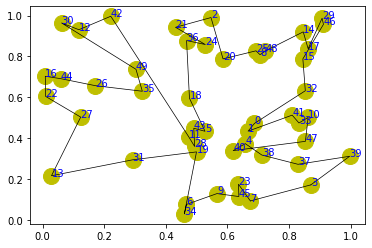

step:1845/5000, actic loss:1.404, critic loss:5.438, L:11.418, 0min1sec
step:1846/5000, actic loss:1.402, critic loss:5.436, L:11.416, 0min1sec
step:1847/5000, actic loss:1.400, critic loss:5.433, L:11.414, 0min1sec
step:1848/5000, actic loss:1.398, critic loss:5.430, L:11.411, 0min1sec
step:1849/5000, actic loss:1.398, critic loss:5.427, L:11.409, 0min1sec
distance:7.709
tensor([34, 13, 31, 26,  4,  8, 24, 21, 23, 39, 11,  6, 44, 17, 18, 36,  7, 33,
        25, 42, 10, 35,  2,  9, 19, 29, 46,  5, 16, 30, 47, 20,  3, 45, 43,  0,
        28, 15, 49, 40, 41, 14, 22, 37, 32, 48, 38,  1, 12, 27])


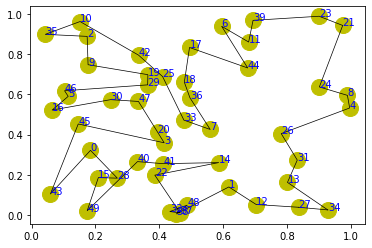

step:1850/5000, actic loss:1.397, critic loss:5.425, L:11.407, 0min1sec
step:1851/5000, actic loss:1.396, critic loss:5.422, L:11.405, 0min1sec
step:1852/5000, actic loss:1.394, critic loss:5.419, L:11.403, 0min1sec
step:1853/5000, actic loss:1.390, critic loss:5.416, L:11.401, 0min1sec
step:1854/5000, actic loss:1.389, critic loss:5.414, L:11.399, 0min1sec
distance:6.533
tensor([31, 38,  7,  3, 34, 18, 16, 30, 19, 36, 35, 42, 28, 22, 21,  4, 32, 47,
         5, 13, 41, 14, 39, 11,  0, 17,  6, 27, 15, 10, 45, 12, 23, 49, 37, 25,
        29,  2,  8, 20, 33,  9, 43, 24, 48, 40, 26, 44,  1, 46])


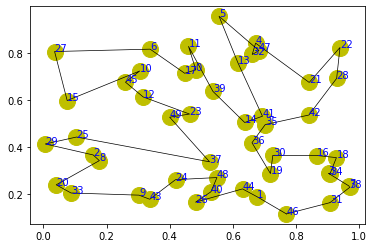

step:1855/5000, actic loss:1.388, critic loss:5.411, L:11.396, 0min1sec
step:1856/5000, actic loss:1.388, critic loss:5.408, L:11.394, 0min1sec
step:1857/5000, actic loss:1.387, critic loss:5.406, L:11.392, 0min1sec
step:1858/5000, actic loss:1.386, critic loss:5.403, L:11.390, 0min2sec
step:1859/5000, actic loss:1.384, critic loss:5.400, L:11.389, 0min2sec
distance:8.867
tensor([31, 34, 47,  8,  6, 24, 49,  2, 13, 33,  9, 21, 15, 19,  0, 43, 26, 48,
         4, 29, 23, 27, 35, 30, 42, 41, 39, 14,  5, 45,  7, 17, 36, 28, 12, 46,
        20, 25, 16, 11, 44, 38, 18, 40,  1, 32, 22, 10,  3, 37])


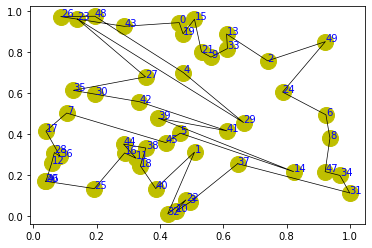

step:1860/5000, actic loss:1.384, critic loss:5.398, L:11.387, 0min2sec
step:1861/5000, actic loss:1.384, critic loss:5.395, L:11.385, 0min1sec
step:1862/5000, actic loss:1.383, critic loss:5.392, L:11.383, 0min1sec
step:1863/5000, actic loss:1.381, critic loss:5.389, L:11.380, 0min1sec
step:1864/5000, actic loss:1.381, critic loss:5.387, L:11.378, 0min1sec
distance:7.072
tensor([ 9, 34, 33, 39, 45,  6,  7, 18, 36, 47, 31, 22, 30,  0, 43, 41, 44,  4,
        11, 23, 37, 20,  5, 35, 19, 40, 49,  1, 14,  3, 27, 38, 16,  2, 26, 25,
        21, 15, 28, 12, 48, 24, 10,  8, 13, 32, 29, 46, 17, 42])


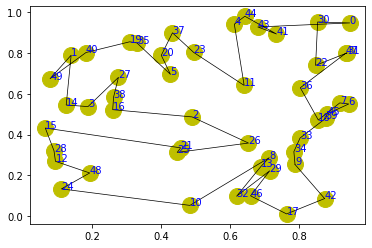

step:1865/5000, actic loss:1.381, critic loss:5.384, L:11.376, 0min1sec
step:1866/5000, actic loss:1.380, critic loss:5.381, L:11.374, 0min1sec
step:1867/5000, actic loss:1.377, critic loss:5.379, L:11.372, 0min1sec
step:1868/5000, actic loss:1.372, critic loss:5.376, L:11.370, 0min1sec
step:1869/5000, actic loss:1.368, critic loss:5.374, L:11.368, 0min1sec
distance:8.449
tensor([49, 29, 48, 25, 41, 40, 38, 12, 17, 46, 37, 16,  1, 33,  9, 42, 35, 39,
        24, 31, 44, 47,  2, 27,  8,  3,  5, 20,  6,  4,  0, 11, 15, 43, 19, 14,
         7, 13, 30, 10, 26, 23, 28, 34, 45, 32, 22, 18, 36, 21])


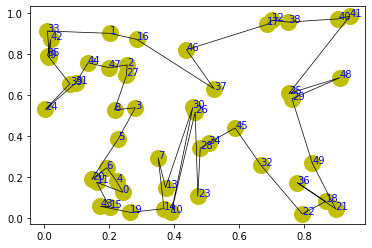

step:1870/5000, actic loss:1.365, critic loss:5.371, L:11.366, 0min1sec
step:1871/5000, actic loss:1.362, critic loss:5.368, L:11.364, 0min1sec
step:1872/5000, actic loss:1.362, critic loss:5.366, L:11.362, 0min1sec
step:1873/5000, actic loss:1.361, critic loss:5.363, L:11.361, 0min1sec
step:1874/5000, actic loss:1.361, critic loss:5.361, L:11.359, 0min1sec
distance:8.244
tensor([18, 22, 29, 36, 48,  8,  1,  2, 46, 32, 15, 12, 17,  4, 28, 35, 23, 14,
        34, 21,  0, 24, 16, 30, 45,  5, 47, 11, 10, 44, 37, 27, 40, 42, 31, 49,
        25,  6, 26, 20,  7,  3, 13, 43, 38, 39, 41, 19,  9, 33])


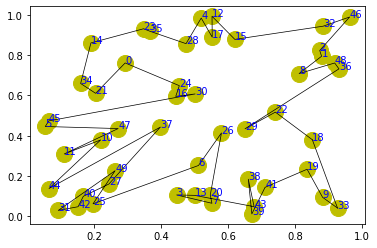

step:1875/5000, actic loss:1.361, critic loss:5.358, L:11.357, 0min2sec
step:1876/5000, actic loss:1.361, critic loss:5.355, L:11.355, 0min1sec
step:1877/5000, actic loss:1.359, critic loss:5.353, L:11.353, 0min1sec
step:1878/5000, actic loss:1.355, critic loss:5.350, L:11.351, 0min1sec
step:1879/5000, actic loss:1.352, critic loss:5.347, L:11.349, 0min1sec
distance:7.127
tensor([ 9, 30, 43, 35, 45, 14, 23,  2,  0, 21,  5, 15, 46, 37, 22, 13, 10, 25,
        27, 24, 26, 44, 17, 48, 31,  6, 12,  1, 38, 18, 33, 42, 41,  7, 34, 47,
         8, 20, 39, 40, 32, 11, 19, 49, 29, 36,  3, 16,  4, 28])


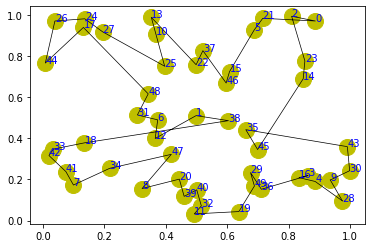

step:1880/5000, actic loss:1.350, critic loss:5.345, L:11.347, 0min1sec
step:1881/5000, actic loss:1.350, critic loss:5.342, L:11.345, 0min1sec
step:1882/5000, actic loss:1.351, critic loss:5.340, L:11.343, 0min1sec
step:1883/5000, actic loss:1.351, critic loss:5.337, L:11.341, 0min1sec
step:1884/5000, actic loss:1.351, critic loss:5.334, L:11.339, 0min1sec
distance:7.616
tensor([22, 36, 19, 26,  1, 43, 44, 40, 45,  7, 34, 10, 12, 48, 25,  4, 21, 14,
        41,  0, 33,  6, 29, 23, 11,  2, 38, 32, 18, 13, 16, 28, 27, 46, 35, 24,
        42,  5,  9,  3, 47, 39, 17,  8, 15, 31, 30, 20, 37, 49])


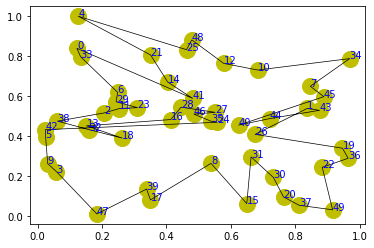

step:1885/5000, actic loss:1.349, critic loss:5.332, L:11.337, 0min1sec
step:1886/5000, actic loss:1.346, critic loss:5.329, L:11.335, 0min1sec
step:1887/5000, actic loss:1.343, critic loss:5.326, L:11.333, 0min1sec
step:1888/5000, actic loss:1.340, critic loss:5.324, L:11.331, 0min1sec
step:1889/5000, actic loss:1.340, critic loss:5.321, L:11.329, 0min1sec
distance:7.951
tensor([11, 38, 42,  6, 34, 23, 24, 25, 36, 19,  1, 31,  9, 40, 30, 32, 45, 48,
        10, 15, 21,  0, 28, 33, 47, 26, 14, 44,  4, 17, 16, 18, 43,  3, 37, 22,
         5, 39, 41, 27, 46, 49, 20, 35,  2, 29, 13,  8,  7, 12])


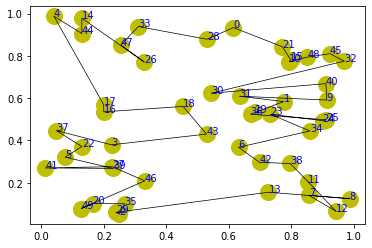

step:1890/5000, actic loss:1.340, critic loss:5.319, L:11.327, 0min2sec
step:1891/5000, actic loss:1.341, critic loss:5.316, L:11.325, 0min1sec
step:1892/5000, actic loss:1.340, critic loss:5.313, L:11.323, 0min1sec
step:1893/5000, actic loss:1.338, critic loss:5.311, L:11.321, 0min1sec
step:1894/5000, actic loss:1.335, critic loss:5.308, L:11.319, 0min1sec
distance:7.358
tensor([18, 14, 27, 16, 41, 44, 24,  7,  8, 39, 25, 38, 19, 36, 30, 29,  2, 10,
         1, 11, 28,  6, 49, 43,  5, 42, 22,  0,  3, 40,  4, 31, 48, 26, 17, 34,
         9, 12, 47, 21, 46, 15, 35, 45, 37, 13, 33, 20, 32, 23])


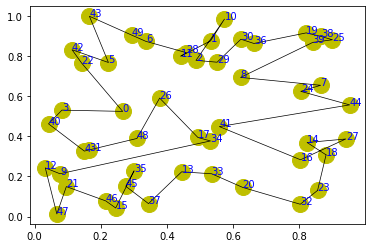

step:1895/5000, actic loss:1.333, critic loss:5.306, L:11.317, 0min1sec
step:1896/5000, actic loss:1.330, critic loss:5.303, L:11.315, 0min1sec
step:1897/5000, actic loss:1.330, critic loss:5.300, L:11.313, 0min1sec
step:1898/5000, actic loss:1.332, critic loss:5.298, L:11.311, 0min1sec
step:1899/5000, actic loss:1.333, critic loss:5.295, L:11.309, 0min1sec
distance:6.503
tensor([18, 27,  1, 42,  9, 12,  3, 25, 20, 37, 31, 15, 32, 39, 38, 44, 19, 47,
        33, 48, 29,  0, 28, 49, 26, 46,  6, 22, 23,  7,  4, 16, 30, 35, 45, 13,
        17, 40, 24, 36,  5, 14, 43,  2, 41, 10,  8, 21, 11, 34])


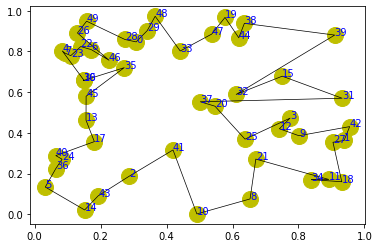

step:1900/5000, actic loss:1.333, critic loss:5.293, L:11.307, 0min1sec
step:1901/5000, actic loss:1.332, critic loss:5.290, L:11.305, 0min1sec
step:1902/5000, actic loss:1.331, critic loss:5.287, L:11.302, 0min1sec
step:1903/5000, actic loss:1.330, critic loss:5.285, L:11.300, 0min1sec
step:1904/5000, actic loss:1.329, critic loss:5.282, L:11.298, 0min1sec
distance:7.632
tensor([36, 34, 44, 46, 26, 15, 17, 21, 43, 16, 48,  8, 28, 10, 18,  3,  1, 42,
        45, 24,  5, 27, 35,  2, 19, 23, 38, 29, 39,  0, 31, 11, 33, 14, 22, 41,
        40, 30,  7, 12,  9, 47, 25, 37,  4, 20, 13,  6, 32, 49])


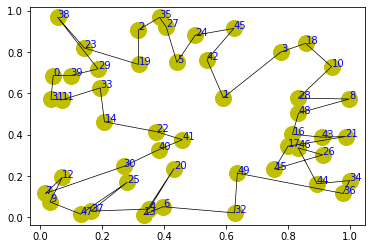

step:1905/5000, actic loss:1.329, critic loss:5.279, L:11.296, 0min1sec
step:1906/5000, actic loss:1.328, critic loss:5.277, L:11.294, 0min1sec
step:1907/5000, actic loss:1.327, critic loss:5.274, L:11.292, 0min1sec
step:1908/5000, actic loss:1.324, critic loss:5.271, L:11.289, 0min1sec
step:1909/5000, actic loss:1.324, critic loss:5.269, L:11.287, 0min1sec
distance:6.443
tensor([30, 44,  1, 43, 29, 24, 40, 14, 36, 45, 38, 12, 22, 28, 49, 32, 34, 17,
         7, 35,  9, 10,  6, 37,  0, 16,  4, 46, 47, 31, 26, 42, 25, 21, 18, 23,
        33, 13, 15, 41, 48, 19,  5, 11,  3,  8,  2, 20, 27, 39])


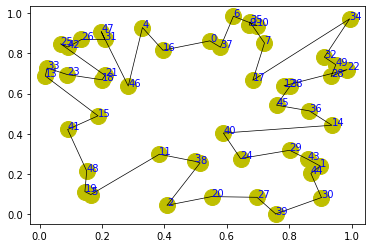

step:1910/5000, actic loss:1.323, critic loss:5.266, L:11.285, 0min1sec
step:1911/5000, actic loss:1.322, critic loss:5.264, L:11.283, 0min1sec
step:1912/5000, actic loss:1.321, critic loss:5.261, L:11.281, 0min1sec
step:1913/5000, actic loss:1.321, critic loss:5.258, L:11.279, 0min1sec
step:1914/5000, actic loss:1.320, critic loss:5.256, L:11.276, 0min1sec
distance:6.198
tensor([ 7, 26, 18, 31,  0, 11,  1, 45, 40, 49, 33, 44, 19,  9, 27, 46, 24, 25,
         4, 47, 20, 21,  8, 22, 32, 15,  6, 34,  3, 13, 36, 23, 37, 16, 43, 12,
         2, 29, 35, 48, 30, 39, 17, 10, 42, 28, 38, 41, 14,  5])


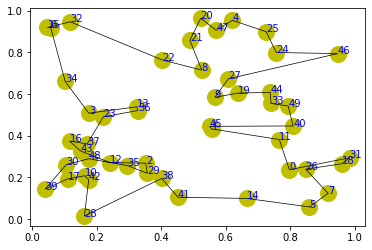

step:1915/5000, actic loss:1.319, critic loss:5.253, L:11.274, 0min1sec
step:1916/5000, actic loss:1.318, critic loss:5.251, L:11.272, 0min1sec
step:1917/5000, actic loss:1.317, critic loss:5.248, L:11.270, 0min1sec
step:1918/5000, actic loss:1.317, critic loss:5.245, L:11.268, 0min1sec
step:1919/5000, actic loss:1.316, critic loss:5.243, L:11.266, 0min1sec
distance:7.269
tensor([13, 20, 29, 22, 10, 24,  4, 44, 38, 40, 35,  5, 19, 28, 48, 37,  7, 31,
        49, 36, 25,  9, 14, 23, 15, 43, 41, 34, 21, 27, 30, 17, 45, 33,  0, 12,
         2, 46, 32, 16, 39, 18, 47,  6,  3, 42,  8, 26,  1, 11])


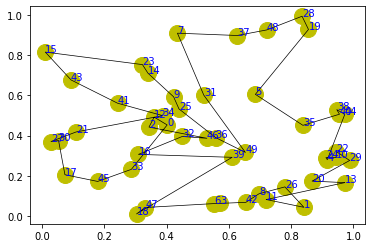

step:1920/5000, actic loss:1.314, critic loss:5.240, L:11.263, 0min1sec
step:1921/5000, actic loss:1.314, critic loss:5.238, L:11.261, 0min1sec
step:1922/5000, actic loss:1.313, critic loss:5.235, L:11.259, 0min1sec
step:1923/5000, actic loss:1.312, critic loss:5.232, L:11.257, 0min1sec
step:1924/5000, actic loss:1.310, critic loss:5.230, L:11.255, 0min1sec
distance:6.966
tensor([46, 35, 22, 32,  3, 15, 10,  5, 24,  2, 49, 29, 44, 21, 41, 20, 23, 39,
        13, 17,  7,  4, 48, 34, 38, 18, 31, 40, 47, 14, 25, 27, 26, 36, 30, 16,
         9, 45, 33, 37, 43,  6,  0,  8, 19,  1, 28, 11, 42, 12])


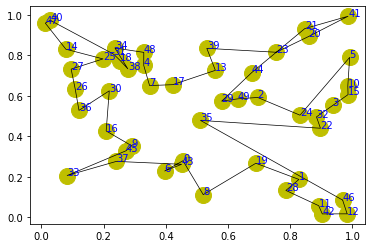

step:1925/5000, actic loss:1.309, critic loss:5.227, L:11.253, 0min1sec
step:1926/5000, actic loss:1.309, critic loss:5.225, L:11.251, 0min1sec
step:1927/5000, actic loss:1.308, critic loss:5.222, L:11.249, 0min1sec
step:1928/5000, actic loss:1.307, critic loss:5.220, L:11.247, 0min1sec
step:1929/5000, actic loss:1.307, critic loss:5.217, L:11.245, 0min1sec
distance:6.607
tensor([28,  8, 27, 32, 18,  6, 45, 43, 13, 26, 17, 34, 24, 31, 44, 21, 39,  7,
         3,  5, 46, 48, 16, 49, 12, 14, 30, 35, 22, 19,  0, 20, 23, 41, 29,  9,
        40,  1, 25,  2, 11, 38, 47, 42,  4, 15, 37, 36, 33, 10])


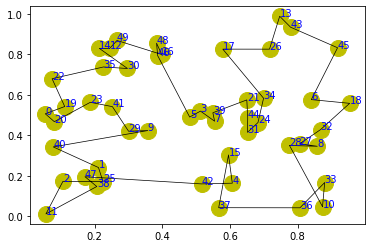

step:1930/5000, actic loss:1.307, critic loss:5.215, L:11.243, 0min2sec
step:1931/5000, actic loss:1.307, critic loss:5.212, L:11.241, 0min1sec
step:1932/5000, actic loss:1.306, critic loss:5.210, L:11.239, 0min1sec
step:1933/5000, actic loss:1.304, critic loss:5.207, L:11.237, 0min1sec
step:1934/5000, actic loss:1.301, critic loss:5.205, L:11.234, 0min1sec
distance:7.754
tensor([ 6, 40, 37,  0, 46, 28, 26, 23, 36, 13, 17,  4, 16, 38, 32, 20, 22,  1,
        15, 45, 29,  2, 14, 19, 25, 18,  8,  9, 10, 43, 27, 31, 30, 49, 24, 39,
        11, 48,  7, 33, 42, 21, 34, 44,  5, 41,  3, 12, 35, 47])


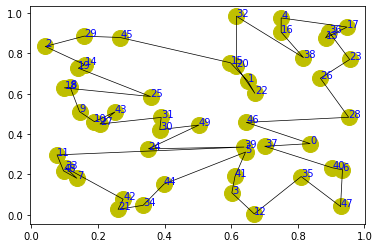

step:1935/5000, actic loss:1.298, critic loss:5.202, L:11.232, 0min1sec
step:1936/5000, actic loss:1.295, critic loss:5.200, L:11.230, 0min1sec
step:1937/5000, actic loss:1.294, critic loss:5.197, L:11.228, 0min1sec
step:1938/5000, actic loss:1.294, critic loss:5.195, L:11.226, 0min1sec
step:1939/5000, actic loss:1.294, critic loss:5.192, L:11.224, 0min1sec
distance:7.646
tensor([ 7, 20, 18, 33, 37, 13, 40, 25, 35, 26, 48, 24, 21, 12, 29, 43,  6, 10,
         1, 31, 36, 32, 14, 39, 41, 49, 34, 23, 46, 47, 22, 19, 16,  9,  5, 44,
        30,  8, 42,  3, 11,  4, 28, 15, 17, 45, 38,  0,  2, 27])


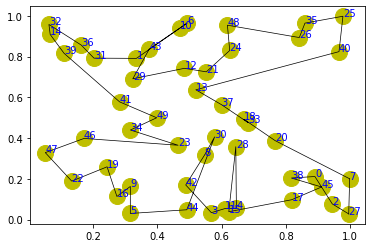

step:1940/5000, actic loss:1.295, critic loss:5.190, L:11.222, 0min1sec
step:1941/5000, actic loss:1.295, critic loss:5.187, L:11.220, 0min1sec
step:1942/5000, actic loss:1.294, critic loss:5.185, L:11.218, 0min1sec
step:1943/5000, actic loss:1.292, critic loss:5.182, L:11.216, 0min1sec
step:1944/5000, actic loss:1.290, critic loss:5.180, L:11.214, 0min1sec
distance:7.582
tensor([ 5, 18, 40, 27, 14,  9, 42, 11,  1, 17, 19,  3, 43, 21, 30, 45,  0, 32,
         8, 22, 44,  6, 16, 35, 13, 10, 37, 29, 49, 31, 20, 15, 36, 39, 38, 41,
        33,  7, 24, 25, 34, 46, 12, 48, 47,  2,  4, 26, 28, 23])


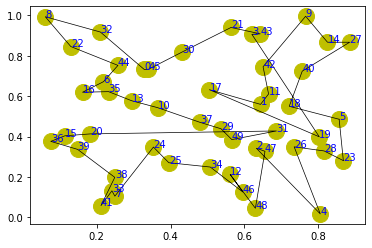

step:1945/5000, actic loss:1.288, critic loss:5.177, L:11.212, 0min1sec
step:1946/5000, actic loss:1.289, critic loss:5.175, L:11.210, 0min1sec
step:1947/5000, actic loss:1.290, critic loss:5.172, L:11.208, 0min1sec
step:1948/5000, actic loss:1.292, critic loss:5.170, L:11.207, 0min1sec
step:1949/5000, actic loss:1.292, critic loss:5.167, L:11.205, 0min1sec
distance:7.647
tensor([34, 22, 46, 19, 27, 14, 13, 17, 36, 26, 31, 44, 11,  2, 43,  8,  5, 35,
        20,  6, 33, 23, 47, 25, 32, 40, 24,  3, 29, 48, 12, 38, 15,  9,  4, 10,
         0, 45, 42, 49, 16,  7, 37, 18, 39, 30,  1, 21, 28, 41])


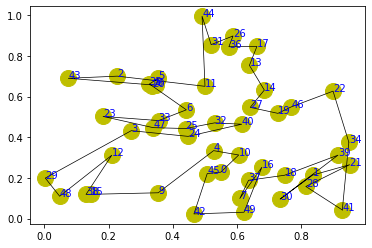

step:1950/5000, actic loss:1.292, critic loss:5.165, L:11.203, 0min1sec
step:1951/5000, actic loss:1.289, critic loss:5.163, L:11.201, 0min1sec
step:1952/5000, actic loss:1.284, critic loss:5.160, L:11.199, 0min1sec
step:1953/5000, actic loss:1.278, critic loss:5.158, L:11.197, 0min1sec
step:1954/5000, actic loss:1.274, critic loss:5.156, L:11.195, 0min1sec
distance:7.047
tensor([36, 27, 12, 15, 25, 48, 18, 14, 23, 28, 46, 37,  0, 19, 21, 47,  6, 39,
        29, 22, 49, 32, 44,  4,  9,  8, 16, 38, 10, 31,  3,  5, 34, 26, 17, 35,
         2,  7, 33, 30, 11, 40,  1, 20, 45, 42, 24, 41, 13, 43])


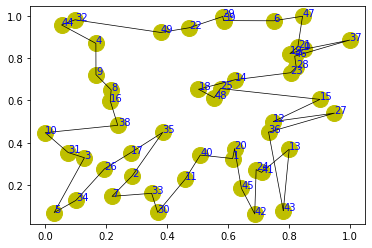

step:1955/5000, actic loss:1.269, critic loss:5.153, L:11.194, 0min2sec
step:1956/5000, actic loss:1.267, critic loss:5.151, L:11.192, 0min2sec
step:1957/5000, actic loss:1.267, critic loss:5.148, L:11.190, 0min1sec
step:1958/5000, actic loss:1.271, critic loss:5.146, L:11.188, 0min1sec
step:1959/5000, actic loss:1.274, critic loss:5.144, L:11.186, 0min1sec
distance:8.565
tensor([32, 25, 18, 44, 20,  7, 21, 29, 37, 39, 19, 10, 16, 45,  6,  3, 49, 15,
        23, 22, 42, 36, 27,  1, 31, 43, 12, 11, 47,  9, 38, 17,  0, 26,  8, 41,
         4, 28, 24, 34, 35, 14,  2, 46, 30, 13,  5, 40, 48, 33])


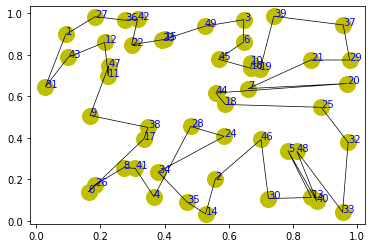

step:1960/5000, actic loss:1.276, critic loss:5.142, L:11.185, 0min1sec
step:1961/5000, actic loss:1.278, critic loss:5.139, L:11.183, 0min1sec
step:1962/5000, actic loss:1.277, critic loss:5.137, L:11.181, 0min1sec
step:1963/5000, actic loss:1.275, critic loss:5.134, L:11.179, 0min1sec
step:1964/5000, actic loss:1.270, critic loss:5.132, L:11.177, 0min1sec
distance:7.343
tensor([44,  9,  6, 14, 47, 29, 12, 27, 21, 16, 22, 37, 31,  7, 10,  8,  5, 19,
        26, 32, 49, 18, 46, 45, 35, 25, 34, 38, 43, 40, 41, 48,  0, 36, 24, 11,
        13, 33,  1,  4, 20, 15, 30, 17,  3, 23, 42, 28,  2, 39])


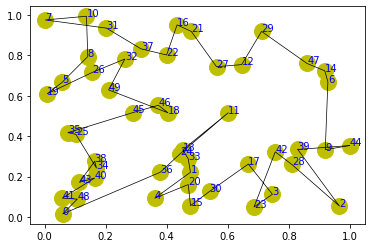

step:1965/5000, actic loss:1.265, critic loss:5.130, L:11.176, 0min2sec
step:1966/5000, actic loss:1.261, critic loss:5.127, L:11.174, 0min1sec
step:1967/5000, actic loss:1.258, critic loss:5.125, L:11.172, 0min1sec
step:1968/5000, actic loss:1.256, critic loss:5.122, L:11.170, 0min1sec
step:1969/5000, actic loss:1.258, critic loss:5.120, L:11.169, 0min1sec
distance:7.364
tensor([42, 14, 23,  5, 26, 37, 35, 16,  9, 31, 20, 30, 10, 36, 11, 41, 48, 19,
        39, 34,  3,  0, 45, 44, 40, 29, 18, 22, 24,  6, 33, 21, 49,  8,  7,  4,
        32, 17, 47, 43, 12, 13, 27,  2, 15, 25, 28, 38,  1, 46])


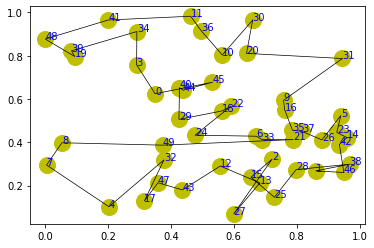

step:1970/5000, actic loss:1.261, critic loss:5.118, L:11.167, 0min1sec
step:1971/5000, actic loss:1.265, critic loss:5.116, L:11.165, 0min1sec
step:1972/5000, actic loss:1.268, critic loss:5.113, L:11.163, 0min1sec
step:1973/5000, actic loss:1.271, critic loss:5.111, L:11.162, 0min1sec
step:1974/5000, actic loss:1.271, critic loss:5.109, L:11.160, 0min1sec
distance:7.435
tensor([21, 32, 36, 10, 49, 35, 14, 20, 27,  8, 43, 39, 45, 11,  9, 24,  5, 25,
        33, 19, 38,  3, 26, 12, 46, 29, 22, 23, 48, 42, 18, 30, 34, 16, 28,  7,
         2, 44, 31, 37,  1, 47, 15,  6, 41, 17,  0, 40, 13,  4])


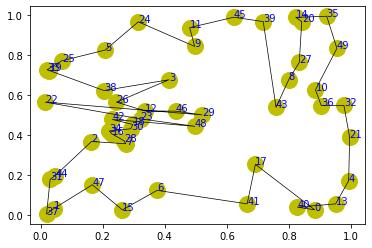

step:1975/5000, actic loss:1.271, critic loss:5.106, L:11.158, 0min2sec
step:1976/5000, actic loss:1.267, critic loss:5.104, L:11.156, 0min1sec
step:1977/5000, actic loss:1.262, critic loss:5.102, L:11.154, 0min1sec
step:1978/5000, actic loss:1.257, critic loss:5.100, L:11.152, 0min1sec
step:1979/5000, actic loss:1.250, critic loss:5.098, L:11.150, 0min1sec
distance:8.127
tensor([21, 36, 10, 38, 49, 15, 46, 48, 22,  8, 32, 34, 24,  7, 11, 37, 25,  3,
        39, 33, 42, 45, 47, 29, 28, 17, 12, 41,  2, 31,  9,  0, 23, 14, 35, 19,
        18, 26, 20, 30,  1, 40, 43, 16,  4, 13,  6, 44, 27,  5])


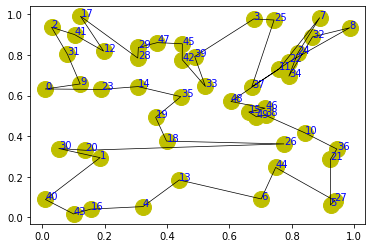

step:1980/5000, actic loss:1.245, critic loss:5.095, L:11.148, 0min2sec
step:1981/5000, actic loss:1.241, critic loss:5.093, L:11.147, 0min1sec
step:1982/5000, actic loss:1.239, critic loss:5.091, L:11.145, 0min1sec
step:1983/5000, actic loss:1.241, critic loss:5.088, L:11.143, 0min1sec
step:1984/5000, actic loss:1.244, critic loss:5.086, L:11.141, 0min1sec
distance:6.525
tensor([28, 49, 14, 40,  9, 16, 41, 26, 31, 35, 44, 46, 39, 38, 47,  0, 23, 20,
        25, 27, 22, 33, 17, 11,  5, 45, 19,  2, 15, 24, 10, 36, 42,  8, 21,  3,
         6, 37, 29,  4, 12, 18, 48,  7,  1, 43, 32, 30, 34, 13])


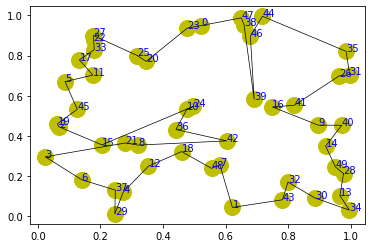

step:1985/5000, actic loss:1.248, critic loss:5.084, L:11.139, 0min1sec
step:1986/5000, actic loss:1.251, critic loss:5.082, L:11.137, 0min1sec
step:1987/5000, actic loss:1.254, critic loss:5.080, L:11.135, 0min1sec
step:1988/5000, actic loss:1.255, critic loss:5.077, L:11.133, 0min1sec
step:1989/5000, actic loss:1.255, critic loss:5.075, L:11.131, 0min1sec
distance:6.719
tensor([ 3, 19, 20, 11, 21, 36,  0, 24, 35, 40,  8, 46, 25, 38,  1,  7, 14, 17,
         4, 37, 41, 39, 32, 27,  5, 18, 28, 16, 22, 47, 26, 13, 45, 34,  9, 30,
        10, 44, 23, 48, 49, 42, 12,  6, 15, 43, 31, 33,  2, 29])


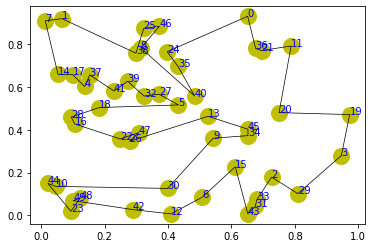

step:1990/5000, actic loss:1.253, critic loss:5.072, L:11.129, 0min1sec
step:1991/5000, actic loss:1.249, critic loss:5.070, L:11.127, 0min1sec
step:1992/5000, actic loss:1.245, critic loss:5.068, L:11.125, 0min1sec
step:1993/5000, actic loss:1.241, critic loss:5.066, L:11.123, 0min1sec
step:1994/5000, actic loss:1.238, critic loss:5.063, L:11.121, 0min1sec
distance:6.281
tensor([23, 30, 41, 21, 43,  0, 29, 45, 12, 39,  9, 20, 42, 34, 19, 15, 35, 14,
        33,  2, 11, 26,  3, 32, 24, 22, 10,  5, 31, 46, 49,  8, 37, 18, 47, 44,
        16, 27, 48,  1, 17, 38, 28, 40,  7,  4,  6, 13, 36, 25])


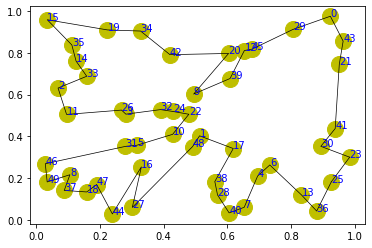

step:1995/5000, actic loss:1.236, critic loss:5.061, L:11.119, 0min1sec
step:1996/5000, actic loss:1.237, critic loss:5.059, L:11.117, 0min1sec
step:1997/5000, actic loss:1.238, critic loss:5.056, L:11.115, 0min1sec
step:1998/5000, actic loss:1.239, critic loss:5.054, L:11.113, 0min1sec
step:1999/5000, actic loss:1.240, critic loss:5.051, L:11.111, 0min1sec
distance:7.237
tensor([44,  4, 19, 17, 18, 47, 34,  2, 39, 28, 22, 41,  0, 45, 10, 25, 46,  8,
        21,  5, 16, 32, 29, 14, 15, 23, 37, 26, 20, 40, 38, 24, 49, 33, 48, 35,
         6, 31,  3, 11, 43, 30,  9, 13,  1, 12, 36,  7, 27, 42])


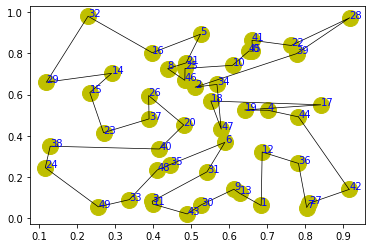

step:2000/5000, actic loss:1.239, critic loss:5.049, L:11.109, 0min1sec
step:2001/5000, actic loss:1.237, critic loss:5.047, L:11.107, 0min1sec
step:2002/5000, actic loss:1.234, critic loss:5.044, L:11.105, 0min1sec
step:2003/5000, actic loss:1.231, critic loss:5.042, L:11.103, 0min1sec
step:2004/5000, actic loss:1.230, critic loss:5.040, L:11.101, 0min1sec
distance:7.380
tensor([ 4, 13, 15,  9, 16,  3, 43, 21, 31, 26,  6, 12,  0, 11, 25, 36, 35, 39,
        48, 45, 17, 10, 47, 37, 41, 20, 30, 22, 40, 14, 33, 49, 38, 19, 34, 28,
        46,  2, 29,  7, 24, 42, 32, 27, 18, 44, 23,  1,  8,  5])


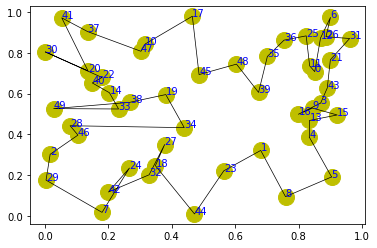

step:2005/5000, actic loss:1.232, critic loss:5.037, L:11.099, 0min1sec
step:2006/5000, actic loss:1.233, critic loss:5.035, L:11.097, 0min1sec
step:2007/5000, actic loss:1.234, critic loss:5.033, L:11.095, 0min1sec
step:2008/5000, actic loss:1.235, critic loss:5.030, L:11.093, 0min1sec
step:2009/5000, actic loss:1.233, critic loss:5.028, L:11.091, 0min1sec
distance:7.174
tensor([42, 24, 40, 20, 49, 13, 47, 28, 27, 37, 36,  2, 18,  8,  1, 35,  7,  9,
        21, 32, 46, 14, 22, 12,  6,  3, 43, 29, 41, 44, 30, 39, 17,  0, 23, 10,
        16, 26,  4, 48, 25, 34,  5, 15, 33, 45, 31, 11, 19, 38])


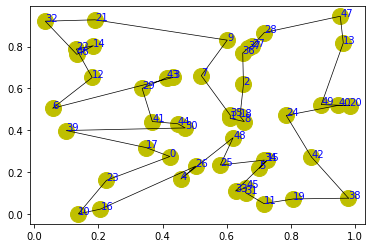

step:2010/5000, actic loss:1.229, critic loss:5.026, L:11.089, 0min1sec
step:2011/5000, actic loss:1.226, critic loss:5.024, L:11.087, 0min1sec
step:2012/5000, actic loss:1.222, critic loss:5.022, L:11.086, 0min2sec
step:2013/5000, actic loss:1.219, critic loss:5.019, L:11.084, 0min1sec
step:2014/5000, actic loss:1.216, critic loss:5.017, L:11.082, 0min1sec
distance:7.738
tensor([18, 49, 15,  4,  5, 23, 40,  6,  7, 21, 43,  9, 36, 31, 13,  0,  1, 28,
        35, 20, 34, 32, 12, 44, 14, 38, 16, 10, 29, 46, 48, 19, 17, 47,  2, 45,
        22, 39, 37, 30, 24,  8, 33, 42, 41, 27, 25, 11,  3, 26])


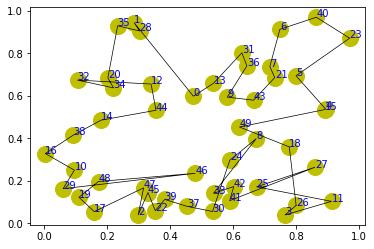

step:2015/5000, actic loss:1.216, critic loss:5.015, L:11.081, 0min1sec
step:2016/5000, actic loss:1.218, critic loss:5.013, L:11.079, 0min1sec
step:2017/5000, actic loss:1.222, critic loss:5.011, L:11.078, 0min1sec
step:2018/5000, actic loss:1.225, critic loss:5.009, L:11.076, 0min1sec
step:2019/5000, actic loss:1.228, critic loss:5.007, L:11.075, 0min1sec
distance:9.649
tensor([18, 47,  7, 46, 28, 37, 13, 43,  8,  2, 44, 25, 35,  0,  4, 24, 45,  3,
        49, 10, 48,  5, 12, 39, 23, 41, 33, 14, 17, 38, 11, 29, 30, 40, 22, 31,
        27,  6,  1,  9, 15, 26, 42, 20, 19, 34, 36, 21, 32, 16])


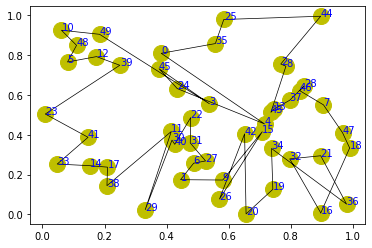

step:2020/5000, actic loss:1.229, critic loss:5.005, L:11.073, 0min1sec
step:2021/5000, actic loss:1.228, critic loss:5.003, L:11.071, 0min1sec
step:2022/5000, actic loss:1.225, critic loss:5.001, L:11.070, 0min1sec
step:2023/5000, actic loss:1.222, critic loss:4.999, L:11.068, 0min1sec
step:2024/5000, actic loss:1.219, critic loss:4.997, L:11.067, 0min1sec
distance:9.212
tensor([24,  4, 48, 17, 28,  1,  6, 33, 40, 34, 43, 13, 12,  0, 39,  8, 23, 42,
        37,  5, 46,  3, 15, 16, 49, 30, 14, 36, 45, 31, 10, 20, 47,  7, 25, 35,
        27, 21, 29, 18,  9,  2, 41, 38, 11, 44, 19, 32, 22, 26])


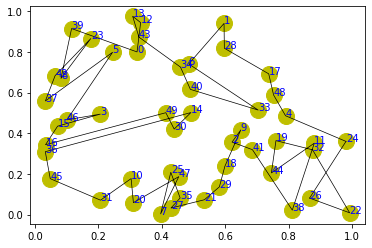

step:2025/5000, actic loss:1.218, critic loss:4.995, L:11.065, 0min2sec
step:2026/5000, actic loss:1.217, critic loss:4.993, L:11.064, 0min2sec
step:2027/5000, actic loss:1.219, critic loss:4.991, L:11.063, 0min1sec
step:2028/5000, actic loss:1.221, critic loss:4.988, L:11.061, 0min1sec
step:2029/5000, actic loss:1.224, critic loss:4.986, L:11.060, 0min1sec
distance:9.201
tensor([37,  3, 33, 19,  4, 23, 34, 12, 25, 11,  2,  7, 30, 32,  1, 20, 45, 40,
        46, 28,  0, 14, 47, 17, 26, 24,  6, 13, 49,  8, 39, 36, 38, 27, 43, 29,
         9, 41, 15, 18, 10, 42, 21, 44, 31, 48, 16, 22,  5, 35])


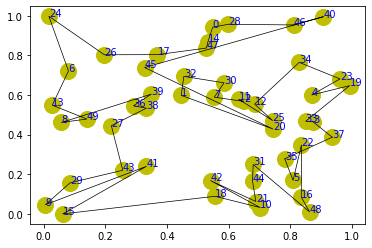

step:2030/5000, actic loss:1.225, critic loss:4.984, L:11.058, 0min2sec
step:2031/5000, actic loss:1.224, critic loss:4.982, L:11.056, 0min1sec
step:2032/5000, actic loss:1.221, critic loss:4.980, L:11.055, 0min1sec
step:2033/5000, actic loss:1.215, critic loss:4.978, L:11.053, 0min1sec
step:2034/5000, actic loss:1.209, critic loss:4.976, L:11.052, 0min1sec
distance:8.820
tensor([17,  9, 27, 21, 15, 24, 30, 18,  8, 32, 43,  4, 25, 10,  2, 31, 19, 35,
        48, 26, 38,  3,  1,  0,  7, 20, 23,  6,  5, 36, 33, 14, 39, 40, 46, 29,
        11, 47, 34, 13, 12, 49, 41, 16, 28, 22, 45, 37, 44, 42])


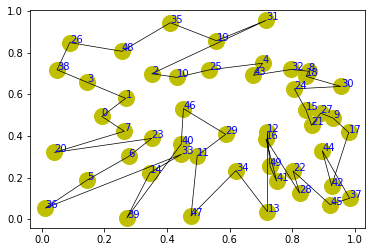

step:2035/5000, actic loss:1.203, critic loss:4.974, L:11.050, 0min1sec
step:2036/5000, actic loss:1.198, critic loss:4.972, L:11.049, 0min1sec
step:2037/5000, actic loss:1.196, critic loss:4.970, L:11.047, 0min1sec
step:2038/5000, actic loss:1.196, critic loss:4.967, L:11.045, 0min1sec
step:2039/5000, actic loss:1.199, critic loss:4.965, L:11.044, 0min1sec
distance:7.838
tensor([28,  4, 18, 16,  1, 21, 26, 31,  6, 40, 20,  3, 42, 44, 38, 46,  8, 23,
        47, 35, 49, 30, 29, 13, 41, 25, 19, 43, 14, 11, 15,  9,  0, 34, 32, 48,
        24,  5,  2, 33, 45, 10, 17, 27, 22, 36, 37, 12, 39,  7])


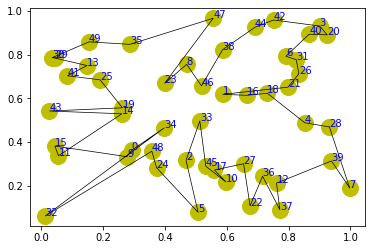

step:2040/5000, actic loss:1.203, critic loss:4.963, L:11.042, 0min2sec
step:2041/5000, actic loss:1.206, critic loss:4.961, L:11.041, 0min1sec
step:2042/5000, actic loss:1.207, critic loss:4.959, L:11.039, 0min1sec
step:2043/5000, actic loss:1.207, critic loss:4.957, L:11.037, 0min1sec
step:2044/5000, actic loss:1.205, critic loss:4.955, L:11.036, 0min1sec
distance:8.050
tensor([32, 20,  2, 46,  5, 35,  6, 19, 11, 26, 41, 23,  7, 17, 29,  3, 14, 31,
         4, 40, 27, 24, 25, 48, 37, 21, 34,  9, 28, 39, 15, 13, 33, 44, 18, 49,
         0,  8, 30,  1, 45, 16, 36, 38, 47, 12, 43, 22, 10, 42])


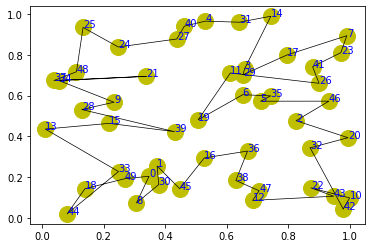

step:2045/5000, actic loss:1.201, critic loss:4.953, L:11.034, 0min1sec
step:2046/5000, actic loss:1.198, critic loss:4.950, L:11.032, 0min1sec
step:2047/5000, actic loss:1.194, critic loss:4.948, L:11.031, 0min1sec
step:2048/5000, actic loss:1.192, critic loss:4.946, L:11.029, 0min1sec
step:2049/5000, actic loss:1.191, critic loss:4.944, L:11.027, 0min2sec
distance:8.083
tensor([22,  1, 35, 16, 28, 40, 30, 42, 17, 12, 23, 45, 27, 46, 18, 39, 26,  8,
        21, 13,  6,  2, 24, 32, 48, 31, 15, 43,  5,  0, 47, 41, 33, 38, 37, 36,
        34, 25, 11, 19, 10, 29,  3, 49, 44,  4, 14, 20,  7,  9])


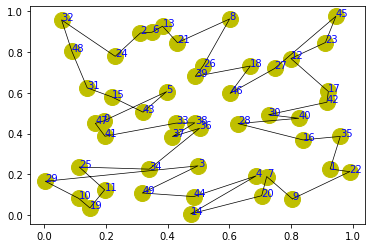

step:2050/5000, actic loss:1.193, critic loss:4.942, L:11.026, 0min2sec
step:2051/5000, actic loss:1.197, critic loss:4.940, L:11.024, 0min1sec
step:2052/5000, actic loss:1.202, critic loss:4.939, L:11.022, 0min1sec
step:2053/5000, actic loss:1.206, critic loss:4.937, L:11.020, 0min1sec
step:2054/5000, actic loss:1.210, critic loss:4.936, L:11.018, 0min1sec
distance:7.451
tensor([46, 23,  0, 43, 16, 49, 37, 33, 31, 36,  4,  8, 29, 15, 20, 14, 32, 21,
        35, 25, 17,  6, 30, 48, 39, 18, 47,  5, 19, 26, 42, 38, 40, 10, 11,  3,
        41, 34, 22,  7, 12, 13,  2,  1, 27, 45, 28,  9, 44, 24])


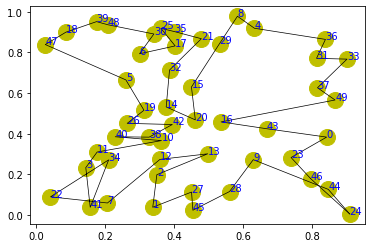

step:2055/5000, actic loss:1.210, critic loss:4.933, L:11.017, 0min1sec
step:2056/5000, actic loss:1.209, critic loss:4.931, L:11.015, 0min1sec
step:2057/5000, actic loss:1.206, critic loss:4.929, L:11.013, 0min1sec
step:2058/5000, actic loss:1.202, critic loss:4.927, L:11.011, 0min1sec
step:2059/5000, actic loss:1.199, critic loss:4.925, L:11.010, 0min1sec
distance:7.235
tensor([10,  9, 24, 22, 12, 30, 26,  2, 49, 39, 47, 18, 34,  0, 35, 20, 31, 16,
        23, 19, 33, 37, 45,  1,  7,  4, 38, 13, 11, 46, 48, 41, 15,  8, 29, 27,
        25, 44, 21, 40,  3, 42, 36,  5, 32, 14, 43,  6, 17, 28])


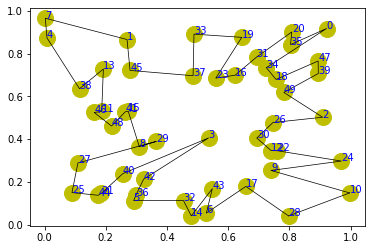

step:2060/5000, actic loss:1.198, critic loss:4.922, L:11.008, 0min1sec
step:2061/5000, actic loss:1.199, critic loss:4.920, L:11.006, 0min1sec
step:2062/5000, actic loss:1.200, critic loss:4.918, L:11.004, 0min1sec
step:2063/5000, actic loss:1.201, critic loss:4.916, L:11.003, 0min1sec
step:2064/5000, actic loss:1.201, critic loss:4.914, L:11.001, 0min1sec
distance:8.254
tensor([23, 49, 34, 36, 45, 16, 39,  6, 15, 18, 29,  9,  5, 17, 14, 30, 41,  8,
        40, 43, 31, 19, 21, 33, 22, 26,  0, 25, 42, 44, 13,  2,  3, 32, 48, 46,
         7, 37,  4, 12, 47, 27,  1, 10, 20, 28, 11, 35, 24, 38])


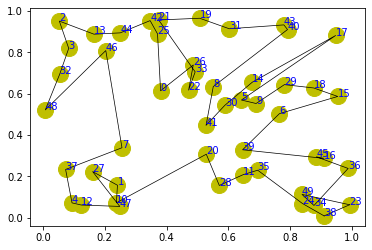

step:2065/5000, actic loss:1.200, critic loss:4.912, L:10.999, 0min1sec
step:2066/5000, actic loss:1.198, critic loss:4.909, L:10.998, 0min1sec
step:2067/5000, actic loss:1.197, critic loss:4.907, L:10.996, 0min1sec
step:2068/5000, actic loss:1.196, critic loss:4.905, L:10.995, 0min1sec
step:2069/5000, actic loss:1.196, critic loss:4.903, L:10.993, 0min1sec
distance:7.571
tensor([31, 28, 23, 38, 45,  3,  7, 49, 43, 46, 37, 35, 24, 44, 41,  4, 48, 30,
        19, 29, 12,  1,  0, 10, 25, 11, 36, 16, 27, 14, 26,  6, 47, 42, 18, 13,
         9,  8,  2, 15,  5, 17, 33, 40, 34, 22, 32, 39, 21, 20])


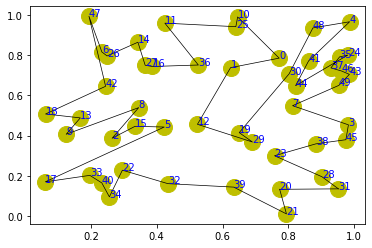

step:2070/5000, actic loss:1.196, critic loss:4.901, L:10.991, 0min1sec
step:2071/5000, actic loss:1.196, critic loss:4.898, L:10.989, 0min1sec
step:2072/5000, actic loss:1.194, critic loss:4.896, L:10.988, 0min1sec
step:2073/5000, actic loss:1.191, critic loss:4.894, L:10.986, 0min1sec
step:2074/5000, actic loss:1.189, critic loss:4.892, L:10.984, 0min1sec
distance:7.847
tensor([ 5, 17, 20, 30, 10,  6, 49, 40, 29, 24,  2,  1, 28, 16, 19, 36, 46, 41,
        14, 23, 39, 43, 34, 48, 18, 27, 45, 31,  7, 33,  3, 22, 44, 12, 25, 13,
        32,  9,  0, 15, 38, 37,  4, 11, 21, 35, 26,  8, 47, 42])


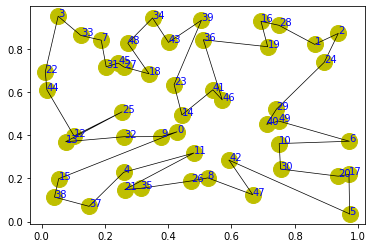

step:2075/5000, actic loss:1.188, critic loss:4.890, L:10.982, 0min2sec
step:2076/5000, actic loss:1.188, critic loss:4.887, L:10.980, 0min2sec
step:2077/5000, actic loss:1.189, critic loss:4.885, L:10.978, 0min1sec
step:2078/5000, actic loss:1.190, critic loss:4.883, L:10.977, 0min1sec
step:2079/5000, actic loss:1.190, critic loss:4.881, L:10.975, 0min1sec
distance:6.782
tensor([48, 35, 19, 18, 21, 38, 11, 17, 43, 15, 45, 40,  2,  7, 33, 16,  4,  8,
        29,  1, 25, 44, 41, 46,  5, 36, 39, 42, 27, 24, 34, 31, 23, 20, 10, 12,
        14,  9, 47, 13,  6, 22,  3, 26, 32,  0, 30, 37, 28, 49])


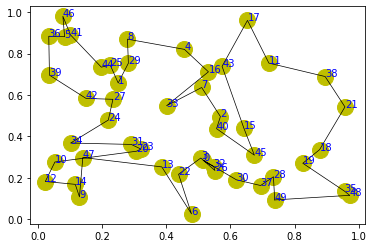

step:2080/5000, actic loss:1.189, critic loss:4.879, L:10.973, 0min1sec
step:2081/5000, actic loss:1.187, critic loss:4.876, L:10.971, 0min1sec
step:2082/5000, actic loss:1.184, critic loss:4.874, L:10.969, 0min1sec
step:2083/5000, actic loss:1.180, critic loss:4.872, L:10.967, 0min1sec
step:2084/5000, actic loss:1.177, critic loss:4.870, L:10.965, 0min1sec
distance:6.874
tensor([ 2, 39, 26, 44,  7, 13,  8, 29,  3,  6, 43, 23, 32, 25, 47, 15, 46,  5,
        41, 33,  0, 35, 27, 19,  1, 30, 45, 40, 21, 14, 12, 16, 22, 38, 24, 11,
        17, 36, 37, 42, 10, 34, 28, 49, 31, 18, 48,  9, 20,  4])


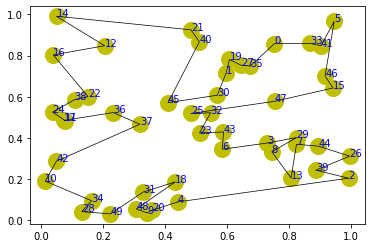

step:2085/5000, actic loss:1.175, critic loss:4.868, L:10.964, 0min1sec
step:2086/5000, actic loss:1.175, critic loss:4.866, L:10.962, 0min1sec
step:2087/5000, actic loss:1.175, critic loss:4.863, L:10.960, 0min1sec
step:2088/5000, actic loss:1.177, critic loss:4.861, L:10.958, 0min1sec
step:2089/5000, actic loss:1.179, critic loss:4.859, L:10.956, 0min1sec
distance:7.433
tensor([17,  2, 35, 45, 33, 36,  6, 25, 31, 47,  0, 44, 22, 38, 46,  5, 40, 23,
        12, 19, 20,  9,  7, 32, 37,  4, 10, 24, 41, 48, 43, 16, 11, 15,  3, 14,
        28, 26, 18,  1, 39, 21, 13, 27,  8, 30, 42, 29, 34, 49])


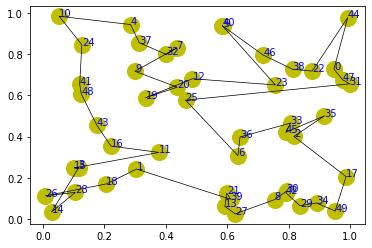

step:2090/5000, actic loss:1.180, critic loss:4.857, L:10.954, 0min1sec
step:2091/5000, actic loss:1.181, critic loss:4.855, L:10.952, 0min1sec
step:2092/5000, actic loss:1.180, critic loss:4.853, L:10.951, 0min1sec
step:2093/5000, actic loss:1.178, critic loss:4.851, L:10.949, 0min1sec
step:2094/5000, actic loss:1.176, critic loss:4.848, L:10.947, 0min1sec
distance:6.545
tensor([ 8, 21, 25, 44, 13, 24, 17, 22, 35, 41, 33, 48, 27, 40, 14, 26, 37, 29,
        10,  0, 42,  5,  6,  3, 49, 38, 12, 11, 16, 45, 20, 46, 28, 43, 47,  7,
        15,  9, 19, 34, 23, 18,  4, 39, 36,  1, 30, 32,  2, 31])


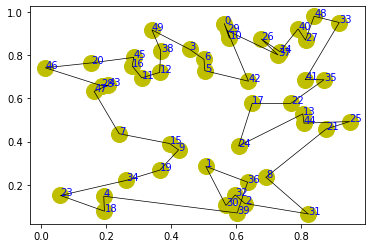

step:2095/5000, actic loss:1.173, critic loss:4.846, L:10.945, 0min2sec
step:2096/5000, actic loss:1.172, critic loss:4.844, L:10.943, 0min1sec
step:2097/5000, actic loss:1.171, critic loss:4.842, L:10.942, 0min1sec
step:2098/5000, actic loss:1.171, critic loss:4.840, L:10.940, 0min1sec
step:2099/5000, actic loss:1.171, critic loss:4.838, L:10.939, 0min1sec
distance:8.861
tensor([14,  0, 24,  2, 47, 28,  8, 15, 32, 36, 44, 43, 31, 41, 35,  6, 39, 23,
        30, 42, 25, 33, 11,  9, 16,  4, 46, 38, 17, 48,  7,  5, 12, 45, 13, 49,
        19, 27, 20, 40,  3, 29, 10, 22, 26, 21, 37,  1, 18, 34])


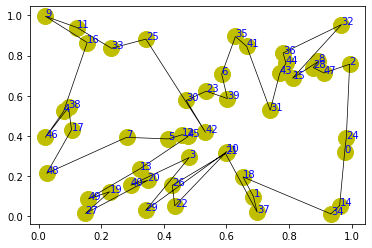

step:2100/5000, actic loss:1.169, critic loss:4.836, L:10.937, 0min1sec
step:2101/5000, actic loss:1.166, critic loss:4.834, L:10.936, 0min1sec
step:2102/5000, actic loss:1.165, critic loss:4.832, L:10.934, 0min1sec
step:2103/5000, actic loss:1.164, critic loss:4.829, L:10.933, 0min1sec
step:2104/5000, actic loss:1.165, critic loss:4.827, L:10.931, 0min1sec
distance:6.649
tensor([30, 46, 22, 25, 33, 26, 29, 16, 43, 38, 40,  4, 48, 18, 20,  2,  3, 28,
        10, 34,  1,  0, 12, 37,  6, 14, 19, 45,  9, 36, 35, 41, 49, 31, 24, 15,
        13,  7,  8,  5, 32, 17, 27, 11, 47, 44, 39, 23, 42, 21])


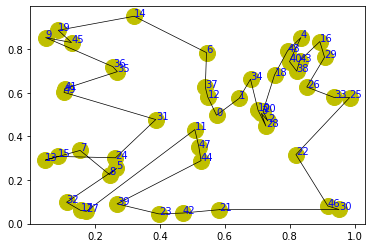

step:2105/5000, actic loss:1.166, critic loss:4.825, L:10.930, 0min2sec
step:2106/5000, actic loss:1.168, critic loss:4.823, L:10.928, 0min1sec
step:2107/5000, actic loss:1.168, critic loss:4.821, L:10.926, 0min1sec
step:2108/5000, actic loss:1.168, critic loss:4.819, L:10.924, 0min1sec
step:2109/5000, actic loss:1.166, critic loss:4.817, L:10.923, 0min1sec
distance:6.546
tensor([17, 35, 11, 42, 24,  4, 39, 26, 33, 28, 16, 31,  8, 36,  2, 48, 13, 27,
         6, 12, 41, 21, 20, 19, 43,  3, 34,  9,  7, 40, 29, 32, 44, 49, 22,  0,
         1, 25, 23, 45, 47, 18, 37, 10, 30, 14, 38,  5, 46, 15])


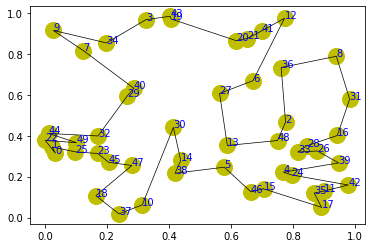

step:2110/5000, actic loss:1.163, critic loss:4.815, L:10.921, 0min1sec
step:2111/5000, actic loss:1.159, critic loss:4.813, L:10.919, 0min1sec
step:2112/5000, actic loss:1.155, critic loss:4.811, L:10.917, 0min1sec
step:2113/5000, actic loss:1.153, critic loss:4.809, L:10.916, 0min1sec
step:2114/5000, actic loss:1.151, critic loss:4.807, L:10.914, 0min1sec
distance:7.213
tensor([ 8, 25, 32, 11, 42, 30, 15, 43,  2, 29, 47, 38, 27, 22, 39, 21, 40, 23,
         3, 48, 17, 35, 46, 49, 18, 28, 20,  4, 41,  9,  1, 36, 45, 12, 16,  0,
        37, 19,  6, 31,  5, 13, 10, 44, 14, 34,  7, 33, 26, 24])


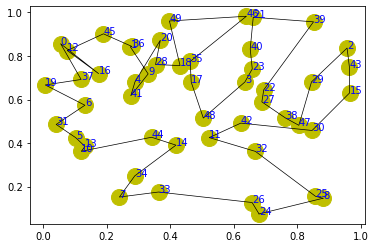

step:2115/5000, actic loss:1.151, critic loss:4.805, L:10.912, 0min2sec
step:2116/5000, actic loss:1.152, critic loss:4.802, L:10.910, 0min2sec
step:2117/5000, actic loss:1.153, critic loss:4.800, L:10.909, 0min1sec
step:2118/5000, actic loss:1.154, critic loss:4.798, L:10.907, 0min1sec
step:2119/5000, actic loss:1.154, critic loss:4.796, L:10.905, 0min1sec
distance:7.087
tensor([31, 17, 10, 32, 26,  3, 24, 38, 41, 34,  4, 46, 29, 30, 44, 12, 28, 14,
        15, 47, 37, 49, 20,  9, 42, 40,  1,  0, 16, 22, 18, 36,  5,  8,  7, 23,
        35, 27,  2, 33, 21, 43, 11, 39, 13, 25,  6, 19, 48, 45])


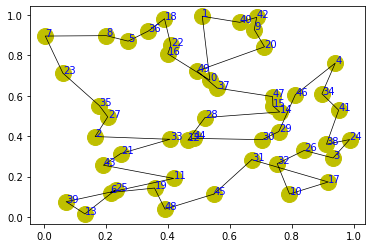

step:2120/5000, actic loss:1.152, critic loss:4.794, L:10.903, 0min1sec
step:2121/5000, actic loss:1.149, critic loss:4.792, L:10.902, 0min1sec
step:2122/5000, actic loss:1.147, critic loss:4.790, L:10.900, 0min1sec
step:2123/5000, actic loss:1.145, critic loss:4.788, L:10.898, 0min1sec
step:2124/5000, actic loss:1.143, critic loss:4.786, L:10.897, 0min1sec
distance:7.079
tensor([43, 41, 48,  5, 44, 15, 42, 17, 13, 31, 19, 22, 18, 26, 45,  1,  7, 23,
        34, 47,  0, 14, 37, 28,  3, 40, 29, 24, 25, 32, 36, 46, 49,  8, 16,  4,
        21, 33, 20, 30, 38, 27,  6, 11, 35, 39,  2,  9, 12, 10])


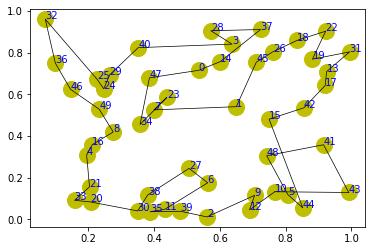

step:2125/5000, actic loss:1.143, critic loss:4.784, L:10.895, 0min1sec
step:2126/5000, actic loss:1.143, critic loss:4.781, L:10.893, 0min1sec
step:2127/5000, actic loss:1.144, critic loss:4.779, L:10.892, 0min1sec
step:2128/5000, actic loss:1.144, critic loss:4.777, L:10.890, 0min1sec
step:2129/5000, actic loss:1.142, critic loss:4.775, L:10.888, 0min2sec
distance:7.261
tensor([ 5, 35, 36,  9, 10, 45, 15, 28,  3, 21, 43, 12, 49,  8, 30, 16, 11, 48,
        37,  1, 39, 44, 40, 20, 31, 18, 26,  4, 32, 14, 41, 27, 22, 34,  2,  6,
        29, 24, 19, 33, 13,  7,  0, 42, 25, 46, 47, 23, 17, 38])


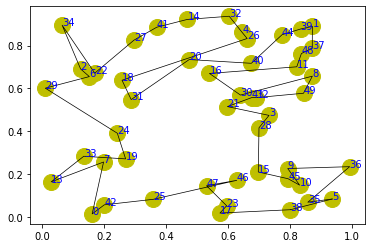

step:2130/5000, actic loss:1.141, critic loss:4.773, L:10.887, 0min2sec
step:2131/5000, actic loss:1.139, critic loss:4.771, L:10.885, 0min1sec
step:2132/5000, actic loss:1.138, critic loss:4.769, L:10.884, 0min1sec
step:2133/5000, actic loss:1.137, critic loss:4.767, L:10.882, 0min1sec
step:2134/5000, actic loss:1.136, critic loss:4.765, L:10.881, 0min1sec
distance:6.735
tensor([44, 39, 45, 38, 37, 11, 26, 49, 36, 48, 21, 31, 18, 13,  9,  2, 15, 22,
        24,  4, 34,  0, 23, 19,  5,  6,  8,  7, 14, 12,  3, 25, 35, 28, 30, 32,
        46, 17, 16, 29, 41, 43, 40, 10, 42, 27, 47, 33, 20,  1])


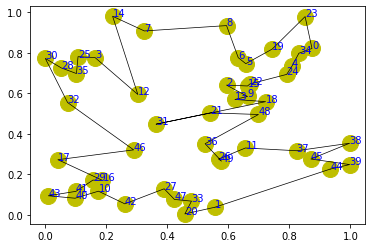

step:2135/5000, actic loss:1.136, critic loss:4.763, L:10.879, 0min1sec
step:2136/5000, actic loss:1.135, critic loss:4.761, L:10.878, 0min1sec
step:2137/5000, actic loss:1.134, critic loss:4.759, L:10.876, 0min1sec
step:2138/5000, actic loss:1.133, critic loss:4.757, L:10.874, 0min1sec
step:2139/5000, actic loss:1.132, critic loss:4.755, L:10.873, 0min1sec
distance:7.548
tensor([ 6, 37, 20, 30, 49, 39, 28, 46, 14,  1, 13,  4, 32, 33, 34,  8, 38, 23,
        22, 27, 18,  7, 35, 15, 29, 16,  9, 12, 21, 11, 41, 17, 10, 36,  3, 47,
        43, 24, 45, 25,  2, 26, 40, 44, 31, 19,  5, 42,  0, 48])


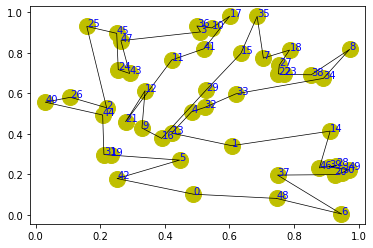

step:2140/5000, actic loss:1.131, critic loss:4.753, L:10.871, 0min2sec
step:2141/5000, actic loss:1.130, critic loss:4.750, L:10.869, 0min1sec
step:2142/5000, actic loss:1.129, critic loss:4.748, L:10.868, 0min1sec
step:2143/5000, actic loss:1.129, critic loss:4.746, L:10.866, 0min1sec
step:2144/5000, actic loss:1.128, critic loss:4.744, L:10.865, 0min1sec
distance:9.280
tensor([39, 37,  4, 10, 43, 33, 36, 32, 11, 41, 25, 42, 26,  1, 20, 24,  2, 13,
        47, 45, 23, 35, 27, 16, 46, 40, 49,  9, 48, 29, 22, 18,  8,  3, 17, 34,
        38, 14,  5,  7, 15, 19,  0, 12, 30,  6, 28, 31, 21, 44])


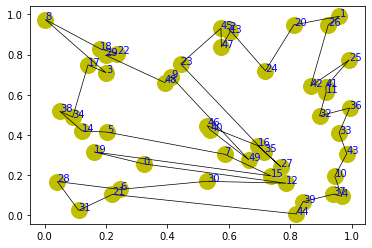

step:2145/5000, actic loss:1.127, critic loss:4.742, L:10.864, 0min1sec
step:2146/5000, actic loss:1.127, critic loss:4.740, L:10.862, 0min1sec
step:2147/5000, actic loss:1.127, critic loss:4.738, L:10.861, 0min1sec
step:2148/5000, actic loss:1.127, critic loss:4.736, L:10.860, 0min1sec
step:2149/5000, actic loss:1.127, critic loss:4.734, L:10.858, 0min1sec
distance:8.280
tensor([48, 13, 42,  3, 44,  9, 35, 26, 20,  8, 49, 38, 11, 41,  2, 47, 34,  6,
        31, 46, 10, 18, 33, 28, 24, 14, 27,  4, 12, 30, 43, 23, 37, 29, 36, 15,
         7, 17, 32, 19, 39, 25,  1,  5, 21, 16, 22, 40, 45,  0])


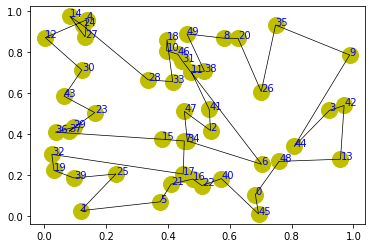

step:2150/5000, actic loss:1.126, critic loss:4.732, L:10.857, 0min1sec
step:2151/5000, actic loss:1.125, critic loss:4.730, L:10.855, 0min1sec
step:2152/5000, actic loss:1.125, critic loss:4.728, L:10.854, 0min1sec
step:2153/5000, actic loss:1.125, critic loss:4.726, L:10.852, 0min1sec
step:2154/5000, actic loss:1.124, critic loss:4.724, L:10.851, 0min1sec
distance:6.907
tensor([28, 30,  9,  4, 19, 17, 32,  8, 46, 27, 29, 18,  1, 45, 36, 20,  7, 11,
         5, 48, 24, 14, 22,  2, 42, 41, 21, 23, 38, 16,  6, 26, 40,  0, 44, 34,
         3, 13, 35, 25, 43, 12, 10, 39, 47, 37, 49, 31, 15, 33])


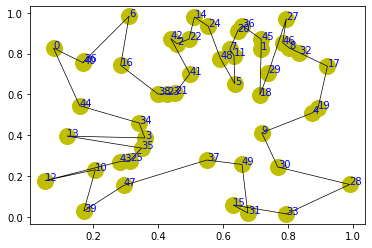

step:2155/5000, actic loss:1.123, critic loss:4.722, L:10.849, 0min1sec
step:2156/5000, actic loss:1.122, critic loss:4.720, L:10.848, 0min2sec
step:2157/5000, actic loss:1.122, critic loss:4.718, L:10.846, 0min1sec
step:2158/5000, actic loss:1.123, critic loss:4.716, L:10.844, 0min1sec
step:2159/5000, actic loss:1.123, critic loss:4.714, L:10.843, 0min1sec
distance:8.207
tensor([32, 19, 33,  1, 15, 17, 21, 28, 44, 45,  8, 11, 30, 23, 46,  9, 22, 18,
        10, 13, 41, 14,  3, 42, 29, 27, 25, 12,  5,  7, 35, 24, 26, 43, 48, 39,
        37,  6,  4,  0, 34, 49, 20, 47, 31, 38, 36,  2, 16, 40])


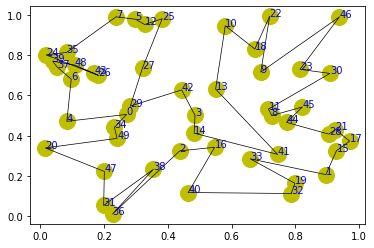

step:2160/5000, actic loss:1.123, critic loss:4.712, L:10.841, 0min1sec
step:2161/5000, actic loss:1.121, critic loss:4.710, L:10.839, 0min1sec
step:2162/5000, actic loss:1.119, critic loss:4.708, L:10.838, 0min1sec
step:2163/5000, actic loss:1.116, critic loss:4.706, L:10.836, 0min1sec
step:2164/5000, actic loss:1.114, critic loss:4.704, L:10.834, 0min1sec
distance:7.478
tensor([37, 25, 18, 38, 15, 35, 45, 14, 49, 10,  6, 21, 12,  8, 42,  0,  4, 23,
        19, 22, 17, 34, 26,  2, 36, 27, 24, 41,  5, 16, 32,  9, 11, 44, 33, 20,
        40, 30,  7, 46,  1, 39, 29, 13, 31, 43, 28, 47,  3, 48])


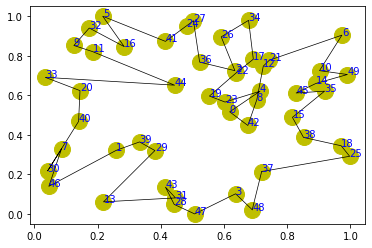

step:2165/5000, actic loss:1.112, critic loss:4.702, L:10.833, 0min1sec
step:2166/5000, actic loss:1.111, critic loss:4.700, L:10.831, 0min1sec
step:2167/5000, actic loss:1.111, critic loss:4.698, L:10.829, 0min1sec
step:2168/5000, actic loss:1.112, critic loss:4.696, L:10.828, 0min1sec
step:2169/5000, actic loss:1.111, critic loss:4.694, L:10.826, 0min1sec
distance:6.271
tensor([26, 14,  4, 43,  1, 47, 31, 44, 13, 39, 33, 22, 48, 10, 45, 46, 32, 29,
        41,  7, 19, 35, 17, 42, 24, 27, 30,  9,  6, 40, 23,  0, 49, 15,  2, 34,
        11, 21, 25,  8, 28, 38,  3, 16, 36, 18, 20,  5, 37, 12])


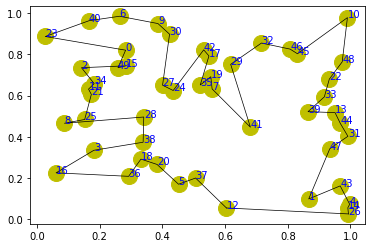

step:2170/5000, actic loss:1.110, critic loss:4.692, L:10.824, 0min1sec
step:2171/5000, actic loss:1.109, critic loss:4.690, L:10.823, 0min1sec
step:2172/5000, actic loss:1.108, critic loss:4.688, L:10.821, 0min1sec
step:2173/5000, actic loss:1.108, critic loss:4.686, L:10.819, 0min1sec
step:2174/5000, actic loss:1.108, critic loss:4.684, L:10.818, 0min1sec
distance:6.646
tensor([12, 23, 42, 31, 17, 45, 21, 38, 32, 36, 16,  2, 25, 46, 24,  7, 34, 22,
        26, 28, 30,  4, 27, 35,  3, 13, 10, 14, 44, 48, 37, 39, 43, 49,  6, 11,
         8, 20, 29, 15, 33, 18, 47,  5,  0,  9,  1, 19, 40, 41])


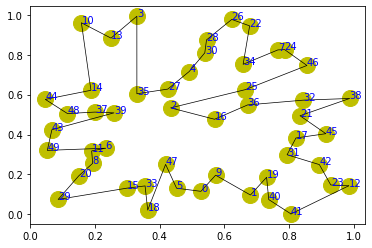

step:2175/5000, actic loss:1.107, critic loss:4.682, L:10.816, 0min1sec
step:2176/5000, actic loss:1.107, critic loss:4.680, L:10.814, 0min1sec
step:2177/5000, actic loss:1.106, critic loss:4.678, L:10.813, 0min1sec
step:2178/5000, actic loss:1.105, critic loss:4.676, L:10.811, 0min1sec
step:2179/5000, actic loss:1.104, critic loss:4.674, L:10.809, 0min1sec
distance:7.266
tensor([36, 30, 27, 43, 40, 29, 33, 12, 13, 42, 45, 46,  4, 20, 34, 10, 24,  6,
        17, 21,  7, 19,  8, 39, 11, 44,  5, 31, 16,  2, 23, 35, 18,  3, 15, 28,
        14, 41, 26, 37, 25, 47, 49,  9, 32,  1,  0, 22, 38, 48])


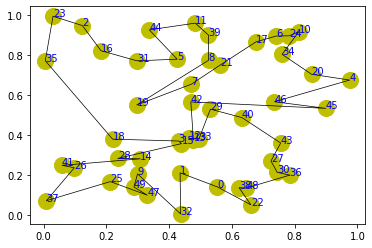

step:2180/5000, actic loss:1.104, critic loss:4.672, L:10.808, 0min1sec
step:2181/5000, actic loss:1.103, critic loss:4.670, L:10.806, 0min1sec
step:2182/5000, actic loss:1.101, critic loss:4.668, L:10.804, 0min1sec
step:2183/5000, actic loss:1.101, critic loss:4.666, L:10.803, 0min1sec
step:2184/5000, actic loss:1.100, critic loss:4.664, L:10.801, 0min1sec
distance:8.063
tensor([36, 23,  5, 49,  0, 39, 48, 11, 34, 28,  6, 15, 35,  8,  4, 22, 19, 41,
        44,  9, 18, 24, 45, 13,  1, 30, 46, 33,  3, 10, 38, 47, 25,  2, 31, 43,
        42, 17,  7, 37, 21, 12, 27, 32, 29, 20, 16, 40, 26, 14])


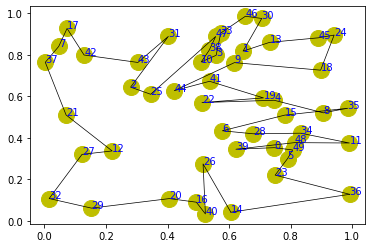

step:2185/5000, actic loss:1.101, critic loss:4.662, L:10.799, 0min2sec
step:2186/5000, actic loss:1.102, critic loss:4.660, L:10.798, 0min1sec
step:2187/5000, actic loss:1.102, critic loss:4.658, L:10.796, 0min1sec
step:2188/5000, actic loss:1.101, critic loss:4.656, L:10.795, 0min1sec
step:2189/5000, actic loss:1.099, critic loss:4.654, L:10.793, 0min1sec
distance:6.761
tensor([24, 12, 28,  5, 41, 45, 48, 18,  7, 27, 33, 40, 26, 38, 47, 42, 14, 30,
        16, 44, 46, 11, 37, 17, 43, 15,  6,  1, 29,  3, 22, 31, 32,  2, 35, 21,
        49, 23,  8, 13,  4, 36,  0, 20,  9, 34, 25, 39, 10, 19])


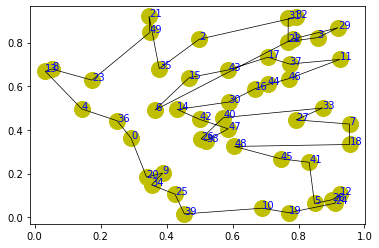

step:2190/5000, actic loss:1.097, critic loss:4.652, L:10.792, 0min1sec
step:2191/5000, actic loss:1.096, critic loss:4.650, L:10.790, 0min1sec
step:2192/5000, actic loss:1.096, critic loss:4.648, L:10.788, 0min1sec
step:2193/5000, actic loss:1.098, critic loss:4.646, L:10.787, 0min1sec
step:2194/5000, actic loss:1.099, critic loss:4.644, L:10.785, 0min1sec
distance:7.179
tensor([29, 24, 44,  3, 18, 22, 48, 14,  9, 36, 16, 33,  0, 43, 17, 26, 37, 46,
        34, 15, 21, 27, 47, 38, 39,  7, 30, 31, 49, 35, 20, 42, 45, 28,  6,  1,
         4, 40, 32,  2,  8,  5, 41, 12, 10, 23, 11, 13, 25, 19])


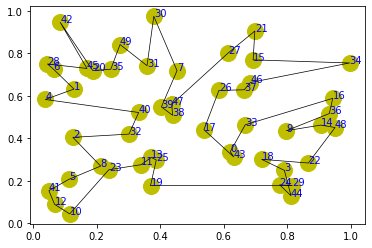

step:2195/5000, actic loss:1.099, critic loss:4.642, L:10.784, 0min2sec
step:2196/5000, actic loss:1.099, critic loss:4.640, L:10.782, 0min1sec
step:2197/5000, actic loss:1.098, critic loss:4.638, L:10.780, 0min2sec
step:2198/5000, actic loss:1.095, critic loss:4.636, L:10.779, 0min1sec
step:2199/5000, actic loss:1.093, critic loss:4.634, L:10.777, 0min1sec
distance:8.059
tensor([19, 31,  6, 17,  9, 36,  8, 47, 41, 42, 23, 33, 20, 12,  0, 10,  1, 37,
         4, 15, 30, 28, 25, 35, 26, 38, 27, 24, 21, 29, 14, 44, 11, 43, 45,  3,
         2, 49,  7, 39, 16, 18, 40, 48, 32,  5, 13, 34, 22, 46])


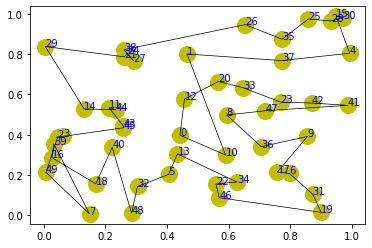

step:2200/5000, actic loss:1.091, critic loss:4.632, L:10.775, 0min2sec
step:2201/5000, actic loss:1.089, critic loss:4.630, L:10.774, 0min1sec
step:2202/5000, actic loss:1.089, critic loss:4.628, L:10.772, 0min1sec
step:2203/5000, actic loss:1.089, critic loss:4.626, L:10.771, 0min1sec
step:2204/5000, actic loss:1.089, critic loss:4.624, L:10.769, 0min1sec
distance:7.983
tensor([18, 43, 10, 13, 26, 25,  2, 32,  0, 41, 14, 34, 31, 21,  6, 20, 44, 23,
         3, 47, 16, 29, 35, 17, 49, 19,  9,  7, 38, 12,  1, 33,  8, 22, 28, 46,
        24, 40, 27, 39, 42, 36,  5, 45, 11, 30, 15,  4, 48, 37])


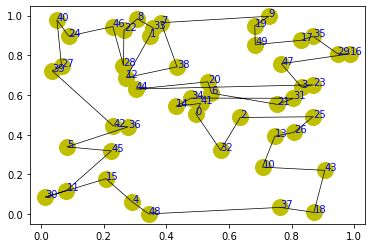

step:2205/5000, actic loss:1.088, critic loss:4.622, L:10.767, 0min2sec
step:2206/5000, actic loss:1.086, critic loss:4.620, L:10.766, 0min1sec
step:2207/5000, actic loss:1.084, critic loss:4.618, L:10.764, 0min1sec
step:2208/5000, actic loss:1.083, critic loss:4.616, L:10.763, 0min1sec
step:2209/5000, actic loss:1.083, critic loss:4.614, L:10.761, 0min1sec
distance:6.567
tensor([42, 43, 34, 20, 22,  2, 33, 30, 25, 36,  7,  9, 15, 39, 38, 48, 16, 19,
        41,  4, 40,  6, 46, 24, 49, 10, 31, 21, 45, 18,  0, 47, 11,  1, 44, 26,
        13, 27,  8, 17, 28, 37, 12,  5, 14, 32, 23, 35, 29,  3])


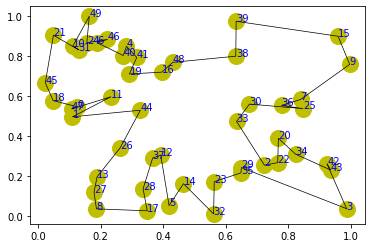

step:2210/5000, actic loss:1.082, critic loss:4.613, L:10.759, 0min1sec
step:2211/5000, actic loss:1.082, critic loss:4.611, L:10.758, 0min1sec
step:2212/5000, actic loss:1.080, critic loss:4.609, L:10.756, 0min1sec
step:2213/5000, actic loss:1.078, critic loss:4.607, L:10.755, 0min1sec
step:2214/5000, actic loss:1.077, critic loss:4.605, L:10.753, 0min1sec
distance:8.322
tensor([29,  9, 32, 21, 47,  6,  0, 41, 18, 36, 23,  3, 20, 26, 31, 15, 45, 46,
        43, 40,  8, 34, 27, 16, 24,  7, 19,  1, 11, 30, 44, 12, 25, 22, 10, 14,
        28,  4, 35, 33, 48, 42, 17,  5, 39,  2, 49, 38, 13, 37])


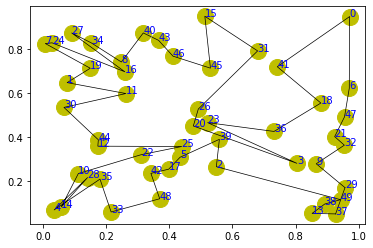

step:2215/5000, actic loss:1.075, critic loss:4.603, L:10.752, 0min1sec
step:2216/5000, actic loss:1.074, critic loss:4.601, L:10.750, 0min1sec
step:2217/5000, actic loss:1.075, critic loss:4.599, L:10.748, 0min1sec
step:2218/5000, actic loss:1.075, critic loss:4.597, L:10.747, 0min1sec
step:2219/5000, actic loss:1.075, critic loss:4.595, L:10.745, 0min1sec
distance:7.019
tensor([ 6, 18, 44, 31, 39,  8, 23, 26, 41, 25, 20, 12, 38,  3, 21, 17, 11,  5,
        40, 14, 37, 28, 49,  9, 16, 13, 30, 24, 42, 48, 35,  4, 15, 27, 33,  0,
        45, 19, 43, 47, 34, 32, 22, 10,  7, 29,  2, 36,  1, 46])


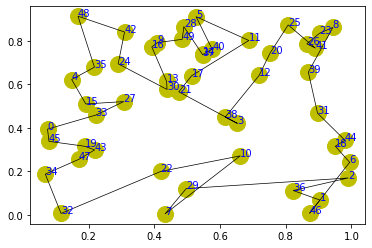

step:2220/5000, actic loss:1.074, critic loss:4.593, L:10.744, 0min1sec
step:2221/5000, actic loss:1.073, critic loss:4.591, L:10.742, 0min1sec
step:2222/5000, actic loss:1.073, critic loss:4.589, L:10.740, 0min1sec
step:2223/5000, actic loss:1.072, critic loss:4.587, L:10.739, 0min1sec
step:2224/5000, actic loss:1.071, critic loss:4.585, L:10.737, 0min1sec
distance:6.866
tensor([36, 23, 47, 31,  7, 33, 45, 29, 25, 39,  2,  0, 46,  3, 21, 11, 17, 15,
        30,  1, 13, 43,  6, 27, 16,  4,  5, 37, 28, 10, 44, 40, 24, 26, 22, 20,
        34, 19, 32, 18, 49, 35, 48, 38, 42, 12, 14,  8, 41,  9])


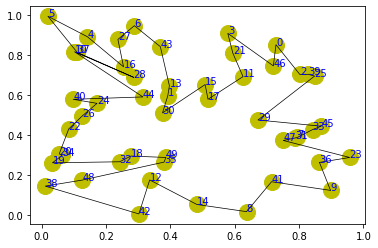

step:2225/5000, actic loss:1.070, critic loss:4.583, L:10.736, 0min2sec
step:2226/5000, actic loss:1.071, critic loss:4.582, L:10.734, 0min1sec
step:2227/5000, actic loss:1.070, critic loss:4.580, L:10.732, 0min1sec
step:2228/5000, actic loss:1.069, critic loss:4.578, L:10.731, 0min1sec
step:2229/5000, actic loss:1.068, critic loss:4.576, L:10.729, 0min1sec
distance:7.502
tensor([16, 43, 15, 26,  5, 21,  1, 39,  4, 42, 44,  2, 18, 22,  7, 48, 45, 12,
        31, 20, 27,  3, 36,  6, 10, 24, 29, 13, 30, 49, 28, 41, 32, 38, 11, 17,
         8, 46,  0,  9, 47, 25, 14, 23, 34, 40, 37, 33, 19, 35])


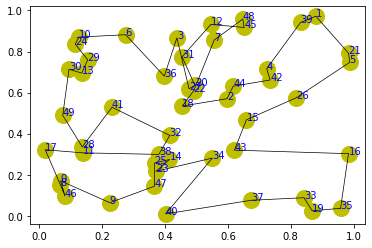

step:2230/5000, actic loss:1.067, critic loss:4.574, L:10.728, 0min1sec
step:2231/5000, actic loss:1.067, critic loss:4.572, L:10.726, 0min1sec
step:2232/5000, actic loss:1.066, critic loss:4.570, L:10.724, 0min1sec
step:2233/5000, actic loss:1.066, critic loss:4.568, L:10.723, 0min1sec
step:2234/5000, actic loss:1.067, critic loss:4.566, L:10.721, 0min1sec
distance:7.174
tensor([16, 36, 31,  2,  7, 46,  5, 41, 40, 10, 49, 33, 26, 42, 32, 47,  9, 20,
        17, 35,  3, 11, 37, 25,  4, 38, 45, 29, 24, 23,  6, 39, 34, 21, 13, 44,
        27, 14,  0,  8, 30, 43, 19, 12, 48, 15, 22, 28, 18,  1])


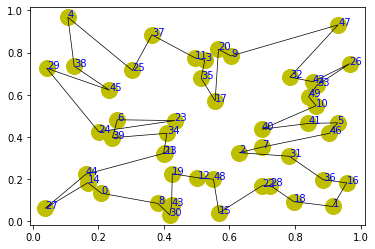

step:2235/5000, actic loss:1.067, critic loss:4.564, L:10.719, 0min1sec
step:2236/5000, actic loss:1.066, critic loss:4.562, L:10.718, 0min1sec
step:2237/5000, actic loss:1.065, critic loss:4.560, L:10.716, 0min2sec
step:2238/5000, actic loss:1.064, critic loss:4.558, L:10.715, 0min1sec
step:2239/5000, actic loss:1.063, critic loss:4.556, L:10.713, 0min1sec
distance:6.886
tensor([24, 20, 30, 41, 22,  4, 10,  6, 25, 11, 49, 45, 32,  8,  2, 35,  1, 36,
        39, 17, 26, 29, 28, 13, 23, 19, 46, 12, 14, 15, 27, 33, 47, 16,  9,  5,
         0, 42,  7, 21, 31, 37, 38, 44, 40, 18, 48,  3, 43, 34])


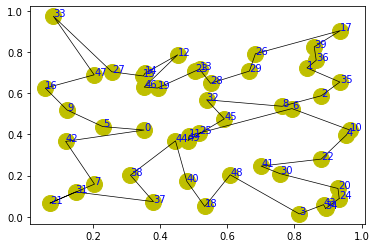

step:2240/5000, actic loss:1.062, critic loss:4.554, L:10.712, 0min2sec
step:2241/5000, actic loss:1.062, critic loss:4.553, L:10.710, 0min1sec
step:2242/5000, actic loss:1.063, critic loss:4.551, L:10.708, 0min1sec
step:2243/5000, actic loss:1.063, critic loss:4.549, L:10.707, 0min1sec
step:2244/5000, actic loss:1.063, critic loss:4.547, L:10.705, 0min1sec
distance:6.784
tensor([35, 32,  2, 12,  6, 25, 34, 17, 11, 42, 47, 20, 40, 21, 19, 48, 16, 39,
        45,  4,  9, 18, 30, 41,  3, 27, 43, 28, 38, 31, 44,  0, 33, 46, 26,  7,
        37, 24, 36, 23, 15,  1, 22, 13, 14, 10, 49,  8, 29,  5])


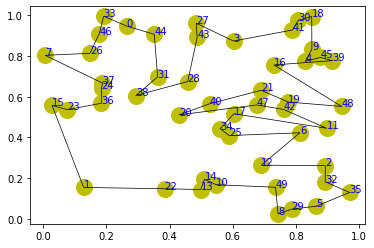

step:2245/5000, actic loss:1.061, critic loss:4.545, L:10.703, 0min1sec
step:2246/5000, actic loss:1.059, critic loss:4.543, L:10.702, 0min1sec
step:2247/5000, actic loss:1.057, critic loss:4.541, L:10.700, 0min1sec
step:2248/5000, actic loss:1.055, critic loss:4.539, L:10.699, 0min1sec
step:2249/5000, actic loss:1.054, critic loss:4.537, L:10.697, 0min1sec
distance:7.246
tensor([45, 21, 11, 23, 18, 29, 17, 26, 35, 47, 12, 42, 49, 31,  5, 10,  8, 37,
        15, 33, 40, 27, 43,  9, 28, 19, 38, 16,  3, 41, 32, 34, 14, 24, 36, 25,
         4,  7, 46, 13, 44, 30, 20,  2,  0, 48, 39,  6, 22,  1])


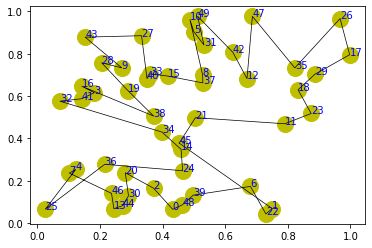

step:2250/5000, actic loss:1.054, critic loss:4.536, L:10.695, 0min2sec
step:2251/5000, actic loss:1.054, critic loss:4.534, L:10.694, 0min2sec
step:2252/5000, actic loss:1.055, critic loss:4.532, L:10.692, 0min1sec
step:2253/5000, actic loss:1.055, critic loss:4.530, L:10.690, 0min1sec
step:2254/5000, actic loss:1.054, critic loss:4.528, L:10.689, 0min1sec
distance:6.326
tensor([41, 43, 22, 32, 20, 46, 48,  4, 30,  3, 38, 39, 49, 37, 10, 19,  6, 44,
        42, 13, 45, 24,  7, 28, 27, 34,  0, 25, 16, 14, 11, 21, 23,  1, 35,  9,
         5, 15, 47,  2, 36, 12, 29, 17, 31,  8, 33, 40, 18, 26])


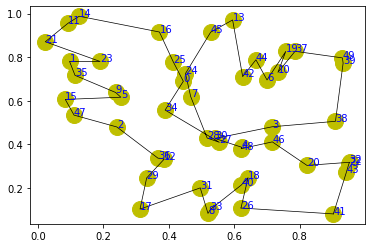

step:2255/5000, actic loss:1.053, critic loss:4.526, L:10.687, 0min1sec
step:2256/5000, actic loss:1.052, critic loss:4.524, L:10.686, 0min1sec
step:2257/5000, actic loss:1.052, critic loss:4.522, L:10.684, 0min1sec
step:2258/5000, actic loss:1.051, critic loss:4.520, L:10.683, 0min1sec
step:2259/5000, actic loss:1.051, critic loss:4.519, L:10.681, 0min1sec
distance:6.891
tensor([12, 49,  6, 20, 27, 18, 24, 10, 46, 15, 11, 17,  4, 48, 39, 38, 16, 35,
         2, 31, 40,  5, 21, 22, 45, 26, 19, 44,  8, 36, 37,  3, 13, 33, 42, 41,
        14, 25, 32, 47,  7, 28,  9, 43, 23, 29,  0, 34, 30,  1])


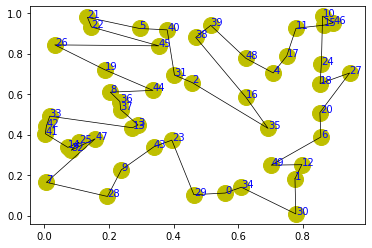

step:2260/5000, actic loss:1.051, critic loss:4.517, L:10.680, 0min1sec
step:2261/5000, actic loss:1.051, critic loss:4.515, L:10.678, 0min1sec
step:2262/5000, actic loss:1.051, critic loss:4.513, L:10.677, 0min2sec
step:2263/5000, actic loss:1.050, critic loss:4.511, L:10.675, 0min1sec
step:2264/5000, actic loss:1.049, critic loss:4.509, L:10.674, 0min1sec
distance:7.746
tensor([ 0, 28, 45, 42, 49, 23, 30,  9, 41, 29,  1, 25, 20, 31,  3, 39, 46, 21,
        32,  6, 10, 40, 14, 15, 47,  8, 26,  2, 48, 36, 33, 37, 22, 11, 18, 44,
        16, 35,  7, 34, 13, 38, 24, 12, 17, 19,  4, 27, 43,  5])


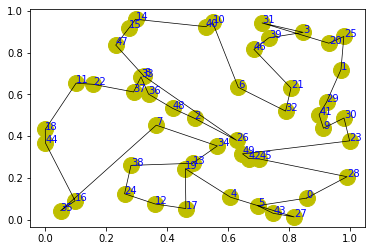

step:2265/5000, actic loss:1.047, critic loss:4.507, L:10.672, 0min1sec
step:2266/5000, actic loss:1.046, critic loss:4.506, L:10.671, 0min1sec
step:2267/5000, actic loss:1.045, critic loss:4.504, L:10.669, 0min1sec
step:2268/5000, actic loss:1.045, critic loss:4.502, L:10.668, 0min1sec
step:2269/5000, actic loss:1.045, critic loss:4.500, L:10.666, 0min1sec
distance:7.432
tensor([29, 18, 44, 21, 19,  0, 14, 38, 32, 34, 47, 30,  1, 35, 43,  9,  2, 40,
        12, 11, 49,  8, 17, 36,  5,  3, 48, 13, 16, 31, 46, 27, 33, 15,  6, 42,
        26, 37, 39, 23, 10,  7, 25, 45, 20, 22, 28,  4, 41, 24])


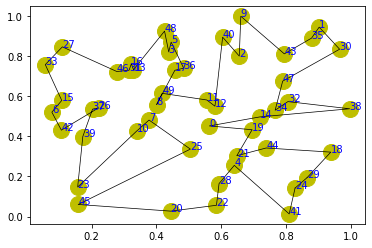

step:2270/5000, actic loss:1.045, critic loss:4.498, L:10.665, 0min1sec
step:2271/5000, actic loss:1.045, critic loss:4.496, L:10.663, 0min1sec
step:2272/5000, actic loss:1.044, critic loss:4.494, L:10.661, 0min1sec
step:2273/5000, actic loss:1.041, critic loss:4.493, L:10.660, 0min1sec
step:2274/5000, actic loss:1.039, critic loss:4.491, L:10.658, 0min2sec
distance:8.074
tensor([18, 23, 24,  4, 14, 48, 19, 39, 37,  1,  3, 31,  9, 28, 22, 26, 15, 34,
         0, 47,  5, 27, 20, 41, 11, 30, 38, 33, 16, 42, 25,  8, 17, 40,  2,  7,
        35, 32, 44, 46,  6, 45, 29, 49, 43, 12, 21, 13, 36, 10])


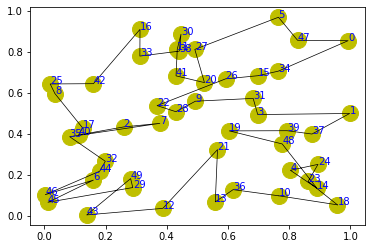

step:2275/5000, actic loss:1.038, critic loss:4.489, L:10.657, 0min2sec
step:2276/5000, actic loss:1.036, critic loss:4.487, L:10.655, 0min1sec
step:2277/5000, actic loss:1.036, critic loss:4.485, L:10.654, 0min1sec
step:2278/5000, actic loss:1.037, critic loss:4.484, L:10.652, 0min1sec
step:2279/5000, actic loss:1.037, critic loss:4.482, L:10.651, 0min1sec
distance:7.731
tensor([49, 42, 15, 44,  1, 41, 36, 48, 34, 32, 20, 37, 10,  4, 46,  9, 13, 33,
         0, 35, 43, 28, 18,  6, 39,  2,  5, 19, 40, 11,  7, 21, 31, 47,  8, 26,
        24, 30, 12, 45, 38, 29, 25, 17, 16, 23, 22,  3, 27, 14])


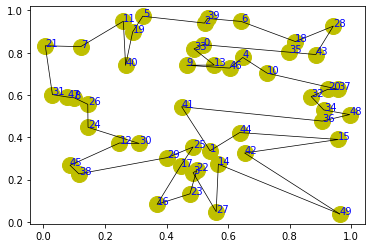

step:2280/5000, actic loss:1.036, critic loss:4.480, L:10.649, 0min1sec
step:2281/5000, actic loss:1.035, critic loss:4.478, L:10.648, 0min1sec
step:2282/5000, actic loss:1.034, critic loss:4.476, L:10.647, 0min1sec
step:2283/5000, actic loss:1.033, critic loss:4.474, L:10.645, 0min1sec
step:2284/5000, actic loss:1.034, critic loss:4.473, L:10.644, 0min1sec
distance:6.809
tensor([42, 14, 13,  7, 31,  1,  0, 25, 19, 23, 24, 34,  6, 46,  4,  8, 28,  5,
        41, 36,  9,  2, 33, 11, 47, 40, 35, 26, 37, 15,  3, 10, 22, 16, 38, 12,
        43, 44, 20, 30, 18, 48, 45, 17, 49, 39, 32, 27, 21, 29])


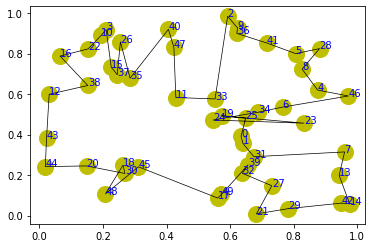

step:2285/5000, actic loss:1.034, critic loss:4.471, L:10.642, 0min1sec
step:2286/5000, actic loss:1.034, critic loss:4.469, L:10.641, 0min1sec
step:2287/5000, actic loss:1.033, critic loss:4.467, L:10.639, 0min2sec
step:2288/5000, actic loss:1.033, critic loss:4.465, L:10.638, 0min2sec
step:2289/5000, actic loss:1.032, critic loss:4.463, L:10.636, 0min1sec
distance:6.669
tensor([25, 16, 39, 20,  2, 23, 14, 42, 35, 48, 30, 44, 32, 46, 45, 19,  3, 26,
         7,  8, 18,  1, 47,  9, 29, 24, 17, 33, 22, 11, 43,  0, 38, 34, 49, 41,
        40,  5, 37,  6, 28, 36, 15, 31, 21, 12, 13,  4, 10, 27])


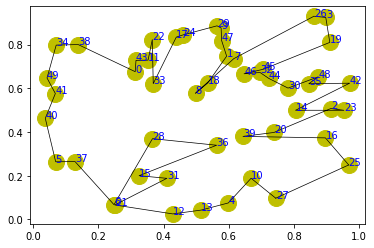

step:2290/5000, actic loss:1.032, critic loss:4.462, L:10.635, 0min1sec
step:2291/5000, actic loss:1.032, critic loss:4.460, L:10.633, 0min1sec
step:2292/5000, actic loss:1.033, critic loss:4.458, L:10.632, 0min1sec
step:2293/5000, actic loss:1.033, critic loss:4.456, L:10.630, 0min1sec
step:2294/5000, actic loss:1.031, critic loss:4.455, L:10.629, 0min1sec
distance:6.360
tensor([ 3, 45, 35, 48, 37, 24, 10,  1, 29, 32, 23, 12, 28, 47, 33, 44, 13,  9,
        31, 30, 26, 11,  6, 27,  5, 41,  2, 18,  4, 14, 34, 16, 42, 43, 49, 46,
        19,  7, 20, 40,  0, 21,  8, 25, 17, 22, 36, 38, 15, 39])


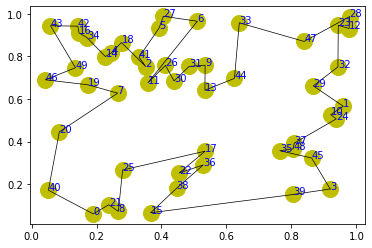

step:2295/5000, actic loss:1.029, critic loss:4.453, L:10.627, 0min1sec
step:2296/5000, actic loss:1.026, critic loss:4.451, L:10.626, 0min1sec
step:2297/5000, actic loss:1.024, critic loss:4.449, L:10.625, 0min1sec
step:2298/5000, actic loss:1.023, critic loss:4.448, L:10.623, 0min1sec
step:2299/5000, actic loss:1.022, critic loss:4.446, L:10.622, 0min1sec
distance:6.556
tensor([ 5, 24, 32, 44,  0, 10,  2, 13, 29, 28, 37,  8, 47, 15, 35,  3, 12, 49,
        30, 41, 38,  7, 48, 14, 27, 46, 22, 42, 25,  4, 33, 36,  6, 39, 23, 40,
        11, 18, 21, 26, 31, 16,  9, 34,  1, 45, 43, 19, 17, 20])


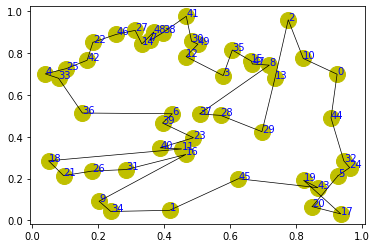

step:2300/5000, actic loss:1.023, critic loss:4.444, L:10.620, 0min1sec
step:2301/5000, actic loss:1.023, critic loss:4.442, L:10.619, 0min1sec
step:2302/5000, actic loss:1.024, critic loss:4.440, L:10.617, 0min1sec
step:2303/5000, actic loss:1.024, critic loss:4.439, L:10.616, 0min1sec
step:2304/5000, actic loss:1.023, critic loss:4.437, L:10.615, 0min1sec
distance:7.012
tensor([14, 49, 32, 13, 28, 46, 33, 30, 15, 18, 42,  3, 39,  0,  6, 21, 16, 40,
        17, 25,  9, 24, 38, 20, 19, 35, 48, 47, 27, 36, 26,  4, 11, 22, 34,  1,
        23,  5, 31, 37, 45,  7, 29, 10, 12,  2,  8, 41, 43, 44])


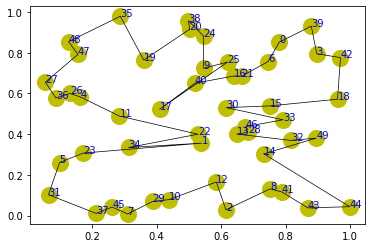

step:2305/5000, actic loss:1.021, critic loss:4.435, L:10.613, 0min1sec
step:2306/5000, actic loss:1.018, critic loss:4.433, L:10.612, 0min1sec
step:2307/5000, actic loss:1.016, critic loss:4.432, L:10.610, 0min1sec
step:2308/5000, actic loss:1.016, critic loss:4.430, L:10.609, 0min1sec
step:2309/5000, actic loss:1.016, critic loss:4.428, L:10.607, 0min1sec
distance:6.776
tensor([ 2, 20, 35,  7, 39, 36, 33, 46, 17,  3, 37, 21,  1, 23, 42, 38, 13, 43,
        28, 15, 49,  9,  4, 10, 26,  6, 12, 16, 44, 41, 48, 40, 47, 32, 27, 34,
        30, 25, 45,  0, 24, 19,  8, 18,  5, 29, 31, 14, 11, 22])


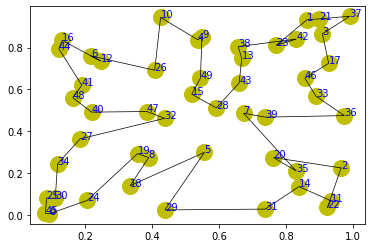

step:2310/5000, actic loss:1.016, critic loss:4.426, L:10.606, 0min1sec
step:2311/5000, actic loss:1.017, critic loss:4.425, L:10.605, 0min1sec
step:2312/5000, actic loss:1.017, critic loss:4.423, L:10.603, 0min1sec
step:2313/5000, actic loss:1.018, critic loss:4.421, L:10.602, 0min1sec
step:2314/5000, actic loss:1.016, critic loss:4.419, L:10.600, 0min1sec
distance:7.426
tensor([ 4, 19, 13,  1, 17, 26, 46, 41,  7, 32, 18, 23, 10, 44, 37, 29, 43, 39,
        47,  6, 20, 16, 12,  8, 15, 28, 48,  9,  0, 40, 42, 31, 33, 21, 14, 38,
        24, 22, 36, 45, 49, 30, 27, 11,  5, 25,  3, 35,  2, 34])


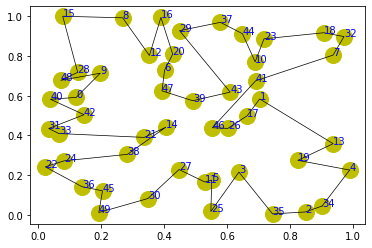

step:2315/5000, actic loss:1.014, critic loss:4.418, L:10.599, 0min1sec
step:2316/5000, actic loss:1.013, critic loss:4.416, L:10.597, 0min1sec
step:2317/5000, actic loss:1.011, critic loss:4.414, L:10.596, 0min1sec
step:2318/5000, actic loss:1.011, critic loss:4.412, L:10.595, 0min1sec
step:2319/5000, actic loss:1.011, critic loss:4.411, L:10.593, 0min1sec
distance:7.701
tensor([16, 40, 35, 39, 21, 37, 13, 28, 45, 23,  3, 17, 19,  6, 12, 47,  5, 24,
        34, 31, 27, 29, 44, 20,  4, 36, 15,  1, 18, 42, 11, 41, 14,  0,  9, 26,
        30, 25, 48, 32, 49, 38, 43,  2, 46, 10, 33,  7, 22,  8])


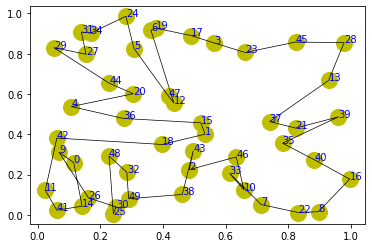

step:2320/5000, actic loss:1.011, critic loss:4.409, L:10.592, 0min1sec
step:2321/5000, actic loss:1.010, critic loss:4.407, L:10.590, 0min1sec
step:2322/5000, actic loss:1.009, critic loss:4.405, L:10.589, 0min1sec
step:2323/5000, actic loss:1.007, critic loss:4.404, L:10.587, 0min1sec
step:2324/5000, actic loss:1.005, critic loss:4.402, L:10.586, 0min1sec
distance:6.621
tensor([ 4, 34, 41, 11, 16, 35, 10, 49, 27,  0, 28, 29, 17, 13, 24,  5, 12, 30,
        18,  8,  2, 37, 46, 44, 42,  1, 39, 32, 40, 48,  6, 47,  7, 36, 23, 19,
        45,  3, 26, 33, 25, 31, 20, 22,  9, 15, 43, 14, 38, 21])


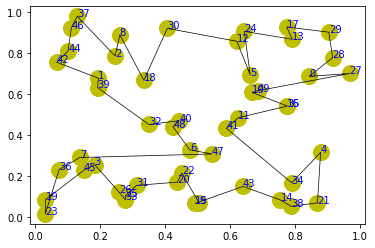

step:2325/5000, actic loss:1.004, critic loss:4.400, L:10.584, 0min2sec
step:2326/5000, actic loss:1.003, critic loss:4.398, L:10.583, 0min1sec
step:2327/5000, actic loss:1.003, critic loss:4.397, L:10.582, 0min1sec
step:2328/5000, actic loss:1.003, critic loss:4.395, L:10.580, 0min1sec
step:2329/5000, actic loss:1.003, critic loss:4.393, L:10.579, 0min1sec
distance:7.120
tensor([10, 32, 38, 26, 14,  8, 42, 44, 36, 31, 40, 17, 43, 49,  5, 28, 27,  6,
        16,  3,  1,  4, 47, 22,  9, 24, 45, 48, 35, 18, 46, 19, 41, 30, 33, 12,
         0, 15, 29, 39, 25, 37, 21,  2, 13, 11, 20, 23, 34,  7])


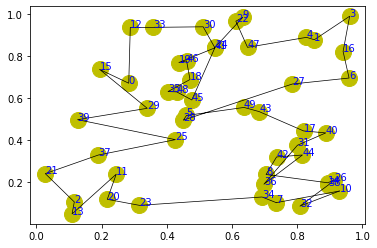

step:2330/5000, actic loss:1.003, critic loss:4.391, L:10.577, 0min2sec
step:2331/5000, actic loss:1.001, critic loss:4.390, L:10.576, 0min1sec
step:2332/5000, actic loss:0.999, critic loss:4.388, L:10.575, 0min1sec
step:2333/5000, actic loss:0.998, critic loss:4.386, L:10.573, 0min1sec
step:2334/5000, actic loss:0.997, critic loss:4.384, L:10.572, 0min1sec
distance:7.008
tensor([ 5, 47, 35, 34, 38, 43, 12, 41, 42,  9, 29,  6, 16, 36, 22, 18, 19, 20,
        15, 46, 49, 23, 14, 31, 32, 44, 13,  8,  3, 48, 17,  0, 40, 28, 11, 37,
        27,  1, 45, 25, 39,  4,  2, 33, 24, 26, 21, 10,  7, 30])


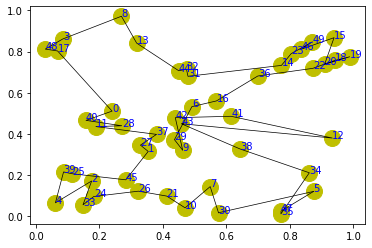

step:2335/5000, actic loss:0.996, critic loss:4.383, L:10.570, 0min2sec
step:2336/5000, actic loss:0.997, critic loss:4.381, L:10.569, 0min1sec
step:2337/5000, actic loss:0.997, critic loss:4.379, L:10.568, 0min1sec
step:2338/5000, actic loss:0.998, critic loss:4.378, L:10.566, 0min1sec
step:2339/5000, actic loss:0.998, critic loss:4.376, L:10.565, 0min1sec
distance:7.159
tensor([ 0,  6, 20, 36, 14, 30, 24,  5, 28,  2, 21, 15, 49, 33, 16,  3,  8, 37,
        38, 13, 17, 31, 23, 48, 42, 22, 18, 29, 11, 41,  7, 47, 45, 40, 44, 39,
        43, 25, 19, 26, 35, 10, 27,  4, 46, 12,  9, 32, 34,  1])


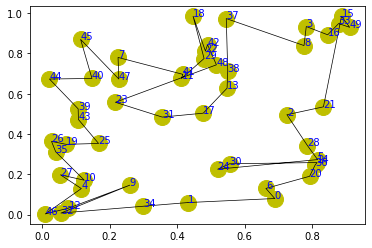

step:2340/5000, actic loss:0.997, critic loss:4.374, L:10.564, 0min2sec
step:2341/5000, actic loss:0.994, critic loss:4.373, L:10.562, 0min1sec
step:2342/5000, actic loss:0.993, critic loss:4.371, L:10.561, 0min1sec
step:2343/5000, actic loss:0.991, critic loss:4.369, L:10.560, 0min1sec
step:2344/5000, actic loss:0.989, critic loss:4.367, L:10.559, 0min1sec
distance:7.938
tensor([ 0, 30, 20,  6, 16, 15, 25,  5, 35, 44, 22,  4, 13,  7, 34, 39, 29, 37,
        24, 19, 12, 49, 14, 42, 10, 38, 45,  9, 36,  3, 31, 21, 23, 48, 32, 18,
        28, 17, 33, 46, 40,  8, 47,  2,  1, 11, 26, 27, 43, 41])


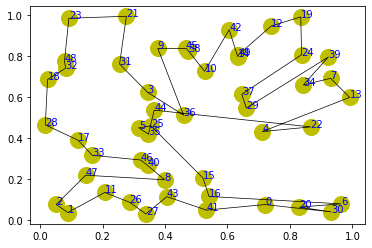

step:2345/5000, actic loss:0.989, critic loss:4.366, L:10.558, 0min1sec
step:2346/5000, actic loss:0.990, critic loss:4.364, L:10.556, 0min1sec
step:2347/5000, actic loss:0.990, critic loss:4.362, L:10.555, 0min1sec
step:2348/5000, actic loss:0.991, critic loss:4.361, L:10.554, 0min1sec
step:2349/5000, actic loss:0.991, critic loss:4.359, L:10.553, 0min1sec
distance:6.999
tensor([ 1, 38, 28, 31, 11, 13, 18, 40, 35, 33, 29, 10,  5,  0, 36, 48, 25, 23,
        22, 20, 16,  9, 44, 37, 15, 42, 26, 39, 49, 46, 34, 32, 21, 19,  4,  7,
        41, 30, 27, 47, 12, 17,  3, 14, 45,  8, 24,  2,  6, 43])


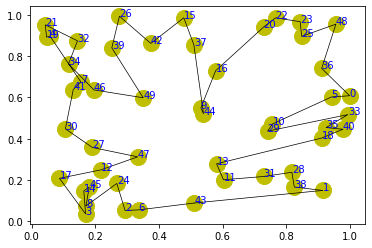

step:2350/5000, actic loss:0.990, critic loss:4.357, L:10.551, 0min1sec
step:2351/5000, actic loss:0.989, critic loss:4.356, L:10.550, 0min1sec
step:2352/5000, actic loss:0.988, critic loss:4.354, L:10.549, 0min1sec
step:2353/5000, actic loss:0.986, critic loss:4.352, L:10.547, 0min1sec
step:2354/5000, actic loss:0.985, critic loss:4.350, L:10.546, 0min1sec
distance:6.444
tensor([12, 31, 24, 19, 32,  5,  3, 10, 38,  8, 23, 42,  9,  4, 18,  6, 49, 28,
        14, 15, 35, 37, 22, 11, 39, 21, 36, 44, 41,  0, 43, 46, 25, 30, 17, 29,
        40, 48, 26,  7, 20, 47, 34,  1, 45, 27, 13,  2, 16, 33])


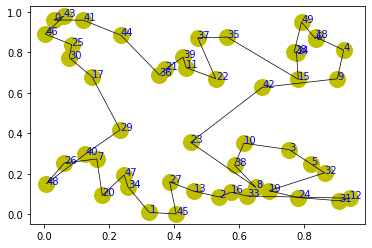

step:2355/5000, actic loss:0.986, critic loss:4.349, L:10.545, 0min1sec
step:2356/5000, actic loss:0.987, critic loss:4.347, L:10.543, 0min1sec
step:2357/5000, actic loss:0.989, critic loss:4.345, L:10.542, 0min1sec
step:2358/5000, actic loss:0.990, critic loss:4.344, L:10.541, 0min1sec
step:2359/5000, actic loss:0.992, critic loss:4.342, L:10.539, 0min1sec
distance:6.682
tensor([13, 14, 43, 42, 20, 40, 39, 27, 15, 32, 49, 11, 46, 47, 12, 48,  3, 33,
        16, 36, 31, 35, 18, 25, 28, 37,  7, 17,  9, 23,  0,  2, 34, 44, 26, 24,
         8, 19, 45, 41,  6, 21, 30, 22, 38,  1, 29,  5, 10,  4])


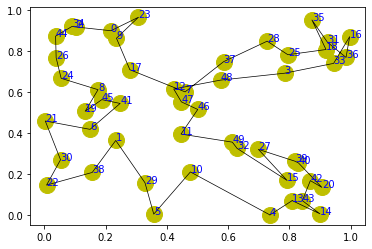

step:2360/5000, actic loss:0.991, critic loss:4.340, L:10.538, 0min2sec
step:2361/5000, actic loss:0.990, critic loss:4.339, L:10.537, 0min1sec
step:2362/5000, actic loss:0.987, critic loss:4.337, L:10.535, 0min1sec
step:2363/5000, actic loss:0.984, critic loss:4.336, L:10.534, 0min1sec
step:2364/5000, actic loss:0.981, critic loss:4.334, L:10.532, 0min1sec
distance:8.317
tensor([24, 36, 38, 19, 30, 28,  7, 49,  4, 15, 31, 43, 11, 27, 35, 23, 29, 10,
         5, 33, 20, 13,  9, 32, 21, 14, 34, 47, 46,  8,  3, 25, 45, 12,  2, 17,
        41, 40, 26, 39, 44, 22, 18,  1,  6, 16, 37, 48, 42,  0])


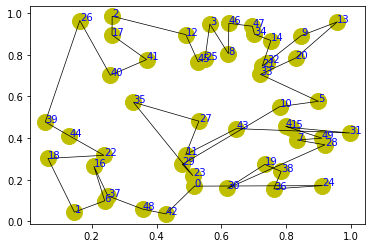

step:2365/5000, actic loss:0.979, critic loss:4.332, L:10.531, 0min2sec
step:2366/5000, actic loss:0.977, critic loss:4.331, L:10.530, 0min1sec
step:2367/5000, actic loss:0.976, critic loss:4.329, L:10.528, 0min1sec
step:2368/5000, actic loss:0.977, critic loss:4.327, L:10.527, 0min1sec
step:2369/5000, actic loss:0.980, critic loss:4.326, L:10.526, 0min1sec
distance:7.460
tensor([ 5, 15, 14, 42,  4,  8, 44, 40, 27, 35, 46,  7, 17, 13, 24, 23, 18, 36,
        34, 16, 21, 28,  1, 25,  3, 38,  9, 10, 22, 47,  2, 26, 31, 12, 30, 48,
        19, 33, 11, 20,  6, 45, 29, 39,  0, 41, 49, 43, 37, 32])


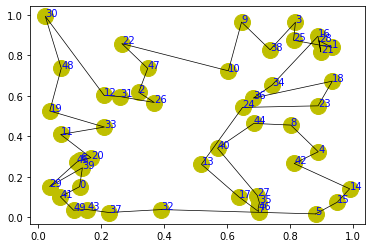

step:2370/5000, actic loss:0.982, critic loss:4.324, L:10.524, 0min2sec
step:2371/5000, actic loss:0.984, critic loss:4.323, L:10.523, 0min1sec
step:2372/5000, actic loss:0.986, critic loss:4.321, L:10.522, 0min1sec
step:2373/5000, actic loss:0.986, critic loss:4.320, L:10.520, 0min1sec
step:2374/5000, actic loss:0.986, critic loss:4.318, L:10.519, 0min1sec
distance:7.013
tensor([ 5, 17, 34, 13, 25, 42, 48, 23, 41, 37, 40, 47, 28, 33, 49, 44, 35, 27,
        43, 36, 12, 38, 18, 10,  9, 20, 39, 14, 15,  8, 29, 32, 30, 22, 21,  6,
         1,  0, 26, 19,  7,  2, 46, 11, 24,  3, 45,  4, 31, 16])


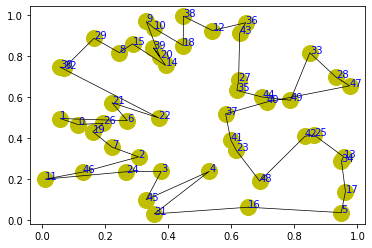

step:2375/5000, actic loss:0.984, critic loss:4.316, L:10.518, 0min1sec
step:2376/5000, actic loss:0.981, critic loss:4.315, L:10.517, 0min1sec
step:2377/5000, actic loss:0.979, critic loss:4.313, L:10.515, 0min1sec
step:2378/5000, actic loss:0.977, critic loss:4.312, L:10.514, 0min1sec
step:2379/5000, actic loss:0.977, critic loss:4.310, L:10.513, 0min1sec
distance:7.305
tensor([32, 25, 19, 46,  7,  1, 11,  8, 22,  3, 33, 34, 20,  6, 37,  4, 14, 40,
        35, 23,  2, 24, 36, 44, 28, 12, 10, 17,  9, 30, 48, 13, 21, 49, 31,  0,
        39,  5, 26, 38, 42, 18, 27, 29, 16, 43, 47, 45, 15, 41])


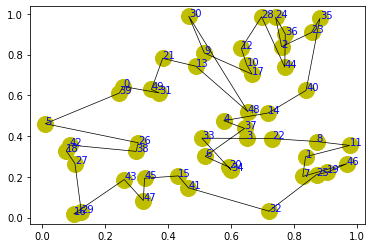

step:2380/5000, actic loss:0.977, critic loss:4.308, L:10.512, 0min1sec
step:2381/5000, actic loss:0.977, critic loss:4.307, L:10.511, 0min1sec
step:2382/5000, actic loss:0.976, critic loss:4.305, L:10.509, 0min1sec
step:2383/5000, actic loss:0.976, critic loss:4.304, L:10.508, 0min1sec
step:2384/5000, actic loss:0.975, critic loss:4.302, L:10.507, 0min2sec
distance:7.277
tensor([35, 41, 12, 25, 22, 31, 16, 40, 24, 46, 14, 13,  5, 19, 10,  6, 11,  4,
         2, 23, 15, 28, 29, 36,  3, 20, 42, 33, 34,  9, 38, 45, 39, 49, 48, 30,
         1, 17,  7, 47, 18, 43,  8, 26, 21, 44, 37,  0, 27, 32])


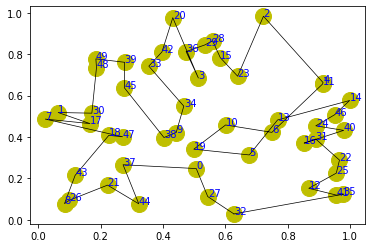

step:2385/5000, actic loss:0.975, critic loss:4.300, L:10.506, 0min2sec
step:2386/5000, actic loss:0.973, critic loss:4.298, L:10.504, 0min1sec
step:2387/5000, actic loss:0.972, critic loss:4.297, L:10.503, 0min1sec
step:2388/5000, actic loss:0.972, critic loss:4.295, L:10.502, 0min1sec
step:2389/5000, actic loss:0.972, critic loss:4.293, L:10.500, 0min1sec
distance:6.914
tensor([13,  9, 39, 44, 20,  6, 22, 31, 36, 12,  0, 37, 48, 15, 25,  3, 38, 42,
        11, 47, 27, 18, 40,  7, 46, 19, 32, 10,  8, 33,  4, 23, 43, 21, 30, 35,
         2, 29, 26, 14, 28, 41, 24, 45, 17,  5, 34, 16, 49,  1])


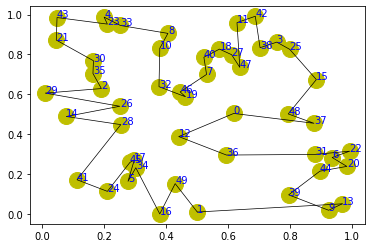

step:2390/5000, actic loss:0.972, critic loss:4.292, L:10.499, 0min2sec
step:2391/5000, actic loss:0.972, critic loss:4.290, L:10.498, 0min1sec
step:2392/5000, actic loss:0.971, critic loss:4.288, L:10.496, 0min1sec
step:2393/5000, actic loss:0.970, critic loss:4.287, L:10.495, 0min1sec
step:2394/5000, actic loss:0.968, critic loss:4.285, L:10.494, 0min1sec
distance:7.539
tensor([42, 24, 14, 22, 12, 10, 41, 20, 34, 17, 28, 46, 39, 33, 29, 18, 13, 27,
        19, 45, 26,  5, 23,  0, 40, 25, 21, 38, 32,  8, 37,  7,  2,  6, 49,  9,
         4, 35,  1, 43, 15,  3, 47, 44, 48, 36, 31, 16, 30, 11])


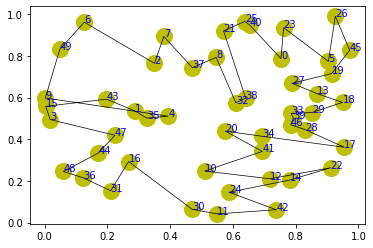

step:2395/5000, actic loss:0.968, critic loss:4.283, L:10.492, 0min2sec
step:2396/5000, actic loss:0.968, critic loss:4.282, L:10.491, 0min1sec
step:2397/5000, actic loss:0.967, critic loss:4.280, L:10.490, 0min1sec
step:2398/5000, actic loss:0.967, critic loss:4.278, L:10.488, 0min1sec
step:2399/5000, actic loss:0.966, critic loss:4.277, L:10.487, 0min1sec
distance:7.670
tensor([40, 12,  3, 22, 28,  0, 47, 16, 30, 37,  1, 31,  6, 43, 41, 24, 23, 33,
        48, 34,  7,  2,  4, 38, 17, 39, 14, 49, 27, 11, 42, 29, 36, 21, 18, 32,
        46, 25, 45,  8, 13, 15,  9, 19, 26,  5, 10, 20, 35, 44])


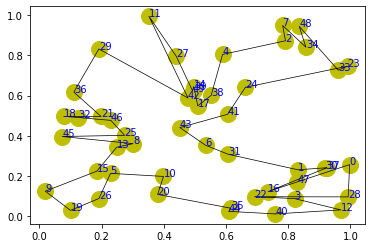

step:2400/5000, actic loss:0.965, critic loss:4.275, L:10.486, 0min2sec
step:2401/5000, actic loss:0.965, critic loss:4.273, L:10.484, 0min1sec
step:2402/5000, actic loss:0.964, critic loss:4.272, L:10.483, 0min1sec
step:2403/5000, actic loss:0.963, critic loss:4.270, L:10.482, 0min1sec
step:2404/5000, actic loss:0.963, critic loss:4.269, L:10.481, 0min1sec
distance:6.804
tensor([ 4,  2, 42, 26,  8, 38,  7, 40, 11, 12, 21, 18,  0, 43, 15, 16, 25, 13,
        22, 10, 19, 39, 44, 29, 41, 36, 32, 45,  6, 24, 20,  1, 28, 27, 46, 31,
        30, 47, 37, 23, 14, 35, 33, 17, 49, 34,  3,  9,  5, 48])


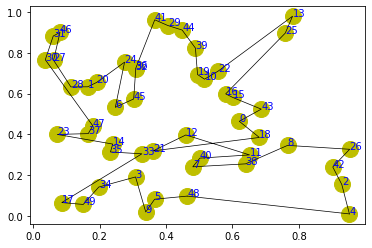

step:2405/5000, actic loss:0.962, critic loss:4.267, L:10.479, 0min1sec
step:2406/5000, actic loss:0.962, critic loss:4.265, L:10.478, 0min1sec
step:2407/5000, actic loss:0.962, critic loss:4.264, L:10.477, 0min1sec
step:2408/5000, actic loss:0.961, critic loss:4.262, L:10.476, 0min1sec
step:2409/5000, actic loss:0.959, critic loss:4.260, L:10.475, 0min1sec
distance:7.197
tensor([16, 37, 44,  6, 49, 27, 42, 18, 24, 10, 38, 30, 46,  5, 15,  9, 47, 34,
        25, 17, 41, 14,  3, 13,  7, 31,  4, 35, 26,  0, 21, 39,  8, 33, 32, 48,
        45,  2, 11, 19, 43, 29, 40,  1, 22, 36, 20, 12, 23, 28])


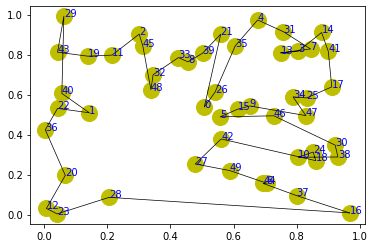

step:2410/5000, actic loss:0.958, critic loss:4.259, L:10.473, 0min2sec
step:2411/5000, actic loss:0.957, critic loss:4.257, L:10.472, 0min1sec
step:2412/5000, actic loss:0.957, critic loss:4.256, L:10.471, 0min1sec
step:2413/5000, actic loss:0.956, critic loss:4.254, L:10.470, 0min1sec
step:2414/5000, actic loss:0.955, critic loss:4.252, L:10.468, 0min1sec
distance:7.041
tensor([48, 12, 23, 43, 13, 19,  1,  7, 39, 11, 42, 33,  5,  2, 10, 14, 16, 49,
        44, 15,  6, 21, 46, 26, 27,  8,  0, 38, 18, 41, 32, 17, 34,  3, 28, 37,
        25, 22, 36, 40, 31, 30, 47, 20, 24,  4,  9, 29, 35, 45])


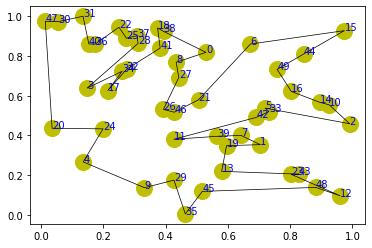

step:2415/5000, actic loss:0.955, critic loss:4.251, L:10.467, 0min2sec
step:2416/5000, actic loss:0.954, critic loss:4.249, L:10.466, 0min1sec
step:2417/5000, actic loss:0.954, critic loss:4.247, L:10.465, 0min2sec
step:2418/5000, actic loss:0.953, critic loss:4.246, L:10.463, 0min1sec
step:2419/5000, actic loss:0.953, critic loss:4.244, L:10.462, 0min1sec
distance:7.427
tensor([27, 18, 40, 10,  0,  3, 29, 19, 42, 47, 35,  8, 44, 21, 12, 48, 20, 26,
         2, 23, 34, 16, 15,  6, 24, 14, 36, 41, 38, 33, 32, 46, 37, 39, 45,  1,
         7, 30, 22, 28, 13, 17,  5, 49,  9, 11,  4, 31, 25, 43])


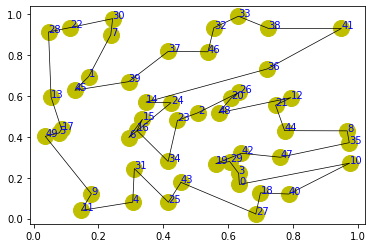

step:2420/5000, actic loss:0.953, critic loss:4.243, L:10.461, 0min1sec
step:2421/5000, actic loss:0.952, critic loss:4.241, L:10.460, 0min1sec
step:2422/5000, actic loss:0.951, critic loss:4.239, L:10.458, 0min1sec
step:2423/5000, actic loss:0.950, critic loss:4.238, L:10.457, 0min1sec
step:2424/5000, actic loss:0.950, critic loss:4.236, L:10.456, 0min1sec
distance:7.931
tensor([29, 41, 30,  3, 12,  6, 15,  1,  9, 17, 45, 23, 11, 21, 31,  0, 47, 38,
        27, 36, 37, 16, 49, 34,  2, 35, 22, 42, 28, 33, 44,  5, 10, 26, 25,  8,
        39, 32, 20, 18, 40, 48, 14, 13, 19, 24,  7,  4, 46, 43])


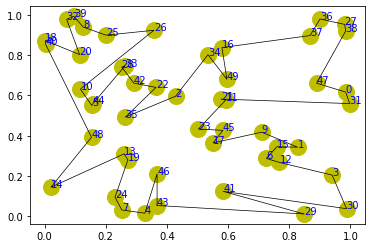

step:2425/5000, actic loss:0.950, critic loss:4.234, L:10.455, 0min2sec
step:2426/5000, actic loss:0.950, critic loss:4.233, L:10.453, 0min1sec
step:2427/5000, actic loss:0.949, critic loss:4.231, L:10.452, 0min1sec
step:2428/5000, actic loss:0.948, critic loss:4.230, L:10.451, 0min1sec
step:2429/5000, actic loss:0.946, critic loss:4.228, L:10.450, 0min1sec
distance:6.635
tensor([45,  5,  0, 15,  6, 37, 16, 24, 33, 19, 13, 43, 18, 42,  3, 48, 41, 20,
         9, 10, 36, 14, 27, 23, 25, 17, 35, 31, 22,  2,  1, 26, 39, 11, 44, 46,
        21, 34, 40,  8, 29, 30, 32, 28, 12, 49, 38,  4, 47,  7])


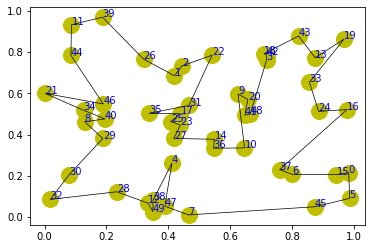

step:2430/5000, actic loss:0.945, critic loss:4.227, L:10.449, 0min1sec
step:2431/5000, actic loss:0.945, critic loss:4.225, L:10.448, 0min1sec
step:2432/5000, actic loss:0.946, critic loss:4.224, L:10.446, 0min1sec
step:2433/5000, actic loss:0.947, critic loss:4.222, L:10.445, 0min1sec
step:2434/5000, actic loss:0.948, critic loss:4.220, L:10.444, 0min1sec
distance:7.354
tensor([10, 21, 35, 17, 13, 12, 37, 32, 38, 48, 14,  2, 39, 40, 22, 43,  5, 33,
         9,  1, 27, 16, 20, 11, 41,  0, 47, 42, 26, 31, 23,  4,  3,  8, 18, 46,
        29,  6, 36, 44, 30, 49, 45, 19, 24, 15, 28, 25, 34,  7])


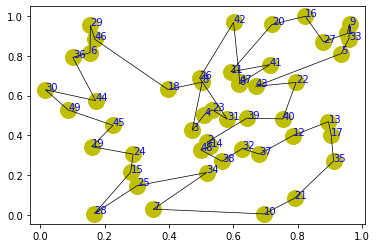

step:2435/5000, actic loss:0.948, critic loss:4.219, L:10.443, 0min2sec
step:2436/5000, actic loss:0.948, critic loss:4.217, L:10.442, 0min1sec
step:2437/5000, actic loss:0.946, critic loss:4.216, L:10.440, 0min1sec
step:2438/5000, actic loss:0.945, critic loss:4.214, L:10.439, 0min1sec
step:2439/5000, actic loss:0.943, critic loss:4.213, L:10.438, 0min1sec
distance:7.131
tensor([40,  2, 34, 13, 11, 42,  4, 15, 36, 24, 21,  8, 33, 28, 19, 10,  0, 43,
        31,  7, 12,  6, 39, 18, 16, 30,  1, 29, 49,  5, 27, 26, 23, 45, 14, 37,
        44, 46,  3, 22, 41, 17, 20, 38,  9, 25, 48, 35, 47, 32])


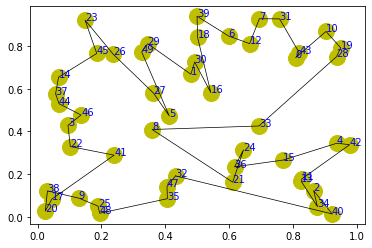

step:2440/5000, actic loss:0.942, critic loss:4.211, L:10.437, 0min2sec
step:2441/5000, actic loss:0.941, critic loss:4.209, L:10.435, 0min1sec
step:2442/5000, actic loss:0.942, critic loss:4.208, L:10.434, 0min1sec
step:2443/5000, actic loss:0.943, critic loss:4.206, L:10.433, 0min1sec
step:2444/5000, actic loss:0.944, critic loss:4.205, L:10.431, 0min1sec
distance:7.261
tensor([19, 10, 17,  4, 31,  1, 47, 15,  6, 32, 43, 11, 41,  8, 38, 36,  9,  5,
         7, 34, 30, 24, 27, 23, 22, 28, 39, 20,  2, 35, 40, 21, 46, 45, 49, 16,
        14,  0, 42, 29, 13, 18, 26,  3, 44, 48, 37, 25, 12, 33])


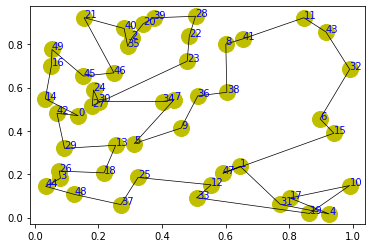

step:2445/5000, actic loss:0.944, critic loss:4.203, L:10.430, 0min2sec
step:2446/5000, actic loss:0.944, critic loss:4.201, L:10.429, 0min1sec
step:2447/5000, actic loss:0.942, critic loss:4.200, L:10.428, 0min1sec
step:2448/5000, actic loss:0.941, critic loss:4.198, L:10.426, 0min1sec
step:2449/5000, actic loss:0.939, critic loss:4.197, L:10.425, 0min2sec
distance:7.621
tensor([43, 37, 23, 29, 10,  0, 48, 31, 26, 30, 22,  4, 11, 28,  5, 45, 44, 21,
        19, 16, 32, 24, 12, 36, 27, 13, 25,  8, 15, 34, 41,  7, 39, 17, 42, 47,
        14,  6,  3, 20, 35, 18, 40,  2,  1, 49,  9, 46, 38, 33])


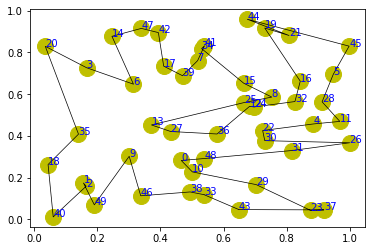

step:2450/5000, actic loss:0.938, critic loss:4.195, L:10.424, 0min2sec
step:2451/5000, actic loss:0.937, critic loss:4.194, L:10.422, 0min1sec
step:2452/5000, actic loss:0.937, critic loss:4.192, L:10.421, 0min1sec
step:2453/5000, actic loss:0.937, critic loss:4.190, L:10.420, 0min1sec
step:2454/5000, actic loss:0.938, critic loss:4.189, L:10.419, 0min1sec
distance:7.102
tensor([41, 26, 32, 18,  7, 20, 39, 11, 43, 49,  2, 10, 31, 19, 25, 47, 24, 33,
        12,  6, 13, 30, 35, 37,  1, 16,  5, 42, 15, 40, 48,  9,  0, 29,  8, 36,
        22, 14, 34,  3, 46, 21, 44, 17, 27, 45, 28,  4, 38, 23])


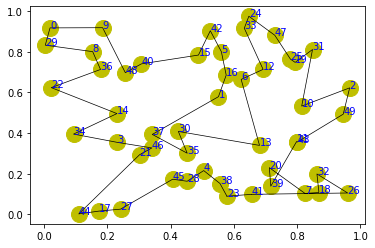

step:2455/5000, actic loss:0.938, critic loss:4.187, L:10.417, 0min2sec
step:2456/5000, actic loss:0.938, critic loss:4.186, L:10.416, 0min1sec
step:2457/5000, actic loss:0.937, critic loss:4.184, L:10.415, 0min1sec
step:2458/5000, actic loss:0.935, critic loss:4.183, L:10.413, 0min1sec
step:2459/5000, actic loss:0.934, critic loss:4.181, L:10.412, 0min1sec
distance:7.033
tensor([49, 39,  8, 38, 42,  6, 10, 37, 15,  9, 41, 16, 32, 36,  1, 26, 27, 30,
        19, 45, 11, 18, 23, 28,  7, 44, 21, 20, 40, 43, 31, 25,  2, 24,  5, 13,
        29, 35,  4, 14, 34, 17, 33, 22,  0, 12, 46, 47,  3, 48])


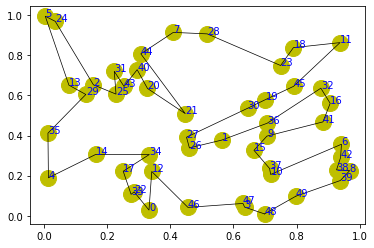

step:2460/5000, actic loss:0.933, critic loss:4.179, L:10.411, 0min2sec
step:2461/5000, actic loss:0.932, critic loss:4.178, L:10.409, 0min1sec
step:2462/5000, actic loss:0.932, critic loss:4.176, L:10.408, 0min2sec
step:2463/5000, actic loss:0.933, critic loss:4.175, L:10.407, 0min1sec
step:2464/5000, actic loss:0.934, critic loss:4.173, L:10.405, 0min1sec
distance:7.030
tensor([21,  0, 23, 43,  8, 39, 35,  9, 42, 22, 25,  2, 13, 31, 26, 24,  7, 38,
        36,  1, 27,  6, 28, 48, 37, 10, 18, 33, 32, 20, 14, 16, 46,  4, 19, 12,
        41, 44,  3, 47, 30,  5, 40, 45, 34, 11, 17, 15, 49, 29])


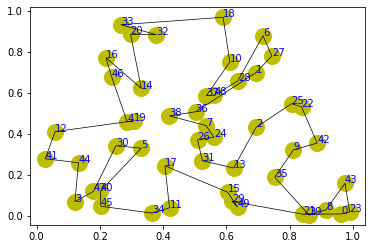

step:2465/5000, actic loss:0.934, critic loss:4.172, L:10.404, 0min2sec
step:2466/5000, actic loss:0.934, critic loss:4.170, L:10.403, 0min1sec
step:2467/5000, actic loss:0.933, critic loss:4.169, L:10.401, 0min1sec
step:2468/5000, actic loss:0.931, critic loss:4.167, L:10.400, 0min1sec
step:2469/5000, actic loss:0.929, critic loss:4.165, L:10.399, 0min1sec
distance:6.951
tensor([41, 31, 14, 26,  4, 22, 20, 21, 48, 40, 11, 32, 15, 39, 44, 29, 19,  6,
        25, 46,  1, 33, 49, 27, 42, 34,  2, 16,  0, 10, 23,  7, 12, 17, 45, 30,
        24, 47,  8,  5,  9, 43, 28, 36, 38,  3, 37, 35, 18, 13])


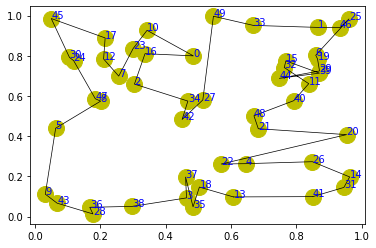

step:2470/5000, actic loss:0.928, critic loss:4.164, L:10.398, 0min2sec
step:2471/5000, actic loss:0.927, critic loss:4.162, L:10.396, 0min1sec
step:2472/5000, actic loss:0.927, critic loss:4.161, L:10.395, 0min1sec
step:2473/5000, actic loss:0.928, critic loss:4.159, L:10.394, 0min1sec
step:2474/5000, actic loss:0.929, critic loss:4.158, L:10.392, 0min1sec
distance:7.031
tensor([26,  4,  3, 33, 37, 30,  8, 18, 46, 47, 20, 19, 12, 29, 42, 27, 25, 22,
        35, 24, 17,  9, 36, 45, 28, 16, 11,  2, 43, 21, 41, 39, 32, 38, 44,  5,
        49, 31, 34, 14,  6, 48,  1,  0, 40, 13,  7, 15, 23, 10])


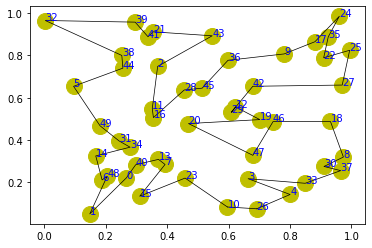

step:2475/5000, actic loss:0.929, critic loss:4.156, L:10.391, 0min2sec
step:2476/5000, actic loss:0.929, critic loss:4.155, L:10.390, 0min1sec
step:2477/5000, actic loss:0.927, critic loss:4.153, L:10.389, 0min2sec
step:2478/5000, actic loss:0.926, critic loss:4.152, L:10.387, 0min1sec
step:2479/5000, actic loss:0.924, critic loss:4.150, L:10.386, 0min2sec
distance:7.262
tensor([48, 23,  5,  9, 25, 36, 33,  8, 21, 18, 27, 42, 16, 32,  0,  6, 49, 31,
        41, 40, 34, 24, 47, 17, 46,  7, 11,  1, 38, 20,  4, 45, 19,  2, 14, 10,
        26, 44, 43,  3, 13, 30, 29, 37, 28, 39, 12, 22, 15, 35])


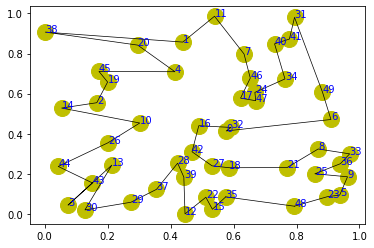

step:2480/5000, actic loss:0.923, critic loss:4.149, L:10.385, 0min2sec
step:2481/5000, actic loss:0.922, critic loss:4.147, L:10.383, 0min1sec
step:2482/5000, actic loss:0.922, critic loss:4.145, L:10.382, 0min1sec
step:2483/5000, actic loss:0.923, critic loss:4.144, L:10.381, 0min1sec
step:2484/5000, actic loss:0.923, critic loss:4.142, L:10.380, 0min1sec
distance:6.629
tensor([39, 10, 29, 24, 31, 40, 30, 45, 18, 44, 28, 37, 34, 14, 25, 42, 23, 11,
        17, 38,  5,  6,  3, 46,  7,  2,  8, 43, 13, 16,  9, 49,  4, 12, 35, 19,
        33, 48, 26, 36, 15, 22, 21, 20, 27, 41, 47, 32,  0,  1])


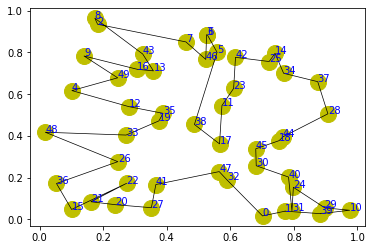

step:2485/5000, actic loss:0.922, critic loss:4.141, L:10.378, 0min2sec
step:2486/5000, actic loss:0.921, critic loss:4.139, L:10.377, 0min1sec
step:2487/5000, actic loss:0.919, critic loss:4.138, L:10.376, 0min1sec
step:2488/5000, actic loss:0.919, critic loss:4.136, L:10.375, 0min1sec
step:2489/5000, actic loss:0.919, critic loss:4.135, L:10.373, 0min1sec
distance:6.318
tensor([ 7, 38, 22,  4, 19, 48,  2,  9, 39, 32, 33,  6, 49, 46, 29, 23, 16, 34,
        42, 41, 31, 10, 30, 15, 44, 43,  5, 47, 40, 25, 13, 24, 18, 37, 36,  8,
        27, 17, 45, 11, 20, 21, 14,  3, 12,  0, 28,  1, 35, 26])


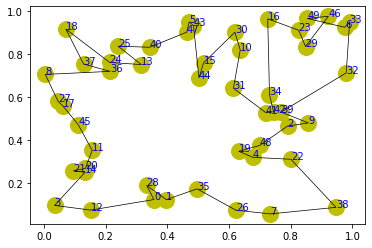

step:2490/5000, actic loss:0.919, critic loss:4.133, L:10.372, 0min2sec
step:2491/5000, actic loss:0.919, critic loss:4.131, L:10.371, 0min1sec
step:2492/5000, actic loss:0.918, critic loss:4.130, L:10.370, 0min2sec
step:2493/5000, actic loss:0.918, critic loss:4.128, L:10.368, 0min2sec
step:2494/5000, actic loss:0.917, critic loss:4.127, L:10.367, 0min1sec
distance:7.244
tensor([ 2,  4, 18, 13, 23, 19,  3, 26, 37, 41,  5, 11, 34, 36, 21, 24, 43, 15,
        30,  8, 45, 12, 31,  1, 32, 29, 48,  6,  9, 40, 49, 10, 17, 35,  7, 25,
        42, 14, 27, 44, 22, 47, 38, 28, 16, 20, 39, 46,  0, 33])


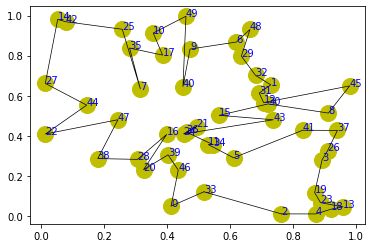

step:2495/5000, actic loss:0.916, critic loss:4.125, L:10.366, 0min2sec
step:2496/5000, actic loss:0.916, critic loss:4.124, L:10.364, 0min1sec
step:2497/5000, actic loss:0.915, critic loss:4.122, L:10.363, 0min1sec
step:2498/5000, actic loss:0.915, critic loss:4.121, L:10.362, 0min1sec
step:2499/5000, actic loss:0.914, critic loss:4.119, L:10.361, 0min1sec
distance:8.195
tensor([30,  4, 29, 41, 11, 38, 25, 37, 34, 15, 45, 27, 43, 20, 35, 18, 13, 26,
         7, 39, 49,  6,  8, 23, 14, 42, 24, 40,  3, 48,  9, 21, 46, 17,  1, 47,
        32, 28,  2, 33,  5, 31, 10, 19, 12,  0, 16, 22, 44, 36])


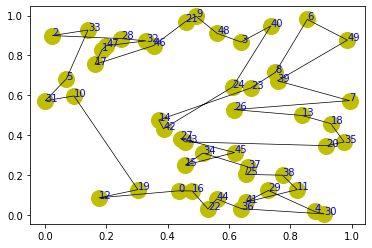

step:2500/5000, actic loss:0.914, critic loss:4.118, L:10.359, 0min1sec
step:2501/5000, actic loss:0.914, critic loss:4.116, L:10.358, 0min1sec
step:2502/5000, actic loss:0.913, critic loss:4.115, L:10.357, 0min1sec
step:2503/5000, actic loss:0.912, critic loss:4.113, L:10.356, 0min1sec
step:2504/5000, actic loss:0.912, critic loss:4.112, L:10.355, 0min1sec
distance:7.588
tensor([ 5, 25, 24, 39, 41, 42, 40,  9, 37,  1, 11,  3, 14, 49,  0,  6, 15, 32,
        19, 33, 17, 16, 13, 20, 12, 10, 29, 28,  8,  4, 34,  7, 43, 22, 26, 36,
        31, 47, 18, 30, 48,  2, 23, 45, 21, 35, 27, 46, 44, 38])


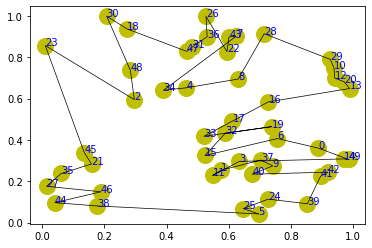

step:2505/5000, actic loss:0.912, critic loss:4.110, L:10.353, 0min2sec
step:2506/5000, actic loss:0.912, critic loss:4.108, L:10.352, 0min1sec
step:2507/5000, actic loss:0.912, critic loss:4.107, L:10.351, 0min1sec
step:2508/5000, actic loss:0.911, critic loss:4.105, L:10.350, 0min2sec
step:2509/5000, actic loss:0.910, critic loss:4.104, L:10.348, 0min1sec
distance:7.288
tensor([15, 10,  0,  8, 20, 47, 48,  3, 21, 35,  7, 45, 40, 22, 31, 43,  5, 14,
        24, 18,  4, 19, 29, 34, 30, 41, 36, 12, 26, 33,  1, 44, 37, 17, 39, 38,
         2, 32, 46,  9, 13,  6, 11, 42, 28, 27, 23, 49, 16, 25])


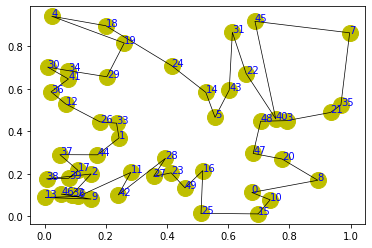

step:2510/5000, actic loss:0.910, critic loss:4.102, L:10.347, 0min2sec
step:2511/5000, actic loss:0.910, critic loss:4.101, L:10.346, 0min1sec
step:2512/5000, actic loss:0.909, critic loss:4.099, L:10.345, 0min1sec
step:2513/5000, actic loss:0.908, critic loss:4.098, L:10.344, 0min1sec
step:2514/5000, actic loss:0.908, critic loss:4.096, L:10.342, 0min1sec
distance:7.248
tensor([ 3, 22, 18, 24, 39, 46, 28,  4, 27, 20, 21, 35, 42, 26, 34, 40, 15,  6,
         5, 49, 16,  0, 44, 19, 13, 25, 29, 32, 31, 33, 12, 38,  7,  2, 45, 23,
        37, 17, 11, 30, 48,  1, 14,  8, 41, 36, 10, 43, 47,  9])


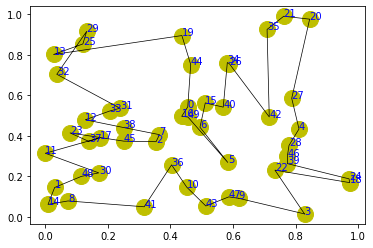

step:2515/5000, actic loss:0.908, critic loss:4.095, L:10.341, 0min2sec
step:2516/5000, actic loss:0.907, critic loss:4.093, L:10.340, 0min1sec
step:2517/5000, actic loss:0.906, critic loss:4.092, L:10.339, 0min1sec
step:2518/5000, actic loss:0.906, critic loss:4.090, L:10.338, 0min1sec
step:2519/5000, actic loss:0.906, critic loss:4.089, L:10.337, 0min1sec
distance:6.863
tensor([18,  1, 27, 35,  7, 49, 29, 41, 17, 31, 48, 42, 15, 36, 14, 32, 43,  8,
        20, 23, 40, 28, 47,  5, 13, 11, 26, 10,  0,  4, 46,  3, 30, 39,  6, 25,
        22,  2,  9, 19, 33, 34, 44, 45, 21, 12, 16, 37, 38, 24])


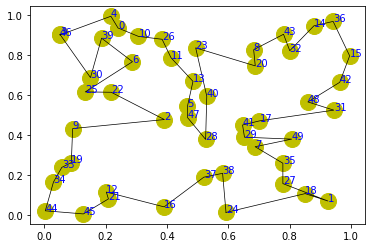

step:2520/5000, actic loss:0.906, critic loss:4.087, L:10.336, 0min2sec
step:2521/5000, actic loss:0.905, critic loss:4.086, L:10.334, 0min2sec
step:2522/5000, actic loss:0.905, critic loss:4.084, L:10.333, 0min1sec
step:2523/5000, actic loss:0.904, critic loss:4.083, L:10.332, 0min1sec
step:2524/5000, actic loss:0.903, critic loss:4.081, L:10.331, 0min1sec
distance:6.907
tensor([25, 18,  7, 29, 27, 26, 31, 45, 15, 34, 16, 28, 12,  5, 11, 32, 13,  2,
        14, 48,  9, 35, 22, 38,  8, 42, 30,  3, 21, 49, 36,  0,  4, 44, 37, 19,
        47, 41,  1, 17,  6, 33, 46, 24, 23, 40, 43, 39, 20, 10])


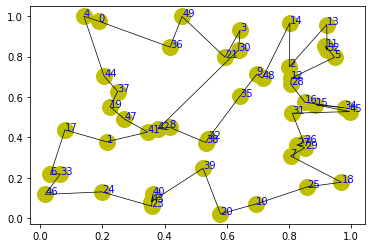

step:2525/5000, actic loss:0.903, critic loss:4.080, L:10.329, 0min2sec
step:2526/5000, actic loss:0.903, critic loss:4.078, L:10.328, 0min1sec
step:2527/5000, actic loss:0.903, critic loss:4.077, L:10.327, 0min1sec
step:2528/5000, actic loss:0.903, critic loss:4.075, L:10.326, 0min1sec
step:2529/5000, actic loss:0.903, critic loss:4.074, L:10.324, 0min1sec
distance:7.668
tensor([24, 16,  0, 30, 41, 47, 11,  3, 18,  7, 27, 12, 31,  1, 20, 15,  5, 29,
        42, 49, 35, 46, 45, 17, 34, 21,  4, 43,  9, 25, 28, 37, 48, 19,  8, 39,
        23, 38, 33, 13, 40, 32,  2, 26, 44, 10,  6, 36, 14, 22])


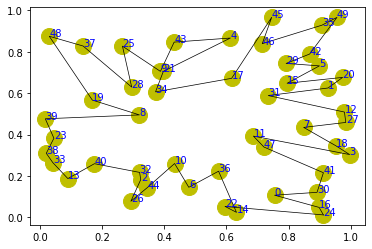

step:2530/5000, actic loss:0.902, critic loss:4.072, L:10.323, 0min2sec
step:2531/5000, actic loss:0.901, critic loss:4.071, L:10.322, 0min2sec
step:2532/5000, actic loss:0.900, critic loss:4.069, L:10.321, 0min2sec
step:2533/5000, actic loss:0.901, critic loss:4.068, L:10.320, 0min2sec
step:2534/5000, actic loss:0.901, critic loss:4.066, L:10.319, 0min1sec
distance:7.609
tensor([23, 26,  4, 35, 18,  1, 38, 40, 33,  8, 27,  3,  5, 41, 49, 46, 45, 10,
         0, 39, 11, 42, 29, 31, 20,  7, 43, 37, 17, 12, 16,  9, 47, 13, 14,  2,
        34, 28, 36, 48,  6, 30, 24, 19, 25, 22, 15, 21, 32, 44])


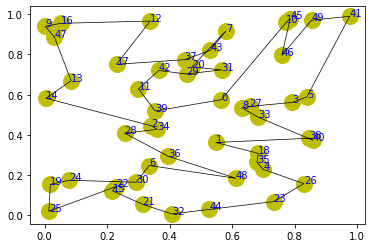

step:2535/5000, actic loss:0.902, critic loss:4.065, L:10.318, 0min2sec
step:2536/5000, actic loss:0.901, critic loss:4.064, L:10.316, 0min1sec
step:2537/5000, actic loss:0.900, critic loss:4.062, L:10.315, 0min1sec
step:2538/5000, actic loss:0.899, critic loss:4.061, L:10.314, 0min1sec
step:2539/5000, actic loss:0.898, critic loss:4.059, L:10.313, 0min1sec
distance:8.527
tensor([21, 32, 31, 28, 12, 17, 10, 29,  6,  0, 15, 45,  3, 14, 49,  8, 33, 30,
        43,  2, 26, 20,  7, 39,  4,  5, 36, 27, 22, 18, 37, 25, 24, 19, 35, 47,
        34, 42, 41, 38, 48,  9, 13,  1, 16, 40, 44, 11, 23, 46])


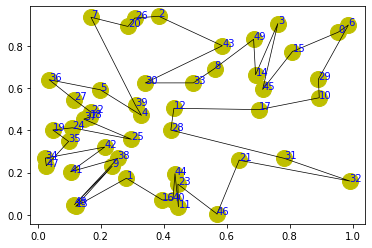

step:2540/5000, actic loss:0.898, critic loss:4.058, L:10.312, 0min2sec
step:2541/5000, actic loss:0.898, critic loss:4.056, L:10.311, 0min2sec
step:2542/5000, actic loss:0.897, critic loss:4.055, L:10.310, 0min1sec
step:2543/5000, actic loss:0.897, critic loss:4.053, L:10.308, 0min1sec
step:2544/5000, actic loss:0.896, critic loss:4.052, L:10.307, 0min1sec
distance:6.533
tensor([33,  4, 42, 39, 23, 49, 28, 13,  3, 20, 45, 30, 48, 17,  8,  2, 41, 24,
        31, 34,  1, 27, 16, 11, 25, 26, 21, 15, 22, 44, 29, 47, 10, 36, 40, 18,
        35, 12,  9, 14, 37,  6,  7, 43, 38,  0, 19, 32, 46,  5])


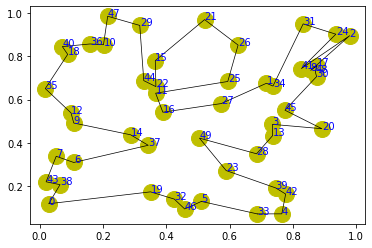

step:2545/5000, actic loss:0.896, critic loss:4.050, L:10.306, 0min2sec
step:2546/5000, actic loss:0.895, critic loss:4.049, L:10.305, 0min1sec
step:2547/5000, actic loss:0.894, critic loss:4.047, L:10.304, 0min1sec
step:2548/5000, actic loss:0.894, critic loss:4.046, L:10.302, 0min1sec
step:2549/5000, actic loss:0.893, critic loss:4.044, L:10.301, 0min1sec
distance:7.022
tensor([36,  6, 43, 48,  4, 26, 12, 35, 19, 20, 24,  9, 49, 27, 33, 23, 25,  5,
        15,  0, 22,  3, 42, 14, 13, 29, 18, 47, 37, 41, 30,  8, 11, 38, 28, 32,
        17, 31, 39, 16, 44, 21,  1, 10, 40, 34,  2,  7, 46, 45])


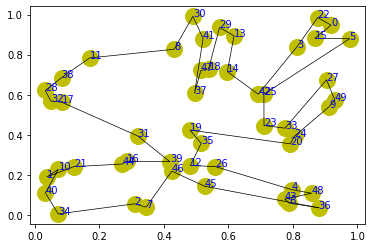

step:2550/5000, actic loss:0.893, critic loss:4.043, L:10.300, 0min2sec
step:2551/5000, actic loss:0.893, critic loss:4.041, L:10.299, 0min1sec
step:2552/5000, actic loss:0.893, critic loss:4.040, L:10.297, 0min1sec
step:2553/5000, actic loss:0.892, critic loss:4.038, L:10.296, 0min1sec
step:2554/5000, actic loss:0.891, critic loss:4.037, L:10.295, 0min1sec
distance:6.455
tensor([42, 27,  6, 20, 41, 44, 47, 46,  0, 48,  8,  3, 34, 22, 31, 43, 13, 29,
        35, 49, 25, 11, 28,  9, 36, 23, 33, 40, 30, 32,  2, 38, 18, 19, 21, 10,
        26, 12,  7, 15,  1, 24, 16, 17, 39, 14,  4, 45, 37,  5])


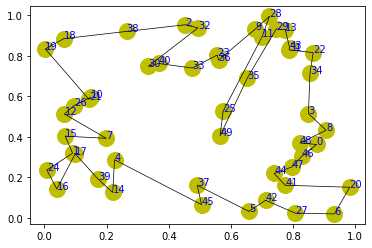

step:2555/5000, actic loss:0.890, critic loss:4.036, L:10.294, 0min2sec
step:2556/5000, actic loss:0.889, critic loss:4.034, L:10.293, 0min1sec
step:2557/5000, actic loss:0.888, critic loss:4.033, L:10.291, 0min1sec
step:2558/5000, actic loss:0.887, critic loss:4.031, L:10.290, 0min1sec
step:2559/5000, actic loss:0.888, critic loss:4.030, L:10.289, 0min1sec
distance:7.150
tensor([47, 10, 20, 16, 48, 32, 43, 31, 33, 36, 18,  4,  2, 37, 29,  7,  5, 26,
        34,  8, 42,  9, 22, 38, 19, 11, 12, 23, 14, 44, 25, 41, 21, 30, 13, 17,
        24, 27, 35, 46,  0,  3, 40, 45, 39, 49, 28,  6, 15,  1])


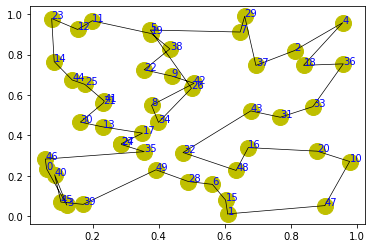

step:2560/5000, actic loss:0.889, critic loss:4.028, L:10.288, 0min2sec
step:2561/5000, actic loss:0.890, critic loss:4.027, L:10.287, 0min1sec
step:2562/5000, actic loss:0.891, critic loss:4.026, L:10.285, 0min1sec
step:2563/5000, actic loss:0.892, critic loss:4.024, L:10.284, 0min1sec
step:2564/5000, actic loss:0.892, critic loss:4.023, L:10.283, 0min1sec
distance:6.248
tensor([29,  6, 40, 16, 47, 36, 48,  3, 42, 15,  4, 44, 21, 24, 38,  2, 31, 18,
        34,  5, 30, 25, 32, 35, 45, 14, 12, 46, 28, 11, 39,  7, 41, 26,  1, 20,
        17, 23,  0, 10,  9, 27, 13, 19,  8, 33, 43, 22, 49, 37])


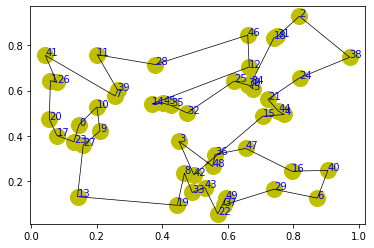

step:2565/5000, actic loss:0.891, critic loss:4.021, L:10.282, 0min2sec
step:2566/5000, actic loss:0.889, critic loss:4.020, L:10.280, 0min1sec
step:2567/5000, actic loss:0.888, critic loss:4.018, L:10.279, 0min1sec
step:2568/5000, actic loss:0.887, critic loss:4.017, L:10.278, 0min1sec
step:2569/5000, actic loss:0.885, critic loss:4.016, L:10.277, 0min1sec
distance:7.319
tensor([43, 27, 25, 16, 12,  5,  1, 21, 39,  3,  2, 37, 26, 19,  9, 33, 47, 49,
        17,  6, 46, 44, 45, 13, 32, 29, 31, 11, 48, 22, 41, 14, 24, 34, 28, 20,
        18, 30,  7, 38, 15, 42, 36,  4, 40,  8,  0, 10, 35, 23])


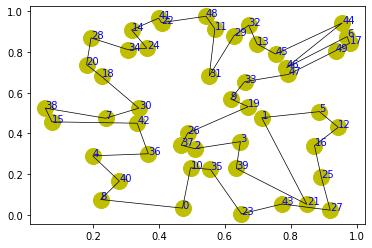

step:2570/5000, actic loss:0.885, critic loss:4.014, L:10.275, 0min1sec
step:2571/5000, actic loss:0.885, critic loss:4.013, L:10.274, 0min1sec
step:2572/5000, actic loss:0.886, critic loss:4.011, L:10.273, 0min1sec
step:2573/5000, actic loss:0.887, critic loss:4.010, L:10.272, 0min1sec
step:2574/5000, actic loss:0.887, critic loss:4.009, L:10.270, 0min1sec
distance:6.985
tensor([15, 13, 37, 48, 38, 18, 20,  5, 34,  2,  7, 36,  4, 33, 12, 46, 28, 30,
         8, 40, 26, 23, 17, 11, 10, 31,  0,  3, 16, 32, 24, 42, 14, 21, 25, 22,
        19, 47, 29, 39, 41,  1, 35, 43, 44, 27, 49, 45,  6,  9])


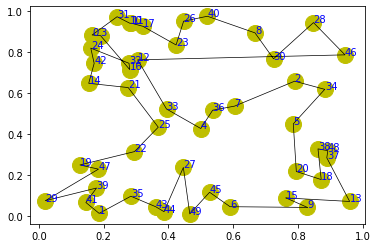

step:2575/5000, actic loss:0.887, critic loss:4.007, L:10.269, 0min2sec
step:2576/5000, actic loss:0.886, critic loss:4.006, L:10.268, 0min2sec
step:2577/5000, actic loss:0.884, critic loss:4.004, L:10.267, 0min2sec
step:2578/5000, actic loss:0.883, critic loss:4.003, L:10.266, 0min1sec
step:2579/5000, actic loss:0.881, critic loss:4.002, L:10.264, 0min1sec
distance:6.534
tensor([27, 34, 13, 21, 15, 33, 22, 29, 37, 39, 49, 26, 31, 45, 42, 18,  0, 35,
         9,  8, 10, 23,  1,  5,  2, 44, 14,  6, 11, 28, 24,  3, 46, 38, 19,  7,
        12, 25, 30, 36, 16,  4, 41, 48, 17, 47, 40, 32, 43, 20])


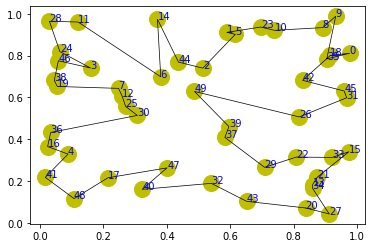

step:2580/5000, actic loss:0.880, critic loss:4.000, L:10.263, 0min2sec
step:2581/5000, actic loss:0.880, critic loss:3.999, L:10.262, 0min1sec
step:2582/5000, actic loss:0.880, critic loss:3.997, L:10.261, 0min1sec
step:2583/5000, actic loss:0.880, critic loss:3.996, L:10.260, 0min1sec
step:2584/5000, actic loss:0.880, critic loss:3.995, L:10.259, 0min1sec
distance:6.950
tensor([ 4, 42, 45,  5,  1, 31, 44, 34, 26,  7, 14,  8, 49, 43, 12, 28, 33,  2,
        38, 21, 48, 41, 16, 46, 22, 13, 39,  6, 15,  3, 29, 40, 23, 36, 25, 47,
        32, 10, 30, 20, 19,  0,  9, 35, 27, 18, 11, 17, 37, 24])


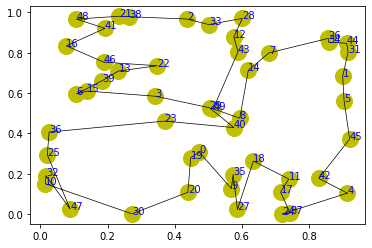

step:2585/5000, actic loss:0.880, critic loss:3.993, L:10.258, 0min1sec
step:2586/5000, actic loss:0.879, critic loss:3.992, L:10.256, 0min1sec
step:2587/5000, actic loss:0.878, critic loss:3.991, L:10.255, 0min1sec
step:2588/5000, actic loss:0.876, critic loss:3.989, L:10.254, 0min1sec
step:2589/5000, actic loss:0.875, critic loss:3.988, L:10.253, 0min1sec
distance:6.922
tensor([25, 30, 31, 45, 23, 47, 49, 28,  9, 43, 48,  1, 40,  2, 32, 44,  8, 18,
        27, 29,  7, 20, 22, 26,  0, 21, 12, 33, 14, 37, 19, 24, 16, 38, 15, 11,
        46, 34, 13, 35, 10,  3, 42, 39,  4, 17, 36, 41,  5,  6])


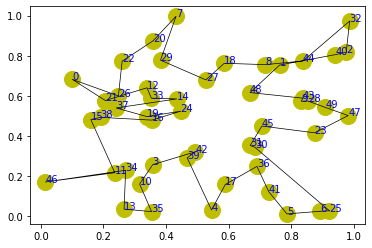

step:2590/5000, actic loss:0.874, critic loss:3.986, L:10.252, 0min2sec
step:2591/5000, actic loss:0.875, critic loss:3.985, L:10.250, 0min2sec
step:2592/5000, actic loss:0.876, critic loss:3.984, L:10.249, 0min1sec
step:2593/5000, actic loss:0.877, critic loss:3.982, L:10.248, 0min1sec
step:2594/5000, actic loss:0.878, critic loss:3.981, L:10.247, 0min1sec
distance:7.762
tensor([12,  8,  6,  0,  2, 35, 19, 48,  4,  7, 43, 37, 10,  3, 47, 33, 49, 27,
        36, 26,  5, 23, 20, 14, 29, 24, 17, 44,  1, 34, 41, 30, 39, 32, 13, 15,
        28,  9, 18, 16, 25, 21, 38, 31, 40, 42, 45, 46, 11, 22])


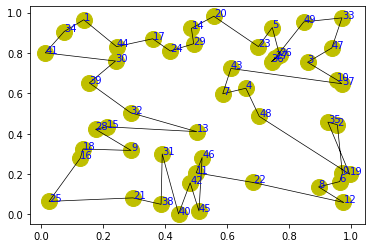

step:2595/5000, actic loss:0.878, critic loss:3.979, L:10.246, 0min2sec
step:2596/5000, actic loss:0.878, critic loss:3.978, L:10.244, 0min1sec
step:2597/5000, actic loss:0.877, critic loss:3.977, L:10.243, 0min1sec
step:2598/5000, actic loss:0.875, critic loss:3.975, L:10.242, 0min1sec
step:2599/5000, actic loss:0.874, critic loss:3.974, L:10.241, 0min1sec
distance:6.891
tensor([33, 25, 38,  0, 21,  5,  4, 27, 22, 44, 36, 11, 42, 13, 32, 26, 10, 34,
        30, 14, 41, 43, 18, 45, 31,  7,  3, 37,  1, 20, 19,  2,  8, 24, 40, 28,
        35,  6, 12, 17, 39,  9, 23, 49, 47, 16, 15, 46, 29, 48])


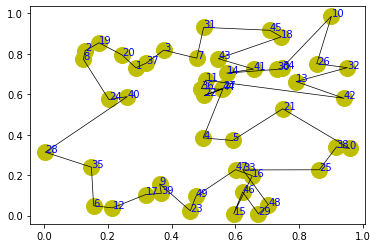

step:2600/5000, actic loss:0.872, critic loss:3.973, L:10.239, 0min1sec
step:2601/5000, actic loss:0.870, critic loss:3.971, L:10.238, 0min1sec
step:2602/5000, actic loss:0.869, critic loss:3.970, L:10.237, 0min1sec
step:2603/5000, actic loss:0.869, critic loss:3.968, L:10.236, 0min1sec
step:2604/5000, actic loss:0.869, critic loss:3.967, L:10.235, 0min1sec
distance:6.806
tensor([19,  1, 33, 39, 49, 15, 40, 13, 45,  5, 18,  2, 48, 43, 27, 31, 26,  0,
        32, 20, 46, 11, 36, 30, 35,  6, 25, 16,  4, 41, 24, 34, 14, 38, 42,  9,
        17, 23, 29, 28,  7, 47, 12,  8,  3, 22, 10, 21, 37, 44])


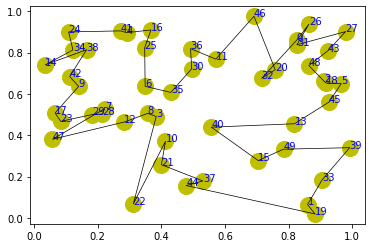

step:2605/5000, actic loss:0.869, critic loss:3.966, L:10.233, 0min2sec
step:2606/5000, actic loss:0.870, critic loss:3.964, L:10.232, 0min2sec
step:2607/5000, actic loss:0.870, critic loss:3.963, L:10.231, 0min2sec
step:2608/5000, actic loss:0.870, critic loss:3.961, L:10.230, 0min1sec
step:2609/5000, actic loss:0.868, critic loss:3.960, L:10.229, 0min1sec
distance:6.618
tensor([10, 30, 38, 36, 22,  8, 17, 43, 41, 15, 47, 48, 23, 42,  3, 45, 33, 16,
        20,  4, 46, 21, 40, 31, 24, 14,  0, 35, 32, 18, 34,  1,  5, 13,  6, 19,
        39,  9, 26, 37, 25, 44, 28, 49,  2, 27, 12, 29,  7, 11])


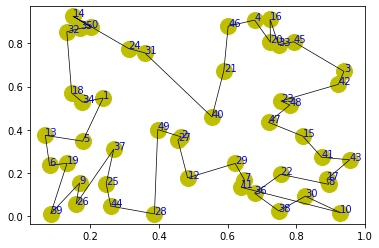

step:2610/5000, actic loss:0.867, critic loss:3.959, L:10.227, 0min2sec
step:2611/5000, actic loss:0.865, critic loss:3.957, L:10.226, 0min1sec
step:2612/5000, actic loss:0.863, critic loss:3.956, L:10.225, 0min1sec
step:2613/5000, actic loss:0.862, critic loss:3.955, L:10.224, 0min1sec
step:2614/5000, actic loss:0.861, critic loss:3.953, L:10.223, 0min1sec
distance:7.635
tensor([ 8, 48,  5, 42, 15, 14, 21,  4, 10, 39, 40,  7, 13, 17, 44, 16, 11,  3,
         6, 33, 36, 37, 19, 49, 18, 27, 31, 45, 25, 23, 30, 20, 22, 38,  9, 24,
        12,  0, 46, 43, 34, 47, 35, 29, 26, 41,  1,  2, 32, 28])


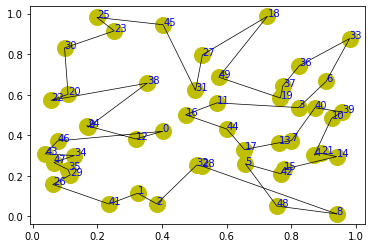

step:2615/5000, actic loss:0.861, critic loss:3.952, L:10.221, 0min2sec
step:2616/5000, actic loss:0.861, critic loss:3.950, L:10.220, 0min1sec
step:2617/5000, actic loss:0.862, critic loss:3.949, L:10.219, 0min1sec
step:2618/5000, actic loss:0.862, critic loss:3.948, L:10.218, 0min1sec
step:2619/5000, actic loss:0.862, critic loss:3.946, L:10.217, 0min1sec
distance:7.222
tensor([ 1,  9, 47, 34, 49, 23, 28, 17,  4, 15, 30, 45, 32, 24, 31, 27, 13, 22,
        39, 33, 12, 41,  5, 16, 14, 20, 44, 29,  6,  0, 18, 46, 38, 43, 35, 40,
        10, 36, 25, 11,  3,  7, 21, 48,  2, 42, 19, 26,  8, 37])


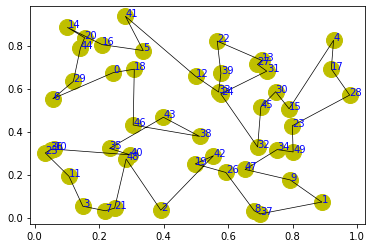

step:2620/5000, actic loss:0.861, critic loss:3.945, L:10.216, 0min2sec
step:2621/5000, actic loss:0.859, critic loss:3.944, L:10.215, 0min1sec
step:2622/5000, actic loss:0.858, critic loss:3.942, L:10.214, 0min1sec
step:2623/5000, actic loss:0.858, critic loss:3.941, L:10.212, 0min1sec
step:2624/5000, actic loss:0.858, critic loss:3.939, L:10.211, 0min1sec
distance:7.772
tensor([28, 16, 17, 10,  4,  7, 49, 11, 23,  0, 29, 43, 45,  5,  1, 24, 44, 15,
        25, 12, 18,  9, 32, 34, 31, 30, 48, 35, 27,  2, 40,  3, 47, 14,  8, 22,
        20, 33, 26, 39, 21, 46, 19, 38,  6, 37, 42, 36, 13, 41])


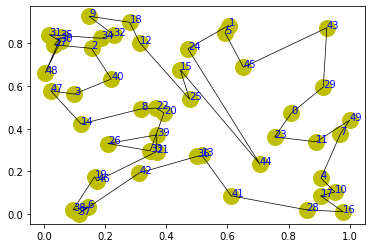

step:2625/5000, actic loss:0.858, critic loss:3.938, L:10.210, 0min1sec
step:2626/5000, actic loss:0.859, critic loss:3.937, L:10.209, 0min1sec
step:2627/5000, actic loss:0.859, critic loss:3.935, L:10.208, 0min1sec
step:2628/5000, actic loss:0.859, critic loss:3.934, L:10.207, 0min1sec
step:2629/5000, actic loss:0.858, critic loss:3.933, L:10.205, 0min1sec
distance:7.285
tensor([18, 19, 29,  3, 43, 35, 13, 44, 32, 40, 47,  5,  1, 20, 42, 24, 48, 31,
        16, 34,  6,  7,  9, 23, 37, 27, 33, 49, 22, 15, 28,  2,  4, 21, 36, 12,
        46, 14, 17, 41, 10, 45, 39, 25,  0, 26,  8, 30, 38, 11])


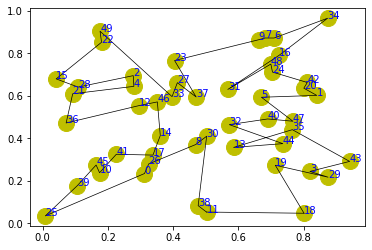

step:2630/5000, actic loss:0.857, critic loss:3.931, L:10.204, 0min2sec
step:2631/5000, actic loss:0.857, critic loss:3.930, L:10.203, 0min1sec
step:2632/5000, actic loss:0.857, critic loss:3.928, L:10.202, 0min1sec
step:2633/5000, actic loss:0.857, critic loss:3.927, L:10.201, 0min1sec
step:2634/5000, actic loss:0.858, critic loss:3.926, L:10.199, 0min1sec
distance:7.769
tensor([ 4, 13, 38, 46, 47,  7, 28,  9, 34, 44, 27, 49,  5,  6, 31, 18, 12, 32,
         2, 30, 39, 35, 24, 26, 43, 37,  8,  0, 45, 33, 23, 15, 16, 29, 21, 14,
        17, 36, 10, 19, 25, 48, 41,  1, 11, 42, 20, 22, 40,  3])


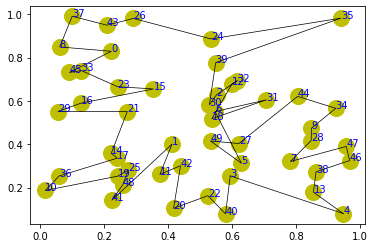

step:2635/5000, actic loss:0.858, critic loss:3.924, L:10.198, 0min2sec
step:2636/5000, actic loss:0.857, critic loss:3.923, L:10.197, 0min1sec
step:2637/5000, actic loss:0.856, critic loss:3.921, L:10.196, 0min2sec
step:2638/5000, actic loss:0.855, critic loss:3.920, L:10.195, 0min2sec
step:2639/5000, actic loss:0.855, critic loss:3.919, L:10.193, 0min1sec
distance:6.759
tensor([46,  6, 31, 49,  7, 23, 47, 19, 11, 40, 35, 45,  2,  3, 27, 12, 14, 33,
        17, 41, 39,  5, 37, 25,  0, 28, 22,  8, 44, 29,  4, 42, 43,  9, 21, 15,
        30, 13, 24, 16,  1, 36, 10, 32, 48, 26, 18, 34, 38, 20])


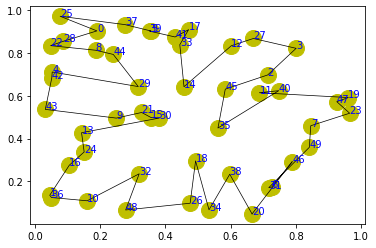

step:2640/5000, actic loss:0.855, critic loss:3.917, L:10.192, 0min2sec
step:2641/5000, actic loss:0.855, critic loss:3.916, L:10.191, 0min1sec
step:2642/5000, actic loss:0.855, critic loss:3.914, L:10.190, 0min1sec
step:2643/5000, actic loss:0.854, critic loss:3.913, L:10.189, 0min1sec
step:2644/5000, actic loss:0.853, critic loss:3.912, L:10.188, 0min1sec
distance:7.155
tensor([40, 14, 43, 46,  6, 19, 12, 42, 44, 23, 18, 39,  7, 33, 17, 13,  3, 15,
        47, 36, 37, 21, 29,  8, 24, 10,  5, 30, 28,  4, 26, 27,  2, 45, 35, 41,
        16, 31, 48,  1,  9, 11, 32, 49,  0, 38, 20, 34, 25, 22])


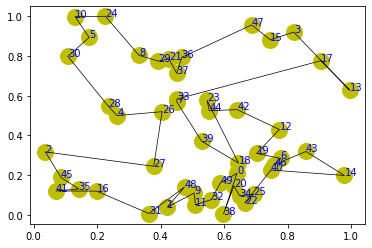

step:2645/5000, actic loss:0.852, critic loss:3.910, L:10.187, 0min1sec
step:2646/5000, actic loss:0.852, critic loss:3.909, L:10.186, 0min1sec
step:2647/5000, actic loss:0.852, critic loss:3.908, L:10.185, 0min1sec
step:2648/5000, actic loss:0.852, critic loss:3.906, L:10.183, 0min1sec
step:2649/5000, actic loss:0.852, critic loss:3.905, L:10.182, 0min1sec
distance:7.841
tensor([42,  3, 12, 23,  6, 22, 38, 40, 18, 44, 15,  9, 34,  4, 27, 24, 25,  5,
        16, 49, 32, 46, 28, 47,  2, 26, 31, 29,  7, 10,  1, 43, 20, 48,  8, 13,
        37, 17, 21, 45, 36, 19, 33, 11, 39,  0, 14, 30, 41, 35])


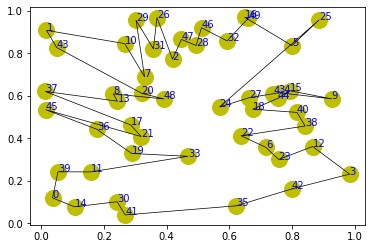

step:2650/5000, actic loss:0.851, critic loss:3.904, L:10.181, 0min2sec
step:2651/5000, actic loss:0.850, critic loss:3.902, L:10.180, 0min1sec
step:2652/5000, actic loss:0.849, critic loss:3.901, L:10.179, 0min1sec
step:2653/5000, actic loss:0.848, critic loss:3.900, L:10.178, 0min1sec
step:2654/5000, actic loss:0.848, critic loss:3.898, L:10.177, 0min1sec
distance:7.258
tensor([49, 32, 35,  6,  0, 46, 18, 22,  7, 17,  3, 37, 33, 10, 19, 11, 16, 27,
        40, 20, 39, 12, 14, 34, 36, 13,  4, 29, 44, 42, 24, 23,  2,  5, 41,  1,
        43, 25, 31, 48, 45, 15, 38,  9, 28, 26, 21, 30,  8, 47])


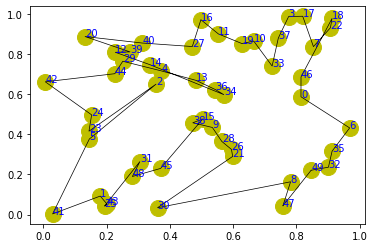

step:2655/5000, actic loss:0.848, critic loss:3.897, L:10.176, 0min2sec
step:2656/5000, actic loss:0.848, critic loss:3.895, L:10.175, 0min1sec
step:2657/5000, actic loss:0.847, critic loss:3.894, L:10.174, 0min1sec
step:2658/5000, actic loss:0.847, critic loss:3.893, L:10.172, 0min1sec
step:2659/5000, actic loss:0.846, critic loss:3.891, L:10.171, 0min1sec
distance:6.552
tensor([12, 27,  0, 46,  3, 39, 37, 47, 29, 36, 23, 41, 35, 45, 13, 11,  4, 18,
        30, 15, 28, 44, 20, 14, 22,  5, 19, 42,  1, 26, 24, 17, 48, 40, 10, 16,
        49, 25, 21, 32, 38,  9, 33,  2,  6,  7,  8, 43, 31, 34])


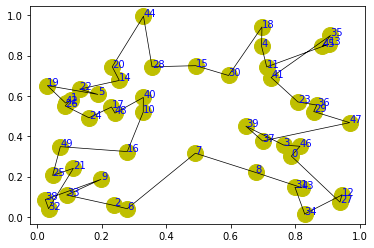

step:2660/5000, actic loss:0.844, critic loss:3.890, L:10.170, 0min1sec
step:2661/5000, actic loss:0.843, critic loss:3.889, L:10.169, 0min1sec
step:2662/5000, actic loss:0.843, critic loss:3.887, L:10.168, 0min1sec
step:2663/5000, actic loss:0.844, critic loss:3.886, L:10.167, 0min1sec
step:2664/5000, actic loss:0.845, critic loss:3.885, L:10.166, 0min1sec
distance:8.040
tensor([47, 14,  8, 40, 13, 45, 33, 28, 49, 38, 20, 44, 25, 32, 11, 46, 17, 24,
         6, 35, 10, 34, 37, 27,  5,  0, 31,  7,  1,  2, 43,  4, 48, 42, 26, 39,
        21, 15, 22, 30, 12, 18, 29,  3, 19, 36, 23, 41,  9, 16])


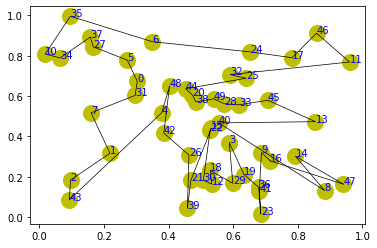

step:2665/5000, actic loss:0.845, critic loss:3.883, L:10.165, 0min2sec
step:2666/5000, actic loss:0.844, critic loss:3.882, L:10.164, 0min1sec
step:2667/5000, actic loss:0.843, critic loss:3.881, L:10.162, 0min1sec
step:2668/5000, actic loss:0.843, critic loss:3.879, L:10.161, 0min1sec
step:2669/5000, actic loss:0.842, critic loss:3.878, L:10.160, 0min1sec
distance:6.505
tensor([ 6, 27, 41, 21, 30, 16, 19, 24, 14, 37, 28, 47, 36, 32, 12, 31, 45,  1,
        38,  2, 11, 15,  7, 35, 29,  9,  5, 43,  8, 26, 13, 10, 17, 18, 44,  3,
        25, 23, 33, 34, 20, 42,  0, 22, 46, 39, 40, 49,  4, 48])


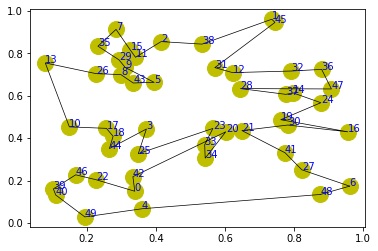

step:2670/5000, actic loss:0.842, critic loss:3.877, L:10.159, 0min1sec
step:2671/5000, actic loss:0.842, critic loss:3.875, L:10.158, 0min1sec
step:2672/5000, actic loss:0.843, critic loss:3.874, L:10.157, 0min1sec
step:2673/5000, actic loss:0.842, critic loss:3.873, L:10.156, 0min1sec
step:2674/5000, actic loss:0.842, critic loss:3.871, L:10.155, 0min1sec
distance:6.387
tensor([28,  6, 31,  2, 14, 20, 44, 10, 37, 35, 32, 47, 22, 18, 45, 49, 27, 40,
         0, 12,  7, 15, 23, 38, 39,  1, 25, 21, 13, 33, 24, 30, 48,  9, 26, 11,
        17, 41, 19,  3,  8, 36,  4,  5, 29, 34, 46, 16, 42, 43])


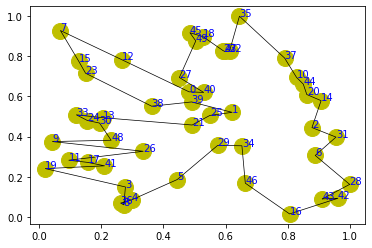

step:2675/5000, actic loss:0.841, critic loss:3.870, L:10.154, 0min1sec
step:2676/5000, actic loss:0.840, critic loss:3.869, L:10.153, 0min1sec
step:2677/5000, actic loss:0.841, critic loss:3.867, L:10.152, 0min1sec
step:2678/5000, actic loss:0.841, critic loss:3.866, L:10.151, 0min1sec
step:2679/5000, actic loss:0.842, critic loss:3.865, L:10.150, 0min2sec
distance:7.810
tensor([37, 17, 29,  0,  4, 14, 36, 47, 49, 16,  7, 43, 10, 15, 35, 46,  6, 24,
        23, 33, 48, 21, 25, 41, 38, 31, 34, 30, 18, 26, 27, 20, 42, 12, 22,  1,
        28, 45, 40, 39,  9,  8,  2, 19, 32, 44, 11, 13,  3,  5])


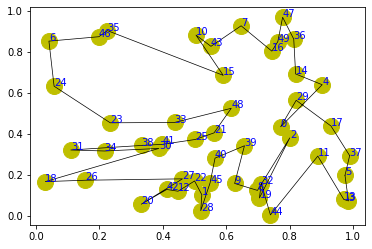

step:2680/5000, actic loss:0.842, critic loss:3.864, L:10.149, 0min2sec
step:2681/5000, actic loss:0.842, critic loss:3.862, L:10.148, 0min1sec
step:2682/5000, actic loss:0.841, critic loss:3.861, L:10.147, 0min1sec
step:2683/5000, actic loss:0.840, critic loss:3.860, L:10.146, 0min1sec
step:2684/5000, actic loss:0.840, critic loss:3.858, L:10.145, 0min1sec
distance:9.188
tensor([14,  0,  5, 48, 24,  7, 34, 17,  2, 36,  6,  8, 43,  3, 11, 40, 22, 10,
        12, 19, 29, 13, 41,  4, 16, 23, 26, 15, 38,  1, 21, 42, 31, 39, 28, 18,
        32, 30, 20, 35, 37, 25, 49, 33, 27, 44, 45, 47,  9, 46])


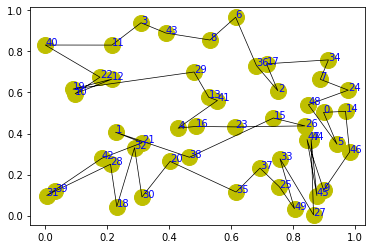

step:2685/5000, actic loss:0.840, critic loss:3.857, L:10.144, 0min1sec
step:2686/5000, actic loss:0.840, critic loss:3.856, L:10.143, 0min1sec
step:2687/5000, actic loss:0.839, critic loss:3.854, L:10.142, 0min1sec
step:2688/5000, actic loss:0.838, critic loss:3.853, L:10.141, 0min1sec
step:2689/5000, actic loss:0.838, critic loss:3.852, L:10.140, 0min1sec
distance:8.997
tensor([13, 16, 12, 31, 17, 33, 38, 20, 27, 15, 39, 35,  0,  5,  1, 34, 14, 41,
        47, 19,  7, 46, 32,  6, 48, 30,  9, 25, 28,  3, 24, 10, 21, 23, 18, 26,
        49, 40, 22, 45, 36, 29,  4, 37,  8, 42, 43, 11, 44,  2])


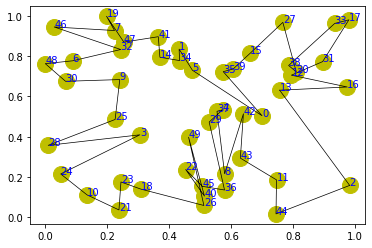

step:2690/5000, actic loss:0.837, critic loss:3.851, L:10.139, 0min2sec
step:2691/5000, actic loss:0.838, critic loss:3.849, L:10.139, 0min1sec
step:2692/5000, actic loss:0.839, critic loss:3.848, L:10.138, 0min1sec
step:2693/5000, actic loss:0.840, critic loss:3.847, L:10.137, 0min1sec
step:2694/5000, actic loss:0.841, critic loss:3.846, L:10.136, 0min1sec
distance:7.290
tensor([40,  9, 16, 20, 46,  6,  3, 14, 28, 12, 33, 17, 21, 13, 15,  1, 47, 23,
        37, 36, 48, 31, 45, 32, 43,  5,  7, 24, 39, 25,  0,  4, 22, 49, 26, 34,
        29, 41, 44, 35, 27,  2, 42, 30, 18, 19, 11,  8, 10, 38])


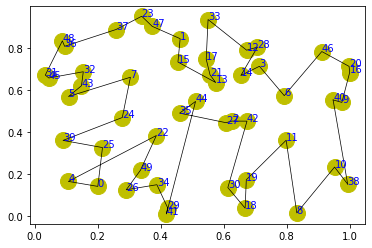

step:2695/5000, actic loss:0.842, critic loss:3.844, L:10.135, 0min1sec
step:2696/5000, actic loss:0.841, critic loss:3.843, L:10.134, 0min1sec
step:2697/5000, actic loss:0.840, critic loss:3.842, L:10.133, 0min1sec
step:2698/5000, actic loss:0.840, critic loss:3.841, L:10.132, 0min1sec
step:2699/5000, actic loss:0.839, critic loss:3.839, L:10.131, 0min1sec
distance:6.740
tensor([ 1, 25,  9, 44,  8, 11, 19, 10, 48, 47,  0,  3, 29, 31, 36, 49, 43, 39,
         2, 30, 38, 16, 33,  4,  6, 18, 17, 26, 27, 24, 15,  5, 35, 20, 32, 34,
        40, 46, 13, 42, 12,  7, 22, 21, 28, 23, 14, 41, 37, 45])


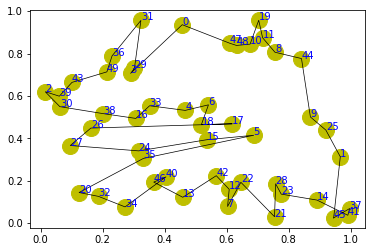

step:2700/5000, actic loss:0.839, critic loss:3.838, L:10.130, 0min1sec
step:2701/5000, actic loss:0.839, critic loss:3.837, L:10.129, 0min1sec
step:2702/5000, actic loss:0.839, critic loss:3.835, L:10.128, 0min1sec
step:2703/5000, actic loss:0.839, critic loss:3.834, L:10.127, 0min1sec
step:2704/5000, actic loss:0.838, critic loss:3.833, L:10.126, 0min1sec
distance:6.618
tensor([22, 43, 39, 49,  5, 23, 40, 14, 35, 44, 36, 21, 10, 41, 31, 19,  6, 28,
        13,  0,  3, 17, 32, 37, 47, 20, 24, 30,  8, 38, 15, 46, 12, 26, 25, 11,
        45, 27,  4,  9, 18, 29, 16, 42, 33,  1, 34,  7,  2, 48])


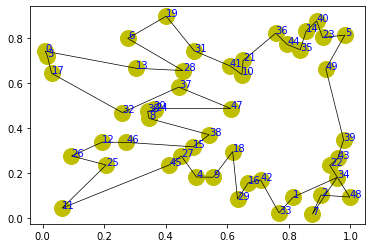

step:2705/5000, actic loss:0.838, critic loss:3.831, L:10.125, 0min2sec
step:2706/5000, actic loss:0.838, critic loss:3.830, L:10.124, 0min2sec
step:2707/5000, actic loss:0.838, critic loss:3.829, L:10.123, 0min1sec
step:2708/5000, actic loss:0.837, critic loss:3.827, L:10.122, 0min1sec
step:2709/5000, actic loss:0.836, critic loss:3.826, L:10.120, 0min1sec
distance:7.837
tensor([45, 14, 42, 31, 27,  8, 34, 20, 47, 37,  4, 25, 36, 28, 35, 10, 46,  9,
        17, 30, 33, 44,  0, 26,  1,  2, 40, 29,  5, 12, 22, 24, 18, 39,  7, 13,
        49,  3, 15, 43, 23, 32, 41, 38, 19, 16, 11, 48, 21,  6])


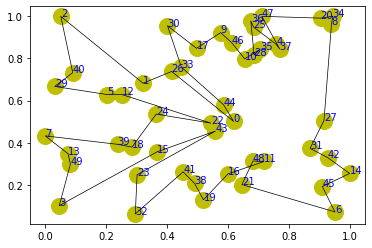

step:2710/5000, actic loss:0.834, critic loss:3.825, L:10.119, 0min2sec
step:2711/5000, actic loss:0.833, critic loss:3.824, L:10.118, 0min1sec
step:2712/5000, actic loss:0.832, critic loss:3.822, L:10.117, 0min1sec
step:2713/5000, actic loss:0.832, critic loss:3.821, L:10.116, 0min1sec
step:2714/5000, actic loss:0.832, critic loss:3.820, L:10.115, 0min1sec
distance:7.833
tensor([23, 41, 22,  7, 30, 29, 35, 10, 44, 17, 47,  0, 31, 36, 21, 25, 34, 46,
        38, 24, 18, 16,  9, 27, 39, 14, 43, 32,  4,  2, 12, 26, 33, 13, 15, 42,
        40,  8, 48,  5,  3, 11, 49, 20, 28,  1, 37,  6, 45, 19])


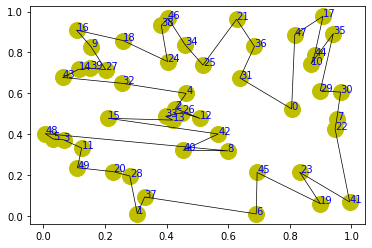

step:2715/5000, actic loss:0.832, critic loss:3.819, L:10.114, 0min2sec
step:2716/5000, actic loss:0.832, critic loss:3.817, L:10.113, 0min2sec
step:2717/5000, actic loss:0.832, critic loss:3.816, L:10.112, 0min2sec
step:2718/5000, actic loss:0.831, critic loss:3.815, L:10.111, 0min2sec
step:2719/5000, actic loss:0.831, critic loss:3.813, L:10.110, 0min1sec
distance:7.157
tensor([34, 13, 10, 16, 39, 44, 12, 45, 43, 24, 19,  6, 46, 18, 32, 36,  7, 38,
        42, 25, 21, 31,  1, 33,  3,  9, 27,  0, 29, 20, 11, 47, 37, 15, 40, 17,
        41, 48, 30, 26, 22,  8, 28, 23,  4, 49,  2, 14,  5, 35])


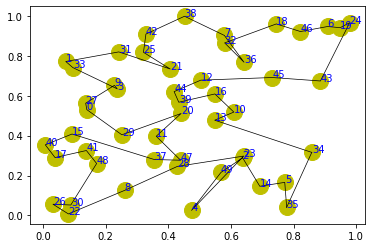

step:2720/5000, actic loss:0.830, critic loss:3.812, L:10.109, 0min2sec
step:2721/5000, actic loss:0.830, critic loss:3.811, L:10.107, 0min1sec
step:2722/5000, actic loss:0.829, critic loss:3.809, L:10.106, 0min1sec
step:2723/5000, actic loss:0.829, critic loss:3.808, L:10.105, 0min1sec
step:2724/5000, actic loss:0.829, critic loss:3.807, L:10.104, 0min1sec
distance:7.232
tensor([17, 15, 11, 41, 44, 43, 26, 40,  5, 19, 47, 38,  7, 23,  4, 18, 39, 36,
        22,  8, 10, 49,  0, 28, 29, 14, 30,  3, 45, 27,  1, 16, 31, 37, 33, 25,
        34, 42,  6, 32, 13, 46,  2, 48, 35, 21,  9, 12, 20, 24])


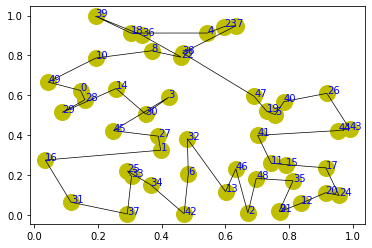

step:2725/5000, actic loss:0.828, critic loss:3.806, L:10.103, 0min1sec
step:2726/5000, actic loss:0.827, critic loss:3.804, L:10.102, 0min1sec
step:2727/5000, actic loss:0.826, critic loss:3.803, L:10.101, 0min1sec
step:2728/5000, actic loss:0.826, critic loss:3.802, L:10.100, 0min2sec
step:2729/5000, actic loss:0.826, critic loss:3.800, L:10.099, 0min2sec
distance:7.944
tensor([20, 46, 39, 14,  0, 10, 33, 23, 40, 44, 36,  1,  9, 30, 34, 19, 37,  3,
        49, 13, 15, 32, 12, 48, 45,  5,  4, 25,  2, 21,  7, 29, 16, 41, 31, 18,
         8, 43, 26, 17, 47, 22, 11, 24, 27, 28, 38,  6, 42, 35])


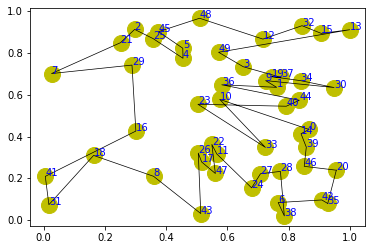

step:2730/5000, actic loss:0.827, critic loss:3.799, L:10.098, 0min2sec
step:2731/5000, actic loss:0.827, critic loss:3.798, L:10.097, 0min1sec
step:2732/5000, actic loss:0.828, critic loss:3.797, L:10.096, 0min1sec
step:2733/5000, actic loss:0.827, critic loss:3.795, L:10.095, 0min1sec
step:2734/5000, actic loss:0.827, critic loss:3.794, L:10.094, 0min1sec
distance:7.303
tensor([19, 41,  8, 43,  1, 26,  9, 31, 30, 36, 20, 45, 39, 49, 14, 15, 17, 44,
        27, 40, 37,  3, 21, 22, 18, 10,  4, 12, 32,  2, 16, 34, 33, 47, 29, 28,
        24,  6, 38, 48,  0, 42, 23,  5, 13, 25, 35, 46,  7, 11])


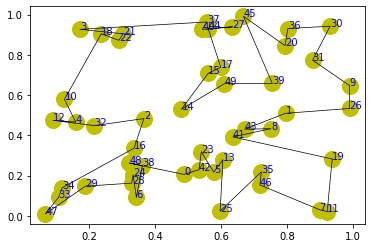

step:2735/5000, actic loss:0.826, critic loss:3.793, L:10.093, 0min1sec
step:2736/5000, actic loss:0.825, critic loss:3.792, L:10.092, 0min1sec
step:2737/5000, actic loss:0.824, critic loss:3.790, L:10.091, 0min1sec
step:2738/5000, actic loss:0.824, critic loss:3.789, L:10.089, 0min1sec
step:2739/5000, actic loss:0.824, critic loss:3.788, L:10.088, 0min1sec
distance:6.489
tensor([13, 20, 29, 15, 25, 12, 37, 31, 19, 41, 18, 38, 39, 42, 45, 34, 26, 49,
        11, 46, 47, 27, 14, 32, 10, 44, 33,  6,  7,  3, 48, 35,  8, 43, 30, 40,
        28,  9, 21, 36, 17,  2,  5, 22, 24,  4,  1, 16, 23,  0])


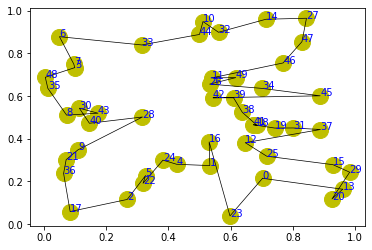

step:2740/5000, actic loss:0.824, critic loss:3.786, L:10.087, 0min2sec
step:2741/5000, actic loss:0.824, critic loss:3.785, L:10.086, 0min2sec
step:2742/5000, actic loss:0.823, critic loss:3.784, L:10.085, 0min1sec
step:2743/5000, actic loss:0.821, critic loss:3.783, L:10.084, 0min1sec
step:2744/5000, actic loss:0.820, critic loss:3.781, L:10.083, 0min1sec
distance:7.799
tensor([15, 28, 48,  6,  8, 27, 32, 36, 25, 20, 38,  9, 40,  3, 29, 14, 10,  1,
         0, 21,  2, 41, 39, 11, 46, 16, 44,  4,  5, 33, 30, 35,  7, 26, 43, 45,
        18, 13, 23, 47, 34, 12, 24, 42, 37, 49, 17, 22, 31, 19])


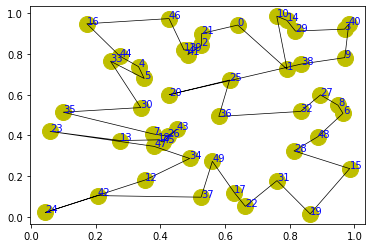

step:2745/5000, actic loss:0.819, critic loss:3.780, L:10.082, 0min2sec
step:2746/5000, actic loss:0.818, critic loss:3.779, L:10.081, 0min1sec
step:2747/5000, actic loss:0.817, critic loss:3.778, L:10.079, 0min1sec
step:2748/5000, actic loss:0.817, critic loss:3.776, L:10.078, 0min1sec
step:2749/5000, actic loss:0.818, critic loss:3.775, L:10.077, 0min1sec
distance:6.485
tensor([11,  8,  5, 49, 34, 15, 28,  6, 26, 10, 24, 48, 30, 14, 20, 41, 33, 47,
         0, 46, 21, 13, 32, 22, 23,  3, 17, 18,  4,  7, 42, 39, 31, 19, 43, 25,
         1, 12,  2, 29, 35,  9, 45, 38, 27, 40, 37, 44, 36, 16])


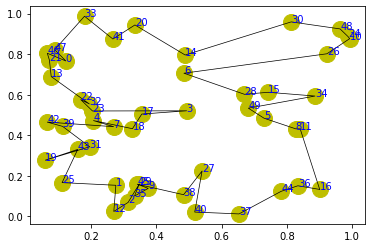

step:2750/5000, actic loss:0.819, critic loss:3.774, L:10.076, 0min1sec
step:2751/5000, actic loss:0.819, critic loss:3.773, L:10.076, 0min1sec
step:2752/5000, actic loss:0.819, critic loss:3.772, L:10.075, 0min1sec
step:2753/5000, actic loss:0.819, critic loss:3.770, L:10.074, 0min1sec
step:2754/5000, actic loss:0.818, critic loss:3.769, L:10.073, 0min1sec
distance:7.435
tensor([34, 15, 20,  2,  4, 24, 22, 36, 29, 30,  7, 23, 49, 10, 33, 17,  8, 14,
        19,  5, 32, 28, 35, 37, 40, 12, 38, 21,  6, 11, 13,  0, 25, 18, 31,  3,
         9, 39, 45, 44,  1, 47, 46, 26, 16, 41, 43, 42, 27, 48])


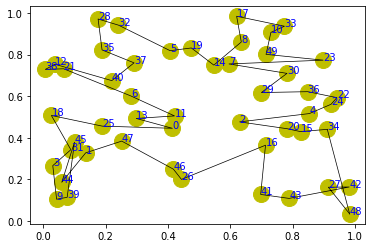

step:2755/5000, actic loss:0.817, critic loss:3.768, L:10.072, 0min2sec
step:2756/5000, actic loss:0.816, critic loss:3.766, L:10.071, 0min1sec
step:2757/5000, actic loss:0.814, critic loss:3.765, L:10.070, 0min1sec
step:2758/5000, actic loss:0.814, critic loss:3.764, L:10.069, 0min1sec
step:2759/5000, actic loss:0.814, critic loss:3.763, L:10.068, 0min1sec
distance:6.855
tensor([10, 32, 18, 26, 45, 42, 20, 31, 22, 25, 24, 48, 36,  7, 13, 44,  3, 34,
        23, 49, 17, 14, 47,  5, 35, 21, 29,  2, 46, 28,  6, 41, 15, 16, 39, 38,
         0, 11,  1,  4, 43, 12,  9, 30, 27, 40,  8, 33, 19, 37])


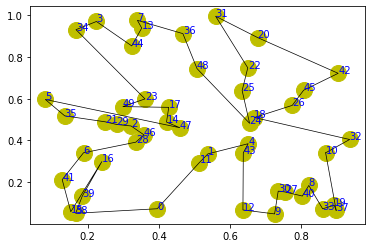

step:2760/5000, actic loss:0.814, critic loss:3.761, L:10.067, 0min1sec
step:2761/5000, actic loss:0.814, critic loss:3.760, L:10.066, 0min1sec
step:2762/5000, actic loss:0.814, critic loss:3.759, L:10.065, 0min1sec
step:2763/5000, actic loss:0.813, critic loss:3.758, L:10.064, 0min1sec
step:2764/5000, actic loss:0.812, critic loss:3.757, L:10.063, 0min1sec
distance:8.283
tensor([12,  3, 33, 11, 17,  9, 25,  2, 36, 42, 27, 47, 28, 29, 21, 26,  8, 18,
        38, 31,  0,  7, 15, 10, 24, 41, 22, 43, 39, 32, 16,  5,  6, 48, 13, 35,
        23, 30, 44,  1,  4, 19, 14, 34, 37, 49, 40, 20, 45, 46])


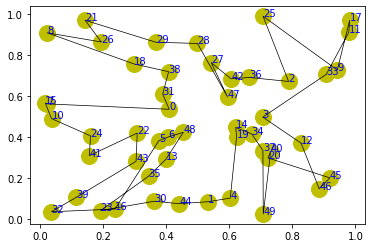

step:2765/5000, actic loss:0.810, critic loss:3.755, L:10.062, 0min2sec
step:2766/5000, actic loss:0.810, critic loss:3.754, L:10.061, 0min2sec
step:2767/5000, actic loss:0.810, critic loss:3.753, L:10.060, 0min1sec
step:2768/5000, actic loss:0.811, critic loss:3.752, L:10.059, 0min1sec
step:2769/5000, actic loss:0.811, critic loss:3.750, L:10.058, 0min1sec
distance:8.297
tensor([24, 43,  6, 39, 26, 48, 20, 13, 30, 33, 21, 31, 49, 17, 12, 10, 35, 38,
         5,  8, 41, 28, 37, 45, 34, 29, 16, 44,  3, 32, 27, 25,  4, 42, 40,  7,
        46, 47, 14, 11, 23,  2, 18,  9, 19, 15,  1, 36,  0, 22])


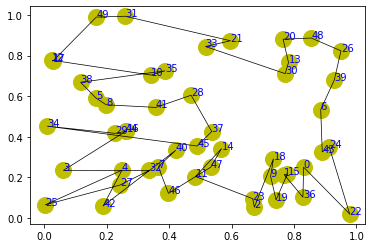

step:2770/5000, actic loss:0.810, critic loss:3.749, L:10.057, 0min1sec
step:2771/5000, actic loss:0.809, critic loss:3.748, L:10.056, 0min1sec
step:2772/5000, actic loss:0.808, critic loss:3.747, L:10.055, 0min1sec
step:2773/5000, actic loss:0.807, critic loss:3.745, L:10.054, 0min1sec
step:2774/5000, actic loss:0.807, critic loss:3.744, L:10.053, 0min1sec
distance:7.018
tensor([33, 12, 29, 14, 16, 32,  3, 15, 26, 20, 22, 44, 41, 37,  8,  7, 43, 24,
        13,  0, 31, 46,  4, 34, 23, 17, 27, 48, 25, 21, 30, 28, 45,  1, 11, 49,
        40, 19, 18, 36, 42, 39, 35,  6, 47,  9, 10,  5,  2, 38])


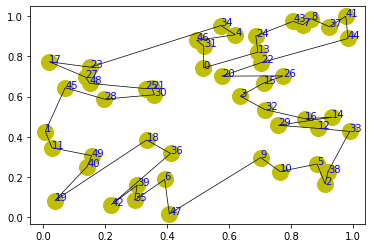

step:2775/5000, actic loss:0.807, critic loss:3.743, L:10.052, 0min1sec
step:2776/5000, actic loss:0.808, critic loss:3.742, L:10.051, 0min1sec
step:2777/5000, actic loss:0.808, critic loss:3.741, L:10.051, 0min1sec
step:2778/5000, actic loss:0.807, critic loss:3.739, L:10.050, 0min1sec
step:2779/5000, actic loss:0.806, critic loss:3.738, L:10.049, 0min1sec
distance:6.690
tensor([28, 27, 30, 39, 29,  5, 47, 19, 13, 34, 20, 36, 21, 35, 46,  3,  9, 10,
         8, 16, 12, 44, 45, 15, 40, 48, 26, 37,  4, 18, 42, 24, 49, 25, 33, 43,
        11, 31, 14, 17,  7, 41, 32,  1, 22, 38,  6,  0,  2, 23])


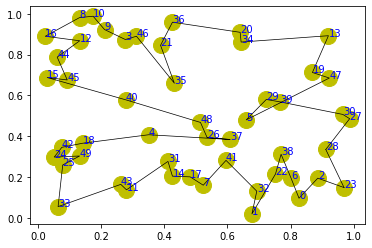

step:2780/5000, actic loss:0.805, critic loss:3.737, L:10.048, 0min2sec
step:2781/5000, actic loss:0.804, critic loss:3.736, L:10.047, 0min1sec
step:2782/5000, actic loss:0.804, critic loss:3.734, L:10.046, 0min1sec
step:2783/5000, actic loss:0.805, critic loss:3.733, L:10.045, 0min1sec
step:2784/5000, actic loss:0.805, critic loss:3.732, L:10.044, 0min1sec
distance:8.406
tensor([28,  2, 47,  8,  9, 45,  5, 35, 38, 21, 13, 22,  0, 14,  3, 33, 46, 15,
        44, 42, 10, 27, 24, 18, 20, 39, 37, 19, 49, 43, 32, 40, 16, 26, 11,  7,
        36, 23, 41,  4, 29, 25, 12,  1, 17, 34, 31,  6, 30, 48])


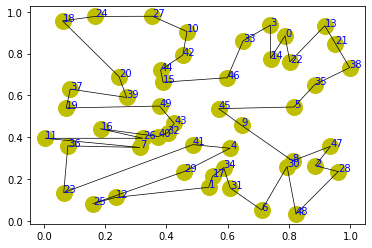

step:2785/5000, actic loss:0.805, critic loss:3.731, L:10.043, 0min1sec
step:2786/5000, actic loss:0.805, critic loss:3.730, L:10.042, 0min1sec
step:2787/5000, actic loss:0.804, critic loss:3.728, L:10.041, 0min1sec
step:2788/5000, actic loss:0.804, critic loss:3.727, L:10.040, 0min1sec
step:2789/5000, actic loss:0.803, critic loss:3.726, L:10.039, 0min1sec
distance:7.399
tensor([ 3,  8, 45, 29, 39, 40, 25,  1, 22, 24, 17, 36,  9, 16, 26, 44, 10,  6,
        23, 49, 48, 21, 12, 33, 14,  0, 47,  5, 37, 11, 42, 31, 27, 38, 32, 43,
         2, 34, 35, 20, 13,  7, 41, 18, 28,  4, 30, 19, 46, 15])


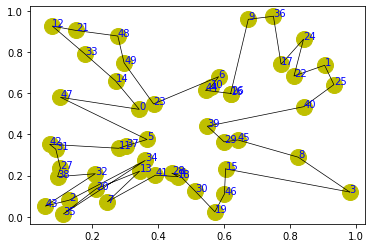

step:2790/5000, actic loss:0.803, critic loss:3.725, L:10.038, 0min2sec
step:2791/5000, actic loss:0.802, critic loss:3.723, L:10.036, 0min2sec
step:2792/5000, actic loss:0.802, critic loss:3.722, L:10.035, 0min2sec
step:2793/5000, actic loss:0.801, critic loss:3.721, L:10.034, 0min1sec
step:2794/5000, actic loss:0.800, critic loss:3.720, L:10.033, 0min1sec
distance:6.956
tensor([37, 19, 40, 44, 33, 46, 23, 12,  8, 35, 43, 47, 17, 38, 45, 14, 24,  2,
         0,  3, 29, 11, 20,  1,  4,  6, 39,  5, 30, 26, 41, 25, 48,  7, 42,  9,
        49, 31, 21, 13, 32, 28, 22, 27, 36, 16, 10, 15, 18, 34])


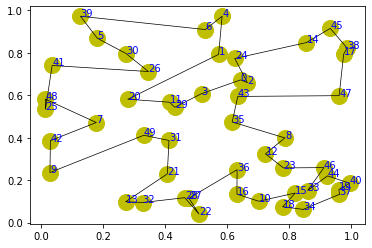

step:2795/5000, actic loss:0.800, critic loss:3.718, L:10.032, 0min2sec
step:2796/5000, actic loss:0.800, critic loss:3.717, L:10.031, 0min1sec
step:2797/5000, actic loss:0.799, critic loss:3.716, L:10.030, 0min1sec
step:2798/5000, actic loss:0.799, critic loss:3.715, L:10.029, 0min1sec
step:2799/5000, actic loss:0.798, critic loss:3.713, L:10.028, 0min1sec
distance:6.975
tensor([23,  1, 44, 19, 49, 46, 34, 32,  9, 47, 38, 12, 29, 14,  5, 13, 39, 42,
         8, 27, 30, 31, 26, 41, 22, 25, 15, 35, 16, 20, 48,  4,  0, 43, 10, 11,
         2, 24, 45, 17,  6, 28, 40, 18, 37,  3, 33, 36,  7, 21])


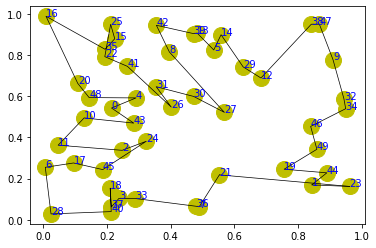

step:2800/5000, actic loss:0.798, critic loss:3.712, L:10.027, 0min2sec
step:2801/5000, actic loss:0.797, critic loss:3.711, L:10.026, 0min1sec
step:2802/5000, actic loss:0.797, critic loss:3.710, L:10.025, 0min1sec
step:2803/5000, actic loss:0.796, critic loss:3.708, L:10.024, 0min2sec
step:2804/5000, actic loss:0.796, critic loss:3.707, L:10.023, 0min1sec
distance:7.049
tensor([21, 15, 41, 31, 17, 13, 12,  0, 27, 48,  3, 40, 10, 49, 36, 42, 44, 32,
         2, 29, 28, 43, 38,  5, 34, 11, 19, 16, 26, 18,  1, 46, 35, 39,  9, 14,
        20, 22, 23, 47, 45,  4,  7, 37,  8, 30, 25,  6, 24, 33])


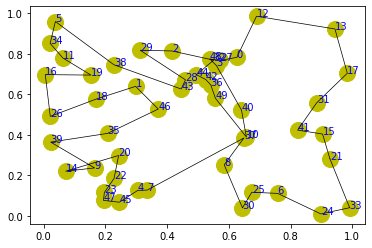

step:2805/5000, actic loss:0.795, critic loss:3.706, L:10.022, 0min2sec
step:2806/5000, actic loss:0.795, critic loss:3.705, L:10.021, 0min1sec
step:2807/5000, actic loss:0.795, critic loss:3.704, L:10.020, 0min1sec
step:2808/5000, actic loss:0.795, critic loss:3.702, L:10.019, 0min1sec
step:2809/5000, actic loss:0.794, critic loss:3.701, L:10.018, 0min1sec
distance:6.986
tensor([25, 38,  9,  7, 32, 46, 30, 33, 23, 45, 17, 14, 42,  8,  2, 13, 18, 37,
         1, 16,  5, 27,  3, 35, 48, 21, 40, 43, 24,  6, 15, 41, 47, 28, 10,  4,
         0, 39, 49, 11, 34, 44, 20, 29, 31, 19, 12, 26, 36, 22])


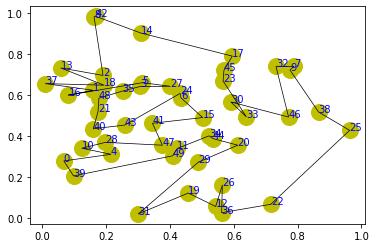

step:2810/5000, actic loss:0.793, critic loss:3.700, L:10.017, 0min2sec
step:2811/5000, actic loss:0.792, critic loss:3.699, L:10.016, 0min1sec
step:2812/5000, actic loss:0.792, critic loss:3.698, L:10.015, 0min1sec
step:2813/5000, actic loss:0.793, critic loss:3.696, L:10.014, 0min1sec
step:2814/5000, actic loss:0.793, critic loss:3.695, L:10.013, 0min1sec
distance:7.533
tensor([40, 29, 39, 35,  3, 27, 43, 22, 15, 13,  9, 41, 14, 18, 21, 38, 11, 10,
        16, 32, 25, 19,  7, 20,  2, 42, 23, 30, 28,  1, 49, 17, 31,  6, 34,  0,
         4, 24, 12,  8, 48, 26, 33,  5, 46, 36, 44, 47, 37, 45])


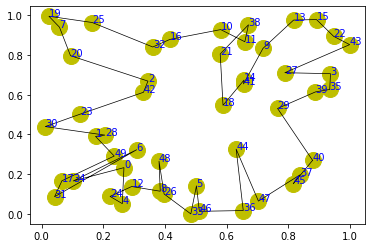

step:2815/5000, actic loss:0.792, critic loss:3.694, L:10.012, 0min2sec
step:2816/5000, actic loss:0.792, critic loss:3.693, L:10.011, 0min1sec
step:2817/5000, actic loss:0.791, critic loss:3.691, L:10.010, 0min1sec
step:2818/5000, actic loss:0.789, critic loss:3.690, L:10.009, 0min1sec
step:2819/5000, actic loss:0.788, critic loss:3.689, L:10.008, 0min1sec
distance:7.247
tensor([40, 31, 46,  3, 33, 14, 48, 39, 43, 36, 44,  0, 47, 29, 32, 26, 20,  5,
        35, 41, 21,  8, 45, 34, 13, 27, 10, 18,  9, 24, 16, 22, 12,  1, 37,  4,
        25, 23,  6, 30, 49, 38,  7, 28, 11, 19, 15, 42, 17,  2])


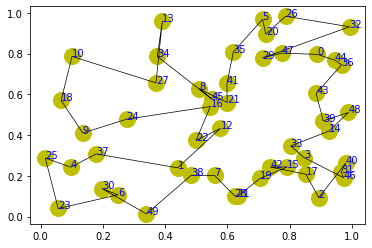

step:2820/5000, actic loss:0.788, critic loss:3.688, L:10.007, 0min2sec
step:2821/5000, actic loss:0.788, critic loss:3.687, L:10.006, 0min1sec
step:2822/5000, actic loss:0.788, critic loss:3.685, L:10.005, 0min1sec
step:2823/5000, actic loss:0.788, critic loss:3.684, L:10.004, 0min1sec
step:2824/5000, actic loss:0.788, critic loss:3.683, L:10.003, 0min1sec
distance:7.047
tensor([31,  6, 38, 29, 21, 10, 25, 48,  9, 32, 27, 20, 47, 24, 40, 16,  2, 42,
        15, 12,  7, 49,  3,  5, 11, 28,  1, 39, 30, 26,  4, 45, 46, 34, 19, 18,
         0, 41, 14, 23, 44, 37,  8, 13, 36, 17, 33, 22, 35, 43])


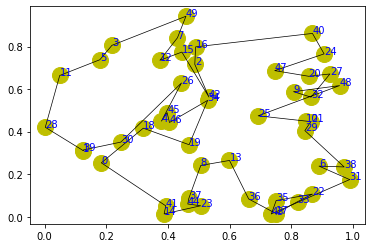

step:2825/5000, actic loss:0.788, critic loss:3.682, L:10.002, 0min2sec
step:2826/5000, actic loss:0.787, critic loss:3.681, L:10.001, 0min2sec
step:2827/5000, actic loss:0.786, critic loss:3.679, L:10.000, 0min1sec
step:2828/5000, actic loss:0.786, critic loss:3.678, L:9.999, 0min1sec
step:2829/5000, actic loss:0.786, critic loss:3.677, L:9.998, 0min1sec
distance:8.065
tensor([33,  7, 38, 24, 11, 48, 14, 25, 37, 21,  2, 40,  0, 18, 42,  9, 23, 28,
        12,  5, 31, 35, 46, 20,  6, 22, 34, 17, 26,  3, 32, 39, 15, 44, 45, 10,
        41, 19, 16, 36, 27, 30,  1,  8, 43, 47, 49,  4, 29, 13])


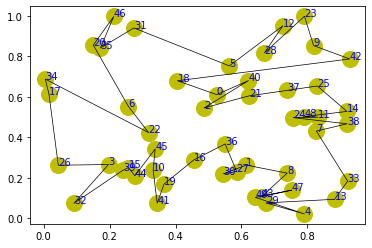

step:2830/5000, actic loss:0.786, critic loss:3.676, L:9.997, 0min2sec
step:2831/5000, actic loss:0.785, critic loss:3.675, L:9.996, 0min1sec
step:2832/5000, actic loss:0.784, critic loss:3.673, L:9.995, 0min1sec
step:2833/5000, actic loss:0.784, critic loss:3.672, L:9.994, 0min1sec
step:2834/5000, actic loss:0.784, critic loss:3.671, L:9.994, 0min1sec
distance:7.854
tensor([35, 12,  7, 28, 40, 33,  8, 38, 19, 45, 27,  9, 31, 11,  1, 14, 13, 32,
        49, 46,  3, 29, 39, 22, 26, 42,  5, 16, 48, 25, 24, 43, 44, 47, 37, 34,
         6, 15, 10, 17,  4, 18, 21, 23, 36, 41,  0, 20, 30,  2])


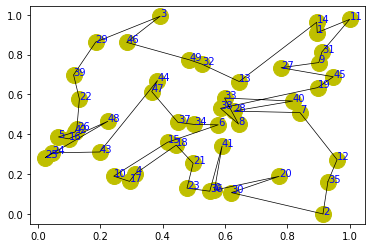

step:2835/5000, actic loss:0.784, critic loss:3.670, L:9.993, 0min2sec
step:2836/5000, actic loss:0.784, critic loss:3.669, L:9.992, 0min2sec
step:2837/5000, actic loss:0.783, critic loss:3.667, L:9.991, 0min1sec
step:2838/5000, actic loss:0.783, critic loss:3.666, L:9.990, 0min1sec
step:2839/5000, actic loss:0.782, critic loss:3.665, L:9.989, 0min1sec
distance:7.597
tensor([37, 35,  1,  5, 45, 31,  2, 49, 15,  8, 13, 32, 12, 23,  6, 43, 48,  9,
         0, 30, 46, 16, 17, 40, 36, 27, 24, 38, 29, 34, 20, 10, 44, 22, 47, 28,
         7,  3, 39, 33, 42, 14,  4, 19, 26, 25, 11, 41, 21, 18])


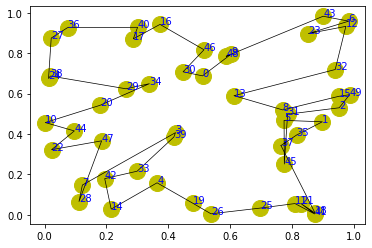

step:2840/5000, actic loss:0.781, critic loss:3.664, L:9.988, 0min2sec
step:2841/5000, actic loss:0.780, critic loss:3.663, L:9.987, 0min1sec
step:2842/5000, actic loss:0.779, critic loss:3.662, L:9.986, 0min1sec
step:2843/5000, actic loss:0.779, critic loss:3.660, L:9.985, 0min1sec
step:2844/5000, actic loss:0.780, critic loss:3.659, L:9.984, 0min1sec
distance:7.887
tensor([16, 19, 33,  5, 23, 41, 35, 31, 25, 36, 13, 10,  9, 12, 39,  0, 14, 30,
        46, 34,  7, 21, 49, 47, 15, 11, 42, 27, 48,  1,  8, 40, 32, 43, 22, 24,
         6,  4, 20, 28,  2, 37, 29, 44, 17, 45, 38,  3, 18, 26])


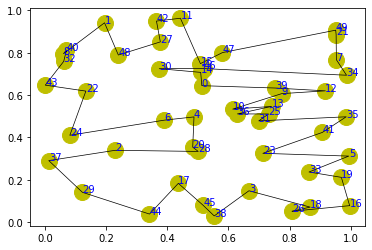

step:2845/5000, actic loss:0.780, critic loss:3.658, L:9.983, 0min2sec
step:2846/5000, actic loss:0.781, critic loss:3.657, L:9.982, 0min2sec
step:2847/5000, actic loss:0.780, critic loss:3.656, L:9.981, 0min1sec
step:2848/5000, actic loss:0.779, critic loss:3.654, L:9.980, 0min1sec
step:2849/5000, actic loss:0.777, critic loss:3.653, L:9.979, 0min1sec
distance:6.402
tensor([33, 27, 41, 23, 10, 45, 36, 47,  2, 43, 31, 37, 30, 24, 35, 39, 32,  5,
        14, 13, 12, 19,  6, 20, 48, 28, 42, 40, 49, 34, 21,  4, 11, 26,  8, 44,
         1, 17,  3, 38, 18, 22, 29, 16, 46,  9,  0, 25,  7, 15])


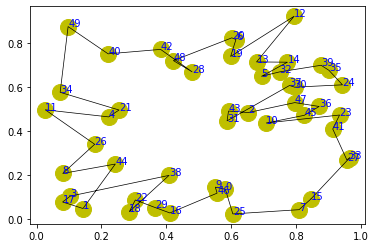

step:2850/5000, actic loss:0.776, critic loss:3.652, L:9.978, 0min2sec
step:2851/5000, actic loss:0.775, critic loss:3.651, L:9.977, 0min1sec
step:2852/5000, actic loss:0.775, critic loss:3.650, L:9.976, 0min1sec
step:2853/5000, actic loss:0.775, critic loss:3.649, L:9.975, 0min1sec
step:2854/5000, actic loss:0.774, critic loss:3.647, L:9.974, 0min1sec
distance:8.274
tensor([23, 45,  6, 38, 21, 41,  5, 12, 44,  3,  1,  8, 46, 29,  2, 13,  4, 35,
        17, 39, 22, 49, 40, 28, 18, 31,  9, 19, 34, 20, 47,  0, 16, 36, 30, 32,
        10, 27, 25, 11, 43, 24, 42, 37, 48, 33, 15, 14, 26,  7])


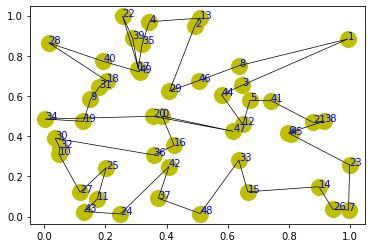

step:2855/5000, actic loss:0.774, critic loss:3.646, L:9.974, 0min2sec
step:2856/5000, actic loss:0.774, critic loss:3.645, L:9.973, 0min2sec
step:2857/5000, actic loss:0.774, critic loss:3.644, L:9.972, 0min2sec
step:2858/5000, actic loss:0.774, critic loss:3.643, L:9.971, 0min1sec
step:2859/5000, actic loss:0.774, critic loss:3.642, L:9.970, 0min1sec
distance:7.536
tensor([ 0, 15, 45, 16, 14,  2, 26, 19, 27, 13,  7, 44, 35, 31, 28, 38, 11, 34,
        36, 37, 22, 41, 30, 48, 10, 43, 20,  4, 21,  3,  5,  1, 47, 25, 46, 39,
        33, 12, 18, 42,  9, 40, 32, 49,  6, 24, 17,  8, 29, 23])


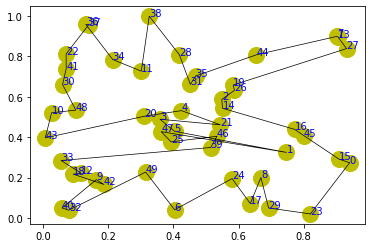

step:2860/5000, actic loss:0.773, critic loss:3.640, L:9.969, 0min2sec
step:2861/5000, actic loss:0.772, critic loss:3.639, L:9.968, 0min1sec
step:2862/5000, actic loss:0.772, critic loss:3.638, L:9.967, 0min1sec
step:2863/5000, actic loss:0.771, critic loss:3.637, L:9.966, 0min1sec
step:2864/5000, actic loss:0.771, critic loss:3.636, L:9.965, 0min1sec
distance:6.822
tensor([34, 25,  5, 46, 42, 14,  8, 28, 32, 35, 17, 39,  4,  1, 43, 27, 48, 31,
        41,  7,  6, 15, 49, 40, 38, 36, 19, 13, 37,  2, 24, 21,  9, 33, 22, 23,
        45, 18, 10, 30, 29, 16,  0, 11, 26, 44, 12, 47, 20,  3])


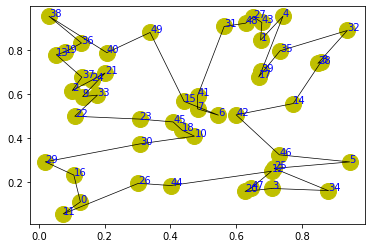

step:2865/5000, actic loss:0.771, critic loss:3.635, L:9.964, 0min2sec
step:2866/5000, actic loss:0.771, critic loss:3.634, L:9.963, 0min1sec
step:2867/5000, actic loss:0.770, critic loss:3.632, L:9.962, 0min1sec
step:2868/5000, actic loss:0.770, critic loss:3.631, L:9.962, 0min1sec
step:2869/5000, actic loss:0.770, critic loss:3.630, L:9.961, 0min1sec
distance:6.952
tensor([ 1, 10, 49, 37, 47, 42, 41, 21, 18, 26, 36,  9,  0, 30, 17, 48, 13,  2,
        45, 24, 12,  6,  8, 16,  5, 15, 44, 19, 22, 43, 28,  3, 25, 31, 38, 14,
        35, 32, 29, 46, 23, 33, 20, 11, 27, 40, 34, 39,  4,  7])


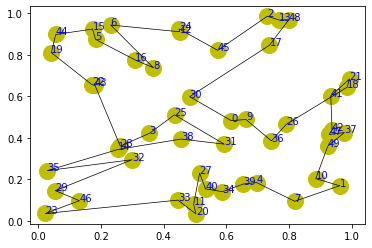

step:2870/5000, actic loss:0.769, critic loss:3.629, L:9.960, 0min2sec
step:2871/5000, actic loss:0.769, critic loss:3.628, L:9.959, 0min1sec
step:2872/5000, actic loss:0.768, critic loss:3.627, L:9.958, 0min1sec
step:2873/5000, actic loss:0.768, critic loss:3.625, L:9.957, 0min1sec
step:2874/5000, actic loss:0.767, critic loss:3.624, L:9.956, 0min1sec
distance:7.178
tensor([30, 41, 14, 21, 25,  0, 12, 32,  9, 20, 42, 23, 48,  7, 46, 49, 11,  2,
        15, 28,  4, 18,  3, 13, 17,  1, 16, 43, 40, 27, 37, 33, 24, 38, 10,  5,
        36, 45, 29, 35,  8,  6, 26, 44, 39, 19, 34, 22, 47, 31])


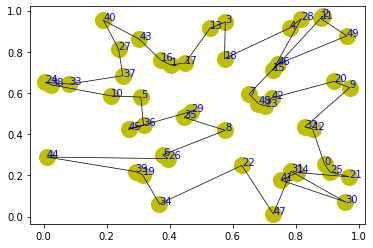

step:2875/5000, actic loss:0.767, critic loss:3.623, L:9.955, 0min2sec
step:2876/5000, actic loss:0.767, critic loss:3.622, L:9.954, 0min2sec
step:2877/5000, actic loss:0.766, critic loss:3.621, L:9.953, 0min1sec
step:2878/5000, actic loss:0.766, critic loss:3.620, L:9.952, 0min1sec
step:2879/5000, actic loss:0.766, critic loss:3.618, L:9.951, 0min1sec
distance:6.488
tensor([30,  0, 48,  6, 47, 42, 37, 32, 31, 22, 45, 23, 27, 11, 35,  8, 24, 44,
        14, 19, 15, 39, 25, 18, 34, 29, 10,  7, 49, 38, 40, 43, 46,  9, 20,  5,
         1, 41, 28, 16, 21,  4, 36, 12,  2, 13, 26, 17,  3, 33])


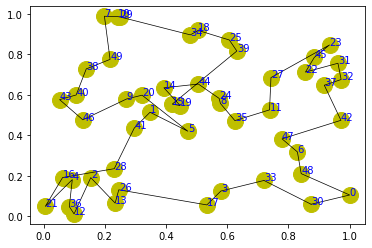

step:2880/5000, actic loss:0.765, critic loss:3.617, L:9.950, 0min2sec
step:2881/5000, actic loss:0.765, critic loss:3.616, L:9.949, 0min1sec
step:2882/5000, actic loss:0.765, critic loss:3.615, L:9.948, 0min1sec
step:2883/5000, actic loss:0.765, critic loss:3.614, L:9.947, 0min1sec
step:2884/5000, actic loss:0.765, critic loss:3.613, L:9.946, 0min1sec
distance:7.338
tensor([30, 45, 20, 47, 16, 11, 33, 40, 48,  7, 36, 44, 14,  3, 21, 37, 27, 46,
         2, 42,  9, 10, 43, 26, 35, 12, 38, 31, 15, 29, 13, 18,  0, 41, 28, 24,
         4, 17, 39,  8,  5, 34, 23,  1, 22, 32, 49, 25,  6, 19])


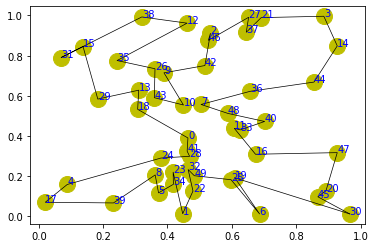

step:2885/5000, actic loss:0.764, critic loss:3.611, L:9.945, 0min2sec
step:2886/5000, actic loss:0.763, critic loss:3.610, L:9.944, 0min2sec
step:2887/5000, actic loss:0.762, critic loss:3.609, L:9.943, 0min2sec
step:2888/5000, actic loss:0.762, critic loss:3.608, L:9.942, 0min1sec
step:2889/5000, actic loss:0.762, critic loss:3.607, L:9.941, 0min1sec
distance:6.271
tensor([25, 44, 28, 42, 47, 27, 16,  4, 26, 33,  3,  2, 23, 30,  0, 15, 45, 21,
        10, 18, 32,  7, 12,  9, 34, 17,  8,  6, 35,  1, 41, 49, 43, 38, 24, 48,
        40, 31, 13, 11,  5, 14, 37, 39, 29, 46, 19, 36, 22, 20])


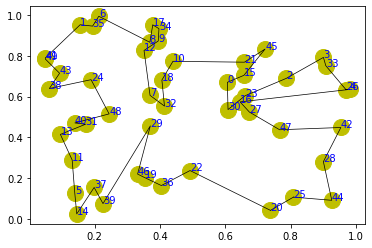

step:2890/5000, actic loss:0.761, critic loss:3.606, L:9.940, 0min2sec
step:2891/5000, actic loss:0.761, critic loss:3.604, L:9.939, 0min1sec
step:2892/5000, actic loss:0.761, critic loss:3.603, L:9.938, 0min1sec
step:2893/5000, actic loss:0.760, critic loss:3.602, L:9.937, 0min1sec
step:2894/5000, actic loss:0.759, critic loss:3.601, L:9.936, 0min1sec
distance:7.436
tensor([ 5,  1,  0,  3, 33, 46, 14, 10,  8,  6, 13, 49, 29, 20, 11, 32, 42, 43,
        35, 34,  9, 12, 28, 23, 25, 30, 37, 44, 18,  4, 38, 26,  7, 41, 48, 17,
        47, 16, 22, 15, 19, 27, 36, 24, 40, 45, 39, 21,  2, 31])


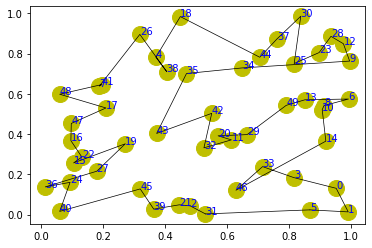

step:2895/5000, actic loss:0.760, critic loss:3.600, L:9.935, 0min2sec
step:2896/5000, actic loss:0.760, critic loss:3.599, L:9.934, 0min2sec
step:2897/5000, actic loss:0.760, critic loss:3.597, L:9.933, 0min2sec
step:2898/5000, actic loss:0.761, critic loss:3.596, L:9.932, 0min2sec
step:2899/5000, actic loss:0.760, critic loss:3.595, L:9.931, 0min1sec
distance:7.635
tensor([11,  5, 20,  2, 18, 22, 33, 17, 13, 24, 29,  4, 31, 30, 12,  9, 25, 27,
        46,  8, 28, 39, 10, 14,  6, 48, 47, 36, 21, 40, 43,  0, 16, 45, 15,  3,
        42, 23, 44,  7, 49, 35, 32, 41, 37, 34, 19,  1, 38, 26])


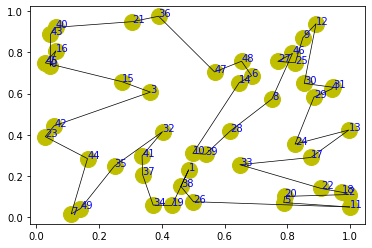

step:2900/5000, actic loss:0.759, critic loss:3.594, L:9.930, 0min2sec
step:2901/5000, actic loss:0.759, critic loss:3.593, L:9.929, 0min1sec
step:2902/5000, actic loss:0.758, critic loss:3.592, L:9.928, 0min1sec
step:2903/5000, actic loss:0.759, critic loss:3.591, L:9.927, 0min1sec
step:2904/5000, actic loss:0.759, critic loss:3.589, L:9.926, 0min1sec
distance:7.476
tensor([29,  7, 28, 35, 44, 23, 31, 25, 48, 16, 41, 45, 38, 15, 14,  6, 26, 34,
        47,  0, 20, 13, 49, 22, 39, 40, 36,  8, 12, 24, 18, 10, 46, 21,  3,  5,
        19, 11, 42, 30, 27, 37, 33,  4,  9, 17, 43,  1,  2, 32])


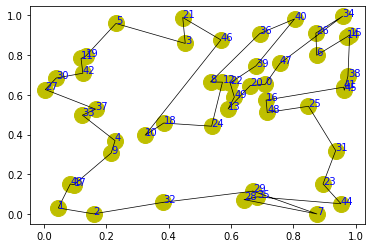

step:2905/5000, actic loss:0.759, critic loss:3.588, L:9.926, 0min2sec
step:2906/5000, actic loss:0.758, critic loss:3.587, L:9.925, 0min1sec
step:2907/5000, actic loss:0.758, critic loss:3.586, L:9.924, 0min2sec
step:2908/5000, actic loss:0.757, critic loss:3.585, L:9.923, 0min2sec
step:2909/5000, actic loss:0.757, critic loss:3.584, L:9.922, 0min2sec
distance:7.050
tensor([10, 31, 35,  5, 25, 38, 19, 45, 28, 40,  6, 32, 15, 23, 18, 36,  7,  4,
        26, 17,  3, 20,  2,  1, 11, 16,  8, 46, 33, 42, 49,  0, 21, 30, 48, 37,
        24, 14,  9, 13, 41, 43, 22, 12, 34, 29, 47, 39, 27, 44])


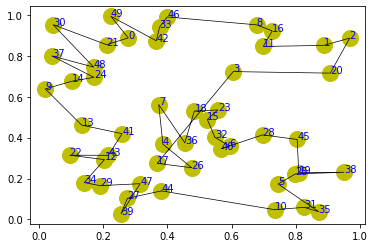

step:2910/5000, actic loss:0.757, critic loss:3.583, L:9.921, 0min2sec
step:2911/5000, actic loss:0.757, critic loss:3.581, L:9.920, 0min1sec
step:2912/5000, actic loss:0.756, critic loss:3.580, L:9.919, 0min1sec
step:2913/5000, actic loss:0.756, critic loss:3.579, L:9.918, 0min1sec
step:2914/5000, actic loss:0.755, critic loss:3.578, L:9.917, 0min1sec
distance:7.220
tensor([ 4, 13, 49, 45, 16, 27, 17,  7, 29, 40, 30, 19, 20, 15, 43, 35,  2, 39,
        48, 33, 37, 14,  1, 41,  6, 10, 36, 31, 47, 25, 21, 34, 46, 11,  9, 42,
         3, 12, 18,  8, 24, 22,  0, 28,  5, 26, 44, 23, 32, 38])


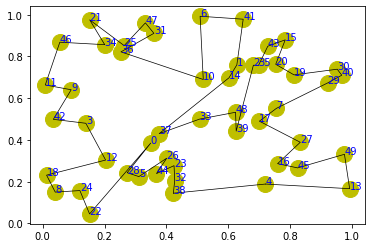

step:2915/5000, actic loss:0.754, critic loss:3.577, L:9.916, 0min1sec
step:2916/5000, actic loss:0.755, critic loss:3.576, L:9.915, 0min1sec
step:2917/5000, actic loss:0.755, critic loss:3.575, L:9.914, 0min1sec
step:2918/5000, actic loss:0.755, critic loss:3.574, L:9.913, 0min1sec
step:2919/5000, actic loss:0.755, critic loss:3.572, L:9.912, 0min2sec
distance:7.481
tensor([36, 13, 46, 27,  5, 34, 12, 30,  7, 45, 14, 18,  8, 15, 43, 47, 16, 41,
        17, 33, 11, 19, 48, 38, 35, 21, 22, 23, 37, 40,  2, 39,  4,  3, 32, 20,
        24,  0, 49,  9, 26,  1, 29,  6, 28, 10, 25, 31, 44, 42])


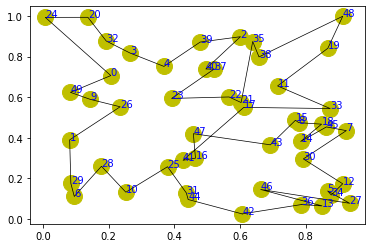

step:2920/5000, actic loss:0.755, critic loss:3.571, L:9.911, 0min2sec
step:2921/5000, actic loss:0.754, critic loss:3.570, L:9.910, 0min1sec
step:2922/5000, actic loss:0.753, critic loss:3.569, L:9.909, 0min1sec
step:2923/5000, actic loss:0.753, critic loss:3.568, L:9.909, 0min1sec
step:2924/5000, actic loss:0.753, critic loss:3.567, L:9.908, 0min1sec
distance:7.312
tensor([20, 31, 44, 36,  3, 18, 48, 49,  6, 46, 41, 29,  7, 17, 11,  2, 45, 35,
        40, 43, 39, 19, 14, 42, 47,  5,  8, 28, 34, 22,  1, 27,  4,  9, 12, 33,
        25, 10, 38, 26, 16, 15, 23, 37,  0, 30, 32, 24, 13, 21])


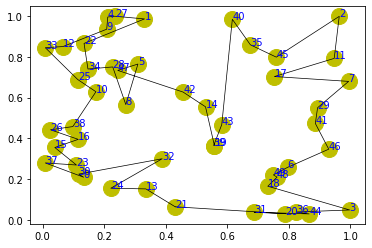

step:2925/5000, actic loss:0.753, critic loss:3.566, L:9.907, 0min2sec
step:2926/5000, actic loss:0.754, critic loss:3.565, L:9.906, 0min1sec
step:2927/5000, actic loss:0.754, critic loss:3.563, L:9.905, 0min1sec
step:2928/5000, actic loss:0.753, critic loss:3.562, L:9.904, 0min1sec
step:2929/5000, actic loss:0.753, critic loss:3.561, L:9.903, 0min1sec
distance:6.428
tensor([38, 19, 10, 33, 12,  9, 43, 30,  5,  1, 44, 20, 11, 17,  7, 47, 25,  0,
        22, 13, 15, 40, 37, 49,  6, 46, 45, 36, 18, 26, 42, 21,  8, 29,  3, 32,
        27, 48,  4, 14, 23,  2, 24, 39, 16, 28, 34, 41, 35, 31])


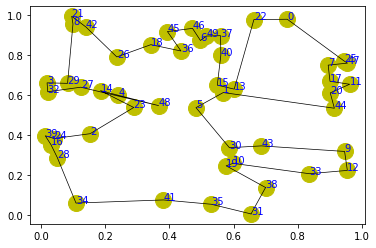

step:2930/5000, actic loss:0.752, critic loss:3.560, L:9.902, 0min2sec
step:2931/5000, actic loss:0.752, critic loss:3.559, L:9.901, 0min1sec
step:2932/5000, actic loss:0.752, critic loss:3.558, L:9.900, 0min1sec
step:2933/5000, actic loss:0.751, critic loss:3.557, L:9.899, 0min1sec
step:2934/5000, actic loss:0.751, critic loss:3.556, L:9.898, 0min1sec
distance:6.510
tensor([25, 48, 35, 43, 40,  4, 47, 28, 41, 19, 17, 29, 30, 45, 15,  0, 46, 21,
         2, 31, 18, 36,  9, 11, 37, 22, 32, 27, 26,  5, 33,  3, 34,  8, 24, 23,
        44, 49, 10, 13,  1,  6, 14, 42,  7, 20, 39, 12, 38, 16])


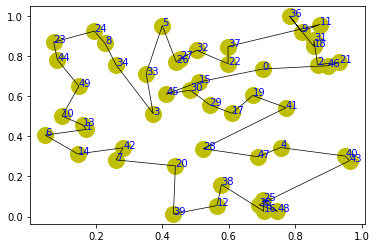

step:2935/5000, actic loss:0.749, critic loss:3.555, L:9.898, 0min2sec
step:2936/5000, actic loss:0.748, critic loss:3.553, L:9.897, 0min1sec
step:2937/5000, actic loss:0.748, critic loss:3.552, L:9.896, 0min1sec
step:2938/5000, actic loss:0.747, critic loss:3.551, L:9.895, 0min1sec
step:2939/5000, actic loss:0.747, critic loss:3.550, L:9.894, 0min1sec
distance:7.112
tensor([49, 13, 46, 17, 11, 37, 29, 45, 47, 38,  1, 10, 14,  9, 16, 26, 23, 19,
        34, 18, 44, 40,  4, 20, 30, 39, 31, 22,  5, 48,  3,  6, 33, 25,  0, 43,
        36, 24, 42,  7, 35, 28, 21, 41,  2, 32, 12, 15,  8, 27])


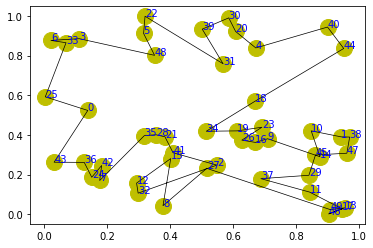

step:2940/5000, actic loss:0.747, critic loss:3.549, L:9.893, 0min2sec
step:2941/5000, actic loss:0.747, critic loss:3.548, L:9.892, 0min1sec
step:2942/5000, actic loss:0.747, critic loss:3.547, L:9.891, 0min1sec
step:2943/5000, actic loss:0.746, critic loss:3.546, L:9.890, 0min2sec
step:2944/5000, actic loss:0.745, critic loss:3.545, L:9.889, 0min1sec
distance:6.697
tensor([34, 10, 38, 30, 28, 40, 26, 20, 23,  3, 16, 44, 41,  8, 12, 24, 29, 13,
        47, 32, 39,  4, 49, 35,  1, 43, 21,  5, 48, 14, 15, 17, 27, 45, 42, 18,
         7, 11, 33, 19, 25, 46, 37,  0, 22, 36,  9, 31,  2,  6])


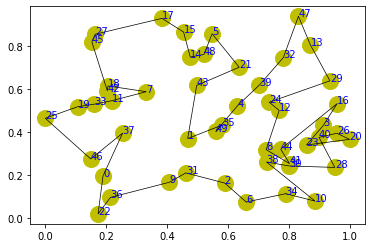

step:2945/5000, actic loss:0.745, critic loss:3.544, L:9.889, 0min2sec
step:2946/5000, actic loss:0.745, critic loss:3.542, L:9.888, 0min1sec
step:2947/5000, actic loss:0.744, critic loss:3.541, L:9.887, 0min1sec
step:2948/5000, actic loss:0.743, critic loss:3.540, L:9.886, 0min1sec
step:2949/5000, actic loss:0.743, critic loss:3.539, L:9.885, 0min1sec
distance:6.757
tensor([24,  7, 48, 11, 30, 33, 14, 10,  4,  1, 19,  0, 40,  9, 42, 47, 31, 45,
        36, 17, 16, 21, 20, 22, 26, 27,  3, 28, 32, 34, 39, 38, 41, 49,  2, 46,
        13, 12, 18, 29, 43, 44,  6,  5, 35, 25, 37, 23,  8, 15])


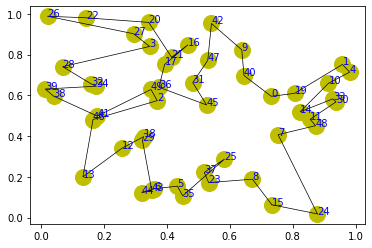

step:2950/5000, actic loss:0.742, critic loss:3.538, L:9.884, 0min2sec
step:2951/5000, actic loss:0.742, critic loss:3.537, L:9.883, 0min1sec
step:2952/5000, actic loss:0.742, critic loss:3.536, L:9.882, 0min1sec
step:2953/5000, actic loss:0.742, critic loss:3.535, L:9.882, 0min1sec
step:2954/5000, actic loss:0.741, critic loss:3.534, L:9.881, 0min2sec
distance:7.432
tensor([19, 42, 26, 36, 12, 25, 11, 39, 45,  6, 27, 13,  0, 10,  2, 14, 24, 16,
         5, 47, 22, 23, 30,  4, 44, 33, 28, 29, 32,  7,  9, 34, 43, 18,  1, 21,
        48, 31, 41,  3, 46, 15,  8, 38, 37, 20, 17, 49, 35, 40])


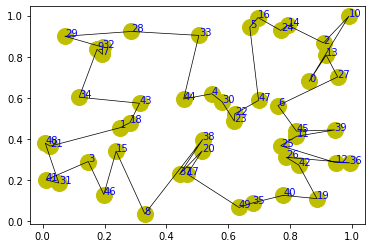

step:2955/5000, actic loss:0.741, critic loss:3.533, L:9.880, 0min2sec
step:2956/5000, actic loss:0.740, critic loss:3.532, L:9.879, 0min1sec
step:2957/5000, actic loss:0.740, critic loss:3.531, L:9.878, 0min1sec
step:2958/5000, actic loss:0.740, critic loss:3.529, L:9.878, 0min1sec
step:2959/5000, actic loss:0.739, critic loss:3.528, L:9.877, 0min1sec
distance:8.698
tensor([45, 36, 43,  5, 49, 47, 39, 22, 33, 41,  4, 18, 17, 29, 21, 34,  7, 12,
        25, 20, 37, 46, 30, 15, 48, 31,  9, 28, 44,  2, 35, 23, 11, 32, 38, 19,
        24,  6, 42,  3, 26, 14,  1, 27,  0,  8, 10, 13, 16, 40])


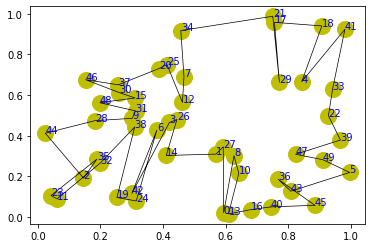

step:2960/5000, actic loss:0.739, critic loss:3.527, L:9.876, 0min2sec
step:2961/5000, actic loss:0.739, critic loss:3.526, L:9.875, 0min1sec
step:2962/5000, actic loss:0.739, critic loss:3.525, L:9.874, 0min1sec
step:2963/5000, actic loss:0.738, critic loss:3.524, L:9.874, 0min1sec
step:2964/5000, actic loss:0.737, critic loss:3.523, L:9.873, 0min1sec
distance:8.130
tensor([24, 11, 19, 49,  6,  7,  5, 44, 28, 15, 18, 40, 25, 23, 38,  4, 33, 13,
        10, 42,  9, 30, 35, 21, 16, 20, 37,  0, 14,  1, 31,  3, 36, 43, 26, 34,
        47, 45, 48, 12, 46, 22, 27, 32, 41, 29, 39,  8,  2, 17])


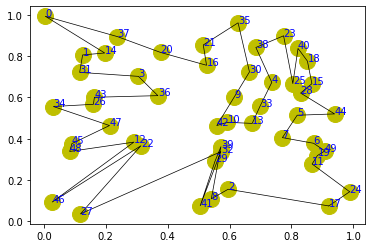

step:2965/5000, actic loss:0.737, critic loss:3.522, L:9.872, 0min2sec
step:2966/5000, actic loss:0.737, critic loss:3.521, L:9.871, 0min1sec
step:2967/5000, actic loss:0.737, critic loss:3.520, L:9.870, 0min1sec
step:2968/5000, actic loss:0.738, critic loss:3.519, L:9.869, 0min1sec
step:2969/5000, actic loss:0.736, critic loss:3.518, L:9.868, 0min1sec
distance:7.531
tensor([ 7,  2, 43, 48, 17, 25, 18, 45, 47, 30, 24, 16, 49, 26, 41, 27,  5, 22,
        44, 36, 13, 42, 10, 20, 40, 37, 23, 32, 35,  0,  8, 34,  9,  4, 21, 11,
         3, 15, 19, 38,  6, 28, 31, 12, 39, 46, 14, 33, 29,  1])


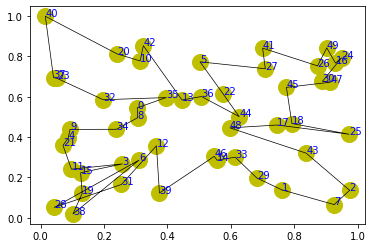

step:2970/5000, actic loss:0.735, critic loss:3.517, L:9.868, 0min2sec
step:2971/5000, actic loss:0.734, critic loss:3.516, L:9.867, 0min1sec
step:2972/5000, actic loss:0.733, critic loss:3.515, L:9.866, 0min1sec
step:2973/5000, actic loss:0.733, critic loss:3.513, L:9.865, 0min1sec
step:2974/5000, actic loss:0.733, critic loss:3.512, L:9.864, 0min1sec
distance:7.225
tensor([27, 47, 15,  2, 40, 11,  7, 34, 31, 37, 21, 18, 44, 33, 46, 23, 48,  9,
        20, 42, 30, 29,  6, 45,  4, 26, 25, 32, 10, 24, 13, 39, 43, 35, 36,  8,
        19, 14, 17,  1,  0,  5, 28, 12, 49, 38, 22,  3, 16, 41])


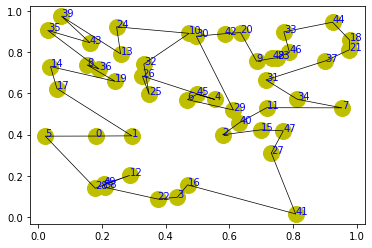

step:2975/5000, actic loss:0.733, critic loss:3.511, L:9.863, 0min2sec
step:2976/5000, actic loss:0.732, critic loss:3.510, L:9.862, 0min2sec
step:2977/5000, actic loss:0.732, critic loss:3.509, L:9.861, 0min1sec
step:2978/5000, actic loss:0.731, critic loss:3.508, L:9.860, 0min1sec
step:2979/5000, actic loss:0.730, critic loss:3.507, L:9.860, 0min1sec
distance:6.471
tensor([25,  9, 31, 11, 27,  4, 12, 32, 42, 46, 40, 41, 38,  5, 23, 33, 45, 22,
        16,  8, 30, 10, 13,  0, 14, 34, 39, 29, 48, 35, 20, 28, 37, 15, 26, 36,
         6, 44,  1, 17, 19,  3, 43, 24,  2, 21,  7, 49, 47, 18])


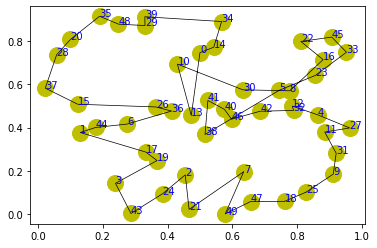

step:2980/5000, actic loss:0.729, critic loss:3.506, L:9.859, 0min2sec
step:2981/5000, actic loss:0.729, critic loss:3.505, L:9.858, 0min1sec
step:2982/5000, actic loss:0.729, critic loss:3.504, L:9.857, 0min1sec
step:2983/5000, actic loss:0.729, critic loss:3.503, L:9.856, 0min1sec
step:2984/5000, actic loss:0.728, critic loss:3.502, L:9.855, 0min1sec
distance:7.883
tensor([47, 15, 37, 10, 26, 38, 25, 27, 13, 24,  1,  5,  8, 12,  3, 45, 19, 41,
        43, 11, 21, 18, 35, 33, 22, 39,  2, 30, 31, 17, 28, 40, 42, 46, 16,  6,
        32, 20, 49, 34, 23,  4, 44, 36, 48,  0, 14,  9, 29,  7])


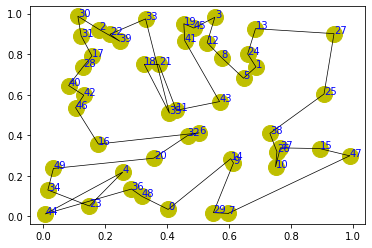

step:2985/5000, actic loss:0.728, critic loss:3.501, L:9.854, 0min2sec
step:2986/5000, actic loss:0.728, critic loss:3.500, L:9.853, 0min1sec
step:2987/5000, actic loss:0.727, critic loss:3.498, L:9.853, 0min1sec
step:2988/5000, actic loss:0.727, critic loss:3.497, L:9.852, 0min1sec
step:2989/5000, actic loss:0.728, critic loss:3.496, L:9.851, 0min1sec
distance:6.379
tensor([12,  5, 45, 24, 26, 16, 29,  0, 47, 40, 35, 39,  2,  3,  7, 33, 22, 28,
        44, 31, 37, 27,  8, 48, 32, 18, 13, 42, 30, 49, 14, 41, 20, 43, 17, 19,
         4, 10, 23, 36, 25, 11,  6, 38, 46,  9, 15, 21,  1, 34])


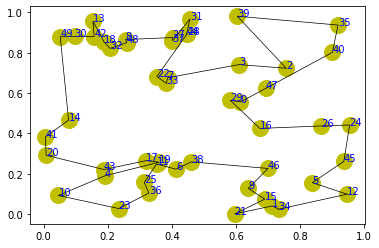

step:2990/5000, actic loss:0.727, critic loss:3.495, L:9.850, 0min2sec
step:2991/5000, actic loss:0.727, critic loss:3.494, L:9.849, 0min1sec
step:2992/5000, actic loss:0.726, critic loss:3.493, L:9.849, 0min2sec
step:2993/5000, actic loss:0.726, critic loss:3.492, L:9.848, 0min1sec
step:2994/5000, actic loss:0.725, critic loss:3.491, L:9.847, 0min1sec
distance:7.420
tensor([ 4, 15, 24, 49, 30, 20, 44, 14, 35, 18, 13, 36,  7, 16, 33, 26,  1, 46,
        27, 11, 45,  3, 12, 37,  9,  0, 10, 22, 47, 31, 34, 19, 42, 17, 25, 23,
         2, 40, 41, 48, 38, 29, 32, 21,  5, 28, 43,  8,  6, 39])


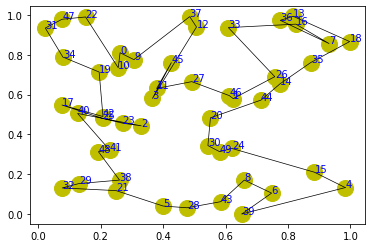

step:2995/5000, actic loss:0.725, critic loss:3.490, L:9.846, 0min2sec
step:2996/5000, actic loss:0.726, critic loss:3.489, L:9.845, 0min1sec
step:2997/5000, actic loss:0.726, critic loss:3.488, L:9.844, 0min1sec
step:2998/5000, actic loss:0.726, critic loss:3.487, L:9.843, 0min1sec
step:2999/5000, actic loss:0.725, critic loss:3.486, L:9.842, 0min1sec
distance:7.322
tensor([48, 23, 43, 10,  8, 28, 32, 46, 36, 38, 16, 37, 25,  9, 39, 41,  3, 44,
        21, 14,  7, 26, 12, 22, 45,  6,  0, 49, 33, 15, 35, 30, 47, 42, 31, 18,
         2,  4, 34, 27,  1, 19,  5, 20, 40, 17, 24, 11, 29, 13])


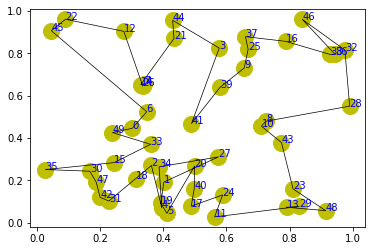

step:3000/5000, actic loss:0.725, critic loss:3.485, L:9.842, 0min1sec
step:3001/5000, actic loss:0.724, critic loss:3.484, L:9.841, 0min1sec
step:3002/5000, actic loss:0.724, critic loss:3.483, L:9.840, 0min2sec
step:3003/5000, actic loss:0.724, critic loss:3.482, L:9.839, 0min1sec
step:3004/5000, actic loss:0.725, critic loss:3.480, L:9.838, 0min2sec
distance:6.958
tensor([38, 27, 26, 40, 18, 16, 29,  0, 44, 28, 46, 30, 24,  6, 20,  7, 49, 42,
        41, 43, 22, 19, 36,  3,  4, 35, 34, 23, 10, 31, 11,  8, 39, 33,  1, 32,
        48, 17, 13,  9, 45, 21, 47,  5, 25, 15,  2, 14, 37, 12])


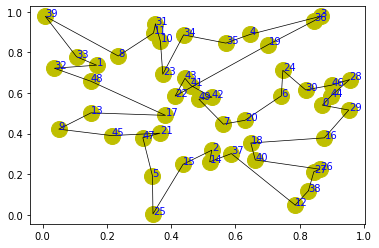

step:3005/5000, actic loss:0.725, critic loss:3.479, L:9.837, 0min2sec
step:3006/5000, actic loss:0.725, critic loss:3.478, L:9.836, 0min1sec
step:3007/5000, actic loss:0.725, critic loss:3.477, L:9.835, 0min1sec
step:3008/5000, actic loss:0.724, critic loss:3.476, L:9.834, 0min1sec
step:3009/5000, actic loss:0.724, critic loss:3.475, L:9.834, 0min1sec
distance:7.312
tensor([32, 17,  3, 39, 46, 36,  7, 38, 27, 11,  8, 26, 45,  4,  2, 25, 33, 48,
        10, 14, 28, 30, 44,  6, 35, 40, 23, 19, 13, 47, 15, 12,  0, 41, 24, 43,
        37, 20, 42, 21,  9, 16, 22, 31, 49, 34, 29, 18,  5,  1])


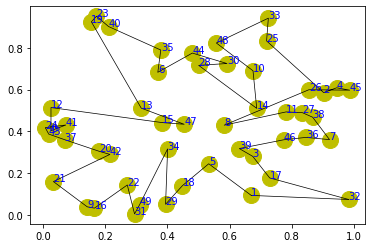

step:3010/5000, actic loss:0.723, critic loss:3.474, L:9.833, 0min1sec
step:3011/5000, actic loss:0.723, critic loss:3.473, L:9.832, 0min1sec
step:3012/5000, actic loss:0.723, critic loss:3.472, L:9.831, 0min1sec
step:3013/5000, actic loss:0.723, critic loss:3.471, L:9.830, 0min1sec
step:3014/5000, actic loss:0.723, critic loss:3.470, L:9.829, 0min2sec
distance:7.903
tensor([35, 31, 22, 13, 11, 36, 29, 21, 15, 16, 42,  4, 17,  9, 14, 32, 27,  3,
         6, 40, 23, 39, 41, 24, 34, 26, 12, 44, 46,  0, 20, 33,  2, 48,  5, 38,
        45,  1, 28, 49, 30, 37, 25,  7,  8, 47, 19, 10, 18, 43])


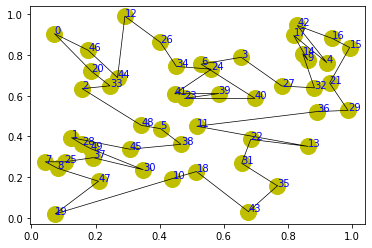

step:3015/5000, actic loss:0.722, critic loss:3.469, L:9.829, 0min2sec
step:3016/5000, actic loss:0.721, critic loss:3.468, L:9.828, 0min2sec
step:3017/5000, actic loss:0.719, critic loss:3.467, L:9.827, 0min1sec
step:3018/5000, actic loss:0.717, critic loss:3.466, L:9.826, 0min1sec
step:3019/5000, actic loss:0.715, critic loss:3.465, L:9.826, 0min1sec
distance:7.166
tensor([35, 10, 26, 45, 34, 41, 44, 29, 21,  5, 37, 31, 32, 43, 16,  4,  3,  1,
        42,  7, 46, 25, 38, 24, 15, 12,  9, 13, 19, 48, 30, 28,  2, 18,  0, 39,
        36, 23, 49, 27, 14,  6, 33,  8, 22, 20, 47, 40, 17, 11])


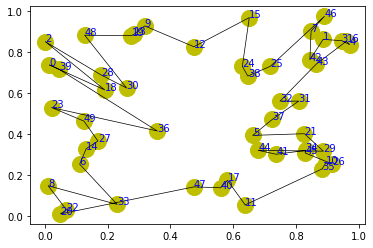

step:3020/5000, actic loss:0.714, critic loss:3.464, L:9.825, 0min2sec
step:3021/5000, actic loss:0.714, critic loss:3.463, L:9.825, 0min1sec
step:3022/5000, actic loss:0.715, critic loss:3.463, L:9.824, 0min1sec
step:3023/5000, actic loss:0.716, critic loss:3.462, L:9.824, 0min1sec
step:3024/5000, actic loss:0.717, critic loss:3.461, L:9.823, 0min1sec
distance:7.406
tensor([28, 39, 15, 27, 34, 23,  9, 11, 40, 24, 37, 18,  3, 49, 13,  1,  0, 26,
        19, 12, 25, 41, 32, 36, 43,  5,  6,  2, 16, 48, 17, 44, 35,  7, 14, 38,
        45, 20, 42, 10, 33, 31, 46, 29, 21, 47, 30,  4, 22,  8])


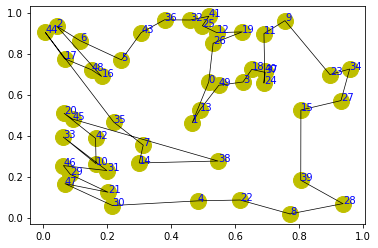

step:3025/5000, actic loss:0.719, critic loss:3.460, L:9.823, 0min2sec
step:3026/5000, actic loss:0.719, critic loss:3.459, L:9.822, 0min1sec
step:3027/5000, actic loss:0.719, critic loss:3.458, L:9.822, 0min1sec
step:3028/5000, actic loss:0.719, critic loss:3.457, L:9.821, 0min1sec
step:3029/5000, actic loss:0.718, critic loss:3.456, L:9.820, 0min1sec
distance:8.101
tensor([11,  5,  4, 44, 35, 31, 20, 13, 48, 28, 14, 46, 23, 22, 30, 25, 19, 45,
        42,  1, 27, 49, 34, 36,  3, 10,  9,  2, 41, 12, 15, 33, 16, 47, 29, 43,
        17, 37, 18,  7, 39, 24, 40,  8,  6, 32,  0, 38, 21, 26])


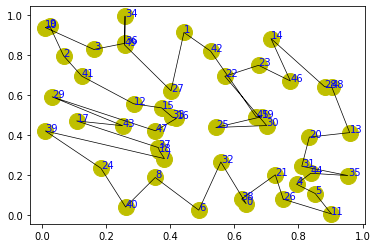

step:3030/5000, actic loss:0.717, critic loss:3.455, L:9.820, 0min2sec
step:3031/5000, actic loss:0.717, critic loss:3.454, L:9.819, 0min2sec
step:3032/5000, actic loss:0.717, critic loss:3.453, L:9.818, 0min1sec
step:3033/5000, actic loss:0.717, critic loss:3.452, L:9.817, 0min1sec
step:3034/5000, actic loss:0.717, critic loss:3.451, L:9.817, 0min1sec
distance:6.338
tensor([43, 13, 45,  5, 32, 25, 24, 26,  0, 30, 16, 14, 29, 20, 39, 19, 12, 36,
        40, 46, 31, 21, 49, 22,  6,  3, 37, 44, 48, 41,  7,  8, 11, 38, 34, 17,
        23, 18, 42, 33, 35, 27, 15, 47, 28,  2,  1, 10,  4,  9])


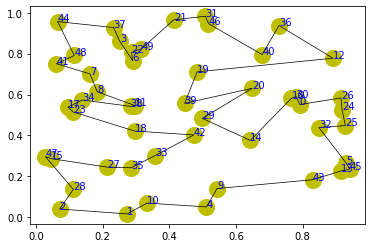

step:3035/5000, actic loss:0.717, critic loss:3.450, L:9.816, 0min2sec
step:3036/5000, actic loss:0.717, critic loss:3.449, L:9.815, 0min1sec
step:3037/5000, actic loss:0.716, critic loss:3.448, L:9.814, 0min1sec
step:3038/5000, actic loss:0.715, critic loss:3.447, L:9.813, 0min1sec
step:3039/5000, actic loss:0.714, critic loss:3.446, L:9.813, 0min1sec
distance:7.229
tensor([49, 11, 40, 10, 16, 19, 31, 26, 30, 27, 46, 38, 47,  5, 48, 33, 44, 29,
        42, 45, 43, 39, 37, 20, 13,  4,  2, 28, 25, 41,  3,  6,  9,  1, 14,  7,
        23, 34,  0, 35, 32,  8, 36, 24, 18, 17, 12, 15, 21, 22])


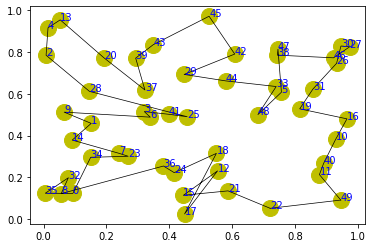

step:3040/5000, actic loss:0.714, critic loss:3.445, L:9.812, 0min2sec
step:3041/5000, actic loss:0.714, critic loss:3.444, L:9.811, 0min2sec
step:3042/5000, actic loss:0.714, critic loss:3.443, L:9.810, 0min1sec
step:3043/5000, actic loss:0.714, critic loss:3.442, L:9.809, 0min1sec
step:3044/5000, actic loss:0.713, critic loss:3.441, L:9.808, 0min1sec
distance:7.368
tensor([10, 29,  6, 14,  4, 32, 25, 20, 47, 12, 36, 45, 48, 23, 18, 24, 11, 37,
         1, 17, 26,  7, 46, 30,  2, 27,  0, 13, 19, 49, 33,  8, 15, 44, 40,  5,
        41,  9, 39, 21, 43, 28, 31, 35, 22,  3, 34, 42, 16, 38])


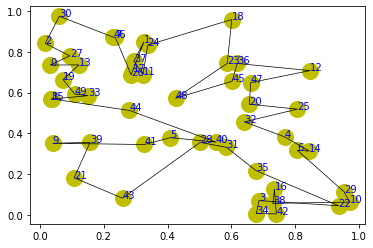

step:3045/5000, actic loss:0.712, critic loss:3.440, L:9.807, 0min2sec
step:3046/5000, actic loss:0.712, critic loss:3.439, L:9.806, 0min1sec
step:3047/5000, actic loss:0.711, critic loss:3.437, L:9.806, 0min1sec
step:3048/5000, actic loss:0.711, critic loss:3.436, L:9.805, 0min1sec
step:3049/5000, actic loss:0.710, critic loss:3.435, L:9.804, 0min1sec
distance:8.052
tensor([28, 34, 40, 37,  4,  8, 44, 29, 25, 12, 38, 48, 22, 18, 24, 14, 32, 35,
        33, 20, 17, 11,  1, 42, 16, 13, 47, 49, 23, 21,  2, 43,  6,  0, 41, 26,
        10,  7, 30, 19,  3, 36,  9, 46, 39, 27, 15, 45,  5, 31])


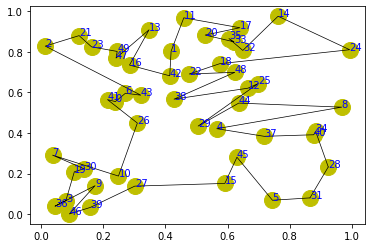

step:3050/5000, actic loss:0.710, critic loss:3.434, L:9.803, 0min2sec
step:3051/5000, actic loss:0.710, critic loss:3.433, L:9.802, 0min1sec
step:3052/5000, actic loss:0.710, critic loss:3.432, L:9.802, 0min2sec
step:3053/5000, actic loss:0.709, critic loss:3.431, L:9.801, 0min1sec
step:3054/5000, actic loss:0.708, critic loss:3.430, L:9.800, 0min1sec
distance:6.482
tensor([21, 16, 38, 13,  4, 30, 18, 11, 23, 25, 40, 42, 27, 44, 34,  9,  0, 46,
        48, 35, 22, 12,  6, 32, 19,  3, 41, 15, 24, 20, 14, 29, 39, 36, 49, 43,
        37,  5,  7, 47, 10, 17, 31,  2, 28, 26,  8, 45,  1, 33])


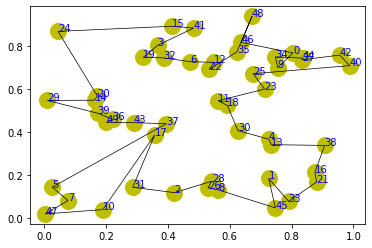

step:3055/5000, actic loss:0.708, critic loss:3.429, L:9.799, 0min2sec
step:3056/5000, actic loss:0.708, critic loss:3.428, L:9.798, 0min1sec
step:3057/5000, actic loss:0.708, critic loss:3.427, L:9.798, 0min1sec
step:3058/5000, actic loss:0.708, critic loss:3.426, L:9.797, 0min1sec
step:3059/5000, actic loss:0.708, critic loss:3.425, L:9.796, 0min1sec
distance:7.796
tensor([ 2, 20,  4,  9, 34, 26, 41, 42, 46, 10, 15, 44, 17, 49,  0, 29, 47, 36,
        22, 27, 16, 37, 43, 39, 25, 14,  8, 19,  5, 23, 32, 13, 38,  6, 33, 45,
         7,  1, 40, 12, 24, 11,  3, 18, 31, 28, 48, 35, 21, 30])


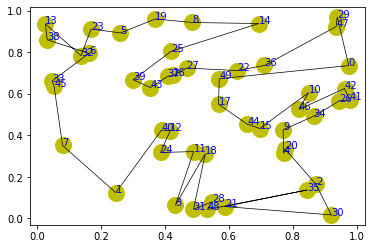

step:3060/5000, actic loss:0.708, critic loss:3.424, L:9.795, 0min2sec
step:3061/5000, actic loss:0.707, critic loss:3.423, L:9.794, 0min1sec
step:3062/5000, actic loss:0.705, critic loss:3.422, L:9.794, 0min1sec
step:3063/5000, actic loss:0.704, critic loss:3.421, L:9.793, 0min1sec
step:3064/5000, actic loss:0.705, critic loss:3.420, L:9.792, 0min1sec
distance:8.141
tensor([46,  7, 30, 19,  9, 12, 18, 45, 38,  4, 49, 26, 36, 22, 29,  0, 10, 20,
        24, 41, 25, 28,  5,  6, 14,  2, 39,  3, 16,  8, 21, 31, 34, 27, 15, 42,
        11, 35, 32, 23, 33, 37, 48, 40, 43,  1, 13, 17, 44, 47])


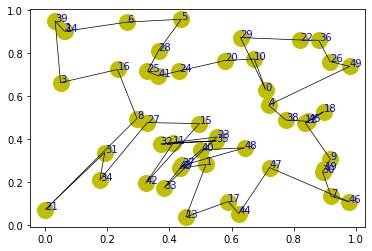

step:3065/5000, actic loss:0.704, critic loss:3.419, L:9.791, 0min2sec
step:3066/5000, actic loss:0.704, critic loss:3.418, L:9.790, 0min2sec
step:3067/5000, actic loss:0.704, critic loss:3.417, L:9.790, 0min1sec
step:3068/5000, actic loss:0.703, critic loss:3.416, L:9.789, 0min1sec
step:3069/5000, actic loss:0.702, critic loss:3.415, L:9.788, 0min1sec
distance:7.143
tensor([27, 17,  8, 26, 22, 16,  3, 40, 25, 23, 36, 28, 13, 33, 18, 43, 12,  9,
        21, 44,  5, 31, 11, 32, 10, 37, 42, 24, 49, 30, 46,  7, 45, 14, 38, 41,
        48,  6, 15, 35, 39,  4,  1, 47,  2, 34,  0, 29, 19, 20])


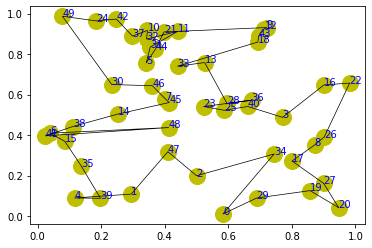

step:3070/5000, actic loss:0.703, critic loss:3.414, L:9.787, 0min1sec
step:3071/5000, actic loss:0.703, critic loss:3.413, L:9.787, 0min1sec
step:3072/5000, actic loss:0.704, critic loss:3.412, L:9.786, 0min1sec
step:3073/5000, actic loss:0.704, critic loss:3.411, L:9.785, 0min1sec
step:3074/5000, actic loss:0.704, critic loss:3.410, L:9.784, 0min1sec
distance:7.683
tensor([43, 37, 47, 33,  6, 29, 48,  0, 41, 20, 14, 15, 30,  3, 44, 25, 40, 28,
        23,  8, 31, 49, 24, 17, 35,  7, 34, 11, 32, 13, 18,  2, 26, 12, 36,  1,
        10,  4,  5, 42, 39, 45, 27, 46, 19,  9, 16, 22, 38, 21])


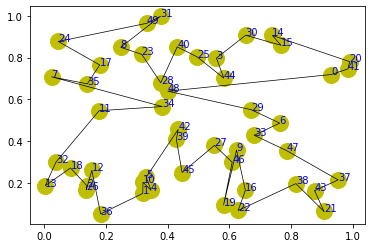

step:3075/5000, actic loss:0.703, critic loss:3.409, L:9.784, 0min2sec
step:3076/5000, actic loss:0.702, critic loss:3.408, L:9.783, 0min1sec
step:3077/5000, actic loss:0.701, critic loss:3.407, L:9.782, 0min1sec
step:3078/5000, actic loss:0.701, critic loss:3.406, L:9.781, 0min1sec
step:3079/5000, actic loss:0.700, critic loss:3.406, L:9.781, 0min1sec
distance:9.214
tensor([18, 34, 29,  3, 45, 41, 17,  4,  1, 49,  7, 31, 44, 23, 35, 38, 24,  0,
        39, 33, 27,  9, 36, 16, 32, 10, 13, 20, 19,  6, 30, 43, 37, 46, 21,  2,
        48, 40, 12, 25, 28, 47,  8, 11, 22, 26, 14, 42,  5, 15])


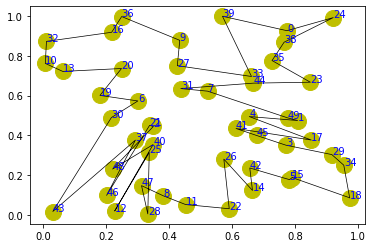

step:3080/5000, actic loss:0.700, critic loss:3.405, L:9.780, 0min2sec
step:3081/5000, actic loss:0.699, critic loss:3.404, L:9.779, 0min1sec
step:3082/5000, actic loss:0.699, critic loss:3.403, L:9.779, 0min1sec
step:3083/5000, actic loss:0.699, critic loss:3.402, L:9.778, 0min1sec
step:3084/5000, actic loss:0.698, critic loss:3.401, L:9.777, 0min1sec
distance:7.702
tensor([13, 25, 28, 14, 21,  1,  2,  5, 38, 35, 46,  6,  8, 31, 27, 40, 18,  7,
        16, 20, 47, 33, 41, 12, 48, 17, 45, 34,  3, 26, 43, 15, 36, 30, 24,  0,
        42,  9, 37, 11, 49, 44, 32,  4, 23, 29, 22, 19, 39, 10])


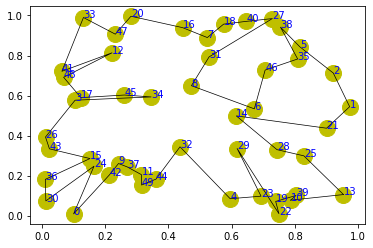

step:3085/5000, actic loss:0.697, critic loss:3.400, L:9.776, 0min2sec
step:3086/5000, actic loss:0.696, critic loss:3.399, L:9.776, 0min1sec
step:3087/5000, actic loss:0.695, critic loss:3.398, L:9.775, 0min1sec
step:3088/5000, actic loss:0.695, critic loss:3.397, L:9.774, 0min1sec
step:3089/5000, actic loss:0.695, critic loss:3.396, L:9.773, 0min1sec
distance:6.933
tensor([44,  1, 24,  2, 29, 30, 11, 49, 21, 23, 43, 40, 37, 26, 13, 17, 42,  8,
        45, 36, 12,  6,  3,  9, 22, 18,  4, 33,  5, 15, 34,  0, 48, 46, 31, 16,
        39, 32, 35, 25, 27, 14, 28, 19, 41, 10, 47, 38,  7, 20])


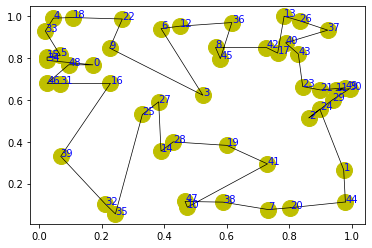

step:3090/5000, actic loss:0.696, critic loss:3.395, L:9.773, 0min2sec
step:3091/5000, actic loss:0.696, critic loss:3.394, L:9.772, 0min1sec
step:3092/5000, actic loss:0.695, critic loss:3.393, L:9.771, 0min1sec
step:3093/5000, actic loss:0.694, critic loss:3.392, L:9.770, 0min1sec
step:3094/5000, actic loss:0.693, critic loss:3.391, L:9.770, 0min1sec
distance:7.827
tensor([ 6, 47, 32, 18, 45, 12, 17, 10,  9, 33, 22, 28, 16, 27, 34, 19, 42, 31,
        38,  5, 46, 20, 49,  7,  8, 41, 13, 29, 24, 44, 25,  4, 11, 43, 23, 37,
        30, 39, 14,  3, 35, 40,  0, 36, 15,  2, 21, 26,  1, 48])


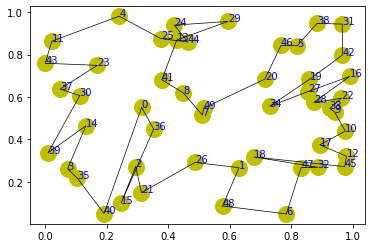

step:3095/5000, actic loss:0.693, critic loss:3.390, L:9.769, 0min2sec
step:3096/5000, actic loss:0.693, critic loss:3.389, L:9.768, 0min1sec
step:3097/5000, actic loss:0.694, critic loss:3.388, L:9.767, 0min1sec
step:3098/5000, actic loss:0.694, critic loss:3.387, L:9.766, 0min1sec
step:3099/5000, actic loss:0.694, critic loss:3.386, L:9.766, 0min1sec
distance:7.774
tensor([37,  1, 13,  0, 10, 20, 25, 39, 35,  5, 47, 36, 32, 16,  2, 38, 34,  7,
        44, 14, 45, 29, 18, 27, 28, 21, 42, 40,  3, 23, 26, 12, 11, 19,  4, 33,
         9, 31, 22,  8,  6, 24, 46, 49, 30, 15, 17, 41, 43, 48])


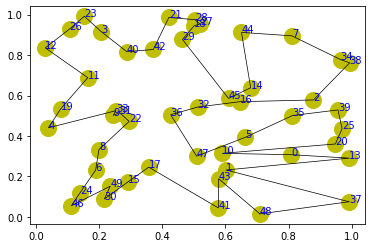

step:3100/5000, actic loss:0.693, critic loss:3.385, L:9.765, 0min2sec
step:3101/5000, actic loss:0.691, critic loss:3.384, L:9.764, 0min2sec
step:3102/5000, actic loss:0.690, critic loss:3.383, L:9.763, 0min2sec
step:3103/5000, actic loss:0.688, critic loss:3.382, L:9.763, 0min1sec
step:3104/5000, actic loss:0.687, critic loss:3.381, L:9.762, 0min1sec
distance:7.521
tensor([16, 17, 36,  4, 30, 43, 29,  5, 24, 22, 40, 35,  2, 13, 12, 45, 10, 15,
        14, 42, 41,  0,  1, 38,  3, 49,  8, 37, 31, 18, 44, 27, 28, 20, 39,  7,
         6, 47,  9, 46, 21, 25, 11, 48, 26, 23, 32, 34, 33, 19])


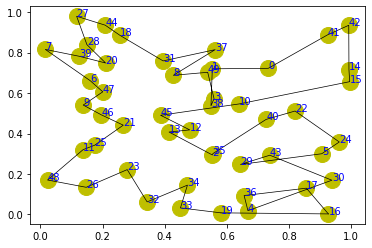

step:3105/5000, actic loss:0.686, critic loss:3.380, L:9.761, 0min1sec
step:3106/5000, actic loss:0.687, critic loss:3.379, L:9.760, 0min1sec
step:3107/5000, actic loss:0.688, critic loss:3.378, L:9.760, 0min1sec
step:3108/5000, actic loss:0.689, critic loss:3.377, L:9.759, 0min1sec
step:3109/5000, actic loss:0.690, critic loss:3.377, L:9.758, 0min1sec
distance:7.884
tensor([22, 42, 18,  1, 26, 27, 45,  9, 25, 17, 24, 33, 34,  7, 46,  6, 14, 31,
        47, 21, 32, 49,  4, 28, 39,  3, 38, 36, 10, 29, 23, 13, 44, 37, 40, 43,
        41,  5, 35,  2, 19, 15, 20, 16,  0,  8, 11, 12, 30, 48])


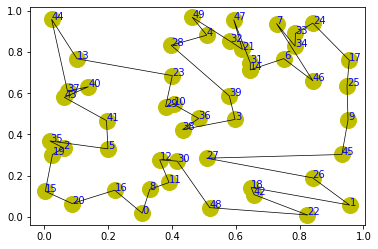

step:3110/5000, actic loss:0.690, critic loss:3.376, L:9.757, 0min2sec
step:3111/5000, actic loss:0.690, critic loss:3.375, L:9.756, 0min1sec
step:3112/5000, actic loss:0.688, critic loss:3.374, L:9.756, 0min1sec
step:3113/5000, actic loss:0.686, critic loss:3.373, L:9.755, 0min2sec
step:3114/5000, actic loss:0.683, critic loss:3.372, L:9.754, 0min1sec
distance:7.025
tensor([46, 20, 41,  1, 45, 40, 25, 49,  3, 28, 10, 48,  7, 22, 30, 44, 43, 36,
        11,  8, 12, 21,  6, 39, 24,  9, 16, 34, 29, 37, 13, 15, 17, 47, 42, 27,
         0, 33, 18,  5, 38, 31, 35, 19, 32, 14,  4,  2, 23, 26])


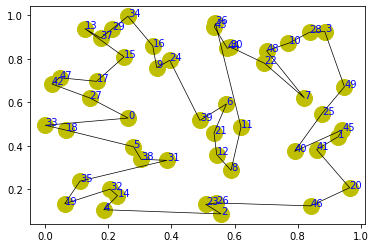

step:3115/5000, actic loss:0.680, critic loss:3.371, L:9.753, 0min2sec
step:3116/5000, actic loss:0.678, critic loss:3.370, L:9.753, 0min1sec
step:3117/5000, actic loss:0.677, critic loss:3.369, L:9.752, 0min1sec
step:3118/5000, actic loss:0.676, critic loss:3.368, L:9.751, 0min1sec
step:3119/5000, actic loss:0.677, critic loss:3.367, L:9.750, 0min1sec
distance:7.420
tensor([13,  6,  8, 25, 45, 33, 30, 27, 44,  9, 19, 14, 42, 40, 15,  4, 41, 12,
        22, 47, 21,  7, 32, 31, 43,  2, 17, 46, 29, 11, 34, 10, 26, 36, 35, 24,
        20,  1, 49, 39, 23, 28, 38, 48, 37,  0,  3, 18,  5, 16])


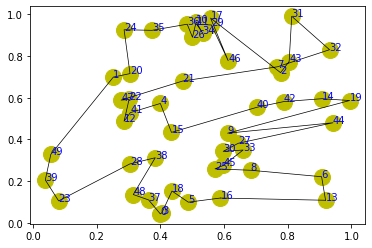

step:3120/5000, actic loss:0.678, critic loss:3.366, L:9.749, 0min1sec
step:3121/5000, actic loss:0.680, critic loss:3.365, L:9.749, 0min1sec
step:3122/5000, actic loss:0.682, critic loss:3.365, L:9.748, 0min1sec
step:3123/5000, actic loss:0.683, critic loss:3.364, L:9.747, 0min1sec
step:3124/5000, actic loss:0.682, critic loss:3.363, L:9.746, 0min1sec
distance:6.974
tensor([21, 20, 24,  7, 41,  2, 47, 29, 34, 33, 18,  0,  9, 17,  1, 23, 30, 46,
        36, 14, 28, 31,  3, 10, 13, 15, 25, 49,  4,  6,  5, 43, 48, 37, 40, 32,
        35, 45,  8, 26, 38, 12, 27, 11, 42, 16, 39, 22, 19, 44])


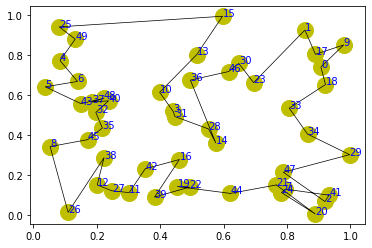

step:3125/5000, actic loss:0.682, critic loss:3.362, L:9.745, 0min2sec
step:3126/5000, actic loss:0.682, critic loss:3.361, L:9.744, 0min1sec
step:3127/5000, actic loss:0.681, critic loss:3.360, L:9.744, 0min1sec
step:3128/5000, actic loss:0.680, critic loss:3.359, L:9.743, 0min1sec
step:3129/5000, actic loss:0.680, critic loss:3.358, L:9.742, 0min1sec
distance:6.948
tensor([20, 46, 40, 39, 32, 36, 28, 31, 13, 23, 26, 29, 11,  5, 45, 44,  9, 34,
        37, 49, 42, 41, 21,  7,  2,  1, 43,  6, 17, 10,  0, 14, 38, 33, 19, 47,
        48, 12, 25, 22, 16, 18, 35, 15, 30, 24,  4,  3, 27,  8])


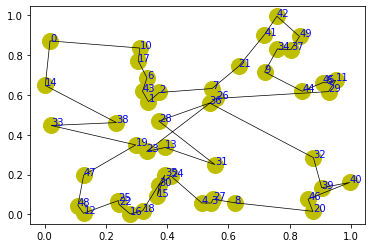

step:3130/5000, actic loss:0.679, critic loss:3.357, L:9.741, 0min2sec
step:3131/5000, actic loss:0.679, critic loss:3.356, L:9.740, 0min1sec
step:3132/5000, actic loss:0.680, critic loss:3.355, L:9.740, 0min1sec
step:3133/5000, actic loss:0.681, critic loss:3.354, L:9.739, 0min1sec
step:3134/5000, actic loss:0.681, critic loss:3.353, L:9.738, 0min1sec
distance:7.093
tensor([20, 31, 17,  0, 27, 30, 26, 48, 39, 12, 21, 46, 45, 10, 11, 37,  8, 34,
        29, 33, 41, 24, 19,  4, 49, 15, 13, 43, 14, 18, 42, 23,  3, 16, 32, 38,
         1,  6,  5, 40,  9, 25, 44, 35, 22,  2, 47, 36, 28,  7])


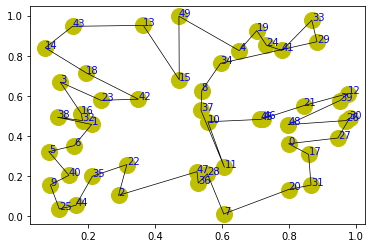

step:3135/5000, actic loss:0.680, critic loss:3.352, L:9.737, 0min1sec
step:3136/5000, actic loss:0.680, critic loss:3.351, L:9.736, 0min1sec
step:3137/5000, actic loss:0.679, critic loss:3.350, L:9.736, 0min1sec
step:3138/5000, actic loss:0.679, critic loss:3.349, L:9.735, 0min1sec
step:3139/5000, actic loss:0.679, critic loss:3.348, L:9.734, 0min2sec
distance:7.498
tensor([36,  3, 30, 49, 38, 40, 46, 44, 31, 18, 26, 29, 25, 11,  4, 10,  9, 17,
        48,  8, 43, 42, 21,  5,  2, 13,  0, 24, 19, 34, 39, 41, 35, 22, 28,  6,
        12, 27, 47, 16, 37, 15, 14,  1, 45,  7, 32, 20, 33, 23])


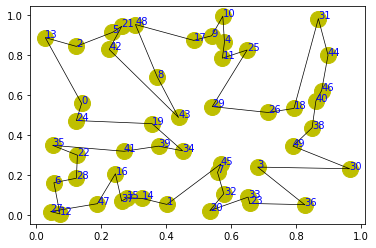

step:3140/5000, actic loss:0.679, critic loss:3.347, L:9.733, 0min2sec
step:3141/5000, actic loss:0.680, critic loss:3.346, L:9.732, 0min1sec
step:3142/5000, actic loss:0.680, critic loss:3.345, L:9.732, 0min1sec
step:3143/5000, actic loss:0.681, critic loss:3.344, L:9.731, 0min1sec
step:3144/5000, actic loss:0.681, critic loss:3.343, L:9.730, 0min1sec
distance:7.091
tensor([17, 41,  0,  8, 10, 35, 15, 39, 18, 14, 27, 42, 25, 13, 33, 19, 47,  5,
         9,  6, 46, 12, 48, 44, 40, 26, 32,  1, 37,  2,  7, 28, 31, 16, 38, 30,
        11, 34,  3, 23, 43,  4, 29, 36, 22, 24, 49, 45, 20, 21])


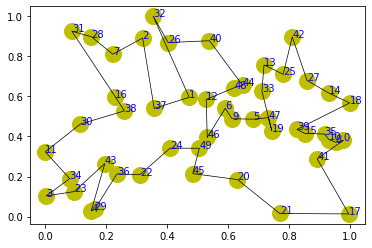

step:3145/5000, actic loss:0.680, critic loss:3.342, L:9.729, 0min1sec
step:3146/5000, actic loss:0.679, critic loss:3.341, L:9.728, 0min1sec
step:3147/5000, actic loss:0.678, critic loss:3.340, L:9.728, 0min1sec
step:3148/5000, actic loss:0.677, critic loss:3.339, L:9.727, 0min1sec
step:3149/5000, actic loss:0.677, critic loss:3.338, L:9.726, 0min1sec
distance:6.269
tensor([24, 27, 45,  2, 33, 46, 48, 42, 26,  0,  9, 19,  1,  6,  4,  5, 38,  7,
        11, 35, 25, 40, 31, 47,  8,  3, 18, 41, 37, 28, 20, 21, 14, 36, 12, 44,
        15, 22, 13, 16, 32, 30, 17, 23, 49, 29, 39, 10, 43, 34])


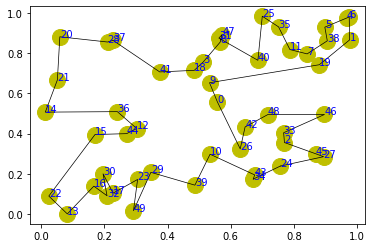

step:3150/5000, actic loss:0.677, critic loss:3.338, L:9.725, 0min1sec
step:3151/5000, actic loss:0.677, critic loss:3.337, L:9.724, 0min2sec
step:3152/5000, actic loss:0.678, critic loss:3.336, L:9.723, 0min1sec
step:3153/5000, actic loss:0.677, critic loss:3.335, L:9.722, 0min1sec
step:3154/5000, actic loss:0.677, critic loss:3.334, L:9.722, 0min1sec
distance:6.952
tensor([ 2, 10, 47, 26, 45,  8,  5, 31, 48,  3, 40, 41, 22, 49, 44, 33,  6, 37,
        12, 38, 43, 23, 18,  1, 46, 14, 20, 30,  7, 15, 28, 16,  4, 24, 27,  9,
        21, 11,  0, 36, 19, 32, 13, 39, 34, 29, 35, 42, 25, 17])


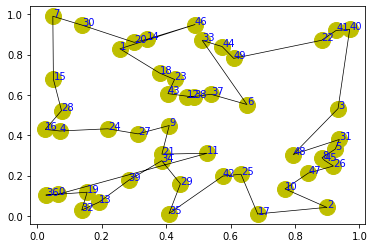

step:3155/5000, actic loss:0.677, critic loss:3.333, L:9.721, 0min1sec
step:3156/5000, actic loss:0.676, critic loss:3.332, L:9.720, 0min1sec
step:3157/5000, actic loss:0.675, critic loss:3.331, L:9.719, 0min1sec
step:3158/5000, actic loss:0.674, critic loss:3.330, L:9.718, 0min1sec
step:3159/5000, actic loss:0.674, critic loss:3.329, L:9.717, 0min1sec
distance:7.110
tensor([16, 27, 13, 17,  9, 20,  2, 34,  6, 43, 45, 19, 24, 29,  8, 12, 44, 42,
         3, 31, 40, 15, 39, 33, 30, 23,  4,  7, 46,  1, 48, 41,  0, 18, 21, 36,
         5, 28, 35, 26, 32, 47, 38, 10, 25, 11, 14, 49, 37, 22])


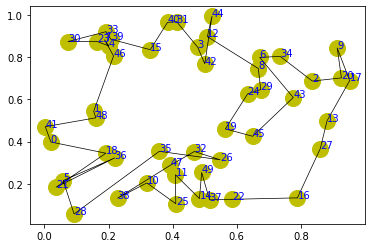

step:3160/5000, actic loss:0.674, critic loss:3.328, L:9.717, 0min1sec
step:3161/5000, actic loss:0.674, critic loss:3.327, L:9.716, 0min1sec
step:3162/5000, actic loss:0.674, critic loss:3.326, L:9.715, 0min1sec
step:3163/5000, actic loss:0.674, critic loss:3.325, L:9.714, 0min1sec
step:3164/5000, actic loss:0.673, critic loss:3.324, L:9.713, 0min1sec
distance:7.013
tensor([36, 39, 38, 43,  1, 35, 24, 32, 14, 47,  2, 46, 15,  8, 40, 31, 23, 13,
         9, 44,  6, 48, 27, 18, 42, 33, 22, 17, 16, 10, 21, 26, 41,  7,  0, 37,
        30, 20, 19, 49, 11, 12,  5,  4,  3, 29, 34, 25, 28, 45])


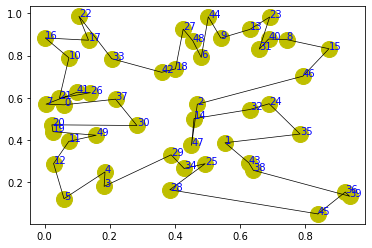

step:3165/5000, actic loss:0.672, critic loss:3.323, L:9.712, 0min2sec
step:3166/5000, actic loss:0.672, critic loss:3.322, L:9.712, 0min1sec
step:3167/5000, actic loss:0.672, critic loss:3.321, L:9.711, 0min1sec
step:3168/5000, actic loss:0.672, critic loss:3.320, L:9.710, 0min1sec
step:3169/5000, actic loss:0.673, critic loss:3.319, L:9.709, 0min1sec
distance:7.023
tensor([42, 47, 39, 10,  7,  0,  1, 21, 35, 27, 45,  3, 44, 16, 12, 14, 19,  9,
        32, 22, 11, 17, 37, 20, 23, 15, 38, 30, 29, 24, 26, 31,  4,  2, 18,  6,
        48, 13, 41, 43, 28, 33, 25, 40, 36,  8, 46, 49,  5, 34])


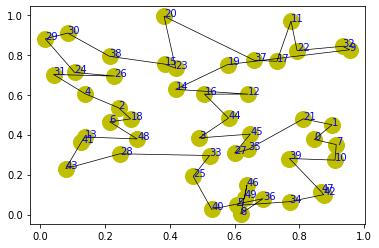

step:3170/5000, actic loss:0.673, critic loss:3.318, L:9.708, 0min2sec
step:3171/5000, actic loss:0.672, critic loss:3.317, L:9.707, 0min2sec
step:3172/5000, actic loss:0.671, critic loss:3.316, L:9.707, 0min1sec
step:3173/5000, actic loss:0.671, critic loss:3.315, L:9.706, 0min1sec
step:3174/5000, actic loss:0.670, critic loss:3.314, L:9.705, 0min1sec
distance:6.416
tensor([46, 33,  8, 28, 17, 31, 13, 32, 11,  2,  7, 21,  1, 14, 48, 27,  4, 39,
         5, 45, 37, 43,  0, 47, 40, 25, 41, 30, 16, 29, 36, 38, 42, 18, 44,  9,
         6, 26,  3, 35, 23, 15, 34, 49, 12, 24, 19, 20, 22, 10])


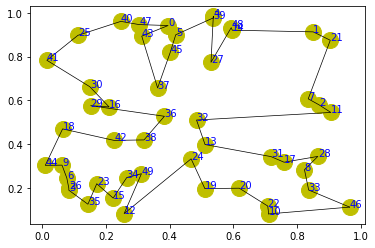

step:3175/5000, actic loss:0.670, critic loss:3.313, L:9.704, 0min1sec
step:3176/5000, actic loss:0.670, critic loss:3.312, L:9.703, 0min1sec
step:3177/5000, actic loss:0.670, critic loss:3.311, L:9.702, 0min1sec
step:3178/5000, actic loss:0.670, critic loss:3.310, L:9.702, 0min1sec
step:3179/5000, actic loss:0.670, critic loss:3.309, L:9.701, 0min1sec
distance:6.143
tensor([15,  1, 38,  6, 24, 11, 48, 30, 45, 37,  3, 32, 19, 27, 40, 36,  2, 22,
        47, 21,  4,  5, 35, 18, 29, 33, 13, 25, 10, 31, 49, 39,  8,  9, 42, 23,
         0, 16, 43, 14, 17, 26, 20, 41,  7, 34, 44, 28, 46, 12])


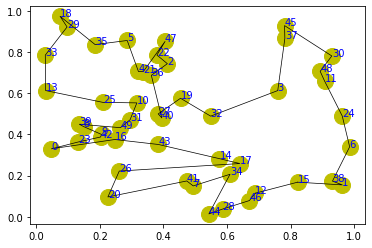

step:3180/5000, actic loss:0.669, critic loss:3.309, L:9.700, 0min2sec
step:3181/5000, actic loss:0.668, critic loss:3.308, L:9.699, 0min1sec
step:3182/5000, actic loss:0.668, critic loss:3.307, L:9.698, 0min1sec
step:3183/5000, actic loss:0.668, critic loss:3.306, L:9.697, 0min1sec
step:3184/5000, actic loss:0.668, critic loss:3.305, L:9.697, 0min1sec
distance:7.343
tensor([43, 28, 47, 30, 34, 33, 20,  5, 22, 32,  2, 19, 16, 14, 10,  0, 40,  4,
         6, 38,  9, 29,  8, 23, 36, 26, 25, 27, 31, 45, 18,  1, 41, 17, 44, 11,
        39,  7,  3, 37, 24, 49, 35, 15, 48, 13, 46, 12, 21, 42])


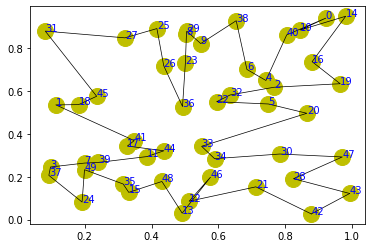

step:3185/5000, actic loss:0.668, critic loss:3.304, L:9.696, 0min2sec
step:3186/5000, actic loss:0.667, critic loss:3.303, L:9.695, 0min1sec
step:3187/5000, actic loss:0.667, critic loss:3.302, L:9.694, 0min1sec
step:3188/5000, actic loss:0.666, critic loss:3.301, L:9.693, 0min1sec
step:3189/5000, actic loss:0.666, critic loss:3.300, L:9.693, 0min1sec
distance:7.418
tensor([17,  1,  0, 29, 47, 30, 15, 49, 20, 44, 13, 18, 35, 24,  6,  8, 32, 37,
        45,  4, 46, 26, 27, 40,  3, 19,  7,  9,  2, 42,  5, 41, 28, 12, 43, 10,
        21, 22, 38, 34, 31, 11, 23, 14, 25, 39, 33, 16, 36, 48])


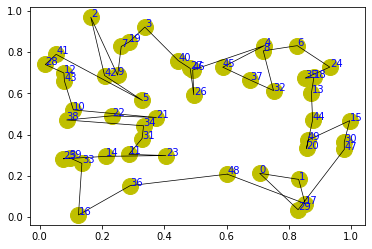

step:3190/5000, actic loss:0.667, critic loss:3.299, L:9.692, 0min2sec
step:3191/5000, actic loss:0.667, critic loss:3.298, L:9.691, 0min1sec
step:3192/5000, actic loss:0.667, critic loss:3.297, L:9.690, 0min1sec
step:3193/5000, actic loss:0.667, critic loss:3.296, L:9.689, 0min1sec
step:3194/5000, actic loss:0.666, critic loss:3.295, L:9.688, 0min1sec
distance:6.840
tensor([42,  6,  4, 27, 31,  2,  9, 12,  5, 20, 21, 19, 30, 38,  0, 11, 26, 35,
        18,  1, 23, 46, 28,  3, 22, 17, 15, 29, 33, 40, 41, 49, 47, 14, 45, 10,
        34, 44, 39, 32,  8, 24,  7, 43, 48, 36, 13, 25, 16, 37])


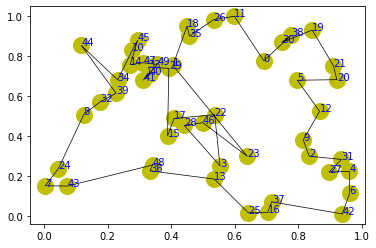

step:3195/5000, actic loss:0.665, critic loss:3.294, L:9.688, 0min1sec
step:3196/5000, actic loss:0.665, critic loss:3.293, L:9.687, 0min1sec
step:3197/5000, actic loss:0.665, critic loss:3.292, L:9.686, 0min1sec
step:3198/5000, actic loss:0.666, critic loss:3.291, L:9.685, 0min1sec
step:3199/5000, actic loss:0.666, critic loss:3.290, L:9.684, 0min1sec
distance:7.504
tensor([40,  1, 11, 42, 35, 22, 34, 29, 15, 46, 47, 14, 41, 25, 19,  8, 10, 31,
        26,  9, 16, 43, 30, 12, 45, 39,  7,  2, 44, 24,  0, 38,  4,  5, 37, 28,
        32,  6,  3, 49, 17, 20, 36, 23, 27, 18, 13, 21, 48, 33])


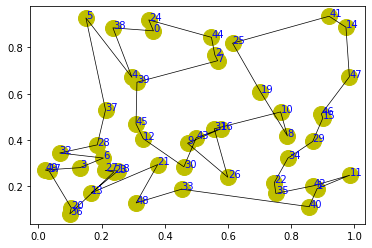

step:3200/5000, actic loss:0.666, critic loss:3.289, L:9.684, 0min1sec
step:3201/5000, actic loss:0.665, critic loss:3.288, L:9.683, 0min1sec
step:3202/5000, actic loss:0.665, critic loss:3.288, L:9.682, 0min1sec
step:3203/5000, actic loss:0.664, critic loss:3.287, L:9.681, 0min1sec
step:3204/5000, actic loss:0.663, critic loss:3.286, L:9.680, 0min1sec
distance:6.094
tensor([38, 11, 46, 42, 21, 22, 35, 30,  1, 47,  6, 10, 44,  4,  3, 31, 17, 32,
        29, 12,  5, 23, 24, 41, 25, 36, 13,  2,  8,  7, 49, 45, 27, 14, 48, 20,
         9,  0, 16, 37, 33, 26, 43, 18, 15, 28, 39, 34, 40, 19])


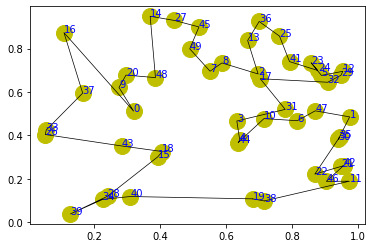

step:3205/5000, actic loss:0.663, critic loss:3.285, L:9.679, 0min2sec
step:3206/5000, actic loss:0.663, critic loss:3.284, L:9.679, 0min1sec
step:3207/5000, actic loss:0.663, critic loss:3.283, L:9.678, 0min1sec
step:3208/5000, actic loss:0.663, critic loss:3.282, L:9.677, 0min1sec
step:3209/5000, actic loss:0.663, critic loss:3.281, L:9.676, 0min1sec
distance:8.123
tensor([36,  7,  0, 49, 38, 25, 32, 12,  1, 15, 20, 33, 10, 21, 23,  2, 27, 31,
         5, 48, 42, 11, 16,  3, 28, 19, 22, 30,  8, 44, 13, 24, 40,  4, 37, 26,
        18, 41, 17, 29, 46, 45, 14, 39, 43, 34,  6, 35, 47,  9])


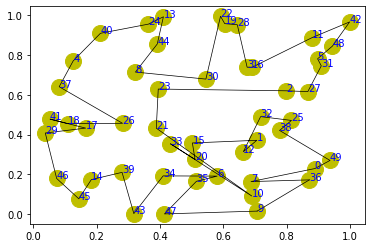

step:3210/5000, actic loss:0.661, critic loss:3.280, L:9.675, 0min1sec
step:3211/5000, actic loss:0.660, critic loss:3.279, L:9.675, 0min1sec
step:3212/5000, actic loss:0.659, critic loss:3.278, L:9.674, 0min1sec
step:3213/5000, actic loss:0.659, critic loss:3.277, L:9.673, 0min1sec
step:3214/5000, actic loss:0.659, critic loss:3.276, L:9.672, 0min1sec
distance:6.715
tensor([ 9, 20, 38, 48, 45, 28, 22, 27, 46, 49, 25, 35,  6, 16,  0, 14,  5, 44,
        34, 33, 23,  8, 30,  3, 40, 39,  7, 41, 26,  4, 11, 32,  1, 12, 15, 36,
        24, 19, 10, 37, 47, 17, 42, 29, 21, 18, 43, 13,  2, 31])


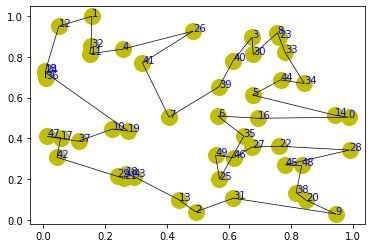

step:3215/5000, actic loss:0.659, critic loss:3.275, L:9.672, 0min2sec
step:3216/5000, actic loss:0.659, critic loss:3.274, L:9.671, 0min1sec
step:3217/5000, actic loss:0.659, critic loss:3.274, L:9.670, 0min1sec
step:3218/5000, actic loss:0.659, critic loss:3.273, L:9.669, 0min2sec
step:3219/5000, actic loss:0.658, critic loss:3.272, L:9.668, 0min2sec
distance:8.012
tensor([42, 34,  4, 46,  5, 38,  7, 35,  0, 30, 25, 26, 33, 39, 49, 20, 36, 37,
        22, 21, 15, 31, 27, 10, 14, 47, 19, 12, 32, 43, 45, 29, 44, 24,  1, 11,
        41,  8, 17, 16, 13, 40, 18,  2, 48,  9, 28, 23,  3,  6])


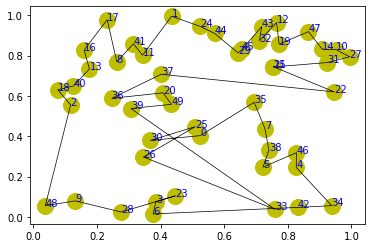

step:3220/5000, actic loss:0.658, critic loss:3.271, L:9.668, 0min2sec
step:3221/5000, actic loss:0.657, critic loss:3.270, L:9.667, 0min1sec
step:3222/5000, actic loss:0.657, critic loss:3.269, L:9.666, 0min1sec
step:3223/5000, actic loss:0.657, critic loss:3.268, L:9.665, 0min1sec
step:3224/5000, actic loss:0.657, critic loss:3.267, L:9.664, 0min1sec
distance:6.776
tensor([49, 10, 19, 37, 27,  2, 38, 13, 15, 36,  0,  5, 21, 46, 25, 16, 32, 23,
        26, 29, 35, 47, 43, 18, 17,  3, 39, 31, 42, 44, 28,  1, 30,  7, 20, 14,
        12,  8,  9, 41, 40, 33, 24,  6, 45,  4, 22, 34, 48, 11])


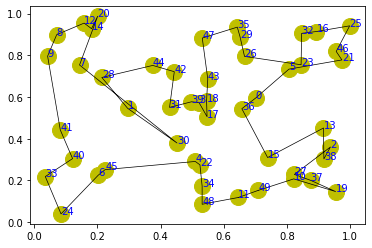

step:3225/5000, actic loss:0.656, critic loss:3.266, L:9.664, 0min1sec
step:3226/5000, actic loss:0.656, critic loss:3.265, L:9.663, 0min1sec
step:3227/5000, actic loss:0.655, critic loss:3.264, L:9.662, 0min1sec
step:3228/5000, actic loss:0.654, critic loss:3.263, L:9.661, 0min1sec
step:3229/5000, actic loss:0.654, critic loss:3.262, L:9.661, 0min1sec
distance:7.416
tensor([14, 32, 23, 40, 48, 18, 31,  4, 28, 29, 45, 43, 46,  0, 25, 24,  6, 12,
        19, 42, 41, 30, 15,  1,  5, 36, 44,  3, 34, 27, 26, 47,  8, 11,  2, 20,
        33, 21, 38, 35, 39,  7,  9, 49, 37, 16, 22, 10, 13, 17])


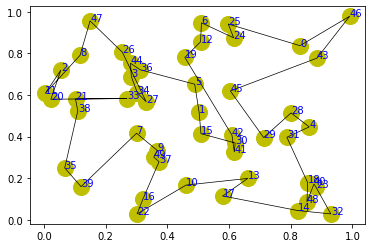

step:3230/5000, actic loss:0.655, critic loss:3.262, L:9.660, 0min2sec
step:3231/5000, actic loss:0.655, critic loss:3.261, L:9.659, 0min1sec
step:3232/5000, actic loss:0.655, critic loss:3.260, L:9.658, 0min1sec
step:3233/5000, actic loss:0.655, critic loss:3.259, L:9.658, 0min2sec
step:3234/5000, actic loss:0.654, critic loss:3.258, L:9.657, 0min1sec
distance:6.524
tensor([15, 31,  8, 13, 25,  7, 20, 35, 19, 39, 16, 11, 41, 38, 45,  0, 26, 12,
        10, 24, 29, 48, 33, 17, 46, 23,  9, 21, 30, 44,  6, 49, 43, 14, 37, 40,
        18, 42,  5, 36,  3,  2, 22,  1, 27,  4, 32, 28, 34, 47])


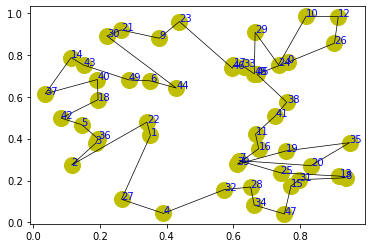

step:3235/5000, actic loss:0.653, critic loss:3.257, L:9.656, 0min2sec
step:3236/5000, actic loss:0.652, critic loss:3.256, L:9.655, 0min1sec
step:3237/5000, actic loss:0.652, critic loss:3.255, L:9.655, 0min1sec
step:3238/5000, actic loss:0.652, critic loss:3.254, L:9.654, 0min1sec
step:3239/5000, actic loss:0.652, critic loss:3.253, L:9.653, 0min1sec
distance:7.699
tensor([16, 48, 32, 38, 24,  1, 25, 20,  3,  6, 27, 45, 10,  2,  9,  5, 26, 33,
        14, 46, 17, 23, 47, 12, 34, 21, 18, 36, 43, 28, 22, 44, 39, 15,  0, 42,
        19, 29, 49,  7, 13,  8, 37, 31, 11, 41,  4, 35, 40, 30])


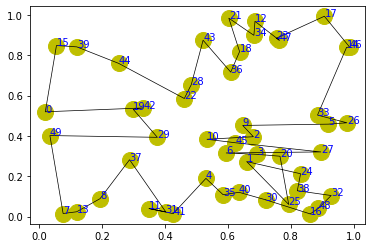

step:3240/5000, actic loss:0.653, critic loss:3.252, L:9.652, 0min2sec
step:3241/5000, actic loss:0.652, critic loss:3.251, L:9.651, 0min1sec
step:3242/5000, actic loss:0.652, critic loss:3.251, L:9.651, 0min1sec
step:3243/5000, actic loss:0.651, critic loss:3.250, L:9.650, 0min1sec
step:3244/5000, actic loss:0.650, critic loss:3.249, L:9.649, 0min1sec
distance:7.471
tensor([19, 42, 15, 21, 30, 13, 37, 32, 41, 46, 24, 20, 40,  1, 47, 22, 48, 11,
        38, 43,  0, 31,  2, 12,  4,  7,  9, 45, 29, 28, 33, 25, 23,  8, 35, 14,
        17, 16, 49, 36, 34,  5, 18, 26,  6, 39, 10,  3, 27, 44])


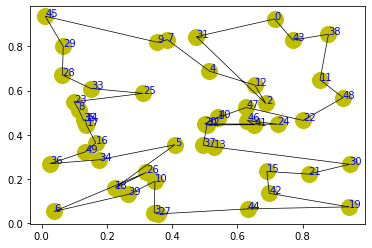

step:3245/5000, actic loss:0.650, critic loss:3.248, L:9.648, 0min2sec
step:3246/5000, actic loss:0.650, critic loss:3.247, L:9.648, 0min2sec
step:3247/5000, actic loss:0.649, critic loss:3.246, L:9.647, 0min1sec
step:3248/5000, actic loss:0.649, critic loss:3.245, L:9.646, 0min1sec
step:3249/5000, actic loss:0.649, critic loss:3.244, L:9.646, 0min1sec
distance:7.511
tensor([47, 36, 41, 46, 13,  7, 14, 17,  1, 34, 24, 28, 42, 10, 11, 22,  3, 45,
         6, 12, 31, 15, 33,  9, 30, 39,  2,  8, 19,  5, 40, 43, 37, 32, 23, 26,
        38, 49, 44,  4, 27, 18,  0, 29, 48, 21, 20, 35, 16, 25])


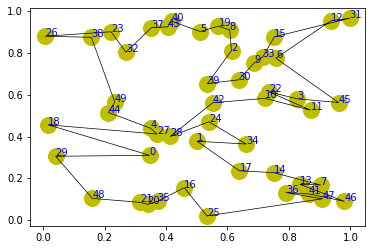

step:3250/5000, actic loss:0.649, critic loss:3.243, L:9.645, 0min2sec
step:3251/5000, actic loss:0.649, critic loss:3.242, L:9.644, 0min1sec
step:3252/5000, actic loss:0.650, critic loss:3.242, L:9.643, 0min1sec
step:3253/5000, actic loss:0.650, critic loss:3.241, L:9.643, 0min1sec
step:3254/5000, actic loss:0.650, critic loss:3.240, L:9.642, 0min1sec
distance:7.094
tensor([36, 44, 48,  5, 38,  1, 42,  8, 13,  9, 49, 11, 14, 33, 24, 37, 12, 39,
        16, 34, 40, 30, 46, 29, 20, 27, 47,  3, 21, 28, 17, 23, 43, 41,  7, 15,
        19,  2, 45, 18, 32, 25, 31,  4, 26, 22, 10,  6,  0, 35])


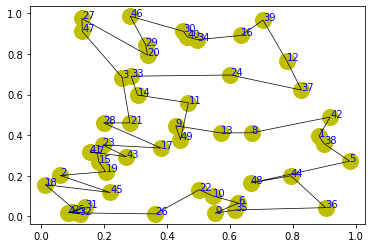

step:3255/5000, actic loss:0.649, critic loss:3.239, L:9.641, 0min2sec
step:3256/5000, actic loss:0.648, critic loss:3.238, L:9.641, 0min1sec
step:3257/5000, actic loss:0.648, critic loss:3.237, L:9.640, 0min2sec
step:3258/5000, actic loss:0.647, critic loss:3.236, L:9.639, 0min2sec
step:3259/5000, actic loss:0.647, critic loss:3.235, L:9.638, 0min2sec
distance:7.146
tensor([39,  2, 28, 27, 13, 30, 11, 41, 24, 18, 45,  3, 36, 37, 12, 21, 10, 23,
        46,  1, 48, 17,  8, 47, 15, 31, 42, 40, 49, 26, 32,  0, 33, 22, 43, 14,
        16,  7, 44,  5, 38,  6, 20, 19,  4, 29, 34, 35,  9, 25])


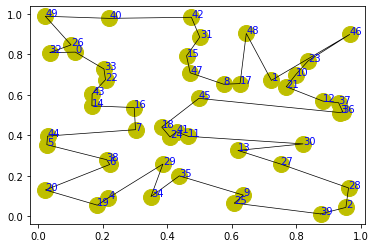

step:3260/5000, actic loss:0.647, critic loss:3.234, L:9.637, 0min2sec
step:3261/5000, actic loss:0.646, critic loss:3.233, L:9.637, 0min1sec
step:3262/5000, actic loss:0.646, critic loss:3.232, L:9.636, 0min1sec
step:3263/5000, actic loss:0.646, critic loss:3.232, L:9.635, 0min1sec
step:3264/5000, actic loss:0.645, critic loss:3.231, L:9.634, 0min1sec
distance:8.303
tensor([34, 45, 23, 19, 49, 10, 13,  8, 48, 47, 32, 42, 29,  7, 41,  1, 11,  6,
         3, 16, 27, 12, 14, 30,  2, 39, 22, 25, 35, 17, 44, 40, 26, 38,  0, 37,
        18,  9, 28, 33,  4, 15, 31, 24,  5, 36, 20, 46, 43, 21])


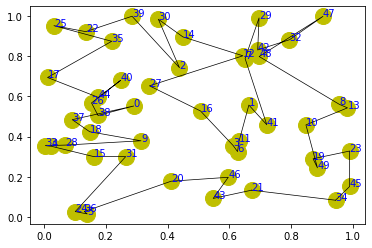

step:3265/5000, actic loss:0.645, critic loss:3.230, L:9.633, 0min2sec
step:3266/5000, actic loss:0.645, critic loss:3.229, L:9.633, 0min1sec
step:3267/5000, actic loss:0.645, critic loss:3.228, L:9.632, 0min1sec
step:3268/5000, actic loss:0.645, critic loss:3.227, L:9.631, 0min1sec
step:3269/5000, actic loss:0.645, critic loss:3.226, L:9.630, 0min1sec
distance:6.434
tensor([34, 47, 37, 11, 32, 18, 44, 24,  2, 40,  5,  8, 12, 22, 36, 28, 20, 45,
        14,  9, 13,  3, 39, 33,  6, 38, 41, 16,  7, 19, 43, 30, 48,  0, 25, 10,
        29, 46,  1,  4, 26, 15, 21, 42, 35, 17, 23, 27, 49, 31])


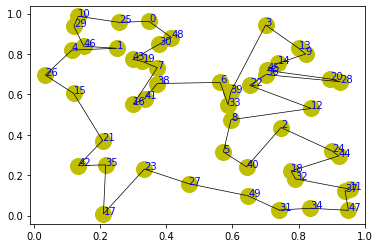

step:3270/5000, actic loss:0.644, critic loss:3.225, L:9.629, 0min2sec
step:3271/5000, actic loss:0.644, critic loss:3.224, L:9.629, 0min2sec
step:3272/5000, actic loss:0.643, critic loss:3.223, L:9.628, 0min1sec
step:3273/5000, actic loss:0.643, critic loss:3.222, L:9.627, 0min1sec
step:3274/5000, actic loss:0.643, critic loss:3.221, L:9.626, 0min1sec
distance:6.804
tensor([48, 38, 21, 29, 35, 11,  9, 36,  5, 32, 15, 42, 40, 39, 30, 12,  7, 19,
        27, 44,  4, 46, 49,  2, 20, 41, 43, 13, 37,  8, 14, 18, 10, 16, 45,  6,
        25,  0, 26, 28, 22, 34, 24, 31,  1, 47, 33,  3, 23, 17])


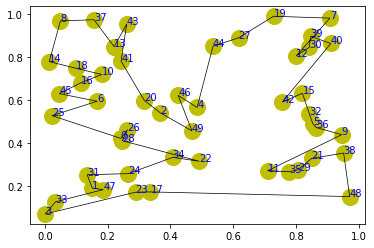

step:3275/5000, actic loss:0.643, critic loss:3.221, L:9.625, 0min2sec
step:3276/5000, actic loss:0.642, critic loss:3.220, L:9.625, 0min1sec
step:3277/5000, actic loss:0.641, critic loss:3.219, L:9.624, 0min1sec
step:3278/5000, actic loss:0.641, critic loss:3.218, L:9.623, 0min1sec
step:3279/5000, actic loss:0.640, critic loss:3.217, L:9.622, 0min1sec
distance:7.916
tensor([17, 12,  0, 27, 20, 37, 24, 18,  6, 33, 48, 46, 35, 45, 32,  3, 49, 31,
        25,  1,  8, 43, 19, 14,  2, 16, 26, 28, 42,  5, 36, 29,  9, 13, 23, 30,
         7, 47,  4, 41, 40, 11, 15, 34, 21, 39, 10, 38, 22, 44])


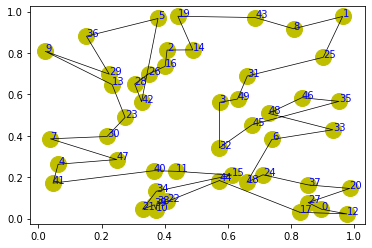

step:3280/5000, actic loss:0.640, critic loss:3.216, L:9.621, 0min2sec
step:3281/5000, actic loss:0.640, critic loss:3.215, L:9.621, 0min1sec
step:3282/5000, actic loss:0.641, critic loss:3.214, L:9.620, 0min2sec
step:3283/5000, actic loss:0.641, critic loss:3.213, L:9.619, 0min2sec
step:3284/5000, actic loss:0.640, critic loss:3.212, L:9.618, 0min1sec
distance:6.086
tensor([34, 38, 48, 16, 49, 21,  5, 44, 36, 33, 46, 28, 12,  4, 43, 39, 17, 47,
        24,  0, 29, 31, 23, 27, 14, 35, 41, 40, 42, 20, 45, 15, 13, 32,  7, 25,
        18,  9,  6,  1,  3,  2, 22, 19, 26,  8, 10, 11, 30, 37])


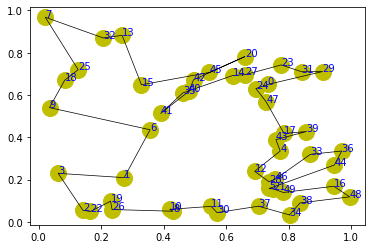

step:3285/5000, actic loss:0.640, critic loss:3.212, L:9.618, 0min2sec
step:3286/5000, actic loss:0.639, critic loss:3.211, L:9.617, 0min1sec
step:3287/5000, actic loss:0.639, critic loss:3.210, L:9.616, 0min1sec
step:3288/5000, actic loss:0.640, critic loss:3.209, L:9.615, 0min1sec
step:3289/5000, actic loss:0.640, critic loss:3.208, L:9.614, 0min1sec
distance:7.107
tensor([26, 21, 23, 12, 32, 39, 28, 15, 31,  6, 33, 29, 40, 38,  0,  7, 35,  3,
         5, 22, 37, 42, 27, 16, 41,  9, 48, 24, 43,  4, 46, 30, 13, 25, 45, 10,
        19, 20, 49, 34, 17,  1, 14, 44, 18,  8, 47, 36,  2, 11])


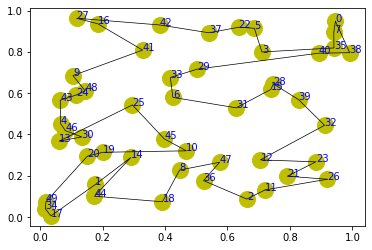

step:3290/5000, actic loss:0.639, critic loss:3.207, L:9.613, 0min2sec
step:3291/5000, actic loss:0.638, critic loss:3.206, L:9.613, 0min1sec
step:3292/5000, actic loss:0.637, critic loss:3.205, L:9.612, 0min1sec
step:3293/5000, actic loss:0.637, critic loss:3.204, L:9.611, 0min1sec
step:3294/5000, actic loss:0.637, critic loss:3.203, L:9.610, 0min1sec
distance:6.993
tensor([25, 37, 29, 46, 38,  8, 33, 31, 19,  9, 48, 27, 16, 23, 18, 22, 17, 39,
         7, 13,  3,  5,  1, 44, 24,  0, 41, 36, 11, 28, 43, 45, 14, 26, 10, 32,
         4, 20,  6, 35, 15,  2, 47, 49, 30, 34, 42, 12, 21, 40])


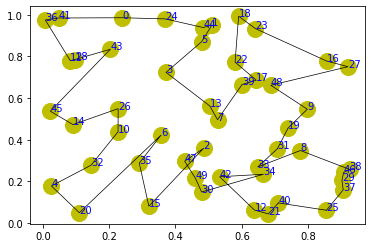

step:3295/5000, actic loss:0.637, critic loss:3.203, L:9.609, 0min2sec
step:3296/5000, actic loss:0.637, critic loss:3.202, L:9.609, 0min1sec
step:3297/5000, actic loss:0.637, critic loss:3.201, L:9.608, 0min1sec
step:3298/5000, actic loss:0.637, critic loss:3.200, L:9.607, 0min1sec
step:3299/5000, actic loss:0.636, critic loss:3.199, L:9.606, 0min1sec
distance:7.513
tensor([13, 17, 38, 24, 47, 48,  0, 40, 26,  9, 15, 28, 30, 34, 16, 43, 35, 32,
        45, 42, 12,  6, 44, 18,  5, 25, 46, 29, 39, 36, 19, 41, 49, 37, 10, 21,
         8, 31, 33,  7,  2, 20,  3,  1, 14, 11, 27, 22,  4, 23])


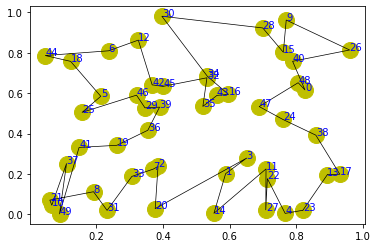

step:3300/5000, actic loss:0.636, critic loss:3.198, L:9.605, 0min2sec
step:3301/5000, actic loss:0.635, critic loss:3.197, L:9.605, 0min1sec
step:3302/5000, actic loss:0.635, critic loss:3.196, L:9.604, 0min1sec
step:3303/5000, actic loss:0.636, critic loss:3.195, L:9.603, 0min1sec
step:3304/5000, actic loss:0.636, critic loss:3.194, L:9.602, 0min2sec
distance:6.430
tensor([30, 11,  4, 18,  5, 36, 27, 34, 10,  7, 12, 23,  9, 38, 28, 29, 13, 32,
        14, 15, 22, 43, 25,  0, 35,  3, 40, 48, 37, 45,  6, 47, 41, 26, 49,  2,
        21, 20, 17, 46, 31,  8,  1, 24, 42, 16, 44, 19, 33, 39])


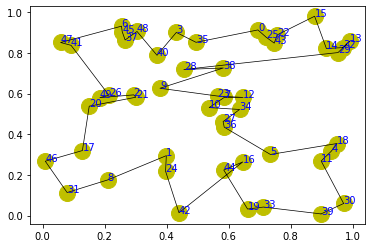

step:3305/5000, actic loss:0.636, critic loss:3.194, L:9.602, 0min2sec
step:3306/5000, actic loss:0.636, critic loss:3.193, L:9.601, 0min1sec
step:3307/5000, actic loss:0.635, critic loss:3.192, L:9.600, 0min1sec
step:3308/5000, actic loss:0.634, critic loss:3.191, L:9.599, 0min1sec
step:3309/5000, actic loss:0.632, critic loss:3.190, L:9.598, 0min1sec
distance:7.185
tensor([20, 11, 31,  1, 30, 23,  8, 32, 12, 48, 35,  9,  4, 46, 43, 49, 39,  3,
        33, 25, 18, 19, 41, 16, 28, 21,  5,  7, 26, 42, 29, 10, 22, 14, 15,  6,
        37, 38, 24, 45, 47,  0, 34, 27, 40,  2, 13, 36, 17, 44])


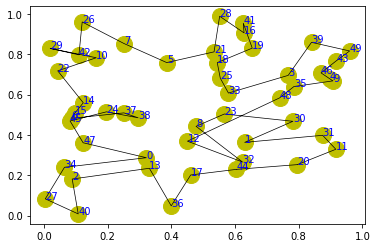

step:3310/5000, actic loss:0.631, critic loss:3.189, L:9.598, 0min1sec
step:3311/5000, actic loss:0.630, critic loss:3.188, L:9.597, 0min1sec
step:3312/5000, actic loss:0.630, critic loss:3.187, L:9.596, 0min1sec
step:3313/5000, actic loss:0.630, critic loss:3.187, L:9.595, 0min1sec
step:3314/5000, actic loss:0.631, critic loss:3.186, L:9.594, 0min2sec
distance:7.104
tensor([23, 24, 44, 34, 49,  6, 27, 26, 38, 16, 40, 30, 14, 36, 37, 13, 22,  5,
        48, 19, 11, 41, 29, 31,  2, 10, 20,  0, 12, 17, 25, 42,  1, 43, 15, 33,
        21, 35, 32,  4, 28, 39, 47,  7,  3, 45, 46,  9, 18,  8])


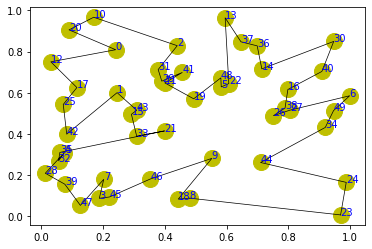

step:3315/5000, actic loss:0.632, critic loss:3.185, L:9.593, 0min2sec
step:3316/5000, actic loss:0.633, critic loss:3.184, L:9.593, 0min1sec
step:3317/5000, actic loss:0.633, critic loss:3.183, L:9.592, 0min1sec
step:3318/5000, actic loss:0.633, critic loss:3.182, L:9.591, 0min1sec
step:3319/5000, actic loss:0.632, critic loss:3.181, L:9.590, 0min1sec
distance:6.916
tensor([25, 36, 28,  1, 19, 46,  9,  0, 26, 47,  3, 42,  4, 18, 13, 40, 44,  5,
        39,  2, 29, 16, 17, 35, 23, 38, 27, 37, 20,  8,  6, 45, 32, 33, 49, 48,
        11, 43, 41,  7, 34, 24, 10, 31, 22, 21, 15, 12, 30, 14])


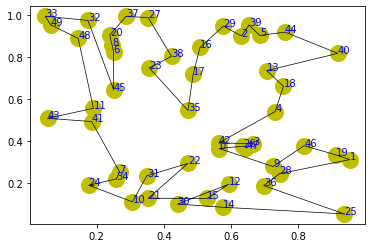

step:3320/5000, actic loss:0.631, critic loss:3.181, L:9.590, 0min2sec
step:3321/5000, actic loss:0.630, critic loss:3.180, L:9.589, 0min1sec
step:3322/5000, actic loss:0.630, critic loss:3.179, L:9.588, 0min1sec
step:3323/5000, actic loss:0.629, critic loss:3.178, L:9.587, 0min1sec
step:3324/5000, actic loss:0.629, critic loss:3.177, L:9.587, 0min1sec
distance:5.998
tensor([36, 17, 38, 29, 40, 46, 25,  0, 41, 39,  6,  3, 13,  2, 26, 30, 22, 45,
         4,  7, 32, 15, 33, 18, 47,  5, 49, 11,  9, 27, 34, 21, 35, 16, 19, 42,
        10, 14, 24,  8, 31, 20, 12, 43,  1, 28, 48, 37, 44, 23])


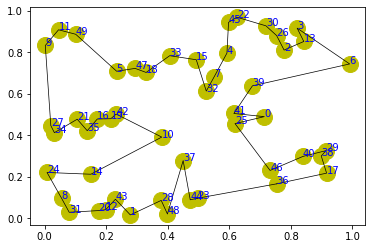

step:3325/5000, actic loss:0.630, critic loss:3.176, L:9.586, 0min2sec
step:3326/5000, actic loss:0.630, critic loss:3.175, L:9.585, 0min2sec
step:3327/5000, actic loss:0.630, critic loss:3.175, L:9.584, 0min1sec
step:3328/5000, actic loss:0.630, critic loss:3.174, L:9.584, 0min1sec
step:3329/5000, actic loss:0.629, critic loss:3.173, L:9.583, 0min1sec
distance:7.746
tensor([46, 29,  0, 14, 27, 15,  5, 38, 47, 42, 32, 24,  6, 49, 48, 10, 21, 43,
        18,  3, 11,  4, 25,  7,  1, 22, 19, 23, 44, 33, 26, 37, 31, 12, 40, 16,
        28, 17, 34,  8, 39, 30,  2, 13, 45,  9, 36, 41, 20, 35])


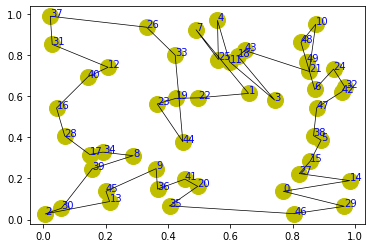

step:3330/5000, actic loss:0.629, critic loss:3.172, L:9.582, 0min2sec
step:3331/5000, actic loss:0.629, critic loss:3.171, L:9.582, 0min1sec
step:3332/5000, actic loss:0.629, critic loss:3.170, L:9.581, 0min1sec
step:3333/5000, actic loss:0.628, critic loss:3.169, L:9.580, 0min1sec
step:3334/5000, actic loss:0.628, critic loss:3.169, L:9.580, 0min1sec
distance:7.997
tensor([31, 42, 49, 19,  6, 21, 36, 37, 29, 41, 17,  8, 25,  7, 33, 27, 45, 23,
        47,  9, 18, 15, 30, 40,  0, 26, 43, 22, 16,  3, 28,  5, 32, 14,  1, 35,
        13, 34,  2, 11, 12, 39, 48,  4, 10, 38, 24, 46, 20, 44])


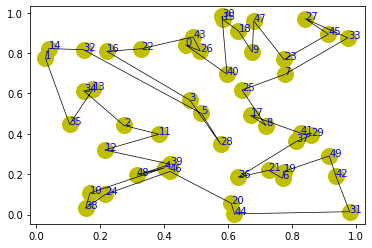

step:3335/5000, actic loss:0.628, critic loss:3.168, L:9.579, 0min2sec
step:3336/5000, actic loss:0.628, critic loss:3.167, L:9.578, 0min1sec
step:3337/5000, actic loss:0.628, critic loss:3.166, L:9.578, 0min1sec
step:3338/5000, actic loss:0.627, critic loss:3.165, L:9.577, 0min2sec
step:3339/5000, actic loss:0.628, critic loss:3.164, L:9.576, 0min2sec
distance:7.692
tensor([45, 47, 11, 26, 20, 14, 40,  5, 16, 15, 21, 24, 39, 17, 44, 42, 25, 38,
        43, 13, 34, 33, 46,  9, 48, 49, 19, 29, 30,  1,  8,  4,  2, 23, 28,  0,
        36, 35, 18, 31, 32, 41,  3, 37, 27, 12, 10, 22,  6,  7])


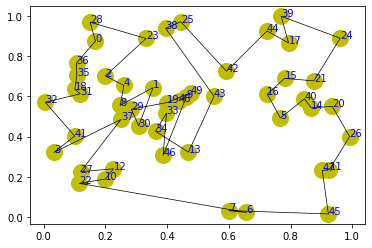

step:3340/5000, actic loss:0.627, critic loss:3.163, L:9.576, 0min2sec
step:3341/5000, actic loss:0.627, critic loss:3.163, L:9.575, 0min1sec
step:3342/5000, actic loss:0.626, critic loss:3.162, L:9.574, 0min1sec
step:3343/5000, actic loss:0.626, critic loss:3.161, L:9.574, 0min1sec
step:3344/5000, actic loss:0.625, critic loss:3.160, L:9.573, 0min1sec
distance:6.914
tensor([38, 43,  5, 23,  6,  3, 47, 14,  0, 22, 18, 46, 10, 17, 41,  8, 26,  9,
        35, 48, 44, 39, 33, 42, 24, 12, 21, 49, 28, 27,  7, 37, 16, 31,  2, 36,
         4, 11, 30, 45, 34, 19, 20, 40, 29, 32, 13, 15,  1, 25])


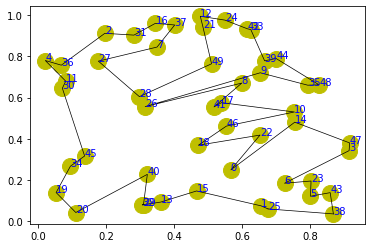

step:3345/5000, actic loss:0.625, critic loss:3.159, L:9.572, 0min2sec
step:3346/5000, actic loss:0.625, critic loss:3.158, L:9.572, 0min1sec
step:3347/5000, actic loss:0.625, critic loss:3.157, L:9.571, 0min1sec
step:3348/5000, actic loss:0.625, critic loss:3.157, L:9.570, 0min2sec
step:3349/5000, actic loss:0.625, critic loss:3.156, L:9.569, 0min2sec
distance:7.840
tensor([ 1, 26, 35, 39, 16, 43, 38, 42,  8, 15, 14,  9, 10, 40, 24, 33,  4, 47,
        48, 22, 45, 18,  0, 37, 44, 46, 25,  2, 19,  3, 12, 20, 17, 21, 11, 27,
        28,  7, 49, 23,  6, 29, 30, 31,  5, 32, 13, 36, 34, 41])


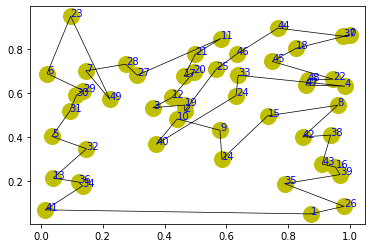

step:3350/5000, actic loss:0.624, critic loss:3.155, L:9.569, 0min2sec
step:3351/5000, actic loss:0.623, critic loss:3.154, L:9.568, 0min1sec
step:3352/5000, actic loss:0.623, critic loss:3.153, L:9.567, 0min1sec
step:3353/5000, actic loss:0.623, critic loss:3.152, L:9.567, 0min1sec
step:3354/5000, actic loss:0.623, critic loss:3.151, L:9.566, 0min1sec
distance:6.956
tensor([38, 19,  3, 11, 25,  2, 39, 22, 26, 13, 36, 17,  1, 28, 32, 34, 41, 29,
         0, 40, 24, 45, 15,  7, 33, 14, 30,  9, 47,  8, 21,  5, 48, 43, 27, 10,
        49, 18, 46,  6, 37, 31, 35, 20, 44, 12,  4, 42, 23, 16])


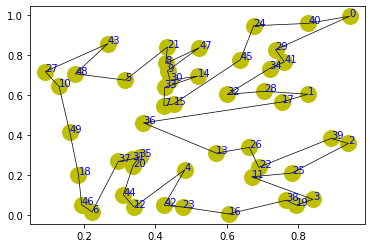

step:3355/5000, actic loss:0.623, critic loss:3.150, L:9.565, 0min2sec
step:3356/5000, actic loss:0.622, critic loss:3.150, L:9.564, 0min1sec
step:3357/5000, actic loss:0.621, critic loss:3.149, L:9.564, 0min1sec
step:3358/5000, actic loss:0.620, critic loss:3.148, L:9.563, 0min1sec
step:3359/5000, actic loss:0.620, critic loss:3.147, L:9.562, 0min1sec
distance:7.365
tensor([45,  3, 19, 43, 41,  6, 18, 23, 11, 42, 27, 24, 26, 14, 35, 10, 16,  0,
        15, 21, 34,  1, 47,  8, 17,  4, 31, 33, 28, 20, 49, 39, 48, 44, 46, 38,
        30, 32, 36, 13,  9,  2, 29, 25, 22,  7, 37, 12,  5, 40])


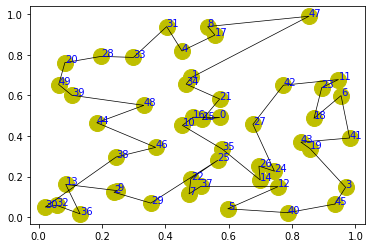

step:3360/5000, actic loss:0.620, critic loss:3.146, L:9.561, 0min2sec
step:3361/5000, actic loss:0.620, critic loss:3.145, L:9.561, 0min2sec
step:3362/5000, actic loss:0.620, critic loss:3.145, L:9.560, 0min2sec
step:3363/5000, actic loss:0.621, critic loss:3.144, L:9.559, 0min1sec
step:3364/5000, actic loss:0.620, critic loss:3.143, L:9.558, 0min1sec
distance:7.170
tensor([43, 12, 21,  2, 27, 48,  5,  4, 23, 45, 14,  9, 39, 41, 38, 37, 28, 49,
        17, 19,  3, 16, 22, 18, 20,  7, 11, 36, 47,  0, 24, 10, 33, 30, 35, 32,
        13,  8, 15, 42, 29, 40,  6, 44,  1, 34, 46, 25, 31, 26])


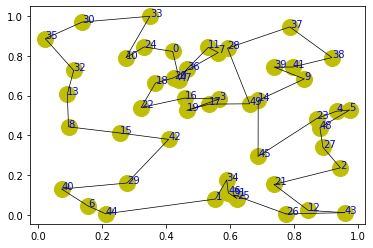

step:3365/5000, actic loss:0.620, critic loss:3.142, L:9.558, 0min2sec
step:3366/5000, actic loss:0.620, critic loss:3.141, L:9.557, 0min1sec
step:3367/5000, actic loss:0.619, critic loss:3.140, L:9.556, 0min1sec
step:3368/5000, actic loss:0.619, critic loss:3.139, L:9.556, 0min1sec
step:3369/5000, actic loss:0.619, critic loss:3.139, L:9.555, 0min1sec
distance:7.141
tensor([ 1, 39, 48,  2, 30, 34, 11, 16, 29, 13, 46, 43, 25, 31, 37, 32,  4, 47,
        22, 36, 19,  8, 21,  3, 33, 12,  6, 24, 40, 14, 45, 41,  0, 10, 42, 20,
        18, 23, 28, 49,  5, 26, 15, 17, 35,  9, 44, 38,  7, 27])


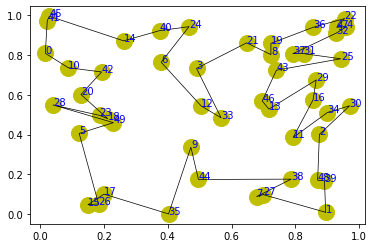

step:3370/5000, actic loss:0.618, critic loss:3.138, L:9.554, 0min2sec
step:3371/5000, actic loss:0.618, critic loss:3.137, L:9.553, 0min2sec
step:3372/5000, actic loss:0.618, critic loss:3.136, L:9.553, 0min2sec
step:3373/5000, actic loss:0.618, critic loss:3.135, L:9.552, 0min1sec
step:3374/5000, actic loss:0.619, critic loss:3.134, L:9.551, 0min1sec
distance:6.675
tensor([16, 11,  9, 14, 18, 27, 40, 31,  3,  0, 38, 10,  6, 43, 26, 33, 34, 25,
         7, 20, 39, 21, 37, 42, 23, 24, 29, 41, 13,  2, 36, 12, 48,  8, 32, 15,
        28,  4, 45, 44, 46, 47,  5, 30, 19, 35, 22, 49, 17,  1])


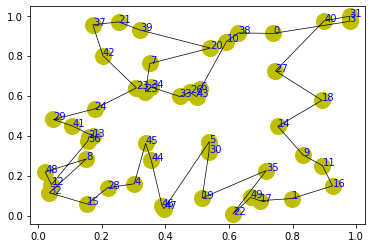

step:3375/5000, actic loss:0.619, critic loss:3.133, L:9.550, 0min2sec
step:3376/5000, actic loss:0.618, critic loss:3.133, L:9.550, 0min1sec
step:3377/5000, actic loss:0.618, critic loss:3.132, L:9.549, 0min1sec
step:3378/5000, actic loss:0.617, critic loss:3.131, L:9.548, 0min1sec
step:3379/5000, actic loss:0.617, critic loss:3.130, L:9.547, 0min1sec
distance:6.608
tensor([12, 11,  3, 21, 30, 19, 43, 49, 44, 10,  9, 35, 27,  6,  5, 47, 29, 24,
         8, 31, 16, 40, 15, 14,  4, 38, 48, 22, 45,  1, 20, 17, 42, 23,  7, 46,
        25, 37, 32,  0, 41, 26, 39, 18, 36, 34, 28, 13, 33,  2])


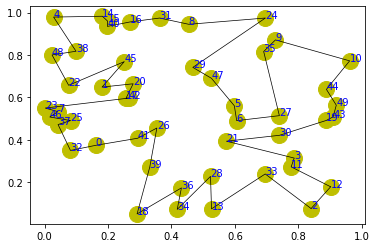

step:3380/5000, actic loss:0.617, critic loss:3.129, L:9.547, 0min2sec
step:3381/5000, actic loss:0.617, critic loss:3.128, L:9.546, 0min1sec
step:3382/5000, actic loss:0.618, critic loss:3.127, L:9.545, 0min1sec
step:3383/5000, actic loss:0.618, critic loss:3.127, L:9.544, 0min1sec
step:3384/5000, actic loss:0.617, critic loss:3.126, L:9.544, 0min1sec
distance:6.518
tensor([39, 11, 31,  8, 33, 44, 19, 25, 23, 38, 24, 46, 47, 20, 45,  7, 12, 48,
        14, 36,  9,  5, 22, 42, 21, 10,  3, 16, 26, 13, 30, 29, 37,  6, 41, 34,
         1, 28, 18, 17,  0, 43, 35, 40,  2, 27, 15, 49,  4, 32])


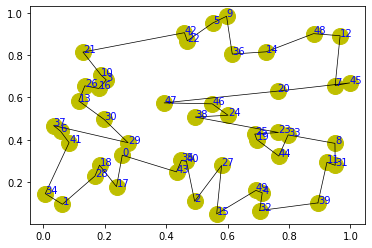

step:3385/5000, actic loss:0.616, critic loss:3.125, L:9.543, 0min2sec
step:3386/5000, actic loss:0.616, critic loss:3.124, L:9.542, 0min2sec
step:3387/5000, actic loss:0.615, critic loss:3.123, L:9.541, 0min2sec
step:3388/5000, actic loss:0.615, critic loss:3.122, L:9.541, 0min2sec
step:3389/5000, actic loss:0.615, critic loss:3.122, L:9.540, 0min1sec
distance:7.044
tensor([42, 27, 25, 10,  6, 26, 13, 43, 34, 23, 38, 18,  4, 48,  7, 45, 37,  1,
        47, 41, 46,  3, 16, 33, 22,  2, 30, 31, 49, 12, 36, 19,  9,  8, 28, 21,
        44,  0, 35, 32, 29, 11, 39, 20, 40,  5, 24, 15, 17, 14])


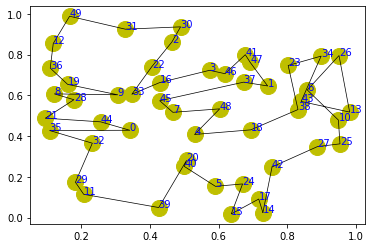

step:3390/5000, actic loss:0.615, critic loss:3.121, L:9.539, 0min2sec
step:3391/5000, actic loss:0.614, critic loss:3.120, L:9.538, 0min1sec
step:3392/5000, actic loss:0.614, critic loss:3.119, L:9.538, 0min1sec
step:3393/5000, actic loss:0.613, critic loss:3.118, L:9.537, 0min1sec
step:3394/5000, actic loss:0.613, critic loss:3.117, L:9.536, 0min1sec
distance:7.353
tensor([16, 21, 26, 13, 35, 34, 28, 10, 48, 49, 14, 17, 41, 19, 38, 22, 45,  9,
        18,  1, 36,  0, 12, 25,  4, 23, 47,  2, 32, 20,  8,  5, 24, 37, 33,  6,
        30,  3, 11, 39, 43, 44, 46, 15, 40,  7, 42, 29, 27, 31])


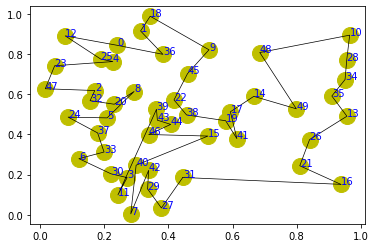

step:3395/5000, actic loss:0.614, critic loss:3.117, L:9.536, 0min2sec
step:3396/5000, actic loss:0.614, critic loss:3.116, L:9.535, 0min1sec
step:3397/5000, actic loss:0.614, critic loss:3.115, L:9.534, 0min1sec
step:3398/5000, actic loss:0.613, critic loss:3.114, L:9.533, 0min1sec
step:3399/5000, actic loss:0.613, critic loss:3.113, L:9.533, 0min1sec
distance:7.125
tensor([ 3,  9,  8, 28, 17, 33, 16, 46,  7, 27, 43, 12,  6, 21, 37, 14, 25, 49,
        15,  4, 26, 29,  2, 18, 48,  1, 47, 41, 39, 40, 13, 42,  5, 32, 23, 31,
        34, 20, 19, 22, 10, 24, 35, 11, 30, 45, 38, 36, 44,  0])


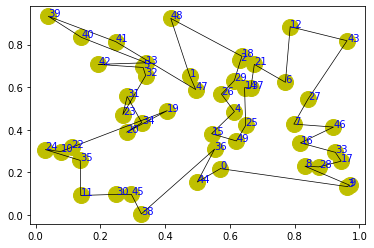

step:3400/5000, actic loss:0.612, critic loss:3.112, L:9.532, 0min2sec
step:3401/5000, actic loss:0.612, critic loss:3.112, L:9.531, 0min2sec
step:3402/5000, actic loss:0.612, critic loss:3.111, L:9.531, 0min2sec
step:3403/5000, actic loss:0.612, critic loss:3.110, L:9.530, 0min1sec
step:3404/5000, actic loss:0.612, critic loss:3.109, L:9.529, 0min1sec
distance:6.802
tensor([20, 28, 39, 13, 37,  6, 41,  0, 35, 49, 10, 12, 18, 43,  7, 26, 21, 17,
        34, 30, 27, 40, 44, 29,  1,  4,  5, 47, 16,  8, 24, 38, 46, 32, 19, 25,
        36, 23,  9, 22, 15, 42, 48,  3, 33,  2, 14, 31, 11, 45])


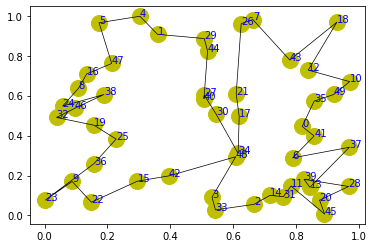

step:3405/5000, actic loss:0.611, critic loss:3.108, L:9.529, 0min2sec
step:3406/5000, actic loss:0.611, critic loss:3.107, L:9.528, 0min1sec
step:3407/5000, actic loss:0.611, critic loss:3.107, L:9.527, 0min1sec
step:3408/5000, actic loss:0.610, critic loss:3.106, L:9.526, 0min1sec
step:3409/5000, actic loss:0.610, critic loss:3.105, L:9.526, 0min1sec
distance:7.296
tensor([47, 36, 44, 37, 19, 39,  1, 25, 38, 16, 49, 41, 40, 14, 13, 31, 26,  7,
        24, 12, 18, 43, 11, 45, 34, 21, 15, 46, 42, 28,  3, 27,  4, 30, 29, 32,
        35, 10, 48,  5,  6, 22,  9, 23, 33, 17,  0,  2,  8, 20])


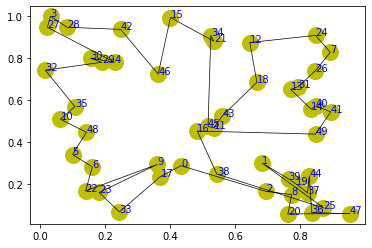

step:3410/5000, actic loss:0.610, critic loss:3.104, L:9.525, 0min2sec
step:3411/5000, actic loss:0.610, critic loss:3.103, L:9.524, 0min2sec
step:3412/5000, actic loss:0.609, critic loss:3.102, L:9.523, 0min2sec
step:3413/5000, actic loss:0.609, critic loss:3.102, L:9.523, 0min2sec
step:3414/5000, actic loss:0.608, critic loss:3.101, L:9.522, 0min1sec
distance:7.257
tensor([36, 48,  2, 47,  3,  1,  9, 23, 45, 31, 15, 40, 25, 35, 28,  5, 27, 20,
        11,  4, 39, 10, 38, 42,  6, 19, 29,  7, 44, 24, 34, 13, 37,  0, 12, 18,
        49, 14, 33, 21, 46, 41, 17, 30, 43, 32, 16,  8, 22, 26])


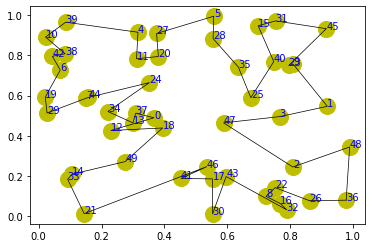

step:3415/5000, actic loss:0.608, critic loss:3.100, L:9.521, 0min2sec
step:3416/5000, actic loss:0.608, critic loss:3.099, L:9.520, 0min1sec
step:3417/5000, actic loss:0.608, critic loss:3.098, L:9.520, 0min1sec
step:3418/5000, actic loss:0.608, critic loss:3.097, L:9.519, 0min1sec
step:3419/5000, actic loss:0.607, critic loss:3.097, L:9.518, 0min1sec
distance:7.681
tensor([ 8,  9, 18,  3, 26, 34, 19, 46, 42, 28, 41, 14, 12, 44, 21, 27, 36, 10,
         4, 35, 37, 25, 11, 17, 24, 33, 49, 31, 29, 39,  1, 15, 16,  0, 47,  7,
        30, 32, 40, 48,  2, 13, 43, 23, 45,  6, 22, 20,  5, 38])


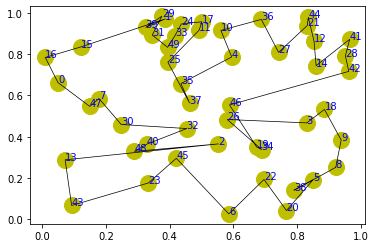

step:3420/5000, actic loss:0.607, critic loss:3.096, L:9.518, 0min2sec
step:3421/5000, actic loss:0.606, critic loss:3.095, L:9.517, 0min1sec
step:3422/5000, actic loss:0.605, critic loss:3.094, L:9.516, 0min2sec
step:3423/5000, actic loss:0.605, critic loss:3.093, L:9.516, 0min2sec
step:3424/5000, actic loss:0.605, critic loss:3.093, L:9.515, 0min1sec
distance:7.180
tensor([37, 10, 30, 33, 22, 16, 41, 28, 46, 35, 44, 24, 23, 27, 11, 19,  2,  7,
        32, 34, 42, 43,  5, 36, 12,  0, 25, 15,  6, 26, 45, 18,  8, 29, 14, 21,
        49, 39, 38, 47,  1,  9, 13, 20, 31, 17,  4, 48, 40,  3])


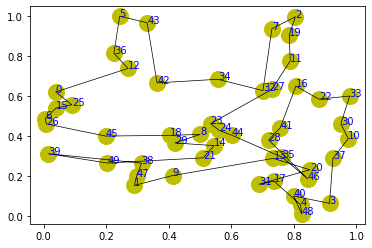

step:3425/5000, actic loss:0.606, critic loss:3.092, L:9.515, 0min2sec
step:3426/5000, actic loss:0.606, critic loss:3.091, L:9.514, 0min1sec
step:3427/5000, actic loss:0.606, critic loss:3.090, L:9.513, 0min1sec
step:3428/5000, actic loss:0.605, critic loss:3.089, L:9.513, 0min1sec
step:3429/5000, actic loss:0.604, critic loss:3.089, L:9.512, 0min1sec
distance:8.799
tensor([47,  9, 15, 48, 49, 33, 27, 40, 31, 42,  6, 44, 20, 32, 23, 39, 30,  4,
        29, 34, 26, 45, 28, 37, 17, 46,  1, 11, 24, 41, 14, 13, 18,  5, 36, 22,
        12, 16,  3,  7, 10, 38,  8, 35, 21, 43, 25,  0, 19,  2])


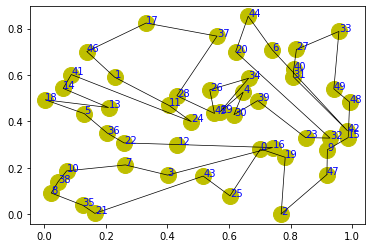

step:3430/5000, actic loss:0.604, critic loss:3.088, L:9.512, 0min2sec
step:3431/5000, actic loss:0.603, critic loss:3.087, L:9.511, 0min1sec
step:3432/5000, actic loss:0.603, critic loss:3.086, L:9.510, 0min2sec
step:3433/5000, actic loss:0.604, critic loss:3.085, L:9.510, 0min2sec
step:3434/5000, actic loss:0.604, critic loss:3.085, L:9.509, 0min2sec
distance:7.085
tensor([40,  2, 43, 16, 42, 12, 24, 48, 19, 47, 39, 44, 26, 31, 28, 30, 11, 29,
         6, 46, 41, 33, 34, 25,  7,  3, 17, 15,  0,  8,  9, 14, 20,  5, 27, 23,
        45, 38,  1, 18, 32, 21,  4, 13, 10, 49, 22, 36, 37, 35])


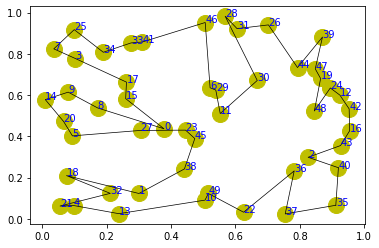

step:3435/5000, actic loss:0.604, critic loss:3.084, L:9.509, 0min2sec
step:3436/5000, actic loss:0.604, critic loss:3.083, L:9.508, 0min1sec
step:3437/5000, actic loss:0.604, critic loss:3.082, L:9.507, 0min1sec
step:3438/5000, actic loss:0.603, critic loss:3.081, L:9.507, 0min1sec
step:3439/5000, actic loss:0.602, critic loss:3.081, L:9.506, 0min1sec
distance:6.313
tensor([39, 29, 16, 28, 25, 20, 14, 47,  5, 18, 34, 15,  6, 30, 24, 11, 36, 32,
        10,  0, 41, 22, 42, 37,  1,  3,  9, 17, 12, 21, 49,  4, 43, 45,  8, 40,
         7, 33, 48, 46, 35, 13,  2, 26, 38, 31, 23, 19, 27, 44])


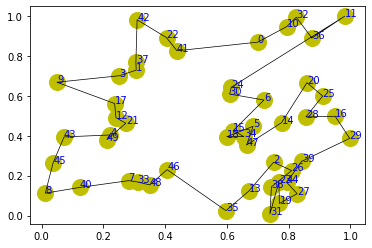

step:3440/5000, actic loss:0.601, critic loss:3.080, L:9.505, 0min2sec
step:3441/5000, actic loss:0.601, critic loss:3.079, L:9.505, 0min1sec
step:3442/5000, actic loss:0.601, critic loss:3.078, L:9.504, 0min2sec
step:3443/5000, actic loss:0.601, critic loss:3.077, L:9.503, 0min2sec
step:3444/5000, actic loss:0.601, critic loss:3.077, L:9.503, 0min1sec
distance:6.800
tensor([ 0, 19, 21, 36, 15, 49, 13, 33, 42, 45, 11,  4,  1, 12,  7, 47, 35, 14,
        34, 18, 20, 28,  6, 39, 37,  2, 40, 23,  8, 24, 41, 43,  5, 32, 22, 31,
        10, 30, 27, 38, 16, 29,  3,  9, 46, 44, 17, 25, 48, 26])


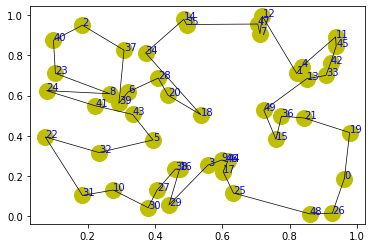

step:3445/5000, actic loss:0.601, critic loss:3.076, L:9.502, 0min2sec
step:3446/5000, actic loss:0.601, critic loss:3.075, L:9.502, 0min1sec
step:3447/5000, actic loss:0.601, critic loss:3.074, L:9.501, 0min1sec
step:3448/5000, actic loss:0.600, critic loss:3.073, L:9.500, 0min1sec
step:3449/5000, actic loss:0.600, critic loss:3.073, L:9.500, 0min1sec
distance:6.949
tensor([25, 29,  2, 42,  6, 37, 21,  8, 19, 12, 10, 11, 27,  9, 40, 45, 43, 46,
        15, 44, 16, 28, 30, 20, 22,  0, 26, 39,  1, 32, 48, 35, 14, 49,  7,  4,
        24, 36, 33, 17,  5,  3, 38, 31, 23, 13, 41, 34, 47, 18])


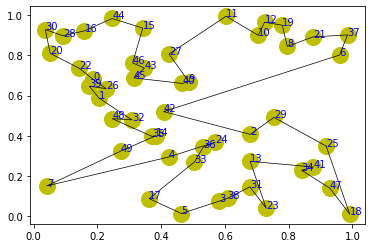

step:3450/5000, actic loss:0.600, critic loss:3.072, L:9.499, 0min2sec
step:3451/5000, actic loss:0.600, critic loss:3.071, L:9.498, 0min1sec
step:3452/5000, actic loss:0.599, critic loss:3.070, L:9.498, 0min1sec
step:3453/5000, actic loss:0.599, critic loss:3.069, L:9.497, 0min2sec
step:3454/5000, actic loss:0.599, critic loss:3.069, L:9.496, 0min2sec
distance:6.781
tensor([26, 20, 12, 49, 18, 29, 14, 24, 17, 32, 44, 34, 30, 41,  1, 38,  3, 33,
         9, 10, 11, 15, 48, 31,  0, 45, 39,  6, 25, 23, 13, 28, 16, 21, 27, 40,
        46,  5,  2, 43, 36, 19,  8, 22,  4, 35, 37, 42, 47,  7])


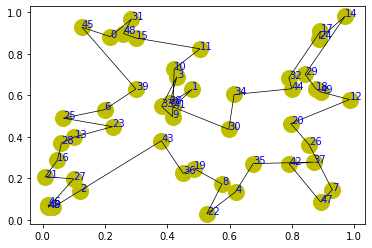

step:3455/5000, actic loss:0.599, critic loss:3.068, L:9.496, 0min2sec
step:3456/5000, actic loss:0.599, critic loss:3.067, L:9.495, 0min1sec
step:3457/5000, actic loss:0.598, critic loss:3.066, L:9.494, 0min1sec
step:3458/5000, actic loss:0.598, critic loss:3.065, L:9.494, 0min1sec
step:3459/5000, actic loss:0.598, critic loss:3.064, L:9.493, 0min1sec
distance:7.571
tensor([14, 18, 22, 42, 28, 34,  0, 32, 27, 17, 35, 39, 49, 29, 31, 16, 24,  5,
         6, 12,  8,  1, 13, 40, 15, 19, 23, 36, 43, 26, 48, 10, 38,  4, 47,  2,
        46,  3, 30,  7, 11, 45, 33, 37, 25, 20,  9, 44, 21, 41])


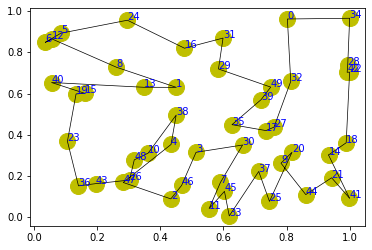

step:3460/5000, actic loss:0.598, critic loss:3.064, L:9.492, 0min2sec
step:3461/5000, actic loss:0.598, critic loss:3.063, L:9.491, 0min1sec
step:3462/5000, actic loss:0.598, critic loss:3.062, L:9.491, 0min1sec
step:3463/5000, actic loss:0.597, critic loss:3.061, L:9.490, 0min1sec
step:3464/5000, actic loss:0.596, critic loss:3.060, L:9.489, 0min2sec
distance:7.466
tensor([ 0, 25, 31, 12, 20, 40,  4, 30, 33, 19,  1, 21, 10, 24, 22, 39, 23, 11,
        43,  6, 16, 27, 38, 26, 46, 36,  3, 49, 47, 37, 18,  8,  5, 29, 41, 17,
         9, 28, 48,  7, 35, 13, 42,  2, 44, 45, 15, 32, 14, 34])


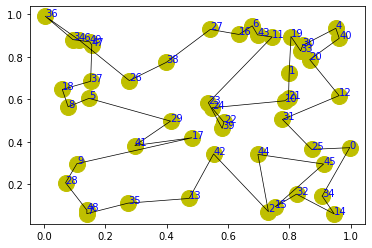

step:3465/5000, actic loss:0.595, critic loss:3.060, L:9.489, 0min2sec
step:3466/5000, actic loss:0.595, critic loss:3.059, L:9.488, 0min2sec
step:3467/5000, actic loss:0.595, critic loss:3.058, L:9.488, 0min1sec
step:3468/5000, actic loss:0.595, critic loss:3.057, L:9.487, 0min1sec
step:3469/5000, actic loss:0.595, critic loss:3.056, L:9.486, 0min1sec
distance:7.322
tensor([43, 33, 25, 46,  8, 34, 40, 48, 44,  3, 45,  6, 32, 30, 49, 11, 22,  5,
        12, 27, 47, 26, 17,  7, 36,  1, 21, 16, 42, 13, 20, 19, 29, 15,  2, 10,
        24, 23, 41, 31,  4, 39, 38, 28, 35,  9, 14, 37,  0, 18])


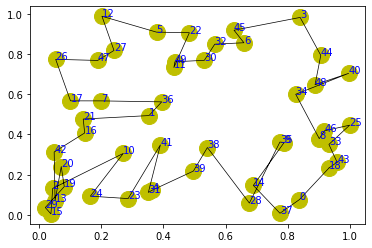

step:3470/5000, actic loss:0.594, critic loss:3.056, L:9.486, 0min2sec
step:3471/5000, actic loss:0.594, critic loss:3.055, L:9.485, 0min1sec
step:3472/5000, actic loss:0.593, critic loss:3.054, L:9.484, 0min1sec
step:3473/5000, actic loss:0.594, critic loss:3.053, L:9.484, 0min1sec
step:3474/5000, actic loss:0.594, critic loss:3.052, L:9.483, 0min1sec
distance:7.387
tensor([11, 40, 21, 18, 33, 25,  8, 45, 24, 22,  9,  4, 43, 39, 20, 26, 36, 23,
         6, 42, 14, 30,  5,  2, 12, 32, 46, 15, 44, 16, 34,  0, 38, 47,  7, 29,
        48, 28, 27, 35, 19,  1, 17, 13, 10, 49, 37, 41, 31,  3])


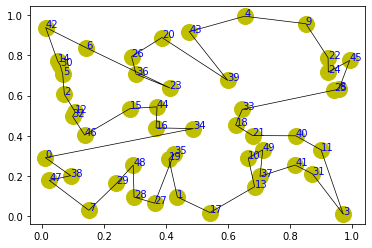

step:3475/5000, actic loss:0.594, critic loss:3.052, L:9.482, 0min2sec
step:3476/5000, actic loss:0.595, critic loss:3.051, L:9.481, 0min1sec
step:3477/5000, actic loss:0.595, critic loss:3.050, L:9.481, 0min1sec
step:3478/5000, actic loss:0.594, critic loss:3.049, L:9.480, 0min2sec
step:3479/5000, actic loss:0.593, critic loss:3.049, L:9.479, 0min2sec
distance:6.962
tensor([18, 24, 25,  5, 15, 43, 28, 39, 26, 19, 36, 22, 20,  9, 38, 13, 40, 29,
        48,  7,  2, 31, 17, 37,  8, 32, 34, 46,  6,  4, 41, 21, 16, 35, 14,  0,
        30, 12, 45, 49, 44, 27,  3, 23,  1, 11, 10, 47, 42, 33])


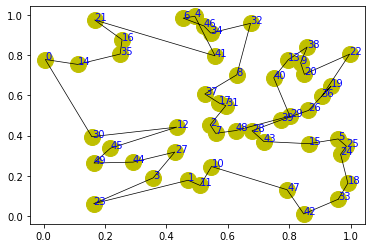

step:3480/5000, actic loss:0.592, critic loss:3.048, L:9.479, 0min2sec
step:3481/5000, actic loss:0.591, critic loss:3.047, L:9.478, 0min1sec
step:3482/5000, actic loss:0.591, critic loss:3.046, L:9.477, 0min1sec
step:3483/5000, actic loss:0.591, critic loss:3.045, L:9.476, 0min1sec
step:3484/5000, actic loss:0.591, critic loss:3.045, L:9.476, 0min1sec
distance:7.169
tensor([ 1, 27, 16, 15,  3, 34, 49, 46,  0, 42, 44, 22, 26, 12, 43, 19, 36,  5,
        13, 17,  9, 14, 33, 37, 47, 21, 24,  4, 20, 28, 10, 45, 29, 31, 38, 39,
        35, 48, 23, 30, 40, 41, 32, 18,  8, 11,  2, 25,  7,  6])


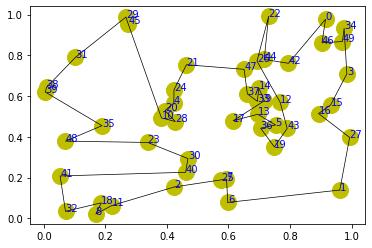

step:3485/5000, actic loss:0.591, critic loss:3.044, L:9.475, 0min2sec
step:3486/5000, actic loss:0.591, critic loss:3.043, L:9.474, 0min1sec
step:3487/5000, actic loss:0.591, critic loss:3.042, L:9.473, 0min1sec
step:3488/5000, actic loss:0.590, critic loss:3.041, L:9.473, 0min1sec
step:3489/5000, actic loss:0.590, critic loss:3.041, L:9.472, 0min2sec
distance:6.941
tensor([33,  0, 12, 32,  4, 39, 11, 31,  6, 18, 44, 40, 41, 34, 30, 48, 46, 36,
        27,  5, 24, 37, 16, 14,  8,  3,  1, 22, 13, 23, 15, 35,  7, 21, 17, 49,
        43, 29,  2, 26, 19, 20, 28, 47, 25, 45, 10, 38, 42,  9])


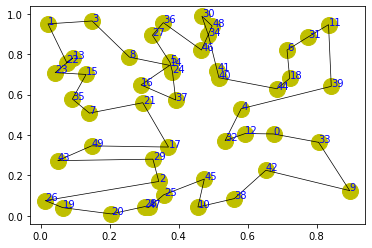

step:3490/5000, actic loss:0.590, critic loss:3.040, L:9.471, 0min2sec
step:3491/5000, actic loss:0.590, critic loss:3.039, L:9.471, 0min2sec
step:3492/5000, actic loss:0.590, critic loss:3.038, L:9.470, 0min1sec
step:3493/5000, actic loss:0.589, critic loss:3.037, L:9.469, 0min1sec
step:3494/5000, actic loss:0.589, critic loss:3.037, L:9.469, 0min1sec
distance:7.494
tensor([28, 40,  8,  2, 23, 15, 46, 36, 31, 33, 32, 17, 13, 45, 29, 20, 25, 12,
         5, 16,  7, 14,  4, 43, 10, 19, 48, 38,  1, 21, 30, 26, 37, 22, 35, 18,
         9,  0, 44, 42,  3,  6, 39, 41, 27, 11, 47, 24, 49, 34])


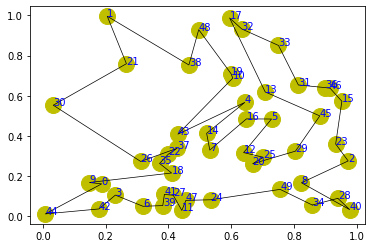

step:3495/5000, actic loss:0.589, critic loss:3.036, L:9.468, 0min1sec
step:3496/5000, actic loss:0.589, critic loss:3.035, L:9.467, 0min1sec
step:3497/5000, actic loss:0.589, critic loss:3.034, L:9.466, 0min1sec
step:3498/5000, actic loss:0.588, critic loss:3.033, L:9.466, 0min1sec
step:3499/5000, actic loss:0.588, critic loss:3.032, L:9.465, 0min1sec
distance:7.300
tensor([46, 41, 40,  9,  6, 15, 26, 29, 34, 18, 12, 45, 22,  4, 42,  0, 14, 30,
        24,  3, 25, 13, 17, 27, 37, 39,  7,  2, 48, 11, 33, 16, 35, 38, 49,  5,
        47, 28, 20, 31, 43, 36, 32,  8, 23, 21,  1, 19, 44, 10])


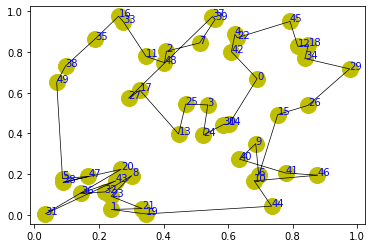

step:3500/5000, actic loss:0.588, critic loss:3.032, L:9.464, 0min1sec
step:3501/5000, actic loss:0.587, critic loss:3.031, L:9.464, 0min1sec
step:3502/5000, actic loss:0.588, critic loss:3.030, L:9.463, 0min1sec
step:3503/5000, actic loss:0.588, critic loss:3.029, L:9.462, 0min1sec
step:3504/5000, actic loss:0.588, critic loss:3.029, L:9.462, 0min1sec
distance:7.489
tensor([37, 20, 49, 32, 34, 18,  1, 27, 47,  8, 29, 17, 35, 23, 45, 19, 26, 41,
        14, 13, 21,  3, 46, 30, 39, 33, 16, 40, 15, 24,  5, 42,  0,  4, 48,  2,
         7, 38, 44, 36, 12, 25,  9, 11, 10, 43, 31, 28,  6, 22])


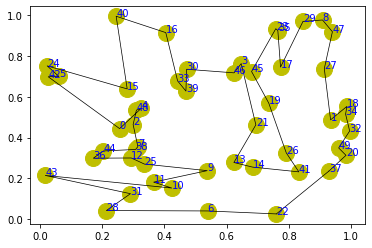

step:3505/5000, actic loss:0.588, critic loss:3.028, L:9.461, 0min2sec
step:3506/5000, actic loss:0.588, critic loss:3.027, L:9.460, 0min1sec
step:3507/5000, actic loss:0.587, critic loss:3.026, L:9.460, 0min1sec
step:3508/5000, actic loss:0.587, critic loss:3.025, L:9.459, 0min1sec
step:3509/5000, actic loss:0.586, critic loss:3.025, L:9.458, 0min1sec
distance:7.029
tensor([13, 35,  0, 48,  7, 38,  6, 20, 14, 36, 21, 25, 17, 37, 27, 42, 12, 49,
        30, 47, 40,  8,  4, 45, 41, 26,  1, 15, 29, 16, 31, 39,  2,  9,  5, 46,
        23, 19, 32, 24, 33,  3, 34, 43, 11, 10, 44, 22, 28, 18])


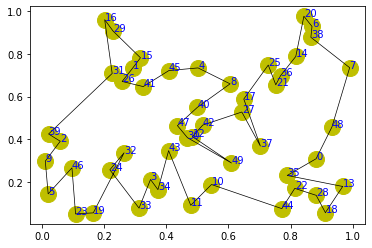

step:3510/5000, actic loss:0.586, critic loss:3.024, L:9.458, 0min1sec
step:3511/5000, actic loss:0.586, critic loss:3.023, L:9.457, 0min1sec
step:3512/5000, actic loss:0.587, critic loss:3.022, L:9.456, 0min1sec
step:3513/5000, actic loss:0.586, critic loss:3.021, L:9.455, 0min1sec
step:3514/5000, actic loss:0.586, critic loss:3.021, L:9.455, 0min1sec
distance:7.430
tensor([ 8, 25, 34,  2, 30, 29,  6,  1, 47, 28,  5, 37, 31, 42, 49,  9, 22, 18,
        27, 35, 45,  3, 33, 16, 36, 24, 23, 48, 46, 39, 43,  7, 44, 20, 40, 15,
        26, 38, 11, 32, 17, 14,  4, 21, 19, 13,  0, 41, 10, 12])


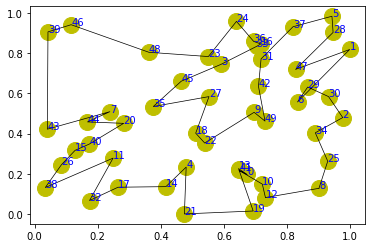

step:3515/5000, actic loss:0.586, critic loss:3.020, L:9.454, 0min2sec
step:3516/5000, actic loss:0.586, critic loss:3.019, L:9.453, 0min1sec
step:3517/5000, actic loss:0.586, critic loss:3.018, L:9.453, 0min1sec
step:3518/5000, actic loss:0.585, critic loss:3.017, L:9.452, 0min1sec
step:3519/5000, actic loss:0.585, critic loss:3.017, L:9.451, 0min1sec
distance:7.750
tensor([40, 23, 11, 21, 35, 32, 37, 24, 46, 45, 10, 33, 26, 34,  8, 18, 25, 48,
         9,  7, 17, 22,  0,  1, 14, 42, 15, 16, 36, 20, 30, 39, 44, 41, 49,  2,
         5, 43, 12, 47, 19, 28,  4, 29,  3, 31,  6, 27, 13, 38])


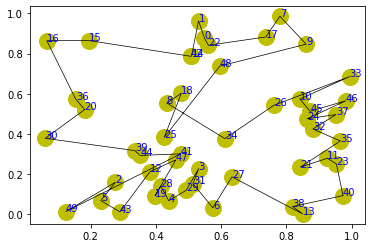

step:3520/5000, actic loss:0.585, critic loss:3.016, L:9.451, 0min1sec
step:3521/5000, actic loss:0.585, critic loss:3.015, L:9.450, 0min1sec
step:3522/5000, actic loss:0.585, critic loss:3.014, L:9.449, 0min1sec
step:3523/5000, actic loss:0.585, critic loss:3.014, L:9.449, 0min1sec
step:3524/5000, actic loss:0.584, critic loss:3.013, L:9.448, 0min1sec
distance:6.709
tensor([13, 24, 40,  0, 22,  9, 31, 35, 44, 49, 38, 32, 11, 36, 45,  2, 26,  1,
        30,  7, 48, 12, 19, 43, 29, 39, 27,  8, 46, 34, 10,  5,  3, 14, 42, 47,
        25,  6, 33, 15, 37,  4, 16, 28, 21, 41, 23, 18, 17, 20])


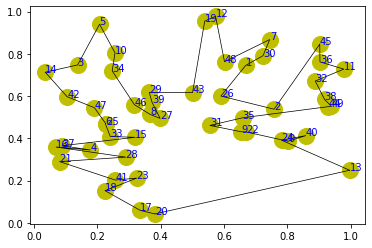

step:3525/5000, actic loss:0.584, critic loss:3.012, L:9.447, 0min2sec
step:3526/5000, actic loss:0.584, critic loss:3.011, L:9.447, 0min2sec
step:3527/5000, actic loss:0.584, critic loss:3.010, L:9.446, 0min1sec
step:3528/5000, actic loss:0.583, critic loss:3.010, L:9.445, 0min1sec
step:3529/5000, actic loss:0.582, critic loss:3.009, L:9.444, 0min1sec
distance:7.446
tensor([ 8, 10, 31, 20,  1, 34, 46,  9, 40, 37, 26,  2,  3, 36, 13,  6, 27,  4,
        12, 43, 47, 21, 29, 16, 33, 41, 39, 28, 49, 18, 19, 42, 24, 17, 25, 48,
        44,  7, 23, 45, 35, 22, 30,  5,  0, 15, 32, 11, 38, 14])


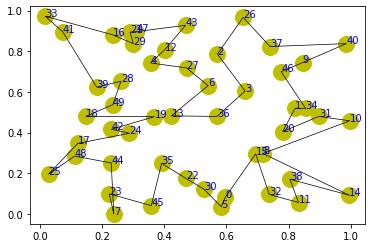

step:3530/5000, actic loss:0.582, critic loss:3.008, L:9.444, 0min1sec
step:3531/5000, actic loss:0.582, critic loss:3.007, L:9.443, 0min1sec
step:3532/5000, actic loss:0.582, critic loss:3.006, L:9.442, 0min1sec
step:3533/5000, actic loss:0.582, critic loss:3.006, L:9.442, 0min1sec
step:3534/5000, actic loss:0.582, critic loss:3.005, L:9.441, 0min1sec
distance:7.370
tensor([44, 47,  1, 33, 36, 26, 22, 12, 41, 48, 32, 24, 25,  5,  3, 43, 28, 23,
        31, 45,  4, 27,  2, 11, 49,  6,  8, 16, 30, 13, 46, 15, 42,  9, 40,  7,
        14, 20, 38, 34, 39, 21, 35, 17,  0, 29, 18, 37, 10, 19])


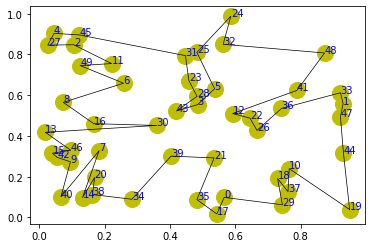

step:3535/5000, actic loss:0.582, critic loss:3.004, L:9.440, 0min2sec
step:3536/5000, actic loss:0.582, critic loss:3.003, L:9.439, 0min2sec
step:3537/5000, actic loss:0.581, critic loss:3.003, L:9.439, 0min2sec
step:3538/5000, actic loss:0.581, critic loss:3.002, L:9.438, 0min1sec
step:3539/5000, actic loss:0.581, critic loss:3.001, L:9.437, 0min1sec
distance:6.651
tensor([32, 18, 28, 22,  5, 49,  9, 16, 14, 10, 25, 31, 43, 46, 17, 37,  2, 36,
         6, 33, 42, 48, 13, 45,  0, 41, 30, 23, 24, 44, 11, 29,  1, 21, 40,  8,
        19,  7, 34,  3, 38, 39, 35,  4, 15, 26, 20, 27, 12, 47])


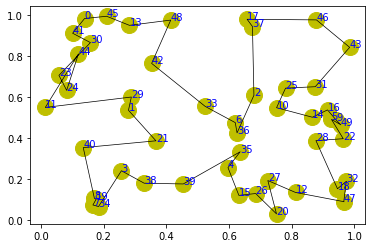

step:3540/5000, actic loss:0.581, critic loss:3.000, L:9.437, 0min2sec
step:3541/5000, actic loss:0.581, critic loss:2.999, L:9.436, 0min1sec
step:3542/5000, actic loss:0.580, critic loss:2.999, L:9.435, 0min1sec
step:3543/5000, actic loss:0.580, critic loss:2.998, L:9.435, 0min1sec
step:3544/5000, actic loss:0.580, critic loss:2.997, L:9.434, 0min1sec
distance:6.598
tensor([21,  1, 41, 37, 29, 38, 12, 11, 26, 19, 25, 35,  8,  6, 45, 44, 43, 48,
        15, 47, 31, 16,  4, 23, 40,  2, 33, 28, 32, 18, 20, 24,  0,  9,  7, 10,
        14, 49, 46, 27,  5, 39, 42,  3, 22, 13, 30, 34, 17, 36])


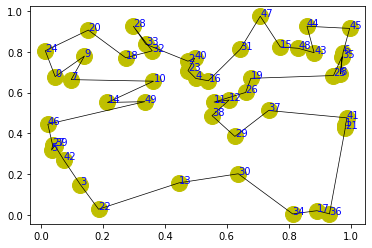

step:3545/5000, actic loss:0.579, critic loss:2.996, L:9.433, 0min1sec
step:3546/5000, actic loss:0.580, critic loss:2.996, L:9.433, 0min1sec
step:3547/5000, actic loss:0.581, critic loss:2.995, L:9.432, 0min1sec
step:3548/5000, actic loss:0.581, critic loss:2.994, L:9.432, 0min1sec
step:3549/5000, actic loss:0.582, critic loss:2.993, L:9.431, 0min1sec
distance:7.862
tensor([43, 12, 40, 34, 26,  8, 49, 13, 44,  6,  5, 27, 39, 42, 41, 16, 46,  3,
         2, 30, 23, 21, 22, 32, 10, 45, 31, 24, 35, 19, 18,  9, 28, 20,  7, 47,
        14,  0, 29, 38, 48, 37,  1, 17, 25, 15, 36,  4, 11, 33])


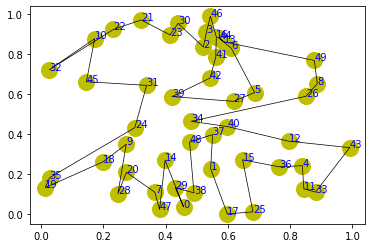

step:3550/5000, actic loss:0.581, critic loss:2.993, L:9.430, 0min2sec
step:3551/5000, actic loss:0.581, critic loss:2.992, L:9.430, 0min2sec
step:3552/5000, actic loss:0.580, critic loss:2.991, L:9.429, 0min1sec
step:3553/5000, actic loss:0.579, critic loss:2.990, L:9.429, 0min1sec
step:3554/5000, actic loss:0.578, critic loss:2.990, L:9.428, 0min1sec
distance:8.000
tensor([13, 20, 23,  9, 45, 28,  2, 40,  8, 39, 32, 49,  5, 31, 11, 21, 46, 37,
        34, 19, 36, 38, 41, 35, 16, 12, 26,  3, 17, 22, 27, 10, 15, 43,  7,  6,
         1, 14, 25, 33, 29,  0, 24, 18, 48, 42,  4, 44, 47, 30])


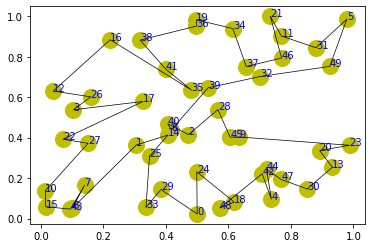

step:3555/5000, actic loss:0.578, critic loss:2.989, L:9.427, 0min2sec
step:3556/5000, actic loss:0.578, critic loss:2.988, L:9.427, 0min1sec
step:3557/5000, actic loss:0.578, critic loss:2.987, L:9.426, 0min1sec
step:3558/5000, actic loss:0.578, critic loss:2.987, L:9.426, 0min1sec
step:3559/5000, actic loss:0.577, critic loss:2.986, L:9.425, 0min1sec
distance:8.026
tensor([12, 30, 28, 18, 46, 17, 45, 43, 40, 47, 41, 11, 27, 23, 32, 36,  0, 37,
         9, 42,  7, 49, 20, 14, 16,  5, 48, 15, 25, 13,  2,  6, 44, 39, 22, 31,
         8, 10, 38, 21, 24, 29,  1,  4, 34, 19, 33,  3, 26, 35])


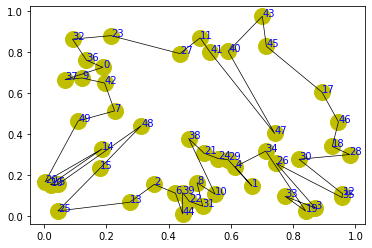

step:3560/5000, actic loss:0.576, critic loss:2.985, L:9.424, 0min1sec
step:3561/5000, actic loss:0.575, critic loss:2.984, L:9.424, 0min1sec
step:3562/5000, actic loss:0.575, critic loss:2.984, L:9.423, 0min2sec
step:3563/5000, actic loss:0.575, critic loss:2.983, L:9.422, 0min2sec
step:3564/5000, actic loss:0.575, critic loss:2.982, L:9.422, 0min1sec
distance:7.364
tensor([19, 28, 36, 13, 30, 11, 47, 45, 20, 24,  9,  6, 46, 40, 41, 22, 48, 25,
        35, 44, 39, 33,  8, 14, 16,  2, 18, 21, 10, 49,  5,  0, 29, 12, 31, 23,
        27, 43, 32, 34,  1,  7, 38, 42,  4,  3, 15, 37, 17, 26])


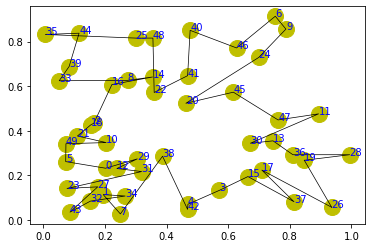

step:3565/5000, actic loss:0.575, critic loss:2.981, L:9.421, 0min2sec
step:3566/5000, actic loss:0.575, critic loss:2.981, L:9.420, 0min1sec
step:3567/5000, actic loss:0.574, critic loss:2.980, L:9.420, 0min1sec
step:3568/5000, actic loss:0.574, critic loss:2.979, L:9.419, 0min1sec
step:3569/5000, actic loss:0.573, critic loss:2.978, L:9.418, 0min1sec
distance:7.315
tensor([41, 11, 33, 16, 29,  5,  3, 30, 39,  2, 34, 15, 44, 47, 38, 24,  0, 19,
        49, 37, 43,  6, 21, 42, 40,  7, 12, 22, 28, 13,  1, 36, 48, 25, 32,  9,
        17, 27, 45,  4,  8, 31, 14, 23, 20, 10, 46, 35, 26, 18])


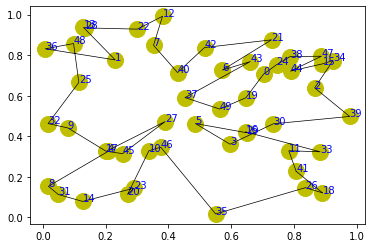

step:3570/5000, actic loss:0.573, critic loss:2.978, L:9.418, 0min2sec
step:3571/5000, actic loss:0.573, critic loss:2.977, L:9.417, 0min1sec
step:3572/5000, actic loss:0.573, critic loss:2.976, L:9.416, 0min1sec
step:3573/5000, actic loss:0.573, critic loss:2.975, L:9.416, 0min1sec
step:3574/5000, actic loss:0.573, critic loss:2.975, L:9.415, 0min2sec
distance:7.226
tensor([42, 39, 31, 30, 23, 11, 46, 15, 32,  0, 20, 35, 38, 48,  2, 19, 29,  1,
         4, 40, 25, 12, 33,  5, 49, 24, 10, 27, 44,  6, 36, 17, 41, 22, 43, 18,
         9, 34, 14, 37,  8,  3,  7, 28, 13, 47, 26, 21, 16, 45])


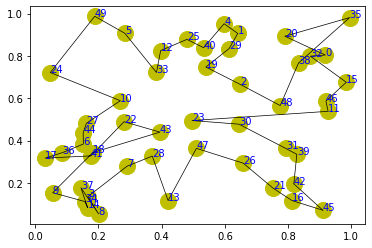

step:3575/5000, actic loss:0.573, critic loss:2.974, L:9.414, 0min2sec
step:3576/5000, actic loss:0.573, critic loss:2.973, L:9.414, 0min2sec
step:3577/5000, actic loss:0.572, critic loss:2.972, L:9.413, 0min1sec
step:3578/5000, actic loss:0.572, critic loss:2.971, L:9.412, 0min1sec
step:3579/5000, actic loss:0.572, critic loss:2.971, L:9.412, 0min1sec
distance:7.586
tensor([46, 49, 17, 26, 37,  5, 20, 48, 11, 47, 44, 32, 18,  1,  7, 42, 22, 35,
        36, 29, 30, 23, 31,  6,  3, 38, 19, 21, 16,  2, 41, 43, 10, 12,  0, 28,
        27, 24, 14, 25,  4, 15, 40, 34, 45, 13,  8,  9, 33, 39])


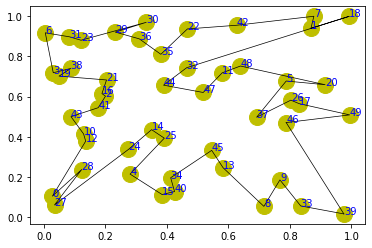

step:3580/5000, actic loss:0.571, critic loss:2.970, L:9.411, 0min2sec
step:3581/5000, actic loss:0.571, critic loss:2.969, L:9.410, 0min1sec
step:3582/5000, actic loss:0.571, critic loss:2.968, L:9.410, 0min1sec
step:3583/5000, actic loss:0.571, critic loss:2.968, L:9.409, 0min1sec
step:3584/5000, actic loss:0.571, critic loss:2.967, L:9.409, 0min1sec
distance:6.937
tensor([ 4, 34, 15,  7, 12, 26, 16,  6, 27, 42, 22, 21, 18, 24, 11, 41, 19, 44,
        33,  1,  0, 46, 40,  8,  9, 17, 47, 20, 13, 48, 31, 43, 23,  5, 25,  2,
        38, 14, 37, 32, 30, 28, 35, 36, 45, 39, 29, 49,  3, 10])


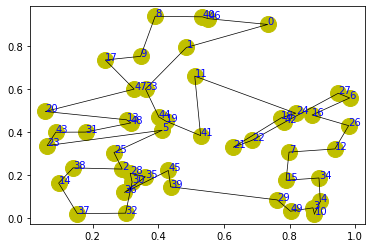

step:3585/5000, actic loss:0.571, critic loss:2.966, L:9.408, 0min2sec
step:3586/5000, actic loss:0.571, critic loss:2.965, L:9.407, 0min1sec
step:3587/5000, actic loss:0.571, critic loss:2.965, L:9.407, 0min1sec
step:3588/5000, actic loss:0.570, critic loss:2.964, L:9.406, 0min1sec
step:3589/5000, actic loss:0.570, critic loss:2.963, L:9.405, 0min2sec
distance:6.554
tensor([ 9, 38, 49, 43, 48, 20, 47, 45, 42, 12, 29,  2, 14, 46, 17, 39,  6, 35,
        37, 11,  3, 21,  8,  1, 15,  4, 44, 33, 36, 41, 22, 30,  0, 26, 28,  7,
        16,  5, 18, 32, 19, 27, 25, 24, 31, 40, 34, 13, 10, 23])


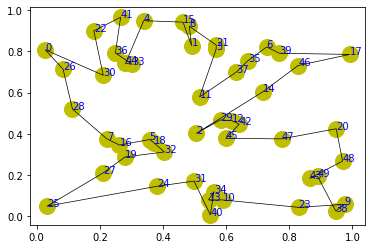

step:3590/5000, actic loss:0.570, critic loss:2.962, L:9.404, 0min2sec
step:3591/5000, actic loss:0.570, critic loss:2.962, L:9.404, 0min1sec
step:3592/5000, actic loss:0.570, critic loss:2.961, L:9.403, 0min1sec
step:3593/5000, actic loss:0.570, critic loss:2.960, L:9.402, 0min1sec
step:3594/5000, actic loss:0.569, critic loss:2.959, L:9.402, 0min1sec
distance:6.863
tensor([32,  6, 16, 34, 25,  9, 22, 11,  5, 47, 38, 20,  4, 21, 13,  1, 39, 33,
         8, 36,  0, 37, 46, 40, 26, 44, 29, 48, 18, 10, 31, 24, 42, 35, 27, 12,
        23,  3, 28, 17, 30, 15, 14, 49, 45,  2, 41, 43, 19,  7])


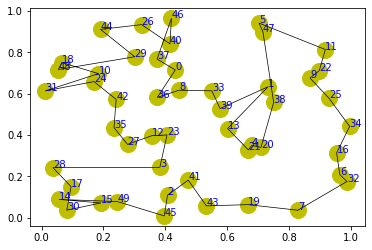

step:3595/5000, actic loss:0.569, critic loss:2.958, L:9.401, 0min1sec
step:3596/5000, actic loss:0.568, critic loss:2.958, L:9.400, 0min1sec
step:3597/5000, actic loss:0.568, critic loss:2.957, L:9.400, 0min1sec
step:3598/5000, actic loss:0.568, critic loss:2.956, L:9.399, 0min1sec
step:3599/5000, actic loss:0.568, critic loss:2.955, L:9.398, 0min1sec
distance:6.353
tensor([ 8, 32, 30, 11, 47, 20, 37, 40, 12,  4, 44,  3, 23,  0, 35, 24,  6, 36,
        25, 49, 38, 10, 45,  7, 39, 26,  2, 33, 42, 43, 28, 18, 19,  1, 13, 17,
        16,  5, 34, 14, 15, 31, 27, 48,  9, 21, 46, 22, 29, 41])


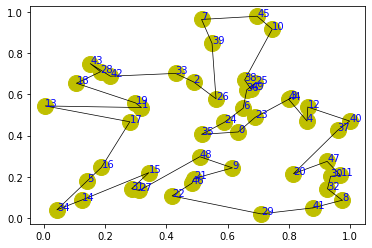

step:3600/5000, actic loss:0.568, critic loss:2.955, L:9.398, 0min1sec
step:3601/5000, actic loss:0.568, critic loss:2.954, L:9.397, 0min1sec
step:3602/5000, actic loss:0.568, critic loss:2.953, L:9.396, 0min1sec
step:3603/5000, actic loss:0.568, critic loss:2.953, L:9.396, 0min1sec
step:3604/5000, actic loss:0.567, critic loss:2.952, L:9.395, 0min1sec
distance:7.231
tensor([ 6,  4, 45,  1,  9, 29, 11, 30, 44, 20, 38, 34, 39, 26, 36, 21, 15, 17,
        12,  8, 24, 40,  7, 33, 10, 46, 23, 47, 32, 41, 48, 27, 19, 28, 49, 43,
        22,  5, 13, 16, 37,  3,  2, 31, 35, 14, 25,  0, 42, 18])


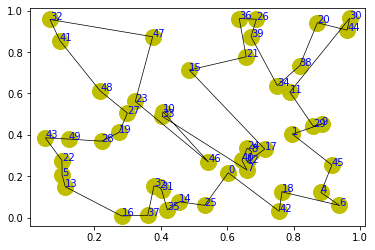

step:3605/5000, actic loss:0.567, critic loss:2.951, L:9.394, 0min2sec
step:3606/5000, actic loss:0.567, critic loss:2.950, L:9.394, 0min1sec
step:3607/5000, actic loss:0.567, critic loss:2.949, L:9.393, 0min1sec
step:3608/5000, actic loss:0.567, critic loss:2.949, L:9.392, 0min1sec
step:3609/5000, actic loss:0.568, critic loss:2.948, L:9.392, 0min1sec
distance:6.163
tensor([44, 20, 29, 28,  1, 19, 22, 38, 27, 49, 39, 35, 25, 12,  9, 43, 24, 41,
        45,  2, 15, 16, 11, 33, 17, 30, 21, 23, 47, 42, 18, 36, 40,  3,  8, 14,
         6,  4, 34, 37,  7, 48, 10, 31,  5,  0, 46, 26, 32, 13])


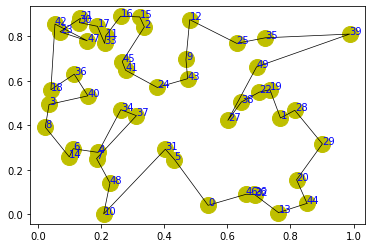

step:3610/5000, actic loss:0.568, critic loss:2.947, L:9.391, 0min1sec
step:3611/5000, actic loss:0.568, critic loss:2.947, L:9.390, 0min1sec
step:3612/5000, actic loss:0.567, critic loss:2.946, L:9.390, 0min1sec
step:3613/5000, actic loss:0.566, critic loss:2.945, L:9.389, 0min1sec
step:3614/5000, actic loss:0.566, critic loss:2.944, L:9.389, 0min1sec
distance:7.013
tensor([42, 15, 21, 28, 32, 16, 25, 46,  8, 40, 11,  9, 37, 19, 29,  0, 38,  1,
        49, 22, 13, 48, 39, 43,  3, 23, 45, 31, 30, 10, 17,  2, 20, 33, 44, 35,
        47, 27,  4, 36, 26, 41,  6, 24, 34, 14,  5, 18, 12,  7])


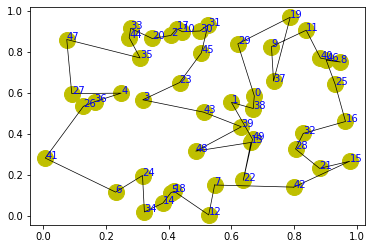

step:3615/5000, actic loss:0.566, critic loss:2.944, L:9.388, 0min1sec
step:3616/5000, actic loss:0.566, critic loss:2.943, L:9.387, 0min1sec
step:3617/5000, actic loss:0.566, critic loss:2.942, L:9.387, 0min1sec
step:3618/5000, actic loss:0.566, critic loss:2.941, L:9.386, 0min1sec
step:3619/5000, actic loss:0.566, critic loss:2.941, L:9.386, 0min2sec
distance:6.940
tensor([43, 32, 21, 26, 17, 31, 13, 42,  9,  8, 44, 39, 48, 19, 15,  0, 11, 35,
         3, 10, 45, 38, 40, 36,  1, 30,  5, 37, 18, 27, 12,  2, 22,  6, 20, 25,
        46, 34, 24, 41, 23, 49, 33,  7, 47, 16, 29, 28, 14,  4])


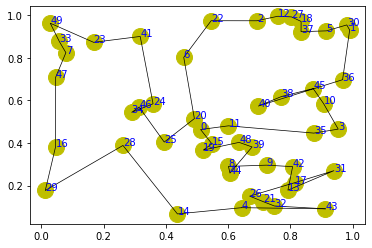

step:3620/5000, actic loss:0.565, critic loss:2.940, L:9.385, 0min2sec
step:3621/5000, actic loss:0.565, critic loss:2.939, L:9.385, 0min1sec
step:3622/5000, actic loss:0.565, critic loss:2.939, L:9.384, 0min1sec
step:3623/5000, actic loss:0.564, critic loss:2.938, L:9.383, 0min1sec
step:3624/5000, actic loss:0.564, critic loss:2.937, L:9.383, 0min1sec
distance:7.982
tensor([12, 35, 45, 15, 26, 10, 21,  3, 34, 42,  8, 18, 16, 27, 17, 30, 32, 43,
        46, 37, 40,  9, 24,  4,  0,  7, 39, 38, 14, 33, 28, 49, 19, 41, 13,  6,
        11, 36,  1,  5,  2, 31, 22, 47, 29, 25, 23, 48, 44, 20])


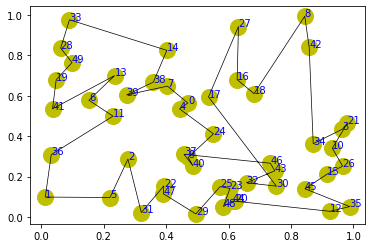

step:3625/5000, actic loss:0.565, critic loss:2.936, L:9.382, 0min2sec
step:3626/5000, actic loss:0.564, critic loss:2.936, L:9.382, 0min1sec
step:3627/5000, actic loss:0.564, critic loss:2.935, L:9.381, 0min1sec
step:3628/5000, actic loss:0.563, critic loss:2.934, L:9.380, 0min1sec
step:3629/5000, actic loss:0.563, critic loss:2.933, L:9.380, 0min1sec
distance:7.202
tensor([ 6, 45, 39, 22, 28,  3, 26,  4,  2,  8, 35, 17, 41, 23, 49, 47, 10,  9,
        34, 44, 33, 16,  5, 11,  7, 30, 31,  1,  0, 42, 14, 15, 48, 24, 36, 40,
        27, 20, 25, 43, 18, 32, 19, 21, 38, 13, 29, 12, 46, 37])


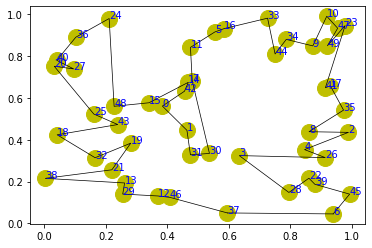

step:3630/5000, actic loss:0.563, critic loss:2.933, L:9.379, 0min1sec
step:3631/5000, actic loss:0.563, critic loss:2.932, L:9.379, 0min1sec
step:3632/5000, actic loss:0.563, critic loss:2.931, L:9.378, 0min1sec
step:3633/5000, actic loss:0.563, critic loss:2.930, L:9.377, 0min1sec
step:3634/5000, actic loss:0.563, critic loss:2.930, L:9.377, 0min2sec
distance:6.555
tensor([22, 16, 34,  9, 42,  3, 32, 20, 41, 15, 25,  6,  2, 18, 19,  4, 29, 49,
        40, 36, 48, 26, 23, 30, 31, 44, 43, 21, 27, 17, 11,  0, 14, 10,  8, 13,
        24,  1, 28, 47, 46, 35, 39, 38,  5, 45, 33,  7, 37, 12])


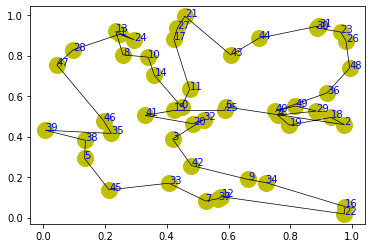

step:3635/5000, actic loss:0.563, critic loss:2.929, L:9.376, 0min2sec
step:3636/5000, actic loss:0.562, critic loss:2.928, L:9.376, 0min1sec
step:3637/5000, actic loss:0.561, critic loss:2.928, L:9.375, 0min1sec
step:3638/5000, actic loss:0.561, critic loss:2.927, L:9.374, 0min1sec
step:3639/5000, actic loss:0.561, critic loss:2.926, L:9.374, 0min1sec
distance:7.541
tensor([10, 16, 33,  9, 46, 13, 26, 11, 23, 28,  5, 12, 25, 41, 44,  6, 22, 43,
         2, 47, 27, 15, 39, 29, 32, 42,  0, 17, 14, 30, 21, 36, 45, 48, 34, 31,
         7,  4, 35, 49, 40,  8,  1, 18, 20, 37,  3, 38, 24, 19])


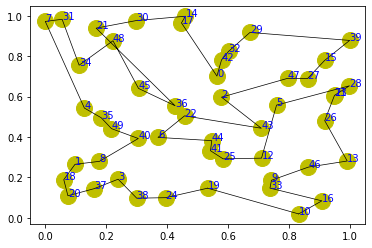

step:3640/5000, actic loss:0.561, critic loss:2.926, L:9.373, 0min1sec
step:3641/5000, actic loss:0.562, critic loss:2.925, L:9.373, 0min1sec
step:3642/5000, actic loss:0.562, critic loss:2.924, L:9.372, 0min1sec
step:3643/5000, actic loss:0.562, critic loss:2.923, L:9.372, 0min1sec
step:3644/5000, actic loss:0.561, critic loss:2.923, L:9.371, 0min1sec
distance:6.874
tensor([47,  3, 19, 26, 22, 42, 24, 15, 31, 40,  4, 44, 25, 38, 37, 36, 21, 13,
        23,  2,  5, 20, 27, 43, 34, 48, 28, 35, 12, 33, 29,  8, 41,  6, 10, 11,
        49, 17, 32, 14, 39, 46,  9, 16,  0, 45,  7, 18, 30,  1])


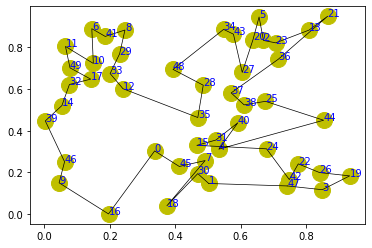

step:3645/5000, actic loss:0.560, critic loss:2.922, L:9.370, 0min1sec
step:3646/5000, actic loss:0.558, critic loss:2.921, L:9.370, 0min1sec
step:3647/5000, actic loss:0.557, critic loss:2.921, L:9.369, 0min1sec
step:3648/5000, actic loss:0.556, critic loss:2.920, L:9.369, 0min1sec
step:3649/5000, actic loss:0.555, critic loss:2.919, L:9.368, 0min1sec
distance:6.911
tensor([15, 38, 26, 45,  7, 33, 19,  8, 29, 20, 14, 21, 39, 37, 43, 32, 12,  9,
         3, 24, 16, 11,  2, 31, 30, 49, 40, 35, 47, 34,  5, 41, 28, 22, 23, 17,
        36, 44, 48,  1,  6, 42,  4, 10, 46, 27, 18, 25, 13,  0])


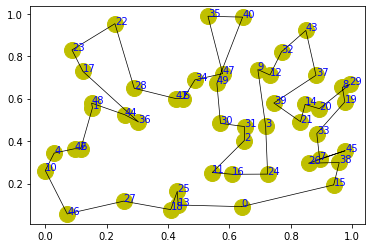

step:3650/5000, actic loss:0.555, critic loss:2.919, L:9.368, 0min2sec
step:3651/5000, actic loss:0.555, critic loss:2.918, L:9.367, 0min1sec
step:3652/5000, actic loss:0.555, critic loss:2.917, L:9.367, 0min1sec
step:3653/5000, actic loss:0.555, critic loss:2.917, L:9.366, 0min1sec
step:3654/5000, actic loss:0.555, critic loss:2.916, L:9.366, 0min1sec
distance:8.110
tensor([ 6, 21, 13,  7, 31, 17,  1, 26, 37, 19, 10, 11, 22, 43,  8, 18, 14,  4,
        41, 33, 45, 25,  5, 24, 40,  3, 44, 36, 15, 46, 39, 30, 35, 23, 49,  9,
        28, 42, 12, 34, 16, 27, 32,  2, 29, 48,  0, 47, 20, 38])


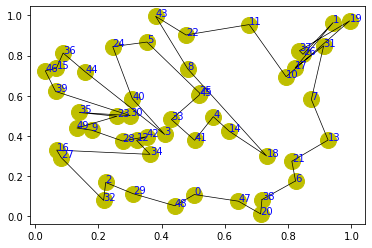

step:3655/5000, actic loss:0.555, critic loss:2.915, L:9.365, 0min2sec
step:3656/5000, actic loss:0.554, critic loss:2.914, L:9.365, 0min1sec
step:3657/5000, actic loss:0.554, critic loss:2.914, L:9.364, 0min1sec
step:3658/5000, actic loss:0.553, critic loss:2.913, L:9.363, 0min1sec
step:3659/5000, actic loss:0.553, critic loss:2.912, L:9.363, 0min1sec
distance:7.602
tensor([ 7, 18,  2, 42, 25, 47, 35, 15,  0, 10, 37, 24,  9, 31,  8, 17, 48, 33,
        44, 26, 27, 22, 16, 20, 36, 46, 39, 28, 13, 14, 23,  4, 29, 45,  6, 32,
        12, 19,  5, 30, 40, 49, 41,  1, 43, 11, 21,  3, 38, 34])


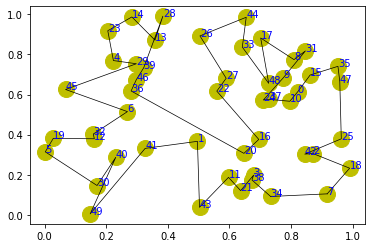

step:3660/5000, actic loss:0.553, critic loss:2.912, L:9.362, 0min2sec
step:3661/5000, actic loss:0.554, critic loss:2.911, L:9.362, 0min2sec
step:3662/5000, actic loss:0.554, critic loss:2.910, L:9.361, 0min2sec
step:3663/5000, actic loss:0.553, critic loss:2.909, L:9.361, 0min1sec
step:3664/5000, actic loss:0.553, critic loss:2.909, L:9.360, 0min1sec
distance:6.587
tensor([31, 19, 34, 47, 45, 48, 46, 30, 41,  1, 27, 40, 16, 32,  7, 42, 13, 28,
        20, 12,  0, 38, 24,  4, 36, 22, 21, 39, 37,  3,  6,  2, 15, 49, 26, 14,
        44, 23, 10, 17, 33, 25,  9, 29, 11, 35, 18, 43,  8,  5])


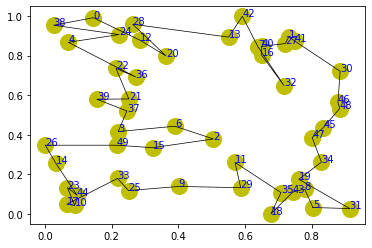

step:3665/5000, actic loss:0.552, critic loss:2.908, L:9.360, 0min2sec
step:3666/5000, actic loss:0.552, critic loss:2.907, L:9.359, 0min1sec
step:3667/5000, actic loss:0.552, critic loss:2.907, L:9.359, 0min1sec
step:3668/5000, actic loss:0.552, critic loss:2.906, L:9.358, 0min1sec
step:3669/5000, actic loss:0.552, critic loss:2.905, L:9.358, 0min1sec
distance:7.477
tensor([20, 26,  2, 36, 18, 14, 46, 39, 32, 24, 13, 37, 21, 31,  6, 44, 22, 30,
        49, 16, 47,  5, 10,  9, 35,  0, 11, 41, 34,  4, 27,  3, 25, 43,  7, 45,
        48, 40, 19, 38,  1,  8, 17, 42, 29, 33, 15, 23, 28, 12])


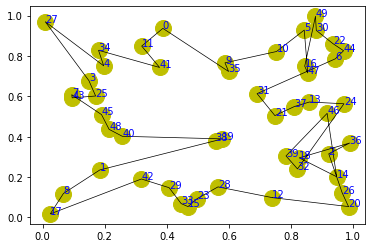

step:3670/5000, actic loss:0.552, critic loss:2.905, L:9.357, 0min1sec
step:3671/5000, actic loss:0.552, critic loss:2.904, L:9.357, 0min1sec
step:3672/5000, actic loss:0.551, critic loss:2.903, L:9.356, 0min1sec
step:3673/5000, actic loss:0.551, critic loss:2.902, L:9.355, 0min1sec
step:3674/5000, actic loss:0.550, critic loss:2.902, L:9.355, 0min2sec
distance:6.833
tensor([34, 25, 38, 46,  4,  2,  8, 27, 36, 26, 45, 15, 11,  1, 40, 20, 21, 44,
        13, 49, 42, 28, 35, 12,  0, 17, 32, 19,  5,  7, 16, 23, 48,  9, 24, 39,
        30, 31, 41, 22, 10, 47, 18, 33, 14,  6, 43,  3, 37, 29])


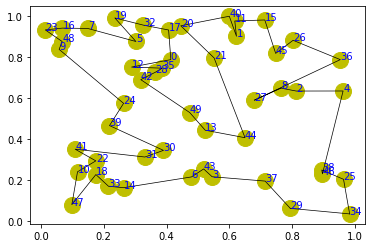

step:3675/5000, actic loss:0.550, critic loss:2.901, L:9.354, 0min2sec
step:3676/5000, actic loss:0.551, critic loss:2.900, L:9.354, 0min2sec
step:3677/5000, actic loss:0.551, critic loss:2.900, L:9.353, 0min1sec
step:3678/5000, actic loss:0.551, critic loss:2.899, L:9.353, 0min1sec
step:3679/5000, actic loss:0.551, critic loss:2.898, L:9.352, 0min1sec
distance:7.696
tensor([36, 35,  6, 27, 33, 10,  3,  2, 11, 41, 39, 46, 38, 24,  4,  7, 20, 49,
        30, 19, 44, 23, 31,  1, 13, 40, 42, 47, 12, 34, 22, 17, 26, 43, 14,  0,
        32, 48, 29, 28, 37,  5, 25, 21, 15, 18,  9, 45, 16,  8])


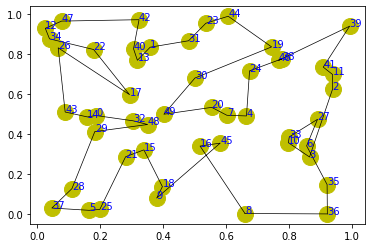

step:3680/5000, actic loss:0.551, critic loss:2.898, L:9.351, 0min2sec
step:3681/5000, actic loss:0.551, critic loss:2.897, L:9.351, 0min1sec
step:3682/5000, actic loss:0.550, critic loss:2.896, L:9.350, 0min1sec
step:3683/5000, actic loss:0.550, critic loss:2.895, L:9.350, 0min1sec
step:3684/5000, actic loss:0.550, critic loss:2.895, L:9.349, 0min1sec
distance:7.591
tensor([37, 33, 15, 42, 49, 43, 38, 36, 24, 12, 21,  3,  8, 40, 35, 10, 41,  0,
         4, 48, 16, 47, 29, 17,  1, 44, 32, 25, 27, 31, 22, 13, 20, 34, 23, 39,
        26, 30, 28,  6,  2,  7, 14, 46,  5, 11, 19, 45,  9, 18])


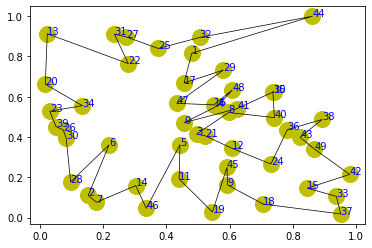

step:3685/5000, actic loss:0.550, critic loss:2.894, L:9.348, 0min2sec
step:3686/5000, actic loss:0.549, critic loss:2.893, L:9.348, 0min1sec
step:3687/5000, actic loss:0.549, critic loss:2.893, L:9.347, 0min1sec
step:3688/5000, actic loss:0.549, critic loss:2.892, L:9.347, 0min1sec
step:3689/5000, actic loss:0.549, critic loss:2.891, L:9.346, 0min1sec
distance:6.764
tensor([10,  6,  9, 34,  2, 29, 37, 30, 15, 21,  3, 14, 40, 47, 27, 32, 24, 19,
        31, 48, 35,  1, 42,  7, 18, 26, 38, 33, 36, 25,  5, 11,  0, 17, 13, 20,
        22, 49, 45, 44,  8, 46,  4, 12, 41, 16, 23, 43, 28, 39])


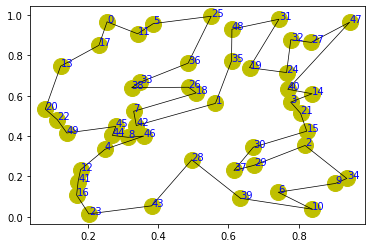

step:3690/5000, actic loss:0.549, critic loss:2.890, L:9.345, 0min2sec
step:3691/5000, actic loss:0.548, critic loss:2.890, L:9.345, 0min1sec
step:3692/5000, actic loss:0.548, critic loss:2.889, L:9.344, 0min1sec
step:3693/5000, actic loss:0.547, critic loss:2.888, L:9.343, 0min1sec
step:3694/5000, actic loss:0.546, critic loss:2.888, L:9.343, 0min1sec
distance:6.759
tensor([ 7, 42, 22,  9,  2, 11, 32, 10, 41, 18,  3, 40, 16, 23, 37, 45, 28, 30,
         6, 29,  5, 25, 31, 46, 14, 20,  8, 39, 12, 27, 35, 36,  4, 21, 24, 43,
        34, 49, 48, 19,  0,  1, 15, 44, 17, 33, 47, 38, 26, 13])


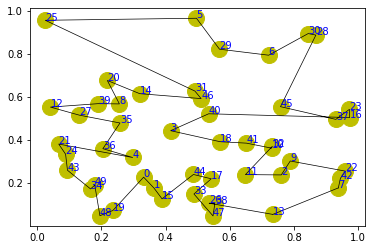

step:3695/5000, actic loss:0.546, critic loss:2.887, L:9.342, 0min2sec
step:3696/5000, actic loss:0.546, critic loss:2.886, L:9.342, 0min1sec
step:3697/5000, actic loss:0.546, critic loss:2.885, L:9.341, 0min1sec
step:3698/5000, actic loss:0.546, critic loss:2.885, L:9.340, 0min1sec
step:3699/5000, actic loss:0.546, critic loss:2.884, L:9.340, 0min1sec
distance:7.706
tensor([46, 18, 43,  3, 38, 31, 40, 14,  1, 10,  6, 16,  8, 30, 25, 11, 32,  0,
        47, 19, 41,  9, 13, 44, 42, 48, 29, 35,  5, 23, 24, 37, 21,  2, 27, 17,
        15, 33, 45, 34,  4, 39, 20,  7, 28, 36, 22, 26, 49, 12])


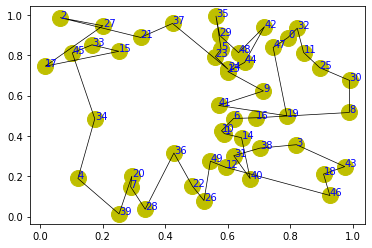

step:3700/5000, actic loss:0.545, critic loss:2.883, L:9.339, 0min2sec
step:3701/5000, actic loss:0.544, critic loss:2.883, L:9.338, 0min2sec
step:3702/5000, actic loss:0.543, critic loss:2.882, L:9.338, 0min2sec
step:3703/5000, actic loss:0.542, critic loss:2.881, L:9.337, 0min2sec
step:3704/5000, actic loss:0.541, critic loss:2.881, L:9.337, 0min1sec
distance:7.754
tensor([ 1, 32, 23,  3, 36,  0, 19, 26, 38, 42, 48, 12, 22, 14,  9,  7,  5,  6,
        39, 34, 47, 21,  4, 15, 18, 37, 11, 10, 46, 33, 25, 27, 44, 41, 45, 43,
        31, 13, 17, 35, 16, 49, 30, 28,  2,  8, 20, 24, 40, 29])


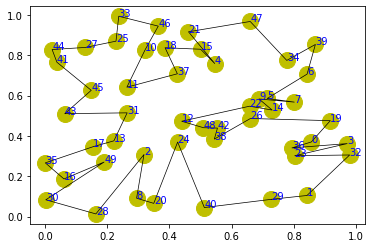

step:3705/5000, actic loss:0.541, critic loss:2.880, L:9.336, 0min2sec
step:3706/5000, actic loss:0.541, critic loss:2.879, L:9.335, 0min1sec
step:3707/5000, actic loss:0.542, critic loss:2.878, L:9.335, 0min1sec
step:3708/5000, actic loss:0.543, critic loss:2.878, L:9.334, 0min1sec
step:3709/5000, actic loss:0.543, critic loss:2.877, L:9.334, 0min1sec
distance:7.310
tensor([17, 31,  3, 45, 43, 10, 40, 39,  6, 26, 38, 27, 47, 36, 29, 28,  7,  2,
        21, 22, 37, 30,  4, 42, 44, 23, 16, 41, 15, 13,  9, 49, 35, 48, 24, 33,
        11,  1, 14,  5, 12, 32, 34, 18, 19,  8, 25,  0, 46, 20])


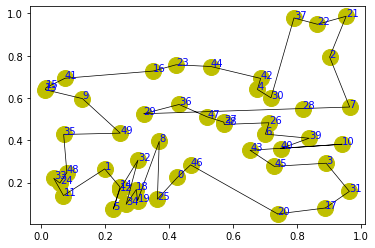

step:3710/5000, actic loss:0.543, critic loss:2.876, L:9.333, 0min2sec
step:3711/5000, actic loss:0.543, critic loss:2.876, L:9.332, 0min1sec
step:3712/5000, actic loss:0.543, critic loss:2.875, L:9.332, 0min1sec
step:3713/5000, actic loss:0.541, critic loss:2.874, L:9.331, 0min2sec
step:3714/5000, actic loss:0.540, critic loss:2.874, L:9.331, 0min2sec
distance:7.128
tensor([ 7, 19, 39,  6, 44,  8, 31, 29, 27, 26, 46, 45, 35, 17, 34, 22, 24, 13,
         0, 11, 33, 12, 30, 15, 18,  9, 21, 42, 47,  2, 36, 10,  1, 16, 20, 40,
        37, 32, 49,  3, 14, 25, 41, 43,  4, 28,  5, 48, 38, 23])


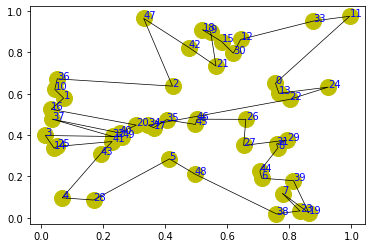

step:3715/5000, actic loss:0.539, critic loss:2.873, L:9.330, 0min2sec
step:3716/5000, actic loss:0.539, critic loss:2.872, L:9.329, 0min1sec
step:3717/5000, actic loss:0.540, critic loss:2.872, L:9.329, 0min1sec
step:3718/5000, actic loss:0.541, critic loss:2.871, L:9.328, 0min1sec
step:3719/5000, actic loss:0.542, critic loss:2.871, L:9.328, 0min1sec
distance:6.978
tensor([41, 29,  0, 27, 31, 23, 32, 47, 42, 36,  5, 48, 14, 11, 22, 21, 37, 18,
        24,  7, 46, 25, 28, 43, 17,  6, 49, 30, 35,  3,  2, 20, 12, 45,  1,  9,
        44, 34, 19, 15, 16, 39, 38, 33, 13, 10, 40,  4, 26,  8])


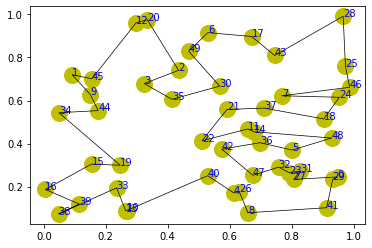

step:3720/5000, actic loss:0.541, critic loss:2.870, L:9.327, 0min2sec
step:3721/5000, actic loss:0.540, critic loss:2.869, L:9.327, 0min1sec
step:3722/5000, actic loss:0.539, critic loss:2.869, L:9.326, 0min1sec
step:3723/5000, actic loss:0.540, critic loss:2.868, L:9.326, 0min1sec
step:3724/5000, actic loss:0.542, critic loss:2.868, L:9.325, 0min2sec
distance:7.330
tensor([20,  8,  3, 49, 42, 14,  6, 21, 35, 28, 15, 48, 25, 19, 18, 24, 43, 17,
        23, 12, 44, 13, 27, 30, 32, 39, 36,  5,  1, 26, 37, 31,  4, 46,  0, 33,
        41, 29,  9, 47, 45, 10, 38, 40, 16, 11, 34, 22,  2,  7])


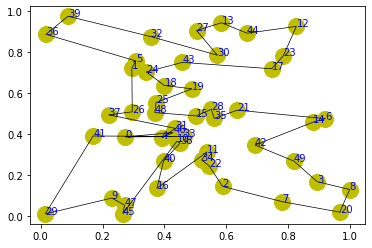

step:3725/5000, actic loss:0.543, critic loss:2.867, L:9.324, 0min2sec
step:3726/5000, actic loss:0.543, critic loss:2.866, L:9.324, 0min2sec
step:3727/5000, actic loss:0.542, critic loss:2.866, L:9.323, 0min1sec
step:3728/5000, actic loss:0.541, critic loss:2.865, L:9.323, 0min1sec
step:3729/5000, actic loss:0.541, critic loss:2.864, L:9.322, 0min1sec
distance:6.274
tensor([42, 31,  4, 47, 43, 13, 27, 39, 10, 12, 44, 21, 35,  1, 28, 24, 22,  7,
        19, 33, 20, 11, 36, 23, 37, 29,  0,  5, 45, 34, 48,  6, 32,  8, 46, 40,
         9, 15, 16, 26, 14, 38,  2, 30, 17, 18, 41, 49,  3, 25])


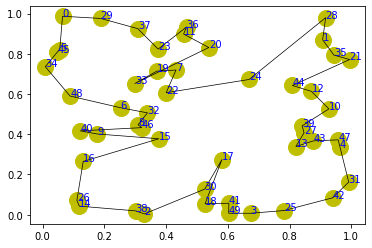

step:3730/5000, actic loss:0.541, critic loss:2.864, L:9.321, 0min2sec
step:3731/5000, actic loss:0.541, critic loss:2.863, L:9.321, 0min1sec
step:3732/5000, actic loss:0.541, critic loss:2.862, L:9.320, 0min1sec
step:3733/5000, actic loss:0.540, critic loss:2.861, L:9.320, 0min1sec
step:3734/5000, actic loss:0.540, critic loss:2.861, L:9.319, 0min1sec
distance:7.308
tensor([ 6, 27, 19, 15, 16, 35, 29,  1, 44, 30, 45, 42, 38, 26,  2, 18, 47, 48,
        34, 20,  9, 46, 10, 24, 37, 36,  3, 32, 43, 22,  7, 41, 13, 33, 40, 28,
        17, 14, 39,  8, 23, 49,  4,  5, 21, 31, 25, 12, 11,  0])


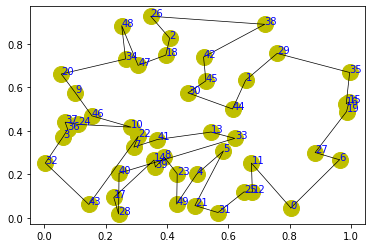

step:3735/5000, actic loss:0.539, critic loss:2.860, L:9.318, 0min2sec
step:3736/5000, actic loss:0.539, critic loss:2.859, L:9.318, 0min1sec
step:3737/5000, actic loss:0.539, critic loss:2.859, L:9.317, 0min2sec
step:3738/5000, actic loss:0.538, critic loss:2.858, L:9.317, 0min1sec
step:3739/5000, actic loss:0.538, critic loss:2.857, L:9.316, 0min1sec
distance:8.281
tensor([43, 36, 16, 31,  9, 45,  6, 23, 30, 35, 19, 46, 44, 11,  5, 41, 38,  2,
        32, 28, 24,  7, 21, 14, 40, 20, 13, 18,  1,  3, 10,  4,  0, 34, 12, 48,
         8, 37, 39, 17, 33, 42, 25, 29, 47, 15, 26, 22, 49, 27])


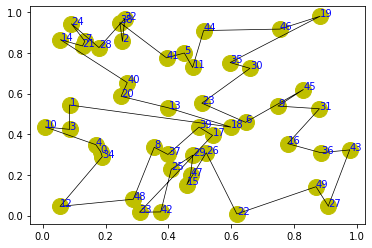

step:3740/5000, actic loss:0.538, critic loss:2.857, L:9.316, 0min2sec
step:3741/5000, actic loss:0.538, critic loss:2.856, L:9.315, 0min1sec
step:3742/5000, actic loss:0.537, critic loss:2.855, L:9.315, 0min1sec
step:3743/5000, actic loss:0.537, critic loss:2.855, L:9.314, 0min1sec
step:3744/5000, actic loss:0.537, critic loss:2.854, L:9.313, 0min1sec
distance:7.920
tensor([26, 28, 35,  5, 39, 27, 11,  2, 13, 48,  8,  6, 46, 19, 40, 17, 32, 43,
        20,  9, 44, 37, 33, 47, 23, 25,  4,  0, 45, 18, 16, 34, 21, 41, 10, 49,
        29, 30, 22,  3, 31,  1, 36,  7, 15, 14, 38, 42, 24, 12])


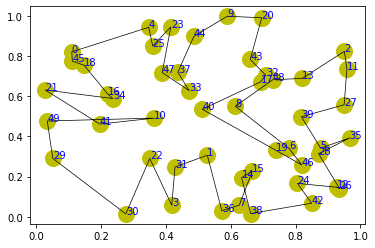

step:3745/5000, actic loss:0.538, critic loss:2.853, L:9.313, 0min2sec
step:3746/5000, actic loss:0.538, critic loss:2.853, L:9.312, 0min1sec
step:3747/5000, actic loss:0.537, critic loss:2.852, L:9.312, 0min1sec
step:3748/5000, actic loss:0.536, critic loss:2.851, L:9.311, 0min1sec
step:3749/5000, actic loss:0.535, critic loss:2.851, L:9.311, 0min1sec
distance:7.101
tensor([34, 39, 29, 25, 32, 31,  0, 24, 10, 44, 30, 37, 43, 12, 36, 35, 28, 33,
        14, 18,  7,  5, 27,  8, 47,  6,  9, 19, 49, 46, 48, 23, 16, 13, 20, 40,
        22, 42,  1, 11, 38, 17, 21,  2, 45,  4, 15, 41,  3, 26])


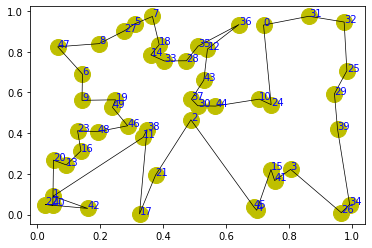

step:3750/5000, actic loss:0.534, critic loss:2.850, L:9.310, 0min2sec
step:3751/5000, actic loss:0.535, critic loss:2.849, L:9.309, 0min2sec
step:3752/5000, actic loss:0.535, critic loss:2.849, L:9.309, 0min2sec
step:3753/5000, actic loss:0.536, critic loss:2.848, L:9.308, 0min1sec
step:3754/5000, actic loss:0.536, critic loss:2.847, L:9.308, 0min1sec
distance:6.864
tensor([24,  1, 26,  0, 46, 12, 14, 13, 33, 22,  8, 43, 41,  2,  7, 49, 45, 30,
        29, 35, 16, 23,  3, 11, 17, 21, 18, 27, 36, 19, 20, 31, 32, 28,  4, 10,
        47, 40,  5, 48,  6, 39, 38, 25, 42, 34, 44, 15,  9, 37])


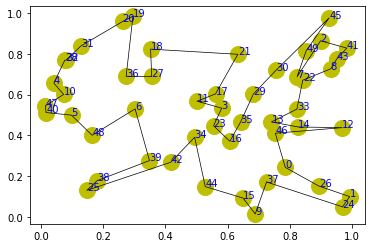

step:3755/5000, actic loss:0.536, critic loss:2.847, L:9.307, 0min1sec
step:3756/5000, actic loss:0.535, critic loss:2.846, L:9.306, 0min1sec
step:3757/5000, actic loss:0.535, critic loss:2.845, L:9.306, 0min1sec
step:3758/5000, actic loss:0.534, critic loss:2.845, L:9.305, 0min1sec
step:3759/5000, actic loss:0.534, critic loss:2.844, L:9.305, 0min1sec
distance:7.210
tensor([20, 41, 36,  7, 32,  3, 42, 25,  5, 16, 23, 13, 18, 35,  9, 49, 34, 31,
        11, 38,  0, 30, 29, 48, 15,  1, 21, 27, 14,  6, 22, 12, 33,  4, 44, 10,
        43, 26, 47, 28, 17, 40, 39, 19, 24, 45,  2, 46,  8, 37])


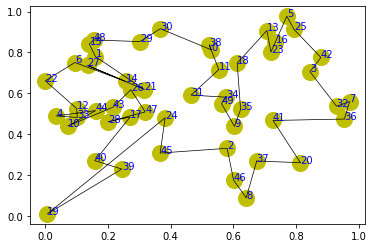

step:3760/5000, actic loss:0.534, critic loss:2.843, L:9.304, 0min1sec
step:3761/5000, actic loss:0.534, critic loss:2.842, L:9.303, 0min1sec
step:3762/5000, actic loss:0.534, critic loss:2.842, L:9.303, 0min1sec
step:3763/5000, actic loss:0.534, critic loss:2.841, L:9.302, 0min1sec
step:3764/5000, actic loss:0.533, critic loss:2.840, L:9.302, 0min1sec
distance:7.267
tensor([ 8, 22,  9, 13, 36, 29, 18, 38, 24, 39, 28, 37, 31, 48, 45,  1, 26,  5,
         3, 32, 17, 20, 40,  4,  2, 44, 35, 16, 41, 15, 43,  0, 27, 14, 11,  7,
        10, 30, 23, 12,  6, 47, 46, 42, 34, 21, 33, 25, 19, 49])


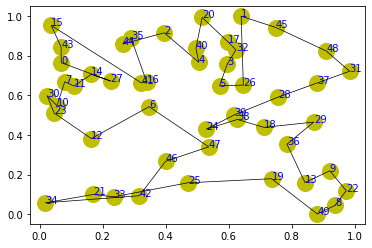

step:3765/5000, actic loss:0.533, critic loss:2.840, L:9.301, 0min2sec
step:3766/5000, actic loss:0.532, critic loss:2.839, L:9.300, 0min1sec
step:3767/5000, actic loss:0.532, critic loss:2.838, L:9.300, 0min2sec
step:3768/5000, actic loss:0.532, critic loss:2.838, L:9.299, 0min2sec
step:3769/5000, actic loss:0.533, critic loss:2.837, L:9.299, 0min1sec
distance:6.681
tensor([41, 12, 33, 36, 30, 35, 19, 24, 32, 25,  4,  3, 31, 10,  8, 21, 47, 18,
         2, 43, 15, 40, 29, 48, 45, 11, 39, 16, 14, 38,  9, 26, 28, 23, 22,  0,
        46, 34,  6, 13,  7, 17, 20,  5, 27, 44,  1, 49, 37, 42])


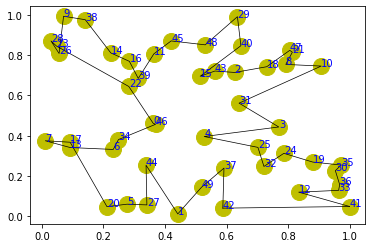

step:3770/5000, actic loss:0.533, critic loss:2.836, L:9.298, 0min2sec
step:3771/5000, actic loss:0.533, critic loss:2.836, L:9.297, 0min1sec
step:3772/5000, actic loss:0.533, critic loss:2.835, L:9.297, 0min1sec
step:3773/5000, actic loss:0.533, critic loss:2.834, L:9.296, 0min1sec
step:3774/5000, actic loss:0.532, critic loss:2.834, L:9.295, 0min1sec
distance:6.534
tensor([11, 30, 12, 36, 21, 43,  2, 47, 20, 38, 35, 26, 39, 25, 40,  7, 10, 48,
        44, 17,  9, 15,  5, 49, 37, 46, 33, 27, 19, 22, 32, 42, 16, 23, 18, 24,
         6,  3, 34, 31, 41, 29,  1,  4, 14,  0, 45, 13,  8, 28])


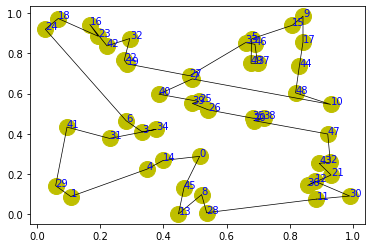

step:3775/5000, actic loss:0.531, critic loss:2.833, L:9.295, 0min2sec
step:3776/5000, actic loss:0.531, critic loss:2.832, L:9.294, 0min1sec
step:3777/5000, actic loss:0.530, critic loss:2.832, L:9.293, 0min1sec
step:3778/5000, actic loss:0.530, critic loss:2.831, L:9.293, 0min1sec
step:3779/5000, actic loss:0.530, critic loss:2.830, L:9.292, 0min1sec
distance:7.461
tensor([ 3, 13, 48, 45,  2, 30, 24, 31, 34, 35, 27,  7, 22, 46, 25,  4, 14, 36,
        32, 17, 20, 47,  5, 15, 49, 26,  9, 18, 16, 19, 11, 12, 39,  6, 38, 40,
        41, 43,  1, 44, 28,  0, 33, 10, 21, 23, 37, 29,  8, 42])


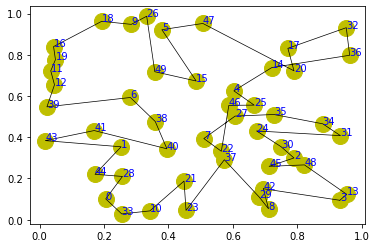

step:3780/5000, actic loss:0.530, critic loss:2.830, L:9.292, 0min1sec
step:3781/5000, actic loss:0.530, critic loss:2.829, L:9.291, 0min1sec
step:3782/5000, actic loss:0.529, critic loss:2.828, L:9.290, 0min1sec
step:3783/5000, actic loss:0.529, critic loss:2.827, L:9.290, 0min1sec
step:3784/5000, actic loss:0.529, critic loss:2.827, L:9.289, 0min1sec
distance:6.978
tensor([31, 46,  7, 24, 44, 48, 22, 41,  9, 26, 23, 37, 34, 27, 21,  2, 36, 14,
         1,  0, 20, 13, 11, 29, 49, 17, 33,  4, 39, 10, 47, 32, 35, 45, 30,  3,
         5, 15, 19, 16, 12, 28, 42,  6, 18, 43, 25,  8, 40, 38])


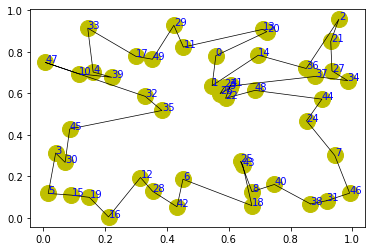

step:3785/5000, actic loss:0.529, critic loss:2.826, L:9.289, 0min2sec
step:3786/5000, actic loss:0.529, critic loss:2.825, L:9.288, 0min2sec
step:3787/5000, actic loss:0.528, critic loss:2.825, L:9.287, 0min1sec
step:3788/5000, actic loss:0.528, critic loss:2.824, L:9.287, 0min1sec
step:3789/5000, actic loss:0.528, critic loss:2.823, L:9.286, 0min1sec
distance:6.653
tensor([10, 43, 42, 28, 46,  5, 24,  6, 36, 14, 18, 49,  3, 25, 17, 33, 16, 19,
         7,  8, 40, 20, 27,  1, 38, 11, 32, 26, 47,  0, 29, 41, 30, 13, 31, 44,
        37, 12, 35, 15, 22,  4,  9, 21, 48, 34, 45,  2, 23, 39])


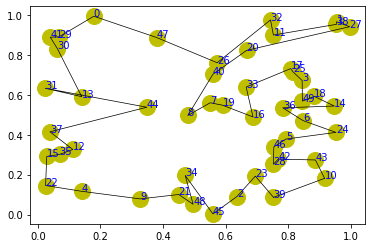

step:3790/5000, actic loss:0.528, critic loss:2.823, L:9.286, 0min2sec
step:3791/5000, actic loss:0.528, critic loss:2.822, L:9.285, 0min1sec
step:3792/5000, actic loss:0.528, critic loss:2.821, L:9.284, 0min1sec
step:3793/5000, actic loss:0.527, critic loss:2.821, L:9.284, 0min1sec
step:3794/5000, actic loss:0.527, critic loss:2.820, L:9.283, 0min1sec
distance:7.276
tensor([47,  3, 30,  1, 12, 34, 17,  8, 11, 15, 40, 31, 20, 35,  9, 32, 43, 33,
        26, 27,  0, 14, 45, 23,  2, 38, 36, 39, 41, 19, 46, 21, 25, 18, 29, 48,
         7, 22, 44,  5,  6, 16,  4, 28, 37, 42, 49, 13, 24, 10])


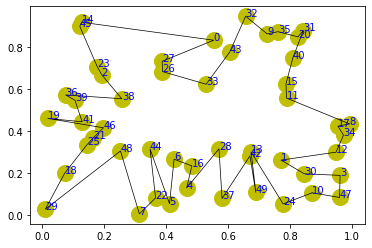

step:3795/5000, actic loss:0.526, critic loss:2.819, L:9.283, 0min2sec
step:3796/5000, actic loss:0.527, critic loss:2.819, L:9.282, 0min1sec
step:3797/5000, actic loss:0.527, critic loss:2.818, L:9.282, 0min1sec
step:3798/5000, actic loss:0.527, critic loss:2.817, L:9.281, 0min1sec
step:3799/5000, actic loss:0.528, critic loss:2.817, L:9.281, 0min2sec
distance:6.948
tensor([48, 13, 33,  9, 27, 18,  0,  7, 31, 17, 21, 49,  6, 41, 34, 15, 44, 40,
         8, 20, 37, 24, 29, 28, 23,  2, 45, 22, 46, 43, 12,  5, 35, 16, 19,  3,
        32, 38, 36,  1, 39,  4, 42, 47, 26, 25, 10, 11, 30, 14])


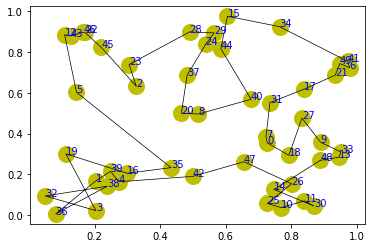

step:3800/5000, actic loss:0.527, critic loss:2.816, L:9.280, 0min2sec
step:3801/5000, actic loss:0.527, critic loss:2.815, L:9.279, 0min1sec
step:3802/5000, actic loss:0.527, critic loss:2.815, L:9.279, 0min1sec
step:3803/5000, actic loss:0.527, critic loss:2.814, L:9.278, 0min1sec
step:3804/5000, actic loss:0.527, critic loss:2.813, L:9.278, 0min1sec
distance:7.413
tensor([ 4,  2, 38, 43,  9, 46, 20, 22, 34, 11, 48, 40, 10, 31, 44, 32, 47, 35,
        28,  5, 29, 41, 16, 49, 27, 39,  6, 12, 30, 19, 45, 21, 15, 25, 24, 37,
        36, 33, 42, 17,  0,  8, 26,  7, 18, 14,  1,  3, 23, 13])


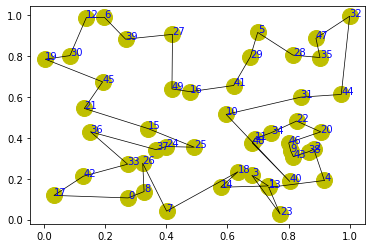

step:3805/5000, actic loss:0.526, critic loss:2.813, L:9.277, 0min2sec
step:3806/5000, actic loss:0.526, critic loss:2.812, L:9.277, 0min1sec
step:3807/5000, actic loss:0.526, critic loss:2.811, L:9.276, 0min1sec
step:3808/5000, actic loss:0.526, critic loss:2.811, L:9.275, 0min1sec
step:3809/5000, actic loss:0.525, critic loss:2.810, L:9.275, 0min1sec
distance:7.237
tensor([ 7, 16, 21, 29, 25, 33, 42,  0, 43, 13,  9, 34, 20, 32,  4, 31, 12, 18,
        49, 30, 10, 41, 35,  6,  5, 45, 11, 37, 14, 26,  1, 19, 48, 23, 24, 15,
         3, 17, 47, 28, 46, 39, 38, 22, 36,  2, 40, 27, 44,  8])


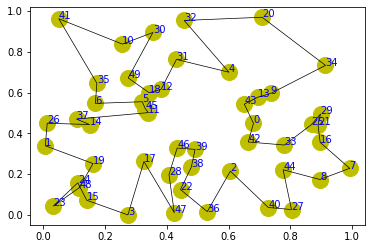

step:3810/5000, actic loss:0.525, critic loss:2.809, L:9.274, 0min1sec
step:3811/5000, actic loss:0.525, critic loss:2.809, L:9.274, 0min1sec
step:3812/5000, actic loss:0.525, critic loss:2.808, L:9.273, 0min1sec
step:3813/5000, actic loss:0.525, critic loss:2.807, L:9.273, 0min1sec
step:3814/5000, actic loss:0.525, critic loss:2.807, L:9.272, 0min1sec
distance:6.948
tensor([18, 40, 16, 27, 15,  6,  7, 33, 10, 35, 14,  5, 12, 43,  4,  9,  1,  2,
        11, 44, 13, 47, 36, 28, 48, 34, 32, 24, 26, 25, 22,  0, 31, 45, 37, 46,
        20, 30, 38, 23, 21, 19, 39, 29,  3, 42, 41, 17, 49,  8])


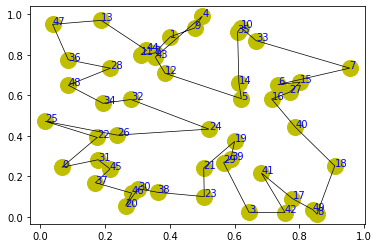

step:3815/5000, actic loss:0.524, critic loss:2.806, L:9.271, 0min2sec
step:3816/5000, actic loss:0.523, critic loss:2.805, L:9.271, 0min2sec
step:3817/5000, actic loss:0.523, critic loss:2.805, L:9.270, 0min2sec
step:3818/5000, actic loss:0.522, critic loss:2.804, L:9.270, 0min1sec
step:3819/5000, actic loss:0.523, critic loss:2.803, L:9.269, 0min1sec
distance:7.189
tensor([45, 11, 39, 38, 26, 20, 18, 17, 34, 29, 35,  5,  7, 25, 46,  3, 42, 13,
        47,  1, 48, 14, 12, 15, 16, 28, 21, 23,  0, 27, 44, 19,  2, 43, 10, 33,
        41, 31,  9, 36, 22,  8,  4, 32, 49, 24, 37, 30,  6, 40])


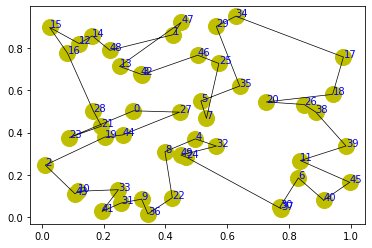

step:3820/5000, actic loss:0.523, critic loss:2.803, L:9.268, 0min2sec
step:3821/5000, actic loss:0.523, critic loss:2.802, L:9.268, 0min1sec
step:3822/5000, actic loss:0.523, critic loss:2.801, L:9.267, 0min1sec
step:3823/5000, actic loss:0.523, critic loss:2.801, L:9.267, 0min1sec
step:3824/5000, actic loss:0.522, critic loss:2.800, L:9.266, 0min1sec
distance:6.319
tensor([46, 36, 21, 42,  1, 38, 45,  8, 47,  6, 15,  4, 11, 31, 12, 10, 37, 33,
        29, 17,  7,  9, 41, 18, 43, 26, 44, 35, 28, 25,  3, 40, 27, 20, 49, 13,
        24, 34,  5, 16, 14, 30, 19, 48, 23,  2, 39, 32, 22,  0])


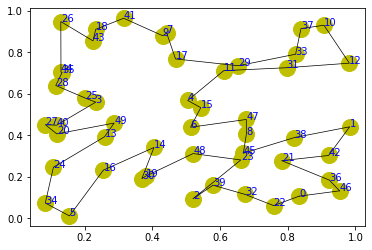

step:3825/5000, actic loss:0.522, critic loss:2.799, L:9.265, 0min2sec
step:3826/5000, actic loss:0.522, critic loss:2.799, L:9.265, 0min1sec
step:3827/5000, actic loss:0.522, critic loss:2.798, L:9.264, 0min1sec
step:3828/5000, actic loss:0.522, critic loss:2.797, L:9.264, 0min1sec
step:3829/5000, actic loss:0.522, critic loss:2.797, L:9.263, 0min2sec
distance:6.530
tensor([ 3,  7, 40, 15, 46,  5, 39, 19, 23, 12, 10, 38, 34, 42,  9, 18, 30, 32,
        14, 45, 35, 21, 20, 16, 29, 48, 36, 25, 43,  8,  4, 47,  0, 26, 49, 13,
        27, 37, 11, 31,  2,  6, 44, 33, 17,  1, 22, 41, 28, 24])


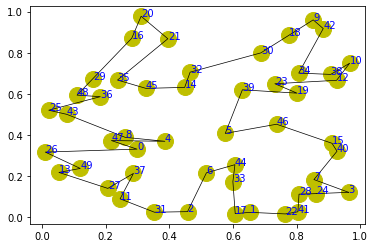

step:3830/5000, actic loss:0.522, critic loss:2.796, L:9.262, 0min2sec
step:3831/5000, actic loss:0.522, critic loss:2.795, L:9.262, 0min1sec
step:3832/5000, actic loss:0.522, critic loss:2.795, L:9.261, 0min1sec
step:3833/5000, actic loss:0.521, critic loss:2.794, L:9.261, 0min1sec
step:3834/5000, actic loss:0.521, critic loss:2.793, L:9.260, 0min1sec
distance:6.381
tensor([21, 14, 36, 24, 30, 25, 46, 41, 48, 10, 12,  3, 13, 27, 44,  8, 32, 35,
         1, 33,  4, 34, 20, 40, 45,  7, 31,  9, 47,  0, 39, 28, 43, 18, 11, 23,
        49, 16,  5,  2, 17, 29, 42, 37, 22, 19, 38, 15,  6, 26])


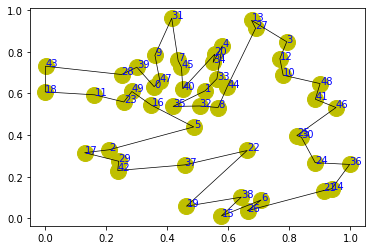

step:3835/5000, actic loss:0.521, critic loss:2.793, L:9.259, 0min1sec
step:3836/5000, actic loss:0.521, critic loss:2.792, L:9.259, 0min1sec
step:3837/5000, actic loss:0.521, critic loss:2.791, L:9.258, 0min1sec
step:3838/5000, actic loss:0.521, critic loss:2.791, L:9.257, 0min1sec
step:3839/5000, actic loss:0.521, critic loss:2.790, L:9.257, 0min1sec
distance:6.969
tensor([29,  1, 32,  2, 28, 12, 37, 40, 36,  9, 19, 15, 48, 27, 45, 42, 11, 46,
        44, 35, 21, 39, 49, 30, 14,  8, 31,  3, 25,  4, 20, 24,  7, 13,  6,  0,
        10, 23, 33, 34, 43, 47,  5, 41, 17, 38, 16, 18, 26, 22])


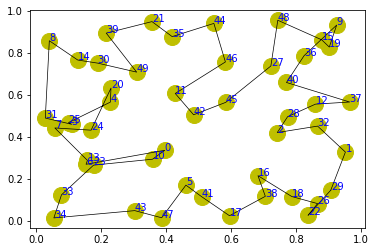

step:3840/5000, actic loss:0.521, critic loss:2.789, L:9.256, 0min2sec
step:3841/5000, actic loss:0.520, critic loss:2.789, L:9.256, 0min1sec
step:3842/5000, actic loss:0.520, critic loss:2.788, L:9.255, 0min1sec
step:3843/5000, actic loss:0.520, critic loss:2.787, L:9.254, 0min2sec
step:3844/5000, actic loss:0.520, critic loss:2.787, L:9.254, 0min2sec
distance:7.499
tensor([ 6, 11, 48, 45, 19, 22, 49,  3, 26, 13, 14, 12, 32, 41, 43, 18, 17, 34,
        23, 36, 40, 39, 24, 42, 29, 35,  0, 15,  9, 46, 37, 27, 31, 30, 25,  8,
         7, 47, 16, 33, 10, 21,  4, 44,  5,  1,  2, 28, 38, 20])


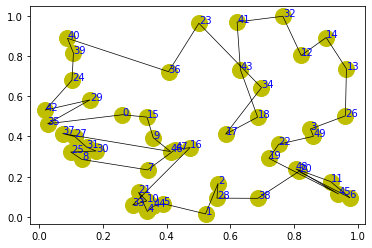

step:3845/5000, actic loss:0.520, critic loss:2.786, L:9.253, 0min2sec
step:3846/5000, actic loss:0.520, critic loss:2.785, L:9.253, 0min1sec
step:3847/5000, actic loss:0.520, critic loss:2.785, L:9.252, 0min1sec
step:3848/5000, actic loss:0.519, critic loss:2.784, L:9.251, 0min1sec
step:3849/5000, actic loss:0.519, critic loss:2.783, L:9.251, 0min1sec
distance:7.309
tensor([20, 23, 34,  1, 49, 36, 27, 39, 14, 45, 13, 19, 37, 10,  6, 40, 42, 18,
        41, 15,  5, 46, 26, 43,  9,  2,  7, 32, 48, 24, 38, 11, 31, 21, 30, 16,
        35,  0, 44, 22, 25, 47,  3, 33,  4, 28,  8, 12, 17, 29])


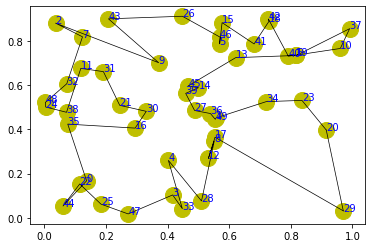

step:3850/5000, actic loss:0.518, critic loss:2.783, L:9.250, 0min1sec
step:3851/5000, actic loss:0.518, critic loss:2.782, L:9.250, 0min1sec
step:3852/5000, actic loss:0.518, critic loss:2.781, L:9.249, 0min1sec
step:3853/5000, actic loss:0.519, critic loss:2.781, L:9.248, 0min1sec
step:3854/5000, actic loss:0.519, critic loss:2.780, L:9.248, 0min1sec
distance:6.326
tensor([11, 25, 49, 13, 47, 46, 16, 12,  3, 35, 43, 24, 30, 22, 37,  9, 45, 34,
        23, 33, 44, 10, 32, 31, 38, 41, 20, 27, 39,  2,  1,  6,  7, 40, 26, 36,
         4, 18, 42, 29, 14, 19, 15,  5, 48, 17,  8,  0, 21, 28])


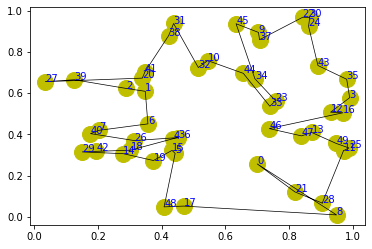

step:3855/5000, actic loss:0.519, critic loss:2.780, L:9.247, 0min1sec
step:3856/5000, actic loss:0.519, critic loss:2.779, L:9.247, 0min1sec
step:3857/5000, actic loss:0.519, critic loss:2.778, L:9.246, 0min1sec
step:3858/5000, actic loss:0.519, critic loss:2.778, L:9.246, 0min1sec
step:3859/5000, actic loss:0.518, critic loss:2.777, L:9.245, 0min1sec
distance:6.924
tensor([16, 21, 18, 45, 13, 34, 28, 29, 44, 32, 20,  3, 49, 37, 31, 25, 24, 15,
        23, 35, 41, 14, 48,  2, 46, 26, 27, 22, 47,  1, 11,  6, 38, 42,  5, 43,
        19, 10,  9,  4,  8,  0, 17, 33, 30, 36, 39, 12,  7, 40])


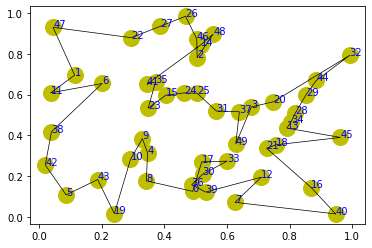

step:3860/5000, actic loss:0.518, critic loss:2.776, L:9.244, 0min2sec
step:3861/5000, actic loss:0.518, critic loss:2.776, L:9.244, 0min1sec
step:3862/5000, actic loss:0.518, critic loss:2.775, L:9.243, 0min1sec
step:3863/5000, actic loss:0.518, critic loss:2.774, L:9.243, 0min1sec
step:3864/5000, actic loss:0.517, critic loss:2.774, L:9.242, 0min1sec
distance:6.871
tensor([ 6, 33, 12, 37, 27, 19, 26, 41, 13,  2, 46, 45, 24, 48, 36,  3, 35,  8,
        34,  4, 31,  7, 20, 38, 29, 42,  1, 10, 21,  0, 39, 43, 23, 18, 47, 14,
         9, 28, 11,  5, 40, 22, 49, 16, 32, 17, 15, 30, 44, 25])


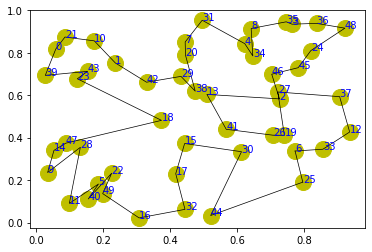

step:3865/5000, actic loss:0.517, critic loss:2.773, L:9.242, 0min1sec
step:3866/5000, actic loss:0.517, critic loss:2.772, L:9.241, 0min1sec
step:3867/5000, actic loss:0.517, critic loss:2.772, L:9.240, 0min1sec
step:3868/5000, actic loss:0.517, critic loss:2.771, L:9.240, 0min1sec
step:3869/5000, actic loss:0.517, critic loss:2.770, L:9.239, 0min1sec
distance:7.755
tensor([ 9, 28, 16, 10, 29, 25, 12, 37, 13,  7, 20, 45, 49, 23, 46, 17, 33, 24,
        26, 18, 39, 27, 36, 11,  1,  6, 47, 48, 34, 22,  0,  5, 35, 31,  3, 40,
        32, 41, 38,  2, 19, 42, 21, 44,  8,  4, 30, 14, 43, 15])


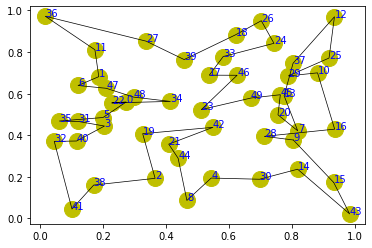

step:3870/5000, actic loss:0.516, critic loss:2.770, L:9.239, 0min2sec
step:3871/5000, actic loss:0.516, critic loss:2.769, L:9.238, 0min2sec
step:3872/5000, actic loss:0.515, critic loss:2.769, L:9.238, 0min1sec
step:3873/5000, actic loss:0.515, critic loss:2.768, L:9.237, 0min1sec
step:3874/5000, actic loss:0.516, critic loss:2.767, L:9.237, 0min1sec
distance:6.931
tensor([13, 39, 12, 22,  6,  7, 11, 16, 49, 34, 18,  0,  8, 25, 14, 29, 46, 28,
        19, 42, 48, 33, 15,  9, 24, 20, 10, 43, 23, 37,  3,  4, 45, 35, 17, 30,
        21, 41, 38, 26,  5, 44, 32, 27, 40, 31, 36, 47,  2,  1])


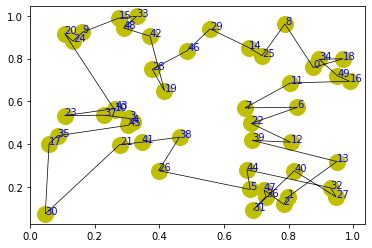

step:3875/5000, actic loss:0.516, critic loss:2.767, L:9.236, 0min2sec
step:3876/5000, actic loss:0.516, critic loss:2.766, L:9.236, 0min1sec
step:3877/5000, actic loss:0.516, critic loss:2.765, L:9.235, 0min1sec
step:3878/5000, actic loss:0.515, critic loss:2.765, L:9.235, 0min1sec
step:3879/5000, actic loss:0.515, critic loss:2.764, L:9.234, 0min1sec
distance:6.877
tensor([26, 29, 36, 11,  8, 19, 37, 18, 15,  0, 41, 12,  6, 49, 31, 45, 23,  3,
        32, 44,  4, 30, 20, 40, 47, 42,  7, 39, 22, 27, 28, 17, 43, 35,  2, 46,
        10, 24, 14, 38, 33, 48, 25, 34, 21,  9,  1, 13, 16,  5])


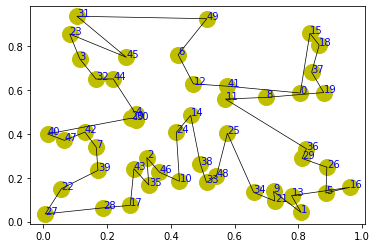

step:3880/5000, actic loss:0.515, critic loss:2.764, L:9.234, 0min2sec
step:3881/5000, actic loss:0.515, critic loss:2.763, L:9.233, 0min1sec
step:3882/5000, actic loss:0.515, critic loss:2.762, L:9.233, 0min1sec
step:3883/5000, actic loss:0.515, critic loss:2.762, L:9.232, 0min1sec
step:3884/5000, actic loss:0.515, critic loss:2.761, L:9.232, 0min1sec
distance:7.592
tensor([ 5, 15, 36, 39, 40,  8, 35, 19, 48, 25,  0,  4,  9, 23,  7, 34,  2, 29,
        13, 27, 41, 49, 44, 14, 38, 42, 43, 20, 33, 17, 45, 24, 10, 26, 30,  3,
        11, 31, 37, 28,  1, 32, 22, 47, 21, 12, 46, 18, 16,  6])


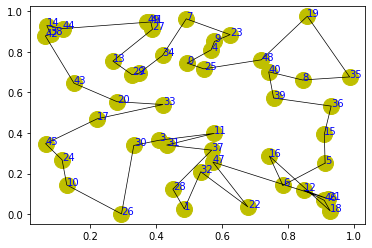

step:3885/5000, actic loss:0.514, critic loss:2.760, L:9.231, 0min2sec
step:3886/5000, actic loss:0.514, critic loss:2.760, L:9.231, 0min1sec
step:3887/5000, actic loss:0.513, critic loss:2.759, L:9.230, 0min1sec
step:3888/5000, actic loss:0.513, critic loss:2.759, L:9.230, 0min1sec
step:3889/5000, actic loss:0.513, critic loss:2.758, L:9.229, 0min1sec
distance:7.633
tensor([ 0, 14, 49, 48, 31, 29, 35, 33, 45, 26, 11, 25,  4, 19, 34, 17, 42, 43,
        12, 40, 22, 21, 46, 37, 39, 27, 36,  6, 28,  3,  1,  9, 38,  8, 47, 16,
        10,  7, 30, 24, 13, 44, 23, 20, 18, 15,  5, 41, 32,  2])


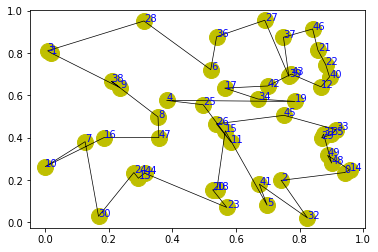

step:3890/5000, actic loss:0.513, critic loss:2.757, L:9.229, 0min1sec
step:3891/5000, actic loss:0.513, critic loss:2.757, L:9.228, 0min1sec
step:3892/5000, actic loss:0.512, critic loss:2.756, L:9.227, 0min1sec
step:3893/5000, actic loss:0.512, critic loss:2.755, L:9.227, 0min1sec
step:3894/5000, actic loss:0.512, critic loss:2.755, L:9.226, 0min1sec
distance:6.746
tensor([ 9, 33, 40, 23, 34,  7, 38,  1, 17, 49,  0, 28, 31, 16, 41, 29, 11, 42,
        47, 46, 26, 13, 25,  3, 43, 21, 35, 45, 44, 14,  8, 32,  5, 37, 22, 48,
         2, 10, 15, 39,  4, 30, 19, 24, 36,  6, 12, 20, 18, 27])


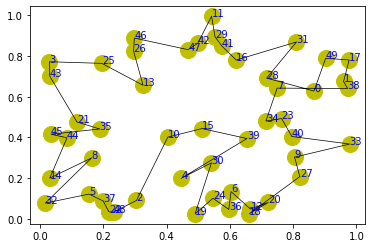

step:3895/5000, actic loss:0.512, critic loss:2.754, L:9.226, 0min2sec
step:3896/5000, actic loss:0.511, critic loss:2.753, L:9.225, 0min1sec
step:3897/5000, actic loss:0.510, critic loss:2.753, L:9.225, 0min1sec
step:3898/5000, actic loss:0.510, critic loss:2.752, L:9.224, 0min1sec
step:3899/5000, actic loss:0.510, critic loss:2.752, L:9.224, 0min1sec
distance:7.644
tensor([18, 25, 47,  2,  1, 14, 37, 31, 48, 44, 46, 20, 15, 12, 21, 23,  9, 36,
        19,  7, 10, 27, 49,  0, 30, 26,  3, 41, 17, 40, 45, 42, 28,  6, 35, 11,
        38, 32, 24, 29, 34,  5,  8, 33, 39, 13, 16, 43,  4, 22])


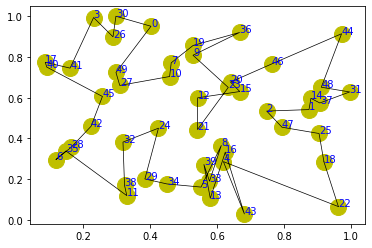

step:3900/5000, actic loss:0.510, critic loss:2.751, L:9.223, 0min2sec
step:3901/5000, actic loss:0.509, critic loss:2.750, L:9.222, 0min1sec
step:3902/5000, actic loss:0.510, critic loss:2.750, L:9.222, 0min1sec
step:3903/5000, actic loss:0.510, critic loss:2.749, L:9.221, 0min1sec
step:3904/5000, actic loss:0.510, critic loss:2.748, L:9.221, 0min1sec
distance:7.105
tensor([30, 47, 18,  3, 44,  4, 21, 36,  9,  1, 48, 10, 22, 12, 20, 13,  2, 16,
        46,  5, 45, 32,  6, 11, 35,  7, 17, 31, 49, 39, 34, 25, 40, 26, 41, 42,
        27, 24, 15, 29, 38, 43, 14, 23, 28,  0, 33,  8, 19, 37])


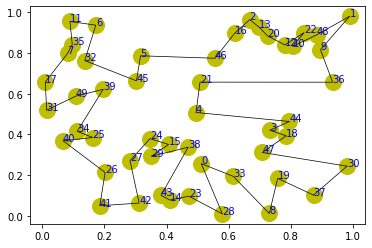

step:3905/5000, actic loss:0.509, critic loss:2.748, L:9.220, 0min1sec
step:3906/5000, actic loss:0.508, critic loss:2.747, L:9.220, 0min1sec
step:3907/5000, actic loss:0.507, critic loss:2.746, L:9.219, 0min1sec
step:3908/5000, actic loss:0.507, critic loss:2.746, L:9.219, 0min1sec
step:3909/5000, actic loss:0.506, critic loss:2.745, L:9.218, 0min1sec
distance:6.841
tensor([42, 47, 39, 18, 24, 32, 23, 44, 35, 14, 36, 41, 48, 45,  7, 11, 16, 37,
         0, 46, 34, 49,  2, 29,  8, 15, 30,  4,  1, 40, 21, 10, 17, 20, 28,  9,
        19, 38,  3, 12,  6, 25, 13, 33, 27, 26,  5, 31, 22, 43])


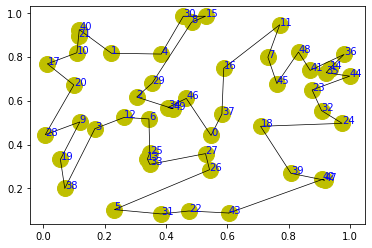

step:3910/5000, actic loss:0.507, critic loss:2.745, L:9.217, 0min1sec
step:3911/5000, actic loss:0.508, critic loss:2.744, L:9.217, 0min1sec
step:3912/5000, actic loss:0.508, critic loss:2.743, L:9.216, 0min1sec
step:3913/5000, actic loss:0.509, critic loss:2.743, L:9.216, 0min1sec
step:3914/5000, actic loss:0.509, critic loss:2.742, L:9.215, 0min1sec
distance:6.393
tensor([ 1, 32, 35, 20, 45, 14, 34, 31, 39, 47, 27, 37,  0, 13, 49, 43, 26, 18,
         9, 44,  5, 15, 10, 24,  6, 38, 41, 33, 29, 40, 36, 21, 16, 23, 46, 30,
        12, 19, 17,  7, 28, 42, 11, 48,  2, 22,  4,  3,  8, 25])


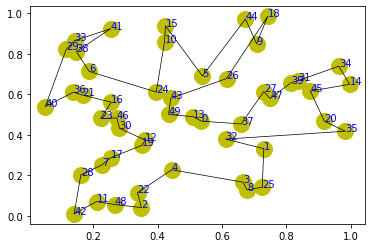

step:3915/5000, actic loss:0.509, critic loss:2.742, L:9.215, 0min2sec
step:3916/5000, actic loss:0.508, critic loss:2.741, L:9.214, 0min1sec
step:3917/5000, actic loss:0.508, critic loss:2.740, L:9.213, 0min2sec
step:3918/5000, actic loss:0.507, critic loss:2.740, L:9.213, 0min2sec
step:3919/5000, actic loss:0.507, critic loss:2.739, L:9.212, 0min1sec
distance:6.980
tensor([36, 39, 29, 19, 25, 17,  1,  7, 40, 27, 31, 13, 12, 20, 14, 48,  8,  9,
        32, 41,  2,  4, 35, 43, 26, 23, 30,  6, 34, 33, 44, 15, 28, 38, 10, 16,
        37, 49, 22,  3,  0, 45, 46, 47, 11, 42,  5, 18, 21, 24])


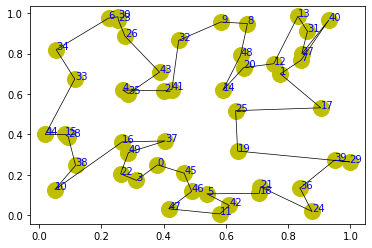

step:3920/5000, actic loss:0.507, critic loss:2.738, L:9.212, 0min2sec
step:3921/5000, actic loss:0.508, critic loss:2.738, L:9.211, 0min1sec
step:3922/5000, actic loss:0.508, critic loss:2.737, L:9.211, 0min1sec
step:3923/5000, actic loss:0.508, critic loss:2.736, L:9.210, 0min1sec
step:3924/5000, actic loss:0.508, critic loss:2.736, L:9.210, 0min1sec
distance:7.005
tensor([32,  2,  3, 16, 27, 19, 41, 49, 29, 36,  5, 33, 45,  8, 39, 18, 43,  6,
        37,  7, 12, 42, 48, 28, 13, 40, 47,  1, 10, 31, 20, 17, 22, 25, 21, 14,
        44, 11, 34, 26,  9, 35, 46, 15,  0, 24, 38, 23,  4, 30])


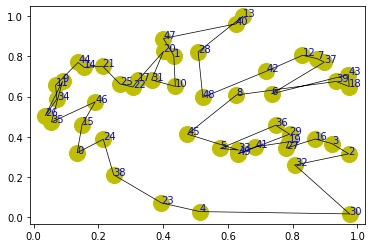

step:3925/5000, actic loss:0.507, critic loss:2.735, L:9.209, 0min1sec
step:3926/5000, actic loss:0.507, critic loss:2.735, L:9.208, 0min1sec
step:3927/5000, actic loss:0.507, critic loss:2.734, L:9.208, 0min1sec
step:3928/5000, actic loss:0.507, critic loss:2.733, L:9.207, 0min1sec
step:3929/5000, actic loss:0.507, critic loss:2.733, L:9.207, 0min1sec
distance:7.355
tensor([42, 36, 37, 19, 25,  1, 30, 17, 13, 21, 33, 24, 43, 39, 45,  9, 32,  0,
        11, 29, 49,  7, 41, 20, 46, 44, 35, 22, 16, 38,  3, 40,  8, 48, 18, 31,
        14,  6, 23,  5,  4, 28, 12, 47, 15,  2, 10, 34, 26, 27])


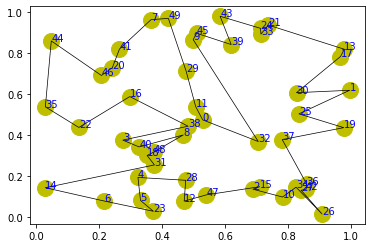

step:3930/5000, actic loss:0.506, critic loss:2.732, L:9.206, 0min2sec
step:3931/5000, actic loss:0.506, critic loss:2.731, L:9.206, 0min1sec
step:3932/5000, actic loss:0.505, critic loss:2.731, L:9.205, 0min2sec
step:3933/5000, actic loss:0.505, critic loss:2.730, L:9.204, 0min1sec
step:3934/5000, actic loss:0.505, critic loss:2.729, L:9.204, 0min1sec
distance:6.625
tensor([22, 19,  7, 33, 39, 24, 34, 11, 12, 32, 17,  8,  9, 16, 28,  2, 15, 46,
        44, 47, 10, 45,  5, 18, 38,  0, 26, 36, 35, 40, 48, 43,  1,  4, 37, 41,
        13,  6, 25, 20, 23, 27,  3, 31, 14, 21, 42, 29, 49, 30])


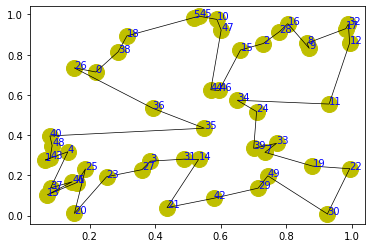

step:3935/5000, actic loss:0.505, critic loss:2.729, L:9.203, 0min1sec
step:3936/5000, actic loss:0.505, critic loss:2.728, L:9.203, 0min1sec
step:3937/5000, actic loss:0.504, critic loss:2.727, L:9.202, 0min1sec
step:3938/5000, actic loss:0.505, critic loss:2.727, L:9.202, 0min1sec
step:3939/5000, actic loss:0.504, critic loss:2.726, L:9.201, 0min1sec
distance:7.211
tensor([28, 11, 38, 24, 40, 46,  9, 15,  8,  3, 26, 20, 30, 31, 17,  7, 32, 10,
         2, 47,  0, 36, 49, 43,  5,  1,  6, 21, 27, 16, 42, 13, 35, 23,  4, 45,
        19, 44, 29, 48, 18, 14, 41, 37, 34, 12, 33, 25, 22, 39])


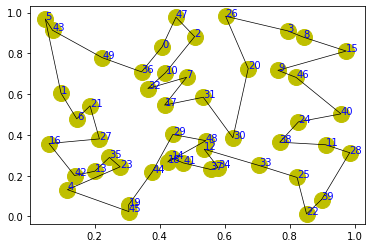

step:3940/5000, actic loss:0.504, critic loss:2.726, L:9.200, 0min1sec
step:3941/5000, actic loss:0.504, critic loss:2.725, L:9.200, 0min1sec
step:3942/5000, actic loss:0.503, critic loss:2.724, L:9.199, 0min1sec
step:3943/5000, actic loss:0.503, critic loss:2.724, L:9.199, 0min2sec
step:3944/5000, actic loss:0.503, critic loss:2.723, L:9.198, 0min2sec
distance:7.691
tensor([20, 34, 16, 27, 18,  9,  3, 47, 32, 21,  0, 11, 12, 17,  1, 36, 10, 29,
        15, 44, 40, 46, 31, 25, 33, 26,  2, 49, 14, 42, 22, 48, 35, 43, 13, 30,
        41, 23, 28,  8, 37, 19,  6,  4,  7,  5, 39, 45, 24, 38])


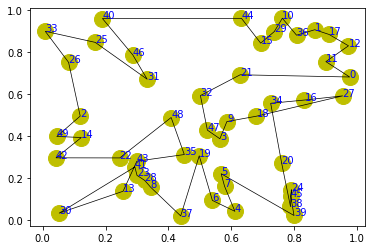

step:3945/5000, actic loss:0.503, critic loss:2.722, L:9.198, 0min2sec
step:3946/5000, actic loss:0.503, critic loss:2.722, L:9.197, 0min1sec
step:3947/5000, actic loss:0.502, critic loss:2.721, L:9.197, 0min1sec
step:3948/5000, actic loss:0.502, critic loss:2.721, L:9.196, 0min1sec
step:3949/5000, actic loss:0.501, critic loss:2.720, L:9.195, 0min1sec
distance:6.300
tensor([21,  1,  3, 30,  7, 20, 17, 38, 11, 35, 23, 16,  6, 27, 46,  9, 31, 14,
         8, 41, 28, 25, 37, 15,  5, 40, 24, 42, 10, 44, 22, 29, 48, 36, 43, 39,
         0, 18, 49, 26, 12, 13, 47,  4, 33, 32, 19,  2, 34, 45])


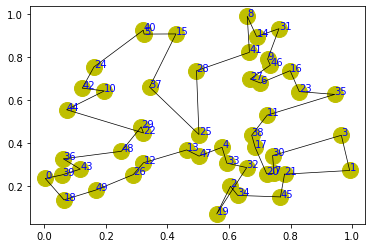

step:3950/5000, actic loss:0.502, critic loss:2.719, L:9.195, 0min1sec
step:3951/5000, actic loss:0.502, critic loss:2.719, L:9.194, 0min1sec
step:3952/5000, actic loss:0.503, critic loss:2.718, L:9.194, 0min1sec
step:3953/5000, actic loss:0.503, critic loss:2.717, L:9.193, 0min1sec
step:3954/5000, actic loss:0.503, critic loss:2.717, L:9.193, 0min1sec
distance:6.821
tensor([16,  4,  1, 28, 22, 25, 23, 39,  6,  5, 45, 15, 13, 21, 36, 37, 44, 43,
        24, 48, 41, 19, 14, 17, 18, 12, 42, 30, 20,  8, 35, 26, 46,  7,  9, 33,
        49, 10, 29,  3, 27,  2, 34, 11, 38,  0, 32, 47, 40, 31])


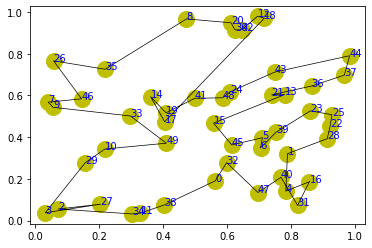

step:3955/5000, actic loss:0.502, critic loss:2.716, L:9.192, 0min2sec
step:3956/5000, actic loss:0.500, critic loss:2.716, L:9.192, 0min1sec
step:3957/5000, actic loss:0.499, critic loss:2.715, L:9.191, 0min1sec
step:3958/5000, actic loss:0.498, critic loss:2.714, L:9.190, 0min1sec
step:3959/5000, actic loss:0.497, critic loss:2.714, L:9.190, 0min1sec
distance:6.857
tensor([20, 40, 32, 24, 47, 34, 12,  2, 15, 11, 39, 27, 31,  0, 36, 35, 10, 29,
        41,  5, 14, 48, 38,  1, 22,  9, 33,  6,  3, 30, 25, 13, 49, 42, 44, 23,
        16, 28,  7, 43,  8, 18, 46, 17,  4, 21, 19, 26, 45, 37])


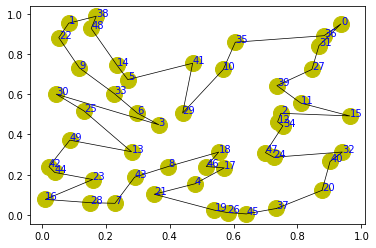

step:3960/5000, actic loss:0.497, critic loss:2.713, L:9.189, 0min2sec
step:3961/5000, actic loss:0.497, critic loss:2.713, L:9.189, 0min2sec
step:3962/5000, actic loss:0.497, critic loss:2.712, L:9.188, 0min1sec
step:3963/5000, actic loss:0.496, critic loss:2.711, L:9.188, 0min1sec
step:3964/5000, actic loss:0.496, critic loss:2.711, L:9.187, 0min1sec
distance:6.156
tensor([38,  2, 36, 30, 27, 35, 49, 46,  6, 13, 26,  9, 47, 32, 45, 48, 31, 25,
        43, 11, 41, 42,  0, 18, 24, 44, 39, 12, 33, 15, 34, 17,  8, 37,  1, 20,
        22,  7, 29, 28, 23, 19, 14,  3, 40,  4, 16, 21, 10,  5])


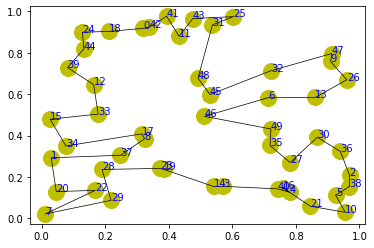

step:3965/5000, actic loss:0.496, critic loss:2.710, L:9.187, 0min2sec
step:3966/5000, actic loss:0.496, critic loss:2.709, L:9.186, 0min1sec
step:3967/5000, actic loss:0.496, critic loss:2.709, L:9.186, 0min1sec
step:3968/5000, actic loss:0.495, critic loss:2.708, L:9.185, 0min1sec
step:3969/5000, actic loss:0.495, critic loss:2.708, L:9.184, 0min1sec
distance:6.821
tensor([17, 33, 36, 38, 23, 11,  8, 19,  5, 27,  6, 10, 42,  2, 35, 20, 39, 30,
        37, 22, 48, 45, 15, 34,  0, 26, 47, 25,  1, 40,  3, 32,  4, 41, 46, 18,
        43, 44, 28, 21, 49, 24,  9, 31, 12, 16, 13, 14, 29,  7])


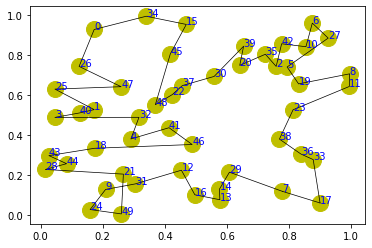

step:3970/5000, actic loss:0.495, critic loss:2.707, L:9.184, 0min2sec
step:3971/5000, actic loss:0.495, critic loss:2.706, L:9.183, 0min1sec
step:3972/5000, actic loss:0.495, critic loss:2.706, L:9.183, 0min1sec
step:3973/5000, actic loss:0.495, critic loss:2.705, L:9.182, 0min1sec
step:3974/5000, actic loss:0.494, critic loss:2.705, L:9.182, 0min2sec
distance:6.778
tensor([27, 22, 17, 47,  5,  6, 48, 21, 14,  9, 25, 11, 26, 42, 15, 43, 46, 36,
        30, 16, 35, 39, 38, 19, 20, 28, 23, 12, 37, 31,  2, 24, 49, 45, 33,  0,
        13, 41,  1, 44, 34, 18,  4, 10, 29,  7, 32, 40,  3,  8])


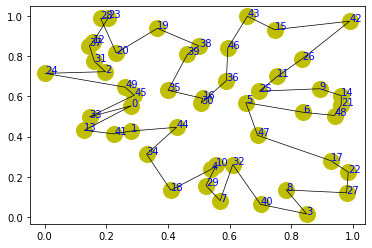

step:3975/5000, actic loss:0.493, critic loss:2.704, L:9.181, 0min2sec
step:3976/5000, actic loss:0.493, critic loss:2.703, L:9.181, 0min1sec
step:3977/5000, actic loss:0.493, critic loss:2.703, L:9.180, 0min1sec
step:3978/5000, actic loss:0.494, critic loss:2.702, L:9.179, 0min1sec
step:3979/5000, actic loss:0.494, critic loss:2.701, L:9.179, 0min1sec
distance:6.530
tensor([38, 19, 28, 30,  2,  3, 10, 41, 15, 36, 14, 43,  5, 32, 37, 49,  6, 40,
        35, 25, 48, 27, 17, 44, 33,  7, 31,  8,  9, 39, 34, 23, 29, 24, 16, 12,
         4,  1, 11, 47, 18, 46, 13, 20, 45, 42, 22, 21,  0, 26])


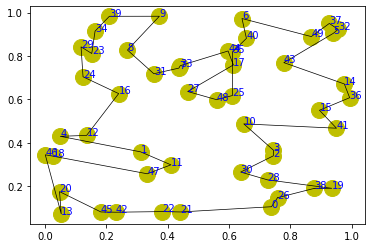

step:3980/5000, actic loss:0.494, critic loss:2.701, L:9.178, 0min2sec
step:3981/5000, actic loss:0.493, critic loss:2.700, L:9.178, 0min1sec
step:3982/5000, actic loss:0.493, critic loss:2.700, L:9.177, 0min1sec
step:3983/5000, actic loss:0.492, critic loss:2.699, L:9.177, 0min1sec
step:3984/5000, actic loss:0.492, critic loss:2.698, L:9.176, 0min1sec
distance:7.034
tensor([36, 24, 49, 25, 47, 28, 29,  1, 37, 18, 46, 41, 38, 48, 32, 15, 30, 11,
        40,  6, 35, 44, 10, 39, 19, 21, 42,  9, 20, 17, 27, 26, 16, 22, 43,  2,
        13, 12,  8,  3, 34, 31,  5,  7, 14, 45,  0, 33, 23,  4])


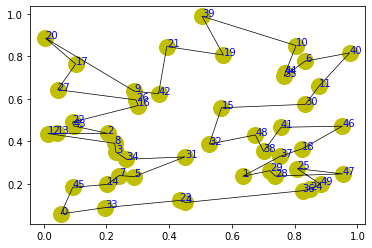

step:3985/5000, actic loss:0.492, critic loss:2.698, L:9.176, 0min2sec
step:3986/5000, actic loss:0.492, critic loss:2.697, L:9.175, 0min1sec
step:3987/5000, actic loss:0.492, critic loss:2.696, L:9.175, 0min1sec
step:3988/5000, actic loss:0.492, critic loss:2.696, L:9.174, 0min1sec
step:3989/5000, actic loss:0.492, critic loss:2.695, L:9.173, 0min1sec
distance:7.101
tensor([ 1,  3, 39,  9, 24, 19, 31, 22, 15, 18, 49,  7, 12, 10, 20, 11,  5, 17,
        21, 46, 35, 28, 29, 13, 40,  8, 26, 47, 43, 34, 38, 27, 45, 16, 48,  4,
        33, 14, 30, 44, 42, 25, 32, 36,  6,  2, 23,  0, 37, 41])


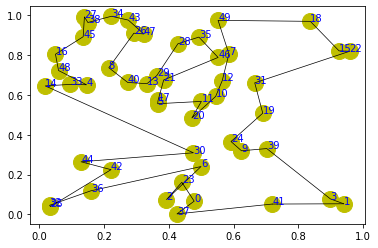

step:3990/5000, actic loss:0.491, critic loss:2.695, L:9.173, 0min1sec
step:3991/5000, actic loss:0.491, critic loss:2.694, L:9.172, 0min1sec
step:3992/5000, actic loss:0.490, critic loss:2.693, L:9.172, 0min1sec
step:3993/5000, actic loss:0.491, critic loss:2.693, L:9.171, 0min1sec
step:3994/5000, actic loss:0.491, critic loss:2.692, L:9.171, 0min1sec
distance:7.023
tensor([44, 40, 15, 35, 17, 26, 13,  7, 38, 23, 43, 31, 33,  9, 45, 10, 49, 30,
        25, 19,  8, 29, 34,  4, 11, 36, 48, 12,  5, 42, 46,  1,  2, 39, 21, 14,
        37, 20,  6, 24, 47,  3, 18, 28, 22, 27, 41, 16,  0, 32])


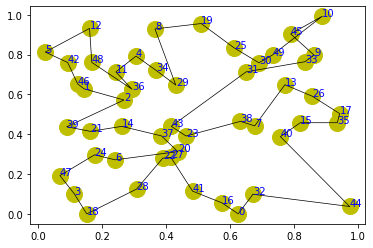

step:3995/5000, actic loss:0.491, critic loss:2.692, L:9.170, 0min2sec
step:3996/5000, actic loss:0.490, critic loss:2.691, L:9.170, 0min1sec
step:3997/5000, actic loss:0.490, critic loss:2.690, L:9.169, 0min1sec
step:3998/5000, actic loss:0.490, critic loss:2.690, L:9.169, 0min1sec
step:3999/5000, actic loss:0.490, critic loss:2.689, L:9.168, 0min1sec
distance:7.429
tensor([ 5, 16,  8, 49, 12, 40, 32, 38,  7, 23, 33, 29, 41, 39, 42, 19, 47, 35,
        24, 13, 18, 28,  4, 25, 36,  9, 14, 45, 43,  2, 10, 11, 30, 46, 20,  1,
         0, 15, 44, 48, 17, 27, 22, 34, 37, 31,  3, 21, 26,  6])


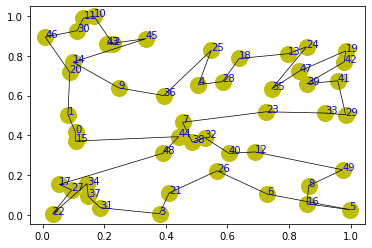

step:4000/5000, actic loss:0.489, critic loss:2.688, L:9.168, 0min2sec
step:4001/5000, actic loss:0.489, critic loss:2.688, L:9.167, 0min1sec
step:4002/5000, actic loss:0.489, critic loss:2.687, L:9.166, 0min2sec
step:4003/5000, actic loss:0.489, critic loss:2.687, L:9.166, 0min1sec
step:4004/5000, actic loss:0.489, critic loss:2.686, L:9.165, 0min1sec
distance:7.953
tensor([21,  7, 15, 16,  3, 12, 49, 35, 40,  9, 26, 42,  6, 19, 38, 46, 32, 44,
        30,  2, 43, 41, 34, 22, 17,  0, 14, 11, 28,  5, 20, 31, 39, 23,  1, 33,
        24,  4, 18, 45,  8, 27, 25, 29, 37, 36, 13, 47, 10, 48])


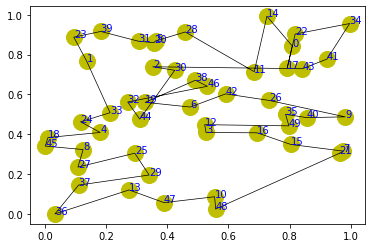

step:4005/5000, actic loss:0.489, critic loss:2.685, L:9.165, 0min2sec
step:4006/5000, actic loss:0.488, critic loss:2.685, L:9.164, 0min1sec
step:4007/5000, actic loss:0.488, critic loss:2.684, L:9.164, 0min1sec
step:4008/5000, actic loss:0.488, critic loss:2.684, L:9.163, 0min1sec
step:4009/5000, actic loss:0.488, critic loss:2.683, L:9.163, 0min1sec
distance:7.561
tensor([ 7, 33, 12, 42, 16, 45, 19, 48, 38, 21, 18, 25, 32, 41, 14,  3, 26, 29,
        31, 39, 35, 13, 27, 10,  1, 30, 28, 24, 49,  0,  8, 20,  9,  2, 15, 34,
         5,  4, 23, 43, 40, 37, 17, 46,  6, 11, 22, 44, 36, 47])


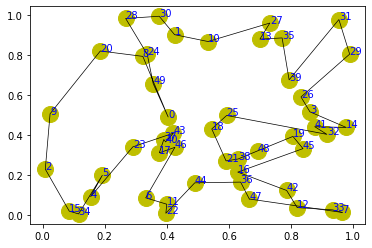

step:4010/5000, actic loss:0.488, critic loss:2.682, L:9.162, 0min2sec
step:4011/5000, actic loss:0.488, critic loss:2.682, L:9.162, 0min1sec
step:4012/5000, actic loss:0.488, critic loss:2.681, L:9.161, 0min1sec
step:4013/5000, actic loss:0.488, critic loss:2.680, L:9.161, 0min1sec
step:4014/5000, actic loss:0.488, critic loss:2.680, L:9.160, 0min1sec
distance:6.969
tensor([22, 48,  2, 26, 36,  5, 27, 49, 18,  0, 31, 25,  1,  8, 14, 45, 35, 16,
         6, 17, 34, 11, 41, 39, 30, 47, 15, 37, 43, 13, 21, 40, 42, 24, 28, 19,
        23, 38, 44, 10, 12,  3,  7, 29,  4, 32, 46, 20,  9, 33])


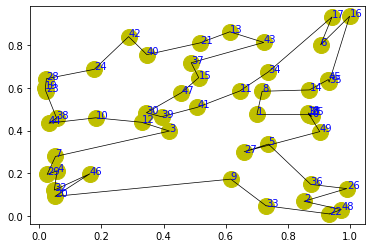

step:4015/5000, actic loss:0.487, critic loss:2.679, L:9.160, 0min2sec
step:4016/5000, actic loss:0.487, critic loss:2.679, L:9.159, 0min1sec
step:4017/5000, actic loss:0.486, critic loss:2.678, L:9.158, 0min1sec
step:4018/5000, actic loss:0.486, critic loss:2.677, L:9.158, 0min1sec
step:4019/5000, actic loss:0.486, critic loss:2.677, L:9.157, 0min1sec
distance:6.223
tensor([33, 48, 12, 39, 49, 43, 25,  9, 11, 34, 21, 47,  1, 36, 18, 42, 35, 20,
        38, 41,  8,  0,  2, 45, 14, 24, 13, 40,  6, 29,  3, 15, 17, 26, 46, 30,
        19, 16,  7, 32,  5, 37,  4, 10, 31, 23, 28, 44, 27, 22])


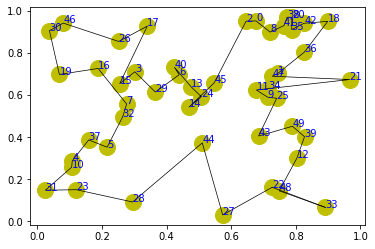

step:4020/5000, actic loss:0.486, critic loss:2.676, L:9.157, 0min1sec
step:4021/5000, actic loss:0.486, critic loss:2.676, L:9.156, 0min1sec
step:4022/5000, actic loss:0.485, critic loss:2.675, L:9.156, 0min1sec
step:4023/5000, actic loss:0.485, critic loss:2.674, L:9.155, 0min1sec
step:4024/5000, actic loss:0.484, critic loss:2.674, L:9.155, 0min1sec
distance:6.089
tensor([16, 13, 40,  7, 35, 23, 46, 24, 10, 30, 37, 18, 11, 48, 43, 47,  1, 20,
         6, 17, 42, 25, 29,  3, 21, 38, 41, 33, 15, 31,  5,  2,  0, 39,  9,  8,
         4, 28, 19, 44, 32, 36, 34, 45, 49, 22, 14, 27, 26, 12])


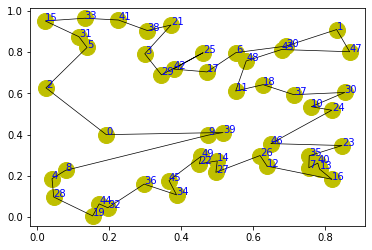

step:4025/5000, actic loss:0.484, critic loss:2.673, L:9.154, 0min1sec
step:4026/5000, actic loss:0.484, critic loss:2.673, L:9.154, 0min1sec
step:4027/5000, actic loss:0.484, critic loss:2.672, L:9.153, 0min1sec
step:4028/5000, actic loss:0.483, critic loss:2.671, L:9.153, 0min1sec
step:4029/5000, actic loss:0.484, critic loss:2.671, L:9.152, 0min2sec
distance:6.724
tensor([40, 12,  4, 43, 47, 24, 15, 32, 18, 36, 38, 20, 22, 30, 23,  1, 31, 34,
         8,  7, 25, 39, 49, 45,  2, 41, 44, 10, 48, 21, 46, 27, 28, 26, 14,  6,
        13, 35,  5, 37, 16, 19, 17, 29, 11,  0, 42,  3, 33,  9])


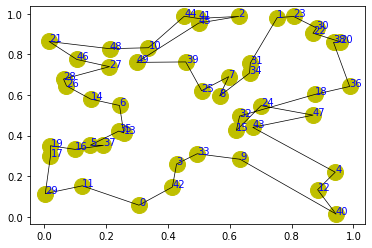

step:4030/5000, actic loss:0.484, critic loss:2.670, L:9.152, 0min2sec
step:4031/5000, actic loss:0.484, critic loss:2.670, L:9.151, 0min1sec
step:4032/5000, actic loss:0.483, critic loss:2.669, L:9.151, 0min1sec
step:4033/5000, actic loss:0.482, critic loss:2.668, L:9.150, 0min1sec
step:4034/5000, actic loss:0.482, critic loss:2.668, L:9.150, 0min1sec
distance:7.575
tensor([46,  7, 41, 11, 38, 16,  5, 21, 33,  1, 27,  3, 24, 37, 28, 14, 32, 42,
        44, 48, 10, 18, 20, 47, 45, 40, 12, 13, 39, 23, 34, 43,  0, 22, 49, 29,
        25, 26, 30, 35, 17,  6, 31, 19, 36,  4,  8,  2,  9, 15])


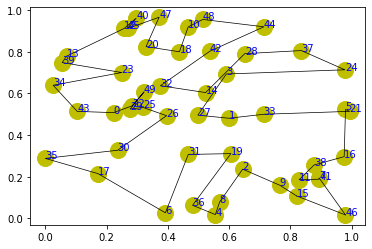

step:4035/5000, actic loss:0.482, critic loss:2.667, L:9.149, 0min2sec
step:4036/5000, actic loss:0.482, critic loss:2.667, L:9.149, 0min1sec
step:4037/5000, actic loss:0.483, critic loss:2.666, L:9.148, 0min2sec
step:4038/5000, actic loss:0.484, critic loss:2.665, L:9.148, 0min2sec
step:4039/5000, actic loss:0.484, critic loss:2.665, L:9.148, 0min2sec
distance:7.146
tensor([18, 30,  1,  0, 25, 16, 22, 12,  8, 13,  6, 23,  3, 24, 10, 49, 29, 43,
        46, 38, 34, 42, 32, 45, 39, 11, 27, 33,  2, 35,  7, 21,  9, 48, 40, 19,
        14, 44, 20,  4, 47, 41, 26, 17, 37, 36,  5, 15, 31, 28])


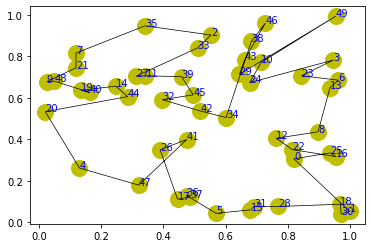

step:4040/5000, actic loss:0.485, critic loss:2.664, L:9.147, 0min2sec
step:4041/5000, actic loss:0.484, critic loss:2.664, L:9.147, 0min1sec
step:4042/5000, actic loss:0.483, critic loss:2.663, L:9.146, 0min1sec
step:4043/5000, actic loss:0.483, critic loss:2.662, L:9.146, 0min1sec
step:4044/5000, actic loss:0.483, critic loss:2.662, L:9.145, 0min1sec
distance:6.820
tensor([32,  0, 24, 28, 49,  3, 40, 14,  9, 17,  5, 11, 25, 12, 45, 16, 36,  2,
        48, 26, 38, 31, 10, 47,  6, 22, 42, 44, 23, 34, 29,  7, 21, 20,  4, 37,
        27,  1, 30, 35,  8, 15, 19, 41, 39, 13, 46, 33, 43, 18])


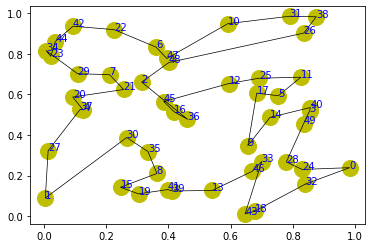

step:4045/5000, actic loss:0.482, critic loss:2.661, L:9.144, 0min2sec
step:4046/5000, actic loss:0.483, critic loss:2.661, L:9.144, 0min1sec
step:4047/5000, actic loss:0.483, critic loss:2.660, L:9.143, 0min2sec
step:4048/5000, actic loss:0.482, critic loss:2.660, L:9.143, 0min2sec
step:4049/5000, actic loss:0.482, critic loss:2.659, L:9.142, 0min2sec
distance:7.017
tensor([12,  3, 21, 16, 30, 10, 42, 17, 41, 27, 45, 46, 33, 44,  4, 18, 22, 38,
        43,  6, 48, 32, 25, 31, 47, 35, 24, 40,  8, 19, 36, 15,  5, 29, 26, 49,
         1,  2,  7,  9, 37, 23, 34, 13, 20, 14, 11,  0, 39, 28])


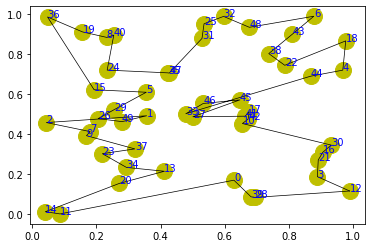

step:4050/5000, actic loss:0.481, critic loss:2.658, L:9.142, 0min2sec
step:4051/5000, actic loss:0.481, critic loss:2.658, L:9.141, 0min1sec
step:4052/5000, actic loss:0.481, critic loss:2.657, L:9.141, 0min1sec
step:4053/5000, actic loss:0.481, critic loss:2.657, L:9.140, 0min1sec
step:4054/5000, actic loss:0.481, critic loss:2.656, L:9.140, 0min1sec
distance:6.283
tensor([ 6, 44, 16, 43, 31, 37, 48,  0, 28, 11, 18, 27,  3,  1, 15, 26, 20, 46,
        24, 23, 45,  9,  8, 30, 35,  4, 36, 17, 33, 14, 47,  7, 21, 34, 12, 38,
        19, 39, 25, 41, 10, 29, 40, 22,  2,  5, 13, 32, 42, 49])


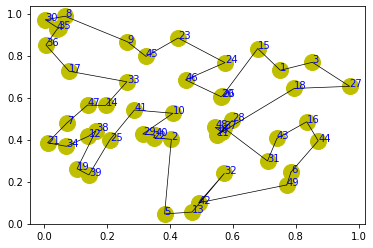

step:4055/5000, actic loss:0.481, critic loss:2.655, L:9.139, 0min2sec
step:4056/5000, actic loss:0.481, critic loss:2.655, L:9.139, 0min1sec
step:4057/5000, actic loss:0.480, critic loss:2.654, L:9.138, 0min1sec
step:4058/5000, actic loss:0.480, critic loss:2.654, L:9.138, 0min1sec
step:4059/5000, actic loss:0.480, critic loss:2.653, L:9.137, 0min2sec
distance:7.139
tensor([43, 35,  8,  3, 23, 26, 25, 33, 39, 42, 18, 22, 14, 11, 49, 10, 21,  5,
        40, 36, 32, 19,  0,  4,  6, 30,  7, 47, 34, 15, 29, 45, 28, 20, 37, 48,
         9, 41, 13, 17, 16, 12, 38, 46, 44,  2, 31,  1, 27, 24])


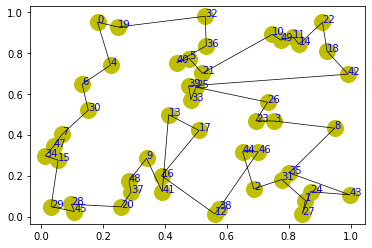

step:4060/5000, actic loss:0.480, critic loss:2.652, L:9.137, 0min2sec
step:4061/5000, actic loss:0.480, critic loss:2.652, L:9.136, 0min1sec
step:4062/5000, actic loss:0.480, critic loss:2.651, L:9.136, 0min1sec
step:4063/5000, actic loss:0.480, critic loss:2.651, L:9.135, 0min1sec
step:4064/5000, actic loss:0.480, critic loss:2.650, L:9.135, 0min1sec
distance:7.111
tensor([45, 29, 24, 36,  6, 46, 19, 14, 48, 44, 34,  8,  7, 39, 40,  9, 12, 33,
        41,  5, 49, 15, 38,  4, 23, 35, 32, 21, 13, 28, 37, 43, 27, 11, 47, 25,
        17, 20,  3, 10,  1, 31, 22, 16, 42, 18,  0,  2, 30, 26])


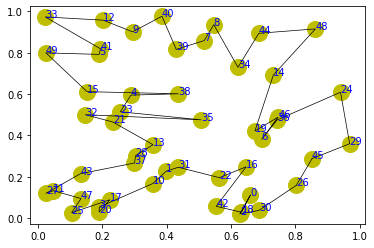

step:4065/5000, actic loss:0.479, critic loss:2.649, L:9.134, 0min2sec
step:4066/5000, actic loss:0.479, critic loss:2.649, L:9.134, 0min1sec
step:4067/5000, actic loss:0.479, critic loss:2.648, L:9.133, 0min1sec
step:4068/5000, actic loss:0.479, critic loss:2.648, L:9.133, 0min1sec
step:4069/5000, actic loss:0.479, critic loss:2.647, L:9.132, 0min1sec
distance:7.395
tensor([18, 44, 28, 24, 12, 19,  3, 45, 30,  5, 10, 33, 17, 21,  6,  4, 47, 15,
        25, 13,  7, 23, 35, 27, 38, 26, 32, 29, 36, 20, 14,  0, 46, 34, 40, 43,
        37, 16, 41,  2, 48, 22, 42,  1, 11, 31,  8, 39, 49,  9])


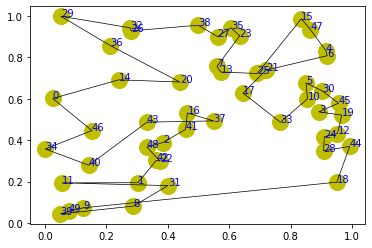

step:4070/5000, actic loss:0.479, critic loss:2.646, L:9.132, 0min2sec
step:4071/5000, actic loss:0.479, critic loss:2.646, L:9.131, 0min1sec
step:4072/5000, actic loss:0.478, critic loss:2.645, L:9.131, 0min1sec
step:4073/5000, actic loss:0.477, critic loss:2.645, L:9.130, 0min1sec
step:4074/5000, actic loss:0.477, critic loss:2.644, L:9.129, 0min1sec
distance:7.120
tensor([ 0,  8, 39, 12,  5, 38,  2, 20, 18, 22, 21, 19, 11, 48,  9, 23, 25, 43,
        45, 42, 40, 44,  4, 35, 13, 26, 30, 36,  6, 17, 29, 14, 15, 47,  1, 33,
        34, 10, 24, 32, 27,  3, 46,  7, 41, 37, 28, 31, 16, 49])


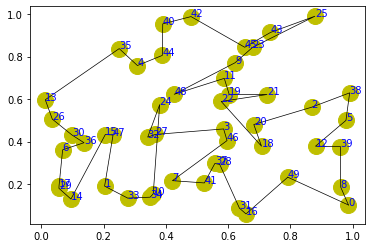

step:4075/5000, actic loss:0.477, critic loss:2.643, L:9.129, 0min2sec
step:4076/5000, actic loss:0.477, critic loss:2.643, L:9.128, 0min1sec
step:4077/5000, actic loss:0.477, critic loss:2.642, L:9.128, 0min1sec
step:4078/5000, actic loss:0.477, critic loss:2.642, L:9.127, 0min1sec
step:4079/5000, actic loss:0.477, critic loss:2.641, L:9.127, 0min1sec
distance:7.981
tensor([14, 22, 15, 28, 16, 42, 44,  8, 21, 34,  6, 23, 27,  7, 33, 46, 47, 31,
        38, 36, 26, 19, 41, 10, 37, 35, 30, 24, 20,  3, 40,  2,  9, 48, 11, 39,
        45,  1, 12, 49, 17, 32,  4, 29, 13, 25, 18,  0, 43,  5])


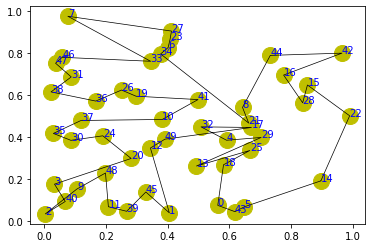

step:4080/5000, actic loss:0.477, critic loss:2.641, L:9.126, 0min2sec
step:4081/5000, actic loss:0.475, critic loss:2.640, L:9.126, 0min1sec
step:4082/5000, actic loss:0.474, critic loss:2.639, L:9.125, 0min1sec
step:4083/5000, actic loss:0.474, critic loss:2.639, L:9.125, 0min1sec
step:4084/5000, actic loss:0.473, critic loss:2.638, L:9.124, 0min1sec
distance:7.452
tensor([25, 19, 34, 22, 35, 45,  6, 12,  5, 17, 11,  0, 38, 18, 23,  7, 31, 27,
        36,  2, 46,  9, 10, 13, 42,  8, 49, 37, 33, 28, 48, 21, 26, 30, 29, 15,
        47, 41, 32, 40,  1,  4, 43,  3, 44, 20, 16, 39, 14, 24])


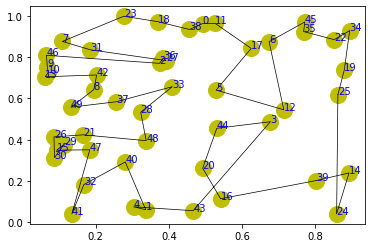

step:4085/5000, actic loss:0.473, critic loss:2.638, L:9.124, 0min2sec
step:4086/5000, actic loss:0.474, critic loss:2.637, L:9.124, 0min2sec
step:4087/5000, actic loss:0.474, critic loss:2.637, L:9.123, 0min2sec
step:4088/5000, actic loss:0.474, critic loss:2.636, L:9.123, 0min1sec
step:4089/5000, actic loss:0.475, critic loss:2.635, L:9.122, 0min1sec
distance:7.963
tensor([42, 37,  0, 40, 17,  3, 49, 26, 12, 38, 15, 48, 39, 22, 44, 36, 30, 23,
        45,  6, 41, 47, 10, 21, 46,  5, 29, 16, 32, 24, 25,  8, 35,  7,  2, 11,
        13, 19, 31, 14, 28, 33,  4,  1,  9, 27, 20, 43, 18, 34])


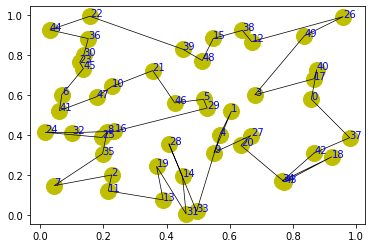

step:4090/5000, actic loss:0.474, critic loss:2.635, L:9.122, 0min2sec
step:4091/5000, actic loss:0.472, critic loss:2.634, L:9.121, 0min1sec
step:4092/5000, actic loss:0.471, critic loss:2.634, L:9.121, 0min1sec
step:4093/5000, actic loss:0.470, critic loss:2.633, L:9.121, 0min1sec
step:4094/5000, actic loss:0.470, critic loss:2.633, L:9.120, 0min1sec
distance:7.427
tensor([15, 44, 14, 28, 45,  7,  0, 34,  4, 29, 12, 32,  8, 33, 41, 47, 20,  6,
        39, 19, 46, 42, 49, 17,  2, 18,  1, 24, 16, 25, 48, 27, 21, 10, 26, 43,
        23, 30,  3, 31, 22, 13, 36, 35,  9,  5, 40, 11, 38, 37])


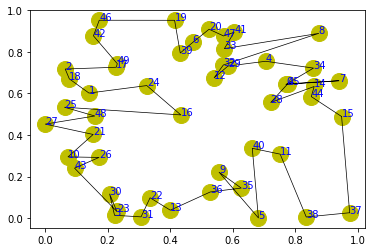

step:4095/5000, actic loss:0.470, critic loss:2.632, L:9.120, 0min2sec
step:4096/5000, actic loss:0.470, critic loss:2.632, L:9.119, 0min1sec
step:4097/5000, actic loss:0.470, critic loss:2.631, L:9.119, 0min2sec
step:4098/5000, actic loss:0.470, critic loss:2.630, L:9.118, 0min1sec
step:4099/5000, actic loss:0.469, critic loss:2.630, L:9.118, 0min1sec
distance:6.707
tensor([ 1, 13, 37, 28, 21,  9, 26, 10, 31, 30, 49, 24, 42, 41, 38, 23, 47, 25,
         8, 29, 36, 40,  5,  3,  2, 48, 14, 17, 18, 12, 27, 19, 35, 11, 22, 34,
        15, 45,  0, 43, 39,  7,  6, 33, 20, 44,  4, 16, 46, 32])


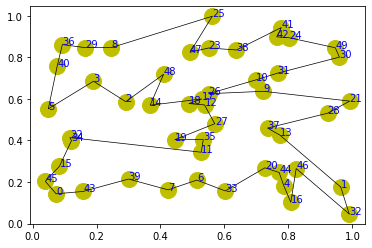

step:4100/5000, actic loss:0.468, critic loss:2.629, L:9.117, 0min2sec
step:4101/5000, actic loss:0.468, critic loss:2.629, L:9.117, 0min1sec
step:4102/5000, actic loss:0.468, critic loss:2.628, L:9.116, 0min1sec
step:4103/5000, actic loss:0.469, critic loss:2.627, L:9.116, 0min1sec
step:4104/5000, actic loss:0.469, critic loss:2.627, L:9.116, 0min1sec
distance:7.377
tensor([ 4, 44, 10, 20,  0, 21,  1,  8,  6, 14, 49, 33, 26, 37, 38, 46, 11, 28,
        47, 17, 19, 15, 29, 41, 13,  2, 45, 43, 25, 31, 22,  9,  3, 39, 24, 34,
        16,  7, 18, 40, 36, 23, 12,  5, 32, 27, 30, 48, 35, 42])


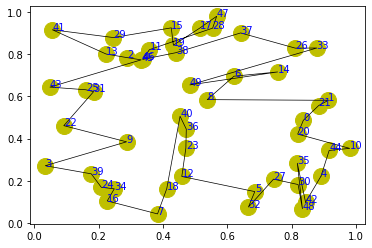

step:4105/5000, actic loss:0.469, critic loss:2.626, L:9.115, 0min2sec
step:4106/5000, actic loss:0.469, critic loss:2.626, L:9.115, 0min1sec
step:4107/5000, actic loss:0.468, critic loss:2.625, L:9.114, 0min2sec
step:4108/5000, actic loss:0.468, critic loss:2.625, L:9.114, 0min2sec
step:4109/5000, actic loss:0.467, critic loss:2.624, L:9.113, 0min1sec
distance:6.727
tensor([34, 46, 22,  8, 21, 30, 36, 33, 29,  7, 35,  2, 20, 12, 14, 18,  9,  0,
        24, 42, 43,  6, 11,  4, 38, 15,  3, 26, 31, 47, 28, 32,  5, 49, 44, 37,
        25, 16, 17,  1, 13, 48, 41, 45, 40, 39, 27, 23, 19, 10])


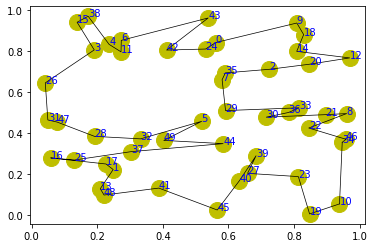

step:4110/5000, actic loss:0.468, critic loss:2.623, L:9.113, 0min2sec
step:4111/5000, actic loss:0.468, critic loss:2.623, L:9.112, 0min1sec
step:4112/5000, actic loss:0.469, critic loss:2.622, L:9.112, 0min1sec
step:4113/5000, actic loss:0.469, critic loss:2.622, L:9.111, 0min1sec
step:4114/5000, actic loss:0.469, critic loss:2.621, L:9.111, 0min1sec
distance:7.904
tensor([33, 14,  7,  3,  1, 18, 26, 30,  0, 24, 32,  4,  5, 42, 40, 38, 46, 13,
        29, 19, 45,  9, 25, 15, 34, 48, 41, 22,  2, 21, 28, 16, 31, 37, 11, 35,
        20, 27, 23,  8, 47, 49, 17, 36, 39, 43,  6, 12, 10, 44])


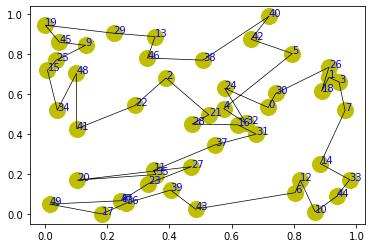

step:4115/5000, actic loss:0.468, critic loss:2.621, L:9.110, 0min1sec
step:4116/5000, actic loss:0.467, critic loss:2.620, L:9.110, 0min1sec
step:4117/5000, actic loss:0.466, critic loss:2.620, L:9.109, 0min1sec
step:4118/5000, actic loss:0.465, critic loss:2.619, L:9.109, 0min1sec
step:4119/5000, actic loss:0.465, critic loss:2.618, L:9.108, 0min2sec
distance:6.843
tensor([40, 18,  2, 45, 46, 37, 36, 48,  5, 26,  1, 24, 21,  4, 13, 12,  6, 42,
        15, 27, 29, 47, 11, 49, 43, 23,  3,  0, 32, 28, 10, 34, 25, 35, 41, 30,
         8,  9, 20, 39, 38,  7, 14, 31, 33, 16, 22, 17, 19, 44])


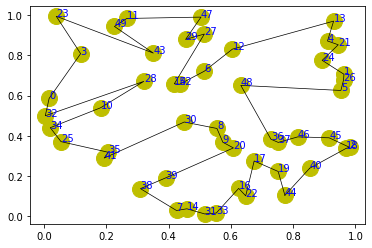

step:4120/5000, actic loss:0.464, critic loss:2.618, L:9.108, 0min2sec
step:4121/5000, actic loss:0.465, critic loss:2.617, L:9.107, 0min1sec
step:4122/5000, actic loss:0.465, critic loss:2.617, L:9.107, 0min1sec
step:4123/5000, actic loss:0.465, critic loss:2.616, L:9.106, 0min1sec
step:4124/5000, actic loss:0.465, critic loss:2.616, L:9.105, 0min1sec
distance:6.210
tensor([48, 27,  5, 20, 14, 47, 32,  1,  8, 11, 10, 31,  2, 25, 13, 38,  0, 44,
        12,  3, 46, 42, 15, 45, 36, 40, 19,  6, 18, 22,  9, 29, 26,  7, 30, 23,
        28, 37,  4, 33, 41, 35, 43, 17, 21, 16, 34, 39, 24, 49])


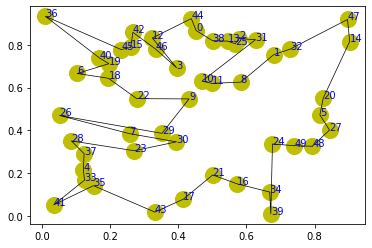

step:4125/5000, actic loss:0.464, critic loss:2.615, L:9.105, 0min1sec
step:4126/5000, actic loss:0.464, critic loss:2.614, L:9.104, 0min1sec
step:4127/5000, actic loss:0.464, critic loss:2.614, L:9.104, 0min1sec
step:4128/5000, actic loss:0.464, critic loss:2.613, L:9.103, 0min1sec
step:4129/5000, actic loss:0.464, critic loss:2.613, L:9.103, 0min1sec
distance:6.471
tensor([34, 12, 21, 31, 22, 24, 16, 30, 18, 27, 47, 40, 45,  4,  6, 49, 13,  8,
        17, 33,  1, 11, 15, 32, 19, 36,  9, 20, 46, 28, 48,  2,  3, 39,  5, 43,
        14, 38, 26, 41,  0, 37,  7, 10, 44, 29, 25, 35, 23, 42])


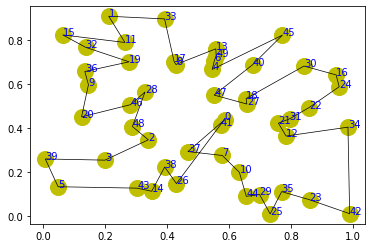

step:4130/5000, actic loss:0.464, critic loss:2.612, L:9.102, 0min2sec
step:4131/5000, actic loss:0.464, critic loss:2.611, L:9.102, 0min1sec
step:4132/5000, actic loss:0.463, critic loss:2.611, L:9.101, 0min2sec
step:4133/5000, actic loss:0.463, critic loss:2.610, L:9.101, 0min2sec
step:4134/5000, actic loss:0.463, critic loss:2.610, L:9.100, 0min2sec
distance:7.575
tensor([ 8, 43,  5, 36, 25, 20, 48,  2, 38,  7, 31, 40, 27, 19, 26, 10, 47, 39,
        46, 23,  9, 24, 32, 14, 21, 34, 33, 13, 35, 42, 49,  3, 44, 18, 28,  1,
         4, 29, 45, 17, 12, 22, 15,  6, 37, 11, 41,  0, 30, 16])


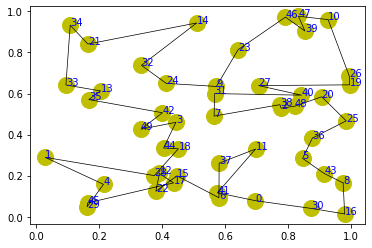

step:4135/5000, actic loss:0.463, critic loss:2.609, L:9.100, 0min2sec
step:4136/5000, actic loss:0.463, critic loss:2.608, L:9.099, 0min1sec
step:4137/5000, actic loss:0.463, critic loss:2.608, L:9.098, 0min1sec
step:4138/5000, actic loss:0.462, critic loss:2.607, L:9.098, 0min1sec
step:4139/5000, actic loss:0.461, critic loss:2.607, L:9.097, 0min1sec
distance:7.533
tensor([ 8, 28,  0, 36, 47, 33, 45, 10, 31, 19,  7, 46, 42, 34, 23,  4, 14, 48,
        43, 40, 17, 29, 27, 38, 41, 16, 44, 49, 30, 12,  9, 11, 22,  3,  6, 26,
        15, 18, 21, 32, 24, 39, 35, 25, 20, 13,  2, 37,  1,  5])


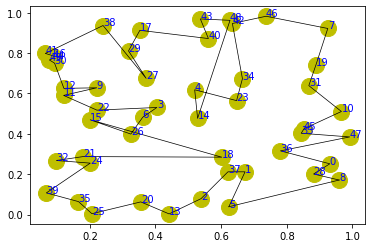

step:4140/5000, actic loss:0.461, critic loss:2.606, L:9.097, 0min2sec
step:4141/5000, actic loss:0.461, critic loss:2.606, L:9.096, 0min1sec
step:4142/5000, actic loss:0.460, critic loss:2.605, L:9.096, 0min4sec
step:4143/5000, actic loss:0.460, critic loss:2.605, L:9.095, 0min2sec
step:4144/5000, actic loss:0.461, critic loss:2.604, L:9.095, 0min2sec
distance:6.949
tensor([ 7,  1, 13,  9,  3, 22, 37, 10, 44, 46, 47, 12,  2,  6, 36, 49, 23, 42,
        38, 33, 26, 43, 15, 35, 32, 40, 39, 29,  0, 11, 31, 41,  8,  5,  4, 27,
        25, 16, 18, 21, 17, 34, 19, 24, 45, 30, 48, 14, 20, 28])


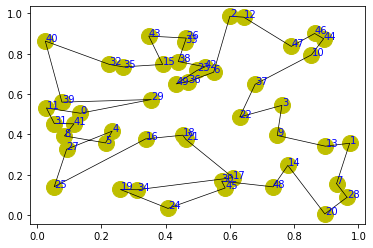

step:4145/5000, actic loss:0.461, critic loss:2.603, L:9.094, 0min2sec
step:4146/5000, actic loss:0.461, critic loss:2.603, L:9.094, 0min1sec
step:4147/5000, actic loss:0.460, critic loss:2.602, L:9.093, 0min1sec
step:4148/5000, actic loss:0.460, critic loss:2.602, L:9.093, 0min1sec
step:4149/5000, actic loss:0.460, critic loss:2.601, L:9.092, 0min1sec
distance:6.864
tensor([38, 33, 46, 37,  2,  0, 34, 41, 26, 25,  4, 45, 40, 21, 11, 28, 17, 15,
         7, 32, 35,  8, 27,  6, 24, 22,  3, 18,  5, 49, 12, 42,  1, 13, 20, 47,
        23, 31, 44,  9, 19, 48, 39, 43, 29, 16, 10, 14, 36, 30])


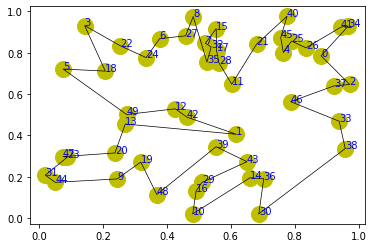

step:4150/5000, actic loss:0.460, critic loss:2.601, L:9.092, 0min2sec
step:4151/5000, actic loss:0.460, critic loss:2.600, L:9.091, 0min1sec
step:4152/5000, actic loss:0.459, critic loss:2.599, L:9.091, 0min1sec
step:4153/5000, actic loss:0.459, critic loss:2.599, L:9.090, 0min1sec
step:4154/5000, actic loss:0.459, critic loss:2.598, L:9.090, 0min2sec
distance:7.056
tensor([49, 15, 44, 47, 41, 43, 10,  9,  1, 32, 40, 19, 37, 26, 48, 45, 22, 25,
        14, 35, 36,  4,  7, 39,  5, 38, 20, 46,  6, 12, 21, 31, 16, 29,  8, 34,
        33, 11, 28, 17,  2, 27, 24, 18, 23,  3,  0, 42, 30, 13])


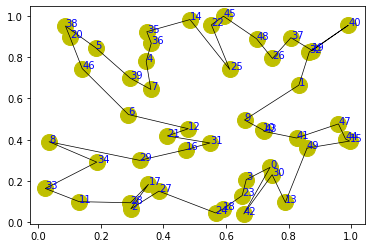

step:4155/5000, actic loss:0.459, critic loss:2.598, L:9.089, 0min2sec
step:4156/5000, actic loss:0.459, critic loss:2.597, L:9.088, 0min1sec
step:4157/5000, actic loss:0.458, critic loss:2.596, L:9.088, 0min1sec
step:4158/5000, actic loss:0.458, critic loss:2.596, L:9.087, 0min1sec
step:4159/5000, actic loss:0.458, critic loss:2.595, L:9.087, 0min1sec
distance:7.031
tensor([18, 47,  9,  6, 49, 40, 41, 27, 11,  8, 16, 35, 17, 30, 31, 43, 37, 14,
        20,  0, 45, 42,  1, 13, 21,  7, 44, 10, 48, 19, 24, 23, 33, 39,  4, 15,
        36, 29,  2, 32, 34, 22, 28, 38,  3, 46, 12, 25,  5, 26])


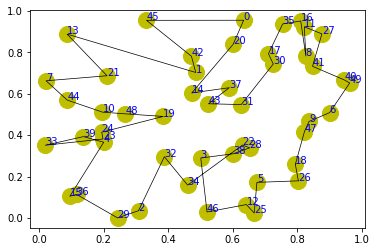

step:4160/5000, actic loss:0.458, critic loss:2.595, L:9.086, 0min1sec
step:4161/5000, actic loss:0.458, critic loss:2.594, L:9.086, 0min1sec
step:4162/5000, actic loss:0.458, critic loss:2.594, L:9.085, 0min1sec
step:4163/5000, actic loss:0.458, critic loss:2.593, L:9.085, 0min1sec
step:4164/5000, actic loss:0.458, critic loss:2.592, L:9.084, 0min1sec
distance:6.585
tensor([30, 22, 31, 46,  2, 25, 10, 12, 39, 44, 13, 37,  4, 17,  3, 24,  8, 45,
         9, 42, 49, 40, 48,  7, 19, 20, 14,  1,  6, 18, 36, 16, 47, 34, 29, 26,
        43,  5, 35, 33, 32, 23, 11,  0, 38, 21, 15, 41, 28, 27])


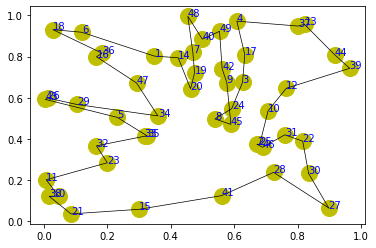

step:4165/5000, actic loss:0.457, critic loss:2.592, L:9.084, 0min2sec
step:4166/5000, actic loss:0.457, critic loss:2.591, L:9.083, 0min2sec
step:4167/5000, actic loss:0.457, critic loss:2.591, L:9.083, 0min1sec
step:4168/5000, actic loss:0.457, critic loss:2.590, L:9.082, 0min1sec
step:4169/5000, actic loss:0.457, critic loss:2.590, L:9.082, 0min1sec
distance:7.488
tensor([ 0, 47, 39,  5, 27, 25, 40, 36, 46, 49, 19, 10, 35,  4, 11,  9, 20, 45,
        34, 21, 32, 41, 24, 30, 22,  2, 44, 23, 42, 13, 26, 33,  7, 37, 16, 29,
        48,  3, 12, 28,  8, 14, 43, 38, 31, 15,  6, 18,  1, 17])


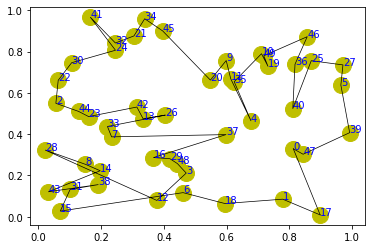

step:4170/5000, actic loss:0.458, critic loss:2.589, L:9.081, 0min2sec
step:4171/5000, actic loss:0.458, critic loss:2.589, L:9.081, 0min1sec
step:4172/5000, actic loss:0.457, critic loss:2.588, L:9.080, 0min1sec
step:4173/5000, actic loss:0.457, critic loss:2.587, L:9.080, 0min1sec
step:4174/5000, actic loss:0.457, critic loss:2.587, L:9.079, 0min1sec
distance:7.307
tensor([25,  2, 33, 45, 12, 13, 38, 47, 24,  5, 27, 36, 20, 14, 22, 29, 30, 48,
        35, 40, 18, 32, 39,  4, 37, 31, 26, 17, 49, 16, 42, 41,  3,  0, 11, 43,
         7, 34, 21, 10, 44, 28,  8, 23, 46, 19,  6, 15,  1,  9])


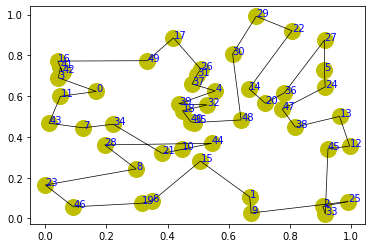

step:4175/5000, actic loss:0.457, critic loss:2.586, L:9.079, 0min2sec
step:4176/5000, actic loss:0.457, critic loss:2.586, L:9.078, 0min2sec
step:4177/5000, actic loss:0.457, critic loss:2.585, L:9.077, 0min1sec
step:4178/5000, actic loss:0.457, critic loss:2.585, L:9.077, 0min1sec
step:4179/5000, actic loss:0.457, critic loss:2.584, L:9.076, 0min1sec
distance:6.681
tensor([45, 40,  9, 43, 13, 23, 33, 24, 21, 12, 27, 37,  6, 49, 47,  5, 39, 14,
        44, 30, 16,  0, 46,  7, 41,  1, 11, 17, 18, 22, 34, 19, 42, 25, 29,  3,
        48, 28, 10, 35, 36, 26, 15, 32,  2, 20,  8, 38, 31,  4])


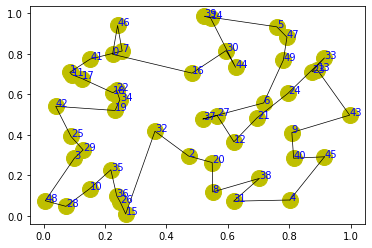

step:4180/5000, actic loss:0.456, critic loss:2.583, L:9.076, 0min2sec
step:4181/5000, actic loss:0.456, critic loss:2.583, L:9.075, 0min1sec
step:4182/5000, actic loss:0.455, critic loss:2.582, L:9.075, 0min1sec
step:4183/5000, actic loss:0.455, critic loss:2.582, L:9.074, 0min1sec
step:4184/5000, actic loss:0.454, critic loss:2.581, L:9.074, 0min1sec
distance:6.444
tensor([18, 45, 29, 24, 11, 31, 16, 25, 20, 38, 48, 37,  6, 39, 27,  2, 13,  1,
        44, 22, 34, 28, 15, 43, 23, 49,  8,  7, 32, 21,  5, 42, 36, 26, 47, 35,
        12, 33,  9, 30, 40, 17,  4, 41, 10, 19,  0, 14, 46,  3])


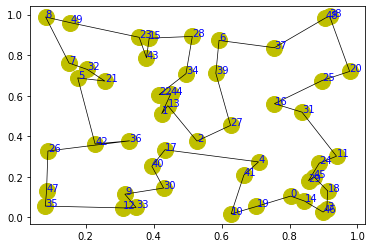

step:4185/5000, actic loss:0.455, critic loss:2.581, L:9.073, 0min2sec
step:4186/5000, actic loss:0.455, critic loss:2.580, L:9.073, 0min1sec
step:4187/5000, actic loss:0.455, critic loss:2.580, L:9.072, 0min1sec
step:4188/5000, actic loss:0.456, critic loss:2.579, L:9.072, 0min1sec
step:4189/5000, actic loss:0.456, critic loss:2.578, L:9.071, 0min1sec
distance:7.084
tensor([36, 23, 26, 20, 33,  7, 14, 43, 39, 38,  0, 40, 11,  2, 19,  9, 18, 22,
         5,  3, 48, 16, 15, 17, 47, 24, 21, 41, 44, 12, 34, 29, 37, 27, 49,  4,
        45, 42, 31, 30, 10, 35,  1, 25, 13, 46,  8,  6, 28, 32])


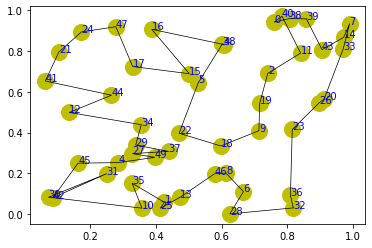

step:4190/5000, actic loss:0.456, critic loss:2.578, L:9.071, 0min2sec
step:4191/5000, actic loss:0.455, critic loss:2.577, L:9.070, 0min2sec
step:4192/5000, actic loss:0.455, critic loss:2.577, L:9.070, 0min2sec
step:4193/5000, actic loss:0.454, critic loss:2.576, L:9.069, 0min2sec
step:4194/5000, actic loss:0.454, critic loss:2.576, L:9.069, 0min2sec
distance:7.718
tensor([21, 31, 36, 29,  0, 10,  3, 19, 42,  5, 22, 17, 12, 26,  7,  6, 47, 20,
        16, 41, 34, 24, 33,  1, 30, 48, 44, 25,  4,  8, 35, 13, 38, 23, 37,  9,
         2, 18, 45, 39, 32, 14, 40, 43, 15, 49, 27, 46, 11, 28])


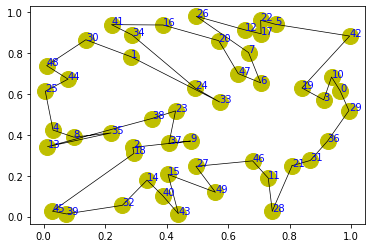

step:4195/5000, actic loss:0.454, critic loss:2.575, L:9.068, 0min2sec
step:4196/5000, actic loss:0.454, critic loss:2.575, L:9.068, 0min1sec
step:4197/5000, actic loss:0.454, critic loss:2.574, L:9.067, 0min1sec
step:4198/5000, actic loss:0.454, critic loss:2.573, L:9.067, 0min1sec
step:4199/5000, actic loss:0.454, critic loss:2.573, L:9.066, 0min1sec
distance:7.145
tensor([40, 19, 23, 44, 45, 35, 14, 16, 10, 27, 30, 33, 43,  4, 34,  0,  3, 22,
        48, 31, 49, 17,  1, 12,  8, 37, 20,  6, 18, 28,  7, 47, 32, 15, 42, 25,
        11, 26, 24,  5, 13,  2, 38, 39, 29, 36, 21, 41,  9, 46])


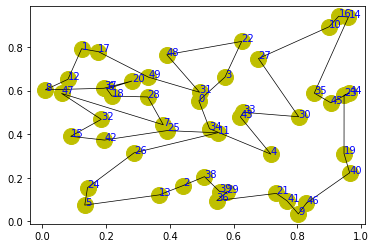

step:4200/5000, actic loss:0.453, critic loss:2.572, L:9.066, 0min2sec
step:4201/5000, actic loss:0.452, critic loss:2.572, L:9.065, 0min1sec
step:4202/5000, actic loss:0.452, critic loss:2.571, L:9.065, 0min2sec
step:4203/5000, actic loss:0.452, critic loss:2.571, L:9.064, 0min2sec
step:4204/5000, actic loss:0.452, critic loss:2.570, L:9.064, 0min2sec
distance:6.785
tensor([28, 41, 31,  3, 40,  2, 11, 33, 30,  9, 24, 12, 42,  4, 17,  6, 25, 22,
        15, 46, 35, 32,  5, 16, 39, 21, 18, 47, 38,  7, 14,  1, 44, 49, 43, 19,
        29,  0, 48, 23, 34, 20, 45, 37, 13, 26, 10,  8, 36, 27])


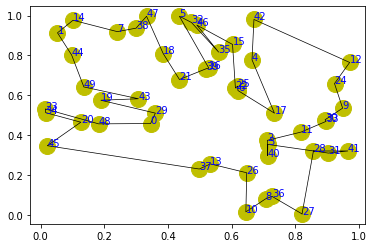

step:4205/5000, actic loss:0.452, critic loss:2.570, L:9.064, 0min2sec
step:4206/5000, actic loss:0.453, critic loss:2.569, L:9.063, 0min1sec
step:4207/5000, actic loss:0.453, critic loss:2.569, L:9.063, 0min1sec
step:4208/5000, actic loss:0.452, critic loss:2.568, L:9.062, 0min1sec
step:4209/5000, actic loss:0.451, critic loss:2.567, L:9.062, 0min1sec
distance:7.245
tensor([29, 44, 18, 48,  3, 12, 21, 42,  8, 13, 24, 11,  2,  0, 30, 35, 10, 20,
        41, 37, 40,  7, 43, 34,  5,  4, 22, 39, 16, 23,  6, 27, 46, 15, 47, 14,
        28, 26, 38,  9, 17, 19, 45, 25,  1, 36, 32, 49, 31, 33])


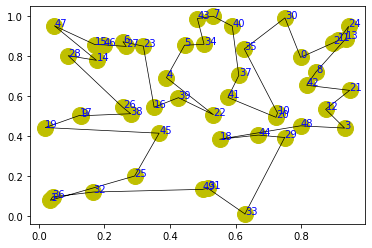

step:4210/5000, actic loss:0.451, critic loss:2.567, L:9.061, 0min2sec
step:4211/5000, actic loss:0.451, critic loss:2.566, L:9.061, 0min1sec
step:4212/5000, actic loss:0.451, critic loss:2.566, L:9.060, 0min1sec
step:4213/5000, actic loss:0.451, critic loss:2.565, L:9.060, 0min2sec
step:4214/5000, actic loss:0.451, critic loss:2.565, L:9.059, 0min2sec
distance:6.799
tensor([ 5, 33, 38, 43, 37, 48,  6, 26, 34, 23,  4,  9, 36,  0,  8, 15, 24, 17,
        13, 11, 32, 40, 31, 16, 19, 44, 35,  3, 28, 21, 45, 22, 25,  2, 12, 30,
        46, 29, 10, 41, 18, 14, 42, 49,  1, 47, 20, 39, 27,  7])


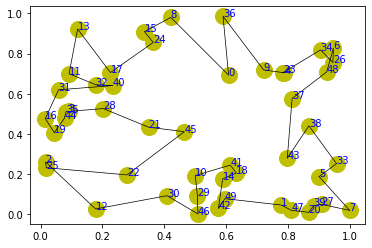

step:4215/5000, actic loss:0.450, critic loss:2.564, L:9.059, 0min2sec
step:4216/5000, actic loss:0.450, critic loss:2.564, L:9.058, 0min1sec
step:4217/5000, actic loss:0.450, critic loss:2.563, L:9.058, 0min1sec
step:4218/5000, actic loss:0.450, critic loss:2.562, L:9.057, 0min1sec
step:4219/5000, actic loss:0.450, critic loss:2.562, L:9.057, 0min1sec
distance:7.364
tensor([17, 29, 24,  0, 34,  7, 10, 36,  1,  9,  3, 33, 14, 13,  2, 11, 26, 23,
        40,  8,  6, 16, 22, 37, 31, 45, 18,  4, 30, 39,  5, 44, 41, 21, 25, 43,
        35, 49, 15, 20, 48, 32, 38, 42, 47, 27, 28, 12, 46, 19])


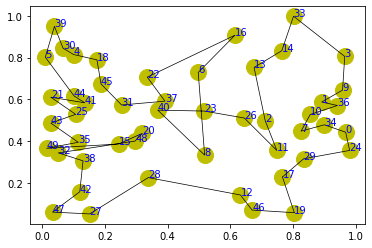

step:4220/5000, actic loss:0.450, critic loss:2.561, L:9.056, 0min2sec
step:4221/5000, actic loss:0.449, critic loss:2.561, L:9.056, 0min1sec
step:4222/5000, actic loss:0.449, critic loss:2.560, L:9.055, 0min1sec
step:4223/5000, actic loss:0.449, critic loss:2.560, L:9.055, 0min2sec
step:4224/5000, actic loss:0.449, critic loss:2.559, L:9.054, 0min2sec
distance:6.563
tensor([26, 17,  6, 41, 28, 40, 14, 46, 23, 13, 31,  0, 10,  9, 49,  8, 47,  3,
        21, 39, 30, 44, 18, 19, 42, 20, 24,  2, 34, 15,  7, 33, 22, 25, 32,  4,
        37,  5, 12, 38, 11, 45, 29, 16, 35, 27, 48,  1, 43, 36])


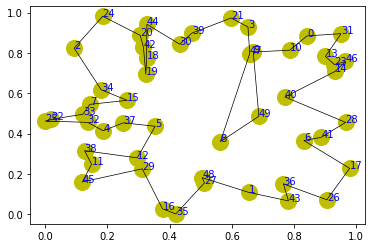

step:4225/5000, actic loss:0.449, critic loss:2.559, L:9.054, 0min2sec
step:4226/5000, actic loss:0.449, critic loss:2.558, L:9.053, 0min1sec
step:4227/5000, actic loss:0.449, critic loss:2.558, L:9.053, 0min1sec
step:4228/5000, actic loss:0.448, critic loss:2.557, L:9.052, 0min1sec
step:4229/5000, actic loss:0.448, critic loss:2.556, L:9.052, 0min1sec
distance:6.715
tensor([23, 37, 13, 22, 25, 27, 20,  3, 18, 24, 16,  4, 30, 48,  9, 34, 21, 33,
        28, 26, 49, 46, 10, 40,  0, 17,  8, 35, 19, 43,  1, 38, 29, 11, 39, 12,
         5, 44, 14, 32, 36, 42,  7, 45,  2, 15, 41, 47, 31,  6])


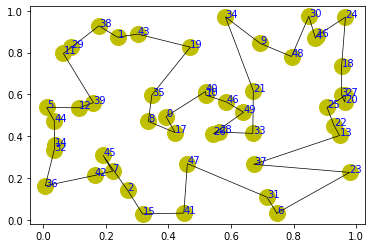

step:4230/5000, actic loss:0.448, critic loss:2.556, L:9.051, 0min2sec
step:4231/5000, actic loss:0.447, critic loss:2.555, L:9.051, 0min1sec
step:4232/5000, actic loss:0.447, critic loss:2.555, L:9.050, 0min1sec
step:4233/5000, actic loss:0.447, critic loss:2.554, L:9.050, 0min1sec
step:4234/5000, actic loss:0.447, critic loss:2.554, L:9.049, 0min1sec
distance:7.458
tensor([47, 31, 41,  0,  5, 37, 28, 17,  6, 12, 15,  4, 34, 33, 39, 21, 48, 42,
        38, 46, 18, 19, 22, 40, 49,  1,  7,  9, 26, 32, 35, 45, 20, 44, 13, 36,
         3, 11,  8, 10, 29, 25, 30,  2, 24, 16, 43, 23, 27, 14])


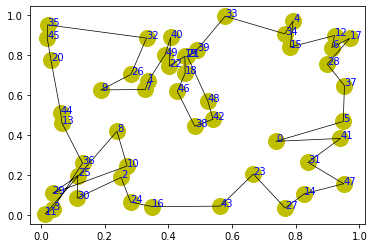

step:4235/5000, actic loss:0.447, critic loss:2.553, L:9.049, 0min2sec
step:4236/5000, actic loss:0.447, critic loss:2.553, L:9.048, 0min2sec
step:4237/5000, actic loss:0.447, critic loss:2.552, L:9.048, 0min2sec
step:4238/5000, actic loss:0.446, critic loss:2.551, L:9.048, 0min1sec
step:4239/5000, actic loss:0.446, critic loss:2.551, L:9.047, 0min1sec
distance:7.577
tensor([34,  7,  8, 21, 26, 23, 35, 42, 36, 40, 48,  3,  2, 13, 28, 24, 19, 18,
        44, 29, 27, 39, 15, 10, 11, 49, 46, 16, 30, 45, 31, 43,  0, 12, 17,  1,
        33, 47, 37, 25, 38,  6, 32, 14,  5,  9, 20, 22,  4, 41])


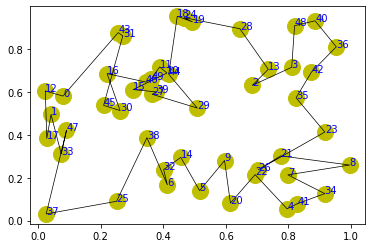

step:4240/5000, actic loss:0.446, critic loss:2.550, L:9.047, 0min2sec
step:4241/5000, actic loss:0.446, critic loss:2.550, L:9.046, 0min1sec
step:4242/5000, actic loss:0.446, critic loss:2.549, L:9.046, 0min1sec
step:4243/5000, actic loss:0.446, critic loss:2.549, L:9.045, 0min1sec
step:4244/5000, actic loss:0.446, critic loss:2.548, L:9.045, 0min1sec
distance:6.466
tensor([24, 19, 23, 45, 43, 13, 37, 17, 16, 22,  4, 26, 27,  7, 39, 36, 33, 38,
        10, 11, 12, 32, 47, 30,  3, 34, 41, 35, 44, 40, 29,  5, 42, 18, 48,  0,
         6,  8, 20, 15, 25,  1, 46, 21,  9, 28, 49,  2, 31, 14])


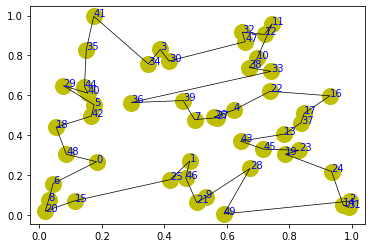

step:4245/5000, actic loss:0.446, critic loss:2.548, L:9.044, 0min2sec
step:4246/5000, actic loss:0.445, critic loss:2.547, L:9.044, 0min1sec
step:4247/5000, actic loss:0.445, critic loss:2.547, L:9.043, 0min1sec
step:4248/5000, actic loss:0.445, critic loss:2.546, L:9.043, 0min1sec
step:4249/5000, actic loss:0.445, critic loss:2.545, L:9.042, 0min1sec
distance:6.788
tensor([ 0, 34,  4, 11, 48, 22, 38, 30, 41, 12, 43,  8, 46, 47, 15, 26, 37, 49,
         9,  6, 29, 14, 39,  3, 44, 36, 25, 35,  5,  2, 31, 42, 18, 33, 23, 40,
        24, 28,  7, 27, 13, 20, 45,  1, 19, 32, 17, 21, 16, 10])


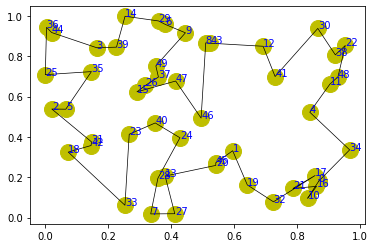

step:4250/5000, actic loss:0.445, critic loss:2.545, L:9.042, 0min2sec
step:4251/5000, actic loss:0.445, critic loss:2.544, L:9.041, 0min2sec
step:4252/5000, actic loss:0.445, critic loss:2.544, L:9.041, 0min1sec
step:4253/5000, actic loss:0.445, critic loss:2.543, L:9.040, 0min1sec
step:4254/5000, actic loss:0.444, critic loss:2.543, L:9.040, 0min1sec
distance:6.832
tensor([23, 38, 19, 49, 30, 24, 14,  1, 42, 48, 28, 47, 20, 11, 32,  4, 43,  8,
         0, 25, 13,  5, 18, 45, 46, 39, 22, 40, 44, 36, 10, 17, 21,  9,  3, 41,
        33, 31,  6, 37, 35, 16, 26,  2, 34, 27, 15, 29, 12,  7])


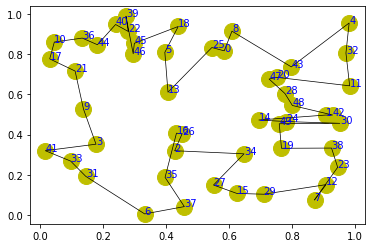

step:4255/5000, actic loss:0.444, critic loss:2.542, L:9.039, 0min2sec
step:4256/5000, actic loss:0.443, critic loss:2.542, L:9.039, 0min1sec
step:4257/5000, actic loss:0.443, critic loss:2.541, L:9.038, 0min1sec
step:4258/5000, actic loss:0.442, critic loss:2.541, L:9.038, 0min1sec
step:4259/5000, actic loss:0.442, critic loss:2.540, L:9.037, 0min1sec
distance:6.837
tensor([33,  2, 43, 12, 48, 38, 30, 22,  7, 25, 10, 18,  1, 39, 11,  9, 14, 16,
        45, 19, 31, 49, 47, 34, 40,  0, 42, 13, 36, 41, 23,  5, 32, 27, 17, 28,
        15, 24,  8, 35, 20, 26, 21,  6,  4, 37, 46,  3, 44, 29])


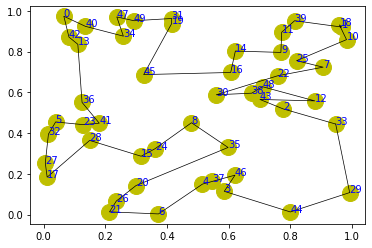

step:4260/5000, actic loss:0.442, critic loss:2.540, L:9.037, 0min2sec
step:4261/5000, actic loss:0.443, critic loss:2.539, L:9.036, 0min1sec
step:4262/5000, actic loss:0.443, critic loss:2.538, L:9.036, 0min1sec
step:4263/5000, actic loss:0.443, critic loss:2.538, L:9.035, 0min2sec
step:4264/5000, actic loss:0.444, critic loss:2.537, L:9.035, 0min2sec
distance:7.445
tensor([46, 28, 14, 38, 11,  9,  6, 22, 42,  8, 33, 10, 27, 47, 48, 19, 34, 40,
        24, 13, 29, 23, 25, 12, 41, 17,  4, 44, 20, 21, 39, 30, 26,  3,  5,  0,
        32, 15,  1, 16, 35, 36, 37, 45, 43,  7,  2, 18, 31, 49])


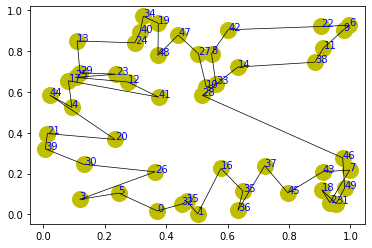

step:4265/5000, actic loss:0.444, critic loss:2.537, L:9.034, 0min2sec
step:4266/5000, actic loss:0.443, critic loss:2.536, L:9.034, 0min1sec
step:4267/5000, actic loss:0.442, critic loss:2.536, L:9.033, 0min1sec
step:4268/5000, actic loss:0.441, critic loss:2.535, L:9.033, 0min1sec
step:4269/5000, actic loss:0.440, critic loss:2.535, L:9.032, 0min1sec
distance:6.084
tensor([39, 17, 45, 15, 33, 20, 41,  2, 12, 25,  3, 24, 42, 47, 13, 40, 38, 14,
        10,  4,  1, 19, 23, 37, 49, 34,  0,  9, 30, 18,  5, 43, 21, 26, 16, 22,
        36, 28,  7, 27, 29, 46,  6, 11, 31, 35,  8, 44, 48, 32])


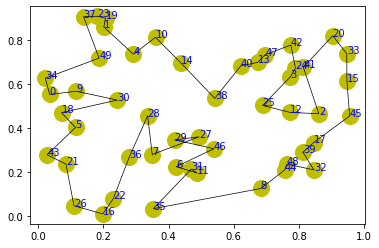

step:4270/5000, actic loss:0.440, critic loss:2.534, L:9.032, 0min2sec
step:4271/5000, actic loss:0.440, critic loss:2.534, L:9.031, 0min1sec
step:4272/5000, actic loss:0.440, critic loss:2.533, L:9.031, 0min1sec
step:4273/5000, actic loss:0.440, critic loss:2.533, L:9.030, 0min1sec
step:4274/5000, actic loss:0.441, critic loss:2.532, L:9.030, 0min1sec
distance:6.562
tensor([ 2, 48, 38, 11,  5, 40, 34, 42, 27, 49, 44, 17, 41, 37, 10, 31, 20, 28,
        21, 33,  9, 43, 25, 23, 29, 46, 39, 36,  6, 14, 13,  4, 16, 24,  0, 18,
        45, 26, 22, 32, 30, 35,  3, 19,  7,  8, 12, 47,  1, 15])


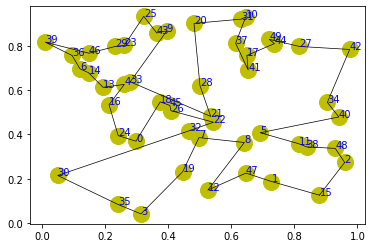

step:4275/5000, actic loss:0.441, critic loss:2.532, L:9.029, 0min2sec
step:4276/5000, actic loss:0.441, critic loss:2.531, L:9.029, 0min1sec
step:4277/5000, actic loss:0.440, critic loss:2.531, L:9.028, 0min1sec
step:4278/5000, actic loss:0.439, critic loss:2.530, L:9.028, 0min1sec
step:4279/5000, actic loss:0.439, critic loss:2.530, L:9.028, 0min1sec
distance:7.976
tensor([47, 33, 44, 22, 24,  0,  6, 25, 34, 35, 27, 29,  7, 42, 49, 31,  2, 30,
        37,  8, 17,  4, 39, 11, 19, 10, 38,  1, 40, 12, 43, 16, 20, 18, 21,  9,
        14, 41, 23, 32,  5, 26, 45, 28, 48, 13, 36, 46,  3, 15])


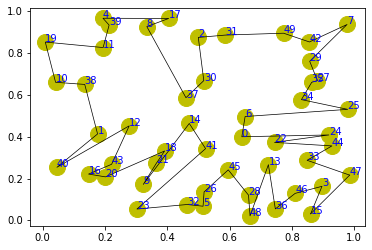

step:4280/5000, actic loss:0.438, critic loss:2.529, L:9.027, 0min2sec
step:4281/5000, actic loss:0.438, critic loss:2.529, L:9.027, 0min1sec
step:4282/5000, actic loss:0.438, critic loss:2.528, L:9.026, 0min1sec
step:4283/5000, actic loss:0.438, critic loss:2.527, L:9.026, 0min1sec
step:4284/5000, actic loss:0.438, critic loss:2.527, L:9.025, 0min1sec
distance:7.038
tensor([ 0,  6, 19, 36, 28,  8,  2, 43, 20, 31, 14, 24, 34,  9, 11,  5, 16, 13,
        49,  3, 39,  1, 18, 17, 22, 26, 15, 30, 35, 10, 29, 32, 46, 23, 40, 45,
        48,  4, 25, 38, 37, 41, 12, 47, 21, 42,  7, 27, 44, 33])


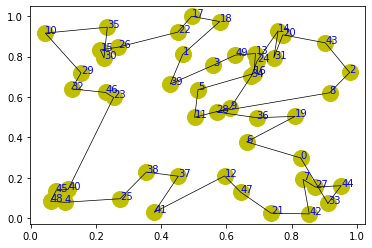

step:4285/5000, actic loss:0.437, critic loss:2.526, L:9.025, 0min2sec
step:4286/5000, actic loss:0.437, critic loss:2.526, L:9.024, 0min2sec
step:4287/5000, actic loss:0.436, critic loss:2.525, L:9.024, 0min2sec
step:4288/5000, actic loss:0.436, critic loss:2.525, L:9.023, 0min1sec
step:4289/5000, actic loss:0.436, critic loss:2.524, L:9.023, 0min1sec
distance:6.947
tensor([ 8, 22, 15,  3,  9, 39, 12, 44, 27, 10, 42, 36,  4,  0, 41, 34, 33, 38,
        37,  7, 13, 45, 18, 20, 47, 11,  5, 46, 48, 21, 23, 32, 16,  1, 17,  2,
        40, 43, 31, 29, 28, 30, 49, 14, 26, 35, 19,  6, 24, 25])


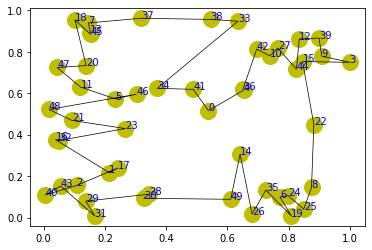

step:4290/5000, actic loss:0.436, critic loss:2.524, L:9.022, 0min2sec
step:4291/5000, actic loss:0.436, critic loss:2.523, L:9.022, 0min1sec
step:4292/5000, actic loss:0.436, critic loss:2.523, L:9.021, 0min1sec
step:4293/5000, actic loss:0.436, critic loss:2.522, L:9.021, 0min1sec
step:4294/5000, actic loss:0.435, critic loss:2.522, L:9.021, 0min1sec
distance:7.273
tensor([31,  6, 28, 45,  2, 33, 18, 16, 41,  7, 24, 38, 34,  3, 17, 48, 40, 12,
        43,  9, 29, 30, 10, 39, 14, 25,  8, 20, 37, 44,  4, 35, 47, 11, 26, 13,
        19, 21,  1, 27, 46, 49,  0, 36, 42, 32, 22, 23,  5, 15])


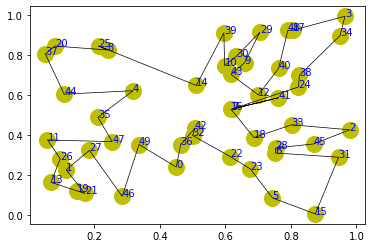

step:4295/5000, actic loss:0.435, critic loss:2.521, L:9.020, 0min2sec
step:4296/5000, actic loss:0.436, critic loss:2.521, L:9.020, 0min1sec
step:4297/5000, actic loss:0.436, critic loss:2.520, L:9.019, 0min1sec
step:4298/5000, actic loss:0.436, critic loss:2.519, L:9.019, 0min1sec
step:4299/5000, actic loss:0.436, critic loss:2.519, L:9.018, 0min2sec
distance:7.160
tensor([43, 22,  7, 29, 39, 14, 33,  3, 15, 44, 23, 40, 30, 37, 28,  8, 26,  6,
        18, 24, 31, 42,  0, 19, 38, 47, 36, 46, 35, 11,  4, 41,  2, 20,  1, 13,
        25, 49, 21,  5, 12, 45, 16, 48, 10, 27, 17,  9, 34, 32])


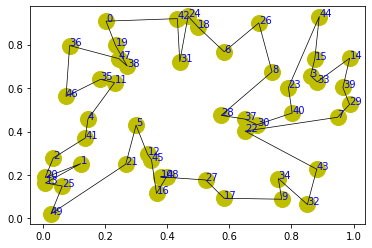

step:4300/5000, actic loss:0.436, critic loss:2.518, L:9.018, 0min2sec
step:4301/5000, actic loss:0.435, critic loss:2.518, L:9.017, 0min1sec
step:4302/5000, actic loss:0.435, critic loss:2.517, L:9.017, 0min1sec
step:4303/5000, actic loss:0.435, critic loss:2.517, L:9.016, 0min1sec
step:4304/5000, actic loss:0.435, critic loss:2.516, L:9.016, 0min1sec
distance:7.649
tensor([36,  8, 47,  9, 13, 39, 19, 44, 49, 46, 20, 22, 18, 10, 23,  0, 21,  6,
        12, 29, 31, 48, 14, 37,  3, 45, 17, 35,  7, 25, 38, 33, 40, 43, 26, 30,
        42, 24, 27,  2, 11,  4, 15, 34, 28, 32, 41,  5, 16,  1])


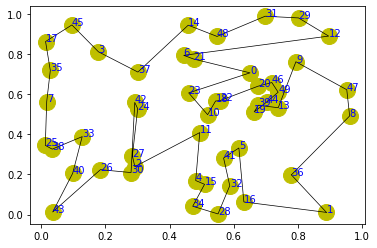

step:4305/5000, actic loss:0.435, critic loss:2.516, L:9.015, 0min2sec
step:4306/5000, actic loss:0.435, critic loss:2.515, L:9.015, 0min1sec
step:4307/5000, actic loss:0.435, critic loss:2.515, L:9.014, 0min1sec
step:4308/5000, actic loss:0.434, critic loss:2.514, L:9.014, 0min1sec
step:4309/5000, actic loss:0.434, critic loss:2.514, L:9.013, 0min1sec
distance:8.380
tensor([38, 48, 32, 14,  9, 15,  5,  0, 36, 24, 23,  7, 37, 46, 16, 26, 11,  1,
         6, 49, 30,  8, 13, 45, 29, 28, 21,  3, 27, 43, 34,  2,  4, 20, 31, 25,
        18, 22, 33, 19, 41, 47, 42, 35, 44, 39, 10, 12, 40, 17])


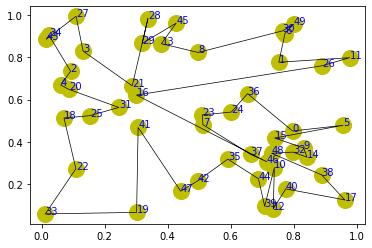

step:4310/5000, actic loss:0.433, critic loss:2.513, L:9.013, 0min2sec
step:4311/5000, actic loss:0.434, critic loss:2.513, L:9.012, 0min2sec
step:4312/5000, actic loss:0.434, critic loss:2.512, L:9.012, 0min1sec
step:4313/5000, actic loss:0.434, critic loss:2.511, L:9.011, 0min1sec
step:4314/5000, actic loss:0.434, critic loss:2.511, L:9.011, 0min1sec
distance:6.963
tensor([34, 37,  0, 35, 20, 49, 33, 30, 32, 13, 22, 45, 19, 14, 16, 17, 10,  1,
        31, 25,  4,  3, 43, 39, 41, 18,  6, 24, 40, 46, 48,  5, 15, 47, 36, 42,
         7, 11,  8, 23, 28,  9, 12, 29, 27, 26, 44, 38,  2, 21])


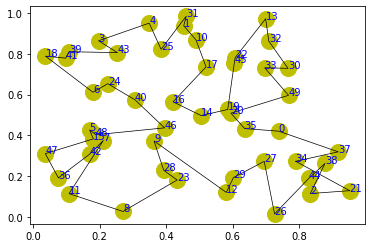

step:4315/5000, actic loss:0.434, critic loss:2.510, L:9.010, 0min2sec
step:4316/5000, actic loss:0.433, critic loss:2.510, L:9.010, 0min1sec
step:4317/5000, actic loss:0.433, critic loss:2.509, L:9.009, 0min1sec
step:4318/5000, actic loss:0.433, critic loss:2.509, L:9.009, 0min1sec
step:4319/5000, actic loss:0.433, critic loss:2.508, L:9.008, 0min1sec
distance:7.020
tensor([24, 42,  3, 27,  8, 44, 45,  4, 12, 26, 13, 39, 46,  5,  7, 43,  6, 15,
        32, 22, 21, 40, 29, 30, 19, 47, 31, 17, 35,  9, 36, 25, 41, 49,  1, 33,
        11, 38, 20,  0, 23, 48, 10, 18, 16, 34, 37, 28, 14,  2])


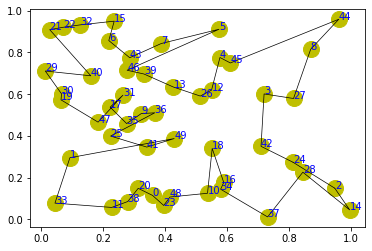

step:4320/5000, actic loss:0.433, critic loss:2.508, L:9.008, 0min2sec
step:4321/5000, actic loss:0.433, critic loss:2.507, L:9.007, 0min1sec
step:4322/5000, actic loss:0.433, critic loss:2.507, L:9.007, 0min1sec
step:4323/5000, actic loss:0.433, critic loss:2.506, L:9.006, 0min1sec
step:4324/5000, actic loss:0.433, critic loss:2.506, L:9.006, 0min1sec
distance:6.744
tensor([ 5,  7,  1, 28, 49, 37, 12,  9, 10,  2, 42, 25, 11, 33,  4, 30, 22, 19,
         0, 23, 18, 26, 14, 48, 20, 13, 45, 21,  8, 29, 39, 40,  6, 24, 17,  3,
        47, 16, 32, 27, 31, 36, 35, 15, 38, 41, 46, 43, 34, 44])


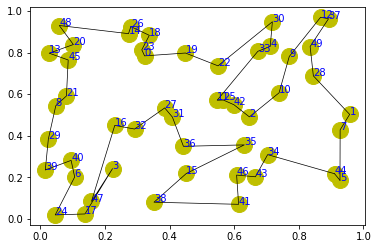

step:4325/5000, actic loss:0.432, critic loss:2.505, L:9.005, 0min2sec
step:4326/5000, actic loss:0.431, critic loss:2.505, L:9.005, 0min2sec
step:4327/5000, actic loss:0.431, critic loss:2.504, L:9.005, 0min1sec
step:4328/5000, actic loss:0.431, critic loss:2.504, L:9.004, 0min1sec
step:4329/5000, actic loss:0.432, critic loss:2.503, L:9.004, 0min1sec
distance:6.478
tensor([ 9,  3,  0,  8, 31, 45, 43,  5,  1, 40, 19, 25, 35, 49, 36, 13, 44, 30,
        17, 27, 33,  6, 18, 34, 38, 26, 47,  4, 32, 24, 23, 41, 14, 12, 21, 11,
        20, 16,  7,  2, 15, 29, 10, 28, 22, 42, 46, 39, 37, 48])


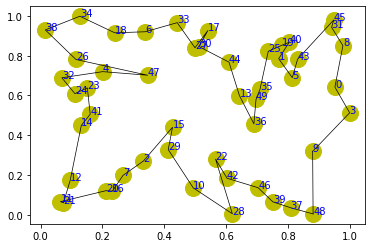

step:4330/5000, actic loss:0.432, critic loss:2.503, L:9.003, 0min2sec
step:4331/5000, actic loss:0.432, critic loss:2.502, L:9.003, 0min1sec
step:4332/5000, actic loss:0.433, critic loss:2.502, L:9.002, 0min1sec
step:4333/5000, actic loss:0.433, critic loss:2.501, L:9.002, 0min1sec
step:4334/5000, actic loss:0.432, critic loss:2.501, L:9.001, 0min1sec
distance:6.869
tensor([29,  3, 40, 25, 14, 31, 37, 18,  8, 16, 12,  9, 45, 32, 20, 43, 35, 27,
         4, 46, 34, 41, 38, 21, 30, 13, 24, 33, 10,  6, 36, 17,  7,  1, 49, 28,
        26,  0, 47, 22, 48, 11, 39, 19, 44, 42,  2,  5, 15, 23])


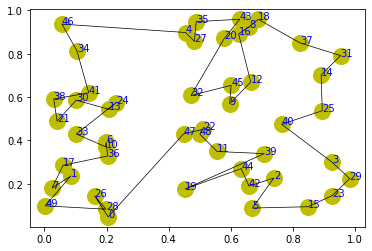

step:4335/5000, actic loss:0.432, critic loss:2.500, L:9.001, 0min2sec
step:4336/5000, actic loss:0.432, critic loss:2.499, L:9.000, 0min2sec
step:4337/5000, actic loss:0.432, critic loss:2.499, L:9.000, 0min1sec
step:4338/5000, actic loss:0.432, critic loss:2.498, L:9.000, 0min1sec
step:4339/5000, actic loss:0.432, critic loss:2.498, L:8.999, 0min1sec
distance:7.258
tensor([ 2,  1, 21, 14, 18, 13, 19,  0, 39, 25, 46,  5, 47, 40, 24, 11,  4, 43,
         9, 35, 26, 41, 28, 20, 48, 15, 36, 49,  6, 32, 23, 22, 27, 45, 44, 30,
        29, 31, 10, 42, 33, 34,  7, 17, 16,  8, 37, 38,  3, 12])


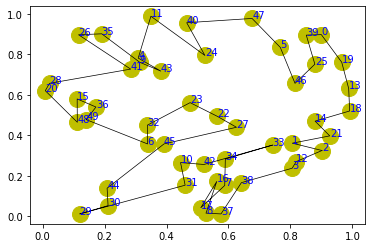

step:4340/5000, actic loss:0.432, critic loss:2.497, L:8.999, 0min2sec
step:4341/5000, actic loss:0.432, critic loss:2.497, L:8.998, 0min1sec
step:4342/5000, actic loss:0.431, critic loss:2.496, L:8.998, 0min1sec
step:4343/5000, actic loss:0.431, critic loss:2.496, L:8.997, 0min1sec
step:4344/5000, actic loss:0.431, critic loss:2.495, L:8.997, 0min1sec
distance:7.305
tensor([47, 43, 45, 20, 17, 35,  1, 15, 11, 32, 46, 28, 49,  4, 10, 26, 18,  6,
        21, 24, 42, 12, 44,  9, 41, 29, 30, 38,  0,  2, 33, 48, 14, 25, 36, 34,
        13, 19, 27,  3, 23, 16,  7,  5, 37,  8, 40, 22, 39, 31])


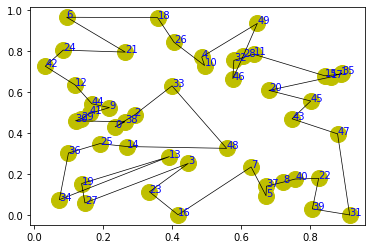

step:4345/5000, actic loss:0.431, critic loss:2.495, L:8.996, 0min2sec
step:4346/5000, actic loss:0.431, critic loss:2.494, L:8.996, 0min2sec
step:4347/5000, actic loss:0.431, critic loss:2.494, L:8.996, 0min2sec
step:4348/5000, actic loss:0.431, critic loss:2.493, L:8.995, 0min1sec
step:4349/5000, actic loss:0.431, critic loss:2.493, L:8.995, 0min1sec
distance:7.016
tensor([37, 38, 31, 14, 33, 22, 48, 41, 30, 17, 49, 23, 43, 10, 47, 36,  0, 13,
        25, 16, 35, 40, 26, 28,  4, 39,  3, 11, 44, 19, 29,  9, 42, 12, 21,  7,
         6, 34, 24, 18,  1,  5, 32, 15,  2, 46, 27, 45,  8, 20])


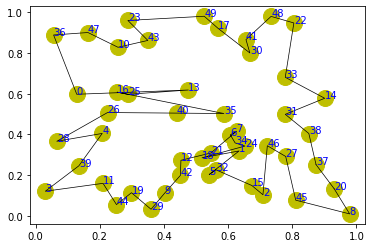

step:4350/5000, actic loss:0.430, critic loss:2.492, L:8.994, 0min2sec
step:4351/5000, actic loss:0.430, critic loss:2.492, L:8.994, 0min1sec
step:4352/5000, actic loss:0.429, critic loss:2.491, L:8.993, 0min1sec
step:4353/5000, actic loss:0.430, critic loss:2.491, L:8.993, 0min1sec
step:4354/5000, actic loss:0.430, critic loss:2.490, L:8.992, 0min1sec
distance:7.055
tensor([48, 24, 16, 34, 39, 29, 19, 36, 37, 14, 11, 13,  1, 31, 12, 23, 47, 49,
        43, 42, 32, 44,  9, 22, 38, 41, 28, 26,  3, 25,  4, 33, 17, 18, 15,  8,
         7, 40, 45, 35, 46, 20,  0, 21, 27,  6, 30,  2,  5, 10])


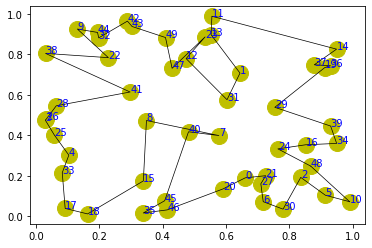

step:4355/5000, actic loss:0.430, critic loss:2.490, L:8.992, 0min2sec
step:4356/5000, actic loss:0.430, critic loss:2.489, L:8.991, 0min2sec
step:4357/5000, actic loss:0.430, critic loss:2.489, L:8.991, 0min2sec
step:4358/5000, actic loss:0.429, critic loss:2.488, L:8.991, 0min1sec
step:4359/5000, actic loss:0.428, critic loss:2.488, L:8.990, 0min1sec
distance:6.451
tensor([35, 15, 16, 13, 20, 48,  8, 29,  2, 21, 25, 49, 23,  6, 22, 36, 43, 32,
        47, 37, 38, 26,  0, 45, 12, 30,  4, 33, 39, 42,  7, 24, 34, 18, 19,  1,
        14,  9, 28,  5, 40, 41, 31, 27, 17,  3, 46, 44, 11, 10])


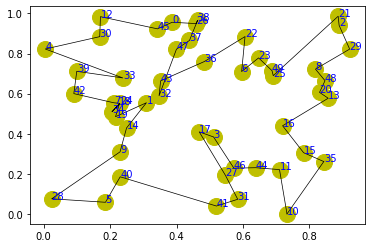

step:4360/5000, actic loss:0.428, critic loss:2.487, L:8.990, 0min2sec
step:4361/5000, actic loss:0.428, critic loss:2.487, L:8.989, 0min1sec
step:4362/5000, actic loss:0.428, critic loss:2.486, L:8.989, 0min1sec
step:4363/5000, actic loss:0.428, critic loss:2.486, L:8.988, 0min1sec
step:4364/5000, actic loss:0.428, critic loss:2.485, L:8.988, 0min1sec
distance:6.677
tensor([14, 38, 29, 22, 48, 20, 39,  7, 12, 25,  9,  6, 36, 32,  2,  5,  4, 43,
        45, 34,  8, 21,  1, 46, 26, 30, 40, 47, 18, 16, 49, 27, 24, 10, 41, 23,
        42,  3, 33, 44, 37, 19, 35, 28, 13, 11, 31, 17,  0, 15])


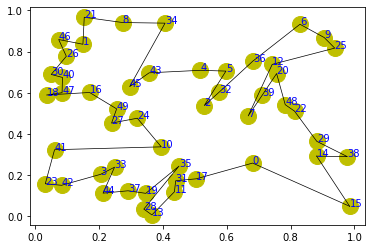

step:4365/5000, actic loss:0.427, critic loss:2.484, L:8.987, 0min2sec
step:4366/5000, actic loss:0.427, critic loss:2.484, L:8.987, 0min2sec
step:4367/5000, actic loss:0.426, critic loss:2.483, L:8.986, 0min2sec
step:4368/5000, actic loss:0.426, critic loss:2.483, L:8.986, 0min1sec
step:4369/5000, actic loss:0.426, critic loss:2.482, L:8.985, 0min1sec
distance:6.012
tensor([10,  6, 34, 42, 14,  1,  2, 48, 46, 26, 19, 17,  8, 23, 11, 21, 16, 49,
        18, 13, 40, 32, 20, 31, 38, 45, 44,  3,  5, 24, 39, 25, 30, 47, 27,  7,
        36, 41,  0, 22, 12, 35,  4, 28, 43, 15, 29,  9, 33, 37])


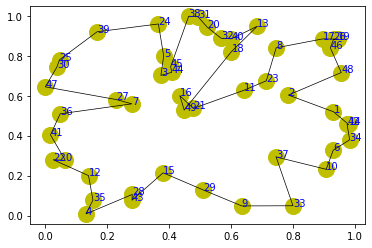

step:4370/5000, actic loss:0.426, critic loss:2.482, L:8.985, 0min2sec
step:4371/5000, actic loss:0.426, critic loss:2.481, L:8.985, 0min1sec
step:4372/5000, actic loss:0.427, critic loss:2.481, L:8.984, 0min1sec
step:4373/5000, actic loss:0.428, critic loss:2.480, L:8.984, 0min1sec
step:4374/5000, actic loss:0.428, critic loss:2.480, L:8.983, 0min1sec
distance:6.642
tensor([22, 15, 44, 31, 29, 16, 34, 11, 26, 25,  7, 21, 38, 13, 10,  4, 37,  3,
         9, 14,  0, 24,  6, 19, 23, 12, 33, 43, 30,  8, 49, 35, 28, 20, 36, 18,
         1, 46,  5, 48, 39, 47, 32,  2, 17, 27, 40, 41, 42, 45])


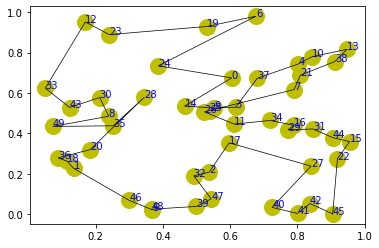

step:4375/5000, actic loss:0.428, critic loss:2.479, L:8.983, 0min2sec
step:4376/5000, actic loss:0.428, critic loss:2.479, L:8.982, 0min1sec
step:4377/5000, actic loss:0.427, critic loss:2.478, L:8.982, 0min1sec
step:4378/5000, actic loss:0.426, critic loss:2.478, L:8.981, 0min1sec
step:4379/5000, actic loss:0.425, critic loss:2.477, L:8.981, 0min1sec
distance:6.614
tensor([31,  5, 23, 21, 25, 43,  8, 11, 18, 28, 49,  3,  0,  6, 48, 24, 40,  1,
        14, 10,  7,  2,  4, 44, 46, 20, 34, 39, 32, 38, 22, 12, 42, 30, 37, 19,
        36, 41, 15, 27, 35,  9, 17, 29, 33, 45, 16, 47, 13, 26])


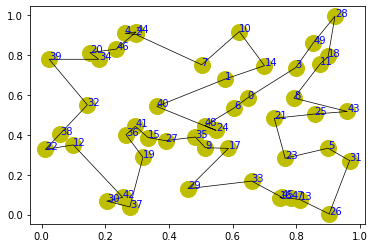

step:4380/5000, actic loss:0.424, critic loss:2.477, L:8.980, 0min1sec
step:4381/5000, actic loss:0.423, critic loss:2.476, L:8.980, 0min1sec
step:4382/5000, actic loss:0.424, critic loss:2.476, L:8.979, 0min1sec
step:4383/5000, actic loss:0.424, critic loss:2.475, L:8.979, 0min1sec
step:4384/5000, actic loss:0.425, critic loss:2.475, L:8.978, 0min1sec
distance:7.063
tensor([48,  7, 46,  0, 12,  1, 36, 30, 39, 18, 16, 34, 41, 24, 44, 27,  4, 42,
        15,  9, 28, 35,  2, 37,  8, 29, 10, 38, 23, 20, 49,  6,  5, 43, 47, 32,
        45, 26, 22, 11, 17, 19, 33, 14,  3, 21, 31, 40, 25, 13])


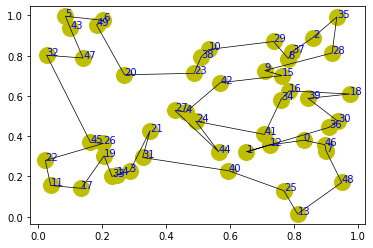

step:4385/5000, actic loss:0.425, critic loss:2.474, L:8.978, 0min1sec
step:4386/5000, actic loss:0.425, critic loss:2.474, L:8.977, 0min1sec
step:4387/5000, actic loss:0.425, critic loss:2.473, L:8.977, 0min1sec
step:4388/5000, actic loss:0.425, critic loss:2.473, L:8.976, 0min1sec
step:4389/5000, actic loss:0.424, critic loss:2.472, L:8.976, 0min1sec
distance:6.564
tensor([24, 22,  4,  9,  6, 21, 10, 34, 17, 27, 48, 20,  7, 29, 12, 19, 44, 31,
        49, 36, 16, 23, 33,  5, 28,  1, 18, 26, 37, 25,  8, 11,  2, 13, 39, 14,
        40, 38, 15, 47, 35, 42, 30, 46, 43,  0,  3, 41, 45, 32])


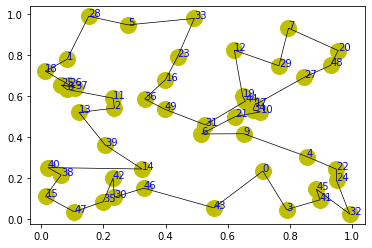

step:4390/5000, actic loss:0.424, critic loss:2.472, L:8.975, 0min2sec
step:4391/5000, actic loss:0.424, critic loss:2.471, L:8.975, 0min1sec
step:4392/5000, actic loss:0.424, critic loss:2.471, L:8.975, 0min1sec
step:4393/5000, actic loss:0.424, critic loss:2.470, L:8.974, 0min1sec
step:4394/5000, actic loss:0.424, critic loss:2.470, L:8.974, 0min1sec
distance:6.785
tensor([21, 15, 28, 46, 26, 40, 35, 22,  3, 48, 37,  5, 38, 25, 16, 39, 11, 27,
        34,  0, 17,  1, 33, 13, 32, 20,  6, 18, 43, 42, 49,  2, 14,  8, 10,  9,
         7,  4, 19, 47, 41, 12, 45, 23, 31, 24, 36, 30, 44, 29])


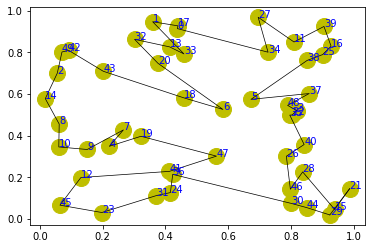

step:4395/5000, actic loss:0.424, critic loss:2.469, L:8.973, 0min1sec
step:4396/5000, actic loss:0.423, critic loss:2.469, L:8.973, 0min1sec
step:4397/5000, actic loss:0.423, critic loss:2.468, L:8.972, 0min1sec
step:4398/5000, actic loss:0.422, critic loss:2.468, L:8.972, 0min1sec
step:4399/5000, actic loss:0.422, critic loss:2.467, L:8.971, 0min1sec
distance:8.371
tensor([ 5, 19, 11, 13,  2, 46, 41, 31, 34, 25, 18, 47, 32,  9,  8, 36,  3, 14,
        44, 48,  0, 26, 23,  4, 30, 35, 22, 28, 17, 12, 20, 16, 45, 15,  6, 37,
        10, 21, 43,  7, 33, 49, 29, 42, 38,  1, 40, 27, 39, 24])


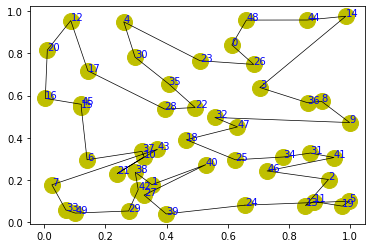

step:4400/5000, actic loss:0.422, critic loss:2.467, L:8.971, 0min1sec
step:4401/5000, actic loss:0.422, critic loss:2.466, L:8.970, 0min1sec
step:4402/5000, actic loss:0.422, critic loss:2.466, L:8.970, 0min1sec
step:4403/5000, actic loss:0.422, critic loss:2.465, L:8.970, 0min2sec
step:4404/5000, actic loss:0.421, critic loss:2.465, L:8.969, 0min1sec
distance:6.679
tensor([21, 14,  2, 31, 29, 24,  4, 26, 48, 49, 23, 28, 30, 11, 42,  3, 12, 19,
        40,  0, 25, 34, 38, 15, 44, 47,  1, 20, 43,  6, 22, 27,  5, 45, 46,  8,
        13, 35,  7, 37, 18, 39, 32, 16, 36, 41, 10, 33,  9, 17])


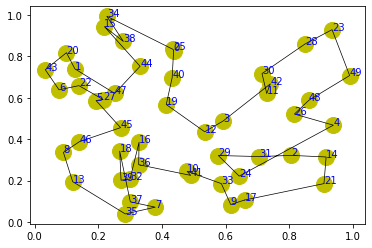

step:4405/5000, actic loss:0.420, critic loss:2.464, L:8.969, 0min1sec
step:4406/5000, actic loss:0.420, critic loss:2.464, L:8.968, 0min1sec
step:4407/5000, actic loss:0.420, critic loss:2.463, L:8.968, 0min1sec
step:4408/5000, actic loss:0.420, critic loss:2.463, L:8.967, 0min1sec
step:4409/5000, actic loss:0.420, critic loss:2.462, L:8.967, 0min1sec
distance:7.524
tensor([20, 38, 30, 26, 39,  3, 16, 47, 18, 21, 12, 27, 46,  0, 14,  7,  2, 49,
        22, 32, 31, 33, 28,  6, 40, 10, 41, 43, 13, 44, 11, 17, 48,  1, 45,  4,
        15,  8, 29, 25, 42, 34, 19, 37,  9, 35,  5, 23, 24, 36])


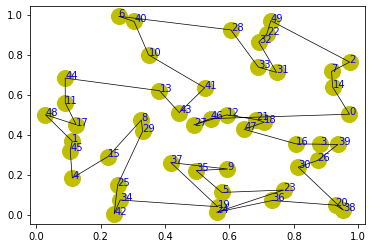

step:4410/5000, actic loss:0.420, critic loss:2.462, L:8.966, 0min1sec
step:4411/5000, actic loss:0.419, critic loss:2.461, L:8.966, 0min1sec
step:4412/5000, actic loss:0.419, critic loss:2.461, L:8.965, 0min1sec
step:4413/5000, actic loss:0.419, critic loss:2.460, L:8.965, 0min1sec
step:4414/5000, actic loss:0.419, critic loss:2.460, L:8.964, 0min1sec
distance:6.776
tensor([48, 15, 38,  1, 44, 21, 30, 10, 45, 27, 28,  6, 12,  3, 46, 42,  9,  8,
        36, 40, 19, 16, 26, 35,  0, 11,  2, 33, 23, 18, 47, 34, 17,  5, 29, 24,
        31,  4, 14, 20, 49, 32,  7, 22, 37, 39, 13, 41, 43, 25])


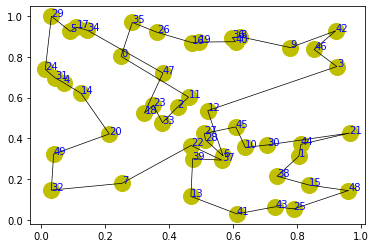

step:4415/5000, actic loss:0.419, critic loss:2.459, L:8.964, 0min2sec
step:4416/5000, actic loss:0.419, critic loss:2.459, L:8.964, 0min2sec
step:4417/5000, actic loss:0.419, critic loss:2.458, L:8.963, 0min2sec
step:4418/5000, actic loss:0.418, critic loss:2.458, L:8.963, 0min1sec
step:4419/5000, actic loss:0.418, critic loss:2.457, L:8.962, 0min1sec
distance:6.912
tensor([10,  9,  8, 45,  3, 38,  6, 44, 46, 48, 17, 28, 21, 37, 26,  1,  4, 35,
        19, 18, 32, 39, 43, 16, 13, 49, 33, 42, 34, 36, 29,  7, 47, 14, 25, 11,
        23,  0, 27, 22, 30, 24, 15, 41, 40, 31,  5, 12,  2, 20])


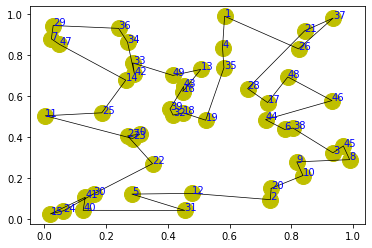

step:4420/5000, actic loss:0.418, critic loss:2.457, L:8.962, 0min2sec
step:4421/5000, actic loss:0.418, critic loss:2.456, L:8.961, 0min1sec
step:4422/5000, actic loss:0.418, critic loss:2.456, L:8.961, 0min1sec
step:4423/5000, actic loss:0.418, critic loss:2.455, L:8.960, 0min1sec
step:4424/5000, actic loss:0.418, critic loss:2.455, L:8.960, 0min1sec
distance:7.471
tensor([ 9, 19, 46, 49, 27, 17, 29,  5, 20, 44, 25, 48,  1, 38, 13, 40, 16, 22,
        12, 42, 11, 36, 24, 21, 18, 15,  2, 41,  7, 47, 23, 37, 35, 33, 34,  0,
        30,  3,  6, 10, 39, 45,  4, 28,  8, 26, 32, 14, 43, 31])


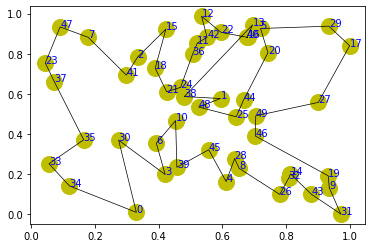

step:4425/5000, actic loss:0.418, critic loss:2.454, L:8.959, 0min1sec
step:4426/5000, actic loss:0.417, critic loss:2.454, L:8.959, 0min1sec
step:4427/5000, actic loss:0.416, critic loss:2.453, L:8.959, 0min1sec
step:4428/5000, actic loss:0.415, critic loss:2.453, L:8.958, 0min1sec
step:4429/5000, actic loss:0.415, critic loss:2.452, L:8.958, 0min1sec
distance:6.147
tensor([18,  0, 34, 15, 10, 17, 28, 22, 20, 32, 26, 42, 39, 31, 45, 48, 25,  7,
        49, 46, 43, 47, 23, 11,  9,  2,  5,  3,  4, 21, 44, 24, 41, 19, 33, 14,
        38, 30,  8, 16, 37,  6, 27, 29, 35,  1, 40, 36, 13, 12])


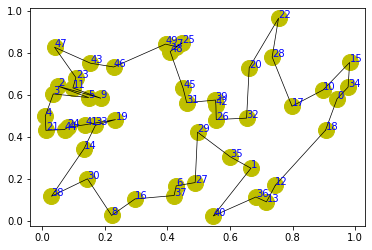

step:4430/5000, actic loss:0.415, critic loss:2.452, L:8.957, 0min2sec
step:4431/5000, actic loss:0.415, critic loss:2.451, L:8.957, 0min1sec
step:4432/5000, actic loss:0.415, critic loss:2.451, L:8.956, 0min1sec
step:4433/5000, actic loss:0.415, critic loss:2.450, L:8.956, 0min1sec
step:4434/5000, actic loss:0.414, critic loss:2.450, L:8.955, 0min1sec
distance:6.318
tensor([41, 11, 49, 39, 45, 46, 20, 47, 18,  1, 17, 12, 26, 37, 33,  5, 38, 22,
         9, 34, 48,  4, 14,  3, 24, 40, 42,  8, 27, 31, 36, 19,  6, 10, 30, 43,
        25, 21, 32, 29,  7, 28, 13, 15, 16,  2,  0, 44, 35, 23])


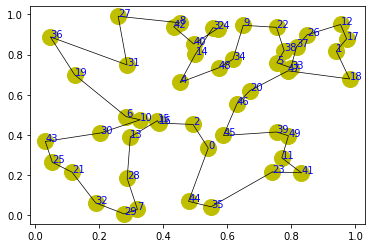

step:4435/5000, actic loss:0.413, critic loss:2.449, L:8.955, 0min1sec
step:4436/5000, actic loss:0.413, critic loss:2.449, L:8.955, 0min1sec
step:4437/5000, actic loss:0.412, critic loss:2.448, L:8.954, 0min1sec
step:4438/5000, actic loss:0.412, critic loss:2.448, L:8.954, 0min1sec
step:4439/5000, actic loss:0.412, critic loss:2.447, L:8.953, 0min1sec
distance:7.346
tensor([35, 16, 37, 41, 40, 42,  9, 20,  7,  6, 30, 34, 24, 47, 32,  2, 39, 17,
        33, 18, 31, 26,  8, 11, 15, 21, 29, 49, 36, 28,  1, 38, 27, 14,  4, 10,
        25,  5, 48, 19, 12, 22,  0, 23, 43,  3, 44, 13, 45, 46])


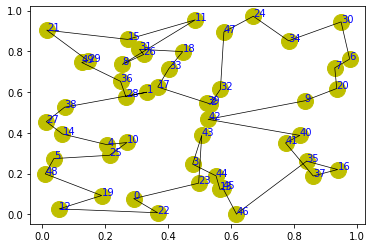

step:4440/5000, actic loss:0.412, critic loss:2.447, L:8.953, 0min1sec
step:4441/5000, actic loss:0.412, critic loss:2.446, L:8.952, 0min1sec
step:4442/5000, actic loss:0.412, critic loss:2.446, L:8.952, 0min1sec
step:4443/5000, actic loss:0.411, critic loss:2.445, L:8.952, 0min1sec
step:4444/5000, actic loss:0.411, critic loss:2.445, L:8.951, 0min1sec
distance:7.016
tensor([ 4, 10, 46, 39, 30, 47, 27, 17, 13, 43, 38,  1, 34, 19, 12, 28,  8, 29,
        31, 22, 21,  2, 37, 25,  9,  0, 16, 48, 44, 42, 18, 41, 14, 33, 35,  7,
         3, 40, 15, 36, 11, 24, 23, 32, 20, 45, 49,  6, 26,  5])


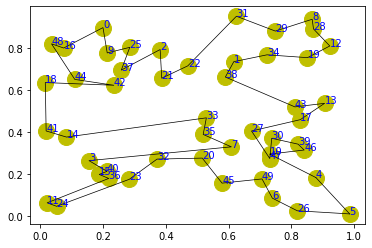

step:4445/5000, actic loss:0.412, critic loss:2.444, L:8.951, 0min2sec
step:4446/5000, actic loss:0.412, critic loss:2.444, L:8.951, 0min2sec
step:4447/5000, actic loss:0.411, critic loss:2.443, L:8.950, 0min1sec
step:4448/5000, actic loss:0.411, critic loss:2.443, L:8.950, 0min1sec
step:4449/5000, actic loss:0.411, critic loss:2.442, L:8.949, 0min1sec
distance:7.624
tensor([ 1, 11, 25, 31,  5, 10, 14,  0, 20, 24, 16, 32,  7, 48,  2, 19, 45, 39,
        28, 34, 47, 23, 13, 29, 43, 18,  9, 44, 33, 15,  8, 37,  4, 27, 35, 36,
        17, 41, 46, 38, 21, 42, 22,  6, 49, 26, 12,  3, 30, 40])


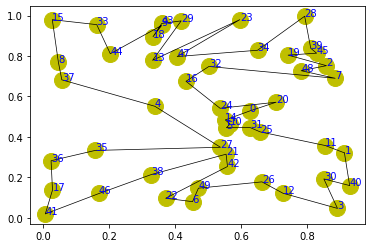

step:4450/5000, actic loss:0.410, critic loss:2.442, L:8.949, 0min2sec
step:4451/5000, actic loss:0.410, critic loss:2.441, L:8.949, 0min1sec
step:4452/5000, actic loss:0.410, critic loss:2.441, L:8.948, 0min1sec
step:4453/5000, actic loss:0.411, critic loss:2.440, L:8.948, 0min1sec
step:4454/5000, actic loss:0.411, critic loss:2.440, L:8.947, 0min1sec
distance:6.804
tensor([42, 43, 21, 25,  4, 24, 16, 29,  9, 15,  6, 47, 49, 23,  2, 44, 32,  3,
        20, 37,  7, 40, 22, 13,  0, 12, 46, 14, 36, 10, 34, 35, 41, 31, 17, 19,
         1, 48, 30, 26,  5, 39, 28, 27, 11, 38, 18,  8, 45, 33])


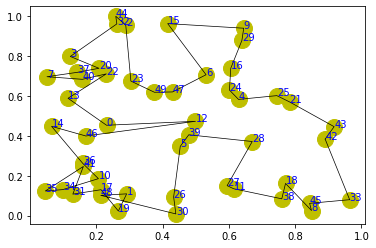

step:4455/5000, actic loss:0.411, critic loss:2.439, L:8.947, 0min2sec
step:4456/5000, actic loss:0.411, critic loss:2.439, L:8.946, 0min1sec
step:4457/5000, actic loss:0.411, critic loss:2.438, L:8.946, 0min1sec
step:4458/5000, actic loss:0.410, critic loss:2.438, L:8.946, 0min1sec
step:4459/5000, actic loss:0.409, critic loss:2.437, L:8.945, 0min1sec
distance:6.480
tensor([ 6, 21, 16, 30, 48, 33, 24,  0, 25, 27, 32, 22, 15, 46,  3, 41, 36,  2,
        26, 28, 35,  4, 42, 38,  8, 11,  5, 49, 10, 34, 14, 17, 12, 40, 37, 47,
         1,  7,  9, 31, 20, 45, 19, 13, 29, 18, 39, 43, 44, 23])


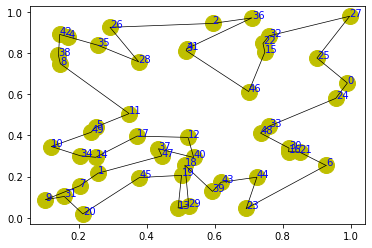

step:4460/5000, actic loss:0.408, critic loss:2.437, L:8.945, 0min2sec
step:4461/5000, actic loss:0.407, critic loss:2.437, L:8.944, 0min2sec
step:4462/5000, actic loss:0.407, critic loss:2.436, L:8.944, 0min1sec
step:4463/5000, actic loss:0.407, critic loss:2.436, L:8.943, 0min1sec
step:4464/5000, actic loss:0.408, critic loss:2.435, L:8.943, 0min1sec
distance:6.724
tensor([ 0, 40, 14, 20, 12, 31, 30, 32, 49, 28, 45,  1, 43,  7, 38, 23, 41, 26,
        46, 48,  9, 37, 27, 25, 39, 29, 42, 47,  3, 17, 10, 34, 13, 33, 24, 35,
        44,  6,  8, 22,  4,  2, 19, 18, 21,  5, 36, 16, 11, 15])


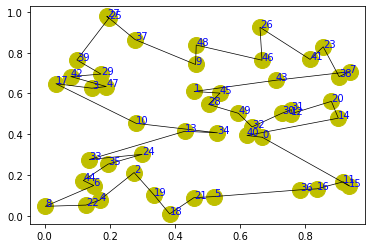

step:4465/5000, actic loss:0.408, critic loss:2.435, L:8.943, 0min2sec
step:4466/5000, actic loss:0.409, critic loss:2.434, L:8.942, 0min1sec
step:4467/5000, actic loss:0.409, critic loss:2.434, L:8.942, 0min1sec
step:4468/5000, actic loss:0.409, critic loss:2.433, L:8.941, 0min1sec
step:4469/5000, actic loss:0.408, critic loss:2.433, L:8.941, 0min1sec
distance:6.695
tensor([30,  5, 29, 23, 35, 40, 28,  6, 46, 48, 37, 39, 42, 43, 38, 49, 16, 34,
        27,  9, 15, 33, 11, 36, 45, 21, 22, 24, 26, 14, 17, 20,  1, 18, 19,  8,
         7, 31, 12, 13, 10, 47,  2,  0, 44,  3, 32,  4, 41, 25])


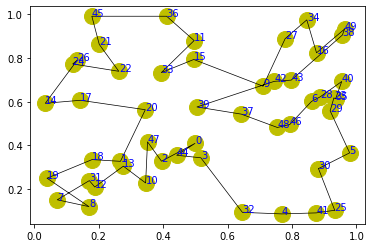

step:4470/5000, actic loss:0.407, critic loss:2.432, L:8.941, 0min1sec
step:4471/5000, actic loss:0.407, critic loss:2.432, L:8.940, 0min1sec
step:4472/5000, actic loss:0.406, critic loss:2.431, L:8.940, 0min1sec
step:4473/5000, actic loss:0.406, critic loss:2.431, L:8.939, 0min2sec
step:4474/5000, actic loss:0.406, critic loss:2.430, L:8.939, 0min2sec
distance:7.303
tensor([ 9, 46, 22, 30, 49, 23, 45, 41, 15, 16, 26, 24, 20, 39,  0, 21, 35, 17,
        10, 31, 36,  5, 43,  4, 38, 48, 33, 12,  6, 19, 25, 40, 11, 32, 37, 28,
        29, 44, 47, 14,  2,  8, 27, 18,  1,  3, 13,  7, 42, 34])


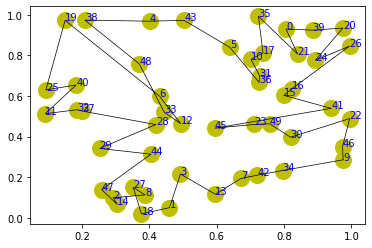

step:4475/5000, actic loss:0.407, critic loss:2.430, L:8.938, 0min2sec
step:4476/5000, actic loss:0.407, critic loss:2.429, L:8.938, 0min1sec
step:4477/5000, actic loss:0.407, critic loss:2.429, L:8.938, 0min1sec
step:4478/5000, actic loss:0.406, critic loss:2.429, L:8.937, 0min1sec
step:4479/5000, actic loss:0.405, critic loss:2.428, L:8.937, 0min1sec
distance:6.679
tensor([27, 25,  9, 11,  2, 49,  6, 43, 17, 32, 42, 39, 40,  0, 35, 45, 13, 36,
        14, 38, 16, 48, 34, 19, 26,  3, 23, 21, 33, 15,  1, 28, 31, 18, 30, 24,
        22, 29, 20, 44,  5,  4, 12, 41, 37,  7, 46, 10, 47,  8])


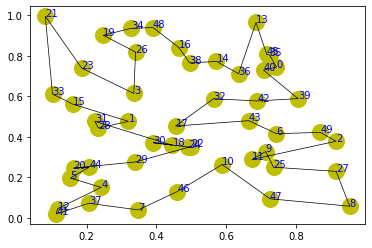

step:4480/5000, actic loss:0.404, critic loss:2.428, L:8.936, 0min1sec
step:4481/5000, actic loss:0.404, critic loss:2.427, L:8.936, 0min1sec
step:4482/5000, actic loss:0.404, critic loss:2.427, L:8.936, 0min1sec
step:4483/5000, actic loss:0.405, critic loss:2.426, L:8.935, 0min2sec
step:4484/5000, actic loss:0.405, critic loss:2.426, L:8.935, 0min1sec
distance:6.844
tensor([ 2, 13,  8, 33, 42, 37,  5, 17,  7, 12,  4, 16, 27,  1, 10, 26,  9, 24,
        43, 38, 31, 46, 39,  6, 48, 21, 22, 19,  3, 45, 44, 30, 20, 15, 25, 11,
        40, 34, 35, 36, 49,  0, 29, 32, 47, 41, 28, 23, 14, 18])


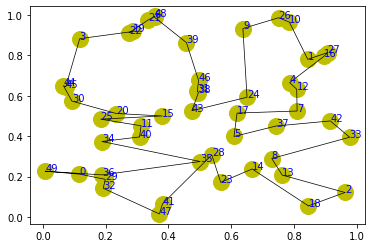

step:4485/5000, actic loss:0.405, critic loss:2.425, L:8.934, 0min2sec
step:4486/5000, actic loss:0.405, critic loss:2.425, L:8.934, 0min1sec
step:4487/5000, actic loss:0.405, critic loss:2.424, L:8.933, 0min1sec
step:4488/5000, actic loss:0.405, critic loss:2.424, L:8.933, 0min1sec
step:4489/5000, actic loss:0.405, critic loss:2.423, L:8.933, 0min1sec
distance:7.333
tensor([38, 24, 35, 13, 47, 39,  8, 42, 34,  9, 32, 45, 33, 21, 15, 29,  2, 19,
        49,  1, 37, 23, 22,  4, 17,  6, 28,  3, 40, 25, 10, 11, 27, 14,  7, 48,
        26, 18, 16,  5, 41,  0, 20, 30, 43, 46, 44, 31, 36, 12])


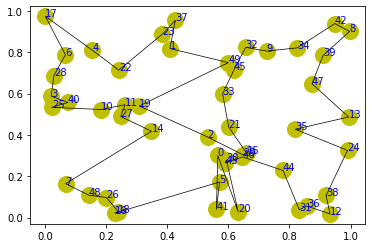

step:4490/5000, actic loss:0.405, critic loss:2.423, L:8.932, 0min2sec
step:4491/5000, actic loss:0.405, critic loss:2.422, L:8.932, 0min1sec
step:4492/5000, actic loss:0.405, critic loss:2.422, L:8.931, 0min1sec
step:4493/5000, actic loss:0.404, critic loss:2.421, L:8.931, 0min1sec
step:4494/5000, actic loss:0.404, critic loss:2.421, L:8.930, 0min1sec
distance:7.239
tensor([28, 22, 40, 23,  5,  2, 10,  9, 16, 31, 11, 39, 18, 36, 30, 42, 43, 44,
        17, 12, 13, 46, 33, 38, 27, 25,  3,  4,  1,  7, 24, 21, 20, 35, 48, 29,
         8, 45, 47, 41, 37, 34,  0, 32, 15,  6, 26, 49, 19, 14])


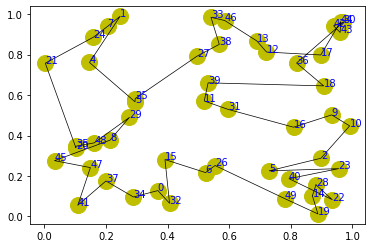

step:4495/5000, actic loss:0.404, critic loss:2.420, L:8.930, 0min2sec
step:4496/5000, actic loss:0.404, critic loss:2.420, L:8.930, 0min2sec
step:4497/5000, actic loss:0.404, critic loss:2.420, L:8.929, 0min1sec
step:4498/5000, actic loss:0.404, critic loss:2.419, L:8.929, 0min1sec
step:4499/5000, actic loss:0.403, critic loss:2.419, L:8.928, 0min1sec
distance:7.683
tensor([46, 21,  1, 38,  8, 28, 13, 47, 30, 10,  9, 19, 27,  4, 31, 37, 14, 33,
        34,  6, 25, 12, 26, 49, 40, 44,  5, 20, 42, 35, 45, 18, 48,  3, 43, 11,
        29, 17,  0, 41,  2,  7, 39, 32, 36, 24, 16, 15, 23, 22])


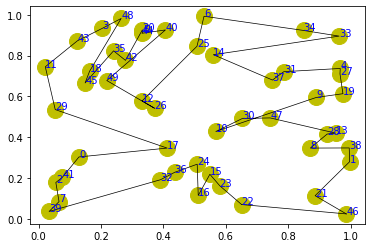

step:4500/5000, actic loss:0.403, critic loss:2.418, L:8.928, 0min1sec
step:4501/5000, actic loss:0.403, critic loss:2.418, L:8.927, 0min1sec
step:4502/5000, actic loss:0.403, critic loss:2.417, L:8.927, 0min1sec
step:4503/5000, actic loss:0.403, critic loss:2.417, L:8.927, 0min1sec
step:4504/5000, actic loss:0.403, critic loss:2.416, L:8.926, 0min1sec
distance:7.695
tensor([44, 17, 28,  8, 35, 27,  3, 11, 21, 19, 49, 39,  6, 38, 15, 41, 13, 36,
        18, 33, 48,  5, 46,  7, 40, 14, 43, 30, 45,  1, 37, 24, 29, 42, 26, 23,
        31, 20, 10, 47,  2, 34, 12, 16, 22, 32,  4, 25,  0,  9])


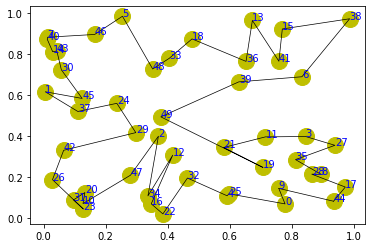

step:4505/5000, actic loss:0.402, critic loss:2.416, L:8.926, 0min2sec
step:4506/5000, actic loss:0.402, critic loss:2.415, L:8.925, 0min1sec
step:4507/5000, actic loss:0.402, critic loss:2.415, L:8.925, 0min2sec
step:4508/5000, actic loss:0.402, critic loss:2.414, L:8.925, 0min1sec
step:4509/5000, actic loss:0.402, critic loss:2.414, L:8.924, 0min2sec
distance:8.051
tensor([19,  7, 32, 29,  2, 38, 22, 44, 33, 20, 41,  3, 48, 31, 34,  1, 26, 14,
        46, 39, 37, 30,  5, 12, 36,  0, 10, 21, 13, 49,  6, 42,  8, 28, 18, 11,
        25, 17, 47,  9, 27, 40, 15, 35, 45,  4, 24, 23, 43, 16])


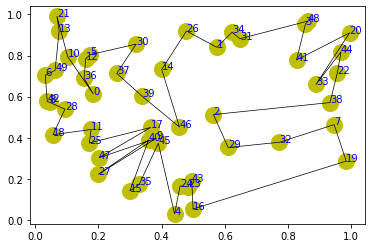

step:4510/5000, actic loss:0.401, critic loss:2.413, L:8.924, 0min2sec
step:4511/5000, actic loss:0.400, critic loss:2.413, L:8.923, 0min1sec
step:4512/5000, actic loss:0.400, critic loss:2.412, L:8.923, 0min1sec
step:4513/5000, actic loss:0.399, critic loss:2.412, L:8.923, 0min1sec
step:4514/5000, actic loss:0.399, critic loss:2.411, L:8.922, 0min1sec
distance:6.673
tensor([25, 26, 16, 49, 17, 21, 23, 37, 19, 35, 39, 43, 33, 24, 40, 48, 47, 44,
        10,  0, 38, 30, 13, 41, 12, 32,  7, 31,  2, 46,  4,  3, 27, 29, 20, 28,
         1,  9, 15, 14,  8,  6, 34, 36, 42,  5, 45, 22, 11, 18])


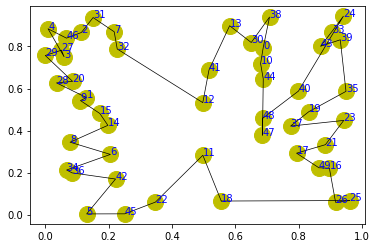

step:4515/5000, actic loss:0.399, critic loss:2.411, L:8.922, 0min2sec
step:4516/5000, actic loss:0.399, critic loss:2.411, L:8.921, 0min1sec
step:4517/5000, actic loss:0.399, critic loss:2.410, L:8.921, 0min1sec
step:4518/5000, actic loss:0.400, critic loss:2.410, L:8.921, 0min1sec
step:4519/5000, actic loss:0.399, critic loss:2.409, L:8.920, 0min1sec
distance:6.517
tensor([48, 40, 32, 35, 36, 13, 28,  3, 10, 21, 22, 42, 29,  4, 19,  1, 34, 20,
         5, 49, 11, 27, 12, 17, 46, 33, 41,  0, 45, 18,  2, 24, 39,  8, 15, 47,
        38, 14,  7, 26, 30, 23,  6, 16, 43, 25, 44, 31,  9, 37])


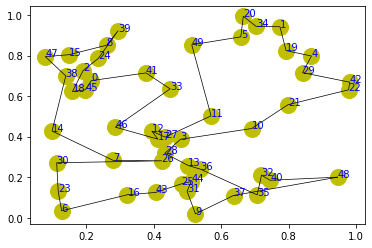

step:4520/5000, actic loss:0.399, critic loss:2.409, L:8.920, 0min2sec
step:4521/5000, actic loss:0.399, critic loss:2.408, L:8.920, 0min1sec
step:4522/5000, actic loss:0.399, critic loss:2.408, L:8.919, 0min1sec
step:4523/5000, actic loss:0.399, critic loss:2.407, L:8.919, 0min2sec
step:4524/5000, actic loss:0.399, critic loss:2.407, L:8.919, 0min2sec
distance:7.761
tensor([46, 22, 48,  5, 12, 49, 36, 33,  2, 11,  0, 13, 19, 16, 40, 47, 31, 45,
        10, 26,  8, 29,  4, 18, 27, 43,  7, 24, 21, 34, 37, 15, 17, 39,  9,  6,
        14, 23, 38, 28,  3, 35,  1, 25, 20, 32, 30, 44, 41, 42])


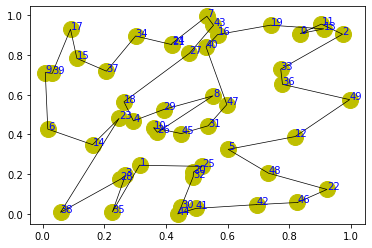

step:4525/5000, actic loss:0.398, critic loss:2.406, L:8.918, 0min2sec
step:4526/5000, actic loss:0.398, critic loss:2.406, L:8.918, 0min1sec
step:4527/5000, actic loss:0.399, critic loss:2.405, L:8.917, 0min1sec
step:4528/5000, actic loss:0.399, critic loss:2.405, L:8.917, 0min1sec
step:4529/5000, actic loss:0.399, critic loss:2.404, L:8.917, 0min1sec
distance:7.851
tensor([25, 48,  7,  0,  3, 49, 43, 13, 46, 42,  9, 38, 23, 12, 22, 40,  2, 17,
        28, 21, 34, 33,  5, 44, 30,  4, 47, 11, 20, 10, 29, 19,  6, 37, 16, 27,
        24, 26, 41, 14, 36,  1, 15,  8, 32, 35, 18, 39, 31, 45])


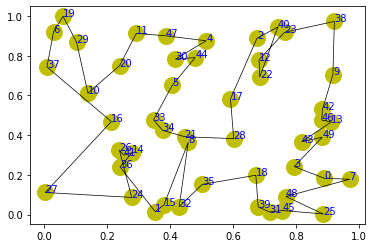

step:4530/5000, actic loss:0.399, critic loss:2.404, L:8.916, 0min2sec
step:4531/5000, actic loss:0.399, critic loss:2.404, L:8.916, 0min1sec
step:4532/5000, actic loss:0.398, critic loss:2.403, L:8.916, 0min1sec
step:4533/5000, actic loss:0.398, critic loss:2.403, L:8.915, 0min1sec
step:4534/5000, actic loss:0.398, critic loss:2.402, L:8.915, 0min2sec
distance:7.224
tensor([15, 12, 34, 35, 19, 46, 45,  4, 10, 25,  3, 18, 49, 31, 39, 13,  5, 33,
         8, 23, 16, 27, 42, 36, 21, 11, 28,  9, 37, 20, 44, 22, 48, 40,  7,  1,
        32,  2, 24, 17,  0, 14, 30, 47,  6, 29, 43, 41, 26, 38])


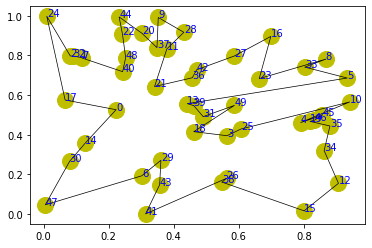

step:4535/5000, actic loss:0.398, critic loss:2.402, L:8.915, 0min2sec
step:4536/5000, actic loss:0.399, critic loss:2.401, L:8.914, 0min1sec
step:4537/5000, actic loss:0.399, critic loss:2.401, L:8.914, 0min1sec
step:4538/5000, actic loss:0.399, critic loss:2.400, L:8.914, 0min1sec
step:4539/5000, actic loss:0.399, critic loss:2.400, L:8.913, 0min1sec
distance:8.912
tensor([36, 33,  1, 39,  8, 27, 42, 37,  0,  9, 14, 41, 24, 30, 38,  7, 48, 15,
        16, 29, 13,  3,  6,  4, 20, 47, 21, 43, 31, 25, 17, 11, 26, 45, 44, 22,
        35, 10, 46, 34, 28, 49, 18, 12, 32, 40, 19, 23,  2,  5])


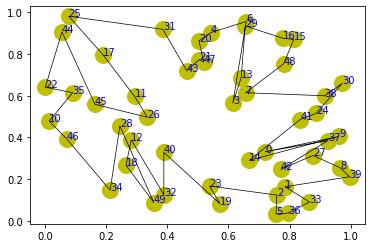

step:4540/5000, actic loss:0.399, critic loss:2.399, L:8.913, 0min2sec
step:4541/5000, actic loss:0.398, critic loss:2.399, L:8.913, 0min1sec
step:4542/5000, actic loss:0.397, critic loss:2.399, L:8.912, 0min1sec
step:4543/5000, actic loss:0.397, critic loss:2.398, L:8.912, 0min1sec
step:4544/5000, actic loss:0.397, critic loss:2.398, L:8.911, 0min1sec
distance:6.955
tensor([ 0,  9, 23, 44, 26, 47, 27, 33, 28, 17, 20, 24, 39,  3, 38,  6, 48, 12,
        43, 15,  1, 18, 25, 21, 11, 31, 40, 32, 16,  4, 13, 46, 37, 22, 14,  7,
        45,  2, 35, 19,  5, 30,  8, 36, 41, 10, 29, 34, 42, 49])


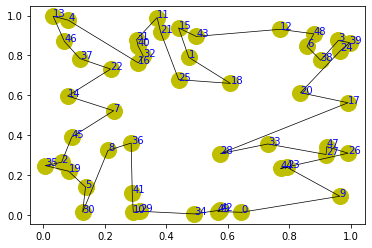

step:4545/5000, actic loss:0.398, critic loss:2.397, L:8.911, 0min2sec
step:4546/5000, actic loss:0.398, critic loss:2.397, L:8.911, 0min1sec
step:4547/5000, actic loss:0.398, critic loss:2.396, L:8.910, 0min2sec
step:4548/5000, actic loss:0.398, critic loss:2.396, L:8.910, 0min1sec
step:4549/5000, actic loss:0.398, critic loss:2.395, L:8.910, 0min1sec
distance:8.273
tensor([ 6, 41, 11, 48,  3, 30, 23, 24,  4, 38,  7, 46, 43, 22,  2, 15, 12, 45,
        31,  5, 33, 13,  8, 21, 44, 36, 28, 20, 42, 40, 35, 18, 27, 39,  1, 47,
        32, 19, 16, 29, 37, 34,  0, 26,  9, 14, 49, 10, 25, 17])


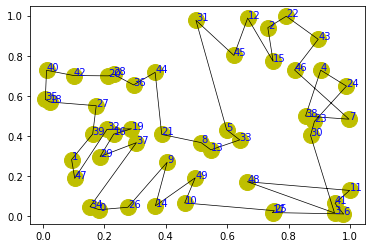

step:4550/5000, actic loss:0.397, critic loss:2.395, L:8.909, 0min2sec
step:4551/5000, actic loss:0.397, critic loss:2.394, L:8.909, 0min1sec
step:4552/5000, actic loss:0.397, critic loss:2.394, L:8.909, 0min1sec
step:4553/5000, actic loss:0.397, critic loss:2.393, L:8.908, 0min1sec
step:4554/5000, actic loss:0.397, critic loss:2.393, L:8.908, 0min1sec
distance:8.699
tensor([26, 27, 24, 28, 20, 10, 29,  4,  1, 19, 16, 31,  0, 13, 45, 36, 43, 46,
        44, 17, 37, 30, 14,  5, 38, 48, 15,  8, 42, 40,  9, 11,  7, 47, 32, 35,
        41, 18, 34, 22, 39,  6, 23, 12, 49, 33,  2, 25,  3, 21])


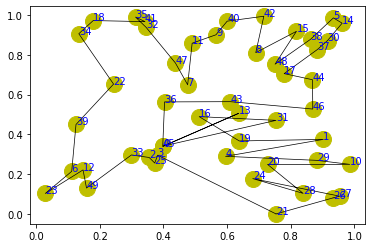

step:4555/5000, actic loss:0.397, critic loss:2.393, L:8.908, 0min2sec
step:4556/5000, actic loss:0.396, critic loss:2.392, L:8.907, 0min1sec
step:4557/5000, actic loss:0.396, critic loss:2.392, L:8.907, 0min1sec
step:4558/5000, actic loss:0.396, critic loss:2.391, L:8.906, 0min1sec
step:4559/5000, actic loss:0.395, critic loss:2.391, L:8.906, 0min1sec
distance:6.611
tensor([24, 15, 17,  1, 47,  7, 13, 14,  2, 29, 31,  8, 19, 34, 27, 48,  0, 35,
        16, 36, 45, 49,  4, 41, 25, 39,  5, 40, 42, 10, 44,  6,  3, 38, 46, 20,
        11, 37, 26, 28, 12, 32, 30, 22, 18, 21, 23, 43, 33,  9])


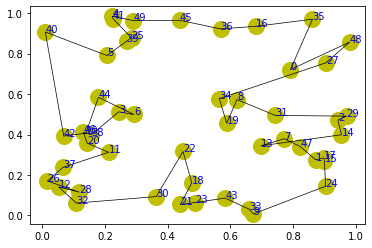

step:4560/5000, actic loss:0.396, critic loss:2.390, L:8.906, 0min2sec
step:4561/5000, actic loss:0.396, critic loss:2.390, L:8.905, 0min1sec
step:4562/5000, actic loss:0.396, critic loss:2.389, L:8.905, 0min1sec
step:4563/5000, actic loss:0.396, critic loss:2.389, L:8.905, 0min1sec
step:4564/5000, actic loss:0.395, critic loss:2.388, L:8.904, 0min1sec
distance:7.593
tensor([39,  3,  8, 35, 42, 26, 15, 38,  5, 21, 36, 33, 17,  9, 32, 41, 49, 12,
        45, 43, 44, 27, 34, 18, 48, 37, 19,  0, 25, 29, 28,  2,  7, 40, 14, 31,
        46, 11, 10,  6, 13, 16, 24,  1, 20, 30, 22,  4, 23, 47])


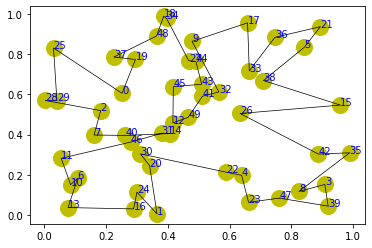

step:4565/5000, actic loss:0.395, critic loss:2.388, L:8.904, 0min2sec
step:4566/5000, actic loss:0.394, critic loss:2.387, L:8.903, 0min1sec
step:4567/5000, actic loss:0.394, critic loss:2.387, L:8.903, 0min2sec
step:4568/5000, actic loss:0.394, critic loss:2.387, L:8.903, 0min1sec
step:4569/5000, actic loss:0.394, critic loss:2.386, L:8.902, 0min1sec
distance:7.490
tensor([21, 46, 37, 35,  8, 34, 15, 49,  1, 30, 41,  4, 38, 22, 10, 25, 28,  5,
        17, 33, 42, 24,  7,  2,  0,  9, 23, 20, 31, 45, 13, 36, 40, 16, 18, 26,
         3, 19, 44, 29, 14, 12, 48, 27,  6, 32, 43, 39, 47, 11])


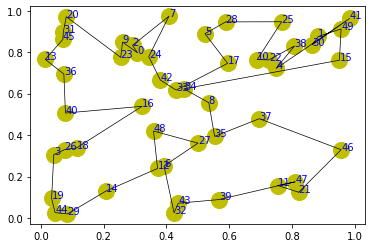

step:4570/5000, actic loss:0.394, critic loss:2.386, L:8.902, 0min2sec
step:4571/5000, actic loss:0.394, critic loss:2.385, L:8.901, 0min1sec
step:4572/5000, actic loss:0.393, critic loss:2.385, L:8.901, 0min1sec
step:4573/5000, actic loss:0.393, critic loss:2.384, L:8.901, 0min1sec
step:4574/5000, actic loss:0.393, critic loss:2.384, L:8.900, 0min1sec
distance:6.524
tensor([ 6, 29, 11,  8, 43, 20, 48, 30, 35, 15,  4, 19, 25, 12, 31, 24, 27, 36,
        46, 45, 28,  5, 49, 38, 13,  9, 14, 23, 39, 26, 10, 34, 22, 16, 21, 37,
        33, 40, 18, 47, 41, 17, 44,  1,  3,  7, 32,  2,  0, 42])


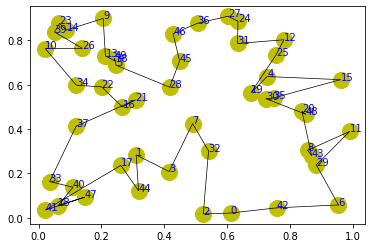

step:4575/5000, actic loss:0.393, critic loss:2.383, L:8.900, 0min1sec
step:4576/5000, actic loss:0.392, critic loss:2.383, L:8.899, 0min1sec
step:4577/5000, actic loss:0.392, critic loss:2.382, L:8.899, 0min1sec
step:4578/5000, actic loss:0.393, critic loss:2.382, L:8.899, 0min1sec
step:4579/5000, actic loss:0.393, critic loss:2.381, L:8.898, 0min2sec
distance:7.201
tensor([28, 20, 33, 39, 48,  3,  9,  0, 37,  1,  8, 16, 35, 36, 41, 22, 42, 26,
        45,  5, 15,  6, 21, 31, 11, 27, 47, 30, 29, 10, 44, 14, 25, 49, 12, 19,
        32, 34,  2, 18, 24, 40, 23, 38,  4, 46,  7, 43, 17, 13])


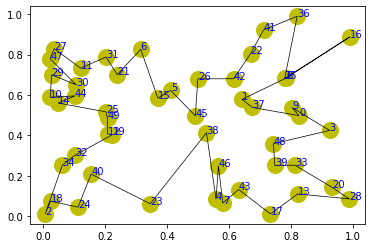

step:4580/5000, actic loss:0.393, critic loss:2.381, L:8.898, 0min2sec
step:4581/5000, actic loss:0.392, critic loss:2.381, L:8.897, 0min2sec
step:4582/5000, actic loss:0.392, critic loss:2.380, L:8.897, 0min1sec
step:4583/5000, actic loss:0.392, critic loss:2.380, L:8.897, 0min1sec
step:4584/5000, actic loss:0.392, critic loss:2.379, L:8.896, 0min1sec
distance:7.166
tensor([29, 17, 25, 35, 19, 34,  1, 28, 30, 45, 11,  6, 23, 42, 32,  0, 12, 31,
        24, 36, 47, 13, 14, 37,  5, 39, 43, 48,  3, 18,  2, 41, 10, 16, 20, 44,
         9, 22, 49, 21,  4, 33, 46,  7, 40, 38, 26, 15,  8, 27])


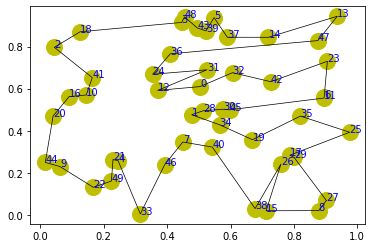

step:4585/5000, actic loss:0.392, critic loss:2.379, L:8.896, 0min2sec
step:4586/5000, actic loss:0.392, critic loss:2.378, L:8.896, 0min1sec
step:4587/5000, actic loss:0.392, critic loss:2.378, L:8.895, 0min1sec
step:4588/5000, actic loss:0.391, critic loss:2.377, L:8.895, 0min1sec
step:4589/5000, actic loss:0.391, critic loss:2.377, L:8.894, 0min1sec
distance:7.195
tensor([24, 25, 45,  4,  1, 12,  7, 14, 49, 17,  6, 27, 29,  3,  8, 19, 43, 42,
        34, 21, 15, 38, 32, 36, 40, 18, 28, 20, 31, 44, 30, 26,  0,  5, 23, 16,
        13, 22, 47,  2, 37, 35, 48, 46, 33, 39, 41, 11,  9, 10])


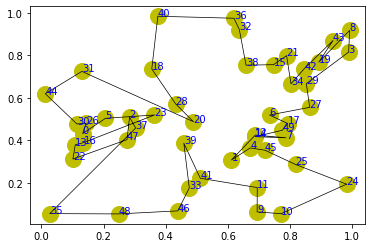

step:4590/5000, actic loss:0.390, critic loss:2.376, L:8.894, 0min2sec
step:4591/5000, actic loss:0.390, critic loss:2.376, L:8.894, 0min1sec
step:4592/5000, actic loss:0.390, critic loss:2.375, L:8.893, 0min1sec
step:4593/5000, actic loss:0.390, critic loss:2.375, L:8.893, 0min2sec
step:4594/5000, actic loss:0.390, critic loss:2.375, L:8.892, 0min1sec
distance:6.652
tensor([23, 43, 45, 26, 47, 20, 35, 29, 46, 16, 28,  4, 10, 31, 15, 22,  9, 27,
        19, 21,  7, 11, 13, 38,  1, 14, 24, 40, 32, 34,  0, 41, 17,  2, 39, 30,
        18, 25, 36, 42, 44, 48, 33,  6, 37,  8, 49, 12,  3,  5])


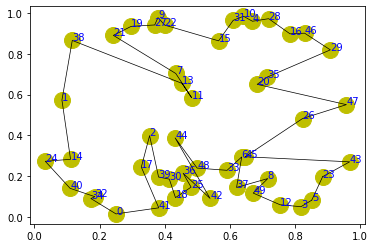

step:4595/5000, actic loss:0.390, critic loss:2.374, L:8.892, 0min2sec
step:4596/5000, actic loss:0.390, critic loss:2.374, L:8.892, 0min1sec
step:4597/5000, actic loss:0.390, critic loss:2.373, L:8.891, 0min1sec
step:4598/5000, actic loss:0.390, critic loss:2.373, L:8.891, 0min1sec
step:4599/5000, actic loss:0.389, critic loss:2.372, L:8.891, 0min1sec
distance:6.952
tensor([24, 33, 22, 20, 29,  1,  2,  9, 30,  0, 32, 48, 45, 34,  8, 26, 10, 28,
        31, 23,  3, 36,  7, 49, 27, 44, 16, 41, 42, 14, 18, 21,  4, 11, 13, 17,
         5, 43, 47, 15, 38,  6, 40, 37, 46, 12, 35, 25, 19, 39])


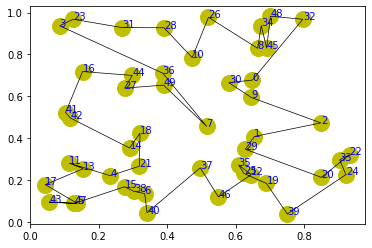

step:4600/5000, actic loss:0.389, critic loss:2.372, L:8.890, 0min1sec
step:4601/5000, actic loss:0.389, critic loss:2.371, L:8.890, 0min1sec
step:4602/5000, actic loss:0.389, critic loss:2.371, L:8.889, 0min1sec
step:4603/5000, actic loss:0.389, critic loss:2.370, L:8.889, 0min1sec
step:4604/5000, actic loss:0.389, critic loss:2.370, L:8.889, 0min1sec
distance:6.803
tensor([34,  8, 13,  7, 20, 12, 24, 40, 29, 33, 21, 28, 16, 27, 49, 45,  9, 46,
        36, 14, 35, 42, 23, 47,  0, 30,  5, 43, 10, 19, 26, 25, 37, 31, 44, 41,
        32,  1, 15, 11,  2, 48, 22, 38,  3,  6, 39, 17,  4, 18])


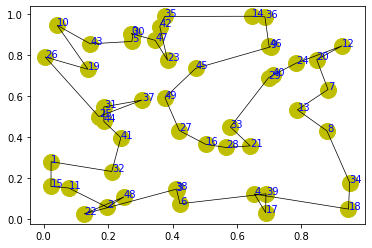

step:4605/5000, actic loss:0.389, critic loss:2.369, L:8.888, 0min2sec
step:4606/5000, actic loss:0.388, critic loss:2.369, L:8.888, 0min2sec
step:4607/5000, actic loss:0.388, critic loss:2.369, L:8.887, 0min1sec
step:4608/5000, actic loss:0.388, critic loss:2.368, L:8.887, 0min2sec
step:4609/5000, actic loss:0.389, critic loss:2.368, L:8.887, 0min1sec
distance:7.251
tensor([47, 15, 23, 13, 38, 26, 46, 27, 48, 18, 25, 19,  1,  2,  8, 40, 45, 35,
        11, 42, 36, 29, 22,  3, 30, 16, 17, 31, 32, 21, 37, 43, 49,  7, 20, 34,
        28, 33, 10,  6,  0, 41,  9, 24,  5,  4, 39, 12, 14, 44])


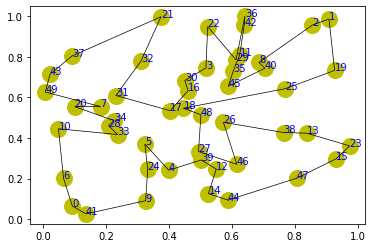

step:4610/5000, actic loss:0.389, critic loss:2.367, L:8.886, 0min1sec
step:4611/5000, actic loss:0.390, critic loss:2.367, L:8.886, 0min1sec
step:4612/5000, actic loss:0.390, critic loss:2.366, L:8.886, 0min1sec
step:4613/5000, actic loss:0.390, critic loss:2.366, L:8.885, 0min1sec
step:4614/5000, actic loss:0.390, critic loss:2.365, L:8.885, 0min1sec
distance:6.871
tensor([33, 12, 26, 44,  3,  1, 30,  0, 16, 23, 24, 18, 28, 34,  2, 46, 25, 36,
        14,  7, 19,  6, 42,  9, 31, 11, 39, 22, 32, 48, 35, 49,  4, 27, 38, 43,
        10, 37, 17, 13, 20,  5, 41, 40, 21, 47,  8, 15, 45, 29])


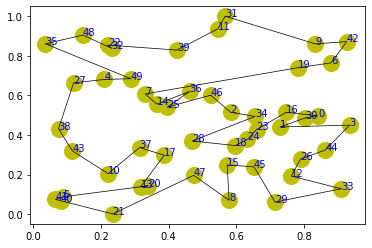

step:4615/5000, actic loss:0.389, critic loss:2.365, L:8.884, 0min1sec
step:4616/5000, actic loss:0.388, critic loss:2.365, L:8.884, 0min1sec
step:4617/5000, actic loss:0.387, critic loss:2.364, L:8.884, 0min1sec
step:4618/5000, actic loss:0.386, critic loss:2.364, L:8.883, 0min1sec
step:4619/5000, actic loss:0.386, critic loss:2.363, L:8.883, 0min1sec
distance:6.296
tensor([40, 31, 14, 23, 48, 35,  0, 16, 39, 45, 46, 41, 32, 38, 37, 47,  4, 20,
         1,  2, 30, 17, 22,  3, 25,  9, 42, 29, 13,  7, 15, 18, 24,  8, 21,  6,
        10, 44, 43, 36, 33, 34, 49, 19, 26, 12,  5, 28, 11, 27])


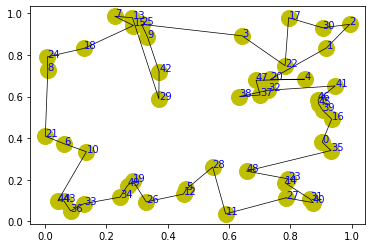

step:4620/5000, actic loss:0.386, critic loss:2.363, L:8.882, 0min2sec
step:4621/5000, actic loss:0.387, critic loss:2.362, L:8.882, 0min1sec
step:4622/5000, actic loss:0.387, critic loss:2.362, L:8.882, 0min1sec
step:4623/5000, actic loss:0.387, critic loss:2.362, L:8.881, 0min1sec
step:4624/5000, actic loss:0.387, critic loss:2.361, L:8.881, 0min1sec
distance:7.596
tensor([40, 46, 32, 15, 36, 10, 27, 45, 21,  5, 49, 17,  1, 39, 35, 11,  3,  7,
        28, 42, 47, 38, 33, 14, 31, 48, 29, 22, 24, 12, 19,  2,  4, 41, 23, 25,
        20, 37,  6, 16, 43,  9,  0, 26, 44, 18, 13,  8, 34, 30])


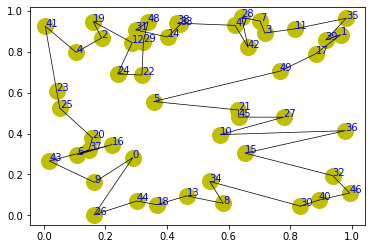

step:4625/5000, actic loss:0.386, critic loss:2.361, L:8.881, 0min1sec
step:4626/5000, actic loss:0.385, critic loss:2.360, L:8.880, 0min1sec
step:4627/5000, actic loss:0.385, critic loss:2.360, L:8.880, 0min1sec
step:4628/5000, actic loss:0.384, critic loss:2.359, L:8.880, 0min1sec
step:4629/5000, actic loss:0.385, critic loss:2.359, L:8.879, 0min1sec
distance:6.666
tensor([ 0, 33, 35, 36, 14, 12, 48, 39,  5, 43, 16, 29, 46,  7, 37, 25, 24, 28,
        42, 34, 40, 38, 32, 13, 11, 21, 27, 30,  8,  2, 31,  6, 22, 20, 10, 47,
        41, 45, 19, 26, 23, 49, 44, 17,  9,  3, 15,  4,  1, 18])


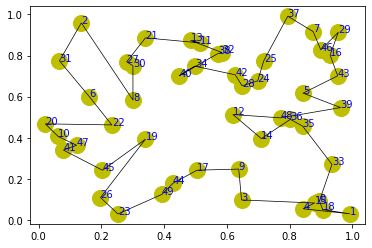

step:4630/5000, actic loss:0.385, critic loss:2.359, L:8.879, 0min1sec
step:4631/5000, actic loss:0.386, critic loss:2.358, L:8.878, 0min1sec
step:4632/5000, actic loss:0.386, critic loss:2.358, L:8.878, 0min2sec
step:4633/5000, actic loss:0.386, critic loss:2.357, L:8.878, 0min1sec
step:4634/5000, actic loss:0.386, critic loss:2.357, L:8.877, 0min1sec
distance:6.179
tensor([ 6,  1, 11, 36, 10, 14, 17, 22, 18,  7, 24,  5, 41, 35, 49, 13, 40, 23,
        38, 29, 15, 20, 34, 48,  2,  9, 16, 30, 27, 44, 33, 25, 45, 19, 42, 26,
        31,  0, 39, 21, 12, 37, 32, 43, 46,  3,  8, 28, 47,  4])


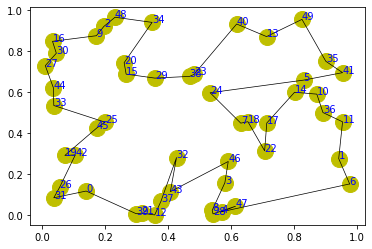

step:4635/5000, actic loss:0.385, critic loss:2.356, L:8.877, 0min2sec
step:4636/5000, actic loss:0.384, critic loss:2.356, L:8.876, 0min1sec
step:4637/5000, actic loss:0.384, critic loss:2.355, L:8.876, 0min1sec
step:4638/5000, actic loss:0.383, critic loss:2.355, L:8.876, 0min1sec
step:4639/5000, actic loss:0.383, critic loss:2.355, L:8.875, 0min1sec
distance:7.351
tensor([ 5, 31, 11, 40, 32, 14, 46, 30, 26, 16, 29, 36, 34,  3, 47, 33, 35, 27,
         8,  6, 38, 28, 25, 10,  7, 44, 49, 48, 12, 43,  1, 22,  9, 20, 37, 15,
        42, 41, 24, 13, 39,  4, 23, 21, 19,  0, 18,  2, 17, 45])


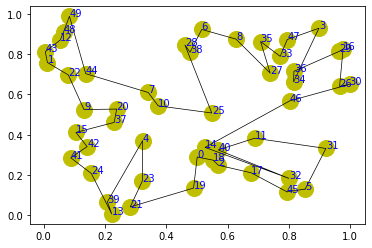

step:4640/5000, actic loss:0.383, critic loss:2.354, L:8.875, 0min1sec
step:4641/5000, actic loss:0.383, critic loss:2.354, L:8.874, 0min1sec
step:4642/5000, actic loss:0.383, critic loss:2.353, L:8.874, 0min1sec
step:4643/5000, actic loss:0.383, critic loss:2.353, L:8.874, 0min1sec
step:4644/5000, actic loss:0.383, critic loss:2.352, L:8.873, 0min1sec
distance:7.195
tensor([34, 22, 17, 30, 39, 44, 12,  1, 45, 11, 35, 29, 14, 13,  5, 38,  3, 41,
        21, 40, 16,  7, 33, 25, 10,  6, 36, 42, 27, 28, 49, 24, 47, 46, 23,  2,
        20, 31, 26, 19, 48, 32,  0,  4, 37,  9, 15, 18,  8, 43])


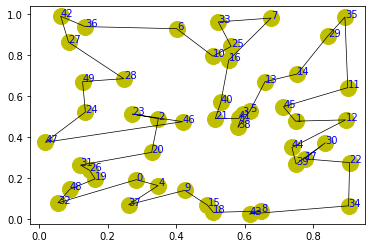

step:4645/5000, actic loss:0.383, critic loss:2.352, L:8.873, 0min1sec
step:4646/5000, actic loss:0.382, critic loss:2.351, L:8.873, 0min1sec
step:4647/5000, actic loss:0.383, critic loss:2.351, L:8.872, 0min2sec
step:4648/5000, actic loss:0.383, critic loss:2.351, L:8.872, 0min1sec
step:4649/5000, actic loss:0.383, critic loss:2.350, L:8.871, 0min1sec
distance:6.506
tensor([49, 32, 35, 20, 43, 22,  6, 19, 45, 33,  8, 25, 12, 24,  3, 47, 17, 42,
         5, 37, 16, 10, 26, 40, 39, 29,  1, 38, 14, 36, 11, 23, 13, 48, 34,  0,
        30, 18, 46,  2,  9, 44,  7,  4, 15, 31, 21, 27, 28, 41])


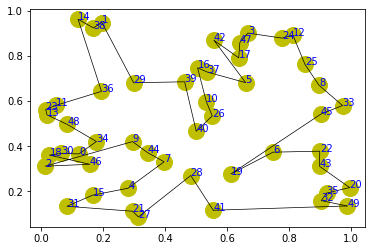

step:4650/5000, actic loss:0.383, critic loss:2.350, L:8.871, 0min2sec
step:4651/5000, actic loss:0.383, critic loss:2.349, L:8.871, 0min1sec
step:4652/5000, actic loss:0.383, critic loss:2.349, L:8.870, 0min1sec
step:4653/5000, actic loss:0.383, critic loss:2.348, L:8.870, 0min1sec
step:4654/5000, actic loss:0.382, critic loss:2.348, L:8.869, 0min1sec
distance:7.086
tensor([ 6, 42, 38, 15, 44, 35, 34, 46, 25, 41, 18, 29, 21, 39, 32,  9, 30, 40,
        28,  5,  2, 31, 17, 14,  1,  7, 27, 33, 45, 20, 23, 11, 49,  3, 19, 48,
         4, 16, 24, 37, 13, 12, 36, 47,  8, 22, 26,  0, 10, 43])


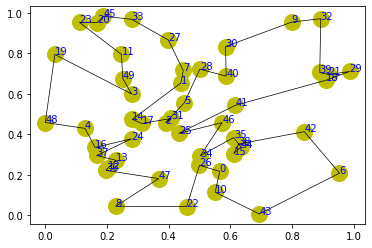

step:4655/5000, actic loss:0.382, critic loss:2.347, L:8.869, 0min2sec
step:4656/5000, actic loss:0.382, critic loss:2.347, L:8.869, 0min1sec
step:4657/5000, actic loss:0.382, critic loss:2.346, L:8.868, 0min1sec
step:4658/5000, actic loss:0.382, critic loss:2.346, L:8.868, 0min1sec
step:4659/5000, actic loss:0.382, critic loss:2.346, L:8.867, 0min1sec
distance:7.241
tensor([46, 44,  1, 35, 43,  5, 45, 33, 30, 21, 34, 40,  2, 37, 41, 39, 13, 49,
        26, 20, 19, 15, 24, 22, 14, 47, 38, 32, 10,  8, 12, 29,  4, 48,  9, 23,
        25, 16, 28,  3,  6,  7, 27, 17,  0, 11, 36, 18, 42, 31])


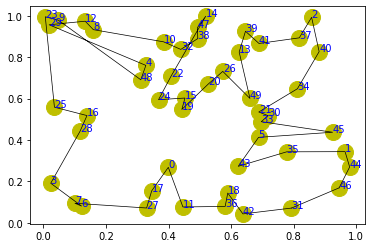

step:4660/5000, actic loss:0.382, critic loss:2.345, L:8.867, 0min2sec
step:4661/5000, actic loss:0.382, critic loss:2.345, L:8.867, 0min1sec
step:4662/5000, actic loss:0.382, critic loss:2.344, L:8.866, 0min1sec
step:4663/5000, actic loss:0.381, critic loss:2.344, L:8.866, 0min1sec
step:4664/5000, actic loss:0.382, critic loss:2.343, L:8.865, 0min1sec
distance:7.147
tensor([ 3, 47, 10, 32,  5, 14,  1, 25, 38, 24, 18, 26, 16, 15, 13, 22, 31, 23,
        28,  4, 19, 44, 41, 49,  6, 27, 43,  2, 34, 21,  7,  0, 33, 36, 45, 48,
        17, 11, 20, 35, 30, 29, 37, 12,  8, 46, 40, 42, 39,  9])


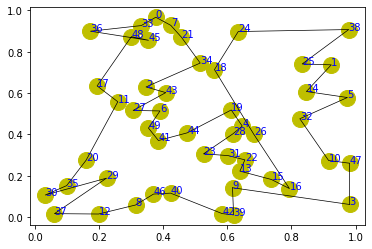

step:4665/5000, actic loss:0.381, critic loss:2.343, L:8.865, 0min2sec
step:4666/5000, actic loss:0.381, critic loss:2.342, L:8.865, 0min1sec
step:4667/5000, actic loss:0.382, critic loss:2.342, L:8.864, 0min1sec
step:4668/5000, actic loss:0.382, critic loss:2.341, L:8.864, 0min1sec
step:4669/5000, actic loss:0.381, critic loss:2.341, L:8.863, 0min1sec
distance:6.686
tensor([ 4, 46,  5, 36, 13, 20, 18, 17,  7, 41, 11, 49, 25, 16,  2,  0, 23,  3,
        33, 34,  8, 37, 31, 21, 15, 45, 19, 44, 27,  6, 26, 29, 32, 35, 47, 30,
        39, 43, 38, 12, 42, 40,  1, 22, 48, 24, 14, 10,  9, 28])


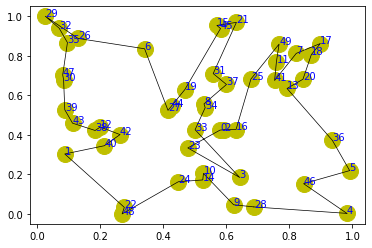

step:4670/5000, actic loss:0.381, critic loss:2.341, L:8.863, 0min2sec
step:4671/5000, actic loss:0.381, critic loss:2.340, L:8.863, 0min2sec
step:4672/5000, actic loss:0.380, critic loss:2.340, L:8.862, 0min2sec
step:4673/5000, actic loss:0.380, critic loss:2.339, L:8.862, 0min1sec
step:4674/5000, actic loss:0.380, critic loss:2.339, L:8.862, 0min1sec
distance:6.539
tensor([19, 31, 24, 30, 33, 34, 26,  9, 38, 23, 40, 29,  2, 47, 16,  7, 13, 43,
         8,  0,  5, 39,  6, 15, 35, 22, 37, 42, 32, 12, 46, 20, 11, 17, 25, 10,
        27, 48, 36,  4, 44, 45, 28, 14, 21, 49, 18,  3, 41,  1])


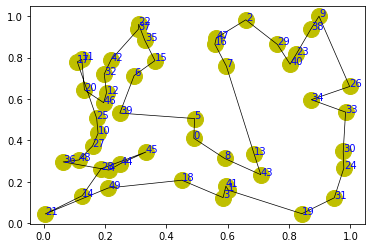

step:4675/5000, actic loss:0.380, critic loss:2.338, L:8.861, 0min2sec
step:4676/5000, actic loss:0.380, critic loss:2.338, L:8.861, 0min1sec
step:4677/5000, actic loss:0.380, critic loss:2.337, L:8.860, 0min1sec
step:4678/5000, actic loss:0.380, critic loss:2.337, L:8.860, 0min1sec
step:4679/5000, actic loss:0.380, critic loss:2.336, L:8.860, 0min1sec
distance:7.331
tensor([42, 12,  0, 30,  2, 11, 34, 38, 23, 37, 17,  1,  5, 26, 22, 13,  7, 44,
        32, 28, 14, 29, 20, 39, 46, 41, 48, 21, 49, 19, 15,  9, 16,  3, 33, 10,
         6, 24, 45, 18,  4, 36, 25, 27, 43, 40, 31, 35, 47,  8])


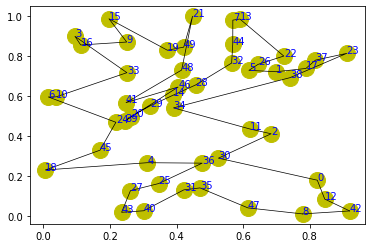

step:4680/5000, actic loss:0.380, critic loss:2.336, L:8.859, 0min1sec
step:4681/5000, actic loss:0.380, critic loss:2.336, L:8.859, 0min1sec
step:4682/5000, actic loss:0.379, critic loss:2.335, L:8.858, 0min1sec
step:4683/5000, actic loss:0.379, critic loss:2.335, L:8.858, 0min2sec
step:4684/5000, actic loss:0.379, critic loss:2.334, L:8.858, 0min2sec
distance:6.721
tensor([48, 24, 40, 25,  3, 20,  5, 19, 12,  8, 46, 42,  2, 31, 11,  6, 13,  4,
        41, 47, 34, 14,  1, 39, 15, 35,  0, 36, 33, 45, 29, 28, 32, 26, 21, 37,
        30,  7, 18, 23, 16, 10, 43, 44, 49,  9, 38, 27, 22, 17])


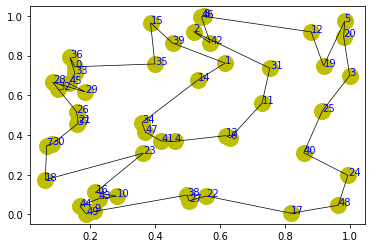

step:4685/5000, actic loss:0.379, critic loss:2.334, L:8.857, 0min2sec
step:4686/5000, actic loss:0.379, critic loss:2.333, L:8.857, 0min1sec
step:4687/5000, actic loss:0.379, critic loss:2.333, L:8.856, 0min1sec
step:4688/5000, actic loss:0.378, critic loss:2.332, L:8.856, 0min1sec
step:4689/5000, actic loss:0.378, critic loss:2.332, L:8.856, 0min1sec
distance:7.559
tensor([ 6, 26, 22, 12, 39, 32, 21,  5, 28, 33, 45,  3,  2, 18, 17, 27, 11, 13,
        37, 48,  4, 36, 40, 44, 30,  1, 34, 16, 19, 23, 20, 14, 38, 24,  0,  8,
        25, 42,  7, 31, 41, 35, 46, 15, 29, 10, 43, 49,  9, 47])


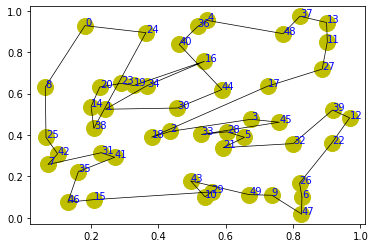

step:4690/5000, actic loss:0.378, critic loss:2.332, L:8.855, 0min2sec
step:4691/5000, actic loss:0.378, critic loss:2.331, L:8.855, 0min1sec
step:4692/5000, actic loss:0.378, critic loss:2.331, L:8.855, 0min1sec
step:4693/5000, actic loss:0.378, critic loss:2.330, L:8.854, 0min1sec
step:4694/5000, actic loss:0.377, critic loss:2.330, L:8.854, 0min1sec
distance:7.459
tensor([43, 29, 32, 47, 10, 34, 49,  6, 18, 11, 23, 46, 44, 36,  9, 38, 37, 30,
        22, 41, 17, 21, 16, 25,  8, 12,  0,  3, 20,  4, 45,  5, 48, 40, 28, 27,
         2, 33, 14, 35, 42, 31, 24, 15, 13,  1, 39, 19, 26,  7])


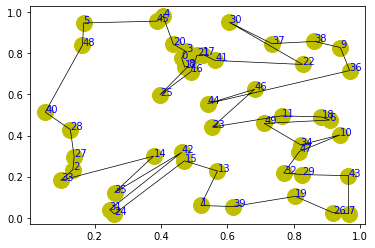

step:4695/5000, actic loss:0.377, critic loss:2.329, L:8.854, 0min2sec
step:4696/5000, actic loss:0.377, critic loss:2.329, L:8.853, 0min1sec
step:4697/5000, actic loss:0.377, critic loss:2.328, L:8.853, 0min2sec
step:4698/5000, actic loss:0.377, critic loss:2.328, L:8.852, 0min2sec
step:4699/5000, actic loss:0.377, critic loss:2.328, L:8.852, 0min1sec
distance:6.258
tensor([20,  7,  3,  0, 39, 17, 14, 37, 25, 30, 16, 38, 43, 27, 13,  6, 18, 42,
        22,  4, 32, 40, 19, 24, 49,  1, 35, 33, 45, 11, 28,  8, 10, 29, 26, 12,
         2,  5, 48, 41, 46, 21,  9, 15, 34, 31, 23, 36, 44, 47])


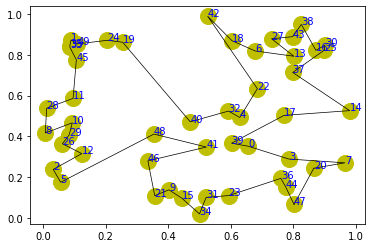

step:4700/5000, actic loss:0.377, critic loss:2.327, L:8.852, 0min1sec
step:4701/5000, actic loss:0.377, critic loss:2.327, L:8.851, 0min1sec
step:4702/5000, actic loss:0.376, critic loss:2.326, L:8.851, 0min1sec
step:4703/5000, actic loss:0.376, critic loss:2.326, L:8.850, 0min1sec
step:4704/5000, actic loss:0.376, critic loss:2.325, L:8.850, 0min1sec
distance:6.674
tensor([18,  8, 47, 40,  9, 10, 36, 25, 29, 44, 11, 17, 33, 38,  7, 49, 27, 43,
        19, 31, 41, 15, 42, 30, 24, 26,  6, 13, 22,  3, 32, 35,  1, 14, 28, 23,
         2, 39, 20, 34, 21, 37, 46, 16,  0, 45,  4,  5, 12, 48])


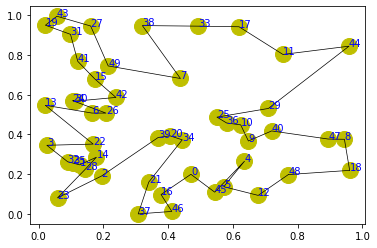

step:4705/5000, actic loss:0.376, critic loss:2.325, L:8.850, 0min2sec
step:4706/5000, actic loss:0.376, critic loss:2.324, L:8.849, 0min1sec
step:4707/5000, actic loss:0.375, critic loss:2.324, L:8.849, 0min1sec
step:4708/5000, actic loss:0.375, critic loss:2.324, L:8.848, 0min1sec
step:4709/5000, actic loss:0.375, critic loss:2.323, L:8.848, 0min2sec
distance:7.011
tensor([39, 15, 21, 43, 44, 23, 17, 34, 19, 42, 10, 30, 31, 22,  0, 29, 13, 12,
        16, 35,  7,  3,  2, 48, 24,  9,  1, 20, 27, 46, 36,  6,  8,  5, 45, 18,
        11, 47, 25, 49, 28, 37, 33,  4, 40, 26, 41, 14, 32, 38])


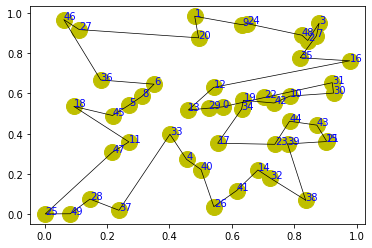

step:4710/5000, actic loss:0.375, critic loss:2.323, L:8.848, 0min2sec
step:4711/5000, actic loss:0.375, critic loss:2.322, L:8.847, 0min1sec
step:4712/5000, actic loss:0.375, critic loss:2.322, L:8.847, 0min1sec
step:4713/5000, actic loss:0.375, critic loss:2.321, L:8.846, 0min1sec
step:4714/5000, actic loss:0.375, critic loss:2.321, L:8.846, 0min1sec
distance:6.819
tensor([36, 47,  0, 21,  7, 11, 19, 32,  1, 16, 46, 38, 34, 18, 48, 35,  2, 17,
         9, 43,  4, 27, 42, 23, 26, 31, 25, 44, 15, 12, 33, 24, 14, 45,  5, 10,
        30, 28,  6, 29, 40, 20, 39,  8, 37, 13, 22, 41,  3, 49])


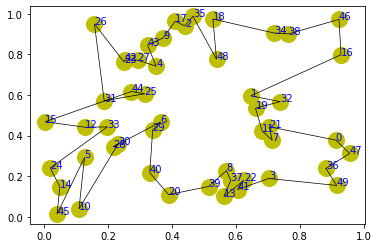

step:4715/5000, actic loss:0.374, critic loss:2.321, L:8.846, 0min2sec
step:4716/5000, actic loss:0.374, critic loss:2.320, L:8.845, 0min1sec
step:4717/5000, actic loss:0.374, critic loss:2.320, L:8.845, 0min1sec
step:4718/5000, actic loss:0.374, critic loss:2.319, L:8.845, 0min1sec
step:4719/5000, actic loss:0.374, critic loss:2.319, L:8.844, 0min1sec
distance:6.524
tensor([40, 49, 18, 48, 30, 42, 38, 25, 41,  0,  9, 26, 19,  3, 47, 43, 29, 17,
        27, 10, 16, 12,  8, 33,  1,  2, 37, 28,  7, 34, 11,  4,  6, 44, 46, 39,
        14, 45, 36, 22, 24, 35,  5, 32, 31, 21, 23, 15, 13, 20])


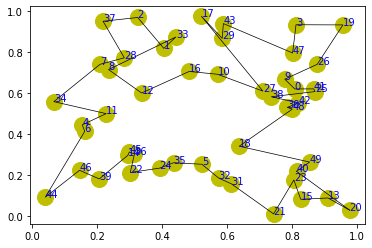

step:4720/5000, actic loss:0.374, critic loss:2.318, L:8.844, 0min2sec
step:4721/5000, actic loss:0.373, critic loss:2.318, L:8.843, 0min1sec
step:4722/5000, actic loss:0.373, critic loss:2.317, L:8.843, 0min2sec
step:4723/5000, actic loss:0.373, critic loss:2.317, L:8.843, 0min1sec
step:4724/5000, actic loss:0.373, critic loss:2.317, L:8.842, 0min1sec
distance:6.846
tensor([ 6, 34,  8, 14, 28, 38, 35, 18, 46, 25,  9, 10,  2, 42, 47, 32, 15, 43,
        40, 29, 22, 19, 37, 21, 20, 23,  3, 16,  0, 48, 13, 12, 49, 26, 11, 27,
         5,  4,  1, 30, 45, 44, 31, 39, 24,  7, 17, 33, 36, 41])


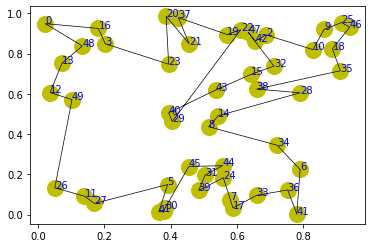

step:4725/5000, actic loss:0.373, critic loss:2.316, L:8.842, 0min2sec
step:4726/5000, actic loss:0.373, critic loss:2.316, L:8.841, 0min1sec
step:4727/5000, actic loss:0.373, critic loss:2.315, L:8.841, 0min1sec
step:4728/5000, actic loss:0.373, critic loss:2.315, L:8.840, 0min1sec
step:4729/5000, actic loss:0.373, critic loss:2.314, L:8.840, 0min1sec
distance:6.489
tensor([ 4,  7, 40, 23, 47, 39, 27, 20,  9, 12, 42, 10,  1, 18, 14,  8, 26, 17,
        34, 43, 49, 45, 35, 33, 48,  5, 31, 46, 22, 21, 13, 15,  6,  3, 36, 38,
        41, 29, 37, 19, 11, 30, 24, 28, 44, 32, 25, 16,  2,  0])


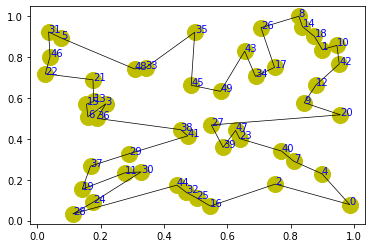

step:4730/5000, actic loss:0.372, critic loss:2.314, L:8.840, 0min2sec
step:4731/5000, actic loss:0.372, critic loss:2.313, L:8.839, 0min2sec
step:4732/5000, actic loss:0.372, critic loss:2.313, L:8.839, 0min1sec
step:4733/5000, actic loss:0.372, critic loss:2.313, L:8.838, 0min1sec
step:4734/5000, actic loss:0.372, critic loss:2.312, L:8.838, 0min1sec
distance:6.298
tensor([32, 25,  9, 39, 35, 29, 37, 18, 13, 36, 45, 38, 28, 23, 26, 33, 44,  5,
        31, 24, 34, 19,  0, 12, 27, 46,  6,  1, 47,  7, 49, 42, 16, 41, 15, 48,
        21, 40,  8,  4,  3,  2, 17, 10, 43, 20, 30, 22, 14, 11])


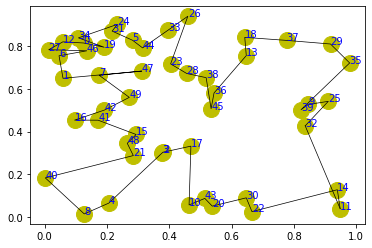

step:4735/5000, actic loss:0.372, critic loss:2.312, L:8.838, 0min2sec
step:4736/5000, actic loss:0.372, critic loss:2.311, L:8.837, 0min1sec
step:4737/5000, actic loss:0.372, critic loss:2.311, L:8.837, 0min1sec
step:4738/5000, actic loss:0.372, critic loss:2.310, L:8.836, 0min1sec
step:4739/5000, actic loss:0.371, critic loss:2.310, L:8.836, 0min1sec
distance:7.775
tensor([47, 32,  1, 30, 11,  5, 22, 27, 14, 24, 48,  9, 21, 29, 44, 16, 31, 42,
        19, 13, 46, 17, 26, 43, 49, 39, 35, 20, 25, 40, 41, 45, 15, 10,  3,  2,
        28,  4, 34, 38, 36, 37, 18,  8,  6, 12, 23,  7, 33,  0])


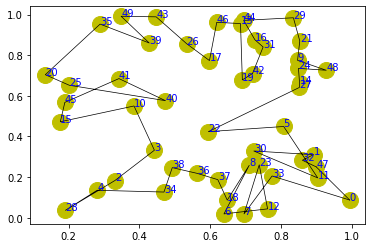

step:4740/5000, actic loss:0.371, critic loss:2.309, L:8.835, 0min1sec
step:4741/5000, actic loss:0.371, critic loss:2.309, L:8.835, 0min1sec
step:4742/5000, actic loss:0.371, critic loss:2.309, L:8.835, 0min1sec
step:4743/5000, actic loss:0.371, critic loss:2.308, L:8.834, 0min2sec
step:4744/5000, actic loss:0.371, critic loss:2.308, L:8.834, 0min2sec
distance:7.239
tensor([ 5, 12,  2,  3, 26,  6, 32, 38, 15, 44, 20, 36, 28, 17,  8, 34, 37, 33,
        10, 16, 29, 14, 39, 25, 43,  1, 49,  4, 42, 40, 48,  9, 46, 30, 21, 41,
        27, 18, 47, 19, 24, 45,  7,  0, 31, 13, 11, 23, 22, 35])


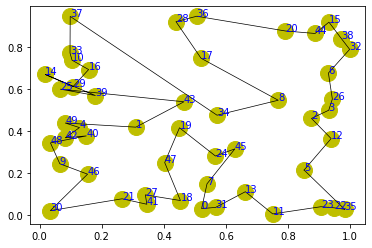

step:4745/5000, actic loss:0.371, critic loss:2.307, L:8.833, 0min2sec
step:4746/5000, actic loss:0.371, critic loss:2.307, L:8.833, 0min1sec
step:4747/5000, actic loss:0.370, critic loss:2.306, L:8.832, 0min1sec
step:4748/5000, actic loss:0.370, critic loss:2.306, L:8.832, 0min1sec
step:4749/5000, actic loss:0.369, critic loss:2.306, L:8.832, 0min1sec
distance:7.148
tensor([13, 43, 35, 41, 17, 20, 37, 30, 15, 46, 19,  5, 14,  9, 39, 49,  7, 24,
        40, 16, 12,  6, 27, 38, 21, 42, 47, 44, 23, 18, 36, 28, 10, 32, 48,  8,
        26, 45, 11,  2,  4, 29, 31,  0,  3,  1, 34, 33, 25, 22])


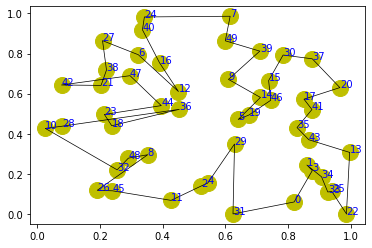

step:4750/5000, actic loss:0.369, critic loss:2.305, L:8.831, 0min2sec
step:4751/5000, actic loss:0.370, critic loss:2.305, L:8.831, 0min1sec
step:4752/5000, actic loss:0.370, critic loss:2.304, L:8.831, 0min1sec
step:4753/5000, actic loss:0.370, critic loss:2.304, L:8.830, 0min2sec
step:4754/5000, actic loss:0.369, critic loss:2.303, L:8.830, 0min2sec
distance:6.562
tensor([29, 40, 37, 42, 49, 47,  5, 23,  6,  7, 44, 20, 33, 16, 13, 11, 34, 46,
        35,  0, 14, 26,  9, 45, 43,  4, 24,  3, 31, 12, 27, 22, 19, 32, 17,  2,
        30, 28,  8, 38, 48,  1, 18, 25, 41, 15, 21, 10, 39, 36])


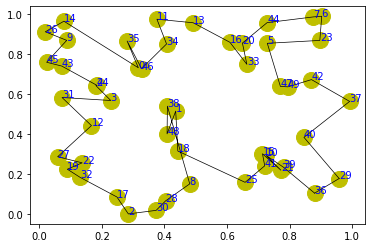

step:4755/5000, actic loss:0.369, critic loss:2.303, L:8.829, 0min2sec
step:4756/5000, actic loss:0.369, critic loss:2.303, L:8.829, 0min1sec
step:4757/5000, actic loss:0.369, critic loss:2.302, L:8.829, 0min1sec
step:4758/5000, actic loss:0.369, critic loss:2.302, L:8.828, 0min1sec
step:4759/5000, actic loss:0.369, critic loss:2.301, L:8.828, 0min1sec
distance:7.502
tensor([42, 16, 43, 22,  1, 13, 34, 44, 41, 47,  4, 29, 46, 38, 27, 35,  0, 23,
        26, 20, 28, 10, 25, 21,  2, 11, 40, 24, 33, 30, 37, 12, 39,  8, 32, 31,
         3,  9,  7, 14, 18,  6, 15, 19, 17,  5, 49, 48, 36, 45])


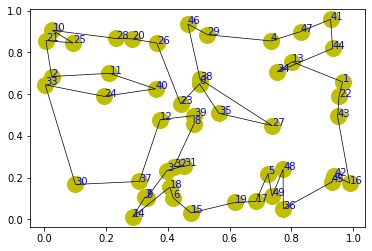

step:4760/5000, actic loss:0.369, critic loss:2.301, L:8.827, 0min2sec
step:4761/5000, actic loss:0.368, critic loss:2.300, L:8.827, 0min1sec
step:4762/5000, actic loss:0.368, critic loss:2.300, L:8.827, 0min1sec
step:4763/5000, actic loss:0.368, critic loss:2.299, L:8.826, 0min1sec
step:4764/5000, actic loss:0.368, critic loss:2.299, L:8.826, 0min1sec
distance:6.908
tensor([28,  8, 11, 23, 34, 33, 20,  4, 26, 40, 18, 15, 43, 13, 10, 31,  2, 45,
         9,  1,  5, 22, 41, 42, 19, 30, 35, 49,  0, 29,  7, 46, 38, 47, 24, 25,
        37, 12, 17, 36, 44, 48, 14, 39,  6,  3, 21, 27, 16, 32])


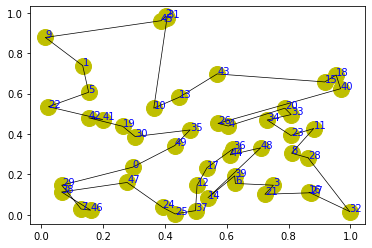

step:4765/5000, actic loss:0.368, critic loss:2.299, L:8.825, 0min2sec
step:4766/5000, actic loss:0.368, critic loss:2.298, L:8.825, 0min2sec
step:4767/5000, actic loss:0.368, critic loss:2.298, L:8.825, 0min1sec
step:4768/5000, actic loss:0.368, critic loss:2.297, L:8.824, 0min1sec
step:4769/5000, actic loss:0.368, critic loss:2.297, L:8.824, 0min1sec
distance:7.236
tensor([30, 42, 19, 17, 41, 37, 22, 16, 10, 39, 47, 38, 46,  2,  8, 34, 32, 21,
        31, 44,  0, 35, 12,  1, 49, 13, 14, 43,  5, 33, 40, 48, 23, 18, 11, 28,
        36, 20, 29,  7,  4, 26,  3, 45, 24, 25, 15,  9, 27,  6])


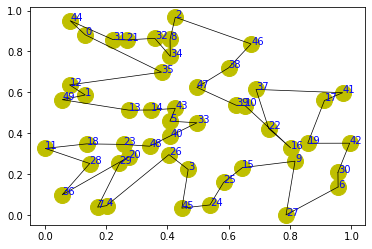

step:4770/5000, actic loss:0.368, critic loss:2.296, L:8.823, 0min2sec
step:4771/5000, actic loss:0.367, critic loss:2.296, L:8.823, 0min1sec
step:4772/5000, actic loss:0.367, critic loss:2.296, L:8.823, 0min1sec
step:4773/5000, actic loss:0.367, critic loss:2.295, L:8.822, 0min1sec
step:4774/5000, actic loss:0.367, critic loss:2.295, L:8.822, 0min1sec
distance:7.063
tensor([32,  2, 30, 48, 47,  9, 27, 31, 24, 42, 10, 22, 33, 40,  4, 41, 12, 44,
        16, 17, 21, 29, 18, 36, 14, 19, 34,  0, 28, 45, 46, 35, 15,  3, 13, 23,
         8,  7, 11, 43, 39,  5, 25, 38,  1,  6, 26, 49, 37, 20])


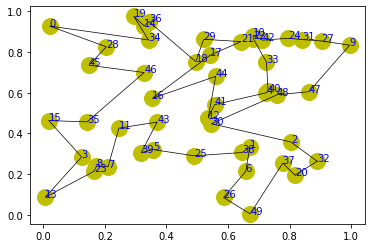

step:4775/5000, actic loss:0.367, critic loss:2.294, L:8.821, 0min1sec
step:4776/5000, actic loss:0.368, critic loss:2.294, L:8.821, 0min1sec
step:4777/5000, actic loss:0.367, critic loss:2.293, L:8.821, 0min1sec
step:4778/5000, actic loss:0.367, critic loss:2.293, L:8.820, 0min1sec
step:4779/5000, actic loss:0.366, critic loss:2.293, L:8.820, 0min1sec
distance:8.188
tensor([32,  8, 40, 31, 18, 43, 29, 39, 10, 22,  9, 42, 19,  6, 26, 14,  3, 28,
        27,  5, 37, 11, 13, 35, 41, 38, 17, 47, 12, 46,  1, 48, 45,  4, 25,  7,
        33, 15, 44, 30, 16, 49, 34, 24,  0, 36, 20, 21, 23,  2])


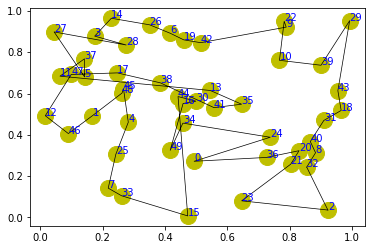

step:4780/5000, actic loss:0.367, critic loss:2.292, L:8.819, 0min2sec
step:4781/5000, actic loss:0.367, critic loss:2.292, L:8.819, 0min1sec
step:4782/5000, actic loss:0.367, critic loss:2.291, L:8.819, 0min1sec
step:4783/5000, actic loss:0.367, critic loss:2.291, L:8.818, 0min1sec
step:4784/5000, actic loss:0.367, critic loss:2.290, L:8.818, 0min1sec
distance:6.325
tensor([ 1, 46, 45, 33, 22, 32,  7, 15, 12,  8, 49, 23,  6, 27, 41, 20, 10,  5,
        13,  2, 16, 14,  0, 42, 19, 18, 29, 24, 48, 35, 37, 36,  4, 34, 31, 26,
         9, 44, 38, 25, 11, 30, 43, 40,  3, 39, 17, 47, 28, 21])


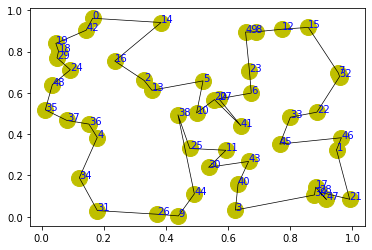

step:4785/5000, actic loss:0.366, critic loss:2.290, L:8.817, 0min2sec
step:4786/5000, actic loss:0.366, critic loss:2.289, L:8.817, 0min1sec
step:4787/5000, actic loss:0.365, critic loss:2.289, L:8.817, 0min1sec
step:4788/5000, actic loss:0.365, critic loss:2.289, L:8.816, 0min1sec
step:4789/5000, actic loss:0.365, critic loss:2.288, L:8.816, 0min1sec
distance:6.903
tensor([18, 42, 19, 26, 11, 40, 21, 27, 34, 43,  7,  6, 48, 16, 37, 41, 45, 49,
        10, 30,  2,  1, 47, 25,  9, 32, 46,  3, 29, 12, 35, 28,  0, 31, 33, 14,
        22,  5, 20, 23, 17,  8, 44, 13, 38, 24, 39,  4, 15, 36])


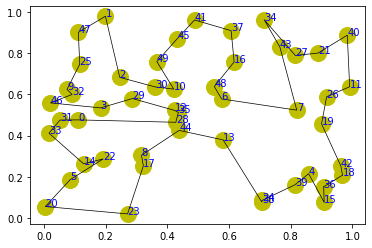

step:4790/5000, actic loss:0.365, critic loss:2.288, L:8.815, 0min2sec
step:4791/5000, actic loss:0.365, critic loss:2.287, L:8.815, 0min1sec
step:4792/5000, actic loss:0.365, critic loss:2.287, L:8.815, 0min1sec
step:4793/5000, actic loss:0.365, critic loss:2.286, L:8.814, 0min1sec
step:4794/5000, actic loss:0.365, critic loss:2.286, L:8.814, 0min1sec
distance:7.051
tensor([12, 29, 28, 48,  9, 26, 22, 43, 35, 17, 46, 15, 24, 32, 49, 44, 42,  3,
         8, 33,  5, 21, 34, 19, 20,  7,  1, 45, 14, 25,  6, 31, 40, 47, 27, 41,
        38, 23, 16, 39, 11, 18, 36,  0, 13, 30, 37,  2, 10,  4])


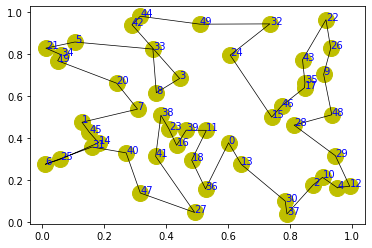

step:4795/5000, actic loss:0.365, critic loss:2.286, L:8.813, 0min2sec
step:4796/5000, actic loss:0.365, critic loss:2.285, L:8.813, 0min1sec
step:4797/5000, actic loss:0.365, critic loss:2.285, L:8.812, 0min1sec
step:4798/5000, actic loss:0.365, critic loss:2.284, L:8.812, 0min1sec
step:4799/5000, actic loss:0.364, critic loss:2.284, L:8.812, 0min1sec
distance:7.276
tensor([ 3, 40, 16, 12, 42, 39, 19, 35, 22, 10, 21, 43, 11,  8, 49, 34,  1, 18,
        25, 23, 31, 20, 44,  9, 13, 38,  2, 45,  6, 27, 26, 28, 36, 24,  4, 30,
         0, 37, 32, 17, 41, 29, 15, 47, 33, 48, 14,  5,  7, 46])


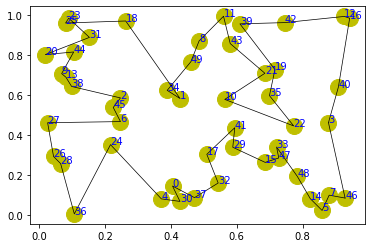

step:4800/5000, actic loss:0.364, critic loss:2.283, L:8.811, 0min1sec
step:4801/5000, actic loss:0.364, critic loss:2.283, L:8.811, 0min1sec
step:4802/5000, actic loss:0.364, critic loss:2.283, L:8.811, 0min1sec
step:4803/5000, actic loss:0.364, critic loss:2.282, L:8.810, 0min1sec
step:4804/5000, actic loss:0.364, critic loss:2.282, L:8.810, 0min1sec
distance:6.297
tensor([23, 28,  6, 33, 22,  2,  3, 10, 35, 39, 19, 12, 20, 49, 43, 38, 36, 41,
         4, 25, 30, 37, 27, 14, 11, 32, 21, 44, 29, 18, 40, 16, 34, 45,  5, 17,
         7,  8, 48, 15, 42,  0,  9, 46, 47, 31, 24, 26, 13,  1])


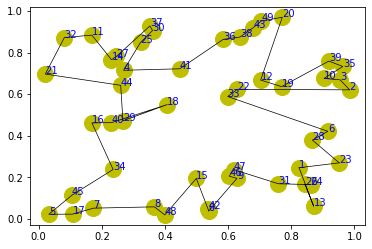

step:4805/5000, actic loss:0.364, critic loss:2.281, L:8.809, 0min2sec
step:4806/5000, actic loss:0.363, critic loss:2.281, L:8.809, 0min2sec
step:4807/5000, actic loss:0.363, critic loss:2.280, L:8.809, 0min2sec
step:4808/5000, actic loss:0.362, critic loss:2.280, L:8.808, 0min1sec
step:4809/5000, actic loss:0.362, critic loss:2.280, L:8.808, 0min1sec
distance:6.935
tensor([16, 22, 47, 21, 12, 11, 24,  0, 35,  2, 48, 49, 19, 33, 46, 26,  8, 40,
        38, 37, 15,  5, 41,  3, 20, 36, 17, 23, 43, 32, 25,  4,  1, 42,  6, 18,
         7, 27, 29, 30, 44, 28, 14, 34, 39, 31, 10,  9, 13, 45])


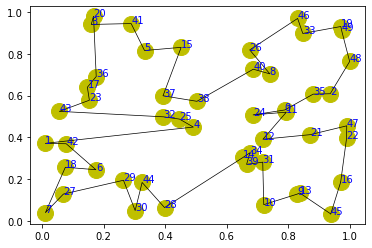

step:4810/5000, actic loss:0.362, critic loss:2.279, L:8.807, 0min2sec
step:4811/5000, actic loss:0.362, critic loss:2.279, L:8.807, 0min1sec
step:4812/5000, actic loss:0.362, critic loss:2.278, L:8.806, 0min1sec
step:4813/5000, actic loss:0.362, critic loss:2.278, L:8.806, 0min1sec
step:4814/5000, actic loss:0.362, critic loss:2.277, L:8.806, 0min1sec
distance:7.177
tensor([11, 45, 16, 39,  5,  4,  7,  6, 37, 13, 14, 30,  1, 31, 34, 22, 21, 29,
        12, 32,  2, 44, 25, 18, 20, 47, 36, 40, 27, 38, 43, 28, 46, 17,  0, 10,
        42, 19, 26, 24,  3, 49, 23, 41, 35, 48, 15, 33,  9,  8])


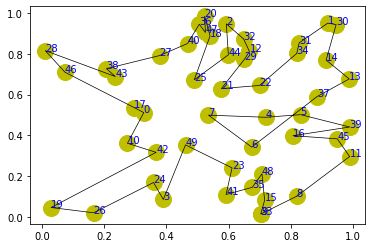

step:4815/5000, actic loss:0.361, critic loss:2.277, L:8.805, 0min2sec
step:4816/5000, actic loss:0.361, critic loss:2.277, L:8.805, 0min1sec
step:4817/5000, actic loss:0.361, critic loss:2.276, L:8.804, 0min1sec
step:4818/5000, actic loss:0.361, critic loss:2.276, L:8.804, 0min2sec
step:4819/5000, actic loss:0.361, critic loss:2.275, L:8.804, 0min2sec
distance:7.304
tensor([ 3,  0, 31, 27, 40, 48, 41, 22,  6,  9, 29, 14, 49,  7, 34,  1, 43, 12,
        45, 26, 30, 37, 15, 39, 33, 25, 35, 38, 47, 23, 19, 13, 24, 46, 18, 20,
        28, 10, 32,  8, 21, 16, 44, 36,  2,  4, 17,  5, 11, 42])


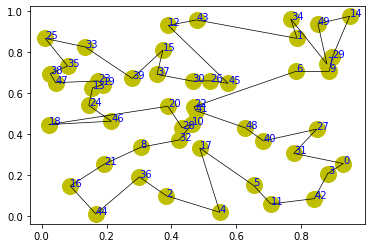

step:4820/5000, actic loss:0.361, critic loss:2.275, L:8.803, 0min2sec
step:4821/5000, actic loss:0.360, critic loss:2.274, L:8.803, 0min1sec
step:4822/5000, actic loss:0.360, critic loss:2.274, L:8.802, 0min1sec
step:4823/5000, actic loss:0.360, critic loss:2.274, L:8.802, 0min1sec
step:4824/5000, actic loss:0.360, critic loss:2.273, L:8.802, 0min1sec
distance:6.481
tensor([47,  6,  0, 49, 22,  4, 37, 10, 28, 32,  9,  3, 27, 34, 25, 35, 46, 31,
        42, 45, 38, 19,  2, 40, 41, 48,  8, 24, 20, 11, 21, 18, 12, 14, 23, 17,
         7, 29, 44,  1, 36, 15, 13, 30, 33, 26, 43, 39,  5, 16])


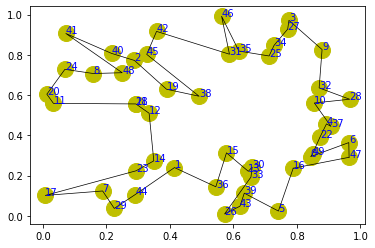

step:4825/5000, actic loss:0.360, critic loss:2.273, L:8.801, 0min2sec
step:4826/5000, actic loss:0.360, critic loss:2.272, L:8.801, 0min1sec
step:4827/5000, actic loss:0.360, critic loss:2.272, L:8.800, 0min1sec
step:4828/5000, actic loss:0.360, critic loss:2.271, L:8.800, 0min1sec
step:4829/5000, actic loss:0.360, critic loss:2.271, L:8.799, 0min1sec
distance:6.831
tensor([20,  3, 16, 22, 38, 40, 35, 15, 18,  4, 49, 44,  0, 48, 45,  1, 47, 37,
        46, 13,  9, 17, 34, 26, 31, 21,  2, 32, 41, 12, 28, 14, 19, 24, 11, 39,
        36, 25,  8, 29, 27, 10,  7, 42, 43, 30, 23, 33,  5,  6])


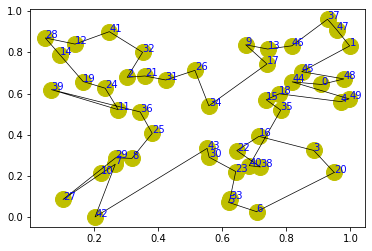

step:4830/5000, actic loss:0.360, critic loss:2.271, L:8.799, 0min2sec
step:4831/5000, actic loss:0.359, critic loss:2.270, L:8.799, 0min2sec
step:4832/5000, actic loss:0.359, critic loss:2.270, L:8.798, 0min2sec
step:4833/5000, actic loss:0.359, critic loss:2.269, L:8.798, 0min1sec
step:4834/5000, actic loss:0.359, critic loss:2.269, L:8.798, 0min1sec
distance:6.339
tensor([31, 47, 19, 40, 43,  4, 42, 38, 35, 11, 15,  5, 16, 18, 24, 30, 14,  8,
        49, 33,  3, 28, 20, 10, 22,  1,  2, 36, 12, 41,  0, 29, 32, 21, 45,  7,
         6, 23, 44, 26, 37, 48, 34, 17, 39, 27, 13, 46, 25,  9])


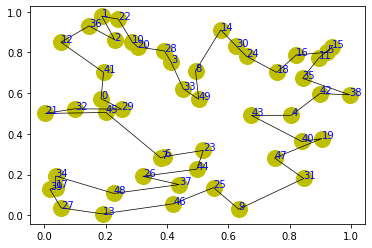

step:4835/5000, actic loss:0.359, critic loss:2.268, L:8.797, 0min2sec
step:4836/5000, actic loss:0.359, critic loss:2.268, L:8.797, 0min1sec
step:4837/5000, actic loss:0.360, critic loss:2.268, L:8.796, 0min1sec
step:4838/5000, actic loss:0.360, critic loss:2.267, L:8.796, 0min1sec
step:4839/5000, actic loss:0.360, critic loss:2.267, L:8.796, 0min1sec
distance:7.778
tensor([23,  9, 29, 43, 45, 44, 41, 15, 17, 37,  7, 20, 39, 12, 18, 48, 31,  2,
        38, 32, 19, 22, 21,  1, 11, 10, 27, 30, 13, 16, 47, 49, 33,  3, 40,  0,
        46, 35, 36, 26,  5, 34,  4, 24,  6, 42, 14,  8, 25, 28])


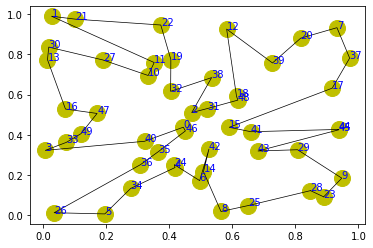

step:4840/5000, actic loss:0.360, critic loss:2.266, L:8.795, 0min2sec
step:4841/5000, actic loss:0.359, critic loss:2.266, L:8.795, 0min1sec
step:4842/5000, actic loss:0.359, critic loss:2.266, L:8.795, 0min2sec
step:4843/5000, actic loss:0.358, critic loss:2.265, L:8.794, 0min2sec
step:4844/5000, actic loss:0.358, critic loss:2.265, L:8.794, 0min2sec
distance:6.722
tensor([ 5, 19, 27, 26, 42, 28, 29, 15, 25, 12, 20, 41,  3, 39, 38, 37,  0, 23,
        34, 18, 44, 21,  4, 13, 48, 30, 32, 49, 36, 22, 11,  7,  8, 10, 31, 16,
        45, 33,  2, 24,  6, 47, 46, 35, 17,  9, 40,  1, 43, 14])


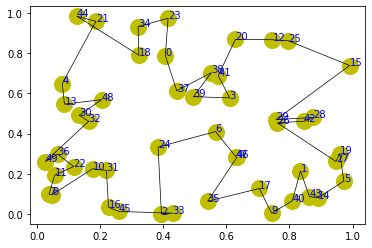

step:4845/5000, actic loss:0.358, critic loss:2.264, L:8.793, 0min2sec
step:4846/5000, actic loss:0.358, critic loss:2.264, L:8.793, 0min1sec
step:4847/5000, actic loss:0.358, critic loss:2.263, L:8.793, 0min1sec
step:4848/5000, actic loss:0.358, critic loss:2.263, L:8.792, 0min1sec
step:4849/5000, actic loss:0.358, critic loss:2.263, L:8.792, 0min1sec
distance:7.214
tensor([ 9, 11,  8, 17, 30, 48, 34, 31, 27, 25,  0, 44, 13, 47, 39, 29, 43, 38,
        14, 46, 35, 36, 32, 10, 23, 49, 24,  2, 20,  5, 18, 40, 42, 37, 33,  1,
        41, 19, 22, 12, 21, 15, 28, 26,  7,  3,  4, 16,  6, 45])


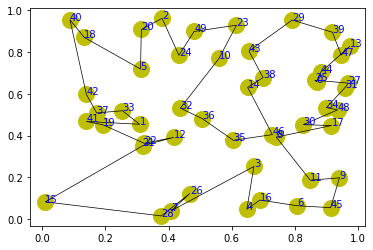

step:4850/5000, actic loss:0.358, critic loss:2.262, L:8.792, 0min2sec
step:4851/5000, actic loss:0.357, critic loss:2.262, L:8.791, 0min1sec
step:4852/5000, actic loss:0.357, critic loss:2.261, L:8.791, 0min2sec
step:4853/5000, actic loss:0.357, critic loss:2.261, L:8.790, 0min2sec
step:4854/5000, actic loss:0.356, critic loss:2.260, L:8.790, 0min2sec
distance:6.160
tensor([18, 29, 12, 35, 11, 17, 30, 26, 22, 43, 38, 34,  3, 40,  9, 16, 39, 13,
        14, 37, 24,  0, 31, 28,  7,  8,  5, 23, 20, 47,  1,  6, 44,  4, 46, 48,
        49, 33, 27, 32,  2, 25, 15, 41, 19, 21, 42, 36, 10, 45])


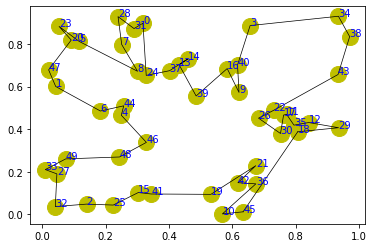

step:4855/5000, actic loss:0.357, critic loss:2.260, L:8.790, 0min2sec
step:4856/5000, actic loss:0.356, critic loss:2.260, L:8.789, 0min1sec
step:4857/5000, actic loss:0.356, critic loss:2.259, L:8.789, 0min1sec
step:4858/5000, actic loss:0.356, critic loss:2.259, L:8.788, 0min1sec
step:4859/5000, actic loss:0.356, critic loss:2.258, L:8.788, 0min1sec
distance:6.484
tensor([44, 36, 37, 25, 18, 26, 35, 38, 22, 16, 20, 47, 15, 27, 34, 45, 32,  7,
         8, 33, 46, 17, 39, 41,  9,  0, 40, 31, 42, 23,  5,  3, 19, 29, 48,  1,
        21,  6, 12,  4, 49, 10, 13,  2, 28, 24, 43, 14, 11, 30])


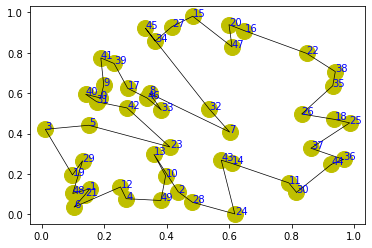

step:4860/5000, actic loss:0.356, critic loss:2.258, L:8.788, 0min2sec
step:4861/5000, actic loss:0.356, critic loss:2.258, L:8.787, 0min1sec
step:4862/5000, actic loss:0.355, critic loss:2.257, L:8.787, 0min1sec
step:4863/5000, actic loss:0.355, critic loss:2.257, L:8.786, 0min1sec
step:4864/5000, actic loss:0.355, critic loss:2.256, L:8.786, 0min2sec
distance:6.829
tensor([22, 15, 21, 28, 13,  4, 25, 35, 27,  2,  3, 10, 41, 23, 32, 43, 49,  7,
        31, 38,  8, 47, 44, 14, 11,  1, 45, 48, 33,  6, 20, 37, 46, 18, 26, 19,
        24, 36, 17, 42, 30,  0, 16,  9, 39,  5, 29, 40, 34, 12])


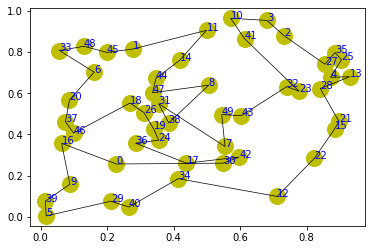

step:4865/5000, actic loss:0.356, critic loss:2.256, L:8.786, 0min2sec
step:4866/5000, actic loss:0.356, critic loss:2.255, L:8.785, 0min2sec
step:4867/5000, actic loss:0.356, critic loss:2.255, L:8.785, 0min1sec
step:4868/5000, actic loss:0.356, critic loss:2.255, L:8.785, 0min1sec
step:4869/5000, actic loss:0.355, critic loss:2.254, L:8.784, 0min1sec
distance:6.349
tensor([21, 25, 14, 11, 45, 33, 17,  6,  4, 29, 49, 26, 10, 37, 16, 19, 35, 32,
         1,  9, 46, 28, 44, 40, 48, 24, 39,  3, 22, 42, 13, 20, 23,  0, 27, 18,
        43,  5,  2,  7, 47, 12, 38, 34, 41, 31, 15,  8, 30, 36])


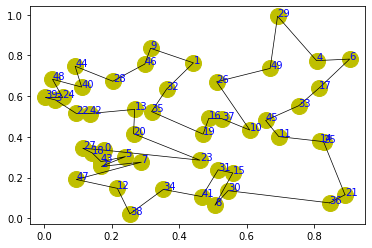

step:4870/5000, actic loss:0.355, critic loss:2.254, L:8.784, 0min2sec
step:4871/5000, actic loss:0.355, critic loss:2.253, L:8.783, 0min1sec
step:4872/5000, actic loss:0.355, critic loss:2.253, L:8.783, 0min1sec
step:4873/5000, actic loss:0.355, critic loss:2.253, L:8.783, 0min1sec
step:4874/5000, actic loss:0.355, critic loss:2.252, L:8.782, 0min1sec
distance:7.337
tensor([18, 19,  2,  7, 12, 25, 45,  8, 48, 33, 34, 46, 11, 42, 22, 14, 29, 16,
        15, 40, 27, 10, 36, 43, 28,  5,  6, 44, 23, 41, 49,  9, 38, 30, 21, 31,
        24, 20,  0, 32,  3, 47,  4,  1, 17, 37, 13, 35, 39, 26])


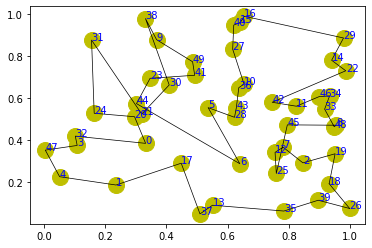

step:4875/5000, actic loss:0.355, critic loss:2.252, L:8.782, 0min2sec
step:4876/5000, actic loss:0.355, critic loss:2.251, L:8.781, 0min1sec
step:4877/5000, actic loss:0.355, critic loss:2.251, L:8.781, 0min2sec
step:4878/5000, actic loss:0.355, critic loss:2.251, L:8.781, 0min2sec
step:4879/5000, actic loss:0.354, critic loss:2.250, L:8.780, 0min1sec
distance:6.614
tensor([38, 30, 12,  4, 41, 34, 13, 10, 45, 37,  1,  2, 35, 19, 33,  3, 39, 17,
        15, 22,  5, 36, 25, 44, 29, 40, 20, 31, 28,  7, 24, 47, 27, 23, 21, 16,
         9,  6, 48, 32, 26, 18, 49,  8, 42, 43,  0, 14, 46, 11])


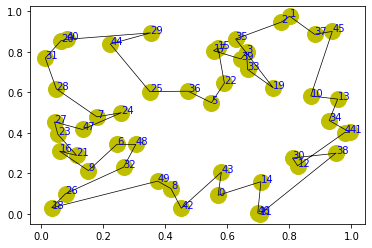

step:4880/5000, actic loss:0.354, critic loss:2.250, L:8.780, 0min2sec
step:4881/5000, actic loss:0.353, critic loss:2.249, L:8.780, 0min1sec
step:4882/5000, actic loss:0.353, critic loss:2.249, L:8.779, 0min1sec
step:4883/5000, actic loss:0.353, critic loss:2.249, L:8.779, 0min1sec
step:4884/5000, actic loss:0.354, critic loss:2.248, L:8.779, 0min1sec
distance:7.651
tensor([27, 46, 17, 39,  2, 29,  6, 47, 14, 31, 11, 36, 21, 12, 24, 37,  7, 15,
         3, 48, 10, 33, 20, 45,  1, 18,  9, 22, 38,  8, 40, 25,  5, 41, 16, 13,
        28, 49, 42,  4, 34, 43, 23,  0, 44, 32, 26, 19, 35, 30])


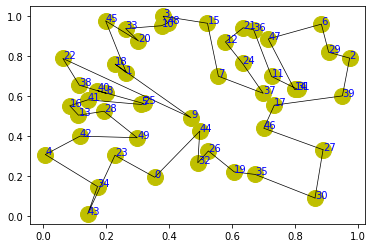

step:4885/5000, actic loss:0.354, critic loss:2.248, L:8.778, 0min2sec
step:4886/5000, actic loss:0.354, critic loss:2.247, L:8.778, 0min1sec
step:4887/5000, actic loss:0.354, critic loss:2.247, L:8.777, 0min1sec
step:4888/5000, actic loss:0.354, critic loss:2.247, L:8.777, 0min2sec
step:4889/5000, actic loss:0.354, critic loss:2.246, L:8.777, 0min1sec
distance:8.035
tensor([18, 26, 44, 28, 11, 45, 36,  6,  7, 39, 35, 17, 37,  3, 32, 42,  2, 10,
         4, 31, 14, 25, 40, 49, 15, 21,  9, 29, 24, 47, 41, 43, 23, 30, 48, 19,
        34,  1, 46, 13,  8, 38, 27,  5, 12, 16, 33, 22,  0, 20])


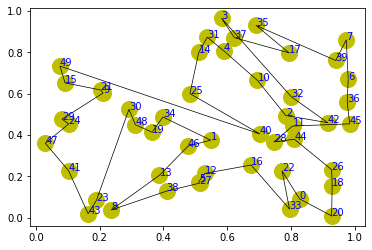

step:4890/5000, actic loss:0.353, critic loss:2.246, L:8.776, 0min2sec
step:4891/5000, actic loss:0.353, critic loss:2.245, L:8.776, 0min1sec
step:4892/5000, actic loss:0.352, critic loss:2.245, L:8.776, 0min1sec
step:4893/5000, actic loss:0.352, critic loss:2.245, L:8.775, 0min1sec
step:4894/5000, actic loss:0.352, critic loss:2.244, L:8.775, 0min1sec
distance:5.808
tensor([43,  9,  6, 44, 15, 33, 23, 31, 34, 24, 39, 21, 19,  7, 36, 49, 30, 13,
        18,  4, 37,  5, 32,  1, 28, 48, 25, 27,  2, 12,  8, 22, 45, 11, 40, 16,
        14, 17, 29, 10, 42, 20, 41, 46,  3, 47, 35, 26, 38,  0])


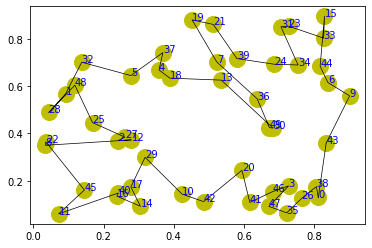

step:4895/5000, actic loss:0.352, critic loss:2.244, L:8.775, 0min2sec
step:4896/5000, actic loss:0.352, critic loss:2.244, L:8.774, 0min1sec
step:4897/5000, actic loss:0.352, critic loss:2.243, L:8.774, 0min1sec
step:4898/5000, actic loss:0.352, critic loss:2.243, L:8.774, 0min1sec
step:4899/5000, actic loss:0.351, critic loss:2.242, L:8.773, 0min1sec
distance:7.100
tensor([ 7, 17, 41, 42, 35, 14, 30, 44, 27, 21, 31, 18, 22,  0, 20, 12,  1, 49,
        10, 29, 11,  9, 38, 34,  6, 45,  3, 15, 24, 48, 39, 19,  8, 37, 46,  5,
         4, 13, 36, 26, 23, 47, 28, 16, 33,  2, 43, 25, 32, 40])


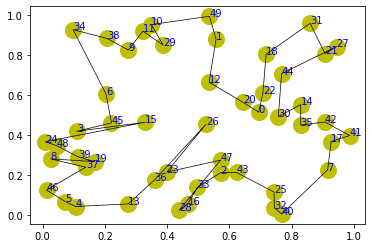

step:4900/5000, actic loss:0.351, critic loss:2.242, L:8.773, 0min2sec
step:4901/5000, actic loss:0.350, critic loss:2.242, L:8.773, 0min2sec
step:4902/5000, actic loss:0.350, critic loss:2.241, L:8.772, 0min2sec
step:4903/5000, actic loss:0.350, critic loss:2.241, L:8.772, 0min1sec
step:4904/5000, actic loss:0.351, critic loss:2.240, L:8.772, 0min1sec
distance:7.256
tensor([26, 27, 33, 20, 36, 44, 21, 38, 42, 24, 35,  8,  6, 28,  3, 19, 10, 49,
        47, 18, 31,  4, 43, 23,  0, 39, 40, 46, 32,  5, 34, 25,  7, 48, 13, 37,
        16, 41, 22,  9, 15, 29,  2, 30, 17, 14, 45, 11, 12,  1])


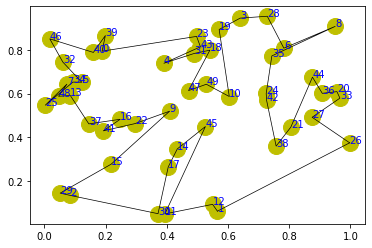

step:4905/5000, actic loss:0.351, critic loss:2.240, L:8.771, 0min1sec
step:4906/5000, actic loss:0.351, critic loss:2.240, L:8.771, 0min1sec
step:4907/5000, actic loss:0.350, critic loss:2.239, L:8.771, 0min1sec
step:4908/5000, actic loss:0.350, critic loss:2.239, L:8.770, 0min1sec
step:4909/5000, actic loss:0.350, critic loss:2.238, L:8.770, 0min1sec
distance:7.096
tensor([43, 49, 16, 44, 19, 37, 41, 34,  2, 45,  6, 47, 20, 30, 32, 31, 10, 21,
         0, 17, 23, 15,  7, 12, 26, 25,  8, 33, 22,  9,  4, 13,  1,  5, 18, 38,
        42, 48, 27, 14, 11, 36,  3, 35, 29, 46, 40, 28, 24, 39])


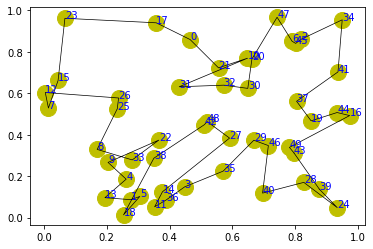

step:4910/5000, actic loss:0.349, critic loss:2.238, L:8.770, 0min1sec
step:4911/5000, actic loss:0.349, critic loss:2.238, L:8.769, 0min1sec
step:4912/5000, actic loss:0.349, critic loss:2.237, L:8.769, 0min1sec
step:4913/5000, actic loss:0.349, critic loss:2.237, L:8.769, 0min2sec
step:4914/5000, actic loss:0.349, critic loss:2.236, L:8.768, 0min1sec
distance:6.897
tensor([36, 27, 44, 42, 40, 24, 30, 43,  9, 49, 19, 23, 34, 47, 12,  5, 11, 15,
         0, 16,  1,  4, 20,  8, 48, 31,  3, 29, 33, 17, 41, 21,  6, 18,  7, 10,
        38, 35, 45, 13, 14, 25, 32, 22, 37, 28,  2, 39, 46, 26])


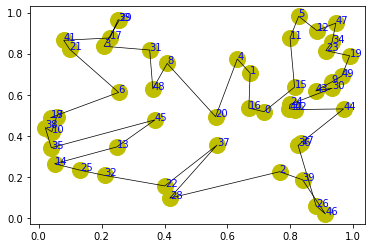

step:4915/5000, actic loss:0.349, critic loss:2.236, L:8.768, 0min2sec
step:4916/5000, actic loss:0.349, critic loss:2.236, L:8.768, 0min1sec
step:4917/5000, actic loss:0.348, critic loss:2.235, L:8.767, 0min1sec
step:4918/5000, actic loss:0.348, critic loss:2.235, L:8.767, 0min1sec
step:4919/5000, actic loss:0.348, critic loss:2.234, L:8.767, 0min1sec
distance:7.545
tensor([ 0, 27, 12, 23, 29, 11,  7, 47, 15, 16, 21, 25, 14, 10, 43,  8, 44,  3,
        22,  5, 18,  1, 24, 17, 19, 42,  2, 35, 20, 31, 30, 37,  6, 28, 13, 33,
        41,  4, 38, 49, 39, 46, 34, 36, 32,  9, 45, 26, 40, 48])


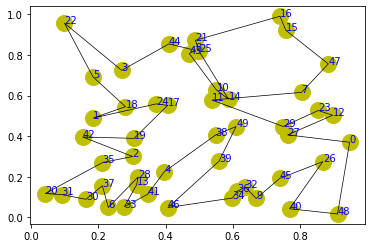

step:4920/5000, actic loss:0.348, critic loss:2.234, L:8.766, 0min2sec
step:4921/5000, actic loss:0.348, critic loss:2.233, L:8.766, 0min1sec
step:4922/5000, actic loss:0.348, critic loss:2.233, L:8.766, 0min1sec
step:4923/5000, actic loss:0.348, critic loss:2.233, L:8.765, 0min1sec
step:4924/5000, actic loss:0.348, critic loss:2.232, L:8.765, 0min1sec
distance:6.534
tensor([44, 39, 36, 42, 22, 49, 18,  5, 31, 32, 13, 37, 27, 26, 29, 19, 46, 12,
        28, 38,  8, 11, 45, 23, 33, 15, 35, 17,  4, 14, 24,  1, 20, 47, 48,  6,
        16,  7, 34,  0, 40, 10, 30, 41,  2, 43, 25,  9, 21,  3])


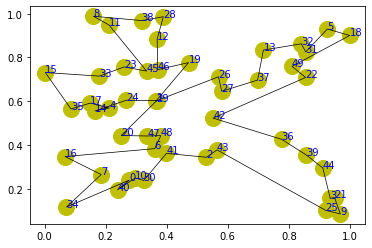

step:4925/5000, actic loss:0.348, critic loss:2.232, L:8.765, 0min2sec
step:4926/5000, actic loss:0.348, critic loss:2.231, L:8.764, 0min1sec
step:4927/5000, actic loss:0.348, critic loss:2.231, L:8.764, 0min1sec
step:4928/5000, actic loss:0.348, critic loss:2.231, L:8.764, 0min1sec
step:4929/5000, actic loss:0.348, critic loss:2.230, L:8.763, 0min1sec
distance:6.911
tensor([11, 20, 16, 18,  2, 10, 13, 43,  9, 26,  1,  7, 34, 29,  5, 49, 23, 27,
        32, 42, 39, 35, 17, 44, 28, 19,  8, 41, 25,  4, 47, 14, 33, 45, 48, 30,
         0, 37, 15, 31, 46, 40, 36, 24, 21, 12,  6,  3, 22, 38])


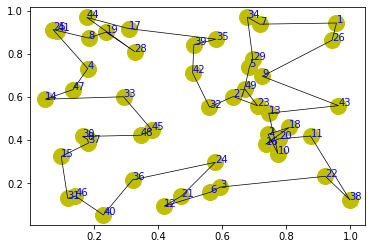

step:4930/5000, actic loss:0.348, critic loss:2.230, L:8.763, 0min2sec
step:4931/5000, actic loss:0.347, critic loss:2.229, L:8.762, 0min1sec
step:4932/5000, actic loss:0.347, critic loss:2.229, L:8.762, 0min1sec
step:4933/5000, actic loss:0.346, critic loss:2.229, L:8.762, 0min1sec
step:4934/5000, actic loss:0.346, critic loss:2.228, L:8.761, 0min1sec
distance:7.481
tensor([ 1,  3, 27, 14, 23, 16, 11, 17,  5, 31, 20, 40, 10, 48,  6, 35, 18, 29,
        34, 42, 15, 21,  4,  7, 43, 22, 37, 24,  0, 49, 41, 46, 39,  9, 45, 19,
         8, 33, 26, 30, 32,  2, 28, 13, 25, 44, 12, 36, 38, 47])


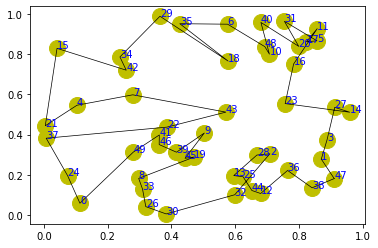

step:4935/5000, actic loss:0.346, critic loss:2.228, L:8.761, 0min2sec
step:4936/5000, actic loss:0.346, critic loss:2.227, L:8.761, 0min2sec
step:4937/5000, actic loss:0.346, critic loss:2.227, L:8.760, 0min1sec
step:4938/5000, actic loss:0.346, critic loss:2.227, L:8.760, 0min1sec
step:4939/5000, actic loss:0.346, critic loss:2.226, L:8.760, 0min1sec
distance:7.757
tensor([22, 41, 46, 48, 31, 49,  9, 20,  0, 47, 16, 44, 18, 34,  3,  2, 15,  8,
        14, 35,  1, 10, 13, 42, 21, 39, 38,  4, 23, 19, 26, 24, 29, 27, 28, 36,
        30,  5, 32, 43, 33, 25,  7, 11, 12, 45, 40, 37,  6, 17])


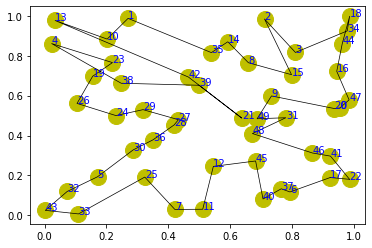

step:4940/5000, actic loss:0.345, critic loss:2.226, L:8.759, 0min2sec
step:4941/5000, actic loss:0.345, critic loss:2.225, L:8.759, 0min1sec
step:4942/5000, actic loss:0.345, critic loss:2.225, L:8.759, 0min1sec
step:4943/5000, actic loss:0.345, critic loss:2.225, L:8.758, 0min1sec
step:4944/5000, actic loss:0.345, critic loss:2.224, L:8.758, 0min1sec
distance:6.722
tensor([ 2,  6, 11, 47, 24, 36,  1, 21, 32, 31, 20, 37, 26,  8, 23, 10,  5, 38,
        28, 22, 39, 13, 40, 19, 16, 33, 25, 14, 30, 12, 42, 15, 27,  4, 41, 46,
        44,  3,  0, 34, 45,  9, 43, 35, 18, 29, 49, 48,  7, 17])


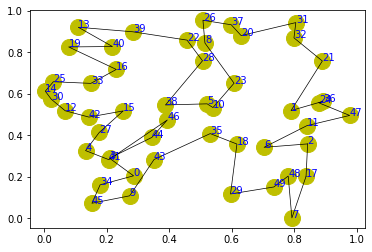

step:4945/5000, actic loss:0.345, critic loss:2.224, L:8.758, 0min2sec
step:4946/5000, actic loss:0.345, critic loss:2.223, L:8.757, 0min1sec
step:4947/5000, actic loss:0.345, critic loss:2.223, L:8.757, 0min2sec
step:4948/5000, actic loss:0.345, critic loss:2.223, L:8.756, 0min1sec
step:4949/5000, actic loss:0.345, critic loss:2.222, L:8.756, 0min1sec
distance:7.111
tensor([26, 45, 34, 44,  3, 49,  5, 13, 39, 18, 30, 21,  8, 33, 14, 28, 35,  4,
        27,  2,  6, 32,  1, 29, 47, 10, 19,  0, 20, 46, 11, 23, 36, 40, 41, 31,
        42, 43, 48, 12, 24, 25, 37, 17, 16, 38,  7, 22,  9, 15])


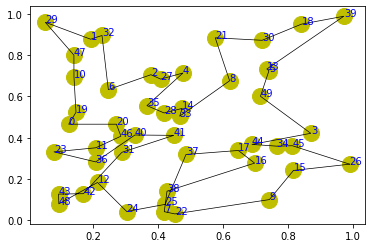

step:4950/5000, actic loss:0.344, critic loss:2.222, L:8.756, 0min1sec
step:4951/5000, actic loss:0.344, critic loss:2.221, L:8.755, 0min1sec
step:4952/5000, actic loss:0.345, critic loss:2.221, L:8.755, 0min1sec
step:4953/5000, actic loss:0.345, critic loss:2.221, L:8.755, 0min1sec
step:4954/5000, actic loss:0.345, critic loss:2.220, L:8.754, 0min1sec
distance:6.653
tensor([10, 27, 45, 32,  3,  5, 44, 18, 16, 15, 42, 46, 23, 24, 29,  4, 49,  1,
         0, 35,  9, 14, 38, 31, 19, 13, 36, 43,  8, 47,  2, 40, 12, 33, 28, 17,
        25,  6, 37, 48, 34, 39, 11, 22,  7, 30, 26, 21, 20, 41])


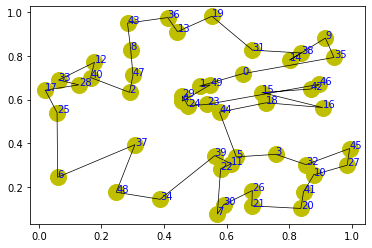

step:4955/5000, actic loss:0.345, critic loss:2.220, L:8.754, 0min2sec
step:4956/5000, actic loss:0.344, critic loss:2.219, L:8.754, 0min1sec
step:4957/5000, actic loss:0.344, critic loss:2.219, L:8.753, 0min1sec
step:4958/5000, actic loss:0.344, critic loss:2.219, L:8.753, 0min2sec
step:4959/5000, actic loss:0.344, critic loss:2.218, L:8.753, 0min2sec
distance:7.718
tensor([20, 29, 19, 45,  5, 38, 49, 27, 39,  2,  3,  0, 43, 44, 17, 15, 25, 34,
        35, 14, 13, 31, 37, 21, 18, 24, 46, 11, 23, 26,  7, 33,  4,  9, 10, 32,
         8, 16, 36, 41,  1, 30, 40, 12, 28, 42, 47, 22,  6, 48])


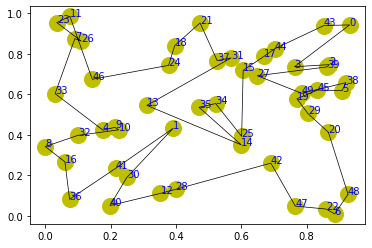

step:4960/5000, actic loss:0.344, critic loss:2.218, L:8.752, 0min2sec
step:4961/5000, actic loss:0.344, critic loss:2.217, L:8.752, 0min1sec
step:4962/5000, actic loss:0.344, critic loss:2.217, L:8.751, 0min1sec
step:4963/5000, actic loss:0.344, critic loss:2.217, L:8.751, 0min1sec
step:4964/5000, actic loss:0.343, critic loss:2.216, L:8.751, 0min1sec
distance:7.125
tensor([25, 21,  0, 26, 39, 31, 34, 18, 43,  4, 16, 24,  8, 29, 13, 44,  1, 47,
        23, 49, 17,  6, 41,  5, 42,  7, 33, 19, 38, 22, 28, 32, 27, 36, 12, 10,
        30, 35,  9, 20,  2, 37,  3, 11, 45, 15, 48, 40, 46, 14])


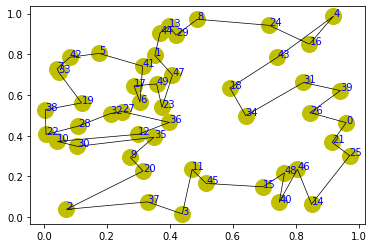

step:4965/5000, actic loss:0.343, critic loss:2.216, L:8.750, 0min2sec
step:4966/5000, actic loss:0.343, critic loss:2.215, L:8.750, 0min1sec
step:4967/5000, actic loss:0.343, critic loss:2.215, L:8.749, 0min1sec
step:4968/5000, actic loss:0.343, critic loss:2.215, L:8.749, 0min1sec
step:4969/5000, actic loss:0.343, critic loss:2.214, L:8.749, 0min2sec
distance:6.413
tensor([16,  1, 10, 30,  9, 33, 45,  4,  3,  0, 40, 15,  5, 28, 31, 42, 22,  2,
        49, 24, 34, 39, 14,  8, 38, 25, 43, 41, 35, 26, 23, 12, 19, 27, 20, 13,
        47, 11, 18, 21, 46,  7, 48, 17, 36,  6, 29, 44, 32, 37])


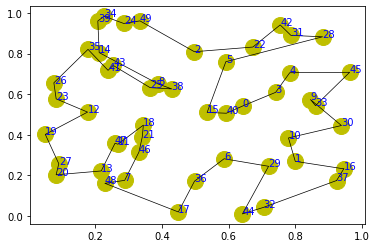

step:4970/5000, actic loss:0.343, critic loss:2.214, L:8.748, 0min2sec
step:4971/5000, actic loss:0.343, critic loss:2.213, L:8.748, 0min1sec
step:4972/5000, actic loss:0.342, critic loss:2.213, L:8.748, 0min1sec
step:4973/5000, actic loss:0.342, critic loss:2.213, L:8.747, 0min1sec
step:4974/5000, actic loss:0.342, critic loss:2.212, L:8.747, 0min1sec
distance:7.347
tensor([ 5, 40, 18, 10, 15, 25, 30, 23,  2, 28, 46, 34, 29,  3,  1, 16, 13, 21,
        44, 47, 12,  7, 39, 20, 42, 17, 37, 27, 22, 19, 41,  8,  9, 36, 32, 38,
         4, 14, 45, 11, 43, 31, 26, 48, 33,  6, 35, 49,  0, 24])


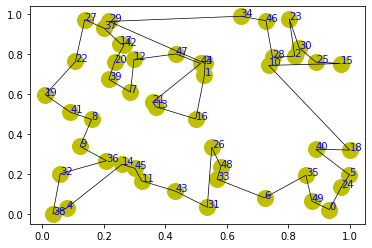

step:4975/5000, actic loss:0.342, critic loss:2.212, L:8.746, 0min2sec
step:4976/5000, actic loss:0.342, critic loss:2.211, L:8.746, 0min1sec
step:4977/5000, actic loss:0.342, critic loss:2.211, L:8.746, 0min1sec
step:4978/5000, actic loss:0.342, critic loss:2.211, L:8.745, 0min1sec
step:4979/5000, actic loss:0.342, critic loss:2.210, L:8.745, 0min1sec
distance:7.308
tensor([30, 21, 28, 35, 45, 14, 41, 46, 25, 11, 34, 18, 24, 23,  4, 48,  7, 31,
        19, 29,  0, 22,  9,  1,  8, 33, 20, 40, 42, 26, 47, 43,  2, 44, 37, 16,
         5, 15,  3, 10, 49, 38, 27,  6, 36, 12, 17, 32, 13, 39])


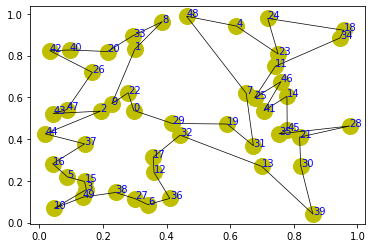

step:4980/5000, actic loss:0.342, critic loss:2.210, L:8.745, 0min2sec
step:4981/5000, actic loss:0.341, critic loss:2.209, L:8.744, 0min2sec
step:4982/5000, actic loss:0.341, critic loss:2.209, L:8.744, 0min1sec
step:4983/5000, actic loss:0.341, critic loss:2.209, L:8.743, 0min1sec
step:4984/5000, actic loss:0.341, critic loss:2.208, L:8.743, 0min1sec
distance:7.113
tensor([29,  6, 31, 26, 40, 32, 37, 42,  1, 21,  5,  2, 34, 17, 10, 33, 22, 36,
        45, 18, 15,  0, 30, 27, 39,  3, 11, 41,  7, 16, 44, 48, 38, 35, 43, 46,
        14, 47, 20, 23,  4, 49, 19, 25, 24, 28,  9, 13, 12,  8])


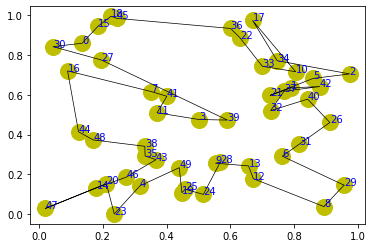

step:4985/5000, actic loss:0.341, critic loss:2.208, L:8.743, 0min2sec
step:4986/5000, actic loss:0.341, critic loss:2.207, L:8.742, 0min1sec
step:4987/5000, actic loss:0.341, critic loss:2.207, L:8.742, 0min1sec
step:4988/5000, actic loss:0.341, critic loss:2.207, L:8.741, 0min1sec
step:4989/5000, actic loss:0.341, critic loss:2.206, L:8.741, 0min1sec
distance:6.637
tensor([45, 24, 29, 28, 41, 13,  3, 25, 48, 36, 37, 20, 31,  4,  7, 21, 27,  8,
        33,  9, 11,  2,  0, 23, 42, 22, 34, 17, 18, 12, 32,  1,  6, 47, 16, 35,
        39, 49, 26, 43, 40, 10, 19, 38, 44, 30, 15, 46, 14,  5])


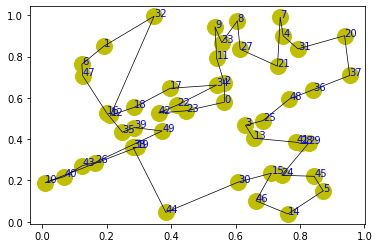

step:4990/5000, actic loss:0.341, critic loss:2.206, L:8.741, 0min2sec
step:4991/5000, actic loss:0.341, critic loss:2.205, L:8.740, 0min1sec
step:4992/5000, actic loss:0.341, critic loss:2.205, L:8.740, 0min2sec
step:4993/5000, actic loss:0.340, critic loss:2.205, L:8.740, 0min2sec
step:4994/5000, actic loss:0.340, critic loss:2.204, L:8.739, 0min1sec
distance:7.772
tensor([21, 40, 37, 44,  0, 23, 30, 18, 38, 26, 45,  1, 35,  2, 47,  9, 46, 39,
        41, 43, 28,  5, 14, 20, 17, 16, 42, 25, 49, 27,  3, 15, 33, 13, 10, 48,
        22, 29, 31, 12,  6, 24, 32, 19,  7, 34,  4, 11, 36,  8])


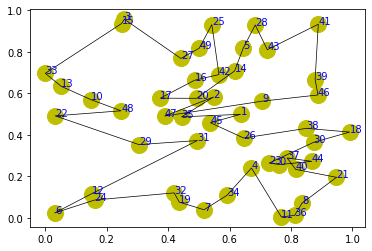

step:4995/5000, actic loss:0.340, critic loss:2.204, L:8.739, 0min2sec
step:4996/5000, actic loss:0.340, critic loss:2.203, L:8.738, 0min1sec
step:4997/5000, actic loss:0.340, critic loss:2.203, L:8.738, 0min1sec
step:4998/5000, actic loss:0.340, critic loss:2.203, L:8.738, 0min1sec
step:4999/5000, actic loss:0.339, critic loss:2.202, L:8.737, 0min1sec
save model...


In [8]:
train_model(cfg, env)